In [ ]:
from datetime import datetime
import pandas as pd 
import numpy as np
from collections import defaultdict
import matplotlib.pyplot as plt;
import itertools

In [842]:
[     
     'BIZD-STK-ARCA',
     'BKLN-STK-ARCA',
     'CEW-STK-ARCA',
     'CWB-STK-ARCA',
     'IYZ-STK-ARCA',
     'LQD-STK-ARCA',
     'LTL-STK-ARCA',
     'MBB-STK-ARCA',
     'MUB-STK-ARCA',
     'PFF-STK-ARCA',
     'SHY-STK-ARCA',
     'TIP-STK-ARCA',
     'TLT-STK-ARCA',
     'USO-STK-ARCA',
]
instruments = [
     #'HYG-STK-ARCA',
     #'IEF-STK-ARCA',
     #'SHY-STK-ARCA',
     #'TIP-STK-ARCA',
     #'TLT-STK-ARCA',
     #'GLD-STK-ARCA',
     'VNQ-STK-ARCA',
     'XLB-STK-ARCA',
     'XLE-STK-ARCA',
     'XLF-STK-ARCA',
     'XLI-STK-ARCA',
     'XLK-STK-ARCA',
     'XLP-STK-ARCA',
     'XLU-STK-ARCA',
     'XLV-STK-ARCA',
     'XLY-STK-ARCA',
]


In [843]:
d= {}
for instrument in instruments:
    df= pd.read_pickle("data/"+instrument+"_2015.pkl")
    d[instrument] = df["close"].xs(instrument, level="asset")
#df = pd.DataFrame(data=d)

In [844]:
d_ = pd.DataFrame()
for i,s in d.items():
    d_[i] = s.groupby("time").first()

In [845]:
d_

,VNQ-STK-ARCA,XLB-STK-ARCA,XLE-STK-ARCA,XLF-STK-ARCA,XLI-STK-ARCA,XLK-STK-ARCA,XLP-STK-ARCA,XLU-STK-ARCA,XLV-STK-ARCA,XLY-STK-ARCA
time,,,,,,,,,,
2015-01-02 23:59:59.999989,82.43,48.57,79.49,20.05,56.39,41.29,48.21,47.38,68.46,71.51
2015-01-05 23:59:59.999989,82.75,47.32,76.37,19.69,55.27,40.64,48.01,46.90,68.40,70.45
2015-01-06 23:59:59.999989,83.56,46.97,75.29,19.37,54.54,40.25,47.94,46.90,68.44,69.56
2015-01-07 23:59:59.999989,84.65,47.56,75.38,19.60,54.90,40.44,48.74,47.33,69.53,70.76
2015-01-08 23:59:59.999989,85.09,48.71,76.98,19.84,56.01,41.45,49.51,47.61,70.84,71.60
...,...,...,...,...,...,...,...,...,...,...
2020-08-31 23:59:59.999989,81.72,62.92,35.67,25.04,77.81,123.55,65.63,59.25,108.30,150.10
2020-09-01 23:59:59.999989,81.73,64.91,35.37,25.15,78.72,126.27,65.65,58.61,107.35,151.65
2020-09-02 23:59:59.999989,83.09,66.05,35.23,25.55,79.70,127.49,66.72,60.33,109.56,153.76


In [846]:
from scipy.stats import invwishart,multivariate_normal,multinomial,bernoulli

In [853]:
def SampleMultivariateGaussian(Y,indices,mu_prev,Sigma_prev):
    Y_z = Y[:,indices]
    d,T = Y_z.shape
    mu_0 = np.zeros(d)
    lambda_0 = 1
    nu_0 = d
    lambda_n = lambda_0 + T
    nu_n = nu_0 + T
    if T>1: # FIX THIS -- shouldn't be necessary
        Y_bar = Y_z.mean(1)
        mu_n = (lambda_0*mu_0 + T*Y_bar)/(lambda_0+T)
        S = (Y_z-Y_bar.reshape(-1,1)).dot((Y_z-Y_bar.reshape(-1,1)).T)
        Phi_0 = 0.0001*np.eye(d) # low mean so prior is basically mu_n
        Phi_n = Phi_0 + S + (lambda_0*T/(lambda_0 + T))*(Y_bar-mu_0).dot((Y_bar-mu_0).T)
        try:
            Sigma = invwishart.rvs(df=nu_n,scale=(Phi_n+ Phi_n.T)/2) # added eye for when no data
            mu = multivariate_normal.rvs(mu_n,Sigma_prev/lambda_n)
        except:
            Sigma = invwishart.rvs(df=nu_n,scale=(Phi_n+ Phi_n.T)/2) # added eye for when no data
            mu = multivariate_normal.rvs(mu_n,Sigma_prev/lambda_n)           
    else:
        Sigma = invwishart.rvs(df=nu_n,scale=0.01*np.eye(d)) # added eye for when no data
        mu = multivariate_normal.rvs(mu_0,Sigma_prev/lambda_n)
    return mu,Sigma

array([ 0,  1,  4,  9, 16, 25, 36, 49, 64, 81])

In [874]:
def likelihood(Y,Z,mu_z,Sigma_z,num_z):
    T = len(Z)
    pZ = np.zeros((num_z,T))
    for t in range(T):
        for z in range(num_z):
            pZ[z,t] = multivariate_normal.pdf(Y[:,t], mean=mu_z[:,z],cov=Sigma_z[:,:,z])
    return pZ

def Sample_Z(pZ,mu_z,Sigma_z,pi_z):
    num_z,T = pZ.shape
    Z = np.zeros(T)
    #backwards
    m_bk = np.ones((num_z,T))
    for t in range(T-2,-1,-1):
        m_bk[:,t] = pi_z.T.dot(m_bk[:,t+1]*pZ[:,t+1])
        m_bk[:,t] = m_bk[:,t]/sum(m_bk[:,t])
    #forward
    m_fd = np.ones((num_z,T))
    for t in range(1,T):
        m_fd[:,t] *= pi_z.dot(m_fd[:,t-1])*pZ[:,t]
        m_fd[:,t] = m_fd[:,t]/sum(m_fd[:,t])

    #sample Z 
    for t in range(0,T):
        pZ[:,t] *= m_bk[:,t]*m_fd[:,t]
        pZ[:,t] = np.clip(pZ[:,t]/sum(pZ[:,t]),0,1)
        #sample z
        try:
            Z[t] =np.argmax(multinomial.rvs(1,pZ[:,t]))
        except:
            Z[t] = np.argmax(pZ[:,t])
    return Z

In [875]:
def sample_barM(M,beta_vec,rho0):
    barM = 1.0*M;
    sum_w = np.zeros((M.shape[1],1));
    for j in range(M.shape[1]):
        if rho0>0:
            p = rho0/(beta_vec[j]*(1-rho0) + rho0)
            sum_w[j] = np.random.binomial(M[j,j],p);
        else:
            sum_w[j] = 0
        barM[j,j] = M[j,j] - sum_w[j];
    return barM,sum_w

#function numtable=randnumtable(alpha,numdata)
def randnumtable(alpha,N):
    numtable = np.zeros(N.shape)
    for i in range(N.shape[0]):
        for j in range(N.shape[1]):
            ps= alpha[i,j]/(alpha[i,j]+ np.arange(1,int(N[i,j])))
            numtable[i,j] = 1+sum(np.random.rand(int(max(N[i,j]-1,0))) < ps)
    numtable[N==0]=0
    return numtable

def gibbs_conparam(alpha, numdata, numclass, aa, bb, numiter):
    numgroup   = len(numdata);
    totalclass = sum(numclass);

    xx = np.zeros(numgroup);
    for ii in range(numiter):
        for jj in range(numgroup):
            if numdata[jj] == 0:
                xx[jj] = 1
            else:
                xx[jj]= np.random.dirichlet([alpha+1,numdata[jj]])[0];
        gammaa = aa + totalclass - sum((np.random.rand(numgroup)*(alpha+numdata)) < numdata)
        gammab = bb - sum(np.log(xx));
        alpha  = np.random.gamma(gammaa) / gammab;
    return alpha
    
def sample_hyperparameters(N,M,sum_w,barM,alpha0_p_kappa0,gamma0,rho0):
    Nkdot = N.sum(1);
    Mkdot = M.sum(1)
    a_alpha = 1
    b_alpha = 1
    a_gamma = 1
    b_gamma = 1
    alpha0_p_kappa0  = gibbs_conparam(alpha0_p_kappa0, Nkdot,Mkdot,a_alpha,b_alpha,10);
    barK = sum(1.0*(barM.sum(0)>0));
    gamma0 = gibbs_conparam(gamma0,np.array([barM.sum()]),np.array([barK]),a_gamma,b_gamma,10);# is this correct?
    c,d=2,2 # beta distribution prior on rho0
    rho0 = np.random.beta(c+sum_w.sum(),d+M.sum()- sum_w.sum())
    print('hyper>> a_k:',  alpha0_p_kappa0, ' gamma:', gamma0, ' rho:', rho0)
    return alpha0_p_kappa0,gamma0, rho0

#function stateCounts = sample_tables(stateCounts,hyperparams,beta_vec,Kz)
def Sample_Transition(Z,beta_vec,Kz,rho,gamma,alpha0_p_kappa0):
    alpha0 = alpha0_p_kappa0*(1-rho);
    kappa0 = alpha0_p_kappa0*rho;
    
    N = np.zeros((Kz,Kz))
    T = Z.shape[0]
    for t in range(0,T-1):
        N[int(Z[t]),int(Z[t-1])] +=1
    print("N",N)
    # Sample M, where M(i,j) = # of tables in restaurant i served dish j:
    alphas = alpha0*np.tile(beta_vec.reshape(1,-1),[Kz,1]) + kappa0*np.eye(Kz)
    print("alphas",alphas)
    #print(np.append(np.tile(beta_vec.reshape(1,-1),[Kz,1]) + kappa0*np.eye(Kz), alpha0*beta_vec,1))
    M = randnumtable(alphas,N);
    print("M",M)
    #% Sample barM (the table counts for the underlying restaurant), where
    #% barM(i,j) = # tables in restaurant i that considered dish j:
    barM, sum_w = sample_barM(M,beta_vec,rho);
    print("sum_w",sum_w)
    print("barM",barM)
    beta_vec = np.random.dirichlet(np.sum(barM,0) + gamma/Kz)
    alphas = alpha0*np.tile(beta_vec.reshape(1,-1),[Kz,1]) + kappa0*np.eye(Kz)
    pi_z = np.zeros((Kz,Kz));
    for j in range(0,Kz):
        try:
            pi_z[j,:] = np.random.dirichlet((alphas + N)[j,:] )
        except:
            pi_z[j,:] = np.random.dirichlet((alphas + N)[j,:] +0.0001)


    pi_init = 0#np.random.dirichlet(alpha0*beta_vec + N[Kz-1,:])
    print("pi_z",pi_z)
    print("beta_vec",beta_vec)
    return pi_z,pi_init,beta_vec,N,M,sum_w,barM

N [[62. 63. 57.]
 [65. 55. 49.]
 [56. 51. 41.]]
alphas [[2.66666667 1.16666667 1.16666667]
 [1.16666667 2.66666667 1.16666667]
 [1.16666667 1.16666667 2.66666667]]
M [[6. 2. 6.]
 [6. 8. 2.]
 [8. 4. 4.]]
sum_w [[4.]
 [4.]
 [1.]]
barM [[2. 2. 6.]
 [6. 4. 2.]
 [8. 4. 3.]]
pi_z [[0.36756689 0.29346711 0.338966  ]
 [0.36908999 0.34048189 0.29042812]
 [0.41689409 0.3397716  0.24333431]]
beta_vec [0.46206125 0.23099217 0.30694658]
hyper>> a_k: 2.8816918207565765  gamma: 0.7129106333483619  rho: 0.37443416824462994


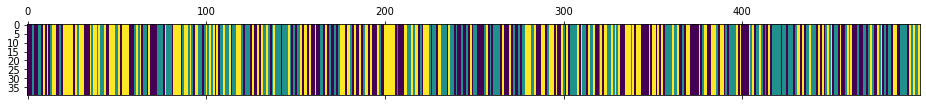

<Figure size 432x288 with 0 Axes>

N [[54. 51. 66.]
 [58. 63. 44.]
 [59. 50. 54.]]
alphas [[1.91195611 0.4164068  0.5533289 ]
 [0.83295223 1.49541068 0.5533289 ]
 [0.83295223 0.4164068  1.63233279]]
M [[6. 5. 2.]
 [3. 6. 3.]
 [7. 3. 7.]]
sum_w [[2.]
 [5.]
 [5.]]
barM [[4. 5. 2.]
 [3. 1. 3.]
 [7. 3. 2.]]
pi_z [[0.3249906  0.30232882 0.37268058]
 [0.36644031 0.36421216 0.26934753]
 [0.39462013 0.27602772 0.32935215]]
beta_vec [0.67264347 0.1830993  0.14425723]
hyper>> a_k: 3.50507155268842  gamma: 0.4143367838843065  rho: 0.26097093582041986


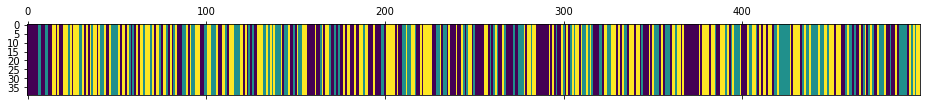

<Figure size 432x288 with 0 Axes>

N [[68. 37. 67.]
 [37. 55. 51.]
 [67. 51. 66.]]
alphas [[2.65710365 0.47429122 0.37367668]
 [1.74238185 1.38901302 0.37367668]
 [1.74238185 0.47429122 1.28839849]]
M [[7. 5. 3.]
 [3. 6. 2.]
 [7. 5. 6.]]
sum_w [[4.]
 [6.]
 [5.]]
barM [[3. 5. 3.]
 [3. 0. 2.]
 [7. 5. 1.]]
pi_z [[0.41646969 0.1726609  0.41086941]
 [0.25430955 0.35367238 0.39201808]
 [0.35144623 0.2576884  0.39086537]]
beta_vec [0.49713298 0.32833326 0.17453376]
hyper>> a_k: 2.853873097921159  gamma: 0.4693241058663415  rho: 0.3147809579581565


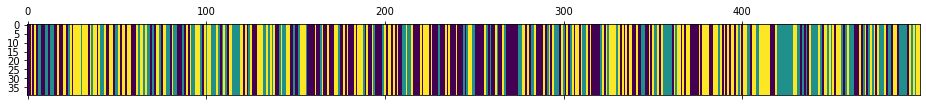

<Figure size 432x288 with 0 Axes>

N [[71. 37. 72.]
 [32. 53. 53.]
 [77. 48. 56.]]
alphas [[1.87050246 0.64206495 0.34130569]
 [0.97215755 1.54040986 0.34130569]
 [0.97215755 0.64206495 1.2396506 ]]
M [[7. 5. 2.]
 [3. 7. 3.]
 [4. 3. 5.]]
sum_w [[5.]
 [4.]
 [4.]]
barM [[2. 5. 2.]
 [3. 3. 3.]
 [4. 3. 1.]]
pi_z [[0.43648407 0.22653018 0.33698575]
 [0.20575859 0.41677596 0.37746545]
 [0.38970275 0.26421374 0.34608351]]
beta_vec [0.25197567 0.34760836 0.40041597]
hyper>> a_k: 2.757344038799795  gamma: 0.10984569100294143  rho: 0.3677208598138478


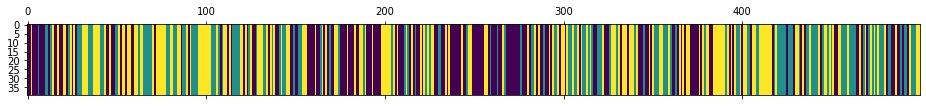

<Figure size 432x288 with 0 Axes>

N [[77. 26. 69.]
 [38. 61. 46.]
 [57. 58. 67.]]
alphas [[1.45323011 0.60602428 0.69808965]
 [0.43929719 1.6199572  0.69808965]
 [0.43929719 0.60602428 1.71202257]]
M [[10.  1.  5.]
 [ 3.  7.  3.]
 [ 5.  5.  5.]]
sum_w [[8.]
 [5.]
 [3.]]
barM [[2. 1. 5.]
 [3. 2. 3.]
 [5. 5. 2.]]
pi_z [[0.44986639 0.18943467 0.36069893]
 [0.27159907 0.44938986 0.27901107]
 [0.30471836 0.33403909 0.36124254]]
beta_vec [0.29700555 0.35714504 0.34584941]
hyper>> a_k: 3.3854463888867263  gamma: 0.7980473653796182  rho: 0.31114996748852175


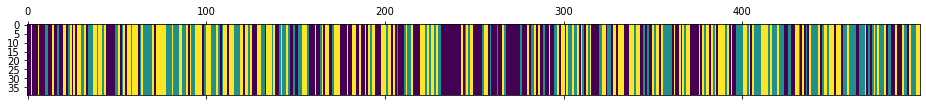

<Figure size 432x288 with 0 Axes>

N [[82. 27. 63.]
 [37. 60. 51.]
 [53. 61. 65.]]
alphas [[1.74601774 0.83288539 0.80654326]
 [0.69263621 1.88626692 0.80654326]
 [0.69263621 0.83288539 1.8599248 ]]
M [[ 7.  3.  3.]
 [ 2. 10.  1.]
 [ 6.  2.  8.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[2. 3. 3.]
 [2. 6. 1.]
 [6. 2. 3.]]
pi_z [[0.49548971 0.16222209 0.3422882 ]
 [0.25200179 0.48076794 0.26723028]
 [0.29964433 0.41736201 0.28299366]]
beta_vec [0.4165205  0.34375728 0.23972222]
hyper>> a_k: 3.005926982611678  gamma: 0.30451484179474664  rho: 0.3137821901919485


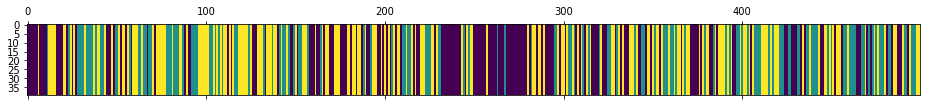

<Figure size 432x288 with 0 Axes>

N [[87. 20. 65.]
 [32. 57. 52.]
 [53. 64. 69.]]
alphas [[1.80237178 0.70907523 0.49447997]
 [0.85916543 1.65228158 0.49447997]
 [0.85916543 0.70907523 1.43768633]]
M [[9. 2. 4.]
 [4. 7. 5.]
 [9. 6. 6.]]
sum_w [[4.]
 [4.]
 [2.]]
barM [[5. 2. 4.]
 [4. 3. 5.]
 [9. 6. 4.]]
pi_z [[0.52939067 0.07982224 0.39078709]
 [0.2519131  0.43316272 0.31492417]
 [0.26126902 0.34073817 0.39799281]]
beta_vec [0.53118466 0.23838672 0.23042862]
hyper>> a_k: 3.6821524787402833  gamma: 1.2103859070050067  rho: 0.20736095591902956


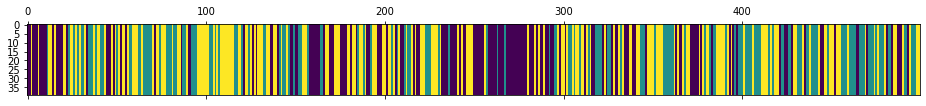

<Figure size 432x288 with 0 Axes>

N [[79. 20. 58.]
 [29. 70. 53.]
 [49. 62. 79.]]
alphas [[2.31385967 0.69575973 0.67253308]
 [1.55032501 1.45929438 0.67253308]
 [1.55032501 0.69575973 1.43606774]]
M [[8. 3. 4.]
 [3. 8. 3.]
 [6. 2. 7.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[5. 3. 4.]
 [3. 5. 3.]
 [6. 2. 4.]]
pi_z [[0.53119523 0.14819299 0.32061178]
 [0.14724673 0.4991433  0.35360996]
 [0.26710095 0.31775658 0.41514247]]
beta_vec [0.34140468 0.28486311 0.37373221]
hyper>> a_k: 3.667987206267463  gamma: 0.6737171930531689  rho: 0.2985661065262661


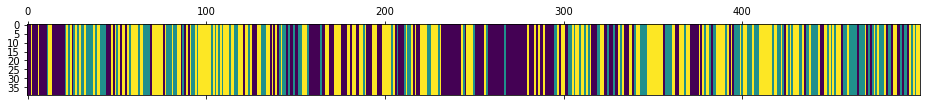

<Figure size 432x288 with 0 Axes>

N [[91. 22. 48.]
 [29. 53. 60.]
 [41. 67. 88.]]
alphas [[1.97351989 0.73291021 0.96155711]
 [0.87838323 1.82804687 0.96155711]
 [0.87838323 0.73291021 2.05669377]]
M [[10.  2.  7.]
 [ 5.  4.  3.]
 [ 4.  4.  7.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[6. 2. 7.]
 [5. 2. 3.]
 [4. 4. 3.]]
pi_z [[0.52454924 0.08339735 0.39205341]
 [0.23650095 0.38856061 0.37493844]
 [0.2086996  0.30210178 0.48919862]]
beta_vec [0.49697342 0.16961381 0.33341277]
hyper>> a_k: 3.349241125613314  gamma: 0.5873588276748987  rho: 0.21471136077084652


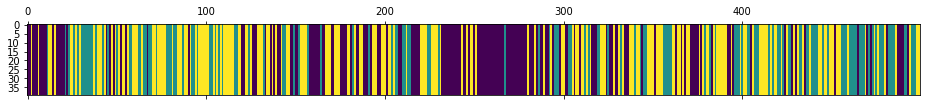

<Figure size 432x288 with 0 Axes>

N [[90. 22. 53.]
 [26. 58. 55.]
 [49. 59. 87.]]
alphas [[2.02622035 0.44610485 0.87691593]
 [1.30710023 1.16522497 0.87691593]
 [1.30710023 0.44610485 1.59603605]]
M [[8. 3. 2.]
 [5. 5. 4.]
 [4. 1. 8.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[4. 3. 2.]
 [5. 3. 4.]
 [4. 1. 6.]]
pi_z [[0.515997   0.1285085  0.3554945 ]
 [0.1629465  0.44408371 0.39296979]
 [0.25034426 0.26231272 0.48734302]]
beta_vec [0.48483427 0.2835361  0.23162962]
hyper>> a_k: 2.754095459006559  gamma: 0.5310584071526628  rho: 0.14723525710815863


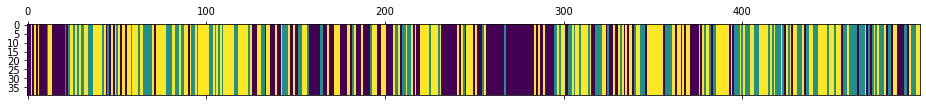

<Figure size 432x288 with 0 Axes>

N [[88. 15. 55.]
 [26. 59. 52.]
 [44. 63. 97.]]
alphas [[1.54417955 0.66591162 0.54400429]
 [1.1386796  1.07141157 0.54400429]
 [1.1386796  0.66591162 0.94950425]]
M [[4. 2. 2.]
 [5. 3. 6.]
 [5. 8. 3.]]
sum_w [[2.]
 [2.]
 [0.]]
barM [[2. 2. 2.]
 [5. 1. 6.]
 [5. 8. 3.]]
pi_z [[0.53307125 0.10718153 0.35974722]
 [0.19973991 0.42465924 0.37560085]
 [0.20858782 0.35652318 0.434889  ]]
beta_vec [0.35243052 0.35905377 0.28851571]
hyper>> a_k: 2.3868913194044015  gamma: 0.16455494613516877  rho: 0.18750419982320454


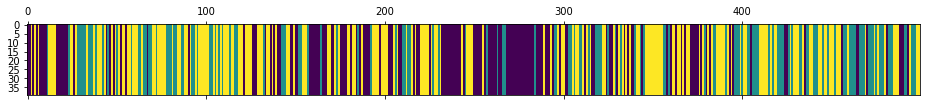

<Figure size 432x288 with 0 Axes>

N [[84. 20. 56.]
 [31. 58. 52.]
 [45. 63. 90.]]
alphas [[1.13103446 0.69632705 0.55952981]
 [0.68348231 1.1438792  0.55952981]
 [0.68348231 0.69632705 1.00708196]]
M [[7. 3. 5.]
 [1. 3. 2.]
 [3. 5. 3.]]
sum_w [[3.]
 [2.]
 [1.]]
barM [[4. 3. 5.]
 [1. 1. 2.]
 [3. 5. 2.]]
pi_z [[0.55243214 0.10522351 0.34234436]
 [0.24477313 0.4211962  0.33403067]
 [0.21073182 0.31138619 0.47788199]]
beta_vec [0.08336688 0.29199097 0.62464216]
hyper>> a_k: 2.3461496371284336  gamma: 1.1484707902282751  rho: 0.2071998227263995


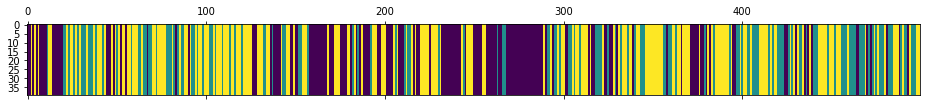

<Figure size 432x288 with 0 Axes>

N [[94. 17. 46.]
 [29. 53. 58.]
 [34. 70. 98.]]
alphas [[0.6411865  0.54311133 1.1618518 ]
 [0.15506471 1.02923312 1.1618518 ]
 [0.15506471 0.54311133 1.64797359]]
M [[ 7.  1.  5.]
 [ 1.  5. 10.]
 [ 1.  2. 10.]]
sum_w [[6.]
 [4.]
 [2.]]
barM [[ 1.  1.  5.]
 [ 1.  1. 10.]
 [ 1.  2.  8.]]
pi_z [[0.64153036 0.07854066 0.27992898]
 [0.23299079 0.38165835 0.38535086]
 [0.14437343 0.33774051 0.51788606]]
beta_vec [0.18439202 0.20658781 0.60902017]
hyper>> a_k: 2.5831602519244887  gamma: 1.0625100581792555  rho: 0.377816411674625


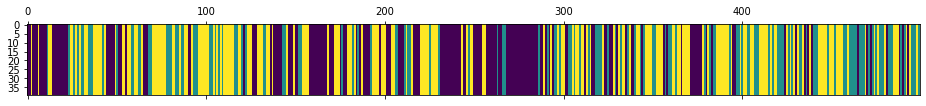

<Figure size 432x288 with 0 Axes>

N [[105.  22.  42.]
 [ 33.  51.  53.]
 [ 31.  65.  97.]]
alphas [[1.27231517 0.33202791 0.97881716]
 [0.29635484 1.30798825 0.97881716]
 [0.29635484 0.33202791 1.9547775 ]]
M [[ 4.  2.  8.]
 [ 2.  3.  6.]
 [ 3.  2. 11.]]
sum_w [[3.]
 [3.]
 [8.]]
barM [[1. 2. 8.]
 [2. 0. 6.]
 [3. 2. 3.]]
pi_z [[0.58392823 0.14527892 0.27079285]
 [0.28105911 0.3390597  0.37988119]
 [0.1539962  0.33839863 0.50760516]]
beta_vec [0.17102719 0.14669553 0.68227728]
hyper>> a_k: 4.141509011050537  gamma: 0.5033107335676424  rho: 0.4064858983815479


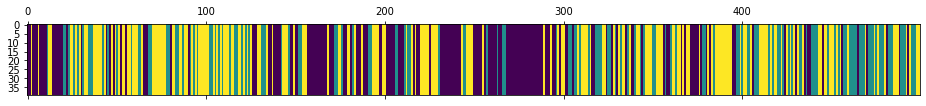

<Figure size 432x288 with 0 Axes>

N [[99. 19. 51.]
 [37. 52. 51.]
 [33. 69. 88.]]
alphas [[2.10385738 0.36058407 1.67706757]
 [0.42039236 2.04404908 1.67706757]
 [0.42039236 0.36058407 3.36053258]]
M [[13.  3.  8.]
 [ 2. 10.  6.]
 [ 2.  2.  6.]]
sum_w [[8.]
 [9.]
 [5.]]
barM [[5. 3. 8.]
 [2. 1. 6.]
 [2. 2. 1.]]
pi_z [[0.63240879 0.10054663 0.26704458]
 [0.22395229 0.40893728 0.36711044]
 [0.19756851 0.36564223 0.43678926]]
beta_vec [0.36110975 0.28151551 0.35737475]
hyper>> a_k: 3.291489645423617  gamma: 0.5603333147356807  rho: 0.3803888293142952


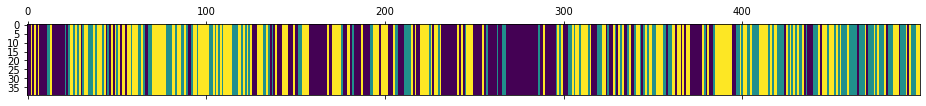

<Figure size 432x288 with 0 Axes>

N [[98. 21. 46.]
 [33. 54. 57.]
 [34. 69. 87.]]
alphas [[1.98850891 0.57413504 0.72884569]
 [0.73646302 1.82618093 0.72884569]
 [0.73646302 0.57413504 1.98089159]]
M [[9. 3. 6.]
 [1. 6. 2.]
 [4. 6. 7.]]
sum_w [[4.]
 [3.]
 [5.]]
barM [[5. 3. 6.]
 [1. 3. 2.]
 [4. 6. 2.]]
pi_z [[0.63268908 0.12526824 0.24204268]
 [0.1596534  0.46693697 0.37340963]
 [0.16786113 0.31287234 0.51926653]]
beta_vec [0.38164366 0.40229193 0.21606442]
hyper>> a_k: 3.726757577428965  gamma: 0.35919889903206137  rho: 0.27308516391387333


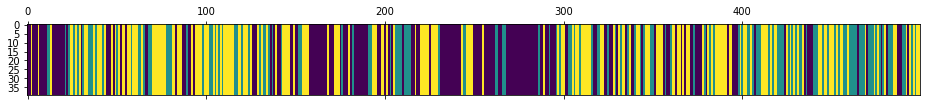

<Figure size 432x288 with 0 Axes>

N [[103.  28.  44.]
 [ 37.  45.  55.]
 [ 35.  64.  88.]]
alphas [[2.05160838 1.08982306 0.58532614]
 [1.03388617 2.10754526 0.58532614]
 [1.03388617 1.08982306 1.60304835]]
M [[ 8.  4.  3.]
 [ 5. 11.  5.]
 [ 4.  5.  6.]]
sum_w [[4.]
 [6.]
 [3.]]
barM [[4. 4. 3.]
 [5. 5. 5.]
 [4. 5. 3.]]
pi_z [[0.61936533 0.15414755 0.22648712]
 [0.26825915 0.37660723 0.35513362]
 [0.22760221 0.29196302 0.48043476]]
beta_vec [0.33147765 0.37086253 0.29765982]
hyper>> a_k: 3.997460979328909  gamma: 0.6251873156654031  rho: 0.23531654240487884


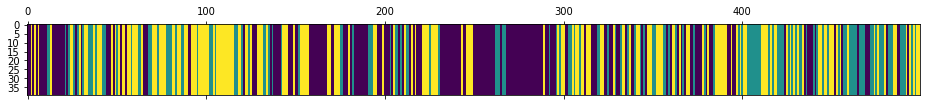

<Figure size 432x288 with 0 Axes>

N [[113.  31.  41.]
 [ 36.  49.  51.]
 [ 36.  56.  86.]]
alphas [[1.95392702 1.13364972 0.90988424]
 [1.01325832 2.07431841 0.90988424]
 [1.01325832 1.13364972 1.85055294]]
M [[7. 3. 2.]
 [6. 8. 5.]
 [5. 4. 7.]]
sum_w [[5.]
 [3.]
 [4.]]
barM [[2. 3. 2.]
 [6. 5. 5.]
 [5. 4. 3.]]
pi_z [[0.58587141 0.1674409  0.24668769]
 [0.27361361 0.39295119 0.3334352 ]
 [0.2027854  0.30982185 0.48739276]]
beta_vec [0.32586887 0.35397848 0.32015265]
hyper>> a_k: 3.163764042881442  gamma: 0.7029942801196357  rho: 0.22922448569666415


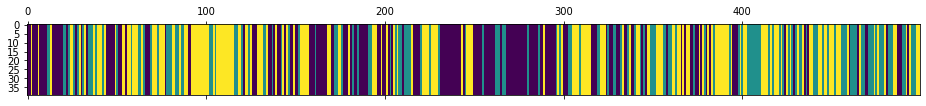

<Figure size 432x288 with 0 Axes>

N [[101.  31.  41.]
 [ 43.  53.  49.]
 [ 29.  61.  91.]]
alphas [[1.51986031 0.86319488 0.78070885]
 [0.79464813 1.58840707 0.78070885]
 [0.79464813 0.86319488 1.50592103]]
M [[10.  4.  7.]
 [ 2.  5.  6.]
 [ 5.  2.  7.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[7. 4. 7.]
 [2. 3. 6.]
 [5. 2. 2.]]
pi_z [[0.58270017 0.16305017 0.25424966]
 [0.31276153 0.35400568 0.33323278]
 [0.16768061 0.35683913 0.47548026]]
beta_vec [0.29607123 0.20735068 0.49657809]
hyper>> a_k: 4.2026597154827705  gamma: 0.5612885878687172  rho: 0.21239803883901234


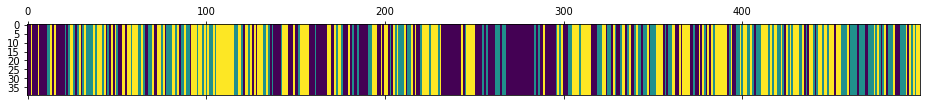

<Figure size 432x288 with 0 Axes>

N [[86. 33. 49.]
 [49. 48. 51.]
 [33. 67. 83.]]
alphas [[1.87263928 0.68633552 1.64368492]
 [0.9800026  1.5789722  1.64368492]
 [0.9800026  0.68633552 2.5363216 ]]
M [[ 8.  1.  7.]
 [ 4.  6.  5.]
 [ 9.  3. 10.]]
sum_w [[5.]
 [5.]
 [5.]]
barM [[3. 1. 7.]
 [4. 1. 5.]
 [9. 3. 5.]]
pi_z [[0.50379984 0.18282714 0.31337302]
 [0.3784334  0.27035915 0.35120744]
 [0.13996392 0.43330883 0.42672726]]
beta_vec [0.46492866 0.15453885 0.3805325 ]
hyper>> a_k: 4.554692062610458  gamma: 1.1097092599424383  rho: 0.23806293784904667


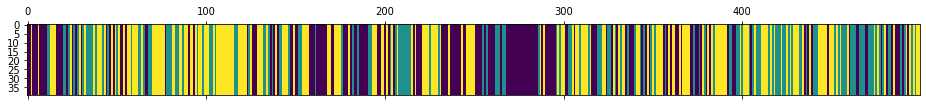

<Figure size 432x288 with 0 Axes>

N [[83. 32. 52.]
 [47. 48. 47.]
 [37. 62. 91.]]
alphas [[2.69778652 0.53630987 1.32059567]
 [1.61348315 1.62061325 1.32059567]
 [1.61348315 0.53630987 2.40489904]]
M [[6. 3. 6.]
 [7. 8. 5.]
 [7. 2. 7.]]
sum_w [[1.]
 [5.]
 [2.]]
barM [[5. 3. 6.]
 [7. 3. 5.]
 [7. 2. 5.]]
pi_z [[0.45877676 0.17946413 0.36175911]
 [0.35786739 0.42332248 0.21881013]
 [0.19805089 0.30763742 0.49431169]]
beta_vec [0.42308684 0.20808995 0.3688232 ]
hyper>> a_k: 3.866710376201118  gamma: 0.603618473450925  rho: 0.12371686043879354


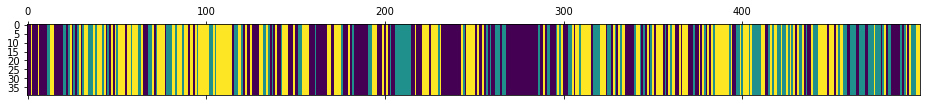

<Figure size 432x288 with 0 Axes>

N [[95. 32. 54.]
 [44. 52. 40.]
 [42. 52. 88.]]
alphas [[1.91193643 0.70507808 1.24969587]
 [1.43355916 1.18345535 1.24969587]
 [1.43355916 0.70507808 1.72807314]]
M [[3. 1. 4.]
 [5. 7. 8.]
 [2. 6. 9.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[1. 1. 4.]
 [5. 5. 8.]
 [2. 6. 6.]]
pi_z [[0.4766563  0.20686588 0.31647782]
 [0.26383625 0.43681553 0.29934822]
 [0.2519062  0.27067504 0.47741876]]
beta_vec [0.16668318 0.4169671  0.41634972]
hyper>> a_k: 3.874460154550112  gamma: 1.3272112462670198  rho: 0.10852797346243556


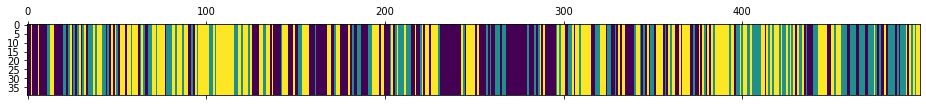

<Figure size 432x288 with 0 Axes>

N [[91. 35. 51.]
 [49. 49. 41.]
 [37. 55. 91.]]
alphas [[0.99620648 1.44019305 1.43806063]
 [0.57571917 1.86068035 1.43806063]
 [0.57571917 1.44019305 1.85854794]]
M [[4. 4. 6.]
 [1. 6. 5.]
 [4. 2. 9.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[2. 4. 6.]
 [1. 5. 5.]
 [4. 2. 7.]]
pi_z [[0.50140228 0.22974892 0.2688488 ]
 [0.33415076 0.39547328 0.27037595]
 [0.22109268 0.24486947 0.53403785]]
beta_vec [0.2150732  0.46909992 0.31582688]
hyper>> a_k: 3.008744470847641  gamma: 0.23996097929529595  rho: 0.09778285217371592


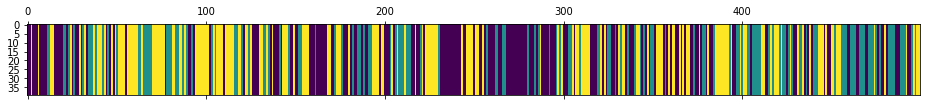

<Figure size 432x288 with 0 Axes>

N [[93. 41. 52.]
 [54. 51. 35.]
 [39. 48. 86.]]
alphas [[0.8780286  1.2733909  0.85732497]
 [0.58382498 1.56759452 0.85732497]
 [0.58382498 1.2733909  1.15152858]]
M [[6. 5. 4.]
 [4. 3. 3.]
 [4. 5. 8.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[4. 5. 4.]
 [4. 3. 3.]
 [4. 5. 5.]]
pi_z [[0.41272263 0.2141511  0.37312627]
 [0.33676457 0.36719878 0.29603665]
 [0.2361891  0.29933712 0.46447378]]
beta_vec [0.33402499 0.35611787 0.30985715]
hyper>> a_k: 3.9154952639604055  gamma: 0.4940004221562026  rho: 0.16645932235944194


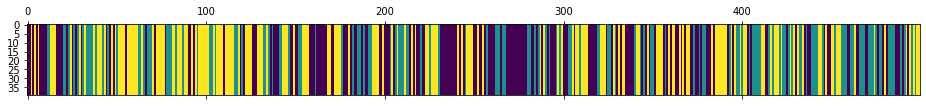

<Figure size 432x288 with 0 Axes>

N [[82. 42. 56.]
 [54. 50. 38.]
 [44. 50. 83.]]
alphas [[1.74193625 1.16227063 1.01128838]
 [1.09016556 1.81404132 1.01128838]
 [1.09016556 1.16227063 1.66305907]]
M [[ 4. 10.  7.]
 [ 6.  5.  8.]
 [ 6.  5.  5.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[ 2. 10.  7.]
 [ 6.  3.  8.]
 [ 6.  5.  4.]]
pi_z [[0.4999062  0.23209491 0.26799889]
 [0.3745455  0.32990402 0.29555048]
 [0.22222825 0.24522196 0.53254979]]
beta_vec [0.21685843 0.36711812 0.41602345]
hyper>> a_k: 7.389206325329598  gamma: 0.13222891350296512  rho: 0.10708661141799654


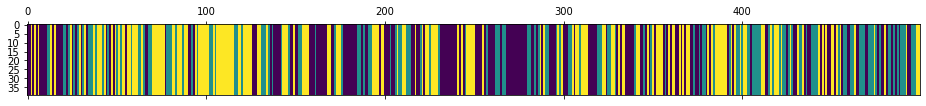

<Figure size 432x288 with 0 Axes>

N [[90. 38. 55.]
 [56. 50. 37.]
 [37. 55. 81.]]
alphas [[2.22209992 2.42221643 2.74488998]
 [1.43081485 3.2135015  2.74488998]
 [1.43081485 2.42221643 3.53617504]]
M [[ 8.  7.  5.]
 [ 6. 10. 11.]
 [ 3. 10. 10.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[ 4.  7.  5.]
 [ 6.  8. 11.]
 [ 3. 10.  8.]]
pi_z [[0.51130503 0.22890981 0.25978516]
 [0.44250211 0.33973539 0.2177625 ]
 [0.23754564 0.29989677 0.46255759]]
beta_vec [0.17199091 0.31909282 0.50891627]
hyper>> a_k: 7.0999955591337205  gamma: 0.4276511306104645  rho: 0.1540214541453798


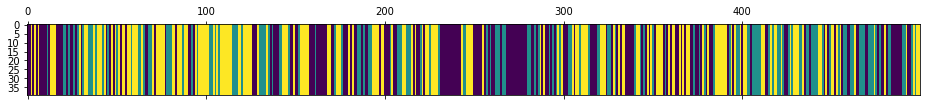

<Figure size 432x288 with 0 Axes>

N [[86. 42. 54.]
 [55. 48. 40.]
 [41. 53. 80.]]
alphas [[2.1266054  1.91661315 3.05677701]
 [1.03305376 3.01016479 3.05677701]
 [1.03305376 1.91661315 4.15032865]]
M [[ 5.  4.  9.]
 [ 3.  9. 10.]
 [ 2.  5. 11.]]
sum_w [[0.]
 [5.]
 [2.]]
barM [[ 5.  4.  9.]
 [ 3.  4. 10.]
 [ 2.  5.  9.]]
pi_z [[0.43205157 0.23671206 0.33123637]
 [0.38592967 0.34309817 0.27097216]
 [0.24845735 0.28154455 0.4699981 ]]
beta_vec [0.18101485 0.22436855 0.5946166 ]
hyper>> a_k: 5.052206876110881  gamma: 0.40680004911884105  rho: 0.14268046411714147


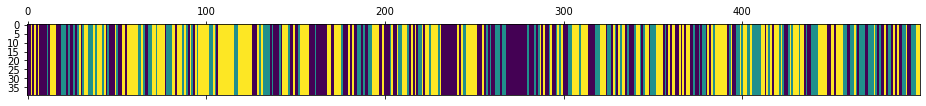

<Figure size 432x288 with 0 Axes>

N [[78. 41. 52.]
 [50. 47. 40.]
 [43. 49. 99.]]
alphas [[1.50489091 0.97181998 2.57549599]
 [0.78403968 1.6926712  2.57549599]
 [0.78403968 0.97181998 3.29634721]]
M [[ 6.  3.  5.]
 [ 3.  6.  7.]
 [ 6.  8. 10.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[3. 3. 5.]
 [3. 4. 7.]
 [6. 8. 6.]]
pi_z [[0.44524805 0.30671484 0.24803712]
 [0.38685356 0.32871428 0.28443216]
 [0.24336566 0.26451381 0.49212054]]
beta_vec [0.15900805 0.43709056 0.40390139]
hyper>> a_k: 4.718742777414652  gamma: 0.5286063093778346  rho: 0.23004358277353193


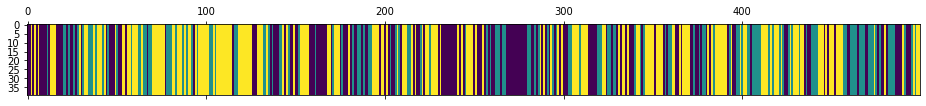

<Figure size 432x288 with 0 Axes>

N [[ 75.  43.  52.]
 [ 56.  46.  36.]
 [ 39.  49. 103.]]
alphas [[1.66322872 1.5880489  1.46746516]
 [0.57771223 2.67356539 1.46746516]
 [0.57771223 1.5880489  2.55298165]]
M [[ 7. 10.  5.]
 [ 3.  8.  3.]
 [ 4.  6. 13.]]
sum_w [[6.]
 [4.]
 [6.]]
barM [[ 1. 10.  5.]
 [ 3.  4.  3.]
 [ 4.  6.  7.]]
pi_z [[0.43597515 0.22034004 0.34368481]
 [0.41568661 0.34704418 0.23726922]
 [0.22163349 0.19810482 0.5802617 ]]
beta_vec [0.20670308 0.44318197 0.35011495]
hyper>> a_k: 5.425155713938731  gamma: 1.1609798054321747  rho: 0.29971875435698736


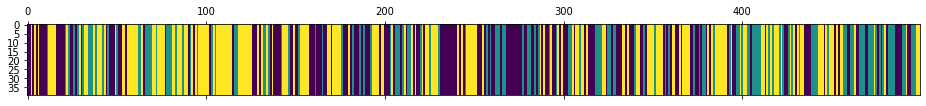

<Figure size 432x288 with 0 Axes>

N [[82. 36. 60.]
 [59. 45. 31.]
 [37. 54. 95.]]
alphas [[2.41131377 1.68370804 1.3301339 ]
 [0.78529286 3.30972896 1.3301339 ]
 [0.78529286 1.68370804 2.95615481]]
M [[ 5.  9.  3.]
 [ 3. 11.  4.]
 [ 2.  9.  7.]]
sum_w [[2.]
 [7.]
 [2.]]
barM [[3. 9. 3.]
 [3. 4. 4.]
 [2. 9. 5.]]
pi_z [[0.47896907 0.19161535 0.32941558]
 [0.3971331  0.42466624 0.17820066]
 [0.18512131 0.30391674 0.51096195]]
beta_vec [0.13907963 0.7030379  0.15788246]
hyper>> a_k: 3.7932749455021666  gamma: 1.1730437951441581  rho: 0.22138726305580167


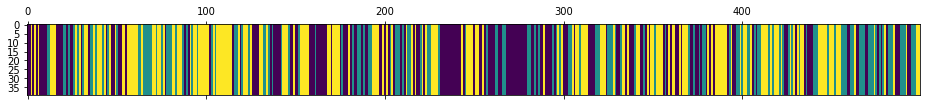

<Figure size 432x288 with 0 Axes>

N [[85. 37. 55.]
 [59. 45. 37.]
 [33. 59. 89.]]
alphas [[1.25055337 2.07641696 0.46630462]
 [0.41077061 2.91619972 0.46630462]
 [0.41077061 2.07641696 1.30608738]]
M [[7. 6. 5.]
 [3. 8. 3.]
 [3. 8. 2.]]
sum_w [[5.]
 [0.]
 [1.]]
barM [[2. 6. 5.]
 [3. 8. 3.]
 [3. 8. 1.]]
pi_z [[0.47367178 0.23138464 0.29494357]
 [0.43359606 0.32973173 0.23667221]
 [0.21677882 0.28791847 0.49530271]]
beta_vec [0.32536199 0.45457629 0.22006172]
hyper>> a_k: 4.058221452854183  gamma: 0.8276512555703645  rho: 0.19513522860739463


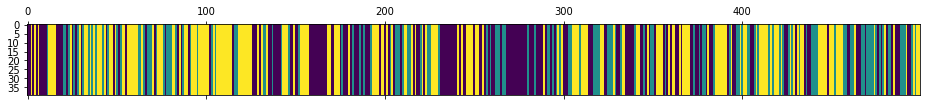

<Figure size 432x288 with 0 Axes>

N [[85. 37. 57.]
 [62. 38. 32.]
 [32. 57. 99.]]
alphas [[1.85463819 1.48479139 0.71879188]
 [1.06273622 2.27669336 0.71879188]
 [1.06273622 1.48479139 1.51069385]]
M [[9. 4. 4.]
 [7. 7. 3.]
 [5. 5. 8.]]
sum_w [[5.]
 [4.]
 [4.]]
barM [[4. 4. 4.]
 [7. 3. 3.]
 [5. 5. 4.]]
pi_z [[0.45994832 0.16519064 0.37486104]
 [0.54686452 0.23779303 0.21534244]
 [0.1376592  0.33252955 0.52981126]]
beta_vec [0.52273556 0.27493577 0.20232867]
hyper>> a_k: 5.159550522159844  gamma: 0.314431982719632  rho: 0.20807573362801557


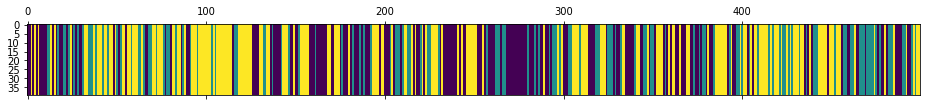

<Figure size 432x288 with 0 Axes>

N [[ 86.  36.  55.]
 [ 60.  40.  33.]
 [ 31.  57. 101.]]
alphas [[3.20946079 1.1233802  0.82670953]
 [2.13588353 2.19695746 0.82670953]
 [2.13588353 1.1233802  1.90028679]]
M [[13.  3.  8.]
 [10.  5.  5.]
 [ 5.  3.  4.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[ 9.  3.  8.]
 [10.  3.  5.]
 [ 5.  3.  1.]]
pi_z [[0.50181613 0.19138627 0.30679761]
 [0.46577056 0.2566454  0.27758404]
 [0.14246826 0.31276892 0.54476283]]
beta_vec [0.57269346 0.20896744 0.2183391 ]
hyper>> a_k: 4.638699022350905  gamma: 0.32704106353584667  rho: 0.24295524833320065


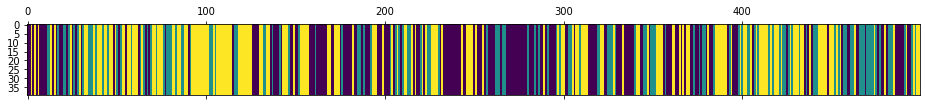

<Figure size 432x288 with 0 Axes>

N [[94. 34. 56.]
 [59. 37. 35.]
 [31. 60. 93.]]
alphas [[3.13812549 0.73383152 0.76674201]
 [2.01112921 1.8608278  0.76674201]
 [2.01112921 0.73383152 1.89373828]]
M [[9. 4. 3.]
 [3. 5. 4.]
 [8. 5. 5.]]
sum_w [[3.]
 [4.]
 [2.]]
barM [[6. 4. 3.]
 [3. 1. 4.]
 [8. 5. 3.]]
pi_z [[0.49980651 0.18220246 0.31799103]
 [0.40303569 0.31320965 0.28375466]
 [0.20449599 0.26888494 0.52661907]]
beta_vec [0.40149986 0.34905518 0.24944496]
hyper>> a_k: 3.8168923505375036  gamma: 0.3482358161929053  rho: 0.19596512557042262


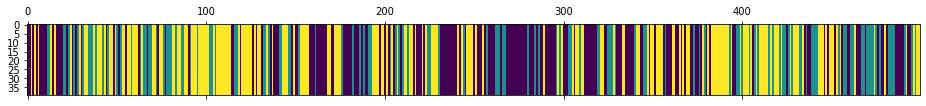

<Figure size 432x288 with 0 Axes>

N [[93. 34. 58.]
 [52. 39. 38.]
 [40. 56. 89.]]
alphas [[1.98014657 1.07122052 0.76552527]
 [1.23216878 1.81919831 0.76552527]
 [1.23216878 1.07122052 1.51350305]]
M [[7. 5. 6.]
 [2. 4. 5.]
 [6. 4. 8.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[2. 5. 6.]
 [2. 1. 5.]
 [6. 4. 5.]]
pi_z [[0.54628012 0.17765276 0.27606713]
 [0.37063643 0.40153888 0.22782469]
 [0.18682002 0.30303258 0.5101474 ]]
beta_vec [0.33960949 0.42325821 0.2371323 ]
hyper>> a_k: 3.2132768909097917  gamma: 0.3467236177953089  rho: 0.26548897430893625


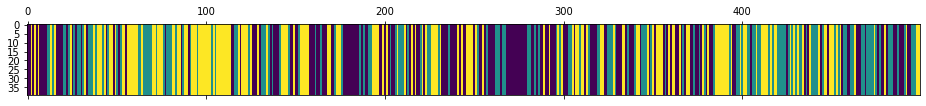

<Figure size 432x288 with 0 Axes>

N [[82. 40. 55.]
 [61. 51. 39.]
 [34. 60. 77.]]
alphas [[1.65463159 0.99896867 0.55967664]
 [0.801542   1.85205825 0.55967664]
 [0.801542   0.99896867 1.41276622]]
M [[4. 4. 4.]
 [3. 8. 1.]
 [3. 3. 7.]]
sum_w [[3.]
 [4.]
 [5.]]
barM [[1. 4. 4.]
 [3. 4. 1.]
 [3. 3. 2.]]
pi_z [[0.42739065 0.20768995 0.36491941]
 [0.48610886 0.30633699 0.20755415]
 [0.18185754 0.38099499 0.43714747]]
beta_vec [0.29884297 0.29485068 0.40630635]
hyper>> a_k: 2.9611653730163408  gamma: 0.9929793462630964  rho: 0.3995476261536608


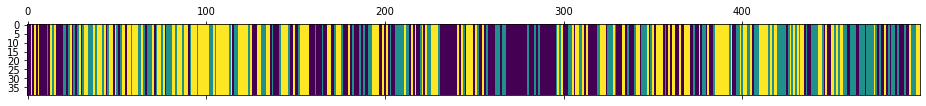

<Figure size 432x288 with 0 Axes>

N [[85. 41. 50.]
 [57. 52. 42.]
 [34. 58. 80.]]
alphas [[1.71448099 0.52425594 0.72242844]
 [0.53135439 1.70738254 0.72242844]
 [0.53135439 0.52425594 1.90555504]]
M [[10.  5.  6.]
 [ 5.  4.  5.]
 [ 5.  5.  9.]]
sum_w [[5.]
 [3.]
 [6.]]
barM [[5. 5. 6.]
 [5. 1. 5.]
 [5. 5. 3.]]
pi_z [[0.44337549 0.23251657 0.32410794]
 [0.44188326 0.35392577 0.20419097]
 [0.12850819 0.41567485 0.45581696]]
beta_vec [0.3608649  0.32801293 0.31112216]
hyper>> a_k: 4.3368567899043615  gamma: 0.37643588265271266  rho: 0.3123144421864026


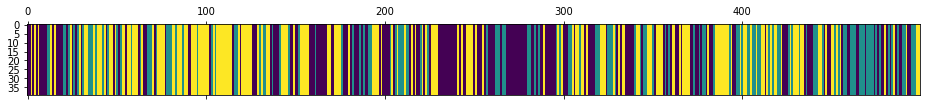

<Figure size 432x288 with 0 Axes>

N [[90. 36. 59.]
 [58. 43. 34.]
 [37. 56. 86.]]
alphas [[2.43070425 0.97826374 0.92788881]
 [1.07624124 2.33272675 0.92788881]
 [1.07624124 0.97826374 2.28235182]]
M [[ 3.  5.  3.]
 [ 6.  6.  3.]
 [ 3.  5. 10.]]
sum_w [[2.]
 [4.]
 [7.]]
barM [[1. 5. 3.]
 [6. 2. 3.]
 [3. 5. 3.]]
pi_z [[0.46511452 0.20196459 0.33292089]
 [0.46076602 0.32757423 0.21165975]
 [0.22165636 0.29810204 0.4802416 ]]
beta_vec [0.5077175  0.25960973 0.23267276]
hyper>> a_k: 3.12864123245779  gamma: 0.442490533263041  rho: 0.41106465274319526


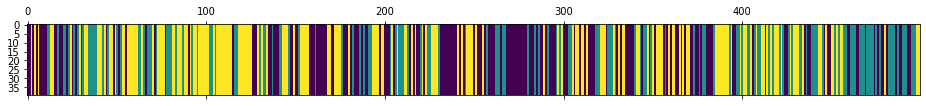

<Figure size 432x288 with 0 Axes>

N [[84. 39. 54.]
 [58. 51. 36.]
 [35. 55. 87.]]
alphas [[2.22157755 0.47834843 0.42871525]
 [0.93550373 1.76442225 0.42871525]
 [0.93550373 0.47834843 1.71478907]]
M [[10.  3.  5.]
 [ 6.  4.  1.]
 [ 2.  6.  6.]]
sum_w [[8.]
 [2.]
 [3.]]
barM [[2. 3. 5.]
 [6. 2. 1.]
 [2. 6. 3.]]
pi_z [[0.5380521  0.18213787 0.27981003]
 [0.43284132 0.36197864 0.20518004]
 [0.15924028 0.31414691 0.52661281]]
beta_vec [0.22430985 0.22005324 0.55563691]
hyper>> a_k: 3.5875340799778677  gamma: 0.18428951248936093  rho: 0.28435781505921764


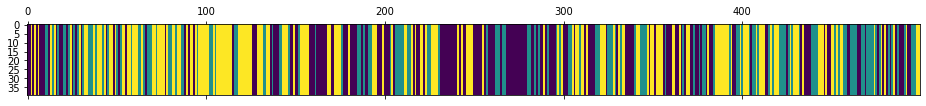

<Figure size 432x288 with 0 Axes>

N [[88. 36. 53.]
 [52. 52. 38.]
 [37. 54. 89.]]
alphas [[1.59603438 0.56496264 1.42653706]
 [0.57589103 1.58510599 1.42653706]
 [0.57589103 0.56496264 2.44668041]]
M [[12.  3.  7.]
 [ 4.  6.  5.]
 [ 3.  2. 12.]]
sum_w [[8.]
 [3.]
 [3.]]
barM [[4. 3. 7.]
 [4. 3. 5.]
 [3. 2. 9.]]
pi_z [[0.46987711 0.21554826 0.31457463]
 [0.36189918 0.37476505 0.26333577]
 [0.24763409 0.2553747  0.49699121]]
beta_vec [0.35120208 0.18155817 0.46723976]
hyper>> a_k: 4.237513070287208  gamma: 0.3143251931746039  rho: 0.3110069739052845


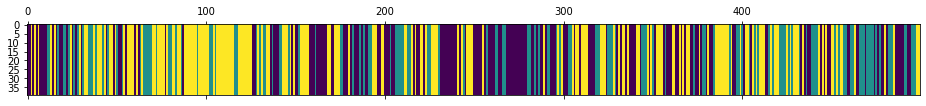

<Figure size 432x288 with 0 Axes>

N [[86. 36. 56.]
 [49. 52. 37.]
 [43. 50. 90.]]
alphas [[2.34327166 0.5300803  1.36416111]
 [1.02537554 1.84797642 1.36416111]
 [1.02537554 0.5300803  2.68205723]]
M [[ 8.  2.  8.]
 [ 4.  9.  2.]
 [ 6.  3. 10.]]
sum_w [[8.]
 [8.]
 [5.]]
barM [[0. 2. 8.]
 [4. 1. 2.]
 [6. 3. 5.]]
pi_z [[0.54348438 0.16771275 0.28880287]
 [0.26442306 0.41320639 0.32237055]
 [0.20171536 0.2647194  0.53356524]]
beta_vec [0.21254338 0.17032639 0.61713023]
hyper>> a_k: 4.786336396110868  gamma: 1.0246203828330585  rho: 0.4836453175736456


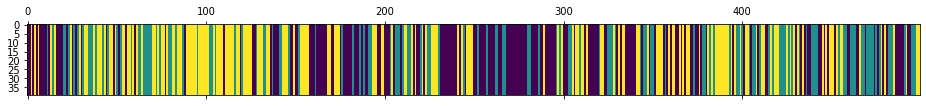

<Figure size 432x288 with 0 Axes>

N [[94. 37. 56.]
 [50. 45. 41.]
 [43. 54. 79.]]
alphas [[2.84017894 0.42095267 1.52520478]
 [0.52528975 2.73584186 1.52520478]
 [0.52528975 0.42095267 3.84009397]]
M [[15.  3.  7.]
 [ 3.  5.  8.]
 [ 1.  2. 13.]]
sum_w [[8.]
 [4.]
 [9.]]
barM [[7. 3. 7.]
 [3. 1. 8.]
 [1. 2. 4.]]
pi_z [[0.45192576 0.23606103 0.31201321]
 [0.38835737 0.33400564 0.27763699]
 [0.28673684 0.20481203 0.50845114]]
beta_vec [0.336291   0.10964947 0.55405954]
hyper>> a_k: 4.871578623474776  gamma: 0.7252101062469681  rho: 0.43409960799748903


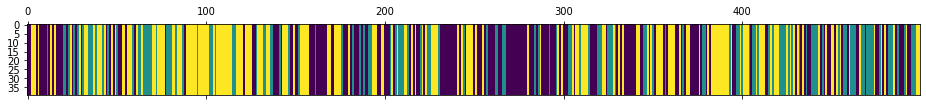

<Figure size 432x288 with 0 Axes>

N [[89. 37. 56.]
 [46. 46. 39.]
 [47. 48. 91.]]
alphas [[3.04184689 0.30228475 1.52744698]
 [0.92709652 2.41703512 1.52744698]
 [0.92709652 0.30228475 3.64219735]]
M [[14.  2.  7.]
 [ 6.  9.  5.]
 [ 3.  2. 11.]]
sum_w [[13.]
 [ 8.]
 [ 5.]]
barM [[1. 2. 7.]
 [6. 1. 5.]
 [3. 2. 6.]]
pi_z [[0.45253747 0.2229115  0.32455104]
 [0.34524788 0.33985355 0.31489856]
 [0.18726111 0.20696332 0.60577558]]
beta_vec [0.34094374 0.25304013 0.40601613]
hyper>> a_k: 4.065481534506573  gamma: 0.24730492160882794  rho: 0.4409682821344485


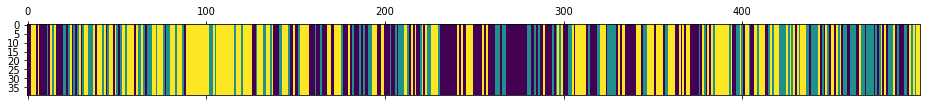

<Figure size 432x288 with 0 Axes>

N [[ 83.  40.  50.]
 [ 49.  44.  40.]
 [ 41.  49. 103.]]
alphas [[2.56762254 0.57509269 0.92276631]
 [0.77487413 2.3678411  0.92276631]
 [0.77487413 0.57509269 2.71551471]]
M [[13.  3.  6.]
 [ 3.  9.  4.]
 [ 3.  8. 11.]]
sum_w [[9.]
 [5.]
 [7.]]
barM [[4. 3. 6.]
 [3. 4. 4.]
 [3. 8. 4.]]
pi_z [[0.48683856 0.23487255 0.27828889]
 [0.31519362 0.38605966 0.29874672]
 [0.18525504 0.29486059 0.51988437]]
beta_vec [0.27264021 0.36612296 0.36123683]
hyper>> a_k: 4.768664456913385  gamma: 0.41516526120449865  rho: 0.37773376838313133


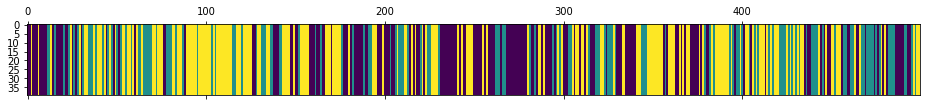

<Figure size 432x288 with 0 Axes>

N [[91. 36. 46.]
 [43. 46. 48.]
 [39. 55. 95.]]
alphas [[2.61031239 1.08642553 1.07192654]
 [0.80902679 2.88771112 1.07192654]
 [0.80902679 1.08642553 2.87321214]]
M [[14.  3.  5.]
 [ 4. 12.  8.]
 [ 5.  4.  7.]]
sum_w [[5.]
 [6.]
 [5.]]
barM [[9. 3. 5.]
 [4. 6. 8.]
 [5. 4. 2.]]
pi_z [[0.51534109 0.18507367 0.29958524]
 [0.32107055 0.3080022  0.37092725]
 [0.22416065 0.29009337 0.48574597]]
beta_vec [0.40086601 0.20758236 0.39155164]
hyper>> a_k: 5.264273000612227  gamma: 0.6757106090387329  rho: 0.17744302648721252


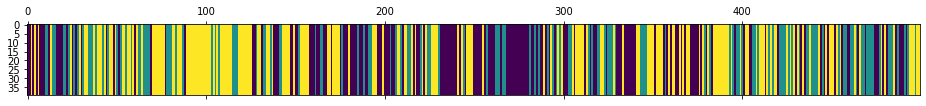

<Figure size 432x288 with 0 Axes>

N [[80. 41. 52.]
 [48. 46. 43.]
 [45. 50. 94.]]
alphas [[2.66992427 0.89886574 1.69548299]
 [1.73581573 1.83297428 1.69548299]
 [1.73581573 0.89886574 2.62959152]]
M [[11.  3.  4.]
 [ 4.  6.  5.]
 [ 6.  5. 10.]]
sum_w [[6.]
 [3.]
 [4.]]
barM [[5. 3. 4.]
 [4. 3. 5.]
 [6. 5. 6.]]
pi_z [[0.46823355 0.18229624 0.34947021]
 [0.31554793 0.37695096 0.30750111]
 [0.26411084 0.26354086 0.4723483 ]]
beta_vec [0.26685621 0.2298997  0.50324409]
hyper>> a_k: 5.5989281917058715  gamma: 1.068783277514996  rho: 0.27277862919972445


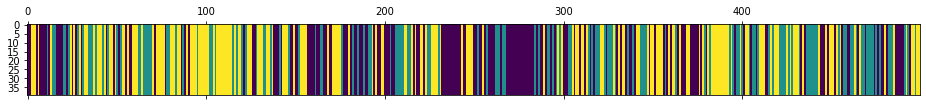

<Figure size 432x288 with 0 Axes>

N [[79. 44. 52.]
 [49. 51. 43.]
 [47. 48. 86.]]
alphas [[2.61381576 0.93607348 2.04903896]
 [1.0865478  2.46334143 2.04903896]
 [1.0865478  0.93607348 3.57630692]]
M [[ 9.  5.  8.]
 [ 6.  8.  5.]
 [ 5.  4. 12.]]
sum_w [[2.]
 [7.]
 [6.]]
barM [[7. 5. 8.]
 [6. 1. 5.]
 [5. 4. 6.]]
pi_z [[0.48957706 0.2566228  0.25380014]
 [0.35354844 0.34464976 0.30180181]
 [0.20850106 0.31418454 0.47731439]]
beta_vec [0.32940338 0.27303268 0.39756393]
hyper>> a_k: 6.628075686851582  gamma: 1.2771296414762658  rho: 0.3003058317617837


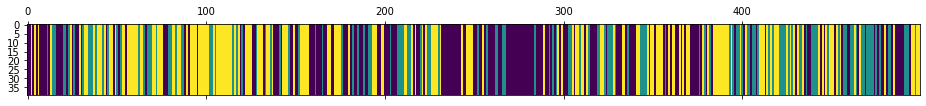

<Figure size 432x288 with 0 Axes>

N [[90. 45. 52.]
 [49. 43. 42.]
 [48. 46. 84.]]
alphas [[3.51809945 1.26622345 1.84375279]
 [1.52764967 3.25667323 1.84375279]
 [1.52764967 1.26622345 3.83420257]]
M [[13.  4.  9.]
 [ 7.  5.  6.]
 [ 5.  6.  6.]]
sum_w [[9.]
 [2.]
 [6.]]
barM [[4. 4. 9.]
 [7. 3. 6.]
 [5. 6. 0.]]
pi_z [[0.47655499 0.2116678  0.31177721]
 [0.46274321 0.29576915 0.24148764]
 [0.28667835 0.2938714  0.41945025]]
beta_vec [0.39751405 0.28292956 0.3195564 ]
hyper>> a_k: 5.1512326453191575  gamma: 0.5391904210800195  rho: 0.287463063541761


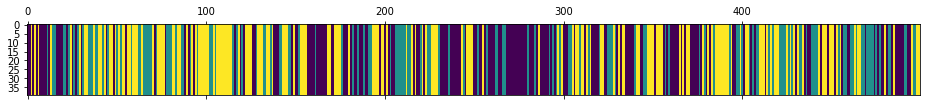

<Figure size 432x288 with 0 Axes>

N [[87. 41. 53.]
 [53. 49. 42.]
 [41. 54. 79.]]
alphas [[2.93984199 1.03847695 1.17291371]
 [1.45905287 2.51926607 1.17291371]
 [1.45905287 1.03847695 2.65370282]]
M [[10.  4.  3.]
 [ 4.  7.  6.]
 [ 8.  4. 13.]]
sum_w [[6.]
 [4.]
 [7.]]
barM [[4. 4. 3.]
 [4. 3. 6.]
 [8. 4. 6.]]
pi_z [[0.48129897 0.20543755 0.31326349]
 [0.35147649 0.37110472 0.27741879]
 [0.21642093 0.31200623 0.47157284]]
beta_vec [0.28006391 0.29520574 0.42473035]
hyper>> a_k: 6.017064203499282  gamma: 0.9209054304291227  rho: 0.1959134939886773


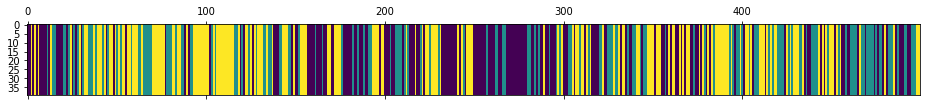

<Figure size 432x288 with 0 Axes>

N [[81. 41. 51.]
 [52. 55. 43.]
 [40. 54. 82.]]
alphas [[2.53384054 1.42827626 2.05494741]
 [1.35501646 2.60710033 2.05494741]
 [1.35501646 1.42827626 3.23377148]]
M [[11.  7.  8.]
 [ 4.  7.  8.]
 [ 5.  6. 12.]]
sum_w [[2.]
 [3.]
 [2.]]
barM [[ 9.  7.  8.]
 [ 4.  4.  8.]
 [ 5.  6. 10.]]
pi_z [[0.4076318  0.31220898 0.28015922]
 [0.33605265 0.37776328 0.28618407]
 [0.21211555 0.31986759 0.46801685]]
beta_vec [0.34336393 0.19709354 0.45954253]
hyper>> a_k: 6.309606437845739  gamma: 0.48224239875700203  rho: 0.1890786446185517


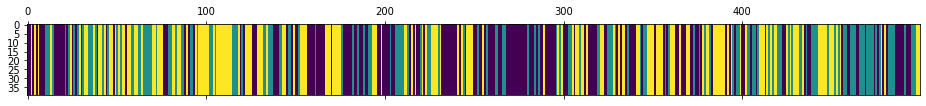

<Figure size 432x288 with 0 Axes>

N [[94. 43. 47.]
 [52. 56. 40.]
 [38. 49. 80.]]
alphas [[2.94986587 1.00844773 2.35129283]
 [1.75685404 2.20145957 2.35129283]
 [1.75685404 1.00844773 3.54430466]]
M [[14.  2.  8.]
 [ 7. 10.  5.]
 [ 5.  4. 15.]]
sum_w [[6.]
 [6.]
 [5.]]
barM [[ 8.  2.  8.]
 [ 7.  4.  5.]
 [ 5.  4. 10.]]
pi_z [[0.56417169 0.20377347 0.23205484]
 [0.44376645 0.37604756 0.18018599]
 [0.18602943 0.31181713 0.50215345]]
beta_vec [0.50755947 0.17267676 0.31976377]
hyper>> a_k: 5.661743869567811  gamma: 0.9511660416108496  rho: 0.37668826387987403


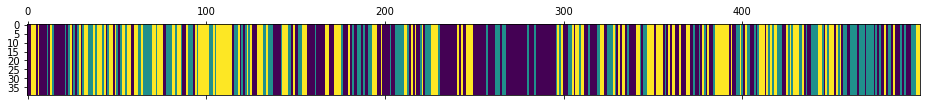

<Figure size 432x288 with 0 Axes>

N [[105.  46.  45.]
 [ 54.  54.  38.]
 [ 37.  46.  74.]]
alphas [[3.92390577 0.60938173 1.12845637]
 [1.7911933  2.74209419 1.12845637]
 [1.7911933  0.60938173 3.26116884]]
M [[15.  2.  3.]
 [ 9. 10.  4.]
 [ 7.  4.  8.]]
sum_w [[8.]
 [9.]
 [7.]]
barM [[7. 2. 3.]
 [9. 1. 4.]
 [7. 4. 1.]]
pi_z [[0.50620051 0.29675395 0.19704554]
 [0.3700857  0.38911157 0.24080273]
 [0.27078101 0.29044339 0.43877561]]
beta_vec [0.58475225 0.29245813 0.12278961]
hyper>> a_k: 5.212154602661903  gamma: 0.9390289319458822  rho: 0.3901778915901179


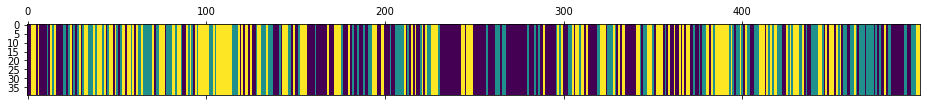

<Figure size 432x288 with 0 Axes>

N [[98. 43. 49.]
 [50. 55. 41.]
 [42. 48. 73.]]
alphas [[3.892295   0.92957441 0.3902852 ]
 [1.8586275  2.96324191 0.3902852 ]
 [1.8586275  0.92957441 2.42395269]]
M [[13.  4.  4.]
 [ 4.  8.  2.]
 [ 3.  3.  9.]]
sum_w [[4.]
 [6.]
 [7.]]
barM [[9. 4. 4.]
 [4. 2. 2.]
 [3. 3. 2.]]
pi_z [[0.48448146 0.24249341 0.27302513]
 [0.36889633 0.34913219 0.28197148]
 [0.21631792 0.32061709 0.463065  ]]
beta_vec [0.64843789 0.15188495 0.19967716]
hyper>> a_k: 4.786814334962243  gamma: 0.6898893705550067  rho: 0.2662860232585186


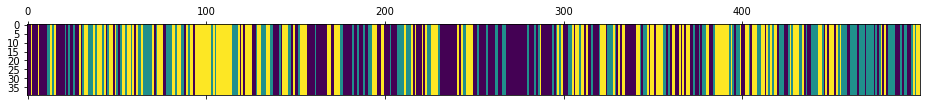

<Figure size 432x288 with 0 Axes>

N [[96. 42. 47.]
 [52. 56. 40.]
 [37. 50. 79.]]
alphas [[3.55207455 0.53344312 0.70129667]
 [2.27741279 1.80810487 0.70129667]
 [2.27741279 0.53344312 1.97595842]]
M [[11.  6.  4.]
 [ 7.  3.  2.]
 [ 9.  2. 10.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[7. 6. 4.]
 [7. 1. 2.]
 [9. 2. 6.]]
pi_z [[0.496081   0.21336387 0.29055512]
 [0.32052008 0.37730445 0.30217547]
 [0.23593149 0.27435325 0.48971526]]
beta_vec [0.60872753 0.15352895 0.23774352]
hyper>> a_k: 5.803924673066796  gamma: 0.09613016216467327  rho: 0.2682815219070715


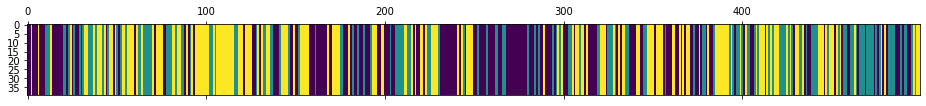

<Figure size 432x288 with 0 Axes>

N [[92. 41. 49.]
 [51. 53. 39.]
 [39. 49. 86.]]
alphas [[4.14225353 0.65201273 1.00965841]
 [2.58516778 2.20909848 1.00965841]
 [2.58516778 0.65201273 2.56674416]]
M [[17.  3.  4.]
 [ 7.  9.  3.]
 [ 7.  2. 10.]]
sum_w [[4.]
 [5.]
 [5.]]
barM [[13.  3.  4.]
 [ 7.  4.  3.]
 [ 7.  2.  5.]]
pi_z [[0.59279049 0.17150434 0.23570517]
 [0.29290611 0.43433476 0.27275913]
 [0.22043865 0.29171957 0.48784178]]
beta_vec [0.55795807 0.13082278 0.31121914]
hyper>> a_k: 5.2326104100753135  gamma: 1.285812128664912  rho: 0.22851529788336863


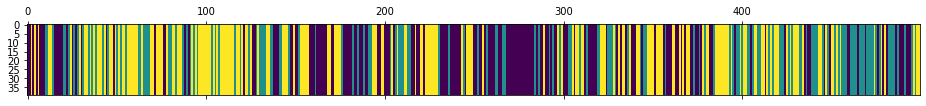

<Figure size 432x288 with 0 Axes>

N [[86. 43. 41.]
 [50. 45. 52.]
 [34. 59. 89.]]
alphas [[3.4481407  0.52811574 1.25635398]
 [2.25240917 1.72384726 1.25635398]
 [2.25240917 0.52811574 2.4520855 ]]
M [[11.  4.  7.]
 [11.  9.  2.]
 [ 5.  4. 10.]]
sum_w [[3.]
 [7.]
 [7.]]
barM [[ 8.  4.  7.]
 [11.  2.  2.]
 [ 5.  4.  3.]]
pi_z [[0.47337702 0.22658327 0.3000397 ]
 [0.38035856 0.26246748 0.35717397]
 [0.17273306 0.33735129 0.48991565]]
beta_vec [0.54053289 0.27795276 0.18151435]
hyper>> a_k: 5.077248093666207  gamma: 0.5581021786783305  rho: 0.3069589284197935


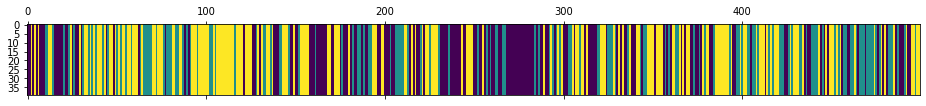

<Figure size 432x288 with 0 Axes>

N [[81. 39. 51.]
 [56. 43. 45.]
 [34. 62. 88.]]
alphas [[3.46050212 0.9780439  0.63870207]
 [1.90199549 2.53655054 0.63870207]
 [1.90199549 0.9780439  2.1972087 ]]
M [[11.  5.  5.]
 [ 6. 12.  2.]
 [ 7.  4.  9.]]
sum_w [[3.]
 [9.]
 [7.]]
barM [[8. 5. 5.]
 [6. 3. 2.]
 [7. 4. 2.]]
pi_z [[0.48104738 0.21480185 0.30415078]
 [0.38938533 0.2871694  0.32344526]
 [0.19058004 0.33742968 0.47199027]]
beta_vec [0.55355037 0.21536858 0.23108105]
hyper>> a_k: 4.267947681527088  gamma: 0.6607342583497493  rho: 0.3209392186255145


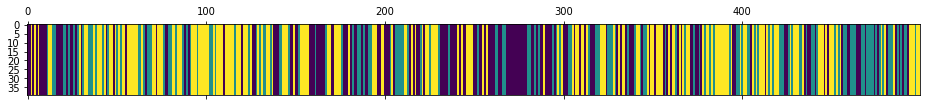

<Figure size 432x288 with 0 Axes>

N [[73. 44. 50.]
 [56. 42. 47.]
 [38. 59. 90.]]
alphas [[2.97404921 0.62418033 0.66971814]
 [1.60429742 1.99393212 0.66971814]
 [1.60429742 0.62418033 2.03946994]]
M [[12.  3.  1.]
 [ 7.  9.  4.]
 [ 2.  3.  7.]]
sum_w [[4.]
 [6.]
 [6.]]
barM [[8. 3. 1.]
 [7. 3. 4.]
 [2. 3. 1.]]
pi_z [[0.43160739 0.30224784 0.26614477]
 [0.3788783  0.31546763 0.30565407]
 [0.18958863 0.37108256 0.43932881]]
beta_vec [0.49856154 0.18099877 0.32043969]
hyper>> a_k: 4.125074094931848  gamma: 0.22557843079839596  rho: 0.3171749601369429


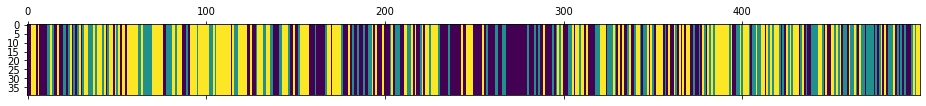

<Figure size 432x288 with 0 Axes>

N [[81. 42. 53.]
 [54. 42. 44.]
 [41. 56. 86.]]
alphas [[2.71267043 0.50981995 0.90258371]
 [1.40430022 1.81819016 0.90258371]
 [1.40430022 0.50981995 2.21095392]]
M [[12.  2.  5.]
 [ 5.  6.  5.]
 [ 7.  4.  5.]]
sum_w [[9.]
 [5.]
 [5.]]
barM [[3. 2. 5.]
 [5. 1. 5.]
 [7. 4. 0.]]
pi_z [[0.45358201 0.26629338 0.28012461]
 [0.31444621 0.34895862 0.33659516]
 [0.28172804 0.28533779 0.43293418]]
beta_vec [0.6641886  0.16034417 0.17546723]
hyper>> a_k: 3.407937793673907  gamma: 0.4996465483061436  rho: 0.3502492459825278


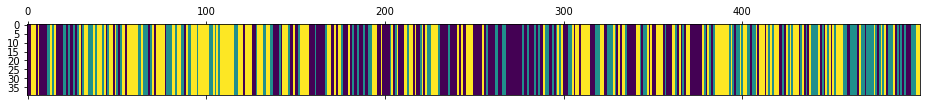

<Figure size 432x288 with 0 Axes>

N [[83. 45. 48.]
 [53. 44. 45.]
 [40. 53. 88.]]
alphas [[2.6643472  0.35505173 0.38853887]
 [1.47071955 1.54867937 0.38853887]
 [1.47071955 0.35505173 1.58216651]]
M [[10.  3.  3.]
 [10.  8.  3.]
 [ 4.  4.  4.]]
sum_w [[2.]
 [6.]
 [2.]]
barM [[ 8.  3.  3.]
 [10.  2.  3.]
 [ 4.  4.  2.]]
pi_z [[0.52968069 0.26332325 0.20699607]
 [0.35182148 0.3535324  0.29464612]
 [0.21401224 0.27031942 0.51566835]]
beta_vec [0.42121966 0.22065957 0.35812078]
hyper>> a_k: 4.031510070904441  gamma: 0.7820222754728197  rho: 0.16235612692516393


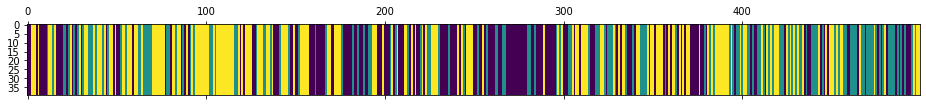

<Figure size 432x288 with 0 Axes>

N [[83. 44. 47.]
 [52. 45. 47.]
 [39. 55. 87.]]
alphas [[2.07698638 0.74516067 1.20936302]
 [1.42244602 1.39970103 1.20936302]
 [1.42244602 0.74516067 1.86390338]]
M [[10.  3.  5.]
 [ 6.  3.  4.]
 [ 9.  5.  7.]]
sum_w [[3.]
 [0.]
 [2.]]
barM [[7. 3. 5.]
 [6. 3. 4.]
 [9. 5. 5.]]
pi_z [[0.50072922 0.22793862 0.27133216]
 [0.29608458 0.36835939 0.33555603]
 [0.22845858 0.27774375 0.49379767]]
beta_vec [0.5628404  0.19019038 0.24696922]
hyper>> a_k: 4.8787696514413685  gamma: 0.32576920594954234  rho: 0.21400087127017003


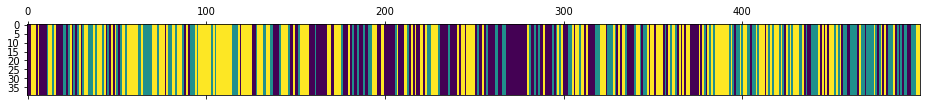

<Figure size 432x288 with 0 Axes>

N [[77. 40. 49.]
 [46. 45. 50.]
 [43. 56. 93.]]
alphas [[3.20238991 0.72932471 0.94705502]
 [2.15832896 1.77338567 0.94705502]
 [2.15832896 0.72932471 1.99111598]]
M [[ 7.  4.  4.]
 [10.  6.  4.]
 [ 7.  6.  7.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[ 5.  4.  4.]
 [10.  5.  4.]
 [ 7.  6.  4.]]
pi_z [[0.51421605 0.2996396  0.18614435]
 [0.27214796 0.37278206 0.35506999]
 [0.26522291 0.25524451 0.47953258]]
beta_vec [0.4707921  0.24391977 0.28528813]
hyper>> a_k: 3.8475598308785566  gamma: 0.30238916394321486  rho: 0.09001574306198956


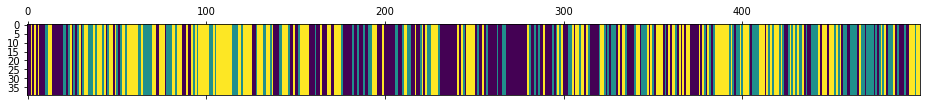

<Figure size 432x288 with 0 Axes>

N [[89. 42. 46.]
 [49. 44. 48.]
 [39. 55. 87.]]
alphas [[1.99468714 0.85401651 0.99885618]
 [1.64834618 1.20035747 0.99885618]
 [1.64834618 0.85401651 1.34519714]]
M [[8. 2. 3.]
 [6. 5. 3.]
 [5. 4. 3.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[7. 2. 3.]
 [6. 4. 3.]
 [5. 4. 1.]]
pi_z [[0.45701405 0.28267885 0.2603071 ]
 [0.32081376 0.32423377 0.35495247]
 [0.21304108 0.2870627  0.49989622]]
beta_vec [0.52745232 0.36922878 0.1033189 ]
hyper>> a_k: 2.598576678522723  gamma: 0.5565492275089962  rho: 0.13440202531452553


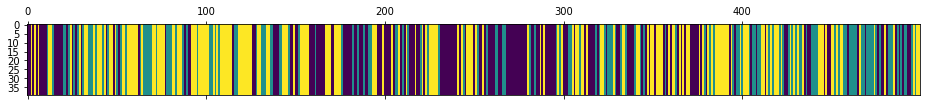

<Figure size 432x288 with 0 Axes>

N [[86. 45. 45.]
 [50. 41. 50.]
 [40. 55. 87.]]
alphas [[1.53566445 0.83051468 0.23239754]
 [1.18641049 1.17976865 0.23239754]
 [1.18641049 0.83051468 0.58165151]]
M [[4. 3. 3.]
 [5. 4. 2.]
 [4. 4. 1.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[3. 3. 3.]
 [5. 3. 2.]
 [4. 4. 0.]]
pi_z [[0.4585457  0.25988918 0.28156512]
 [0.3831527  0.26452178 0.35232553]
 [0.22398765 0.31486063 0.46115172]]
beta_vec [0.51548424 0.28506884 0.19944692]
hyper>> a_k: 2.7545802276084204  gamma: 1.23182503103244  rho: 0.11469212631495178


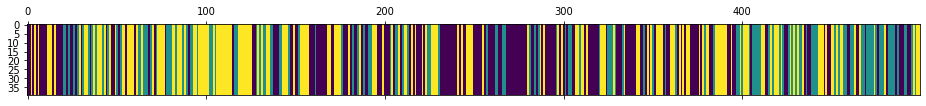

<Figure size 432x288 with 0 Axes>

N [[98. 36. 55.]
 [51. 41. 40.]
 [40. 55. 83.]]
alphas [[1.57301511 0.69518357 0.48638154]
 [1.25708645 1.01111223 0.48638154]
 [1.25708645 0.69518357 0.80231021]]
M [[7. 2. 4.]
 [6. 5. 2.]
 [6. 4. 2.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[5. 2. 4.]
 [6. 4. 2.]
 [6. 4. 2.]]
pi_z [[0.56036956 0.15854385 0.28108659]
 [0.3635341  0.28709701 0.34936889]
 [0.30259341 0.25791615 0.43949044]]
beta_vec [0.46545583 0.33769667 0.1968475 ]
hyper>> a_k: 2.85576447683991  gamma: 1.6785767660550555  rho: 0.19323937455641985


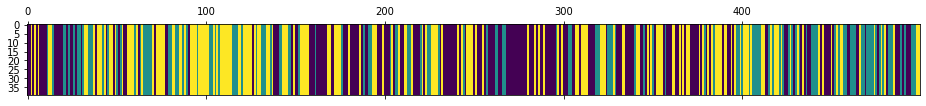

<Figure size 432x288 with 0 Axes>

N [[102.  32.  58.]
 [ 41.  47.  42.]
 [ 49.  51.  77.]]
alphas [[1.62421836 0.77802555 0.45352057]
 [1.07237221 1.32987169 0.45352057]
 [1.07237221 0.77802555 1.00536671]]
M [[9. 4. 1.]
 [3. 7. 2.]
 [8. 4. 3.]]
sum_w [[4.]
 [1.]
 [1.]]
barM [[5. 4. 1.]
 [3. 6. 2.]
 [8. 4. 2.]]
pi_z [[0.54183453 0.17200295 0.28616252]
 [0.32298387 0.36496801 0.31204811]
 [0.23816624 0.31848666 0.4433471 ]]
beta_vec [0.34067581 0.46902367 0.19030052]
hyper>> a_k: 4.204669496838339  gamma: 0.3382723426221584  rho: 0.0860862150216862


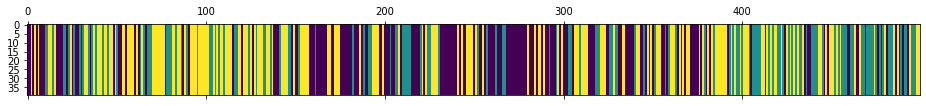

<Figure size 432x288 with 0 Axes>

N [[88. 36. 54.]
 [45. 45. 47.]
 [45. 56. 83.]]
alphas [[1.67108087 1.80231978 0.73126885]
 [1.30911678 2.16428387 0.73126885]
 [1.30911678 1.80231978 1.09323293]]
M [[7. 8. 3.]
 [3. 7. 3.]
 [7. 7. 5.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[4. 8. 3.]
 [3. 6. 3.]
 [7. 7. 3.]]
pi_z [[0.55501516 0.18781705 0.25716779]
 [0.40752444 0.31453612 0.27793944]
 [0.25260509 0.32018978 0.42720512]]
beta_vec [0.33584931 0.44966555 0.21448514]
hyper>> a_k: 3.593180773960235  gamma: 0.17733864430873686  rho: 0.1313107033562407


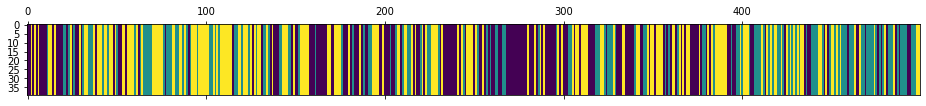

<Figure size 432x288 with 0 Axes>

N [[80. 36. 57.]
 [49. 50. 45.]
 [44. 58. 80.]]
alphas [[1.52012893 1.40356701 0.66948484]
 [1.04830583 1.87539011 0.66948484]
 [1.04830583 1.40356701 1.14130793]]
M [[8. 4. 3.]
 [8. 4. 1.]
 [5. 5. 3.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[5. 4. 3.]
 [8. 3. 1.]
 [5. 5. 1.]]
pi_z [[0.46767215 0.17661086 0.35571699]
 [0.35094314 0.31128486 0.337772  ]
 [0.21592138 0.30440285 0.47967577]]
beta_vec [0.51999164 0.16548448 0.31452388]
hyper>> a_k: 3.329550717120608  gamma: 0.7739581066761013  rho: 0.1889447547804512


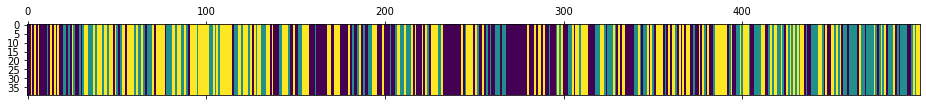

<Figure size 432x288 with 0 Axes>

N [[76. 38. 55.]
 [47. 52. 50.]
 [46. 59. 76.]]
alphas [[2.03331234 0.44688249 0.84935588]
 [1.4042112  1.07598363 0.84935588]
 [1.4042112  0.44688249 1.47845703]]
M [[ 8.  4.  4.]
 [ 6.  7.  6.]
 [ 5.  4. 10.]]
sum_w [[2.]
 [6.]
 [4.]]
barM [[6. 4. 4.]
 [6. 1. 6.]
 [5. 4. 6.]]
pi_z [[0.42038107 0.23985587 0.33976306]
 [0.28428511 0.36480534 0.35090955]
 [0.28198295 0.29524133 0.42277571]]
beta_vec [0.49679997 0.21131638 0.29188365]
hyper>> a_k: 4.894481975774646  gamma: 1.6305281491521122  rho: 0.2671277966454374


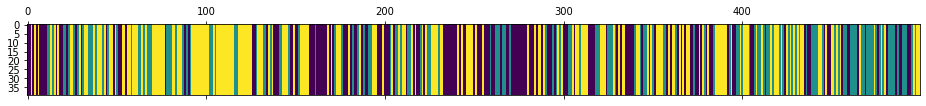

<Figure size 432x288 with 0 Axes>

N [[72. 36. 54.]
 [49. 46. 49.]
 [41. 62. 90.]]
alphas [[3.08948849 0.75799815 1.04699534]
 [1.7820363  2.06545034 1.04699534]
 [1.7820363  0.75799815 2.35444752]]
M [[15.  4.  2.]
 [ 3.  5.  2.]
 [ 5.  3. 10.]]
sum_w [[8.]
 [1.]
 [4.]]
barM [[7. 4. 2.]
 [3. 4. 2.]
 [5. 3. 6.]]
pi_z [[0.4206325  0.26001037 0.31935713]
 [0.39637199 0.25352099 0.35010702]
 [0.23170017 0.35225019 0.41604964]]
beta_vec [0.31326584 0.35776123 0.32897292]
hyper>> a_k: 3.5739577312574764  gamma: 0.45669601062609183  rho: 0.3096142984707027


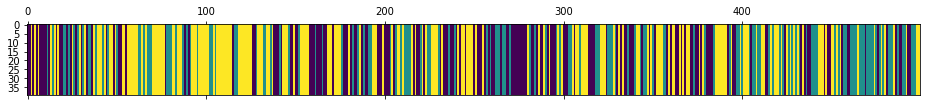

<Figure size 432x288 with 0 Axes>

N [[65. 41. 57.]
 [54. 45. 45.]
 [44. 58. 90.]]
alphas [[1.87950348 0.8827434  0.81171085]
 [0.77295506 1.98929182 0.81171085]
 [0.77295506 0.8827434  1.91825927]]
M [[7. 3. 3.]
 [4. 6. 3.]
 [5. 1. 6.]]
sum_w [[2.]
 [4.]
 [2.]]
barM [[5. 3. 3.]
 [4. 2. 3.]
 [5. 1. 4.]]
pi_z [[0.40533252 0.24417865 0.35048883]
 [0.3576914  0.27858675 0.36372185]
 [0.20699408 0.35283123 0.44017469]]
beta_vec [0.58525648 0.20117949 0.21356403]
hyper>> a_k: 2.4409322485990503  gamma: 0.5785061865132043  rho: 0.15594720695818245


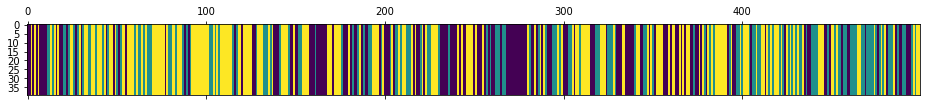

<Figure size 432x288 with 0 Axes>

N [[72. 33. 53.]
 [49. 46. 51.]
 [37. 67. 91.]]
alphas [[1.58644625 0.41448522 0.44000078]
 [1.20578969 0.79514179 0.44000078]
 [1.20578969 0.41448522 0.82065734]]
M [[11.  3.  2.]
 [ 3.  4.  3.]
 [ 5.  4.  4.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[8. 3. 2.]
 [3. 3. 3.]
 [5. 4. 0.]]
pi_z [[0.47687749 0.17944503 0.34367748]
 [0.29633782 0.29811428 0.4055479 ]
 [0.20112543 0.38062294 0.41825163]]
beta_vec [0.5127334  0.27996784 0.20729875]
hyper>> a_k: 1.7792905396771512  gamma: 0.33003002043450963  rho: 0.24589438370871144


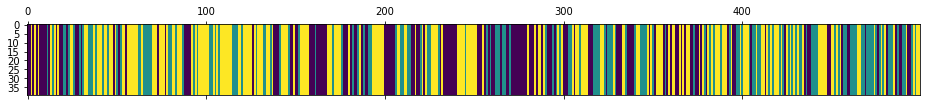

<Figure size 432x288 with 0 Axes>

N [[72. 34. 45.]
 [41. 47. 59.]
 [38. 66. 97.]]
alphas [[1.12548938 0.37565329 0.27814787]
 [0.68797183 0.81317084 0.27814787]
 [0.68797183 0.37565329 0.71566542]]
M [[6. 2. 2.]
 [4. 7. 1.]
 [5. 1. 3.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[4. 2. 2.]
 [4. 5. 1.]
 [5. 1. 1.]]
pi_z [[0.50969694 0.21109558 0.27920748]
 [0.27085088 0.33168873 0.39746038]
 [0.20710875 0.33104153 0.46184972]]
beta_vec [0.4084014  0.4178287  0.17376989]
hyper>> a_k: 2.271232354667706  gamma: 0.4744433712480545  rho: 0.1655963622906078


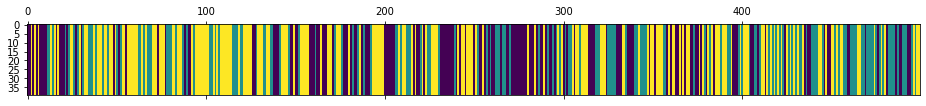

<Figure size 432x288 with 0 Axes>

N [[69. 39. 47.]
 [47. 52. 55.]
 [39. 63. 88.]]
alphas [[1.15007933 0.79183743 0.32931559]
 [0.77397152 1.16794525 0.32931559]
 [0.77397152 0.79183743 0.70542341]]
M [[7. 5. 3.]
 [3. 9. 1.]
 [2. 1. 2.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[5. 5. 3.]
 [3. 9. 1.]
 [2. 1. 0.]]
pi_z [[0.39804768 0.22731071 0.37464161]
 [0.32117784 0.31214095 0.36668121]
 [0.17000862 0.33916215 0.49082923]]
beta_vec [0.4935344  0.37417119 0.13229441]
hyper>> a_k: 2.352194040127452  gamma: 0.05796761496742706  rho: 0.22280743702261863


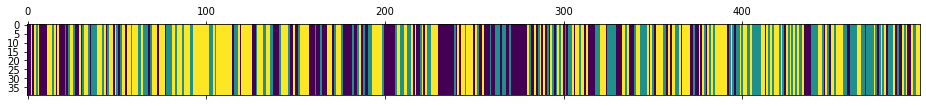

<Figure size 432x288 with 0 Axes>

N [[66. 36. 45.]
 [43. 52. 57.]
 [38. 64. 98.]]
alphas [[1.42632037 0.68402523 0.24184844]
 [0.90223404 1.20811156 0.24184844]
 [0.90223404 0.68402523 0.76593476]]
M [[6. 4. 1.]
 [4. 7. 2.]
 [3. 5. 4.]]
sum_w [[3.]
 [5.]
 [3.]]
barM [[3. 4. 1.]
 [4. 2. 2.]
 [3. 5. 1.]]
pi_z [[0.41169826 0.26571245 0.32258929]
 [0.24993888 0.39313928 0.35692184]
 [0.17359456 0.34018819 0.48621725]]
beta_vec [0.41679534 0.343739   0.23946566]
hyper>> a_k: 2.3986035207134284  gamma: 0.6740382270889619  rho: 0.3349569193477645


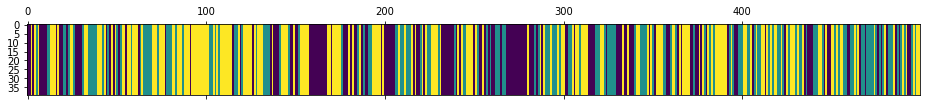

<Figure size 432x288 with 0 Axes>

N [[70. 31. 50.]
 [44. 58. 53.]
 [37. 66. 90.]]
alphas [[1.46829021 0.54832375 0.38198956]
 [0.66486137 1.35175259 0.38198956]
 [0.66486137 0.54832375 1.18541841]]
M [[6. 3. 1.]
 [5. 5. 2.]
 [1. 4. 4.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[5. 3. 1.]
 [5. 3. 2.]
 [1. 4. 1.]]
pi_z [[0.43390514 0.23095596 0.3351389 ]
 [0.25492961 0.45366895 0.29140145]
 [0.20687257 0.26583889 0.52728854]]
beta_vec [0.32542233 0.6304909  0.04408677]
hyper>> a_k: 2.077121292135892  gamma: 1.4545536057066795  rho: 0.23584397189293899


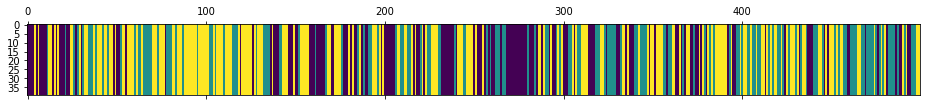

<Figure size 432x288 with 0 Axes>

N [[72. 29. 49.]
 [41. 60. 53.]
 [37. 65. 93.]]
alphas [[1.00640142 1.00074338 0.06997649]
 [0.51652489 1.49061991 0.06997649]
 [0.51652489 1.00074338 0.55985303]]
M [[5. 5. 1.]
 [3. 6. 2.]
 [3. 2. 1.]]
sum_w [[3.]
 [4.]
 [1.]]
barM [[2. 5. 1.]
 [3. 2. 2.]
 [3. 2. 0.]]
pi_z [[0.42298553 0.2244726  0.35254186]
 [0.26068066 0.34965269 0.38966665]
 [0.23564904 0.30020612 0.46414484]]
beta_vec [0.58664915 0.28400955 0.12934129]
hyper>> a_k: 2.284325133642404  gamma: 0.5603570662931338  rho: 0.2879795268538507


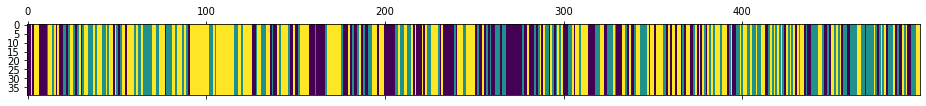

<Figure size 432x288 with 0 Axes>

N [[61. 34. 47.]
 [46. 54. 57.]
 [35. 69. 96.]]
alphas [[1.61201566 0.46193764 0.21037183]
 [0.95417679 1.11977651 0.21037183]
 [0.95417679 0.46193764 0.8682107 ]]
M [[11.  4.  2.]
 [ 4.  6.  2.]
 [ 5.  1.  5.]]
sum_w [[4.]
 [4.]
 [2.]]
barM [[7. 4. 2.]
 [4. 2. 2.]
 [5. 1. 3.]]
pi_z [[0.44367064 0.22099249 0.33533687]
 [0.31218625 0.33758906 0.35022469]
 [0.20102214 0.3372739  0.46170396]]
beta_vec [0.58407059 0.17899985 0.23692956]
hyper>> a_k: 2.271973921732863  gamma: 0.4145196458165214  rho: 0.3230469950024773


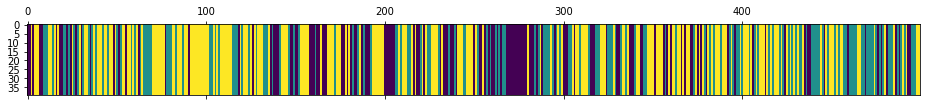

<Figure size 432x288 with 0 Axes>

N [[51. 36. 48.]
 [52. 47. 59.]
 [32. 75. 99.]]
alphas [[1.63226635 0.27530527 0.3644023 ]
 [0.898312   1.00925962 0.3644023 ]
 [0.898312   0.27530527 1.09835665]]
M [[4. 2. 1.]
 [5. 7. 2.]
 [6. 1. 4.]]
sum_w [[3.]
 [5.]
 [2.]]
barM [[1. 2. 1.]
 [5. 2. 2.]
 [6. 1. 2.]]
pi_z [[0.35461619 0.28811583 0.35726798]
 [0.38375152 0.28184357 0.33440491]
 [0.13448914 0.39966825 0.4658426 ]]
beta_vec [0.63479383 0.14146275 0.22374343]
hyper>> a_k: 1.9315131791121583  gamma: 1.450884821160253  rho: 0.2804558470601104


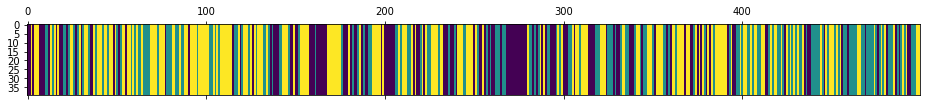

<Figure size 432x288 with 0 Axes>

N [[57. 37. 44.]
 [51. 54. 59.]
 [30. 73. 94.]]
alphas [[1.42394635 0.1966062  0.31096063]
 [0.88224219 0.73831036 0.31096063]
 [0.88224219 0.1966062  0.85266479]]
M [[4. 1. 5.]
 [3. 1. 2.]
 [3. 1. 1.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[2. 1. 5.]
 [3. 0. 2.]
 [3. 1. 1.]]
pi_z [[0.41883428 0.27344486 0.30772085]
 [0.28658017 0.38734689 0.32607295]
 [0.1559994  0.35570042 0.48830018]]
beta_vec [0.31444821 0.18116594 0.50438585]
hyper>> a_k: 1.4004378758222398  gamma: 0.29817567276080487  rho: 0.14449996746742355


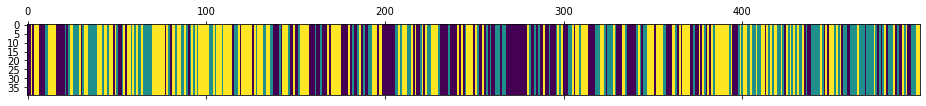

<Figure size 432x288 with 0 Axes>

N [[75. 38. 43.]
 [44. 53. 57.]
 [37. 63. 89.]]
alphas [[0.57909566 0.21705032 0.6042919 ]
 [0.37673243 0.41941355 0.6042919 ]
 [0.37673243 0.21705032 0.80665513]]
M [[3. 1. 5.]
 [1. 2. 3.]
 [2. 1. 6.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[3. 1. 5.]
 [1. 2. 3.]
 [2. 1. 6.]]
pi_z [[0.47481408 0.22918304 0.29600289]
 [0.28572876 0.36326809 0.35100315]
 [0.1968846  0.36020749 0.4429079 ]]
beta_vec [0.32189319 0.10360293 0.57450388]
hyper>> a_k: 1.1471917637156501  gamma: 0.6952070147788929  rho: 0.15941304389220404


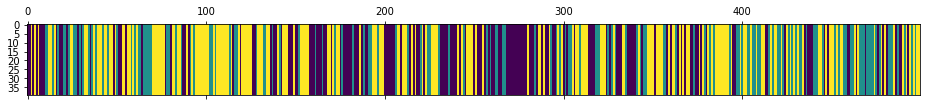

<Figure size 432x288 with 0 Axes>

N [[72. 42. 50.]
 [46. 38. 56.]
 [46. 60. 89.]]
alphas [[0.49328358 0.0999058  0.55400238]
 [0.31040625 0.28278313 0.55400238]
 [0.31040625 0.0999058  0.73687972]]
M [[2. 1. 1.]
 [1. 3. 2.]
 [2. 2. 2.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[0. 1. 1.]
 [1. 2. 2.]
 [2. 2. 1.]]
pi_z [[0.39016753 0.29462585 0.31520662]
 [0.32355036 0.31410014 0.36234949]
 [0.22166433 0.34760143 0.43073424]]
beta_vec [0.17511342 0.67772935 0.14715723]
hyper>> a_k: 1.4104548074280425  gamma: 0.6072121475268453  rho: 0.25185490560705104


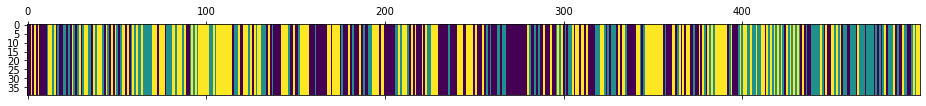

<Figure size 432x288 with 0 Axes>

N [[78. 45. 54.]
 [49. 41. 50.]
 [50. 54. 78.]]
alphas [[0.540014   0.71515684 0.15528397]
 [0.18478403 1.07038681 0.15528397]
 [0.18478403 0.71515684 0.51051393]]
M [[2. 4. 2.]
 [2. 3. 2.]
 [1. 2. 1.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[0. 4. 2.]
 [2. 3. 2.]
 [1. 2. 0.]]
pi_z [[0.47097046 0.23392005 0.29510948]
 [0.38631051 0.26589278 0.34779671]
 [0.30514246 0.28195859 0.41289895]]
beta_vec [0.10570942 0.58205096 0.31223962]
hyper>> a_k: 0.8040465468272437  gamma: 1.4506290309249354  rho: 0.24287580092215752


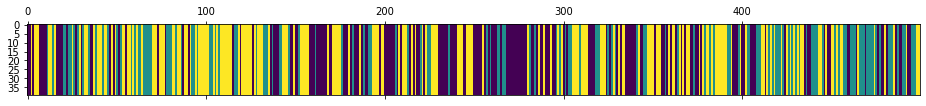

<Figure size 432x288 with 0 Axes>

N [[85. 36. 54.]
 [45. 45. 47.]
 [45. 56. 86.]]
alphas [[0.25963544 0.35433115 0.19007996]
 [0.06435199 0.5496146  0.19007996]
 [0.06435199 0.35433115 0.38536341]]
M [[3. 2. 2.]
 [1. 3. 3.]
 [2. 3. 1.]]
sum_w [[2.]
 [2.]
 [0.]]
barM [[1. 2. 2.]
 [1. 1. 3.]
 [2. 3. 1.]]
pi_z [[0.47010478 0.23048822 0.29940701]
 [0.3679149  0.30373847 0.32834663]
 [0.26233796 0.29792509 0.43973695]]
beta_vec [0.26004374 0.26613196 0.4738243 ]
hyper>> a_k: 0.9366146298070651  gamma: 0.40536517291441465  rho: 0.39868873634039925


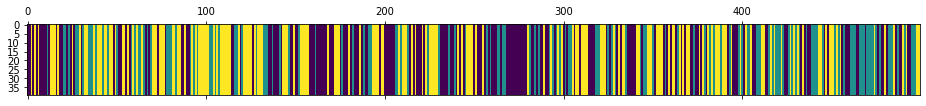

<Figure size 432x288 with 0 Axes>

N [[79. 46. 58.]
 [56. 38. 45.]
 [48. 55. 74.]]
alphas [[0.51987354 0.1498847  0.26685639]
 [0.14645584 0.5233024  0.26685639]
 [0.14645584 0.1498847  0.64027409]]
M [[5. 1. 1.]
 [2. 4. 1.]
 [2. 3. 3.]]
sum_w [[3.]
 [3.]
 [0.]]
barM [[2. 1. 1.]
 [2. 1. 1.]
 [2. 3. 3.]]
pi_z [[0.39475712 0.22598577 0.37925711]
 [0.42038143 0.24539067 0.3342279 ]
 [0.3104807  0.26985916 0.41966014]]
beta_vec [0.57216069 0.25754394 0.17029536]
hyper>> a_k: 1.2523011872086556  gamma: 0.4216084693111353  rho: 0.401578480051511


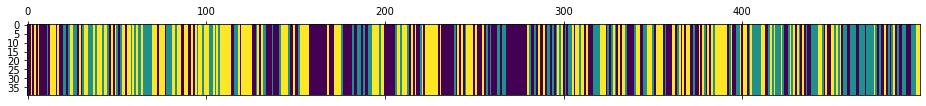

<Figure size 432x288 with 0 Axes>

N [[82. 42. 59.]
 [54. 45. 40.]
 [47. 52. 78.]]
alphas [[0.93167671 0.19300446 0.12762002]
 [0.4287795  0.69590166 0.12762002]
 [0.4287795  0.19300446 0.63051723]]
M [[5. 1. 1.]
 [2. 3. 1.]
 [2. 3. 1.]]
sum_w [[3.]
 [2.]
 [1.]]
barM [[2. 1. 1.]
 [2. 1. 1.]
 [2. 3. 0.]]
pi_z [[0.44945175 0.26335406 0.28719418]
 [0.43063214 0.32910354 0.24026432]
 [0.30746361 0.27241887 0.42011752]]
beta_vec [0.30551769 0.61740254 0.07707977]
hyper>> a_k: 1.0791988461694866  gamma: 0.5997905559272667  rho: 0.31312274828230324


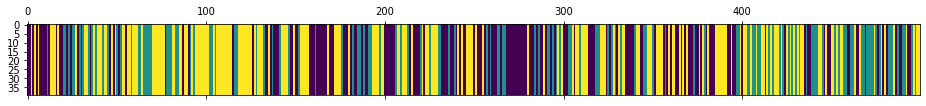

<Figure size 432x288 with 0 Axes>

N [[78. 40. 54.]
 [50. 38. 45.]
 [44. 55. 95.]]
alphas [[0.56439499 0.45766638 0.05713747]
 [0.22647328 0.79558809 0.05713747]
 [0.22647328 0.45766638 0.39505918]]
M [[3. 3. 1.]
 [4. 4. 2.]
 [4. 3. 3.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[2. 3. 1.]
 [4. 3. 2.]
 [4. 3. 1.]]
pi_z [[0.46678229 0.19749036 0.33572736]
 [0.37215503 0.36956531 0.25827965]
 [0.23257597 0.30243331 0.46499072]]
beta_vec [0.48765368 0.34507787 0.16726845]
hyper>> a_k: 1.5342107286854552  gamma: 0.44047832225906186  rho: 0.23251972912298993


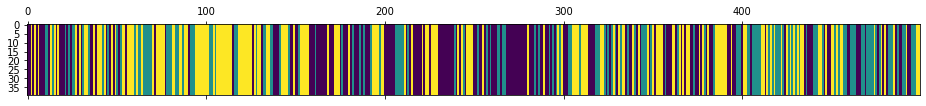

<Figure size 432x288 with 0 Axes>

N [[82. 43. 56.]
 [55. 50. 37.]
 [44. 49. 83.]]
alphas [[0.93093499 0.40632107 0.19695467]
 [0.57420073 0.76305533 0.19695467]
 [0.57420073 0.40632107 0.55368893]]
M [[2. 4. 1.]
 [2. 3. 2.]
 [2. 4. 3.]]
sum_w [[0.]
 [0.]
 [3.]]
barM [[2. 4. 1.]
 [2. 3. 2.]
 [2. 4. 0.]]
pi_z [[0.46557826 0.21511321 0.31930853]
 [0.34716986 0.3891971  0.26363304]
 [0.23805641 0.23413466 0.52780892]]
beta_vec [0.3108604  0.59737855 0.09176105]
hyper>> a_k: 1.3730988976230882  gamma: 0.8300011172615218  rho: 0.10751225663826697


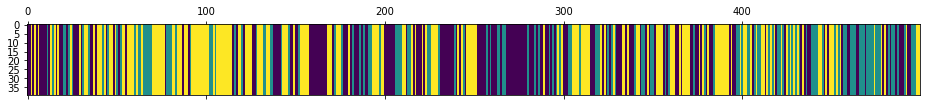

<Figure size 432x288 with 0 Axes>

N [[82. 42. 53.]
 [55. 44. 38.]
 [40. 51. 94.]]
alphas [[0.52857627 0.73207185 0.11245077]
 [0.38095131 0.87969681 0.11245077]
 [0.38095131 0.73207185 0.26007574]]
M [[4. 3. 1.]
 [2. 4. 1.]
 [2. 4. 1.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[2. 3. 1.]
 [2. 3. 1.]
 [2. 4. 0.]]
pi_z [[0.47713949 0.24548553 0.27737498]
 [0.40423708 0.29307656 0.30268636]
 [0.18658694 0.25845424 0.55495882]]
beta_vec [0.31319149 0.54034583 0.14646269]
hyper>> a_k: 1.4258859168247566  gamma: 0.37803898559686594  rho: 0.07778986067830498


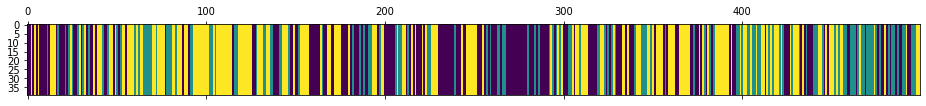

<Figure size 432x288 with 0 Axes>

N [[ 88.  42.  47.]
 [ 52.  38.  41.]
 [ 37.  51. 103.]]
alphas [[0.52275576 0.71053663 0.19259352]
 [0.4118363  0.8214561  0.19259352]
 [0.4118363  0.71053663 0.30351299]]
M [[3. 4. 1.]
 [2. 5. 2.]
 [3. 4. 3.]]
sum_w [[0.]
 [2.]
 [0.]]
barM [[3. 4. 1.]
 [2. 3. 2.]
 [3. 4. 3.]]
pi_z [[0.47755185 0.23541835 0.2870298 ]
 [0.26325456 0.31840487 0.41834057]
 [0.23254701 0.24422737 0.52322562]]
beta_vec [0.45019418 0.39824287 0.15156295]
hyper>> a_k: 2.005747034154251  gamma: 1.194045233130112  rho: 0.1392813263840195


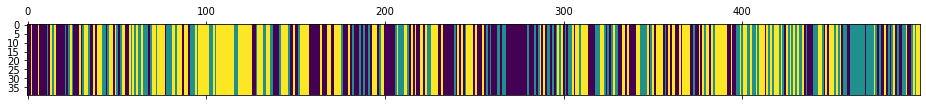

<Figure size 432x288 with 0 Axes>

N [[79. 39. 54.]
 [50. 43. 46.]
 [43. 57. 88.]]
alphas [[1.05657111 0.68752009 0.26165584]
 [0.777208   0.96688319 0.26165584]
 [0.777208   0.68752009 0.54101895]]
M [[7. 4. 2.]
 [5. 5. 3.]
 [4. 3. 1.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[5. 4. 2.]
 [5. 5. 3.]
 [4. 3. 0.]]
pi_z [[0.50081593 0.18868147 0.31050261]
 [0.39123263 0.33944283 0.26932454]
 [0.20219122 0.25688512 0.54092366]]
beta_vec [0.61696003 0.26455276 0.1184872 ]
hyper>> a_k: 1.9475550794685033  gamma: 1.566102560704896  rho: 0.16783491604386064


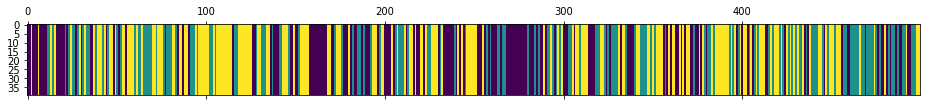

<Figure size 432x288 with 0 Axes>

N [[74. 37. 51.]
 [56. 51. 46.]
 [32. 65. 87.]]
alphas [[1.32676706 0.42875731 0.19203071]
 [0.99989931 0.75562505 0.19203071]
 [0.99989931 0.42875731 0.51889845]]
M [[6. 2. 2.]
 [5. 5. 1.]
 [4. 3. 4.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[5. 2. 2.]
 [5. 3. 1.]
 [4. 3. 2.]]
pi_z [[0.41591635 0.22689215 0.3571915 ]
 [0.38229168 0.34310172 0.2746066 ]
 [0.13938772 0.33381253 0.52679975]]
beta_vec [0.48392632 0.31548925 0.20058444]
hyper>> a_k: 1.7086657904761078  gamma: 1.3919284602268358  rho: 0.22420770466589174


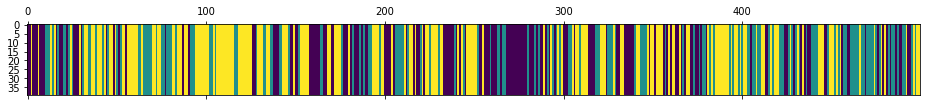

<Figure size 432x288 with 0 Axes>

N [[74. 40. 44.]
 [54. 55. 45.]
 [30. 59. 98.]]
alphas [[1.02457413 0.418203   0.26588866]
 [0.64147809 0.80129904 0.26588866]
 [0.64147809 0.418203   0.6489847 ]]
M [[6. 1. 3.]
 [3. 4. 3.]
 [3. 1. 5.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[4. 1. 3.]
 [3. 1. 3.]
 [3. 1. 2.]]
pi_z [[0.4608511  0.23671072 0.30243817]
 [0.36019836 0.34777634 0.2920253 ]
 [0.15041697 0.31112652 0.53845651]]
beta_vec [0.49191053 0.20292013 0.30516934]
hyper>> a_k: 2.4844888608429083  gamma: 0.5236846507131137  rho: 0.18953573515092506


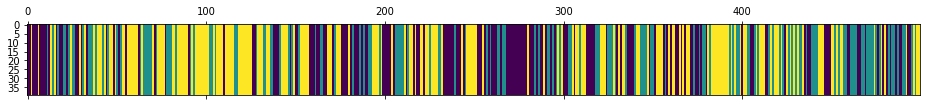

<Figure size 432x288 with 0 Axes>

N [[74. 38. 51.]
 [58. 50. 40.]
 [31. 60. 97.]]
alphas [[1.46140527 0.40859783 0.61448576]
 [0.99050585 0.87949725 0.61448576]
 [0.99050585 0.40859783 1.08538518]]
M [[7. 1. 3.]
 [5. 6. 1.]
 [4. 3. 3.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[6. 1. 3.]
 [5. 5. 1.]
 [4. 3. 1.]]
pi_z [[0.42202618 0.22040028 0.35757354]
 [0.37240669 0.3534722  0.27412112]
 [0.19562423 0.30360251 0.50077326]]
beta_vec [0.55828565 0.364603   0.07711135]
hyper>> a_k: 2.4119901249999502  gamma: 0.7451521758930701  rho: 0.12730048170493286


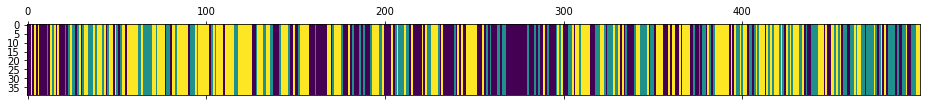

<Figure size 432x288 with 0 Axes>

N [[75. 38. 51.]
 [52. 50. 43.]
 [37. 57. 96.]]
alphas [[1.48220676 0.7674684  0.16231496]
 [1.17515926 1.0745159  0.16231496]
 [1.17515926 0.7674684  0.46936247]]
M [[5. 6. 2.]
 [2. 3. 3.]
 [4. 4. 2.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[3. 6. 2.]
 [2. 2. 3.]
 [4. 4. 1.]]
pi_z [[0.46604736 0.24136362 0.29258902]
 [0.467771   0.27891001 0.25331899]
 [0.155364   0.35285935 0.49177665]]
beta_vec [0.31494853 0.45099315 0.23405832]
hyper>> a_k: 2.5568569594639516  gamma: 0.598374229796243  rho: 0.17730435391877372


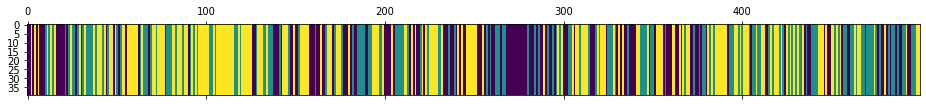

<Figure size 432x288 with 0 Axes>

N [[66. 41. 47.]
 [57. 52. 50.]
 [31. 66. 89.]]
alphas [[1.11584085 0.9486709  0.49234521]
 [0.66249898 1.40201277 0.49234521]
 [0.66249898 0.9486709  0.94568708]]
M [[6. 3. 3.]
 [2. 6. 4.]
 [2. 4. 5.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[4. 3. 3.]
 [2. 4. 4.]
 [2. 4. 3.]]
pi_z [[0.43335478 0.25651543 0.31012979]
 [0.35720475 0.31291542 0.32987984]
 [0.19705072 0.33168043 0.47126885]]
beta_vec [0.3604207  0.32005632 0.31952298]
hyper>> a_k: 2.5736530394088635  gamma: 1.2254696903888564  rho: 0.21245428267899905


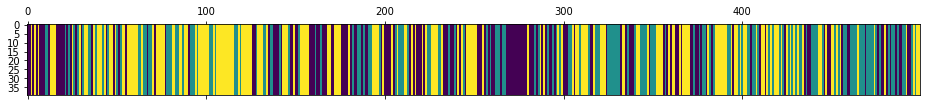

<Figure size 432x288 with 0 Axes>

N [[62. 47. 48.]
 [54. 56. 47.]
 [41. 54. 90.]]
alphas [[1.27730931 0.64871236 0.64763137]
 [0.7305257  1.19549597 0.64763137]
 [0.7305257  0.64871236 1.19441498]]
M [[6. 2. 4.]
 [6. 2. 3.]
 [2. 4. 3.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[2. 2. 4.]
 [6. 0. 3.]
 [2. 4. 2.]]
pi_z [[0.394006   0.31250226 0.29349175]
 [0.30653505 0.38666886 0.30679609]
 [0.19530026 0.3194186  0.48528114]]
beta_vec [0.3940906  0.31899116 0.28691824]
hyper>> a_k: 1.61533824850115  gamma: 1.0195407542680104  rho: 0.2286636384983629


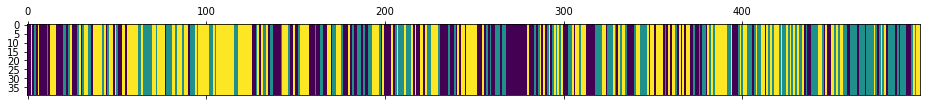

<Figure size 432x288 with 0 Axes>

N [[67. 39. 47.]
 [51. 60. 49.]
 [35. 61. 90.]]
alphas [[0.86039384 0.39745314 0.35749126]
 [0.49102472 0.76682226 0.35749126]
 [0.49102472 0.39745314 0.72686039]]
M [[5. 1. 2.]
 [4. 4. 3.]
 [2. 1. 3.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[3. 1. 2.]
 [4. 1. 3.]
 [2. 1. 2.]]
pi_z [[0.44207487 0.25157134 0.30635378]
 [0.31909843 0.36375908 0.31714249]
 [0.17616454 0.30798902 0.51584643]]
beta_vec [0.34478635 0.1675638  0.48764985]
hyper>> a_k: 1.3470174775212176  gamma: 0.7508265494614625  rho: 0.34728286531969826


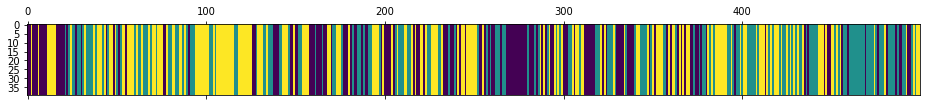

<Figure size 432x288 with 0 Axes>

N [[66. 37. 43.]
 [47. 70. 54.]
 [33. 64. 85.]]
alphas [[0.77093963 0.14732568 0.42875218]
 [0.30314354 0.61512177 0.42875218]
 [0.30314354 0.14732568 0.89654826]]
M [[2. 4. 4.]
 [4. 4. 3.]
 [3. 2. 2.]]
sum_w [[1.]
 [4.]
 [0.]]
barM [[1. 4. 4.]
 [4. 0. 3.]
 [3. 2. 2.]]
pi_z [[0.41704397 0.28741151 0.29554452]
 [0.24554544 0.39457479 0.35987977]
 [0.19352854 0.32692162 0.47954984]]
beta_vec [0.30301856 0.31090024 0.3860812 ]
hyper>> a_k: 2.0556102674126473  gamma: 0.9685218238556444  rho: 0.199987168720516


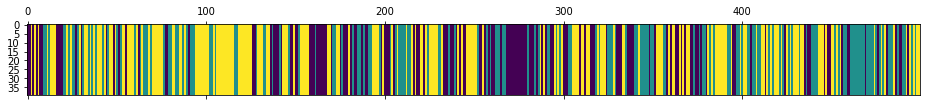

<Figure size 432x288 with 0 Axes>

N [[62. 38. 47.]
 [51. 57. 52.]
 [34. 65. 93.]]
alphas [[0.90941412 0.51127998 0.63491617]
 [0.49831845 0.92237565 0.63491617]
 [0.49831845 0.51127998 1.04601184]]
M [[4. 1. 3.]
 [3. 2. 2.]
 [1. 4. 6.]]
sum_w [[4.]
 [0.]
 [3.]]
barM [[0. 1. 3.]
 [3. 2. 2.]
 [1. 4. 3.]]
pi_z [[0.39300125 0.22232571 0.38467304]
 [0.32682562 0.38910788 0.2840665 ]
 [0.15897528 0.3085722  0.53245252]]
beta_vec [0.34311333 0.36613427 0.2907524 ]
hyper>> a_k: 1.5359998895786973  gamma: 0.3921617851982717  rho: 0.431195237195306


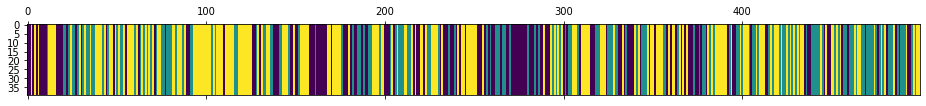

<Figure size 432x288 with 0 Axes>

N [[61. 36. 51.]
 [54. 50. 52.]
 [33. 70. 92.]]
alphas [[0.96208848 0.31988567 0.25402574]
 [0.29977264 0.98220151 0.25402574]
 [0.29977264 0.31988567 0.91634157]]
M [[6. 3. 1.]
 [2. 4. 4.]
 [2. 3. 5.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[4. 3. 1.]
 [2. 1. 4.]
 [2. 3. 4.]]
pi_z [[0.43172394 0.26304074 0.30523532]
 [0.3219562  0.36779115 0.31025265]
 [0.13209952 0.33520151 0.53269897]]
beta_vec [0.41104174 0.24028039 0.34867787]
hyper>> a_k: 1.3242687398193878  gamma: 0.38341509079076785  rho: 0.19071443740908042


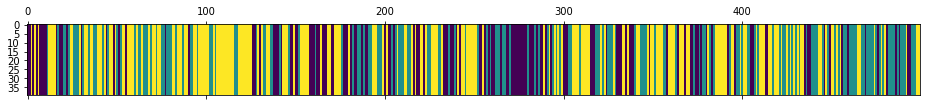

<Figure size 432x288 with 0 Axes>

N [[ 53.  40.  42.]
 [ 52.  59.  55.]
 [ 30.  67. 101.]]
alphas [[0.69307536 0.25751128 0.3736821 ]
 [0.44051819 0.51006845 0.3736821 ]
 [0.44051819 0.25751128 0.62623927]]
M [[4. 1. 1.]
 [4. 3. 2.]
 [5. 1. 3.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[3. 1. 1.]
 [4. 2. 2.]
 [5. 1. 3.]]
pi_z [[0.33854775 0.35159301 0.30985924]
 [0.24498613 0.38335529 0.37165858]
 [0.15793041 0.34392813 0.49814146]]
beta_vec [0.47699583 0.20284983 0.32015434]
hyper>> a_k: 1.7574569109307012  gamma: 0.6532508292655175  rho: 0.11547199007327313


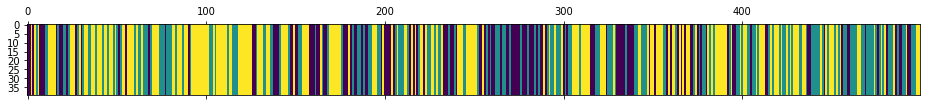

<Figure size 432x288 with 0 Axes>

N [[ 51.  41.  37.]
 [ 55.  62.  56.]
 [ 23.  70. 104.]]
alphas [[0.94443655 0.31533408 0.49768628]
 [0.7414995  0.51827113 0.49768628]
 [0.7414995  0.31533408 0.70062333]]
M [[2. 1. 1.]
 [7. 3. 5.]
 [3. 2. 4.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[1. 1. 1.]
 [7. 2. 5.]
 [3. 2. 4.]]
pi_z [[0.40822665 0.28371132 0.30806204]
 [0.32205232 0.33301159 0.34493609]
 [0.10191727 0.3597299  0.53835282]]
beta_vec [0.36030493 0.15528438 0.48441069]
hyper>> a_k: 2.313775717399672  gamma: 0.5230921881870165  rho: 0.15986932029488046


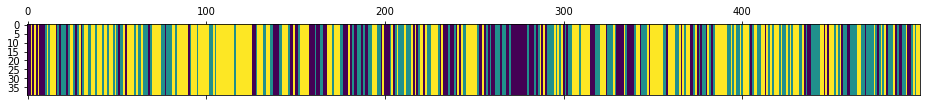

<Figure size 432x288 with 0 Axes>

N [[ 47.  39.  38.]
 [ 54.  61.  57.]
 [ 23.  72. 108.]]
alphas [[1.07028913 0.30185326 0.94163333]
 [0.70038738 0.67175501 0.94163333]
 [0.70038738 0.30185326 1.31153508]]
M [[4. 2. 3.]
 [3. 4. 8.]
 [4. 3. 9.]]
sum_w [[1.]
 [1.]
 [4.]]
barM [[3. 2. 3.]
 [3. 3. 8.]
 [4. 3. 5.]]
pi_z [[0.37549264 0.2845004  0.34000696]
 [0.29307079 0.37046473 0.33646448]
 [0.13324562 0.35362414 0.51313023]]
beta_vec [0.3217714  0.12308517 0.55514343]
hyper>> a_k: 3.2826661085746713  gamma: 0.5347533735425944  rho: 0.19773066515645174


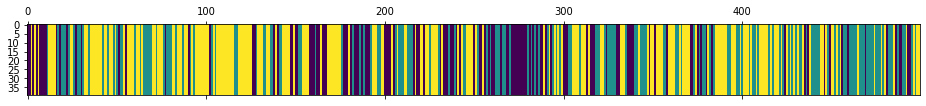

<Figure size 432x288 with 0 Axes>

N [[ 48.  39.  38.]
 [ 48.  61.  58.]
 [ 29.  67. 111.]]
alphas [[1.49649523 0.32415494 1.46201595]
 [0.84741147 0.97323869 1.46201595]
 [0.84741147 0.32415494 2.1110997 ]]
M [[8. 3. 5.]
 [4. 4. 5.]
 [2. 3. 8.]]
sum_w [[5.]
 [4.]
 [2.]]
barM [[3. 3. 5.]
 [4. 0. 5.]
 [2. 3. 6.]]
pi_z [[0.41389571 0.31251506 0.27358923]
 [0.26903855 0.41000204 0.32095941]
 [0.15983194 0.28974921 0.55041885]]
beta_vec [0.17325555 0.23945835 0.5872861 ]
hyper>> a_k: 2.471906898274006  gamma: 0.3503079794587872  rho: 0.21902102123931233


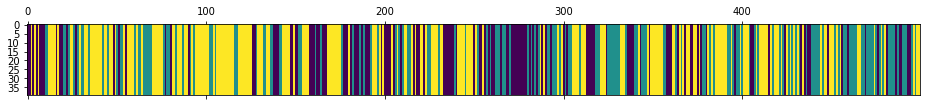

<Figure size 432x288 with 0 Axes>

N [[ 54.  40.  39.]
 [ 49.  58.  53.]
 [ 30.  62. 114.]]
alphas [[0.87587068 0.4622761  1.13376012]
 [0.33447111 1.00367567 1.13376012]
 [0.33447111 0.4622761  1.67515969]]
M [[2. 3. 3.]
 [4. 5. 5.]
 [2. 3. 6.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[0. 3. 3.]
 [4. 4. 5.]
 [2. 3. 5.]]
pi_z [[0.42923927 0.22207184 0.34868889]
 [0.35000019 0.36161598 0.28838383]
 [0.14571191 0.29744704 0.55684104]]
beta_vec [0.32096536 0.13816712 0.54086751]
hyper>> a_k: 1.85101521924848  gamma: 0.9933010052409451  rho: 0.19828101219427832


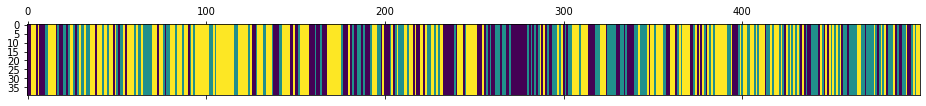

<Figure size 432x288 with 0 Axes>

N [[ 54.  38.  41.]
 [ 53.  56.  55.]
 [ 26.  70. 106.]]
alphas [[0.84333186 0.20503919 0.80264417]
 [0.47631069 0.57206036 0.80264417]
 [0.47631069 0.20503919 1.16966534]]
M [[7. 1. 3.]
 [3. 4. 2.]
 [4. 1. 5.]]
sum_w [[1.]
 [4.]
 [1.]]
barM [[6. 1. 3.]
 [3. 0. 2.]
 [4. 1. 4.]]
pi_z [[0.3795696  0.36705171 0.25337869]
 [0.32936212 0.34901732 0.32162056]
 [0.15204661 0.33066365 0.51728974]]
beta_vec [0.63638365 0.15132932 0.21228703]
hyper>> a_k: 2.7330062669881765  gamma: 0.5435899170985383  rho: 0.13182599838655548


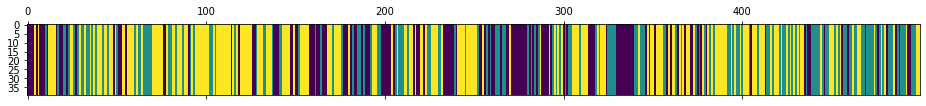

<Figure size 432x288 with 0 Axes>

N [[ 63.  37.  38.]
 [ 44.  52.  61.]
 [ 31.  68. 105.]]
alphas [[1.87024467 0.35906286 0.50369874]
 [1.50996339 0.71934414 0.50369874]
 [1.50996339 0.35906286 0.86398002]]
M [[10.  4.  2.]
 [ 4.  3.  5.]
 [ 4.  3.  5.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[8. 4. 2.]
 [4. 2. 5.]
 [4. 3. 5.]]
pi_z [[0.48058934 0.2564347  0.26297596]
 [0.22852524 0.40010546 0.3713693 ]
 [0.15066411 0.32322158 0.52611431]]
beta_vec [0.34131357 0.39561244 0.26307399]
hyper>> a_k: 2.7636073488816675  gamma: 0.5663214102019312  rho: 0.11270576444553933


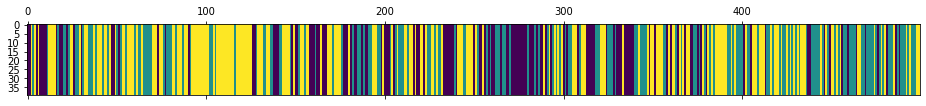

<Figure size 432x288 with 0 Axes>

N [[54. 40. 38.]
 [48. 62. 61.]
 [30. 69. 97.]]
alphas [[1.14842071 0.97009426 0.64509238]
 [0.83694623 1.28156874 0.64509238]
 [0.83694623 0.97009426 0.95656686]]
M [[8. 5. 4.]
 [4. 7. 5.]
 [4. 8. 6.]]
sum_w [[6.]
 [2.]
 [0.]]
barM [[2. 5. 4.]
 [4. 5. 5.]
 [4. 8. 6.]]
pi_z [[0.41482796 0.30882691 0.27634513]
 [0.2300978  0.37274615 0.39715605]
 [0.15840437 0.35670822 0.4848874 ]]
beta_vec [0.24253377 0.41093826 0.34652796]
hyper>> a_k: 4.442697140736003  gamma: 2.266563827332739  rho: 0.13903444774849583


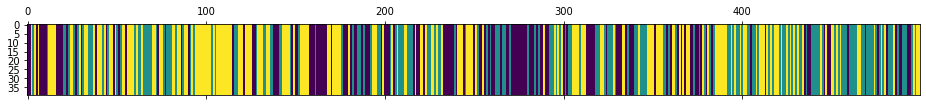

<Figure size 432x288 with 0 Axes>

N [[60. 43. 39.]
 [52. 61. 57.]
 [30. 66. 91.]]
alphas [[1.54538185 1.57184264 1.32547265]
 [0.9276939  2.18953059 1.32547265]
 [0.9276939  1.57184264 1.9431606 ]]
M [[3. 4. 4.]
 [3. 8. 4.]
 [3. 3. 6.]]
sum_w [[1.]
 [5.]
 [1.]]
barM [[2. 4. 4.]
 [3. 3. 4.]
 [3. 3. 5.]]
pi_z [[0.40825711 0.35575593 0.23598695]
 [0.30825054 0.36089683 0.33085263]
 [0.13806538 0.3562344  0.50570022]]
beta_vec [0.18400838 0.36357744 0.45241417]
hyper>> a_k: 3.040570027900319  gamma: 0.5199391062266989  rho: 0.28694949818279003


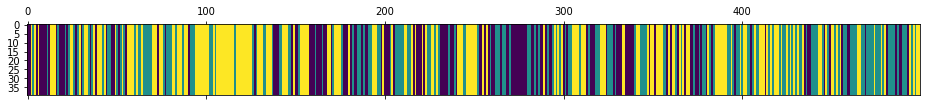

<Figure size 432x288 with 0 Axes>

N [[55. 51. 34.]
 [55. 62. 57.]
 [30. 61. 94.]]
alphas [[1.27143493 0.78826498 0.98087011]
 [0.39894489 1.66075502 0.98087011]
 [0.39894489 0.78826498 1.85336016]]
M [[6. 4. 3.]
 [1. 7. 2.]
 [3. 3. 8.]]
sum_w [[5.]
 [4.]
 [4.]]
barM [[1. 4. 3.]
 [1. 3. 2.]
 [3. 3. 4.]]
pi_z [[0.42677422 0.36270315 0.21052263]
 [0.31094795 0.36986534 0.3191867 ]
 [0.17065734 0.30277424 0.52656843]]
beta_vec [0.37705359 0.31788219 0.30506422]
hyper>> a_k: 2.0896522996334834  gamma: 0.21740133540753398  rho: 0.3650547414146518


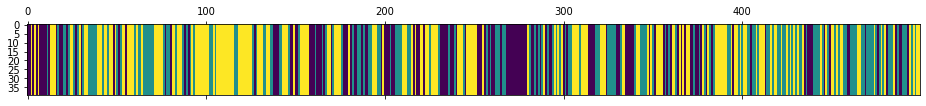

<Figure size 432x288 with 0 Axes>

N [[ 56.  51.  33.]
 [ 55.  59.  56.]
 [ 29.  60. 100.]]
alphas [[1.26311777 0.4217708  0.40476373]
 [0.50028029 1.18460828 0.40476373]
 [0.50028029 0.4217708  1.16760121]]
M [[4. 2. 5.]
 [2. 6. 3.]
 [2. 2. 6.]]
sum_w [[3.]
 [6.]
 [2.]]
barM [[1. 2. 5.]
 [2. 0. 3.]
 [2. 2. 4.]]
pi_z [[0.39325344 0.33183296 0.2749136 ]
 [0.31336933 0.34340613 0.34322454]
 [0.15015293 0.28903041 0.56081666]]
beta_vec [0.13002238 0.11239703 0.75758059]
hyper>> a_k: 1.56452062287777  gamma: 1.0597246123911481  rho: 0.440349923865706


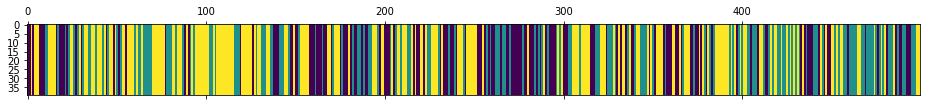

<Figure size 432x288 with 0 Axes>

N [[ 56.  46.  43.]
 [ 56.  53.  50.]
 [ 33.  60. 102.]]
alphas [[0.80278206 0.09841305 0.66332551]
 [0.11384553 0.78734958 0.66332551]
 [0.11384553 0.09841305 1.35226205]]
M [[4. 2. 2.]
 [2. 6. 2.]
 [1. 1. 8.]]
sum_w [[4.]
 [5.]
 [3.]]
barM [[0. 2. 2.]
 [2. 1. 2.]
 [1. 1. 5.]]
pi_z [[0.33666266 0.40723021 0.25610713]
 [0.396983   0.37937969 0.22363731]
 [0.21326627 0.33339322 0.45334051]]
beta_vec [0.17182814 0.19891245 0.62925941]
hyper>> a_k: 1.9487565029703817  gamma: 1.1774198928688728  rho: 0.39573925811524974


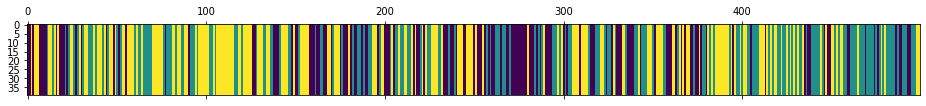

<Figure size 432x288 with 0 Axes>

N [[58. 41. 41.]
 [54. 68. 52.]
 [28. 65. 92.]]
alphas [[0.97353689 0.23423075 0.74098886]
 [0.20233744 1.00543021 0.74098886]
 [0.20233744 0.23423075 1.51218831]]
M [[6. 1. 3.]
 [1. 5. 1.]
 [1. 2. 9.]]
sum_w [[6.]
 [4.]
 [7.]]
barM [[0. 1. 3.]
 [1. 1. 1.]
 [1. 2. 2.]]
pi_z [[0.47337932 0.22575967 0.30086102]
 [0.31820995 0.36635127 0.31543877]
 [0.14515193 0.31832995 0.53651812]]
beta_vec [0.19148649 0.37548815 0.43302537]
hyper>> a_k: 1.8438892472419186  gamma: 0.08726656571514965  rho: 0.5067866444178032


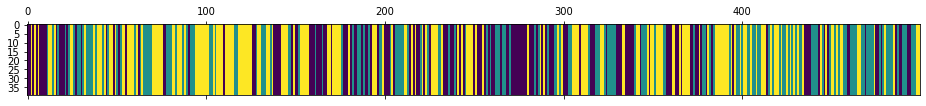

<Figure size 432x288 with 0 Axes>

N [[65. 39. 47.]
 [53. 63. 46.]
 [33. 60. 93.]]
alphas [[1.10860215 0.34148049 0.39380661]
 [0.17414371 1.27593893 0.39380661]
 [0.17414371 0.34148049 1.32826505]]
M [[6. 3. 3.]
 [1. 4. 3.]
 [1. 2. 7.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[1. 3. 3.]
 [1. 0. 3.]
 [1. 2. 2.]]
pi_z [[0.4168577  0.25108094 0.33206136]
 [0.3126126  0.38226808 0.30511932]
 [0.20067932 0.33691338 0.4624073 ]]
beta_vec [0.34758066 0.20320597 0.44921337]
hyper>> a_k: 1.649554630341857  gamma: 0.3634274933702053  rho: 0.4156948725912738


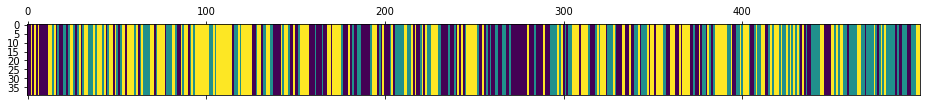

<Figure size 432x288 with 0 Axes>

N [[70. 39. 47.]
 [54. 58. 46.]
 [32. 61. 92.]]
alphas [[1.02072467 0.19585869 0.43297127]
 [0.33501326 0.8815701  0.43297127]
 [0.33501326 0.19585869 1.11868267]]
M [[7. 2. 4.]
 [2. 3. 1.]
 [3. 2. 4.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[3. 2. 4.]
 [2. 1. 1.]
 [3. 2. 2.]]
pi_z [[0.46348119 0.27013668 0.26638213]
 [0.30951883 0.39864864 0.29183253]
 [0.16292255 0.34472461 0.49235284]]
beta_vec [0.51723875 0.25792802 0.22483323]
hyper>> a_k: 2.2058101407554815  gamma: 0.5114090990496803  rho: 0.1898213142103718


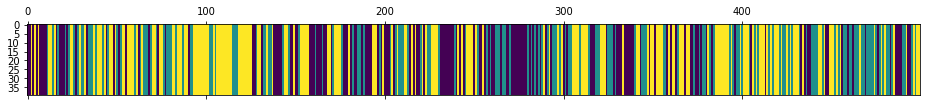

<Figure size 432x288 with 0 Axes>

N [[62. 46. 46.]
 [63. 46. 49.]
 [29. 66. 92.]]
alphas [[1.34306734 0.46094326 0.40179954]
 [0.92435756 0.87965304 0.40179954]
 [0.92435756 0.46094326 0.82050932]]
M [[5. 4. 3.]
 [3. 3. 4.]
 [3. 3. 2.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[5. 4. 3.]
 [3. 2. 4.]
 [3. 3. 1.]]
pi_z [[0.35617848 0.36019056 0.28363095]
 [0.45415276 0.24219894 0.3036483 ]
 [0.16566347 0.29920007 0.53513646]]
beta_vec [0.22911773 0.46983597 0.30104629]
hyper>> a_k: 2.220941559715569  gamma: 0.32435309736801626  rho: 0.08970021212921973


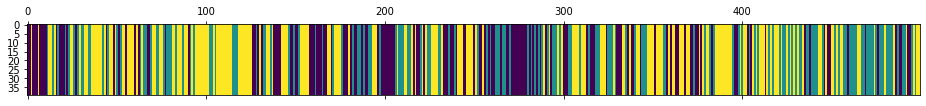

<Figure size 432x288 with 0 Axes>

N [[ 61.  42.  43.]
 [ 57.  51.  50.]
 [ 28.  65. 102.]]
alphas [[0.66243143 0.94987802 0.6086321 ]
 [0.4632125  1.14909695 0.6086321 ]
 [0.4632125  0.94987802 0.80785103]]
M [[5. 2. 5.]
 [2. 4. 3.]
 [1. 5. 2.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[5. 2. 5.]
 [2. 3. 3.]
 [1. 5. 1.]]
pi_z [[0.44158024 0.30653652 0.25188324]
 [0.32321655 0.35280251 0.32398094]
 [0.13814537 0.29293503 0.5689196 ]]
beta_vec [0.16120468 0.31504664 0.52374868]
hyper>> a_k: 2.3887607053901365  gamma: 0.8969973896781468  rho: 0.15973471637410175


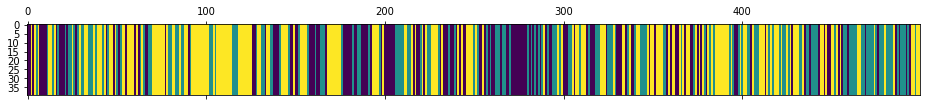

<Figure size 432x288 with 0 Axes>

N [[56. 44. 44.]
 [51. 61. 51.]
 [37. 58. 97.]]
alphas [[0.70513688 0.63235931 1.05126452]
 [0.32356886 1.01392732 1.05126452]
 [0.32356886 0.63235931 1.43283254]]
M [[1. 2. 6.]
 [2. 5. 4.]
 [5. 3. 3.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[1. 2. 6.]
 [2. 3. 4.]
 [5. 3. 2.]]
pi_z [[0.47699506 0.25893677 0.26406817]
 [0.36366963 0.36766924 0.26866113]
 [0.17383546 0.33534857 0.49081597]]
beta_vec [0.25319502 0.1419587  0.60484629]
hyper>> a_k: 2.108839109823963  gamma: 0.5031860132447522  rho: 0.0816215234188723


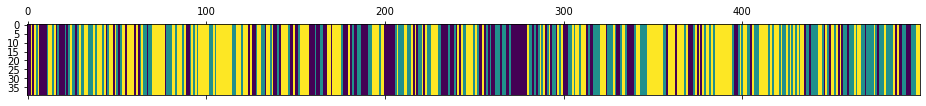

<Figure size 432x288 with 0 Axes>

N [[ 54.  38.  38.]
 [ 48.  59.  61.]
 [ 28.  71. 102.]]
alphas [[0.6624926  0.27493318 1.17141333]
 [0.49036594 0.44705984 1.17141333]
 [0.49036594 0.27493318 1.34353999]]
M [[4. 3. 6.]
 [1. 4. 3.]
 [1. 2. 7.]]
sum_w [[0.]
 [3.]
 [0.]]
barM [[4. 3. 6.]
 [1. 1. 3.]
 [1. 2. 7.]]
pi_z [[0.42230058 0.29693207 0.28076735]
 [0.2651745  0.33367869 0.40114681]
 [0.13604965 0.33782859 0.52612176]]
beta_vec [0.24312946 0.24600984 0.5108607 ]
hyper>> a_k: 1.4067173885451698  gamma: 0.6035906359602651  rho: 0.09151399581507398


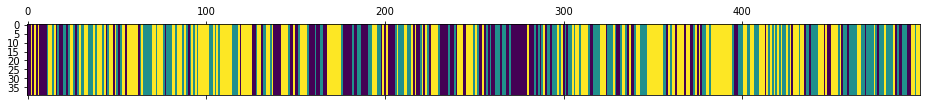

<Figure size 432x288 with 0 Axes>

N [[ 54.  39.  38.]
 [ 49.  64.  55.]
 [ 28.  65. 107.]]
alphas [[0.43944966 0.31439641 0.65287132]
 [0.31071533 0.44313074 0.65287132]
 [0.31071533 0.31439641 0.78160565]]
M [[2. 2. 5.]
 [3. 2. 3.]
 [1. 3. 2.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[2. 2. 5.]
 [3. 1. 3.]
 [1. 3. 2.]]
pi_z [[0.42430294 0.25667159 0.31902548]
 [0.35237268 0.36937208 0.27825524]
 [0.14262465 0.29456551 0.56280984]]
beta_vec [0.23776416 0.35038222 0.41185361]
hyper>> a_k: 1.8721196465649121  gamma: 0.7479031027871987  rho: 0.04774188819818731


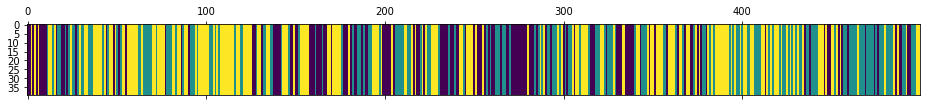

<Figure size 432x288 with 0 Axes>

N [[57. 36. 45.]
 [50. 70. 52.]
 [31. 66. 92.]]
alphas [[0.51325048 0.62464079 0.73422837]
 [0.42387195 0.71401932 0.73422837]
 [0.42387195 0.62464079 0.8236069 ]]
M [[4. 3. 5.]
 [5. 6. 4.]
 [1. 2. 3.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[3. 3. 5.]
 [5. 4. 4.]
 [1. 2. 3.]]
pi_z [[0.37213227 0.30904996 0.31881777]
 [0.29663517 0.37949578 0.32386905]
 [0.19409428 0.33885963 0.46704609]]
beta_vec [0.40132958 0.21856792 0.3801025 ]
hyper>> a_k: 2.810305015759238  gamma: 0.16132351958680097  rho: 0.05798718924304774


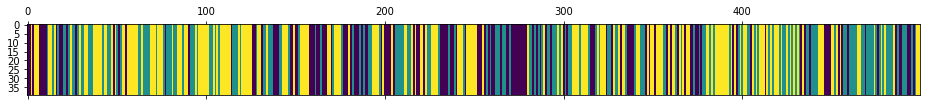

<Figure size 432x288 with 0 Axes>

N [[53. 45. 38.]
 [52. 63. 57.]
 [31. 64. 96.]]
alphas [[1.22541887 0.57862432 1.00626183]
 [1.06245718 0.741586   1.00626183]
 [1.06245718 0.57862432 1.16922352]]
M [[7. 3. 4.]
 [6. 5. 4.]
 [3. 4. 3.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[7. 3. 4.]
 [6. 4. 4.]
 [3. 4. 3.]]
pi_z [[0.40128904 0.32664092 0.27207003]
 [0.31733268 0.33604971 0.34661761]
 [0.15769119 0.36460851 0.4777003 ]]
beta_vec [0.57363241 0.17918573 0.24718186]
hyper>> a_k: 3.6889039012357534  gamma: 0.7448908826204712  rho: 0.15836043949270273


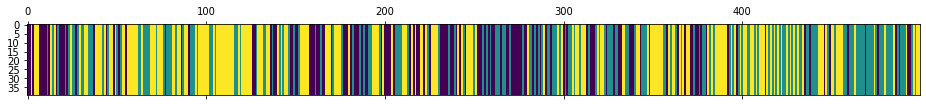

<Figure size 432x288 with 0 Axes>

N [[46. 51. 35.]
 [57. 59. 61.]
 [29. 67. 94.]]
alphas [[2.36514873 0.55632286 0.76743232]
 [1.78097228 1.1404993  0.76743232]
 [1.78097228 0.55632286 1.35160876]]
M [[7. 5. 2.]
 [6. 5. 5.]
 [8. 3. 7.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[5. 5. 2.]
 [6. 2. 5.]
 [8. 3. 3.]]
pi_z [[0.33220769 0.44633153 0.22146078]
 [0.34840097 0.35614478 0.29545425]
 [0.14736962 0.3785718  0.47405858]]
beta_vec [0.47521859 0.25578415 0.26899726]
hyper>> a_k: 4.051623282216076  gamma: 0.9815814015076014  rho: 0.34000678763423625


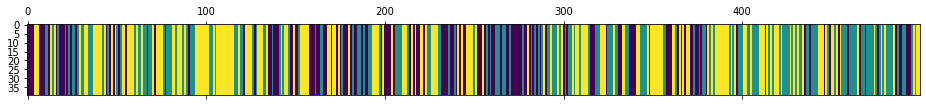

<Figure size 432x288 with 0 Axes>

N [[52. 50. 38.]
 [53. 70. 55.]
 [35. 58. 88.]]
alphas [[2.64833477 0.68397803 0.71931048]
 [1.27075535 2.06155745 0.71931048]
 [1.27075535 0.68397803 2.0968899 ]]
M [[5. 3. 3.]
 [8. 7. 4.]
 [4. 5. 9.]]
sum_w [[4.]
 [4.]
 [7.]]
barM [[1. 3. 3.]
 [8. 3. 4.]
 [4. 5. 2.]]
pi_z [[0.33176392 0.38019395 0.28804213]
 [0.25627208 0.42763901 0.31608891]
 [0.21827728 0.3026767  0.47904602]]
beta_vec [0.42693893 0.27858236 0.29447872]
hyper>> a_k: 4.918342641621181  gamma: 0.845676184475887  rho: 0.312964585167009


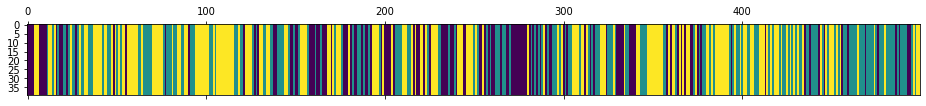

<Figure size 432x288 with 0 Axes>

N [[48. 51. 28.]
 [49. 76. 61.]
 [30. 59. 97.]]
alphas [[2.98192596 0.94135084 0.99506584]
 [1.4426589  2.4806179  0.99506584]
 [1.4426589  0.94135084 2.5343329 ]]
M [[14.  5.  4.]
 [ 5.  9.  6.]
 [ 7.  6. 11.]]
sum_w [[6.]
 [5.]
 [8.]]
barM [[8. 5. 4.]
 [5. 4. 6.]
 [7. 6. 3.]]
pi_z [[0.46859338 0.34428761 0.18711901]
 [0.28678134 0.41379458 0.29942407]
 [0.13029292 0.3648106  0.50489649]]
beta_vec [0.38966028 0.3923797  0.21796002]
hyper>> a_k: 5.977641036808388  gamma: 0.5941802809645543  rho: 0.28635882157359266


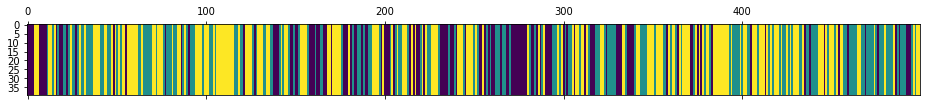

<Figure size 432x288 with 0 Axes>

N [[52. 46. 27.]
 [45. 70. 67.]
 [28. 66. 98.]]
alphas [[3.37399846 1.67384893 0.92979364]
 [1.66224822 3.38559918 0.92979364]
 [1.66224822 1.67384893 2.64154388]]
M [[ 8.  4.  1.]
 [ 7. 15.  5.]
 [ 6. 11. 11.]]
sum_w [[ 4.]
 [11.]
 [ 9.]]
barM [[ 4.  4.  1.]
 [ 7.  4.  5.]
 [ 6. 11.  2.]]
pi_z [[0.40103493 0.36869891 0.23026616]
 [0.18588212 0.42797943 0.38613844]
 [0.20780228 0.31652848 0.47566923]]
beta_vec [0.20018594 0.59187088 0.20794318]
hyper>> a_k: 7.7634360089901735  gamma: 0.9075247889651927  rho: 0.34631197681958975


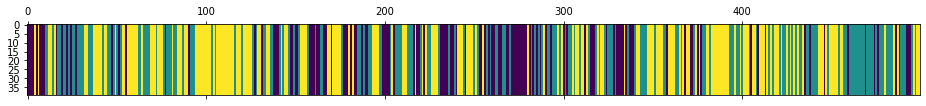

<Figure size 432x288 with 0 Axes>

N [[ 48.  48.  28.]
 [ 53.  73.  58.]
 [ 23.  63. 105.]]
alphas [[3.7044875  3.00366489 1.05528362]
 [1.01591663 5.69223576 1.05528362]
 [1.01591663 3.00366489 3.74385449]]
M [[10.  9.  4.]
 [ 7. 11.  6.]
 [ 5. 12. 14.]]
sum_w [[ 7.]
 [ 8.]
 [10.]]
barM [[ 3.  9.  4.]
 [ 7.  3.  6.]
 [ 5. 12.  4.]]
pi_z [[0.480257   0.32049792 0.19924508]
 [0.31787591 0.41032315 0.27180095]
 [0.13306552 0.33067948 0.536255  ]]
beta_vec [0.33593069 0.3991315  0.26493781]
hyper>> a_k: 9.28287489460827  gamma: 0.5093937216209948  rho: 0.2558480075466807


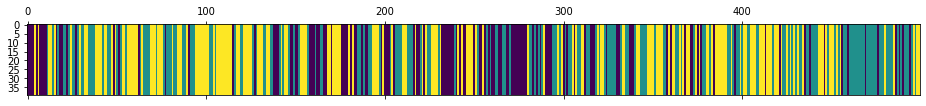

<Figure size 432x288 with 0 Axes>

N [[51. 40. 37.]
 [52. 79. 55.]
 [25. 67. 93.]]
alphas [[4.69557052 2.75714846 1.83015592]
 [2.32056548 5.1321535  1.83015592]
 [2.32056548 2.75714846 4.20516096]]
M [[11. 10.  6.]
 [ 4. 16.  8.]
 [ 7. 10. 15.]]
sum_w [[ 5.]
 [ 6.]
 [10.]]
barM [[ 6. 10.  6.]
 [ 4. 10.  8.]
 [ 7. 10.  5.]]
pi_z [[0.38309063 0.31829318 0.29861619]
 [0.29497294 0.44251136 0.26251571]
 [0.10999736 0.42161256 0.46839008]]
beta_vec [0.15864389 0.60569444 0.23566168]
hyper>> a_k: 7.545899561252163  gamma: 0.39155978887278525  rho: 0.2420144604889344


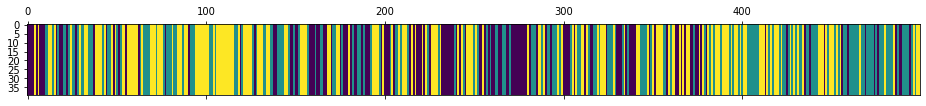

<Figure size 432x288 with 0 Axes>

N [[53. 44. 40.]
 [52. 71. 58.]
 [32. 66. 83.]]
alphas [[2.7336095  3.46438002 1.34791004]
 [0.90739269 5.29059683 1.34791004]
 [0.90739269 3.46438002 3.17412685]]
M [[ 9. 10.  5.]
 [ 4. 12.  7.]
 [ 4. 16. 14.]]
sum_w [[5.]
 [2.]
 [7.]]
barM [[ 4. 10.  5.]
 [ 4. 10.  7.]
 [ 4. 16.  7.]]
pi_z [[0.34881065 0.37839827 0.27279108]
 [0.26531127 0.37162314 0.36306559]
 [0.20446038 0.35213797 0.44340166]]
beta_vec [0.1837065  0.46621471 0.35007879]
hyper>> a_k: 8.506915621382836  gamma: 0.48602674703987087  rho: 0.15387247652318722


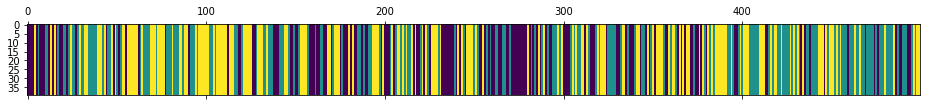

<Figure size 432x288 with 0 Axes>

N [[57. 46. 42.]
 [57. 69. 55.]
 [31. 66. 76.]]
alphas [[2.63128768 3.35578338 2.51984456]
 [1.32230751 4.66476355 2.51984456]
 [1.32230751 3.35578338 3.82882473]]
M [[ 6.  8. 10.]
 [ 4. 16.  8.]
 [ 7. 11.  7.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[ 4.  8. 10.]
 [ 4. 15.  8.]
 [ 7. 11.  5.]]
pi_z [[0.39651303 0.28132091 0.32216606]
 [0.32122982 0.38513912 0.29363107]
 [0.19897677 0.37638545 0.42463778]]
beta_vec [0.28817405 0.47693345 0.23489251]
hyper>> a_k: 7.852660222280301  gamma: 0.48663340066818905  rho: 0.06382230761095771


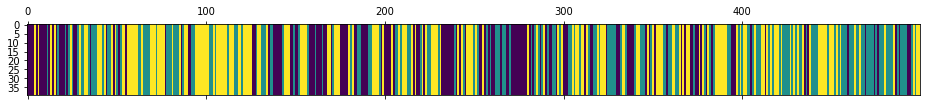

<Figure size 432x288 with 0 Axes>

N [[64. 42. 39.]
 [52. 66. 58.]
 [29. 68. 81.]]
alphas [[2.61968217 3.50616923 1.72680882]
 [2.11850727 4.00734413 1.72680882]
 [2.11850727 3.50616923 2.22798372]]
M [[ 9.  8.  5.]
 [ 5. 11.  5.]
 [ 6. 11. 10.]]
sum_w [[2.]
 [1.]
 [5.]]
barM [[ 7.  8.  5.]
 [ 5. 10.  5.]
 [ 6. 11.  5.]]
pi_z [[0.39396163 0.26530826 0.34073011]
 [0.2720338  0.36478908 0.36317711]
 [0.11874967 0.35177492 0.52947541]]
beta_vec [0.22152735 0.43710648 0.34136617]
hyper>> a_k: 4.885235191781314  gamma: 0.2403978903068563  rho: 0.1476430313894259


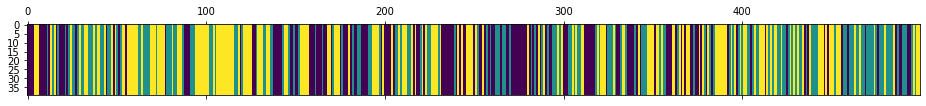

<Figure size 432x288 with 0 Axes>

N [[68. 40. 44.]
 [55. 59. 52.]
 [29. 67. 85.]]
alphas [[1.64370291 1.82009575 1.42143654]
 [0.92243197 2.54136668 1.42143654]
 [0.92243197 1.82009575 2.14270747]]
M [[ 7.  9.  5.]
 [ 5.  8.  6.]
 [ 2.  7. 12.]]
sum_w [[3.]
 [2.]
 [8.]]
barM [[4. 9. 5.]
 [5. 6. 6.]
 [2. 7. 4.]]
pi_z [[0.40814068 0.28371018 0.30814914]
 [0.34391266 0.31828686 0.33780048]
 [0.0869997  0.44650467 0.46649563]]
beta_vec [0.24688247 0.44863562 0.30448191]
hyper>> a_k: 4.890172028859207  gamma: 0.29630696162101555  rho: 0.22877601655932522


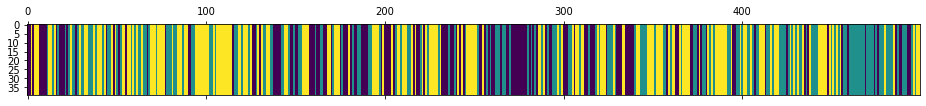

<Figure size 432x288 with 0 Axes>

N [[59. 40. 40.]
 [57. 66. 54.]
 [23. 71. 89.]]
alphas [[2.04985104 1.69199244 1.14832856]
 [0.93109696 2.81074651 1.14832856]
 [0.93109696 1.69199244 2.26708263]]
M [[ 7.  9.  4.]
 [ 2.  8.  7.]
 [ 3.  7. 13.]]
sum_w [[1.]
 [5.]
 [9.]]
barM [[6. 9. 4.]
 [2. 3. 7.]
 [3. 7. 4.]]
pi_z [[0.41413811 0.25998148 0.3258804 ]
 [0.33885531 0.35146262 0.30968207]
 [0.198204   0.38111034 0.42068566]]
beta_vec [0.24756199 0.39636203 0.35607598]
hyper>> a_k: 6.419352564309494  gamma: 0.7459711341401053  rho: 0.24887865559476052


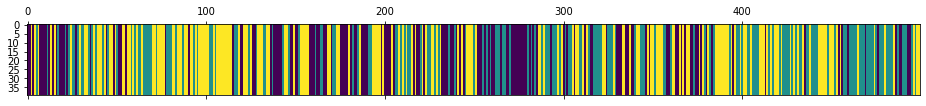

<Figure size 432x288 with 0 Axes>

N [[58. 36. 48.]
 [50. 66. 58.]
 [34. 72. 77.]]
alphas [[2.79131264 1.91114384 1.71689609]
 [1.1936728  3.50878368 1.71689609]
 [1.1936728  1.91114384 3.31453592]]
M [[ 7.  4.  5.]
 [ 6. 13. 12.]
 [ 2.  8. 12.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[ 2.  4.  5.]
 [ 6.  9. 12.]
 [ 2.  8.  7.]]
pi_z [[0.40363426 0.21500434 0.3813614 ]
 [0.27836683 0.37872945 0.34290372]
 [0.21833131 0.34505683 0.43661186]]
beta_vec [0.19641615 0.43398029 0.36960356]
hyper>> a_k: 6.825119011677771  gamma: 1.1963860391019383  rho: 0.17124496045721385


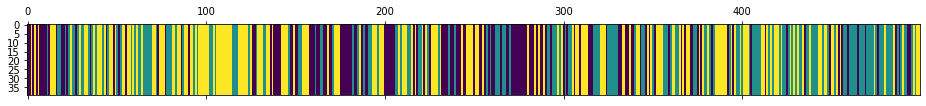

<Figure size 432x288 with 0 Axes>

N [[57. 37. 52.]
 [51. 68. 49.]
 [38. 63. 84.]]
alphas [[2.27976606 2.4547452  2.09060775]
 [1.11099882 3.62351244 2.09060775]
 [1.11099882 2.4547452  3.25937499]]
M [[ 7.  6.  5.]
 [ 7. 13.  5.]
 [ 2. 12.  6.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[ 4.  6.  5.]
 [ 7. 10.  5.]
 [ 2. 12.  2.]]
pi_z [[0.43416237 0.25048396 0.31535367]
 [0.2804768  0.40035833 0.31916487]
 [0.24655055 0.326496   0.42695345]]
beta_vec [0.24414336 0.52942122 0.22643542]
hyper>> a_k: 5.919511865946116  gamma: 0.2099035305164016  rho: 0.14151002054057804


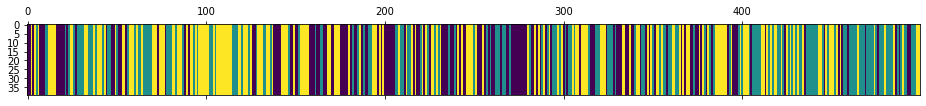

<Figure size 432x288 with 0 Axes>

N [[61. 38. 50.]
 [48. 67. 54.]
 [40. 64. 77.]]
alphas [[2.07836811 2.69043481 1.15070895]
 [1.24069786 3.52810506 1.15070895]
 [1.24069786 2.69043481 1.98837919]]
M [[ 6.  4.  4.]
 [ 6. 10.  5.]
 [ 5.  5.  9.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[2. 4. 4.]
 [6. 8. 5.]
 [5. 5. 3.]]
pi_z [[0.41598317 0.21481291 0.36920392]
 [0.2945483  0.43002051 0.27543119]
 [0.16174355 0.43682528 0.40143117]]
beta_vec [0.31101006 0.32410209 0.36488785]
hyper>> a_k: 4.482609673927949  gamma: 0.08529505614266111  rho: 0.314939071871162


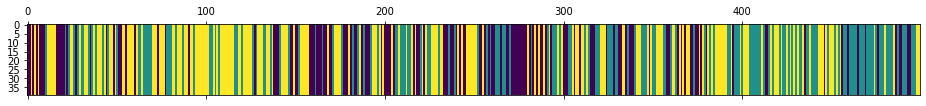

<Figure size 432x288 with 0 Axes>

N [[56. 35. 48.]
 [48. 65. 54.]
 [35. 67. 91.]]
alphas [[2.36681752 0.99527237 1.12051978]
 [0.95506859 2.4070213  1.12051978]
 [0.95506859 0.99527237 2.53226871]]
M [[ 7.  8.  4.]
 [ 4. 10.  5.]
 [ 1.  4.  7.]]
sum_w [[4.]
 [7.]
 [4.]]
barM [[3. 8. 4.]
 [4. 3. 5.]
 [1. 4. 3.]]
pi_z [[0.35136019 0.32073338 0.32790643]
 [0.30888225 0.35176768 0.33935008]
 [0.23547807 0.34465123 0.41987071]]
beta_vec [0.22579015 0.45423236 0.3199775 ]
hyper>> a_k: 5.058413108445514  gamma: 0.8230245813888164  rho: 0.27712289679396845


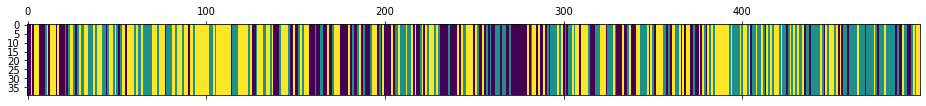

<Figure size 432x288 with 0 Axes>

N [[56. 37. 45.]
 [47. 66. 60.]
 [35. 70. 83.]]
alphas [[2.22742883 1.66095104 1.17003323]
 [0.82562674 3.06275314 1.17003323]
 [0.82562674 1.66095104 2.57183533]]
M [[ 7.  6.  3.]
 [ 3. 17.  5.]
 [ 4.  6. 11.]]
sum_w [[5.]
 [7.]
 [8.]]
barM [[ 2.  6.  3.]
 [ 3. 10.  5.]
 [ 4.  6.  3.]]
pi_z [[0.44784848 0.31374724 0.23840428]
 [0.27095071 0.33488051 0.39416878]
 [0.20150284 0.33862737 0.45986979]]
beta_vec [0.1778638  0.47010769 0.35202851]
hyper>> a_k: 6.923781429858276  gamma: 0.5652178190300562  rho: 0.31523800375179306


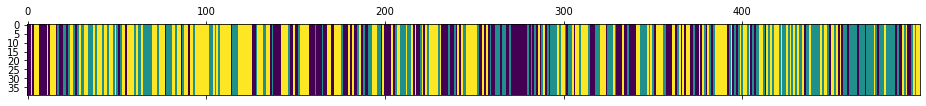

<Figure size 432x288 with 0 Axes>

N [[54. 41. 44.]
 [50. 60. 57.]
 [35. 66. 92.]]
alphas [[3.02591663 2.22884752 1.66901727]
 [0.8432776  4.41148656 1.66901727]
 [0.8432776  2.22884752 3.85165631]]
M [[ 8.  7.  7.]
 [ 7. 14.  6.]
 [ 8.  6. 14.]]
sum_w [[5.]
 [7.]
 [9.]]
barM [[3. 7. 7.]
 [7. 7. 6.]
 [8. 6. 5.]]
pi_z [[0.39862842 0.27147547 0.32989612]
 [0.30009072 0.34186965 0.35803963]
 [0.22556695 0.35753915 0.41689389]]
beta_vec [0.29169534 0.34808334 0.36022132]
hyper>> a_k: 7.618948731419521  gamma: 0.9195317527252636  rho: 0.23526532451497076


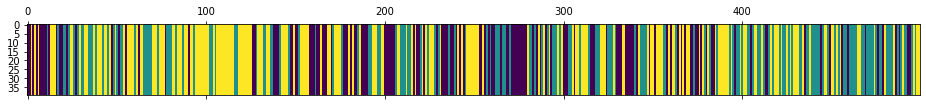

<Figure size 432x288 with 0 Axes>

N [[57. 38. 44.]
 [47. 59. 57.]
 [35. 66. 96.]]
alphas [[3.49202987 2.02809861 2.09882025]
 [1.69955542 3.82057306 2.09882025]
 [1.69955542 2.02809861 3.8912947 ]]
M [[10.  5.  7.]
 [ 4.  8. 10.]
 [ 6.  8.  9.]]
sum_w [[5.]
 [1.]
 [4.]]
barM [[ 5.  5.  7.]
 [ 4.  7. 10.]
 [ 6.  8.  5.]]
pi_z [[0.38398511 0.27108842 0.34492647]
 [0.29759859 0.35132412 0.3510773 ]
 [0.155678   0.2351946  0.6091274 ]]
beta_vec [0.21688422 0.32424907 0.45886672]
hyper>> a_k: 6.039258607528714  gamma: 0.9571843772508271  rho: 0.16969500532143417


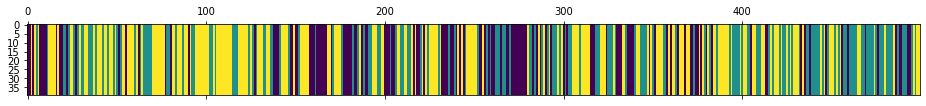

<Figure size 432x288 with 0 Axes>

N [[ 53.  39.  37.]
 [ 48.  62.  59.]
 [ 28.  68. 105.]]
alphas [[2.112382   1.62592314 2.30095347]
 [1.08754998 2.65075516 2.30095347]
 [1.08754998 1.62592314 3.32578549]]
M [[ 9.  8.  4.]
 [ 2. 10.  6.]
 [ 4. 10. 13.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[ 7.  8.  4.]
 [ 2.  7.  6.]
 [ 4. 10. 12.]]
pi_z [[0.4191888  0.289101   0.2917102 ]
 [0.26610315 0.35917021 0.37472664]
 [0.15026219 0.30355438 0.54618343]]
beta_vec [0.19991917 0.44113758 0.35894325]
hyper>> a_k: 6.237751629754783  gamma: 0.1601847882561996  rho: 0.09862398733070513


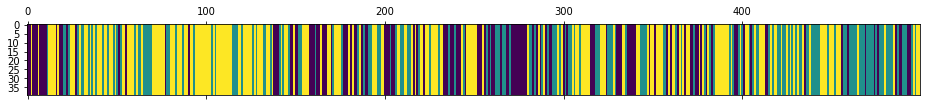

<Figure size 432x288 with 0 Axes>

N [[ 55.  35.  39.]
 [ 45.  57.  61.]
 [ 29.  71. 107.]]
alphas [[1.73924943 2.48032235 2.01817985]
 [1.12405749 3.09551429 2.01817985]
 [1.12405749 2.48032235 2.63337179]]
M [[ 5.  9. 10.]
 [ 5. 13.  8.]
 [ 1. 13.  7.]]
sum_w [[1.]
 [4.]
 [0.]]
barM [[ 4.  9. 10.]
 [ 5.  9.  8.]
 [ 1. 13.  7.]]
pi_z [[0.4620805  0.35962379 0.17829572]
 [0.23869091 0.36165911 0.39964998]
 [0.09018206 0.3465226  0.56329534]]
beta_vec [0.13542076 0.48582272 0.37875651]
hyper>> a_k: 6.764212298930193  gamma: 1.6359763483383014  rho: 0.07604297501158302


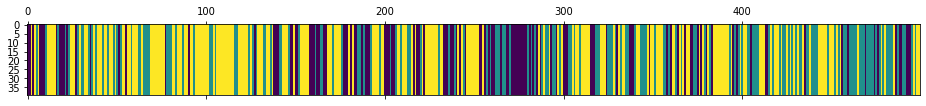

<Figure size 432x288 with 0 Axes>

N [[ 47.  40.  35.]
 [ 50.  54.  61.]
 [ 25.  71. 116.]]
alphas [[1.36072914 3.03631501 2.36716815]
 [0.84635831 3.55068584 2.36716815]
 [0.84635831 3.03631501 2.88153898]]
M [[ 4. 12.  5.]
 [ 6. 11. 11.]
 [ 2.  9. 13.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[ 2. 12.  5.]
 [ 6. 11. 11.]
 [ 2.  9. 11.]]
pi_z [[0.32024264 0.40944507 0.27031229]
 [0.27422913 0.31727167 0.4084992 ]
 [0.10044433 0.37184441 0.52771126]]
beta_vec [0.18687818 0.56403098 0.24909084]
hyper>> a_k: 6.254895577464642  gamma: 0.493863105225883  rho: 0.09430193967918125


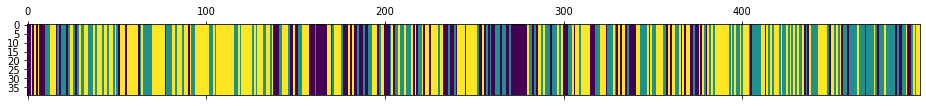

<Figure size 432x288 with 0 Axes>

N [[ 46.  33.  41.]
 [ 41.  71.  60.]
 [ 33.  68. 106.]]
alphas [[1.64852243 3.19526188 1.41111127]
 [1.05867364 3.78511066 1.41111127]
 [1.05867364 3.19526188 2.00096006]]
M [[ 2.  7.  6.]
 [ 4. 13.  6.]
 [ 5.  6. 10.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[ 0.  7.  6.]
 [ 4. 13.  6.]
 [ 5.  6.  9.]]
pi_z [[0.4022756  0.22444685 0.37327754]
 [0.19736617 0.42068016 0.38195368]
 [0.15941586 0.33606035 0.50452379]]
beta_vec [0.11220212 0.4154551  0.47234278]
hyper>> a_k: 4.623489155197613  gamma: 0.528098490808515  rho: 0.08517010555502716


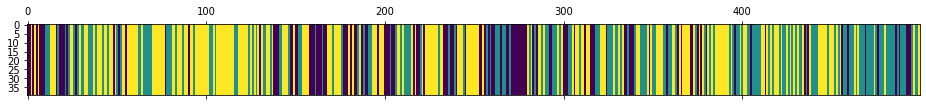

<Figure size 432x288 with 0 Axes>

N [[ 47.  34.  38.]
 [ 42.  67.  63.]
 [ 30.  70. 108.]]
alphas [[0.86836504 1.75725298 1.99787113]
 [0.47458198 2.15103604 1.99787113]
 [0.47458198 1.75725298 2.39165419]]
M [[ 6.  2.  4.]
 [ 4.  8.  7.]
 [ 2.  8. 13.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[ 3.  2.  4.]
 [ 4.  7.  7.]
 [ 2.  8. 10.]]
pi_z [[0.44249379 0.25411966 0.30338655]
 [0.19091279 0.41825825 0.39082896]
 [0.10904543 0.30676928 0.58418529]]
beta_vec [0.17592115 0.38052936 0.44354949]
hyper>> a_k: 3.761300350656384  gamma: 0.7636767245981837  rho: 0.22397236177363544


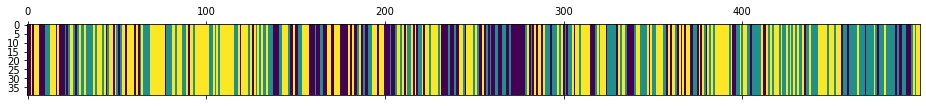

<Figure size 432x288 with 0 Axes>

N [[50. 34. 46.]
 [44. 69. 58.]
 [36. 68. 94.]]
alphas [[1.35591882 1.11071688 1.29466465]
 [0.51349149 1.9531442  1.29466465]
 [0.51349149 1.11071688 2.13709198]]
M [[ 4.  1.  6.]
 [ 3. 11. 11.]
 [ 3.  5.  8.]]
sum_w [[2.]
 [4.]
 [3.]]
barM [[ 2.  1.  6.]
 [ 3.  7. 11.]
 [ 3.  5.  5.]]
pi_z [[0.38277891 0.28505161 0.33216948]
 [0.2147402  0.42392434 0.36133546]
 [0.16162331 0.27365552 0.56472117]]
beta_vec [0.11977119 0.30293741 0.5772914 ]
hyper>> a_k: 3.373819506207255  gamma: 0.6186079080045392  rho: 0.17472485192617415


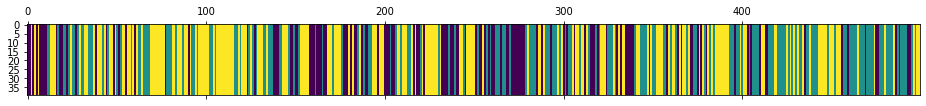

<Figure size 432x288 with 0 Axes>

N [[47. 39. 42.]
 [50. 75. 54.]
 [31. 65. 96.]]
alphas [[0.92297257 0.84347752 1.60736941]
 [0.33348245 1.43296764 1.60736941]
 [0.33348245 0.84347752 2.19685953]]
M [[ 6.  4.  4.]
 [ 2.  5.  5.]
 [ 1.  7. 10.]]
sum_w [[3.]
 [2.]
 [2.]]
barM [[3. 4. 4.]
 [2. 3. 5.]
 [1. 7. 8.]]
pi_z [[0.37867208 0.36130484 0.26002309]
 [0.28726643 0.42081908 0.29191449]
 [0.17529442 0.35045821 0.47424737]]
beta_vec [0.23946195 0.35814464 0.40239341]
hyper>> a_k: 3.511944867290927  gamma: 0.6268656388254624  rho: 0.19002641295078454


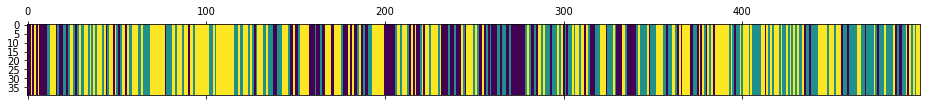

<Figure size 432x288 with 0 Axes>

N [[ 51.  38.  35.]
 [ 45.  64.  64.]
 [ 28.  71. 103.]]
alphas [[1.34853159 1.018772   1.14464128]
 [0.6811693  1.68613429 1.14464128]
 [0.6811693  1.018772   1.81200356]]
M [[9. 3. 6.]
 [4. 7. 4.]
 [5. 5. 7.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[5. 3. 6.]
 [4. 6. 4.]
 [5. 5. 5.]]
pi_z [[0.43897796 0.31369841 0.24732362]
 [0.3198017  0.35474516 0.32545314]
 [0.14080036 0.27870627 0.58049338]]
beta_vec [0.33975524 0.35389363 0.30635113]
hyper>> a_k: 3.636856954082408  gamma: 0.22991895260527162  rho: 0.1269341088394113


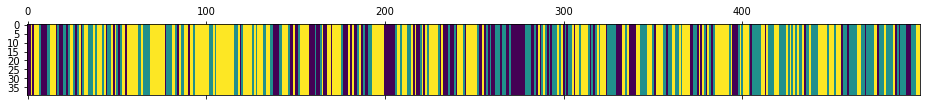

<Figure size 432x288 with 0 Axes>

N [[ 46.  39.  36.]
 [ 49.  70.  53.]
 [ 26.  63. 117.]]
alphas [[1.54043737 1.12368864 0.97273094]
 [1.07879618 1.58532984 0.97273094]
 [1.07879618 1.12368864 1.43437214]]
M [[ 5.  6.  4.]
 [ 7.  7. 10.]
 [ 2.  5.  5.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[ 3.  6.  4.]
 [ 7.  6. 10.]
 [ 2.  5.  2.]]
pi_z [[0.42390746 0.26840224 0.30769031]
 [0.27863626 0.43055042 0.29081331]
 [0.13690674 0.33008434 0.53300892]]
beta_vec [0.30297513 0.42815881 0.26886606]
hyper>> a_k: 4.6656907782689485  gamma: 0.6045195098678802  rho: 0.18925745750960166


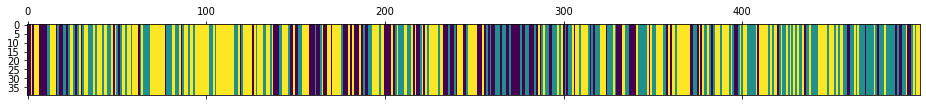

<Figure size 432x288 with 0 Axes>

In [877]:
pre_data = 500# np.log(1+d_.pct_change()).dropna().values.T.shape[1]
Y_full = np.log(1+d_.pct_change()).dropna().values.T
Y = Y_full[:,:pre_data]
d,T = Y.shape

rho = 0.3 # auto-transition probability
gamma = 1
num_z = 3
Sigma_z = np.zeros((d,d,num_z))
mu_z = np.zeros((d,num_z))
alpha0_p_kappa0=5

Z=np.random.randint(0,num_z,T)
pi_z = rho*np.eye(num_z) + (1-rho)*(1-np.eye(num_z))
beta_vec = (1/num_z)*np.ones(num_z);

for i in range(150):
    pi_z,pi_init,beta_vec,N,M,sum_w,barM = Sample_Transition(Z,beta_vec,num_z,rho,gamma,alpha0_p_kappa0)
    alpha0_p_kappa0,gamma, rho = sample_hyperparameters(N,M,sum_w,barM,alpha0_p_kappa0,gamma,rho)
    # todo : use pi_init
    for z in range(num_z):
        mu_z[:,z], Sigma_z[:,:,z] = SampleMultivariateGaussian(Y,Z==z,mu_z[:,z],Sigma_z[:,:,z])
    pZ = likelihood(Y,Z,mu_z,Sigma_z,num_z)
    Z = Sample_Z(pZ,mu_z,Sigma_z,pi_z)
    plt.matshow(np.vstack([Z for i in range(40)]))
    plt.figure()
    plt.show()

501
N [[29. 25. 21.]
 [31. 48. 38.]
 [15. 44. 48.]]
alphas [[2.02907292 1.6195852  1.01703266]
 [1.14605614 2.50260197 1.01703266]
 [1.14605614 1.6195852  1.90004944]]
M [[3. 4. 4.]
 [4. 8. 5.]
 [4. 6. 7.]]
sum_w [[1.]
 [4.]
 [3.]]
barM [[2. 4. 4.]
 [4. 4. 5.]
 [4. 6. 4.]]
pi_z [[0.30583976 0.34114114 0.35301909]
 [0.19920446 0.46829368 0.33250185]
 [0.14366917 0.51195612 0.34437471]]
beta_vec [0.24647377 0.38575189 0.36777434]
hyper>> a_k: 3.5733286662742563  gamma: 1.2679875133094698  rho: 0.11444469066440466


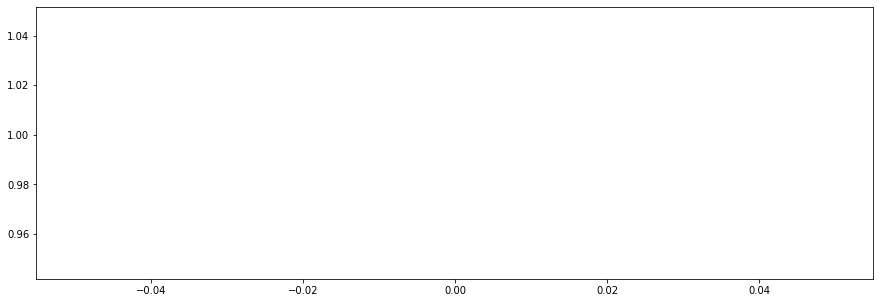

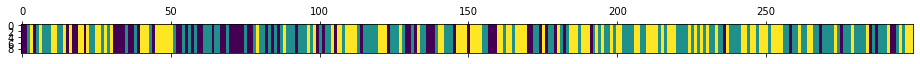

<Figure size 432x288 with 0 Axes>

N [[21. 30. 15.]
 [32. 52. 43.]
 [13. 45. 48.]]
alphas [[1.18888521 1.22066564 1.16377782]
 [0.77993671 1.62961413 1.16377782]
 [0.77993671 1.22066564 1.57272631]]
M [[5. 3. 3.]
 [3. 4. 5.]
 [3. 4. 5.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[4. 3. 3.]
 [3. 3. 5.]
 [3. 4. 4.]]
pi_z [[0.32964202 0.40406188 0.26629609]
 [0.31018904 0.36083213 0.32897883]
 [0.09690942 0.57176456 0.33132602]]
beta_vec [0.2553909  0.33510013 0.40950896]
hyper>> a_k: 2.6335399374095196  gamma: 0.3769864913201616  rho: 0.08901302607542612


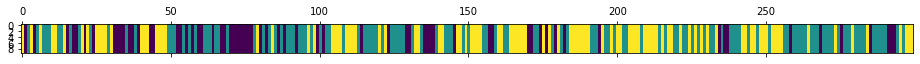

<Figure size 432x288 with 0 Axes>

502
N [[25. 30. 13.]
 [34. 55. 39.]
 [ 9. 43. 51.]]
alphas [[0.84713293 0.80394562 0.98246138]
 [0.61271357 1.03836498 0.98246138]
 [0.61271357 0.80394562 1.21688074]]
M [[6. 3. 2.]
 [4. 3. 4.]
 [4. 3. 4.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[4. 3. 2.]
 [4. 3. 4.]
 [4. 3. 2.]]
pi_z [[0.35280052 0.49523039 0.1519691 ]
 [0.18939057 0.49911883 0.31149061]
 [0.1480004  0.36706135 0.48493825]]
beta_vec [0.37913735 0.24540402 0.37545862]
hyper>> a_k: 2.528113476813423  gamma: 0.5775281289761169  rho: 0.05415534144307589


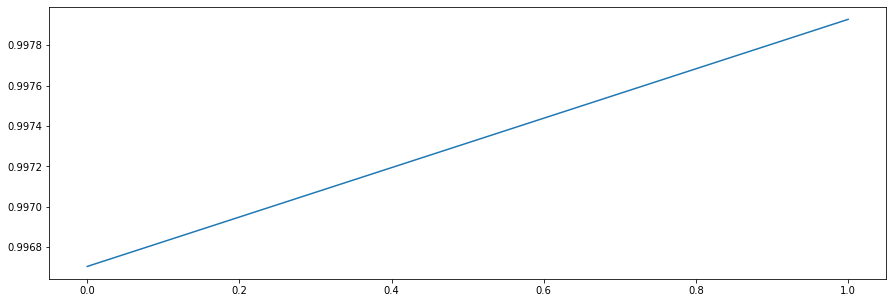

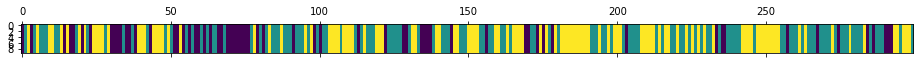

<Figure size 432x288 with 0 Axes>

N [[23. 29. 13.]
 [31. 53. 40.]
 [11. 43. 56.]]
alphas [[1.04350509 0.58681075 0.89779765]
 [0.90659424 0.72372159 0.89779765]
 [0.90659424 0.58681075 1.03470849]]
M [[4. 4. 7.]
 [2. 3. 1.]
 [4. 2. 5.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[4. 4. 7.]
 [2. 3. 1.]
 [4. 2. 5.]]
pi_z [[0.34443608 0.46521403 0.19034989]
 [0.35957361 0.33442918 0.30599721]
 [0.10066048 0.4050459  0.49429361]]
beta_vec [0.24147663 0.34545093 0.41307244]
hyper>> a_k: 3.1732161740891818  gamma: 0.659499006963836  rho: 0.07787329773735081


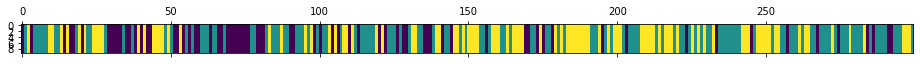

<Figure size 432x288 with 0 Axes>

503
N [[25. 27. 20.]
 [35. 60. 34.]
 [12. 42. 44.]]
alphas [[0.95369535 1.01082652 1.2086943 ]
 [0.70658654 1.25793533 1.2086943 ]
 [0.70658654 1.01082652 1.45580311]]
M [[4. 2. 3.]
 [3. 5. 3.]
 [3. 3. 3.]]
sum_w [[2.]
 [2.]
 [0.]]
barM [[2. 2. 3.]
 [3. 3. 3.]
 [3. 3. 3.]]
pi_z [[0.36116439 0.34958297 0.28925264]
 [0.34056427 0.44189278 0.21754295]
 [0.12015383 0.5051063  0.37473988]]
beta_vec [0.35774128 0.21859719 0.42366153]
hyper>> a_k: 2.035077818602245  gamma: 0.33600698351284086  rho: 0.20015830751011598


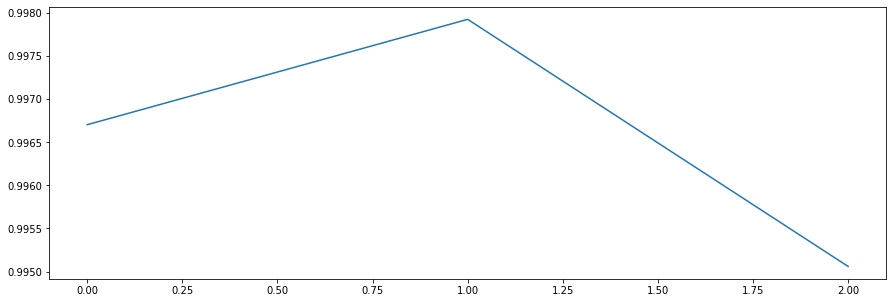

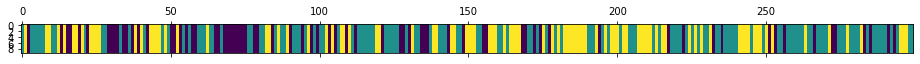

<Figure size 432x288 with 0 Axes>

N [[22. 30. 21.]
 [34. 64. 32.]
 [17. 36. 43.]]
alphas [[0.98964755 0.35581941 0.68961085]
 [0.58230982 0.76315714 0.68961085]
 [0.58230982 0.35581941 1.09694859]]
M [[2. 3. 3.]
 [1. 3. 4.]
 [4. 1. 4.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[2. 3. 3.]
 [1. 2. 4.]
 [4. 1. 2.]]
pi_z [[0.27604033 0.36549493 0.35846474]
 [0.26129105 0.52520523 0.21350372]
 [0.14763706 0.45090481 0.40145812]]
beta_vec [0.30241124 0.25917567 0.43841309]
hyper>> a_k: 2.5220655874731652  gamma: 0.20476943318182073  rho: 0.15866157783627519


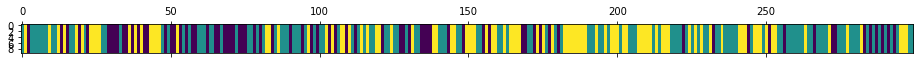

<Figure size 432x288 with 0 Axes>

504
N [[19. 34. 22.]
 [36. 57. 34.]
 [20. 36. 41.]]
alphas [[1.04184454 0.54994762 0.93027343]
 [0.64168963 0.95010253 0.93027343]
 [0.64168963 0.54994762 1.33042833]]
M [[2. 4. 2.]
 [8. 3. 6.]
 [3. 2. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[1. 4. 2.]
 [8. 2. 6.]
 [3. 2. 2.]]
pi_z [[0.25572855 0.48383717 0.26043428]
 [0.26498043 0.47940376 0.2556158 ]
 [0.21628014 0.42198013 0.36173973]]
beta_vec [0.40347882 0.34513914 0.25138205]
hyper>> a_k: 2.6668838737420537  gamma: 0.5624330662326391  rho: 0.19334058260835835


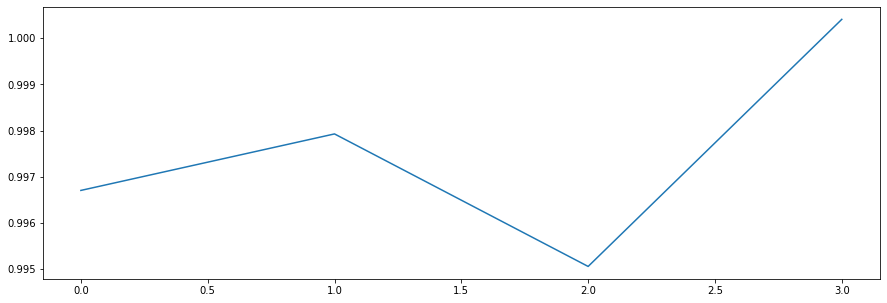

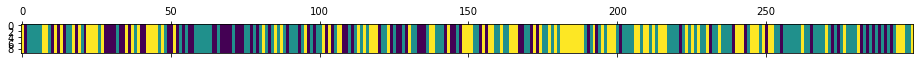

<Figure size 432x288 with 0 Axes>

N [[19. 36. 23.]
 [41. 48. 36.]
 [18. 40. 38.]]
alphas [[1.38360754 0.74248644 0.5407899 ]
 [0.86799066 1.25810332 0.5407899 ]
 [0.86799066 0.74248644 1.05640678]]
M [[6. 6. 3.]
 [5. 6. 4.]
 [4. 5. 4.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[4. 6. 3.]
 [5. 3. 4.]
 [4. 5. 3.]]
pi_z [[0.27676718 0.41244302 0.3107898 ]
 [0.35469718 0.40243987 0.24286295]
 [0.11405934 0.38802597 0.49791469]]
beta_vec [0.36381952 0.40857914 0.22760135]
hyper>> a_k: 3.8841297895517655  gamma: 0.5076282413621263  rho: 0.20322595930355938


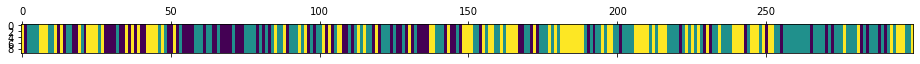

<Figure size 432x288 with 0 Axes>

505
N [[23. 35. 22.]
 [39. 57. 31.]
 [18. 35. 39.]]
alphas [[1.9152951  1.26446001 0.70437468]
 [1.1259391  2.05381601 0.70437468]
 [1.1259391  1.26446001 1.49373068]]
M [[5. 3. 2.]
 [6. 6. 3.]
 [5. 4. 4.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[4. 3. 2.]
 [6. 3. 3.]
 [5. 4. 0.]]
pi_z [[0.26643914 0.54888883 0.18467203]
 [0.33573514 0.44708146 0.2171834 ]
 [0.21376368 0.43109249 0.35514382]]
beta_vec [0.44838515 0.46234876 0.08926609]
hyper>> a_k: 3.2109670981828233  gamma: 0.8914373062616259  rho: 0.2827218552002105


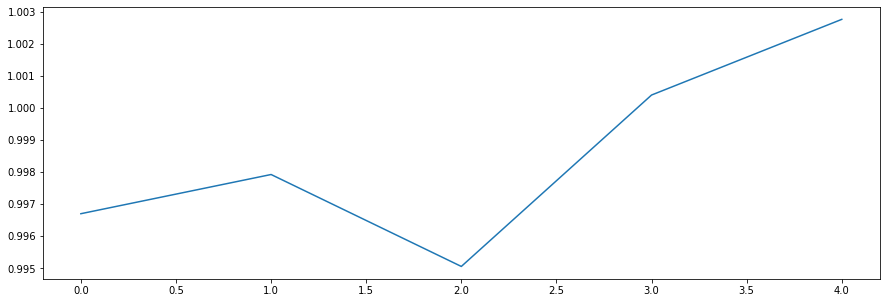

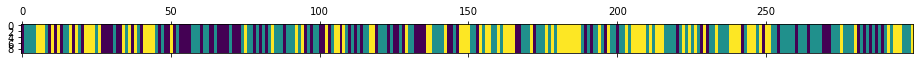

<Figure size 432x288 with 0 Axes>

N [[23. 40. 18.]
 [41. 53. 34.]
 [17. 34. 39.]]
alphas [[1.94051176 1.06486156 0.20559378]
 [1.03270119 1.97267213 0.20559378]
 [1.03270119 1.06486156 1.11340436]]
M [[4. 2. 1.]
 [5. 8. 3.]
 [3. 7. 5.]]
sum_w [[2.]
 [2.]
 [4.]]
barM [[2. 2. 1.]
 [5. 6. 3.]
 [3. 7. 1.]]
pi_z [[0.30863067 0.45717957 0.23418975]
 [0.28751896 0.42837055 0.28411049]
 [0.20222725 0.45370765 0.34406509]]
beta_vec [0.29089148 0.37862733 0.33048119]
hyper>> a_k: 3.7469004080649326  gamma: 0.8487203089390986  rho: 0.17095464624511275


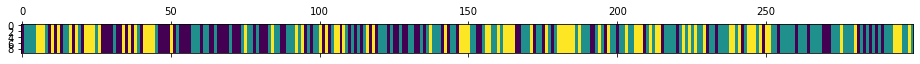

<Figure size 432x288 with 0 Axes>

506
N [[27. 40. 22.]
 [45. 55. 29.]
 [17. 34. 30.]]
alphas [[1.5441609  1.17614914 1.02659037]
 [0.90361087 1.81669917 1.02659037]
 [0.90361087 1.17614914 1.6671404 ]]
M [[2. 7. 5.]
 [9. 6. 3.]
 [5. 5. 5.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[2. 7. 5.]
 [9. 4. 3.]
 [5. 5. 4.]]
pi_z [[0.40964023 0.38528504 0.20507473]
 [0.34574328 0.38670299 0.26755373]
 [0.23406734 0.40509868 0.36083398]]
beta_vec [0.35703893 0.39876533 0.24419575]
hyper>> a_k: 5.094600647554308  gamma: 1.2173447948257419  rho: 0.2582621777612719


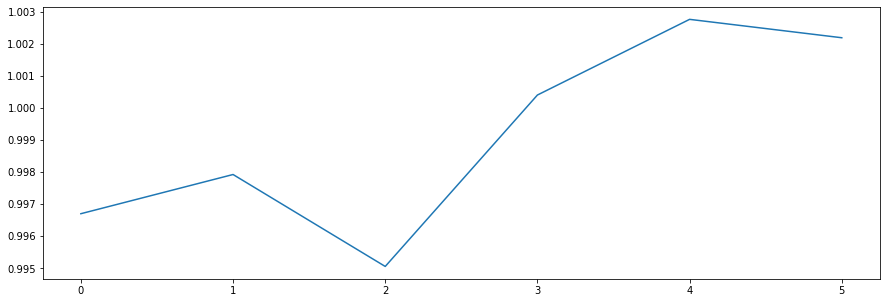

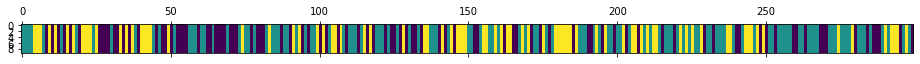

<Figure size 432x288 with 0 Axes>

N [[27. 41. 27.]
 [45. 47. 29.]
 [24. 32. 27.]]
alphas [[2.66494206 1.50687755 0.92278104]
 [1.3491994  2.82262021 0.92278104]
 [1.3491994  1.50687755 2.2385237 ]]
M [[ 6.  7.  4.]
 [ 5. 11.  3.]
 [ 5.  6.  3.]]
sum_w [[2.]
 [6.]
 [1.]]
barM [[4. 7. 4.]
 [5. 5. 3.]
 [5. 6. 2.]]
pi_z [[0.34045384 0.44831134 0.21123482]
 [0.38826637 0.37959804 0.23213559]
 [0.23734314 0.43094272 0.33171414]]
beta_vec [0.38881187 0.44436942 0.16681871]
hyper>> a_k: 4.1252540153670445  gamma: 0.8986437100616546  rho: 0.20510879029981174


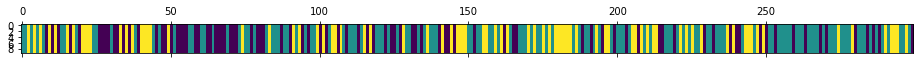

<Figure size 432x288 with 0 Axes>

507
N [[23. 43. 23.]
 [43. 51. 35.]
 [22. 36. 23.]]
alphas [[2.12108981 1.45714427 0.54701993]
 [1.27496395 2.30327013 0.54701993]
 [1.27496395 1.45714427 1.3931458 ]]
M [[ 5.  4.  3.]
 [ 6. 11.  4.]
 [ 6.  4.  3.]]
sum_w [[0.]
 [3.]
 [3.]]
barM [[5. 4. 3.]
 [6. 8. 4.]
 [6. 4. 0.]]
pi_z [[0.30656867 0.48034134 0.21308999]
 [0.31814994 0.41444917 0.26740089]
 [0.2708345  0.45581283 0.27335267]]
beta_vec [0.39189601 0.34993217 0.25817182]
hyper>> a_k: 3.9561642981124914  gamma: 0.6400447717158083  rho: 0.27487265527988347


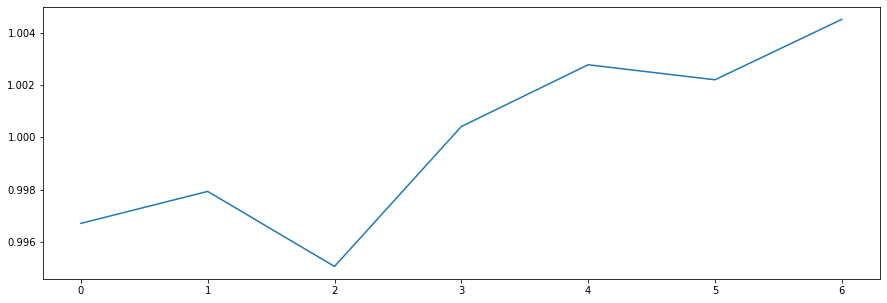

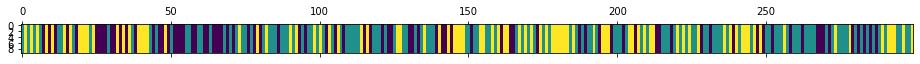

<Figure size 432x288 with 0 Axes>

N [[20. 41. 23.]
 [42. 44. 41.]
 [22. 41. 25.]]
alphas [[2.21168245 1.00385845 0.7406234 ]
 [1.12424106 2.09129983 0.7406234 ]
 [1.12424106 1.00385845 1.82806479]]
M [[5. 4. 3.]
 [4. 5. 3.]
 [3. 1. 8.]]
sum_w [[5.]
 [2.]
 [4.]]
barM [[0. 4. 3.]
 [4. 3. 3.]
 [3. 1. 4.]]
pi_z [[0.33090522 0.46677265 0.20232213]
 [0.35671855 0.29654573 0.34673572]
 [0.18336149 0.46209411 0.35454441]]
beta_vec [0.35998483 0.20762914 0.43238603]
hyper>> a_k: 2.2370255594163684  gamma: 0.5907837675297883  rho: 0.5094013682834722


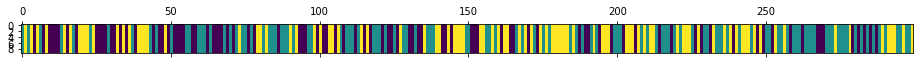

<Figure size 432x288 with 0 Axes>

508
N [[28. 40. 25.]
 [35. 39. 38.]
 [30. 33. 31.]]
alphas [[1.53462064 0.22786918 0.47453574]
 [0.39507676 1.36741306 0.47453574]
 [0.39507676 0.22786918 1.61407962]]
M [[8. 2. 1.]
 [2. 6. 3.]
 [2. 4. 5.]]
sum_w [[6.]
 [5.]
 [3.]]
barM [[2. 2. 1.]
 [2. 1. 3.]
 [2. 4. 2.]]
pi_z [[0.25810948 0.33274046 0.40915006]
 [0.31414582 0.32696515 0.35888903]
 [0.40062172 0.27741003 0.32196825]]
beta_vec [0.38854728 0.32948373 0.28196898]
hyper>> a_k: 2.5475643564785293  gamma: 1.2952433656251725  rho: 0.38818261345006827


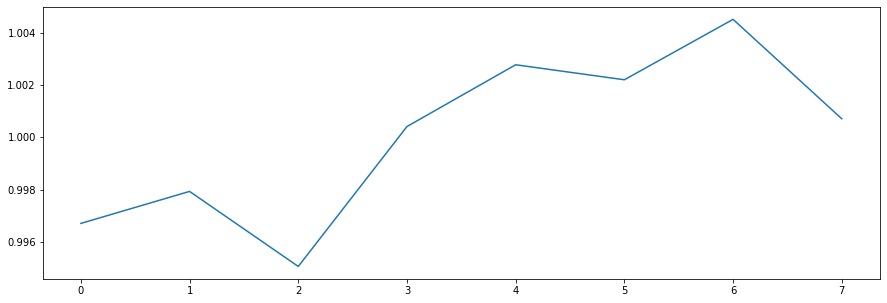

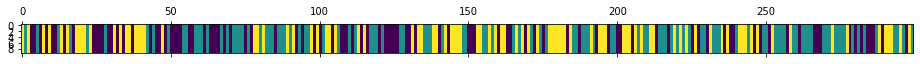

<Figure size 432x288 with 0 Axes>

N [[30. 37. 32.]
 [37. 42. 29.]
 [32. 30. 30.]]
alphas [[1.59452715 0.5135479  0.43948931]
 [0.60560696 1.50246809 0.43948931]
 [0.60560696 0.5135479  1.4284095 ]]
M [[5. 3. 1.]
 [1. 3. 2.]
 [4. 1. 2.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[1. 3. 1.]
 [1. 1. 2.]
 [4. 1. 0.]]
pi_z [[0.27898626 0.2985143  0.42249945]
 [0.35984623 0.40718185 0.23297192]
 [0.33150022 0.26613257 0.4023672 ]]
beta_vec [0.22569616 0.47752475 0.29677909]
hyper>> a_k: 1.7392688719983045  gamma: 0.16472949428586256  rho: 0.49414974594103833


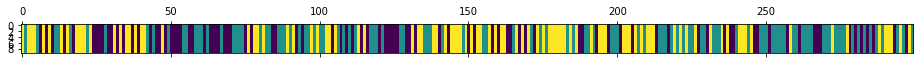

<Figure size 432x288 with 0 Axes>

509
N [[26. 33. 34.]
 [36. 43. 31.]
 [31. 34. 31.]]
alphas [[1.05802892 0.42013086 0.26110909]
 [0.19856965 1.27959013 0.26110909]
 [0.19856965 0.42013086 1.12056836]]
M [[3. 2. 2.]
 [2. 6. 1.]
 [2. 5. 4.]]
sum_w [[2.]
 [6.]
 [4.]]
barM [[1. 2. 2.]
 [2. 0. 1.]
 [2. 5. 0.]]
pi_z [[0.38664281 0.28082747 0.33252971]
 [0.41282517 0.34229843 0.2448764 ]
 [0.35242156 0.30281523 0.34476322]]
beta_vec [0.18538009 0.51605606 0.29856386]
hyper>> a_k: 2.510067257826218  gamma: 1.0685227937308373  rho: 0.37874622044676826


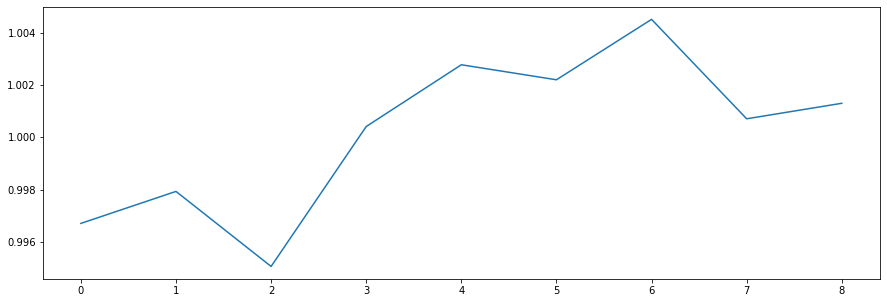

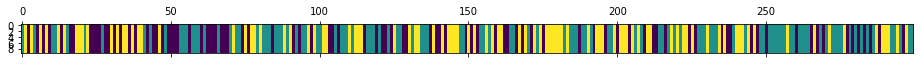

<Figure size 432x288 with 0 Axes>

N [[21. 35. 36.]
 [35. 46. 31.]
 [36. 31. 28.]]
alphas [[1.23975812 0.80473202 0.46557712]
 [0.28907963 1.7554105  0.46557712]
 [0.28907963 0.80473202 1.41625561]]
M [[6. 2. 3.]
 [4. 8. 5.]
 [3. 3. 3.]]
sum_w [[4.]
 [6.]
 [2.]]
barM [[2. 2. 3.]
 [4. 2. 5.]
 [3. 3. 1.]]
pi_z [[0.1980617  0.41496293 0.38697537]
 [0.34530579 0.39660105 0.25809315]
 [0.39529309 0.35344072 0.25126619]]
beta_vec [0.23495158 0.42582982 0.3392186 ]
hyper>> a_k: 3.0865871479497082  gamma: 0.6693483818212389  rho: 0.21170772352952713


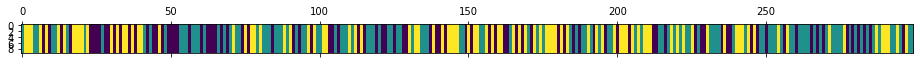

<Figure size 432x288 with 0 Axes>

510
N [[19. 38. 34.]
 [38. 42. 34.]
 [34. 34. 26.]]
alphas [[1.22512274 1.03610049 0.82536391]
 [0.5716684  1.68955483 0.82536391]
 [0.5716684  1.03610049 1.47881825]]
M [[3. 2. 2.]
 [3. 5. 3.]
 [4. 5. 6.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[1. 2. 2.]
 [3. 2. 3.]
 [4. 5. 3.]]
pi_z [[0.21928152 0.44618435 0.33453412]
 [0.29009277 0.41976151 0.29014572]
 [0.29225403 0.45206974 0.25567623]]
beta_vec [0.3648438  0.49570212 0.13945408]
hyper>> a_k: 3.261651890801921  gamma: 0.6700917750552997  rho: 0.16150997968915942


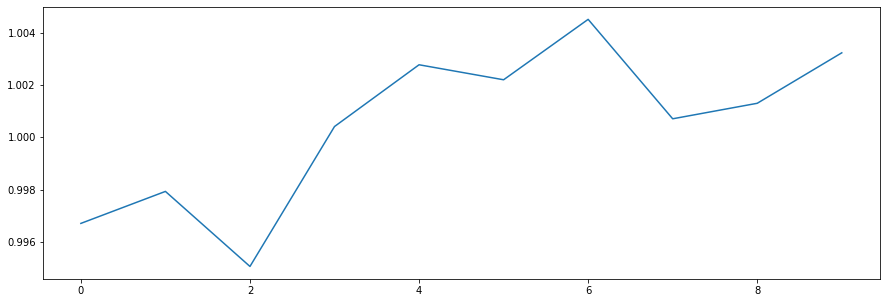

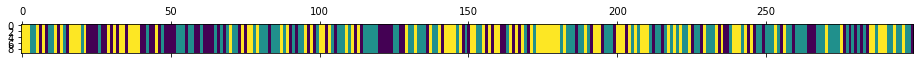

<Figure size 432x288 with 0 Axes>

N [[22. 32. 31.]
 [33. 48. 34.]
 [31. 34. 34.]]
alphas [[1.52458698 1.35567716 0.38138774]
 [0.99779765 1.88246649 0.38138774]
 [0.99779765 1.35567716 0.90817707]]
M [[4. 4. 2.]
 [2. 5. 2.]
 [5. 5. 4.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[3. 4. 2.]
 [2. 2. 2.]
 [5. 5. 1.]]
pi_z [[0.27873746 0.35872669 0.36253585]
 [0.37022567 0.31859415 0.31118018]
 [0.36990477 0.29542957 0.33466566]]
beta_vec [0.30280858 0.63329962 0.0638918 ]
hyper>> a_k: 2.8722402222829047  gamma: 0.18846252050739443  rho: 0.20581467576317536


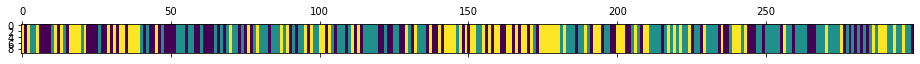

<Figure size 432x288 with 0 Axes>

511
N [[28. 38. 29.]
 [35. 50. 30.]
 [32. 27. 30.]]
alphas [[1.28188313 1.44461409 0.145743  ]
 [0.69073394 2.03576328 0.145743  ]
 [0.69073394 1.44461409 0.73689219]]
M [[ 3.  6.  2.]
 [ 3. 10.  2.]
 [ 1.  4.  4.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[2. 6. 2.]
 [3. 8. 2.]
 [1. 4. 1.]]
pi_z [[0.37775034 0.36799745 0.25425221]
 [0.29938971 0.4441285  0.25648179]
 [0.35132211 0.32567602 0.32300187]]
beta_vec [0.23841109 0.60319986 0.15838905]
hyper>> a_k: 2.387392635017457  gamma: 1.1488495903042468  rho: 0.33624018457441973


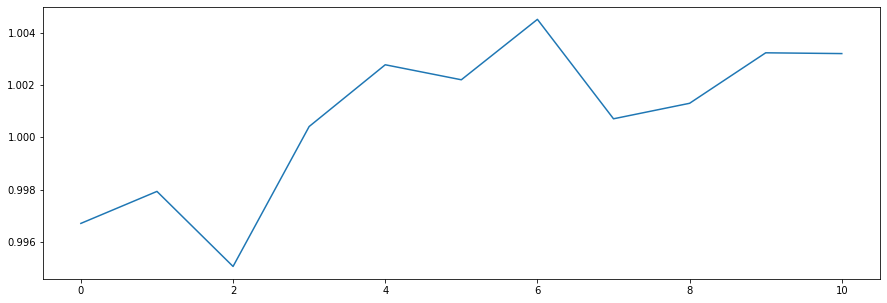

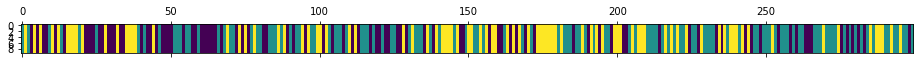

<Figure size 432x288 with 0 Axes>

N [[27. 39. 27.]
 [37. 44. 36.]
 [28. 35. 26.]]
alphas [[1.18053674 0.95586385 0.25099205]
 [0.3777994  1.75860119 0.25099205]
 [0.3777994  0.95586385 1.05372939]]
M [[1. 4. 1.]
 [3. 3. 2.]
 [1. 2. 3.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[0. 4. 1.]
 [3. 3. 2.]
 [1. 2. 0.]]
pi_z [[0.35329649 0.36384289 0.28286061]
 [0.35819303 0.37868293 0.26312404]
 [0.32151984 0.45590991 0.22257024]]
beta_vec [0.36790492 0.47325885 0.15883623]
hyper>> a_k: 1.5172614803390703  gamma: 0.3828766956034982  rho: 0.19427350545512612


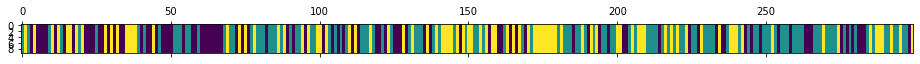

<Figure size 432x288 with 0 Axes>

512
N [[30. 35. 28.]
 [37. 44. 36.]
 [26. 38. 25.]]
alphas [[0.74452665 0.57855789 0.19417693]
 [0.44976295 0.8733216  0.19417693]
 [0.44976295 0.57855789 0.48894064]]
M [[2. 3. 1.]
 [1. 4. 1.]
 [2. 2. 4.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[1. 3. 1.]
 [1. 3. 1.]
 [2. 2. 1.]]
pi_z [[0.3168805  0.43655047 0.24656903]
 [0.41880321 0.33792804 0.24326876]
 [0.33277331 0.37941335 0.28781335]]
beta_vec [0.18264964 0.50904671 0.30830365]
hyper>> a_k: 1.6659435773648592  gamma: 1.830277390595012  rho: 0.38242251786180925


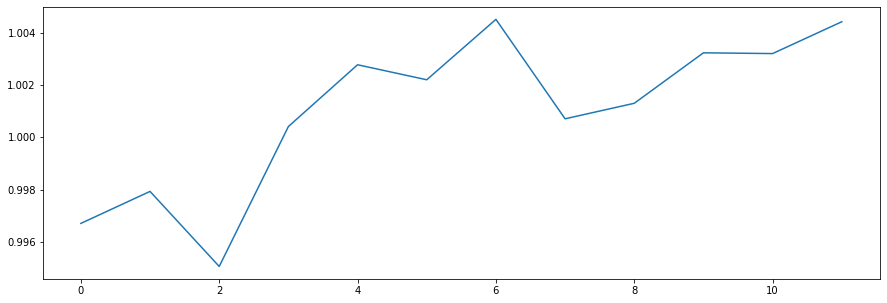

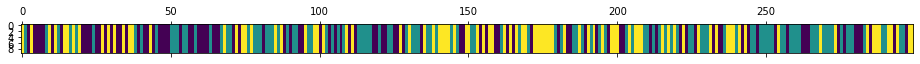

<Figure size 432x288 with 0 Axes>

N [[31. 37. 30.]
 [35. 42. 34.]
 [32. 32. 26.]]
alphas [[0.82501328 0.52373233 0.31719798]
 [0.18791894 1.16082666 0.31719798]
 [0.18791894 0.52373233 0.95429231]]
M [[3. 1. 2.]
 [1. 4. 1.]
 [3. 4. 5.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[0. 1. 2.]
 [1. 1. 1.]
 [3. 4. 1.]]
pi_z [[0.27572608 0.40968254 0.31459139]
 [0.33077237 0.38748568 0.28174195]
 [0.40425389 0.38268861 0.2130575 ]]
beta_vec [0.11295822 0.66499499 0.22204679]
hyper>> a_k: 1.4598367567570798  gamma: 1.3951398288847772  rho: 0.5145439706423768


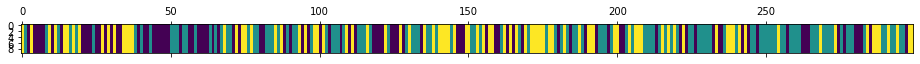

<Figure size 432x288 with 0 Axes>

513
N [[33. 34. 27.]
 [35. 47. 35.]
 [26. 36. 26.]]
alphas [[0.83120217 0.47127301 0.15736158]
 [0.08005197 1.22242321 0.15736158]
 [0.08005197 0.47127301 0.90851178]]
M [[4. 5. 1.]
 [1. 5. 1.]
 [1. 4. 4.]]
sum_w [[4.]
 [4.]
 [3.]]
barM [[0. 5. 1.]
 [1. 1. 1.]
 [1. 4. 1.]]
pi_z [[0.33466154 0.38402962 0.28130885]
 [0.27052502 0.4041126  0.32536238]
 [0.30853886 0.40870291 0.28275822]]
beta_vec [0.21738007 0.64387465 0.13874528]
hyper>> a_k: 2.6688467108489107  gamma: 0.718763565615475  rho: 0.556178790271326


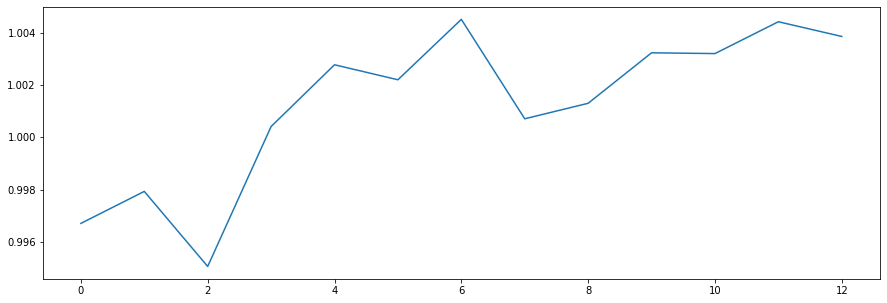

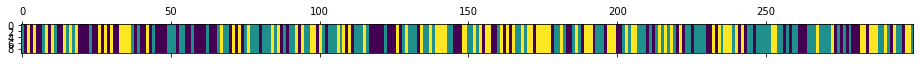

<Figure size 432x288 with 0 Axes>

N [[33. 35. 30.]
 [34. 44. 33.]
 [31. 33. 26.]]
alphas [[1.74184063 0.76266358 0.16434251]
 [0.25748469 2.24701951 0.16434251]
 [0.25748469 0.76266358 1.64869844]]
M [[ 5.  4.  1.]
 [ 3.  7.  1.]
 [ 1.  4. 10.]]
sum_w [[ 3.]
 [ 4.]
 [10.]]
barM [[2. 4. 1.]
 [3. 3. 1.]
 [1. 4. 0.]]
pi_z [[0.31149057 0.37855321 0.30995622]
 [0.3629921  0.3829769  0.254031  ]
 [0.30516039 0.35742914 0.33741047]]
beta_vec [0.38988514 0.57448738 0.03562748]
hyper>> a_k: 3.4880595232599747  gamma: 0.8557515449677348  rho: 0.4906116350791099


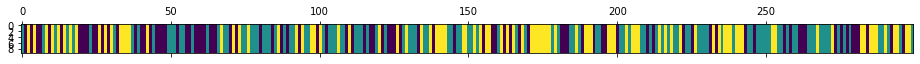

<Figure size 432x288 with 0 Axes>

514
N [[26. 39. 27.]
 [35. 44. 35.]
 [31. 31. 31.]]
alphas [[2.40402151 1.02073593 0.06330208]
 [0.69273892 2.73201851 0.06330208]
 [0.69273892 1.02073593 1.77458467]]
M [[6. 2. 1.]
 [3. 9. 2.]
 [5. 6. 7.]]
sum_w [[6.]
 [7.]
 [7.]]
barM [[0. 2. 1.]
 [3. 2. 2.]
 [5. 6. 0.]]
pi_z [[0.2689266  0.37621994 0.35485345]
 [0.31349408 0.39461701 0.29188892]
 [0.33219148 0.29650296 0.37130556]]
beta_vec [0.24372052 0.59281838 0.1634611 ]
hyper>> a_k: 2.107112234763767  gamma: 0.7732353317444084  rho: 0.42652975872254983


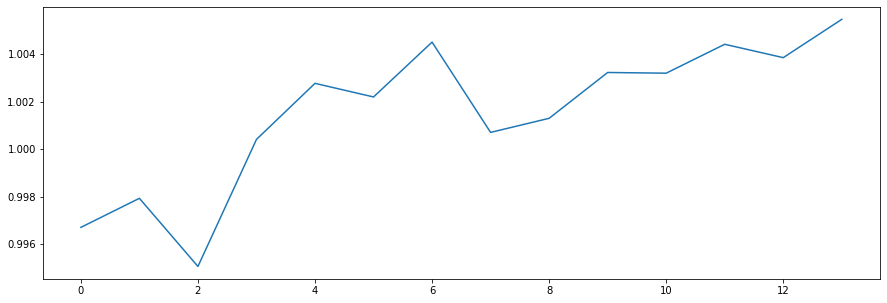

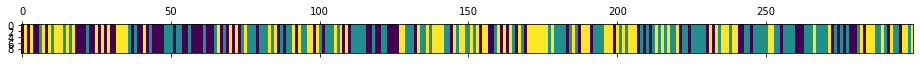

<Figure size 432x288 with 0 Axes>

N [[27. 33. 29.]
 [34. 49. 34.]
 [28. 34. 31.]]
alphas [[1.1932497  0.71634167 0.19752086]
 [0.29450363 1.61508774 0.19752086]
 [0.29450363 0.71634167 1.09626694]]
M [[ 4.  2.  2.]
 [ 3. 10.  1.]
 [ 3.  2.  6.]]
sum_w [[3.]
 [5.]
 [5.]]
barM [[1. 2. 2.]
 [3. 5. 1.]
 [3. 2. 1.]]
pi_z [[0.23461427 0.39198775 0.37339798]
 [0.32401481 0.37141046 0.30457472]
 [0.27550526 0.3459843  0.37851044]]
beta_vec [0.27377373 0.51259284 0.21363342]
hyper>> a_k: 2.2574800883436232  gamma: 0.7065767574104154  rho: 0.3995600771645234


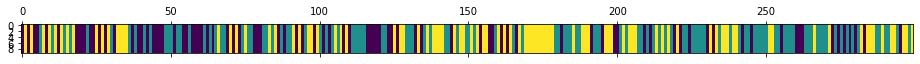

<Figure size 432x288 with 0 Axes>

515
N [[24. 37. 27.]
 [38. 44. 34.]
 [26. 35. 34.]]
alphas [[1.27309406 0.69480995 0.28957608]
 [0.37109514 1.59680886 0.28957608]
 [0.37109514 0.69480995 1.191575  ]]
M [[4. 4. 3.]
 [4. 4. 2.]
 [3. 4. 5.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[0. 4. 3.]
 [4. 3. 2.]
 [3. 4. 3.]]
pi_z [[0.29266414 0.3515464  0.35578946]
 [0.36332377 0.34403171 0.29264451]
 [0.27545881 0.37703139 0.3475098 ]]
beta_vec [0.4984661  0.24157545 0.25995844]
hyper>> a_k: 2.7927031879255946  gamma: 1.1009443134820056  rho: 0.3977018557296733


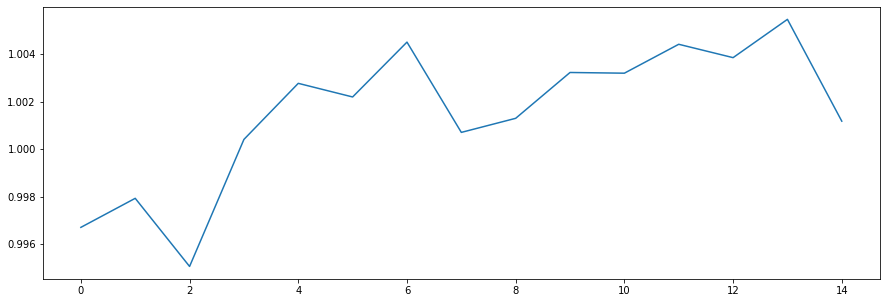

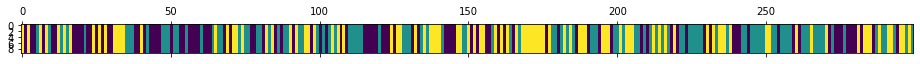

<Figure size 432x288 with 0 Axes>

N [[35. 33. 31.]
 [31. 42. 32.]
 [33. 31. 31.]]
alphas [[1.94910314 0.40633956 0.43726048]
 [0.8384399  1.5170028  0.43726048]
 [0.8384399  0.40633956 1.54792372]]
M [[7. 3. 3.]
 [4. 5. 2.]
 [1. 3. 3.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[3. 3. 3.]
 [4. 3. 2.]
 [1. 3. 1.]]
pi_z [[0.37542931 0.34574163 0.27882906]
 [0.25178    0.48280386 0.26541614]
 [0.31315004 0.33208838 0.35476158]]
beta_vec [0.37228241 0.40915691 0.21856068]
hyper>> a_k: 2.395631184014298  gamma: 0.6489376515945061  rho: 0.2884000973059418


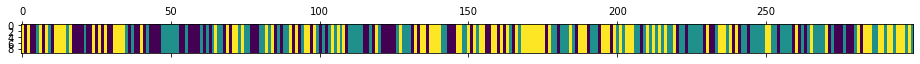

<Figure size 432x288 with 0 Axes>

516
N [[29. 33. 29.]
 [32. 42. 34.]
 [30. 33. 37.]]
alphas [[1.32554161 0.69750243 0.37258715]
 [0.63464134 1.3884027  0.37258715]
 [0.63464134 0.69750243 1.06348741]]
M [[2. 3. 5.]
 [4. 2. 2.]
 [4. 3. 4.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[0. 3. 5.]
 [4. 1. 2.]
 [4. 3. 3.]]
pi_z [[0.35125942 0.29713388 0.3516067 ]
 [0.25097352 0.40798734 0.34103913]
 [0.2834838  0.30047163 0.41604457]]
beta_vec [0.27868292 0.23735805 0.48395903]
hyper>> a_k: 1.8689563459547485  gamma: 0.39270532668038305  rho: 0.17897443139806987


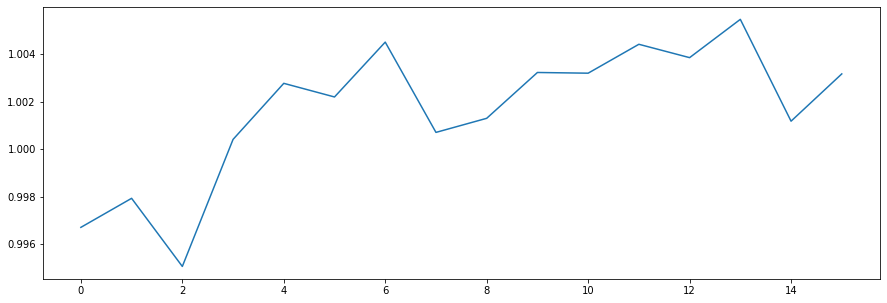

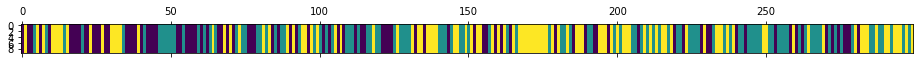

<Figure size 432x288 with 0 Axes>

N [[30. 30. 30.]
 [34. 39. 35.]
 [26. 38. 37.]]
alphas [[0.76212346 0.36421665 0.74261623]
 [0.42762806 0.69871205 0.74261623]
 [0.42762806 0.36421665 1.07711163]]
M [[4. 3. 3.]
 [3. 2. 4.]
 [3. 2. 4.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[4. 3. 3.]
 [3. 0. 4.]
 [3. 2. 3.]]
pi_z [[0.33619489 0.40812025 0.25568486]
 [0.32227559 0.32703809 0.35068632]
 [0.26857784 0.31817577 0.41324638]]
beta_vec [0.38443019 0.163399   0.45217082]
hyper>> a_k: 1.800514529361932  gamma: 1.1025159809876117  rho: 0.2224862239000575


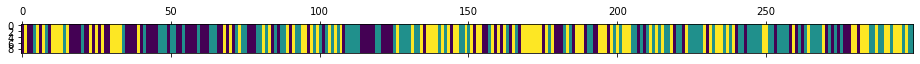

<Figure size 432x288 with 0 Axes>

517
N [[34. 28. 29.]
 [30. 42. 37.]
 [27. 39. 33.]]
alphas [[0.93876305 0.22874631 0.63300516]
 [0.53817337 0.62933599 0.63300516]
 [0.53817337 0.22874631 1.03359484]]
M [[3. 1. 3.]
 [3. 4. 2.]
 [3. 1. 4.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[2. 1. 3.]
 [3. 4. 2.]
 [3. 1. 2.]]
pi_z [[0.41248165 0.28357575 0.3039426 ]
 [0.24728833 0.38729874 0.36541293]
 [0.31348681 0.36872842 0.31778477]]
beta_vec [0.34375142 0.28291382 0.37333476]
hyper>> a_k: 1.8552945766275075  gamma: 0.1771524225659237  rho: 0.11348645189154044


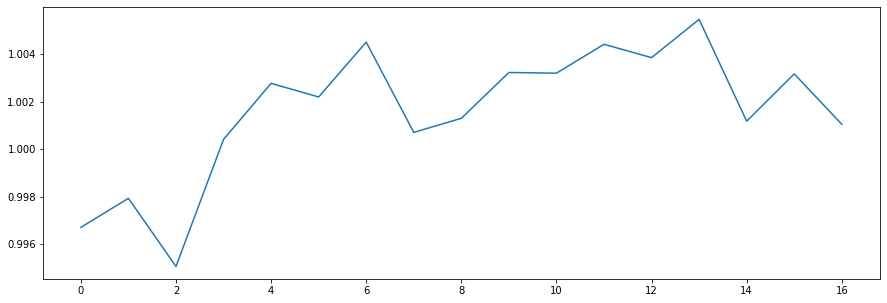

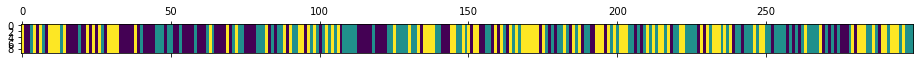

<Figure size 432x288 with 0 Axes>

N [[37. 33. 24.]
 [33. 39. 39.]
 [24. 39. 31.]]
alphas [[0.77593381 0.46532075 0.61404002]
 [0.56538301 0.67587155 0.61404002]
 [0.56538301 0.46532075 0.82459082]]
M [[5. 3. 2.]
 [4. 2. 2.]
 [6. 2. 4.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[3. 3. 2.]
 [4. 1. 2.]
 [6. 2. 2.]]
pi_z [[0.4324898  0.35853853 0.20897167]
 [0.21414819 0.45361792 0.33223389]
 [0.25910025 0.42637262 0.31452713]]
beta_vec [0.72149415 0.10333804 0.17516782]
hyper>> a_k: 2.1375007557677006  gamma: 0.7210250334521202  rho: 0.13392232919853897


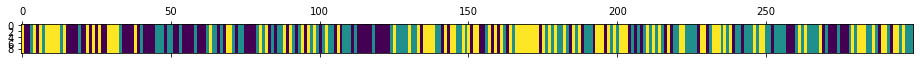

<Figure size 432x288 with 0 Axes>

518
N [[36. 34. 24.]
 [33. 35. 40.]
 [25. 39. 33.]]
alphas [[1.62191911 0.19130368 0.32427796]
 [1.33566003 0.47756276 0.32427796]
 [1.33566003 0.19130368 0.61053704]]
M [[9. 2. 3.]
 [4. 5. 3.]
 [2. 2. 5.]]
sum_w [[1.]
 [4.]
 [3.]]
barM [[8. 2. 3.]
 [4. 1. 3.]
 [2. 2. 2.]]
pi_z [[0.40297812 0.30866248 0.2883594 ]
 [0.27578078 0.37462103 0.34959819]
 [0.26541505 0.42075544 0.3138295 ]]
beta_vec [0.55580611 0.26993288 0.17426101]
hyper>> a_k: 3.4065144920151833  gamma: 1.2491758204648946  rho: 0.35052103811361807


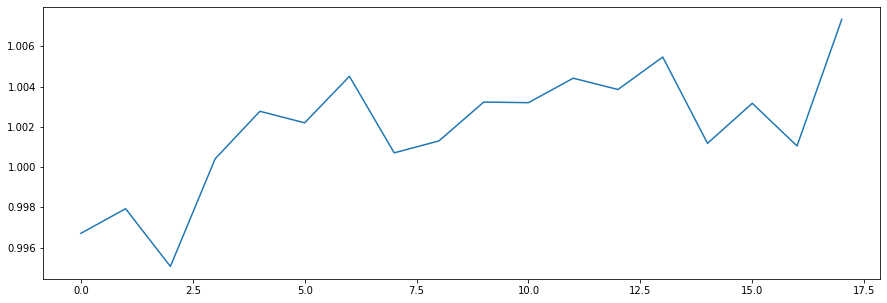

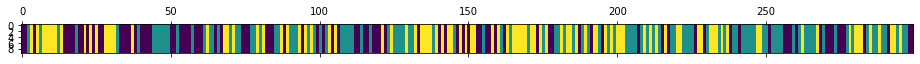

<Figure size 432x288 with 0 Axes>

N [[36. 30. 27.]
 [31. 42. 38.]
 [26. 39. 30.]]
alphas [[2.42375349 0.59721557 0.38554543]
 [1.2296985  1.79127056 0.38554543]
 [1.2296985  0.59721557 1.57960043]]
M [[7. 4. 2.]
 [2. 7. 4.]
 [3. 3. 6.]]
sum_w [[4.]
 [3.]
 [5.]]
barM [[3. 4. 2.]
 [2. 4. 4.]
 [3. 3. 1.]]
pi_z [[0.42259311 0.28262098 0.29478591]
 [0.21951412 0.4285884  0.35189749]
 [0.33310298 0.38280006 0.28409695]]
beta_vec [0.17939901 0.50040814 0.32019285]
hyper>> a_k: 3.5482261358910465  gamma: 1.0619714768694408  rho: 0.357444290260532


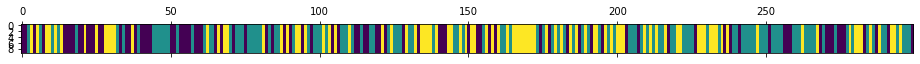

<Figure size 432x288 with 0 Axes>

519
N [[30. 31. 27.]
 [33. 48. 37.]
 [25. 39. 29.]]
alphas [[1.67731089 1.14089701 0.73001824]
 [0.40901772 2.40919018 0.73001824]
 [0.40901772 1.14089701 1.99831141]]
M [[5. 6. 3.]
 [3. 8. 3.]
 [4. 3. 4.]]
sum_w [[4.]
 [5.]
 [3.]]
barM [[1. 6. 3.]
 [3. 3. 3.]
 [4. 3. 1.]]
pi_z [[0.33435498 0.36581803 0.29982699]
 [0.25161601 0.49652004 0.25186395]
 [0.32814344 0.35220236 0.3196542 ]]
beta_vec [0.21357081 0.55793778 0.22849141]
hyper>> a_k: 3.1995995532707466  gamma: 0.21712726056522905  rho: 0.3820467501434605


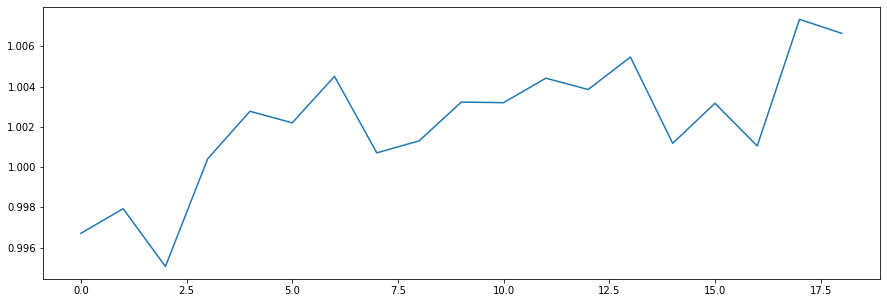

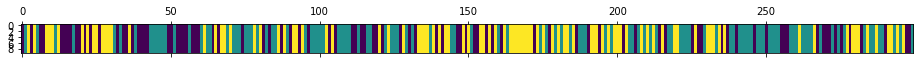

<Figure size 432x288 with 0 Axes>

N [[26. 36. 30.]
 [31. 47. 34.]
 [34. 30. 31.]]
alphas [[1.64466944 1.10315623 0.45177388]
 [0.42227283 2.32555284 0.45177388]
 [0.42227283 1.10315623 1.67417049]]
M [[4. 4. 2.]
 [2. 9. 3.]
 [1. 3. 6.]]
sum_w [[4.]
 [6.]
 [5.]]
barM [[0. 4. 2.]
 [2. 3. 3.]
 [1. 3. 1.]]
pi_z [[0.28991824 0.35191421 0.35816755]
 [0.28523593 0.37455483 0.34020924]
 [0.40704766 0.23573848 0.35721386]]
beta_vec [0.21673784 0.51987236 0.2633898 ]
hyper>> a_k: 3.2527502978389795  gamma: 0.7021548027221757  rho: 0.39545486912518224


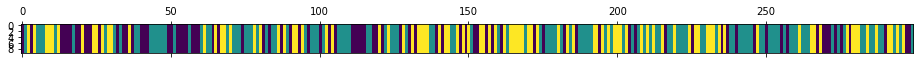

<Figure size 432x288 with 0 Axes>

520
N [[24. 31. 30.]
 [29. 55. 37.]
 [32. 35. 26.]]
alphas [[1.71251668 1.02229487 0.51793874]
 [0.42620074 2.30861082 0.51793874]
 [0.42620074 1.02229487 1.80425469]]
M [[4. 4. 3.]
 [3. 9. 3.]
 [4. 4. 4.]]
sum_w [[3.]
 [6.]
 [2.]]
barM [[1. 4. 3.]
 [3. 3. 3.]
 [4. 4. 2.]]
pi_z [[0.24916222 0.35801988 0.3928179 ]
 [0.20191956 0.44575355 0.35232688]
 [0.436999   0.28776179 0.27523921]]
beta_vec [0.27833876 0.39852025 0.32314099]
hyper>> a_k: 3.070377128522597  gamma: 1.335212861099946  rho: 0.17210243348566126


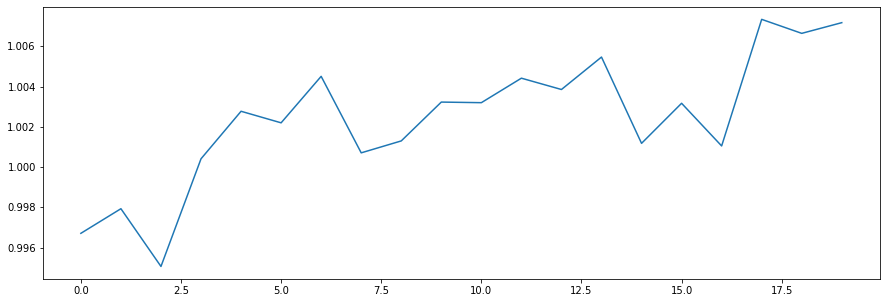

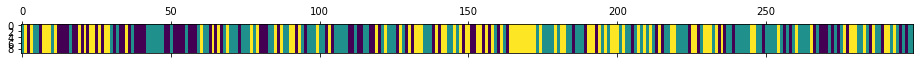

<Figure size 432x288 with 0 Axes>

N [[22. 36. 27.]
 [30. 52. 37.]
 [33. 31. 31.]]
alphas [[1.23594474 1.01302165 0.82141073]
 [0.70752537 1.54144103 0.82141073]
 [0.70752537 1.01302165 1.34983011]]
M [[4. 3. 3.]
 [1. 3. 4.]
 [2. 4. 8.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[2. 3. 3.]
 [1. 0. 4.]
 [2. 4. 3.]]
pi_z [[0.23328364 0.49191581 0.27480055]
 [0.2208748  0.42454523 0.35457997]
 [0.43837932 0.31711819 0.24450249]]
beta_vec [0.1457465  0.39815824 0.45609526]
hyper>> a_k: 3.0178032116212266  gamma: 0.3156735219863218  rho: 0.31890197174140344


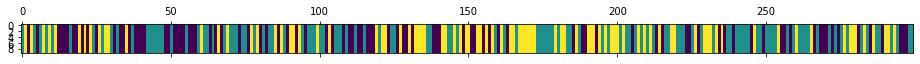

<Figure size 432x288 with 0 Axes>

521
N [[29. 40. 25.]
 [34. 42. 39.]
 [31. 33. 26.]]
alphas [[1.26195363 0.81838235 0.93746723]
 [0.29957024 1.78076574 0.93746723]
 [0.29957024 0.81838235 1.89985063]]
M [[7. 3. 3.]
 [2. 7. 4.]
 [5. 4. 3.]]
sum_w [[6.]
 [4.]
 [1.]]
barM [[1. 3. 3.]
 [2. 3. 4.]
 [5. 4. 2.]]
pi_z [[0.28318781 0.42938346 0.28742873]
 [0.30271408 0.34412329 0.35316263]
 [0.30645533 0.35400475 0.33953993]]
beta_vec [0.50484771 0.26129683 0.23385546]
hyper>> a_k: 4.850624533996063  gamma: 0.24668961848689638  rho: 0.32131092872562506


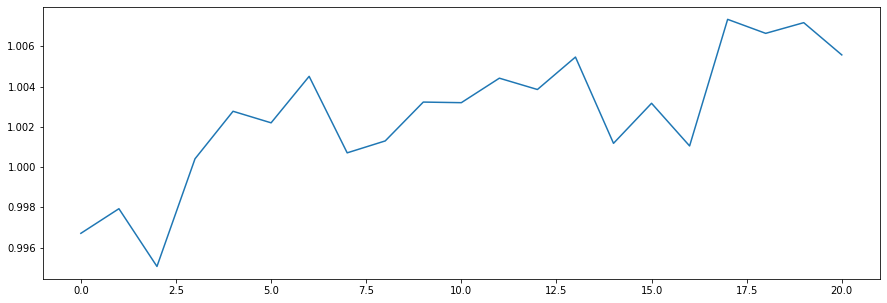

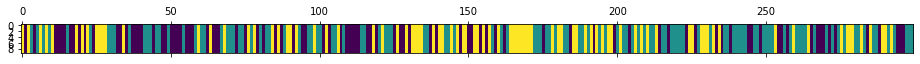

<Figure size 432x288 with 0 Axes>

N [[30. 36. 28.]
 [36. 45. 35.]
 [28. 35. 26.]]
alphas [[3.2205506  0.86020636 0.76986758]
 [1.66199192 2.41876504 0.76986758]
 [1.66199192 0.86020636 2.32842625]]
M [[ 6.  2.  3.]
 [ 3.  1.  6.]
 [ 8.  2. 11.]]
sum_w [[1.]
 [0.]
 [7.]]
barM [[5. 2. 3.]
 [3. 1. 6.]
 [8. 2. 4.]]
pi_z [[0.35347739 0.43604332 0.21047929]
 [0.36283798 0.39892136 0.23824066]
 [0.24451208 0.50963911 0.24584881]]
beta_vec [0.4571914 0.1818795 0.3609291]
hyper>> a_k: 4.876252728019216  gamma: 0.591484427429615  rho: 0.16159370404503706


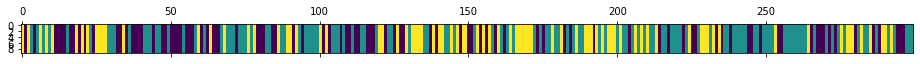

<Figure size 432x288 with 0 Axes>

522
N [[32. 36. 27.]
 [42. 49. 31.]
 [21. 37. 24.]]
alphas [[2.65709865 0.74357452 1.47557956]
 [1.86912691 1.53154626 1.47557956]
 [1.86912691 0.74357452 2.2635513 ]]
M [[ 6.  4.  3.]
 [ 6.  6.  4.]
 [ 4.  4. 12.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[ 4.  4.  3.]
 [ 6.  5.  4.]
 [ 4.  4. 10.]]
pi_z [[0.29046929 0.40732521 0.30220551]
 [0.32617998 0.40728971 0.2665303 ]
 [0.25697342 0.46623763 0.27678895]]
beta_vec [0.41703959 0.25299197 0.32996844]
hyper>> a_k: 4.386698545393981  gamma: 0.1624023816495693  rho: 0.15671920959244318


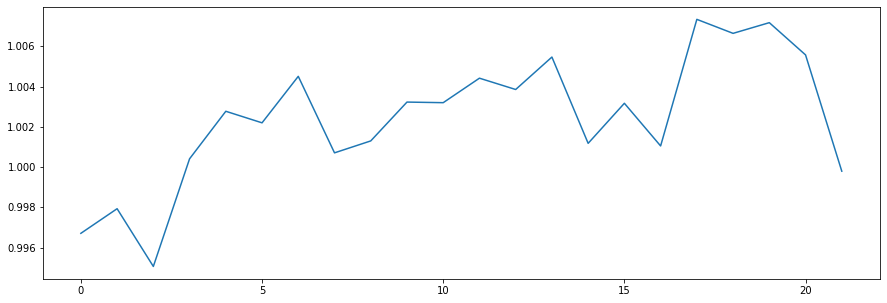

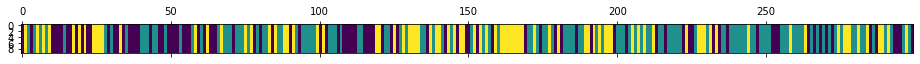

<Figure size 432x288 with 0 Axes>

N [[31. 35. 27.]
 [41. 49. 32.]
 [22. 37. 25.]]
alphas [[2.23020056 0.93587259 1.2206254 ]
 [1.54272063 1.62335252 1.2206254 ]
 [1.54272063 0.93587259 1.90810533]]
M [[ 7.  5.  5.]
 [11.  9.  5.]
 [ 6.  3.  5.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[ 5.  5.  5.]
 [11.  7.  5.]
 [ 6.  3.  3.]]
pi_z [[0.22001642 0.46311674 0.31686684]
 [0.37643411 0.3978059  0.22575998]
 [0.29528162 0.40347499 0.30124339]]
beta_vec [0.45405432 0.23874213 0.30720355]
hyper>> a_k: 5.4016673263754535  gamma: 0.46621407663967296  rho: 0.1331712586682673


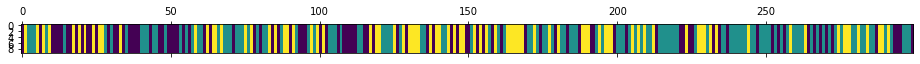

<Figure size 432x288 with 0 Axes>

523
N [[26. 37. 31.]
 [40. 51. 30.]
 [28. 33. 23.]]
alphas [[2.8453747  1.11786716 1.43842547]
 [2.12602786 1.83721399 1.43842547]
 [2.12602786 1.11786716 2.15777231]]
M [[ 8.  5.  5.]
 [ 7. 10.  4.]
 [ 6.  2.  5.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[ 7.  5.  5.]
 [ 7. 10.  4.]
 [ 6.  2.  2.]]
pi_z [[0.26909704 0.35927672 0.37162624]
 [0.37806056 0.42920762 0.19273182]
 [0.27268614 0.44263547 0.2846784 ]]
beta_vec [0.41842461 0.32000063 0.26157476]
hyper>> a_k: 5.2006441288740595  gamma: 0.7413318363598308  rho: 0.07968568094351185


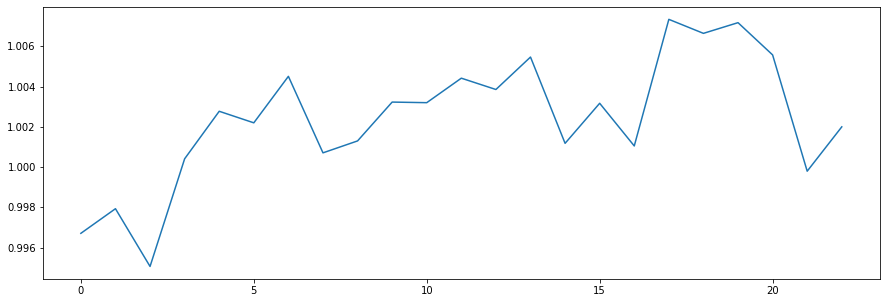

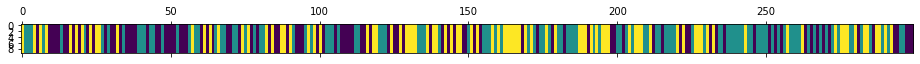

<Figure size 432x288 with 0 Axes>

N [[29. 35. 34.]
 [38. 44. 30.]
 [31. 33. 25.]]
alphas [[2.41709214 1.53159576 1.25195623]
 [2.00267527 1.94601263 1.25195623]
 [2.00267527 1.53159576 1.6663731 ]]
M [[5. 6. 3.]
 [7. 4. 6.]
 [8. 8. 3.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[4. 6. 3.]
 [7. 2. 6.]
 [8. 8. 2.]]
pi_z [[0.37350242 0.35595046 0.27054711]
 [0.30410595 0.47422781 0.22166625]
 [0.35458654 0.38819704 0.25721642]]
beta_vec [0.3859249  0.46176748 0.15230762]
hyper>> a_k: 7.086123178138098  gamma: 2.0108040400982703  rho: 0.06643415990772493


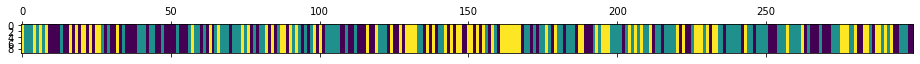

<Figure size 432x288 with 0 Axes>

524
N [[33. 36. 32.]
 [37. 51. 27.]
 [31. 28. 24.]]
alphas [[3.02379374 3.0547593  1.00757014]
 [2.5530331  3.52551994 1.00757014]
 [2.5530331  3.0547593  1.47833078]]
M [[8. 5. 4.]
 [7. 7. 2.]
 [9. 7. 8.]]
sum_w [[3.]
 [0.]
 [3.]]
barM [[5. 5. 4.]
 [7. 7. 2.]
 [9. 7. 5.]]
pi_z [[0.34193075 0.30700286 0.35106639]
 [0.33391056 0.45167382 0.21441562]
 [0.31067326 0.43030921 0.25901754]]
beta_vec [0.41037288 0.39538344 0.19424367]
hyper>> a_k: 6.630347490324522  gamma: 0.6150187695107723  rho: 0.11827033290199264


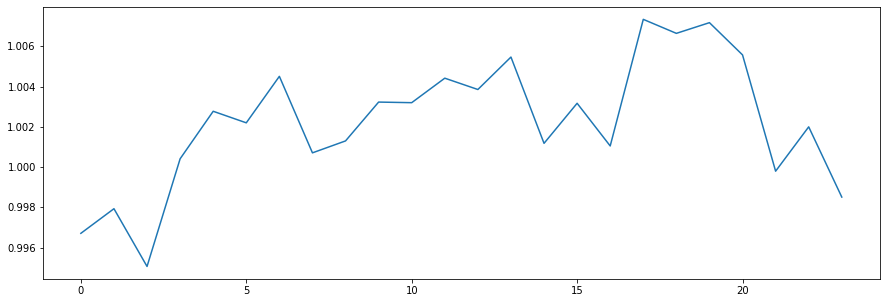

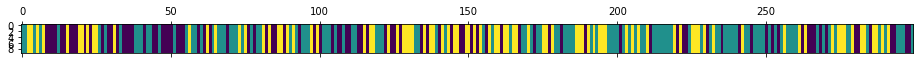

<Figure size 432x288 with 0 Axes>

N [[28. 34. 32.]
 [34. 50. 32.]
 [31. 33. 25.]]
alphas [[3.18328472 2.31148044 1.13558233]
 [2.39911131 3.09565384 1.13558233]
 [2.39911131 2.31148044 1.91975574]]
M [[6. 7. 4.]
 [5. 9. 3.]
 [9. 8. 4.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[4. 7. 4.]
 [5. 9. 3.]
 [9. 8. 3.]]
pi_z [[0.33243865 0.36980608 0.29775527]
 [0.29621228 0.39722834 0.30655938]
 [0.35069466 0.43996456 0.20934078]]
beta_vec [0.43482449 0.38977869 0.17539682]
hyper>> a_k: 6.019240184799062  gamma: 0.7001681202390928  rho: 0.05088234116862493


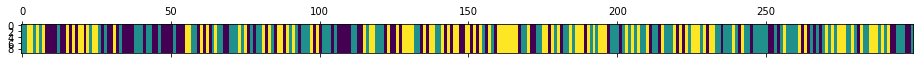

<Figure size 432x288 with 0 Axes>

525
N [[26. 31. 33.]
 [30. 42. 37.]
 [34. 36. 30.]]
alphas [[2.79041107 2.22679287 1.00203625]
 [2.48413803 2.5330659  1.00203625]
 [2.48413803 2.22679287 1.30830929]]
M [[10.  7.  6.]
 [10.  8.  4.]
 [10.  6.  6.]]
sum_w [[3.]
 [0.]
 [3.]]
barM [[ 7.  7.  6.]
 [10.  8.  4.]
 [10.  6.  3.]]
pi_z [[0.23785164 0.39095845 0.37118991]
 [0.25026138 0.29254227 0.45719635]
 [0.29215229 0.38348166 0.32436605]]
beta_vec [0.55489805 0.23924761 0.20585434]
hyper>> a_k: 7.401057613074039  gamma: 1.206584521885118  rho: 0.10625069394194615


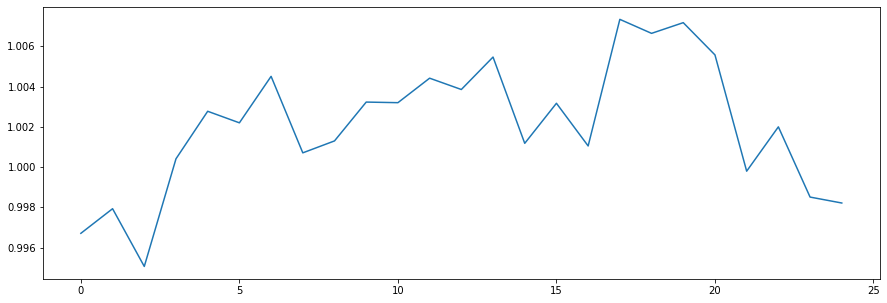

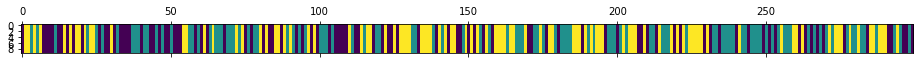

<Figure size 432x288 with 0 Axes>

N [[25. 38. 32.]
 [37. 37. 32.]
 [34. 30. 34.]]
alphas [[4.45684616 1.58254878 1.36166267]
 [3.67047865 2.36891629 1.36166267]
 [3.67047865 1.58254878 2.14803018]]
M [[10.  5.  5.]
 [ 7. 10.  3.]
 [ 8. 10.  4.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[ 8.  5.  5.]
 [ 7.  7.  3.]
 [ 8. 10.  3.]]
pi_z [[0.29570522 0.4131402  0.29115458]
 [0.37187301 0.31271425 0.31541274]
 [0.42238097 0.32940814 0.2482109 ]]
beta_vec [0.38783056 0.45135012 0.16081932]
hyper>> a_k: 6.801635681901635  gamma: 0.8342674704340518  rho: 0.10527488645839861


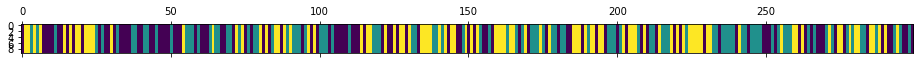

<Figure size 432x288 with 0 Axes>

526
N [[34. 39. 33.]
 [35. 36. 29.]
 [37. 25. 31.]]
alphas [[3.07622088 2.74673369 0.97868112]
 [2.36017945 3.46277511 0.97868112]
 [2.36017945 2.74673369 1.69472254]]
M [[ 3.  8.  5.]
 [11.  9.  4.]
 [ 7.  6.  7.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[ 3.  8.  5.]
 [11.  9.  4.]
 [ 7.  6.  5.]]
pi_z [[0.20565361 0.43491144 0.35943495]
 [0.2791761  0.44890058 0.27192331]
 [0.40183367 0.21822395 0.37994237]]
beta_vec [0.26571918 0.49548096 0.23879986]
hyper>> a_k: 4.169234882674355  gamma: 0.333148843489781  rho: 0.13558121730565334


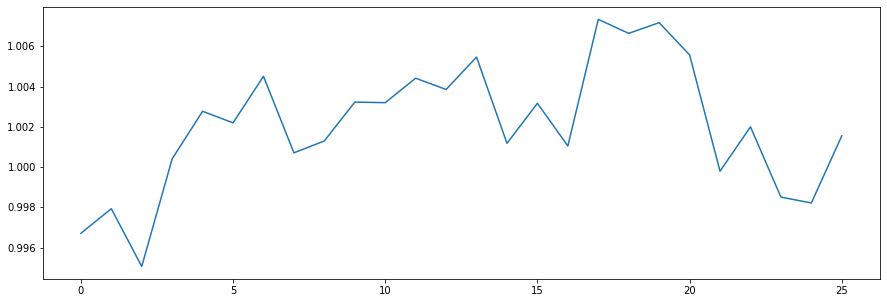

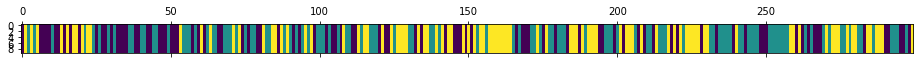

<Figure size 432x288 with 0 Axes>

N [[30. 39. 25.]
 [32. 45. 34.]
 [31. 27. 36.]]
alphas [[1.52291254 1.78569603 0.86062631]
 [0.9576426  2.35096597 0.86062631]
 [0.9576426  1.78569603 1.42589626]]
M [[4. 5. 4.]
 [3. 8. 3.]
 [5. 8. 5.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[2. 5. 4.]
 [3. 6. 3.]
 [5. 8. 3.]]
pi_z [[0.30783545 0.45862068 0.23354387]
 [0.32918989 0.40563799 0.26517212]
 [0.36700705 0.26732156 0.36567139]]
beta_vec [0.28235619 0.42624127 0.29140255]
hyper>> a_k: 2.905213890864132  gamma: 1.116343130530038  rho: 0.2293729402913129


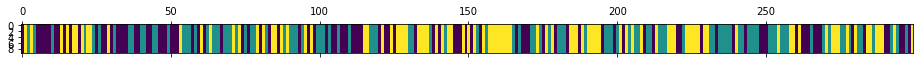

<Figure size 432x288 with 0 Axes>

527
N [[35. 38. 26.]
 [31. 41. 32.]
 [33. 25. 38.]]
alphas [[1.29852677 0.95428448 0.65240264]
 [0.63214932 1.62066193 0.65240264]
 [0.63214932 0.95428448 1.31878009]]
M [[4. 5. 3.]
 [3. 6. 2.]
 [3. 5. 6.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[2. 5. 3.]
 [3. 3. 2.]
 [3. 5. 3.]]
pi_z [[0.34808655 0.34624022 0.30567323]
 [0.30073309 0.33180077 0.36746614]
 [0.29576564 0.26539177 0.4388426 ]]
beta_vec [0.18497635 0.39945004 0.41557362]
hyper>> a_k: 3.271378333655455  gamma: 1.4037966857670425  rho: 0.35079993158152123


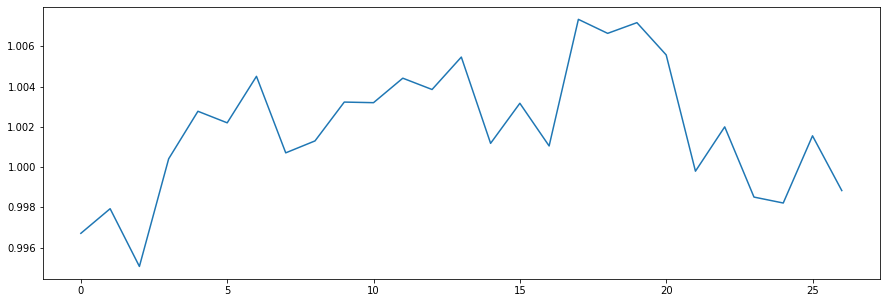

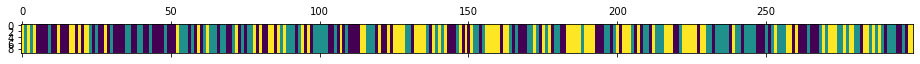

<Figure size 432x288 with 0 Axes>

N [[39. 38. 27.]
 [34. 39. 29.]
 [31. 25. 37.]]
alphas [[1.54044818 0.84834361 0.88258654]
 [0.39284889 1.99594291 0.88258654]
 [0.39284889 0.84834361 2.03018583]]
M [[3. 4. 2.]
 [2. 6. 3.]
 [2. 3. 5.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[0. 4. 2.]
 [2. 3. 3.]
 [2. 3. 2.]]
pi_z [[0.34144815 0.37558649 0.28296536]
 [0.39137429 0.35788681 0.25073889]
 [0.39270135 0.29493849 0.31236016]]
beta_vec [0.167581   0.53491316 0.29750584]
hyper>> a_k: 1.845954491942467  gamma: 0.5518188140498359  rho: 0.2500697450152538


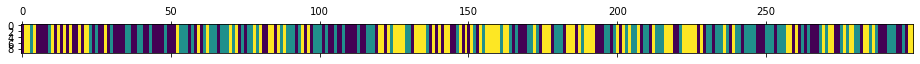

<Figure size 432x288 with 0 Axes>

528
N [[36. 38. 30.]
 [38. 38. 27.]
 [30. 27. 35.]]
alphas [[0.69360596 0.74050014 0.41184838]
 [0.2319886  1.20211751 0.41184838]
 [0.2319886  0.74050014 0.87346575]]
M [[4. 4. 2.]
 [2. 5. 4.]
 [1. 3. 5.]]
sum_w [[3.]
 [0.]
 [3.]]
barM [[1. 4. 2.]
 [2. 5. 4.]
 [1. 3. 2.]]
pi_z [[0.2797557  0.31731634 0.40292796]
 [0.41305827 0.35939049 0.22755124]
 [0.28408376 0.34700472 0.36891152]]
beta_vec [0.08650571 0.53477415 0.37872014]
hyper>> a_k: 2.3198101005652467  gamma: 0.6253564856511163  rho: 0.18578091647062245


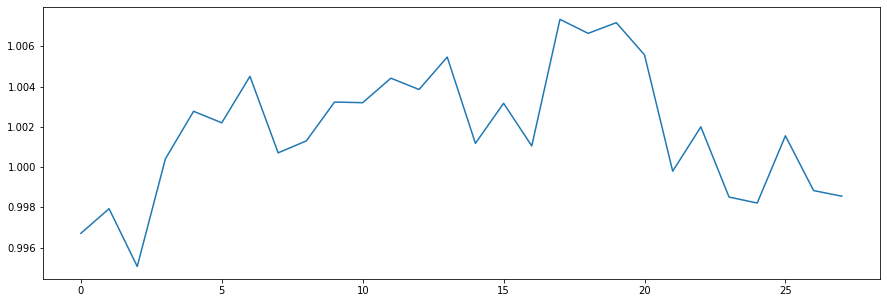

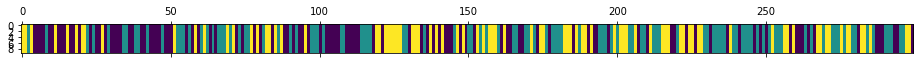

<Figure size 432x288 with 0 Axes>

N [[39. 39. 29.]
 [39. 43. 25.]
 [30. 25. 30.]]
alphas [[0.59437135 1.01009941 0.71533934]
 [0.1633949  1.44107586 0.71533934]
 [0.1633949  1.01009941 1.14631578]]
M [[2. 4. 5.]
 [1. 6. 2.]
 [1. 9. 5.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[0. 4. 5.]
 [1. 5. 2.]
 [1. 9. 3.]]
pi_z [[0.31693451 0.41468516 0.26838033]
 [0.38340054 0.4095307  0.20706877]
 [0.35126002 0.2272045  0.42153548]]
beta_vec [0.05588277 0.64717585 0.29694139]
hyper>> a_k: 3.5224740038727305  gamma: 0.46757278390724005  rho: 0.23178823099098056


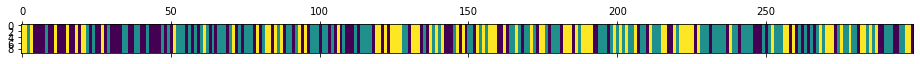

<Figure size 432x288 with 0 Axes>

529
N [[27. 43. 30.]
 [45. 44. 27.]
 [28. 29. 26.]]
alphas [[0.96768712 1.75126172 0.80352517]
 [0.1512191  2.56772974 0.80352517]
 [0.1512191  1.75126172 1.61999319]]
M [[5. 4. 5.]
 [2. 7. 1.]
 [1. 6. 4.]]
sum_w [[5.]
 [3.]
 [1.]]
barM [[0. 4. 5.]
 [2. 4. 1.]
 [1. 6. 3.]]
pi_z [[0.34780052 0.37449763 0.27770185]
 [0.42848763 0.36025521 0.21125717]
 [0.42490386 0.29645418 0.27864196]]
beta_vec [0.14235898 0.57438585 0.28325517]
hyper>> a_k: 3.4694035175469184  gamma: 0.4700883587688251  rho: 0.2400745544584462


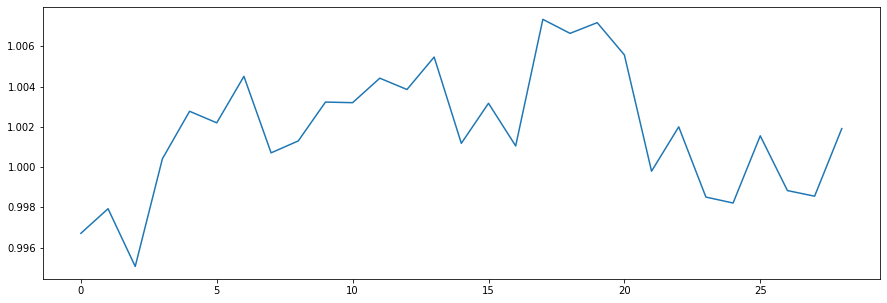

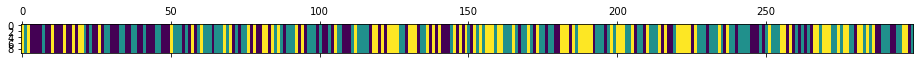

<Figure size 432x288 with 0 Axes>

N [[28. 36. 30.]
 [34. 47. 32.]
 [31. 31. 30.]]
alphas [[1.20824325 1.51436142 0.74679885]
 [0.37532775 2.34727692 0.74679885]
 [0.37532775 1.51436142 1.57971435]]
M [[ 5. 10.  3.]
 [ 3.  9.  5.]
 [ 1.  2.  6.]]
sum_w [[4.]
 [3.]
 [6.]]
barM [[ 1. 10.  3.]
 [ 3.  6.  5.]
 [ 1.  2.  0.]]
pi_z [[0.28997021 0.44866122 0.26136857]
 [0.30887709 0.42323112 0.26789179]
 [0.28374297 0.31255048 0.40370655]]
beta_vec [0.13546084 0.47477758 0.38976158]
hyper>> a_k: 4.457102007068619  gamma: 0.6066244495925314  rho: 0.21835612241218033


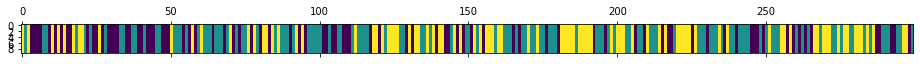

<Figure size 432x288 with 0 Axes>

530
N [[24. 36. 27.]
 [37. 53. 31.]
 [26. 32. 33.]]
alphas [[1.44516299 1.65406172 1.3578773 ]
 [0.47192748 2.62729723 1.3578773 ]
 [0.47192748 1.65406172 2.33111281]]
M [[ 5.  6.  4.]
 [ 5. 10.  6.]
 [ 3.  8.  6.]]
sum_w [[4.]
 [0.]
 [4.]]
barM [[ 1.  6.  4.]
 [ 5. 10.  6.]
 [ 3.  8.  2.]]
pi_z [[0.25897316 0.47545333 0.26557351]
 [0.37618925 0.35357928 0.27023147]
 [0.27980923 0.37408939 0.34610138]]
beta_vec [0.25438144 0.50970898 0.23590958]
hyper>> a_k: 6.5644950994773215  gamma: 0.3479171954185785  rho: 0.13451314304283024


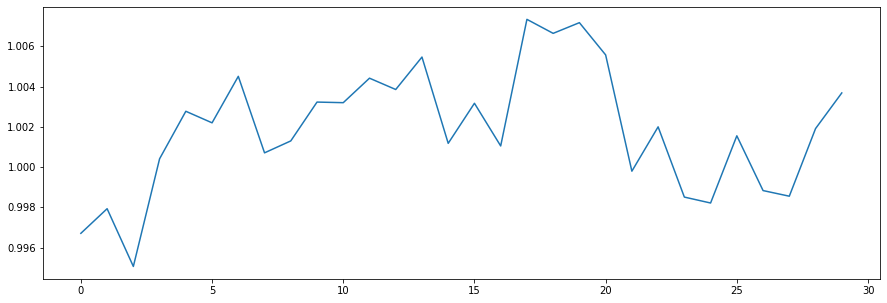

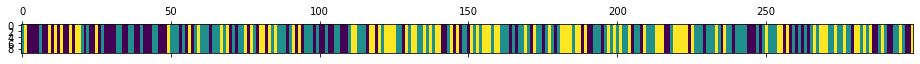

<Figure size 432x288 with 0 Axes>

N [[27. 39. 24.]
 [38. 44. 39.]
 [24. 38. 26.]]
alphas [[2.32827499 2.89590352 1.34031658]
 [1.44526412 3.77891439 1.34031658]
 [1.44526412 2.89590352 2.22332745]]
M [[8. 6. 3.]
 [6. 9. 4.]
 [7. 7. 6.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[7. 6. 3.]
 [6. 7. 4.]
 [7. 7. 5.]]
pi_z [[0.33275856 0.30510326 0.36213818]
 [0.3673419  0.32471369 0.3079444 ]
 [0.27160002 0.38904951 0.33935047]]
beta_vec [0.42615169 0.43087591 0.1429724 ]
hyper>> a_k: 5.917057273647513  gamma: 0.6476484093423478  rho: 0.06519425231546322


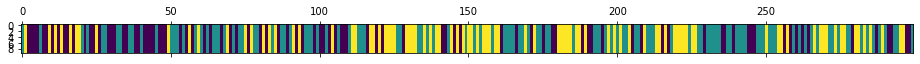

<Figure size 432x288 with 0 Axes>

531
N [[26. 38. 28.]
 [40. 44. 32.]
 [26. 34. 31.]]
alphas [[2.74293062 2.38330354 0.79082311]
 [2.3571725  2.76906166 0.79082311]
 [2.3571725  2.38330354 1.17658124]]
M [[ 6. 10.  2.]
 [ 9. 13.  4.]
 [ 4.  5.  5.]]
sum_w [[0.]
 [3.]
 [2.]]
barM [[ 6. 10.  2.]
 [ 9. 10.  4.]
 [ 4.  5.  3.]]
pi_z [[0.3092446  0.41422151 0.27653389]
 [0.33770733 0.3960418  0.26625087]
 [0.21468089 0.49367187 0.29164724]]
beta_vec [0.30792713 0.55784137 0.1342315 ]
hyper>> a_k: 7.124841230503482  gamma: 0.6747520196259886  rho: 0.15439166950742353


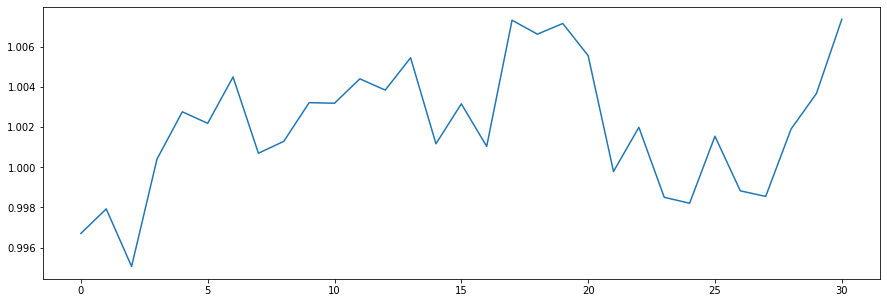

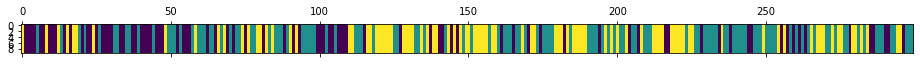

<Figure size 432x288 with 0 Axes>

N [[30. 35. 20.]
 [32. 53. 35.]
 [23. 32. 39.]]
alphas [[2.95522323 3.36089671 0.80872129]
 [1.8552071  4.46091284 0.80872129]
 [1.8552071  3.36089671 1.90873742]]
M [[10. 10.  4.]
 [ 5. 13.  4.]
 [ 4.  9.  8.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[ 7. 10.  4.]
 [ 5. 11.  4.]
 [ 4.  9.  3.]]
pi_z [[0.38217572 0.36247782 0.25534646]
 [0.3320155  0.39667225 0.27131225]
 [0.26440472 0.3706898  0.36490548]]
beta_vec [0.24606697 0.56410761 0.18982541]
hyper>> a_k: 7.529358672691159  gamma: 0.5838512992200483  rho: 0.19729773461296896


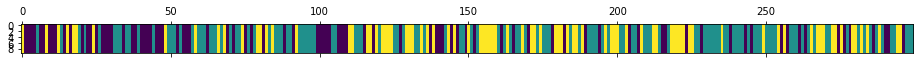

<Figure size 432x288 with 0 Axes>

532
N [[29. 39. 20.]
 [37. 55. 34.]
 [22. 32. 31.]]
alphas [[2.97271317 3.40937237 1.14727314]
 [1.48718776 4.89489778 1.14727314]
 [1.48718776 3.40937237 2.63279855]]
M [[ 5. 11.  3.]
 [ 4. 13.  3.]
 [ 3. 11.  6.]]
sum_w [[3.]
 [0.]
 [2.]]
barM [[ 2. 11.  3.]
 [ 4. 13.  3.]
 [ 3. 11.  4.]]
pi_z [[0.40676381 0.42970317 0.16353302]
 [0.26720671 0.48641683 0.24637646]
 [0.32087308 0.3889345  0.29019242]]
beta_vec [0.14665983 0.70412706 0.14921311]
hyper>> a_k: 5.806278940675108  gamma: 0.6505905468514696  rho: 0.22908607230987202


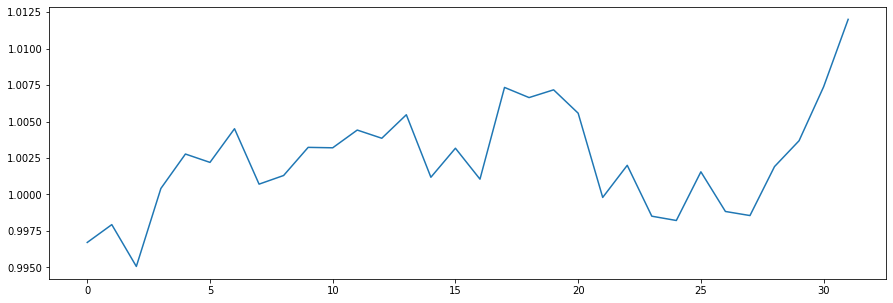

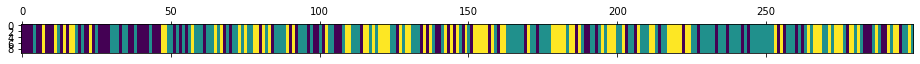

<Figure size 432x288 with 0 Axes>

N [[24. 42. 18.]
 [34. 57. 36.]
 [26. 29. 33.]]
alphas [[1.98660775 3.15177223 0.66789896]
 [0.65647011 4.48190987 0.66789896]
 [0.65647011 3.15177223 1.9980366 ]]
M [[ 7. 10.  3.]
 [ 3. 10.  2.]
 [ 4.  6.  4.]]
sum_w [[5.]
 [5.]
 [2.]]
barM [[ 2. 10.  3.]
 [ 3.  5.  2.]
 [ 4.  6.  2.]]
pi_z [[0.22602233 0.56352002 0.21045765]
 [0.24999333 0.5286465  0.22136017]
 [0.25898301 0.35520376 0.38581324]]
beta_vec [0.23639724 0.57248767 0.19111509]
hyper>> a_k: 6.505567929307145  gamma: 1.5078360881443253  rho: 0.22793727402671718


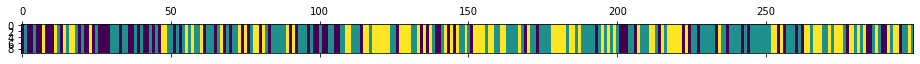

<Figure size 432x288 with 0 Axes>

533
N [[18. 40. 19.]
 [35. 56. 38.]
 [24. 33. 36.]]
alphas [[2.67021538 2.87543754 0.95991501]
 [1.18735396 4.35829896 0.95991501]
 [1.18735396 2.87543754 2.44277643]]
M [[ 8.  7.  2.]
 [ 4. 11.  3.]
 [ 3.  6.  5.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[4. 7. 2.]
 [4. 9. 3.]
 [3. 6. 1.]]
pi_z [[0.29787719 0.42147924 0.28064356]
 [0.24648021 0.42417523 0.32934455]
 [0.24763566 0.37602179 0.37634255]]
beta_vec [0.19150464 0.60628067 0.20221469]
hyper>> a_k: 4.617030454204882  gamma: 0.4299219297635929  rho: 0.3060774013255535


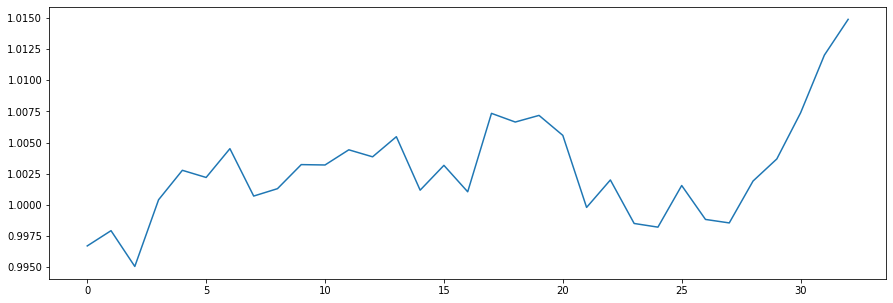

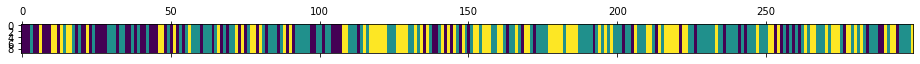

<Figure size 432x288 with 0 Axes>

N [[19. 40. 19.]
 [38. 56. 36.]
 [21. 33. 37.]]
alphas [[2.02672309 1.94243946 0.64786791]
 [0.6135544  3.35560814 0.64786791]
 [0.6135544  1.94243946 2.06103659]]
M [[ 3. 11.  1.]
 [ 3. 12.  3.]
 [ 3.  6.  4.]]
sum_w [[3.]
 [7.]
 [4.]]
barM [[ 0. 11.  1.]
 [ 3.  5.  3.]
 [ 3.  6.  0.]]
pi_z [[0.22593121 0.57643868 0.19763011]
 [0.32476892 0.36519242 0.31003867]
 [0.25599906 0.27719747 0.46680347]]
beta_vec [0.11536624 0.69715267 0.18748109]
hyper>> a_k: 4.866806994363821  gamma: 0.6006489507049299  rho: 0.3308798251957652


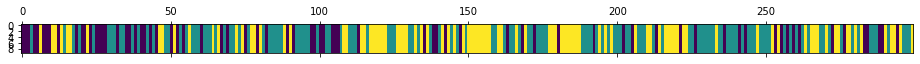

<Figure size 432x288 with 0 Axes>

534
N [[17. 38. 18.]
 [34. 57. 38.]
 [22. 34. 41.]]
alphas [[1.98601596 2.27026286 0.61052818]
 [0.37568771 3.8805911  0.61052818]
 [0.37568771 2.27026286 2.22085642]]
M [[ 6.  5.  4.]
 [ 1. 15.  4.]
 [ 3. 12.  9.]]
sum_w [[ 5.]
 [11.]
 [ 7.]]
barM [[ 1.  5.  4.]
 [ 1.  4.  4.]
 [ 3. 12.  2.]]
pi_z [[0.24025607 0.50252393 0.25722   ]
 [0.24023901 0.4032333  0.3565277 ]
 [0.22028797 0.42882366 0.35088836]]
beta_vec [0.22672542 0.59490862 0.17836597]
hyper>> a_k: 6.326281833121968  gamma: 0.8691708435336272  rho: 0.3028776892232009


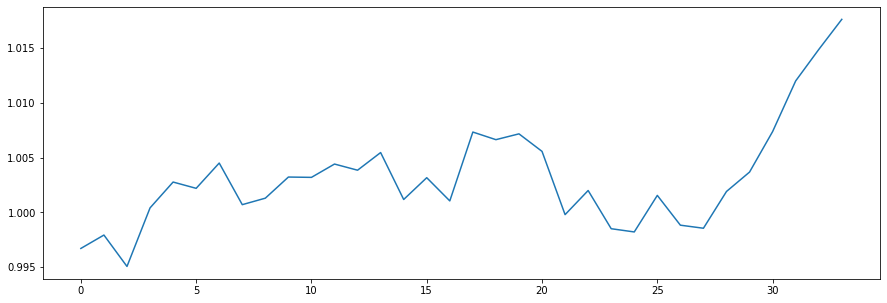

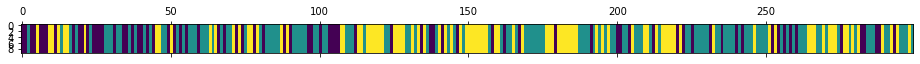

<Figure size 432x288 with 0 Axes>

N [[18. 41. 19.]
 [34. 59. 34.]
 [26. 28. 40.]]
alphas [[2.91599229 2.62366134 0.7866282 ]
 [0.99990266 4.53975097 0.7866282 ]
 [0.99990266 2.62366134 2.70271783]]
M [[ 6.  9.  4.]
 [ 3. 16.  2.]
 [ 5.  7.  7.]]
sum_w [[5.]
 [4.]
 [4.]]
barM [[ 1.  9.  4.]
 [ 3. 12.  2.]
 [ 5.  7.  3.]]
pi_z [[0.26758269 0.5264521  0.20596521]
 [0.29396847 0.49373262 0.21229891]
 [0.31745831 0.29866166 0.38388003]]
beta_vec [0.15440014 0.64153366 0.2040662 ]
hyper>> a_k: 6.16814373317444  gamma: 0.717380219684309  rho: 0.2279894853327593


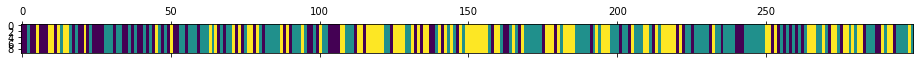

<Figure size 432x288 with 0 Axes>

535
N [[19. 42. 22.]
 [34. 55. 32.]
 [30. 24. 41.]]
alphas [[2.1415056  3.05490105 0.97173709]
 [0.73523369 4.46117296 0.97173709]
 [0.73523369 3.05490105 2.378009  ]]
M [[ 7. 14.  5.]
 [ 3. 11.  4.]
 [ 2.  9. 10.]]
sum_w [[4.]
 [2.]
 [5.]]
barM [[ 3. 14.  5.]
 [ 3.  9.  4.]
 [ 2.  9.  5.]]
pi_z [[0.33312609 0.48834001 0.1785339 ]
 [0.29055466 0.44044933 0.26899601]
 [0.33467757 0.2804338  0.38488863]]
beta_vec [0.1560056  0.61186349 0.23213091]
hyper>> a_k: 8.9157348159731  gamma: 0.7857843495104896  rho: 0.2775499451820237


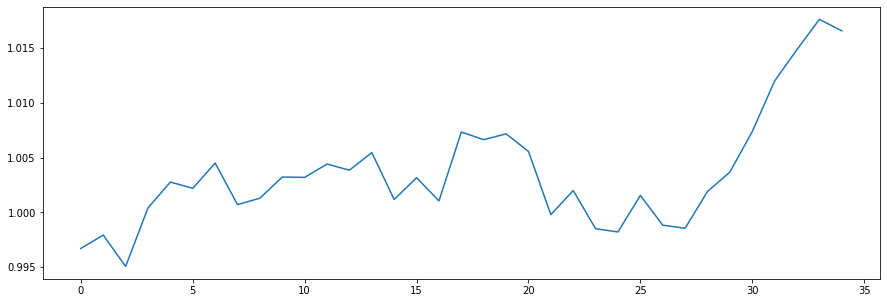

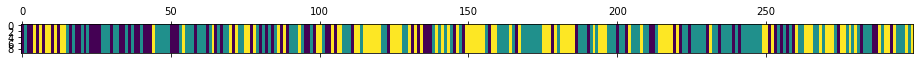

<Figure size 432x288 with 0 Axes>

N [[17. 41. 21.]
 [33. 57. 35.]
 [29. 26. 40.]]
alphas [[3.47942075 3.94111869 1.49519537]
 [1.00485905 6.4156804  1.49519537]
 [1.00485905 3.94111869 3.96975708]]
M [[ 9. 11.  3.]
 [ 4. 16.  2.]
 [ 5.  7. 11.]]
sum_w [[6.]
 [8.]
 [5.]]
barM [[ 3. 11.  3.]
 [ 4.  8.  2.]
 [ 5.  7.  6.]]
pi_z [[0.19973662 0.47983694 0.32042644]
 [0.29079402 0.44659297 0.26261301]
 [0.26206453 0.29372154 0.44421393]]
beta_vec [0.18851334 0.54797898 0.26350768]
hyper>> a_k: 8.154833249661541  gamma: 1.1074192926559245  rho: 0.2939258533139943


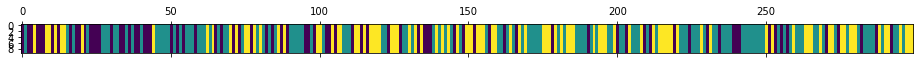

<Figure size 432x288 with 0 Axes>

536
N [[17. 39. 24.]
 [32. 54. 37.]
 [31. 30. 35.]]
alphas [[3.48236045 3.15521747 1.51725533]
 [1.08544413 5.55213379 1.51725533]
 [1.08544413 3.15521747 3.91417165]]
M [[ 7.  4.  4.]
 [ 3. 12.  5.]
 [ 6.  9. 10.]]
sum_w [[6.]
 [4.]
 [6.]]
barM [[1. 4. 4.]
 [3. 8. 5.]
 [6. 9. 4.]]
pi_z [[0.25420106 0.53238303 0.21341592]
 [0.31453928 0.43442974 0.25103098]
 [0.30512888 0.28943812 0.40543299]]
beta_vec [0.217188   0.53487348 0.24793851]
hyper>> a_k: 5.355146427073511  gamma: 1.0536832471271373  rho: 0.2594872185127324


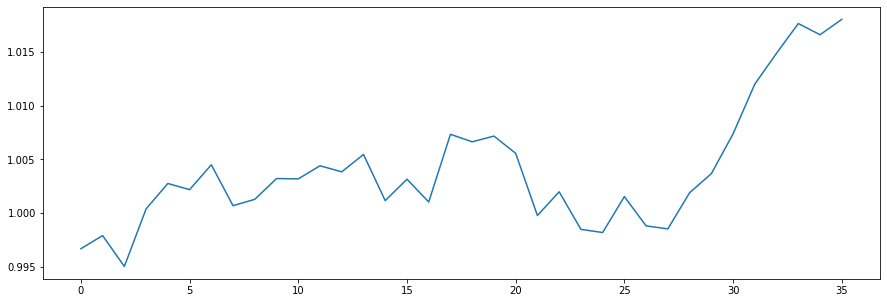

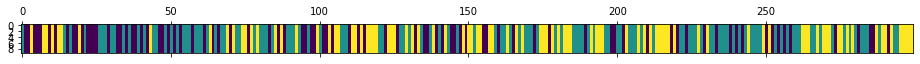

<Figure size 432x288 with 0 Axes>

N [[18. 45. 24.]
 [38. 44. 37.]
 [31. 30. 32.]]
alphas [[2.25086288 2.12106989 0.98321366]
 [0.86127083 3.51066194 0.98321366]
 [0.86127083 2.12106989 2.37280571]]
M [[3. 9. 5.]
 [5. 8. 3.]
 [4. 8. 5.]]
sum_w [[1.]
 [4.]
 [2.]]
barM [[2. 9. 5.]
 [5. 4. 3.]
 [4. 8. 3.]]
pi_z [[0.23125073 0.54907832 0.21967095]
 [0.31622652 0.36747205 0.31630143]
 [0.29118893 0.27244885 0.43636222]]
beta_vec [0.32242976 0.43349372 0.24407652]
hyper>> a_k: 5.9137457996334275  gamma: 0.3111156128556071  rho: 0.11747541272045985


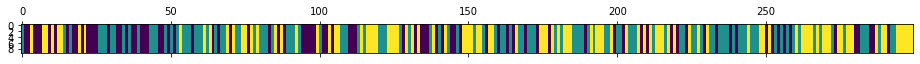

<Figure size 432x288 with 0 Axes>

537
N [[24. 38. 25.]
 [34. 43. 36.]
 [29. 32. 38.]]
alphas [[2.37748906 2.26241502 1.27384173]
 [1.68276933 2.95713474 1.27384173]
 [1.68276933 2.26241502 1.96856146]]
M [[6. 4. 2.]
 [5. 8. 6.]
 [5. 4. 8.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[4. 4. 2.]
 [5. 7. 6.]
 [5. 4. 8.]]
pi_z [[0.29267748 0.45208031 0.25524221]
 [0.36882101 0.36466496 0.26651402]
 [0.28614312 0.32475822 0.38909866]]
beta_vec [0.3478863  0.28666029 0.36545341]
hyper>> a_k: 3.5400317819813685  gamma: 0.2960457358558196  rho: 0.09502924212321602


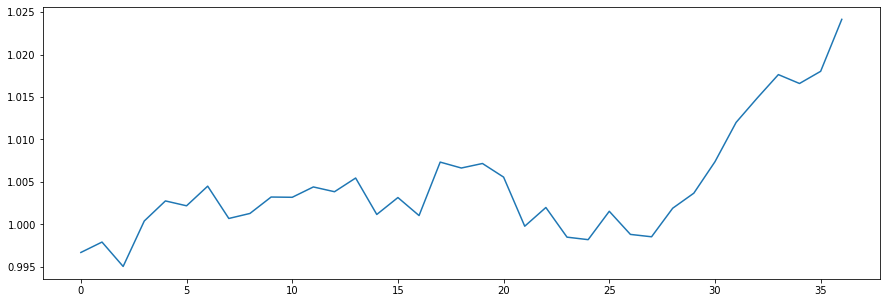

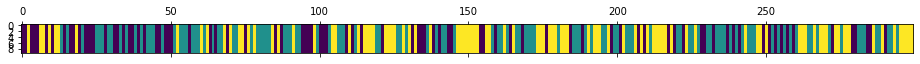

<Figure size 432x288 with 0 Axes>

N [[24. 36. 27.]
 [39. 47. 29.]
 [24. 32. 41.]]
alphas [[1.45090386 0.91835215 1.17077577]
 [1.11449732 1.25475869 1.17077577]
 [1.11449732 0.91835215 1.50718231]]
M [[3. 5. 7.]
 [7. 2. 5.]
 [3. 5. 5.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[2. 5. 7.]
 [7. 2. 5.]
 [3. 5. 4.]]
pi_z [[0.30651613 0.38323426 0.31024961]
 [0.32580558 0.42239546 0.25179896]
 [0.20613932 0.33347932 0.46038136]]
beta_vec [0.41747218 0.30281009 0.27971773]
hyper>> a_k: 3.6750530400925046  gamma: 1.274532239062122  rho: 0.03393697113126614


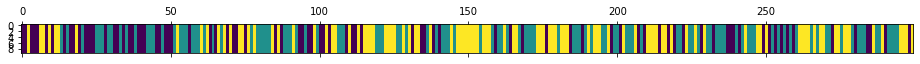

<Figure size 432x288 with 0 Axes>

538
N [[22. 35. 28.]
 [34. 47. 31.]
 [29. 30. 43.]]
alphas [[1.60688538 1.07507662 0.99309104]
 [1.48216521 1.19979679 0.99309104]
 [1.48216521 1.07507662 1.11781121]]
M [[3. 5. 5.]
 [4. 3. 4.]
 [3. 6. 4.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[2. 5. 5.]
 [4. 2. 4.]
 [3. 6. 4.]]
pi_z [[0.25105174 0.4092612  0.33968706]
 [0.35187118 0.38304686 0.26508196]
 [0.30374393 0.32679218 0.3694639 ]]
beta_vec [0.29807127 0.33451451 0.36741422]
hyper>> a_k: 3.0273892857803686  gamma: 0.03963948476947391  rho: 0.15046185046799088


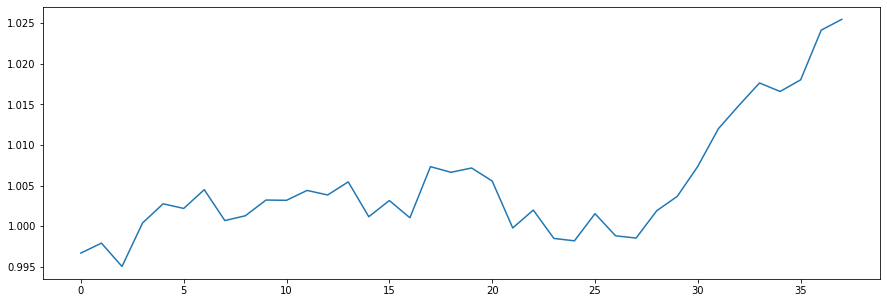

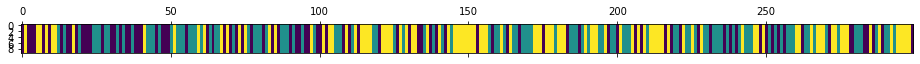

<Figure size 432x288 with 0 Axes>

N [[19. 40. 30.]
 [39. 42. 28.]
 [32. 27. 42.]]
alphas [[1.22211092 0.86033208 0.94494628]
 [0.76660433 1.31583868 0.94494628]
 [0.76660433 0.86033208 1.40045287]]
M [[6. 6. 4.]
 [2. 3. 3.]
 [2. 3. 7.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[2. 6. 4.]
 [2. 2. 3.]
 [2. 3. 5.]]
pi_z [[0.15656029 0.51652179 0.32691792]
 [0.42730898 0.30393349 0.26875754]
 [0.31566846 0.26447636 0.41985518]]
beta_vec [0.17594095 0.3736595  0.45039954]
hyper>> a_k: 3.0730352115932087  gamma: 1.1148227216689424  rho: 0.16842061244840104


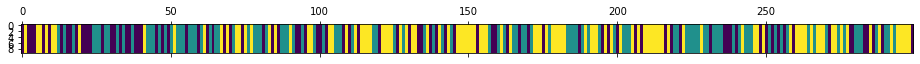

<Figure size 432x288 with 0 Axes>

539
N [[18. 41. 29.]
 [37. 38. 31.]
 [33. 27. 45.]]
alphas [[0.96717479 0.95487668 1.15098375]
 [0.44961231 1.47243915 1.15098375]
 [0.44961231 0.95487668 1.66854622]]
M [[2. 7. 4.]
 [4. 7. 4.]
 [5. 3. 8.]]
sum_w [[1.]
 [5.]
 [2.]]
barM [[1. 7. 4.]
 [4. 2. 4.]
 [5. 3. 6.]]
pi_z [[0.24917235 0.32864298 0.42218466]
 [0.29467197 0.39374409 0.31158395]
 [0.33065155 0.23919581 0.43015264]]
beta_vec [0.29739776 0.2789833  0.42361894]
hyper>> a_k: 4.0528119970610605  gamma: 0.702041780755157  rho: 0.2608272618513505


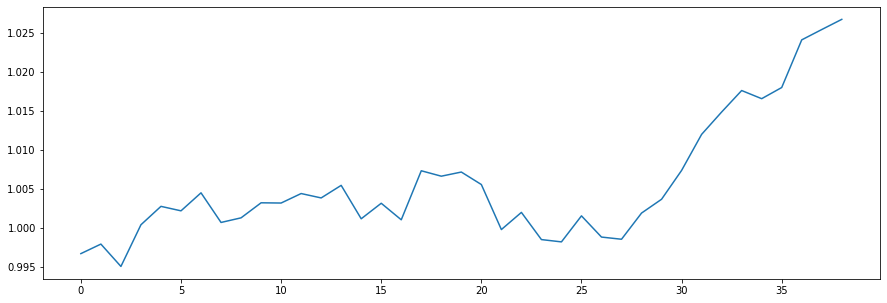

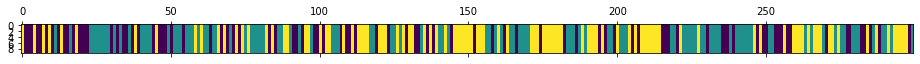

<Figure size 432x288 with 0 Axes>

N [[24. 30. 35.]
 [29. 54. 24.]
 [35. 24. 44.]]
alphas [[1.94800671 0.83575812 1.26904717]
 [0.89092285 1.89284197 1.26904717]
 [0.89092285 0.83575812 2.32613103]]
M [[4. 5. 4.]
 [6. 8. 3.]
 [4. 3. 7.]]
sum_w [[3.]
 [5.]
 [6.]]
barM [[1. 5. 4.]
 [6. 3. 3.]
 [4. 3. 1.]]
pi_z [[0.28631966 0.29720338 0.41647696]
 [0.34043404 0.43575544 0.22381051]
 [0.39767032 0.22804047 0.3742892 ]]
beta_vec [0.23614597 0.35887342 0.40498061]
hyper>> a_k: 3.9466190989487577  gamma: 0.3141959734241763  rho: 0.31461810824071695


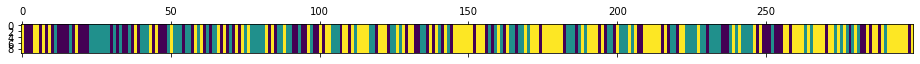

<Figure size 432x288 with 0 Axes>

540
N [[23. 29. 36.]
 [27. 41. 29.]
 [38. 27. 49.]]
alphas [[1.8804388  0.97073152 1.09544877]
 [0.63876097 2.21240936 1.09544877]
 [0.63876097 0.97073152 2.33712661]]
M [[5. 3. 7.]
 [3. 7. 3.]
 [4. 4. 4.]]
sum_w [[5.]
 [7.]
 [2.]]
barM [[0. 3. 7.]
 [3. 0. 3.]
 [4. 4. 2.]]
pi_z [[0.28143239 0.24207802 0.47648959]
 [0.22320016 0.42081648 0.35598336]
 [0.33889427 0.25277446 0.40833127]]
beta_vec [0.42278671 0.16872881 0.40848448]
hyper>> a_k: 3.720703724448129  gamma: 0.6275234428647621  rho: 0.34505082082711774


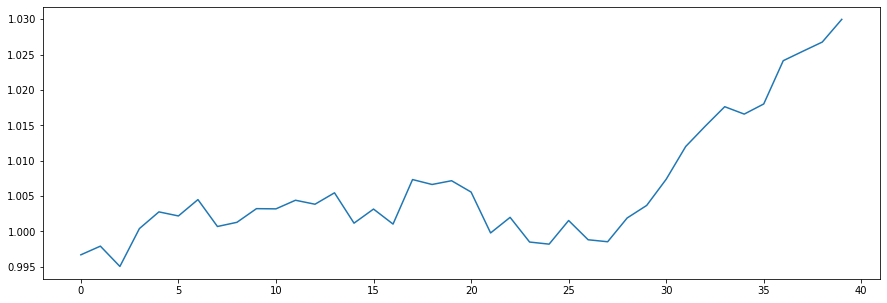

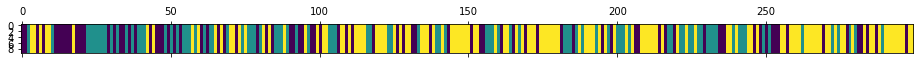

<Figure size 432x288 with 0 Axes>

N [[23. 27. 36.]
 [26. 35. 29.]
 [37. 28. 58.]]
alphas [[2.3141089  0.4111705  0.99542432]
 [1.03027703 1.69500237 0.99542432]
 [1.03027703 0.4111705  2.2792562 ]]
M [[3. 3. 7.]
 [2. 4. 6.]
 [2. 2. 7.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[1. 3. 7.]
 [2. 1. 6.]
 [2. 2. 3.]]
pi_z [[0.25386366 0.33115323 0.41498312]
 [0.26503378 0.42469861 0.3102676 ]
 [0.24039109 0.24849321 0.5111157 ]]
beta_vec [0.18979537 0.29995146 0.51025317]
hyper>> a_k: 3.9642663805631653  gamma: 1.164293222103576  rho: 0.18251781762789604


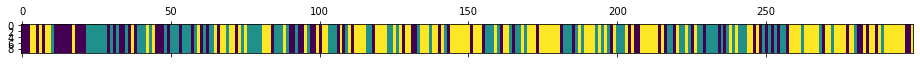

<Figure size 432x288 with 0 Axes>

541
N [[19. 30. 30.]
 [27. 39. 31.]
 [33. 28. 62.]]
alphas [[1.33862237 0.97205782 1.6535862 ]
 [0.61507312 1.69560707 1.6535862 ]
 [0.61507312 0.97205782 2.37713544]]
M [[4. 4. 5.]
 [3. 7. 6.]
 [4. 5. 6.]]
sum_w [[1.]
 [3.]
 [0.]]
barM [[3. 4. 5.]
 [3. 4. 6.]
 [4. 5. 6.]]
pi_z [[0.19169617 0.49114132 0.3171625 ]
 [0.26396699 0.42536732 0.31066569]
 [0.31811274 0.15646605 0.5254212 ]]
beta_vec [0.17449489 0.37944022 0.44606489]
hyper>> a_k: 3.6365067735856376  gamma: 0.31895844072099916  rho: 0.09318992279400111


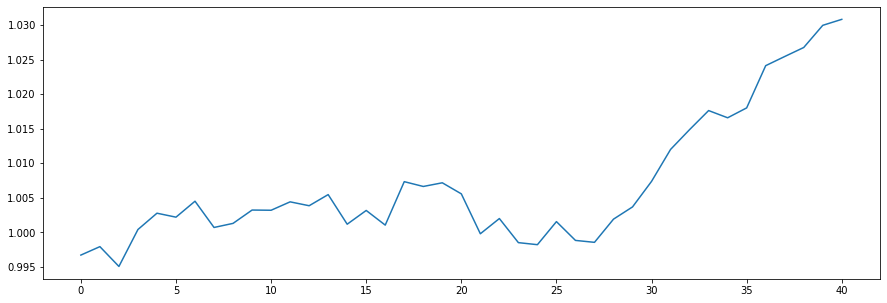

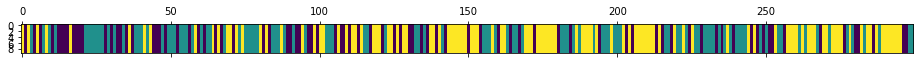

<Figure size 432x288 with 0 Axes>

N [[17. 34. 34.]
 [34. 42. 27.]
 [34. 27. 50.]]
alphas [[0.91430379 1.25125003 1.47095296]
 [0.575418   1.59013581 1.47095296]
 [0.575418   1.25125003 1.80983875]]
M [[5. 5. 2.]
 [1. 4. 6.]
 [3. 2. 8.]]
sum_w [[4.]
 [1.]
 [0.]]
barM [[1. 5. 2.]
 [1. 3. 6.]
 [3. 2. 8.]]
pi_z [[0.23124299 0.42733285 0.34142416]
 [0.25857878 0.35105679 0.39036443]
 [0.3087341  0.24810674 0.44315916]]
beta_vec [0.10822965 0.29238094 0.59938941]
hyper>> a_k: 2.6862179147869854  gamma: 0.4825162791786291  rho: 0.20911509457518432


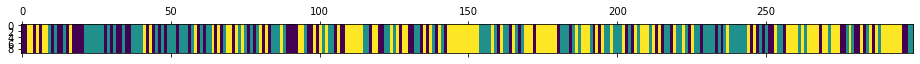

<Figure size 432x288 with 0 Axes>

542
N [[17. 37. 30.]
 [33. 42. 31.]
 [34. 27. 48.]]
alphas [[0.79166143 0.62116015 1.27339634]
 [0.22993272 1.18288886 1.27339634]
 [0.22993272 0.62116015 1.83512505]]
M [[3. 5. 4.]
 [2. 5. 4.]
 [2. 4. 4.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[1. 5. 4.]
 [2. 2. 4.]
 [2. 4. 3.]]
pi_z [[0.16516987 0.50665641 0.32817372]
 [0.29845212 0.44089422 0.26065366]
 [0.34690088 0.28814869 0.36495043]]
beta_vec [0.12933666 0.4124566  0.45820674]
hyper>> a_k: 2.9289982569437827  gamma: 1.2561971009051887  rho: 0.16646503616000563


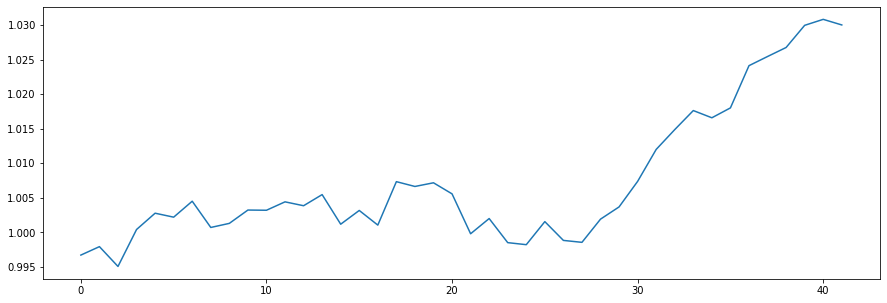

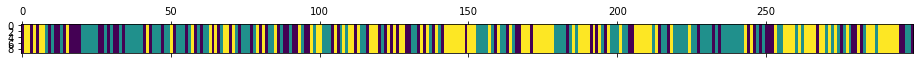

<Figure size 432x288 with 0 Axes>

N [[17. 36. 29.]
 [32. 51. 29.]
 [34. 24. 47.]]
alphas [[0.80334122 1.0069808  1.11867623]
 [0.31576542 1.4945566  1.11867623]
 [0.31576542 1.0069808  1.60625203]]
M [[4. 4. 3.]
 [2. 5. 3.]
 [1. 6. 4.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[1. 4. 3.]
 [2. 4. 3.]
 [1. 6. 3.]]
pi_z [[0.2158853  0.54287372 0.24124098]
 [0.27080901 0.48052011 0.24867089]
 [0.35572601 0.20057695 0.44369704]]
beta_vec [0.19450304 0.56336588 0.24213108]
hyper>> a_k: 1.9680069946217114  gamma: 1.4036491970622513  rho: 0.300006246575326


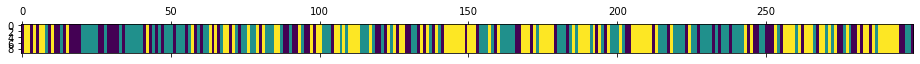

<Figure size 432x288 with 0 Axes>

543
N [[21. 37. 27.]
 [27. 50. 32.]
 [37. 22. 46.]]
alphas [[0.85836034 0.77608867 0.33355798]
 [0.26794595 1.36650307 0.33355798]
 [0.26794595 0.77608867 0.92397237]]
M [[7. 3. 1.]
 [1. 8. 1.]
 [1. 5. 5.]]
sum_w [[6.]
 [3.]
 [3.]]
barM [[1. 3. 1.]
 [1. 5. 1.]
 [1. 5. 2.]]
pi_z [[0.2784971  0.41941012 0.30209277]
 [0.21450599 0.45180088 0.33369313]
 [0.4402726  0.18138648 0.37834092]]
beta_vec [0.1292819  0.78704327 0.08367483]
hyper>> a_k: 2.299237151216793  gamma: 0.898391002086541  rho: 0.35370606021981454


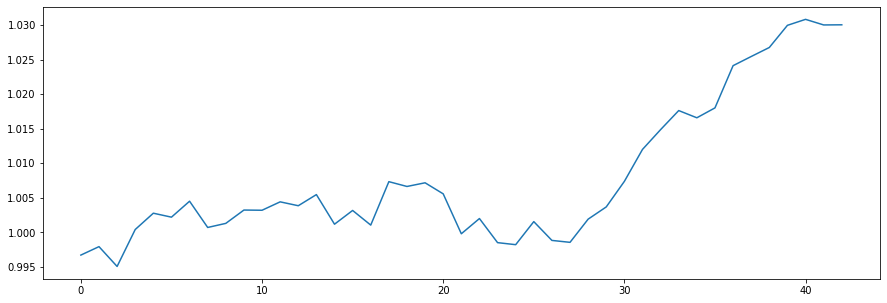

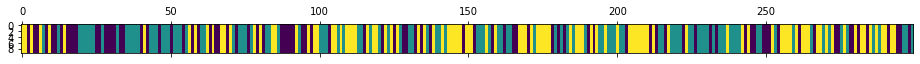

<Figure size 432x288 with 0 Axes>

N [[24. 36. 30.]
 [26. 47. 34.]
 [39. 25. 38.]]
alphas [[1.00536483 1.16953295 0.12433937]
 [0.19211072 1.98278706 0.12433937]
 [0.19211072 1.16953295 0.93759349]]
M [[3. 1. 3.]
 [2. 4. 2.]
 [2. 6. 3.]]
sum_w [[3.]
 [3.]
 [2.]]
barM [[0. 1. 3.]
 [2. 1. 2.]
 [2. 6. 1.]]
pi_z [[0.37113201 0.33735371 0.29151429]
 [0.20705171 0.43088975 0.36205854]
 [0.43227949 0.25929584 0.30842468]]
beta_vec [0.29678038 0.3930073  0.31021233]
hyper>> a_k: 1.79832900282401  gamma: 1.896062054915851  rho: 0.38029087860168237


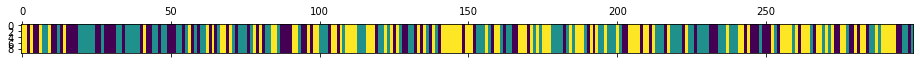

<Figure size 432x288 with 0 Axes>

544
N [[28. 33. 29.]
 [26. 48. 32.]
 [36. 25. 42.]]
alphas [[1.0146323  0.4379834  0.3457133 ]
 [0.33074418 1.12187152 0.3457133 ]
 [0.33074418 0.4379834  1.02960142]]
M [[5. 3. 2.]
 [4. 4. 1.]
 [1. 5. 6.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[2. 3. 2.]
 [4. 1. 1.]
 [1. 5. 1.]]
pi_z [[0.27848286 0.33290101 0.38861614]
 [0.25999021 0.48266102 0.25734877]
 [0.32452783 0.28757439 0.38789779]]
beta_vec [0.46301283 0.43690703 0.10008014]
hyper>> a_k: 2.6964306120020005  gamma: 0.5089091825179135  rho: 0.422136146293711


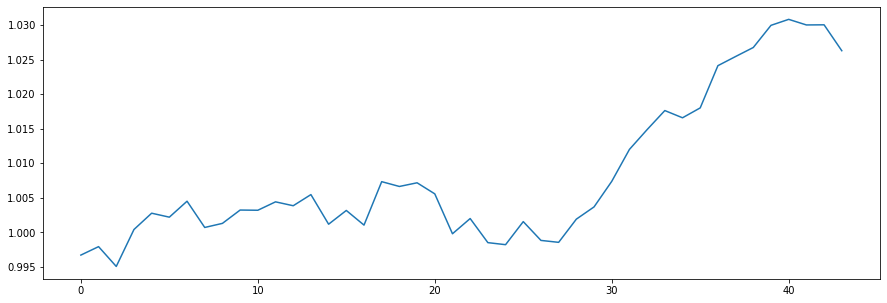

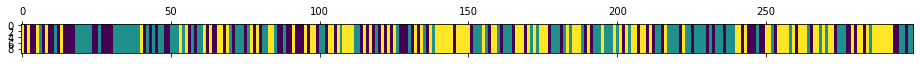

<Figure size 432x288 with 0 Axes>

N [[22. 34. 36.]
 [31. 47. 26.]
 [39. 23. 41.]]
alphas [[1.85971344 0.68077533 0.15594184]
 [0.72145261 1.81903616 0.15594184]
 [0.72145261 0.68077533 1.29420267]]
M [[3. 4. 2.]
 [2. 6. 1.]
 [3. 2. 8.]]
sum_w [[1.]
 [4.]
 [6.]]
barM [[2. 4. 2.]
 [2. 2. 1.]
 [3. 2. 2.]]
pi_z [[0.21186409 0.38099672 0.4071392 ]
 [0.31996526 0.45523946 0.22479528]
 [0.38922068 0.21011858 0.40066074]]
beta_vec [0.28429907 0.41180179 0.30389914]
hyper>> a_k: 3.028030862455596  gamma: 1.877859761679539  rho: 0.37652298886244284


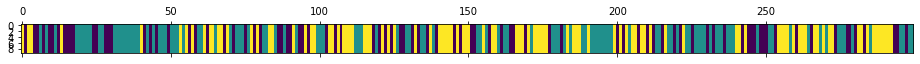

<Figure size 432x288 with 0 Axes>

545
N [[20. 37. 32.]
 [34. 55. 23.]
 [35. 20. 43.]]
alphas [[1.67685362 0.77744374 0.57373351]
 [0.53673039 1.91756697 0.57373351]
 [0.53673039 0.77744374 1.71385674]]
M [[4. 2. 4.]
 [2. 7. 3.]
 [2. 3. 6.]]
sum_w [[1.]
 [1.]
 [4.]]
barM [[3. 2. 4.]
 [2. 6. 3.]
 [2. 3. 2.]]
pi_z [[0.15449673 0.32435662 0.52114665]
 [0.24850867 0.560498   0.19099333]
 [0.37158558 0.22650092 0.4019135 ]]
beta_vec [0.28236098 0.45769786 0.25994116]
hyper>> a_k: 2.3439040532343216  gamma: 0.32251975103793923  rho: 0.15223985011569552


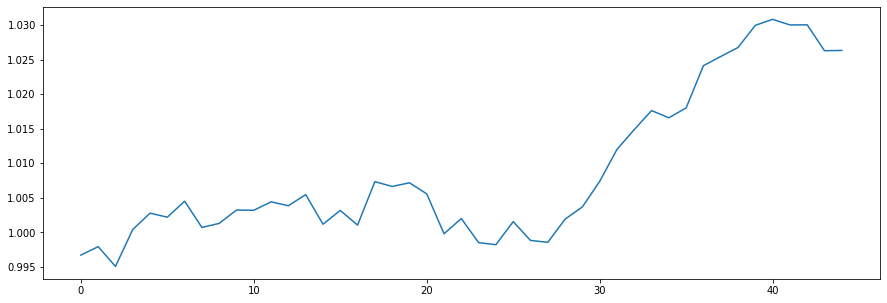

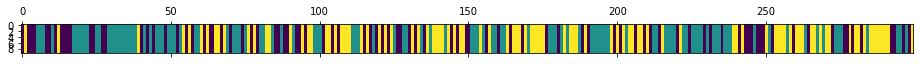

<Figure size 432x288 with 0 Axes>

N [[20. 34. 38.]
 [31. 57. 23.]
 [40. 20. 36.]]
alphas [[0.9179062  0.90947698 0.51652087]
 [0.5610706  1.26631258 0.51652087]
 [0.5610706  0.90947698 0.87335647]]
M [[4. 4. 3.]
 [3. 6. 4.]
 [2. 5. 3.]]
sum_w [[3.]
 [2.]
 [0.]]
barM [[1. 4. 3.]
 [3. 4. 4.]
 [2. 5. 3.]]
pi_z [[0.22518303 0.29487089 0.47994607]
 [0.19802125 0.55780785 0.2441709 ]
 [0.41098998 0.21091351 0.37809651]]
beta_vec [0.18999093 0.49934263 0.31066644]
hyper>> a_k: 2.9822193837801656  gamma: 1.0080135009944227  rho: 0.18677186379883565


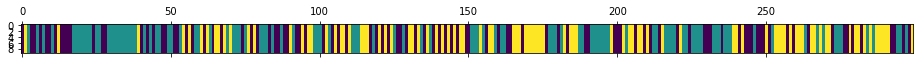

<Figure size 432x288 with 0 Axes>

546
N [[25. 38. 36.]
 [32. 54. 22.]
 [42. 16. 34.]]
alphas [[1.01776537 1.21101809 0.75343592]
 [0.4607707  1.76801276 0.75343592]
 [0.4607707  1.21101809 1.3104306 ]]
M [[4. 5. 1.]
 [1. 7. 3.]
 [4. 3. 6.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[3. 5. 1.]
 [1. 5. 3.]
 [4. 3. 5.]]
pi_z [[0.22953709 0.42191577 0.34854714]
 [0.26732828 0.53218357 0.20048815]
 [0.50052009 0.20427603 0.29520387]]
beta_vec [0.20508229 0.46982132 0.32509639]
hyper>> a_k: 2.607564970027044  gamma: 1.4131650512500424  rho: 0.07005270041404345


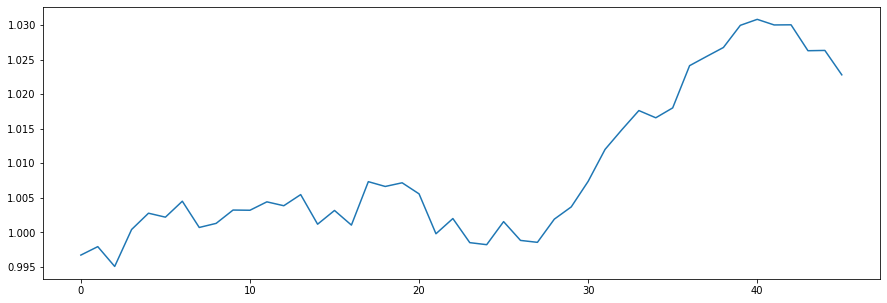

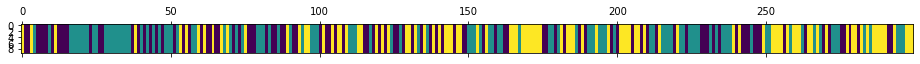

<Figure size 432x288 with 0 Axes>

N [[29. 38. 34.]
 [31. 49. 25.]
 [41. 18. 34.]]
alphas [[0.67997061 1.13926878 0.78832558]
 [0.49730365 1.32193575 0.78832558]
 [0.49730365 1.13926878 0.97099254]]
M [[2. 7. 4.]
 [3. 3. 2.]
 [2. 3. 3.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[2. 7. 4.]
 [3. 2. 2.]
 [2. 3. 2.]]
pi_z [[0.27795248 0.4175687  0.30447881]
 [0.25491067 0.37552604 0.3695633 ]
 [0.42253732 0.17989258 0.3975701 ]]
beta_vec [0.32883767 0.34248198 0.32868035]
hyper>> a_k: 2.6518449651404277  gamma: 0.570485444016255  rho: 0.23795770048012993


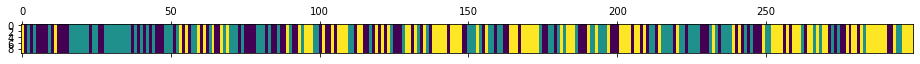

<Figure size 432x288 with 0 Axes>

547
N [[33. 39. 28.]
 [32. 45. 25.]
 [35. 18. 44.]]
alphas [[1.29554802 0.69209376 0.66420319]
 [0.66452109 1.32312069 0.66420319]
 [0.66452109 0.69209376 1.29523012]]
M [[4. 6. 1.]
 [2. 3. 2.]
 [4. 3. 5.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[3. 6. 1.]
 [2. 1. 2.]
 [4. 3. 5.]]
pi_z [[0.33628154 0.31372997 0.34998849]
 [0.35326606 0.38631867 0.26041527]
 [0.46381983 0.1249152  0.41126497]]
beta_vec [0.32947089 0.38429879 0.28623032]
hyper>> a_k: 1.6653305115294417  gamma: 0.576455828991712  rho: 0.07900339838070936


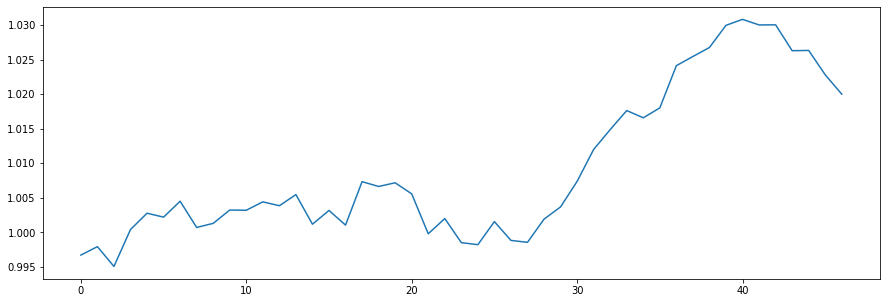

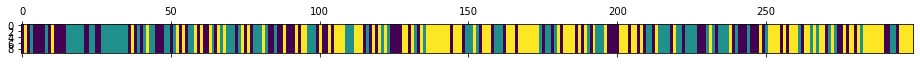

<Figure size 432x288 with 0 Axes>

N [[30. 31. 36.]
 [27. 44. 23.]
 [40. 19. 49.]]
alphas [[0.63689727 0.58942356 0.43900968]
 [0.5053305  0.72099033 0.43900968]
 [0.5053305  0.58942356 0.57057645]]
M [[4. 5. 2.]
 [3. 3. 2.]
 [4. 4. 2.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[4. 5. 2.]
 [3. 2. 2.]
 [4. 4. 1.]]
pi_z [[0.34401029 0.35572989 0.30025983]
 [0.28761341 0.50885152 0.20353507]
 [0.37757215 0.23925435 0.38317349]]
beta_vec [0.44823244 0.40751799 0.14424956]
hyper>> a_k: 3.2863894931432687  gamma: 0.7052962149508888  rho: 0.1276872894534536


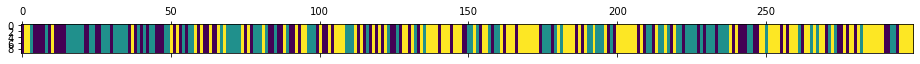

<Figure size 432x288 with 0 Axes>

548
N [[23. 32. 36.]
 [28. 45. 24.]
 [40. 20. 51.]]
alphas [[1.70460471 1.16825601 0.41352878]
 [1.28497454 1.58788617 0.41352878]
 [1.28497454 1.16825601 0.83315895]]
M [[7. 6. 1.]
 [5. 8. 2.]
 [4. 3. 3.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[6. 6. 1.]
 [5. 7. 2.]
 [4. 3. 2.]]
pi_z [[0.22613126 0.40824877 0.36561997]
 [0.18583178 0.45236361 0.36180461]
 [0.41083974 0.17747042 0.41168983]]
beta_vec [0.35713193 0.4730685  0.16979957]
hyper>> a_k: 2.6259043351009166  gamma: 0.362135948350155  rho: 0.06675922848283847


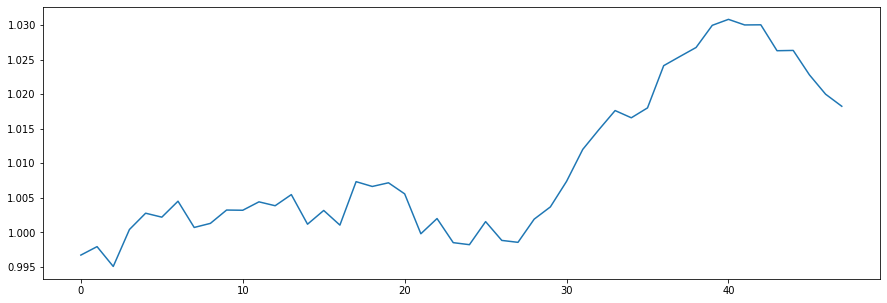

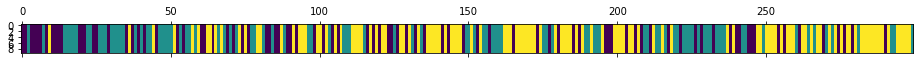

<Figure size 432x288 with 0 Axes>

N [[20. 32. 36.]
 [27. 43. 26.]
 [41. 22. 52.]]
alphas [[1.05049121 1.15930213 0.41611099]
 [0.87518787 1.33460548 0.41611099]
 [0.87518787 1.15930213 0.59141434]]
M [[3. 4. 2.]
 [2. 5. 3.]
 [3. 3. 2.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[3. 4. 2.]
 [2. 4. 3.]
 [3. 3. 1.]]
pi_z [[0.19830608 0.43978436 0.36190956]
 [0.28987218 0.38746534 0.32266248]
 [0.34945396 0.23456075 0.41598528]]
beta_vec [0.42652922 0.4311642  0.14230659]
hyper>> a_k: 3.8338077301923943  gamma: 1.5325835025778154  rho: 0.08855942565362494


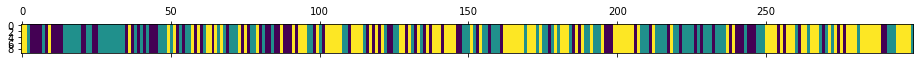

<Figure size 432x288 with 0 Axes>

549
N [[23. 33. 27.]
 [27. 50. 29.]
 [33. 23. 54.]]
alphas [[1.8299357  1.50661185 0.49726019]
 [1.49041589 1.84613166 0.49726019]
 [1.49041589 1.50661185 0.83678   ]]
M [[6. 5. 1.]
 [4. 8. 1.]
 [5. 5. 1.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[5. 5. 1.]
 [4. 6. 1.]
 [5. 5. 1.]]
pi_z [[0.27400932 0.41355407 0.31243661]
 [0.19900273 0.50353972 0.29745754]
 [0.26001321 0.18693649 0.55305029]]
beta_vec [0.62824008 0.32437086 0.04738905]
hyper>> a_k: 2.312945099953452  gamma: 1.3323929866774011  rho: 0.03208903033290599


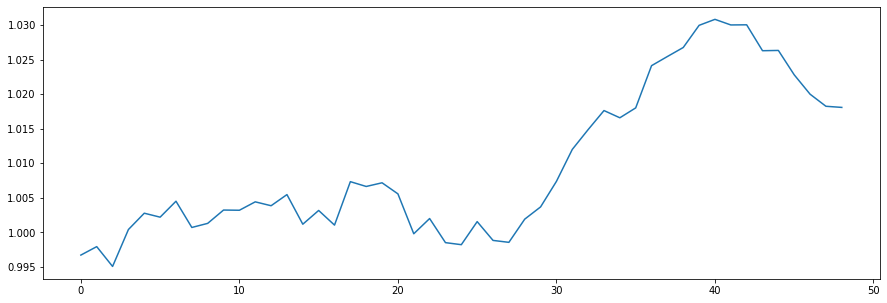

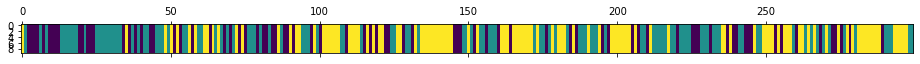

<Figure size 432x288 with 0 Axes>

N [[22. 34. 25.]
 [30. 51. 28.]
 [29. 24. 56.]]
alphas [[1.48067691 0.72617714 0.10609106]
 [1.40645674 0.8003973  0.10609106]
 [1.40645674 0.72617714 0.18031122]]
M [[3. 1. 1.]
 [4. 3. 1.]
 [2. 3. 3.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[3. 1. 1.]
 [4. 3. 1.]
 [2. 3. 2.]]
pi_z [[0.2050649  0.49006274 0.30487236]
 [0.31583627 0.46730545 0.21685828]
 [0.31374473 0.23522407 0.4510312 ]]
beta_vec [0.58491165 0.27310083 0.14198752]
hyper>> a_k: 1.5425377869166619  gamma: 1.6863375489272476  rho: 0.03314869447373514


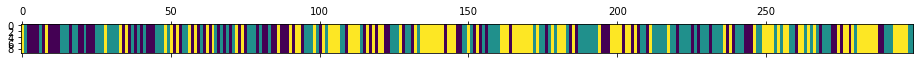

<Figure size 432x288 with 0 Axes>

550
N [[23. 32. 31.]
 [33. 54. 24.]
 [30. 25. 47.]]
alphas [[0.92347308 0.40730385 0.21176086]
 [0.87233997 0.45843696 0.21176086]
 [0.87233997 0.40730385 0.26289397]]
M [[2. 2. 1.]
 [5. 4. 2.]
 [3. 1. 1.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[2. 2. 1.]
 [5. 3. 2.]
 [3. 1. 1.]]
pi_z [[0.24266448 0.40952545 0.34781007]
 [0.31670781 0.44613378 0.23715841]
 [0.33837179 0.19957223 0.46205598]]
beta_vec [0.63319076 0.2350349  0.13177434]
hyper>> a_k: 1.6615355323030159  gamma: 0.9279418950937528  rho: 0.16125288101631696


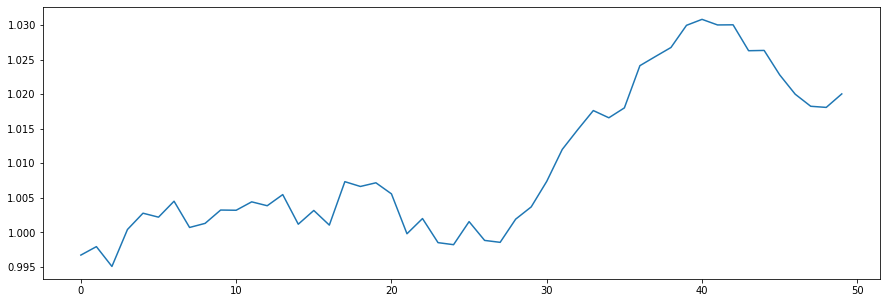

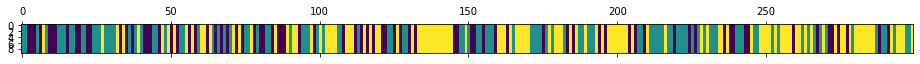

<Figure size 432x288 with 0 Axes>

N [[17. 32. 31.]
 [32. 45. 31.]
 [31. 30. 50.]]
alphas [[1.15034718 0.32754655 0.1836418 ]
 [0.88241979 0.59547394 0.1836418 ]
 [0.88241979 0.32754655 0.45156919]]
M [[3. 1. 3.]
 [2. 3. 4.]
 [4. 2. 3.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[3. 1. 3.]
 [2. 3. 4.]
 [4. 2. 2.]]
pi_z [[0.295503   0.27844774 0.42604927]
 [0.31525987 0.376348   0.30839213]
 [0.23259654 0.31893136 0.44847209]]
beta_vec [0.42652876 0.17518596 0.39828528]
hyper>> a_k: 1.594429070727158  gamma: 0.8877256607672108  rho: 0.07556132997606947


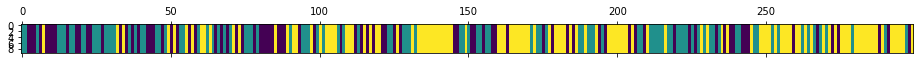

<Figure size 432x288 with 0 Axes>

551
N [[22. 32. 31.]
 [36. 38. 26.]
 [27. 30. 57.]]
alphas [[0.74916005 0.25821567 0.58705335]
 [0.62868287 0.37869285 0.58705335]
 [0.62868287 0.25821567 0.70753053]]
M [[1. 4. 1.]
 [6. 3. 4.]
 [6. 1. 3.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[1. 4. 1.]
 [6. 2. 4.]
 [6. 1. 2.]]
pi_z [[0.25863656 0.45963609 0.28172735]
 [0.35798952 0.42904028 0.2129702 ]
 [0.20686478 0.26123649 0.53189873]]
beta_vec [0.47455568 0.24446153 0.2809828 ]
hyper>> a_k: 2.366038462609978  gamma: 0.546319786712756  rho: 0.11361308416731618


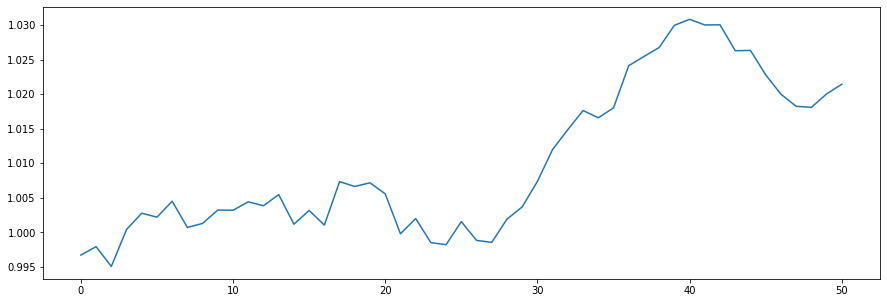

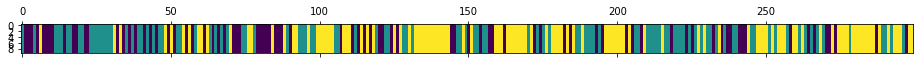

<Figure size 432x288 with 0 Axes>

N [[22. 37. 24.]
 [33. 41. 31.]
 [28. 27. 56.]]
alphas [[1.26406321 0.51269095 0.5892843 ]
 [0.99525029 0.78150388 0.5892843 ]
 [0.99525029 0.51269095 0.85809722]]
M [[4. 1. 2.]
 [6. 3. 3.]
 [4. 2. 4.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[3. 1. 2.]
 [6. 3. 3.]
 [4. 2. 3.]]
pi_z [[0.20736759 0.52452271 0.26810969]
 [0.3043321  0.33266158 0.36300632]
 [0.29225123 0.19810427 0.50964449]]
beta_vec [0.40584147 0.34585954 0.24829899]
hyper>> a_k: 2.709534448205562  gamma: 0.30553088575309456  rho: 0.04900392013606392


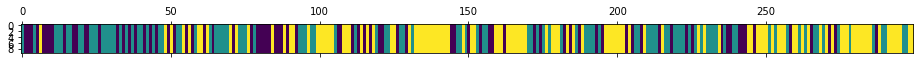

<Figure size 432x288 with 0 Axes>

552
N [[20. 36. 26.]
 [34. 45. 27.]
 [28. 25. 58.]]
alphas [[1.17853252 0.89119587 0.63980606]
 [1.04575471 1.02397368 0.63980606]
 [1.04575471 0.89119587 0.77258387]]
M [[4. 2. 4.]
 [7. 3. 3.]
 [5. 3. 4.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[4. 2. 4.]
 [7. 3. 3.]
 [5. 3. 3.]]
pi_z [[0.22871587 0.45777991 0.31350422]
 [0.32742803 0.44366636 0.22890561]
 [0.23373784 0.14825832 0.61800384]]
beta_vec [0.46024661 0.25577952 0.28397387]
hyper>> a_k: 3.7307458558704822  gamma: 0.1566914495117363  rho: 0.09020469892810584


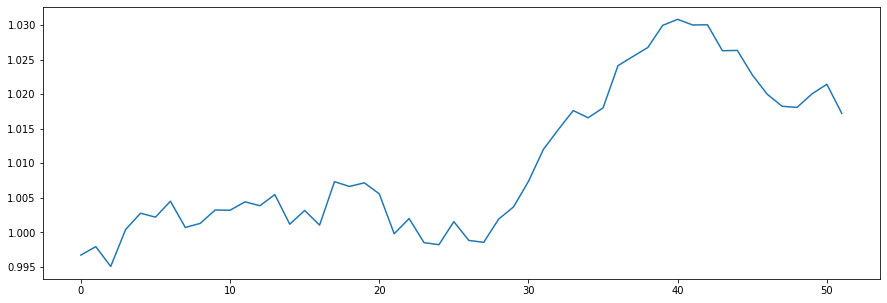

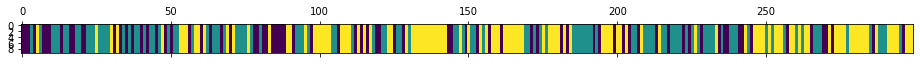

<Figure size 432x288 with 0 Axes>

N [[17. 39. 23.]
 [32. 48. 29.]
 [30. 22. 59.]]
alphas [[1.89870679 0.86817068 0.96386839]
 [1.56217598 1.20470149 0.96386839]
 [1.56217598 0.86817068 1.30039919]]
M [[4. 2. 6.]
 [4. 5. 5.]
 [3. 2. 9.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[3. 2. 6.]
 [4. 4. 5.]
 [3. 2. 6.]]
pi_z [[0.17812246 0.49989418 0.32198336]
 [0.31703418 0.45959273 0.22337309]
 [0.24248326 0.25372413 0.50379261]]
beta_vec [0.32362521 0.17305168 0.50332311]
hyper>> a_k: 3.1750734632640167  gamma: 0.721761339829562  rho: 0.1705112469422799


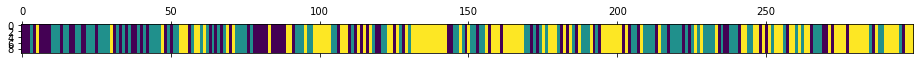

<Figure size 432x288 with 0 Axes>

553
N [[19. 38. 25.]
 [34. 44. 27.]
 [29. 23. 60.]]
alphas [[1.39371347 0.45576408 1.32559591]
 [0.85232774 0.99714982 1.32559591]
 [0.85232774 0.45576408 1.86698164]]
M [[7. 4. 2.]
 [4. 3. 4.]
 [1. 4. 5.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[5. 4. 2.]
 [4. 3. 4.]
 [1. 4. 4.]]
pi_z [[0.28430191 0.50699554 0.20870256]
 [0.23903794 0.54509202 0.21587004]
 [0.22041549 0.22194519 0.55763932]]
beta_vec [0.31959516 0.42548551 0.25491933]
hyper>> a_k: 2.604059702886651  gamma: 0.21694756129442314  rho: 0.09649595423078981


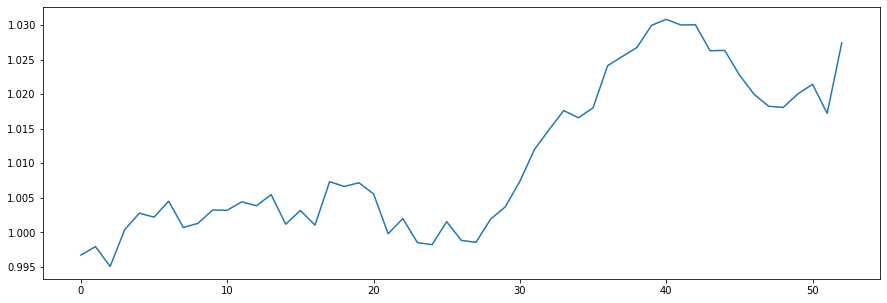

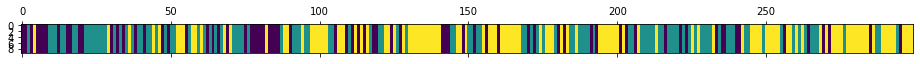

<Figure size 432x288 with 0 Axes>

N [[18. 33. 23.]
 [33. 48. 29.]
 [23. 29. 63.]]
alphas [[1.00321783 1.00107315 0.59976872]
 [0.75193661 1.25235438 0.59976872]
 [0.75193661 1.00107315 0.85104994]]
M [[2. 1. 3.]
 [4. 5. 3.]
 [1. 1. 3.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[1. 1. 3.]
 [4. 5. 3.]
 [1. 1. 2.]]
pi_z [[0.16463397 0.53318078 0.30218525]
 [0.32735196 0.42381747 0.24883057]
 [0.18178623 0.30853514 0.50967863]]
beta_vec [0.19118932 0.45496478 0.3538459 ]
hyper>> a_k: 1.797196133486405  gamma: 0.3859594799735886  rho: 0.061167168986944714


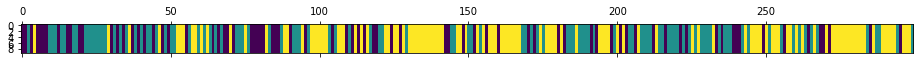

<Figure size 432x288 with 0 Axes>

554
N [[17. 36. 25.]
 [38. 40. 28.]
 [23. 30. 62.]]
alphas [[0.43251679 0.76764694 0.59703241]
 [0.32258739 0.87757634 0.59703241]
 [0.32258739 0.76764694 0.70696181]]
M [[2. 3. 1.]
 [1. 3. 5.]
 [5. 2. 5.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[1. 3. 1.]
 [1. 2. 5.]
 [5. 2. 4.]]
pi_z [[0.1928955  0.49213185 0.31497265]
 [0.34429945 0.38787171 0.26782884]
 [0.22513708 0.20024852 0.57461439]]
beta_vec [0.2965248  0.38237226 0.32110295]
hyper>> a_k: 2.009896477118191  gamma: 0.7542469517144007  rho: 0.06517129950390782


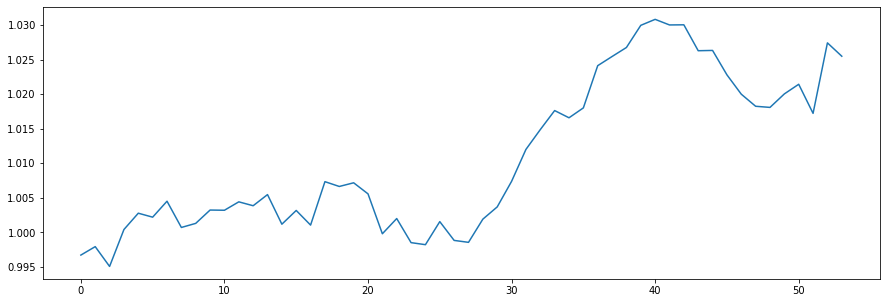

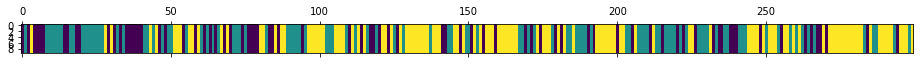

<Figure size 432x288 with 0 Axes>

N [[20. 36. 23.]
 [30. 45. 29.]
 [29. 22. 65.]]
alphas [[0.68813065 0.71844264 0.60332319]
 [0.55714308 0.84943021 0.60332319]
 [0.55714308 0.71844264 0.73431075]]
M [[4. 4. 4.]
 [3. 4. 3.]
 [4. 3. 2.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[4. 4. 4.]
 [3. 3. 3.]
 [4. 3. 2.]]
pi_z [[0.21716213 0.53677363 0.24606424]
 [0.30716733 0.42184503 0.27098765]
 [0.27729032 0.1800797  0.54262998]]
beta_vec [0.3405461  0.32747398 0.33197992]
hyper>> a_k: 3.5290716046619073  gamma: 1.094035908261805  rho: 0.09235707082086443


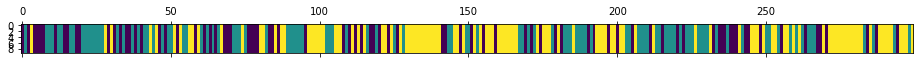

<Figure size 432x288 with 0 Axes>

555
N [[20. 39. 23.]
 [28. 47. 30.]
 [34. 19. 59.]]
alphas [[1.41675049 1.04894398 1.06337713]
 [1.09081578 1.37487869 1.06337713]
 [1.09081578 1.04894398 1.38931185]]
M [[3. 3. 4.]
 [7. 4. 2.]
 [5. 2. 5.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[1. 3. 4.]
 [7. 2. 2.]
 [5. 2. 4.]]
pi_z [[0.24793621 0.44669561 0.30536818]
 [0.24426209 0.44715639 0.30858152]
 [0.33433208 0.16751169 0.49815623]]
beta_vec [0.43814527 0.34288197 0.21897276]
hyper>> a_k: 1.92139625349009  gamma: 0.3975800495613156  rho: 0.06175214070743257


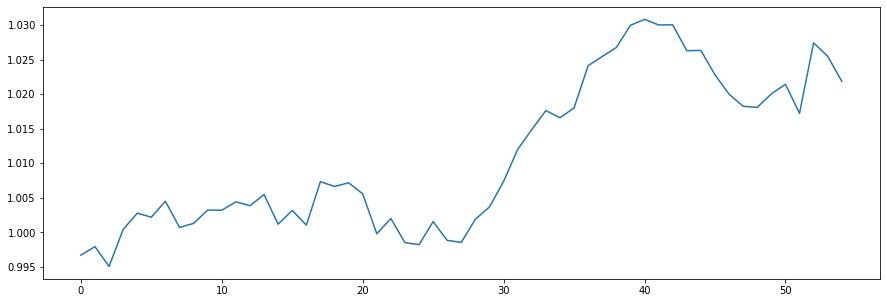

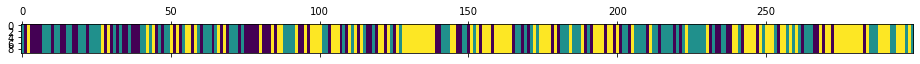

<Figure size 432x288 with 0 Axes>

N [[21. 33. 32.]
 [32. 47. 23.]
 [33. 23. 55.]]
alphas [[0.90851493 0.61812907 0.39475226]
 [0.78986459 0.7367794  0.39475226]
 [0.78986459 0.61812907 0.51340259]]
M [[3. 2. 1.]
 [3. 3. 2.]
 [3. 4. 1.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[3. 2. 1.]
 [3. 2. 2.]
 [3. 4. 1.]]
pi_z [[0.26847652 0.33294207 0.3985814 ]
 [0.35038971 0.47199392 0.17761637]
 [0.28542379 0.22877503 0.48580118]]
beta_vec [0.43030639 0.29150996 0.27818364]
hyper>> a_k: 1.564924463698211  gamma: 0.0632215612573475  rho: 0.08297277338462808


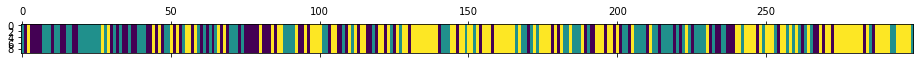

<Figure size 432x288 with 0 Axes>

556
N [[22. 31. 33.]
 [28. 39. 27.]
 [36. 24. 59.]]
alphas [[0.74736951 0.41833963 0.39921532]
 [0.61752339 0.54818575 0.39921532]
 [0.61752339 0.41833963 0.52906145]]
M [[4. 3. 3.]
 [3. 3. 2.]
 [2. 1. 3.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[2. 3. 3.]
 [3. 3. 2.]
 [2. 1. 2.]]
pi_z [[0.2371217  0.46320008 0.29967822]
 [0.31053944 0.44198209 0.24747847]
 [0.33592091 0.22042511 0.44365398]]
beta_vec [0.35868008 0.43883227 0.20248764]
hyper>> a_k: 1.5035381734071824  gamma: 2.94177140678264  rho: 0.2750959615303608


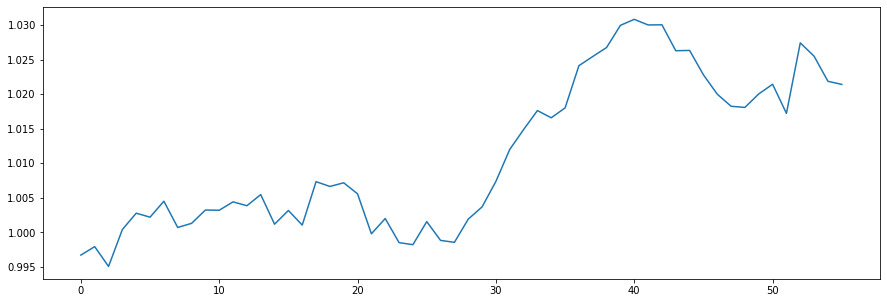

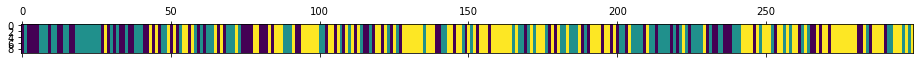

<Figure size 432x288 with 0 Axes>

N [[21. 33. 31.]
 [28. 42. 29.]
 [36. 23. 56.]]
alphas [[0.8045502  0.47829246 0.22069551]
 [0.39093292 0.89190974 0.22069551]
 [0.39093292 0.47829246 0.63431279]]
M [[4. 6. 1.]
 [1. 4. 2.]
 [3. 3. 2.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[3. 6. 1.]
 [1. 2. 2.]
 [3. 3. 0.]]
pi_z [[0.21997294 0.40896067 0.37106639]
 [0.31803157 0.34210407 0.33986436]
 [0.28189413 0.22863523 0.48947064]]
beta_vec [0.4267035  0.44894118 0.12435532]
hyper>> a_k: 1.847065633861723  gamma: 1.7329393181592416  rho: 0.18020295381707707


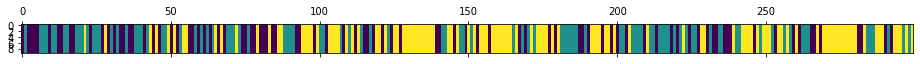

<Figure size 432x288 with 0 Axes>

557
N [[22. 38. 30.]
 [32. 39. 25.]
 [36. 19. 58.]]
alphas [[0.97896922 0.67979524 0.18830118]
 [0.64612253 1.01264193 0.18830118]
 [0.64612253 0.67979524 0.52114786]]
M [[5. 4. 2.]
 [5. 5. 1.]
 [4. 2. 4.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[4. 4. 2.]
 [5. 4. 1.]
 [4. 2. 1.]]
pi_z [[0.20960492 0.36527045 0.42512463]
 [0.40331441 0.39962959 0.19705599]
 [0.28712949 0.20612217 0.50674834]]
beta_vec [0.4967837  0.264379   0.23883731]
hyper>> a_k: 3.037085121354707  gamma: 1.1640537237445259  rho: 0.2593213432017878


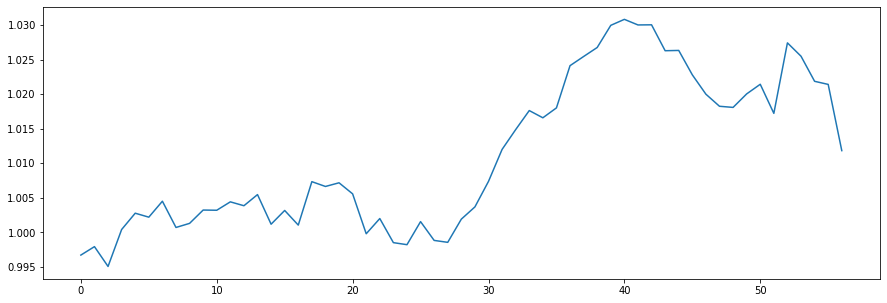

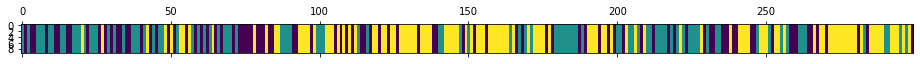

<Figure size 432x288 with 0 Axes>

N [[23. 37. 32.]
 [36. 39. 20.]
 [34. 19. 59.]]
alphas [[1.90509797 0.59472165 0.53726551]
 [1.11751698 1.38230264 0.53726551]
 [1.11751698 0.59472165 1.3248465 ]]
M [[6. 2. 2.]
 [6. 5. 2.]
 [3. 2. 5.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[4. 2. 2.]
 [6. 3. 2.]
 [3. 2. 2.]]
pi_z [[0.22050118 0.36672862 0.41277019]
 [0.39283227 0.40966884 0.1974989 ]
 [0.41161472 0.17276929 0.41561599]]
beta_vec [0.32654177 0.40647458 0.26698365]
hyper>> a_k: 3.564999893708079  gamma: 1.0305910380118213  rho: 0.20848606263891253


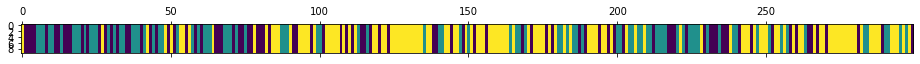

<Figure size 432x288 with 0 Axes>

558
N [[24. 33. 33.]
 [30. 35. 25.]
 [36. 22. 61.]]
alphas [[1.66467109 1.14696846 0.75336035]
 [0.9214183  1.89022125 0.75336035]
 [0.9214183  1.14696846 1.49661314]]
M [[4. 5. 3.]
 [5. 4. 5.]
 [3. 6. 8.]]
sum_w [[2.]
 [1.]
 [6.]]
barM [[2. 5. 3.]
 [5. 3. 5.]
 [3. 6. 2.]]
pi_z [[0.23936714 0.41256682 0.34806604]
 [0.32113838 0.43846726 0.24039436]
 [0.36221733 0.19390809 0.44387458]]
beta_vec [0.34879815 0.33492874 0.31627311]
hyper>> a_k: 5.302463637201708  gamma: 0.33095240646792673  rho: 0.27318862775852254


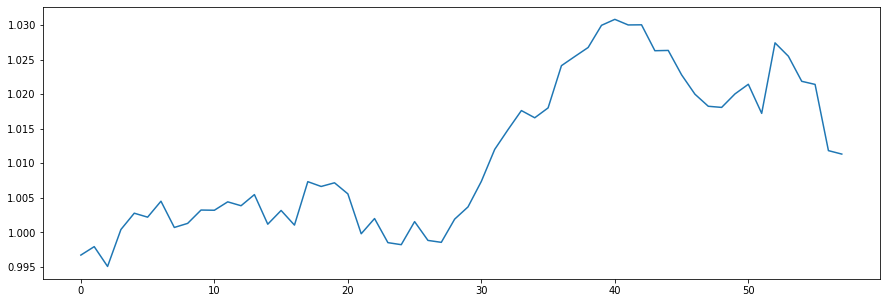

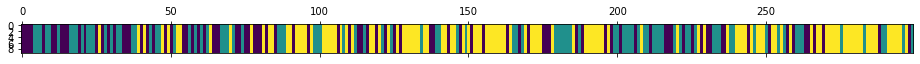

<Figure size 432x288 with 0 Axes>

N [[24. 33. 34.]
 [34. 38. 21.]
 [32. 23. 60.]]
alphas [[2.79280276 1.29077883 1.21888204]
 [1.34423    2.7393516  1.21888204]
 [1.34423    1.29077883 2.66745481]]
M [[7. 6. 7.]
 [4. 9. 1.]
 [5. 4. 6.]]
sum_w [[4.]
 [6.]
 [4.]]
barM [[3. 6. 7.]
 [4. 3. 1.]
 [5. 4. 2.]]
pi_z [[0.37247364 0.30378181 0.32374454]
 [0.43435843 0.30081254 0.26482903]
 [0.32507134 0.16194362 0.51298503]]
beta_vec [0.43804563 0.35127715 0.21067722]
hyper>> a_k: 4.7202219924841575  gamma: 0.38608616184478156  rho: 0.3626961512680453


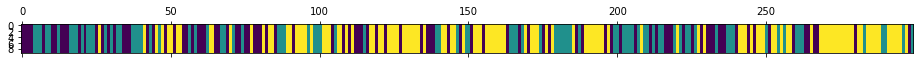

<Figure size 432x288 with 0 Axes>

559
N [[27. 33. 35.]
 [35. 37. 16.]
 [33. 18. 65.]]
alphas [[3.02974207 1.05671742 0.6337625 ]
 [1.31773572 2.76872377 0.6337625 ]
 [1.31773572 1.05671742 2.34576885]]
M [[7. 5. 1.]
 [4. 8. 3.]
 [4. 3. 9.]]
sum_w [[3.]
 [5.]
 [4.]]
barM [[4. 5. 1.]
 [4. 3. 3.]
 [4. 3. 5.]]
pi_z [[0.27124332 0.38264912 0.34610756]
 [0.30563451 0.55376464 0.14060085]
 [0.28787444 0.12331542 0.58881014]]
beta_vec [0.36911875 0.39451079 0.23637046]
hyper>> a_k: 4.201499924981966  gamma: 0.5732842544768779  rho: 0.3147812091330352


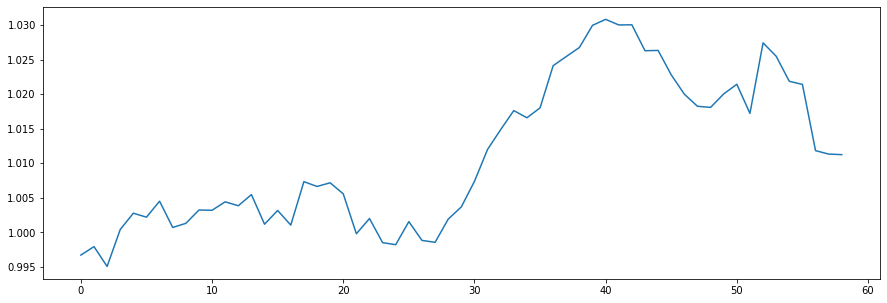

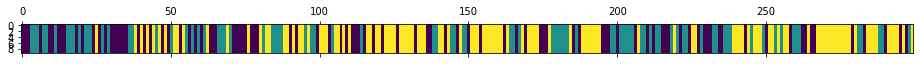

<Figure size 432x288 with 0 Axes>

N [[32. 31. 35.]
 [30. 38. 19.]
 [36. 17. 61.]]
alphas [[2.38522645 1.13577553 0.68049794]
 [1.06267322 2.45832876 0.68049794]
 [1.06267322 1.13577553 2.00305117]]
M [[7. 3. 2.]
 [5. 8. 5.]
 [3. 1. 6.]]
sum_w [[4.]
 [5.]
 [4.]]
barM [[3. 3. 2.]
 [5. 3. 5.]
 [3. 1. 2.]]
pi_z [[0.30659971 0.28306559 0.41033471]
 [0.30943078 0.46050393 0.23006529]
 [0.3394743  0.1622055  0.4983202 ]]
beta_vec [0.52949611 0.14297875 0.32752514]
hyper>> a_k: 3.454813079404333  gamma: 0.40697228413416275  rho: 0.34892780806469814


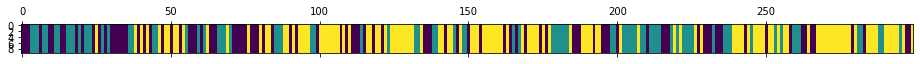

<Figure size 432x288 with 0 Axes>

560
N [[35. 22. 38.]
 [24. 41. 18.]
 [36. 20. 65.]]
alphas [[2.39649329 0.32160678 0.73671302]
 [1.19101293 1.52708713 0.73671302]
 [1.19101293 0.32160678 1.94219337]]
M [[10.  2.  4.]
 [ 8.  6.  2.]
 [ 4.  3.  7.]]
sum_w [[4.]
 [4.]
 [7.]]
barM [[6. 2. 4.]
 [8. 2. 2.]
 [4. 3. 0.]]
pi_z [[0.39259559 0.18580926 0.42159515]
 [0.31499145 0.47174569 0.21326286]
 [0.29772123 0.20291145 0.49936732]]
beta_vec [0.49172509 0.26250872 0.24576619]
hyper>> a_k: 4.5123593312512025  gamma: 0.7818772122557265  rho: 0.3274611470993151


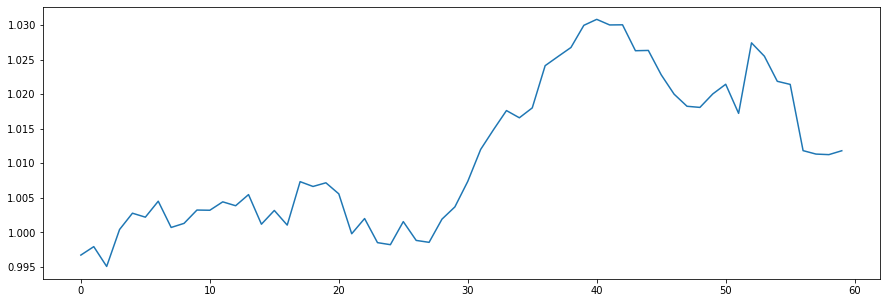

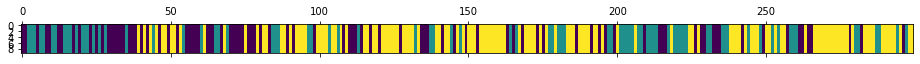

<Figure size 432x288 with 0 Axes>

N [[33. 24. 36.]
 [24. 36. 21.]
 [36. 21. 68.]]
alphas [[2.96987867 0.79664493 0.74583574]
 [1.4922563  2.27426729 0.74583574]
 [1.4922563  0.79664493 2.2234581 ]]
M [[9. 4. 5.]
 [4. 7. 2.]
 [4. 2. 5.]]
sum_w [[6.]
 [4.]
 [2.]]
barM [[3. 4. 5.]
 [4. 3. 2.]
 [4. 2. 3.]]
pi_z [[0.34304114 0.27500305 0.38195581]
 [0.36617563 0.4248459  0.20897847]
 [0.32322427 0.17591341 0.50086232]]
beta_vec [0.43552162 0.28987314 0.27460524]
hyper>> a_k: 3.7807548602919483  gamma: 0.44158933215870166  rho: 0.3734994852574075


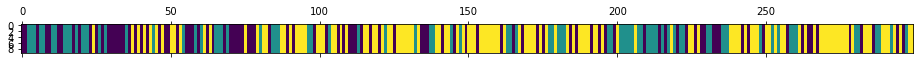

<Figure size 432x288 with 0 Axes>

561
N [[24. 26. 46.]
 [28. 35. 19.]
 [44. 21. 56.]]
alphas [[2.44370605 0.68660652 0.65044229]
 [1.03159606 2.09871652 0.65044229]
 [1.03159606 0.68660652 2.06255228]]
M [[5. 3. 2.]
 [2. 9. 2.]
 [3. 4. 6.]]
sum_w [[4.]
 [5.]
 [5.]]
barM [[1. 3. 2.]
 [2. 4. 2.]
 [3. 4. 1.]]
pi_z [[0.19556716 0.23007634 0.5743565 ]
 [0.38975022 0.4325087  0.17774108]
 [0.32590031 0.17518133 0.49891836]]
beta_vec [0.396107   0.50334713 0.10054587]
hyper>> a_k: 2.9499990186667544  gamma: 0.3424051985541683  rho: 0.4589537575298856


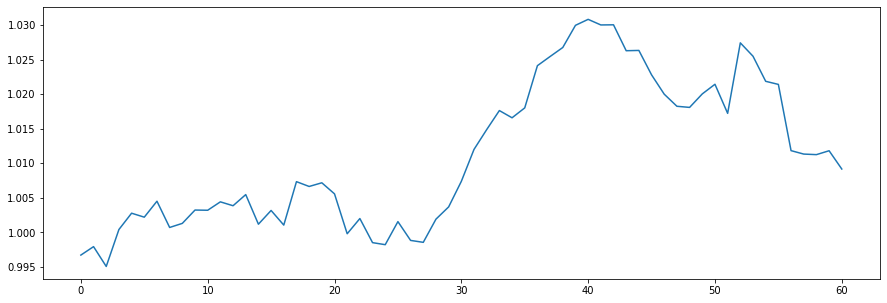

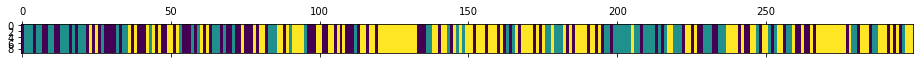

<Figure size 432x288 with 0 Axes>

N [[26. 26. 47.]
 [30. 36. 14.]
 [43. 18. 59.]]
alphas [[1.98613393 0.80338526 0.16047984]
 [0.63222079 2.15729839 0.16047984]
 [0.63222079 0.80338526 1.51439297]]
M [[6. 4. 1.]
 [3. 4. 1.]
 [1. 3. 6.]]
sum_w [[5.]
 [3.]
 [5.]]
barM [[1. 4. 1.]
 [3. 1. 1.]
 [1. 3. 1.]]
pi_z [[0.27296553 0.22483691 0.50219756]
 [0.38024633 0.48429139 0.13546227]
 [0.41729659 0.13802201 0.44468141]]
beta_vec [0.37580501 0.30295483 0.32124016]
hyper>> a_k: 2.982124632303425  gamma: 0.2432517965574796  rho: 0.43535634622595953


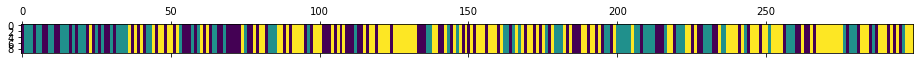

<Figure size 432x288 with 0 Axes>

562
N [[27. 28. 48.]
 [28. 37. 15.]
 [48. 15. 53.]]
alphas [[1.93108154 0.51012678 0.54091631]
 [0.63279466 1.80841366 0.54091631]
 [0.63279466 0.51012678 1.8392032 ]]
M [[11.  3.  1.]
 [ 1.  6.  1.]
 [ 4.  1.  5.]]
sum_w [[7.]
 [4.]
 [4.]]
barM [[4. 3. 1.]
 [1. 2. 1.]
 [4. 1. 1.]]
pi_z [[0.23829122 0.35901841 0.40269037]
 [0.32279078 0.47528828 0.20192094]
 [0.40606829 0.13767498 0.45625674]]
beta_vec [0.41107061 0.32214464 0.26678475]
hyper>> a_k: 3.376935633774802  gamma: 0.8282950150649414  rho: 0.5674763942396743


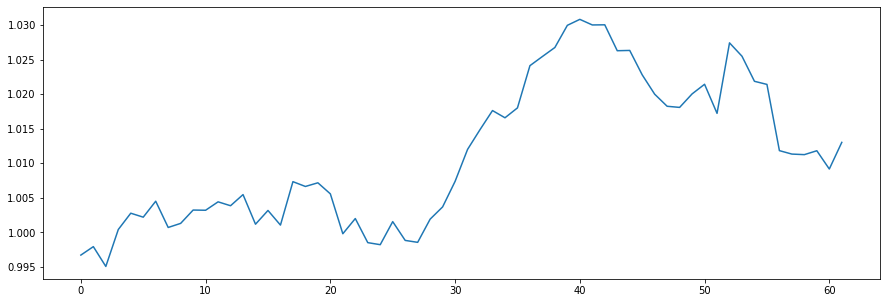

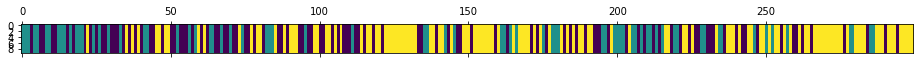

<Figure size 432x288 with 0 Axes>

N [[29. 33. 44.]
 [29. 27. 16.]
 [48. 12. 61.]]
alphas [[2.51674279 0.47052588 0.38966697]
 [0.60041153 2.38685713 0.38966697]
 [0.60041153 0.47052588 2.30599823]]
M [[ 7.  3.  4.]
 [ 3. 10.  3.]
 [ 4.  2.  5.]]
sum_w [[5.]
 [7.]
 [4.]]
barM [[2. 3. 4.]
 [3. 3. 3.]
 [4. 2. 1.]]
pi_z [[0.29976103 0.26703756 0.43320141]
 [0.3954348  0.39842256 0.20614264]
 [0.39284328 0.10302182 0.5041349 ]]
beta_vec [0.31351651 0.21346167 0.47302182]
hyper>> a_k: 3.75655192009637  gamma: 0.39472042400853663  rho: 0.36565003431371534


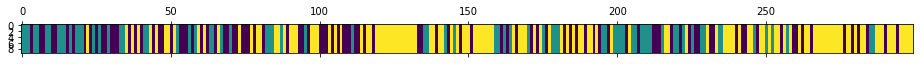

<Figure size 432x288 with 0 Axes>

563
N [[25. 28. 47.]
 [28. 28. 17.]
 [47. 17. 62.]]
alphas [[2.12068332 0.50867246 1.12719614]
 [0.74709998 1.8822558  1.12719614]
 [0.74709998 0.50867246 2.50077948]]
M [[6. 3. 6.]
 [3. 5. 5.]
 [2. 4. 9.]]
sum_w [[4.]
 [5.]
 [6.]]
barM [[2. 3. 6.]
 [3. 0. 5.]
 [2. 4. 3.]]
pi_z [[0.33730833 0.32745506 0.33523661]
 [0.42383596 0.36700528 0.20915876]
 [0.44565485 0.07911138 0.47523377]]
beta_vec [0.14645049 0.16357809 0.68997142]
hyper>> a_k: 3.5846272093516767  gamma: 2.201341978064134  rho: 0.2962869526222063


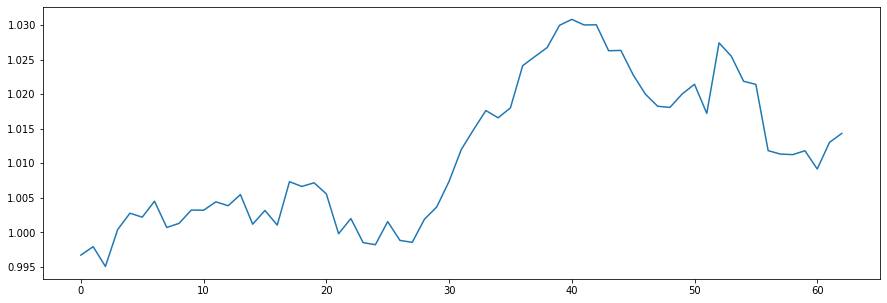

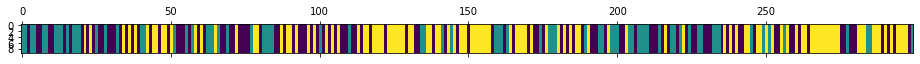

<Figure size 432x288 with 0 Axes>

N [[34. 30. 51.]
 [31. 31. 12.]
 [49. 14. 47.]]
alphas [[1.4315068  0.41263373 1.74048668]
 [0.36942852 1.474712   1.74048668]
 [0.36942852 0.41263373 2.80256496]]
M [[ 3.  2.  5.]
 [ 2.  6.  4.]
 [ 1.  3. 11.]]
sum_w [[3.]
 [5.]
 [5.]]
barM [[0. 2. 5.]
 [2. 1. 4.]
 [1. 3. 6.]]
pi_z [[0.29777059 0.30642157 0.39580784]
 [0.29902186 0.54578011 0.15519803]
 [0.51640675 0.07773687 0.40585638]]
beta_vec [0.21753532 0.24545735 0.53700733]
hyper>> a_k: 2.704760698991232  gamma: 0.4666587754018926  rho: 0.3176850026719206


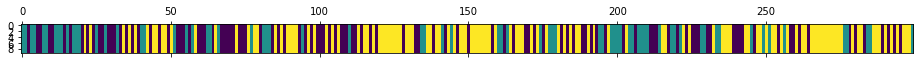

<Figure size 432x288 with 0 Axes>

564
N [[32. 27. 51.]
 [24. 28. 17.]
 [54. 14. 52.]]
alphas [[1.26072308 0.45299124 0.99104637]
 [0.40146117 1.31225315 0.99104637]
 [0.40146117 0.45299124 1.85030828]]
M [[5. 2. 7.]
 [3. 3. 2.]
 [4. 2. 6.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[2. 2. 7.]
 [3. 1. 2.]
 [4. 2. 3.]]
pi_z [[0.2836806  0.24702821 0.46929119]
 [0.35089371 0.39467787 0.25442842]
 [0.43032057 0.15942565 0.41025378]]
beta_vec [0.21539448 0.2558753  0.52873022]
hyper>> a_k: 3.024020166236568  gamma: 3.048921341550771  rho: 0.20019114005568886


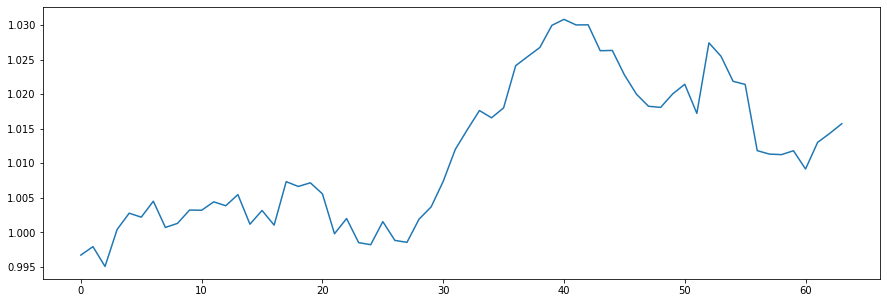

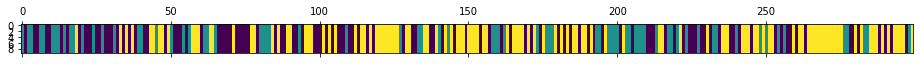

<Figure size 432x288 with 0 Axes>

N [[35. 31. 46.]
 [31. 27. 15.]
 [46. 14. 54.]]
alphas [[1.12634335 0.61886975 1.27880706]
 [0.52096131 1.2242518  1.27880706]
 [0.52096131 0.61886975 1.8841891 ]]
M [[5. 2. 4.]
 [2. 3. 5.]
 [4. 3. 4.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[5. 2. 4.]
 [2. 1. 5.]
 [4. 3. 3.]]
pi_z [[0.32513302 0.24790429 0.42696269]
 [0.43204379 0.35208227 0.21587393]
 [0.47105306 0.10340419 0.42554275]]
beta_vec [0.56444172 0.20506632 0.23049196]
hyper>> a_k: 2.630046958432876  gamma: 0.8562425310784184  rho: 0.16362717007518257


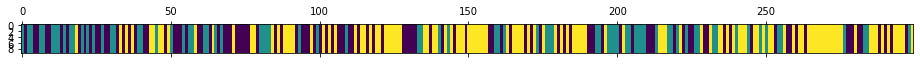

<Figure size 432x288 with 0 Axes>

565
N [[34. 29. 45.]
 [31. 29. 16.]
 [43. 18. 54.]]
alphas [[1.6719495  0.45108434 0.50701313]
 [1.24160235 0.88143148 0.50701313]
 [1.24160235 0.45108434 0.93736027]]
M [[4. 1. 2.]
 [6. 2. 3.]
 [2. 1. 5.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[4. 1. 2.]
 [6. 2. 3.]
 [2. 1. 3.]]
pi_z [[0.3054468  0.35649    0.3380632 ]
 [0.47356093 0.33847939 0.18795968]
 [0.39686503 0.1639838  0.43915117]]
beta_vec [0.48459845 0.19037597 0.32502558]
hyper>> a_k: 1.2443560081886782  gamma: 0.5609199167080144  rho: 0.3227081284256141


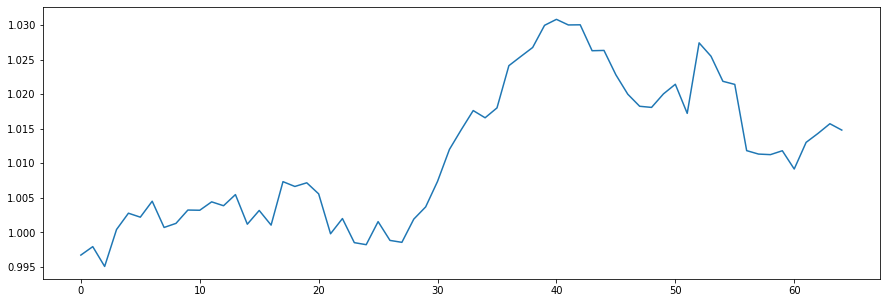

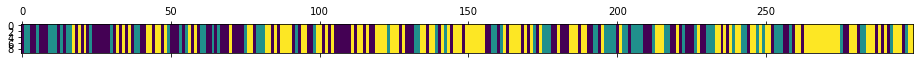

<Figure size 432x288 with 0 Axes>

N [[39. 27. 46.]
 [31. 27. 14.]
 [42. 18. 55.]]
alphas [[0.8099796  0.16044739 0.27392902]
 [0.4084158  0.56201119 0.27392902]
 [0.4084158  0.16044739 0.67549282]]
M [[3. 2. 2.]
 [3. 2. 2.]
 [3. 2. 3.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[2. 2. 2.]
 [3. 2. 2.]
 [3. 2. 3.]]
pi_z [[0.3875542  0.22712103 0.38532477]
 [0.44627338 0.35548315 0.19824347]
 [0.30653447 0.10230218 0.59116335]]
beta_vec [0.38537914 0.40336545 0.21125541]
hyper>> a_k: 1.008402843325231  gamma: 1.336380811659277  rho: 0.036078494351790995


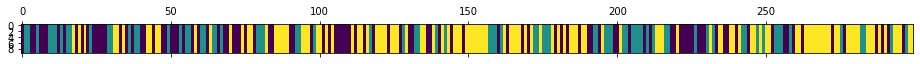

<Figure size 432x288 with 0 Axes>

566
N [[34. 28. 43.]
 [29. 30. 17.]
 [42. 18. 58.]]
alphas [[0.41097834 0.39207977 0.20534474]
 [0.37459669 0.42846142 0.20534474]
 [0.37459669 0.39207977 0.24172639]]
M [[5. 2. 1.]
 [3. 3. 2.]
 [3. 3. 2.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[3. 2. 1.]
 [3. 3. 2.]
 [3. 3. 2.]]
pi_z [[0.30340888 0.34352885 0.35306227]
 [0.38455929 0.39141313 0.22402758]
 [0.29987627 0.1282707  0.57185303]]
beta_vec [0.25896486 0.55529618 0.18573895]
hyper>> a_k: 1.469933344289052  gamma: 0.16052081753964162  rho: 0.06747736251019788


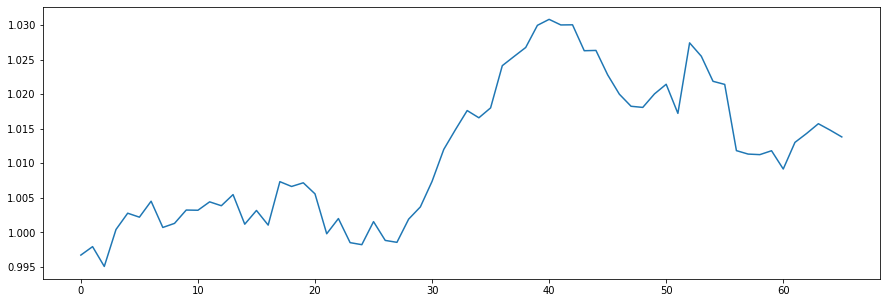

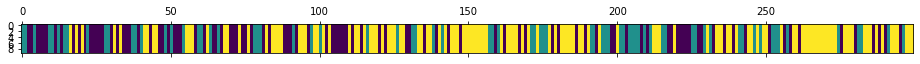

<Figure size 432x288 with 0 Axes>

N [[32. 27. 42.]
 [28. 26. 19.]
 [41. 20. 64.]]
alphas [[0.45416231 0.76117009 0.25460095]
 [0.35497508 0.86035731 0.25460095]
 [0.35497508 0.76117009 0.35378818]]
M [[2. 3. 4.]
 [1. 3. 1.]
 [1. 5. 1.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[2. 3. 4.]
 [1. 3. 1.]
 [1. 5. 1.]]
pi_z [[0.29941755 0.27841753 0.42216492]
 [0.41701815 0.3803515  0.20263035]
 [0.28185964 0.18760018 0.53054018]]
beta_vec [0.30035826 0.39252918 0.30711256]
hyper>> a_k: 0.8802039398914532  gamma: 1.0513239153205238  rho: 0.05173613721428704


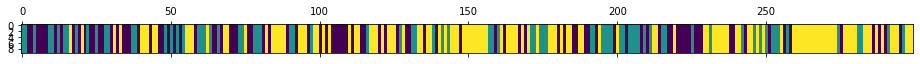

<Figure size 432x288 with 0 Axes>

567
N [[30. 29. 38.]
 [33. 27. 17.]
 [34. 21. 70.]]
alphas [[0.29623706 0.3276306  0.25633629]
 [0.2506987  0.37316895 0.25633629]
 [0.2506987  0.3276306  0.30187464]]
M [[2. 3. 2.]
 [2. 4. 2.]
 [1. 2. 4.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[2. 3. 2.]
 [2. 3. 2.]
 [1. 2. 4.]]
pi_z [[0.30824726 0.26951237 0.42224036]
 [0.5032108  0.32260195 0.17418726]
 [0.34074433 0.16926825 0.48998742]]
beta_vec [0.08651667 0.56057687 0.35290646]
hyper>> a_k: 1.428458587142549  gamma: 0.3377639103060828  rho: 0.04296513110702874


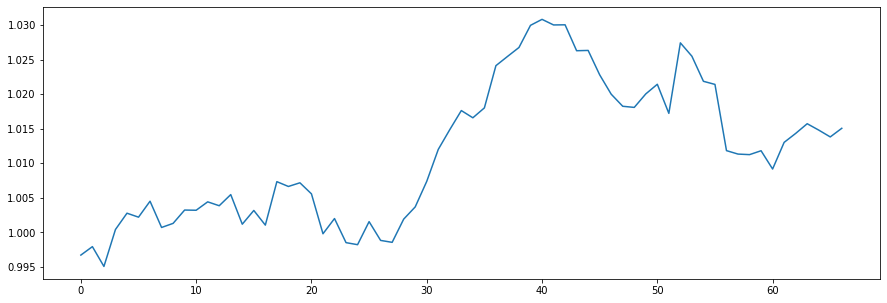

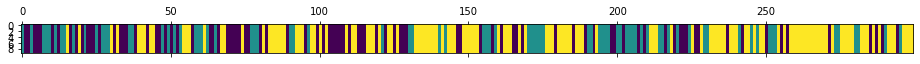

<Figure size 432x288 with 0 Axes>

N [[29. 24. 39.]
 [32. 33. 14.]
 [31. 22. 75.]]
alphas [[0.17964952 0.76635605 0.48245302]
 [0.11827561 0.82772996 0.48245302]
 [0.11827561 0.76635605 0.54382693]]
M [[1. 2. 2.]
 [1. 2. 2.]
 [2. 3. 3.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[1. 2. 2.]
 [1. 2. 2.]
 [2. 3. 2.]]
pi_z [[0.2563978  0.22461943 0.51898277]
 [0.29954224 0.457427   0.24303076]
 [0.22525115 0.2030318  0.57171705]]
beta_vec [0.21277807 0.34978619 0.43743575]
hyper>> a_k: 1.1701940647926463  gamma: 0.32711776474738236  rho: 0.23298770136212016


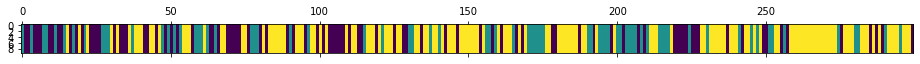

<Figure size 432x288 with 0 Axes>

568
N [[31. 22. 38.]
 [25. 27. 20.]
 [34. 23. 79.]]
alphas [[0.46362047 0.31395173 0.39262187]
 [0.19097964 0.58659255 0.39262187]
 [0.19097964 0.31395173 0.6652627 ]]
M [[2. 6. 4.]
 [1. 3. 1.]
 [2. 1. 3.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[2. 6. 4.]
 [1. 3. 1.]
 [2. 1. 3.]]
pi_z [[0.43824262 0.18232665 0.37943073]
 [0.37798118 0.34641485 0.27560396]
 [0.22426061 0.16171608 0.61402331]]
beta_vec [0.21628194 0.54069541 0.24302265]
hyper>> a_k: 2.0626928623107275  gamma: 0.351564446934492  rho: 0.08147327653957771


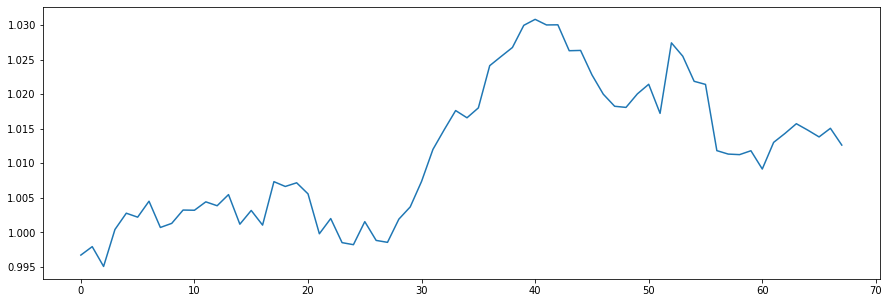

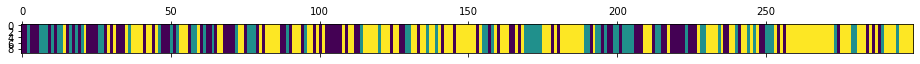

<Figure size 432x288 with 0 Axes>

N [[35. 22. 39.]
 [27. 25. 17.]
 [34. 22. 78.]]
alphas [[0.57783043 1.02442236 0.46044007]
 [0.40977609 1.1924767  0.46044007]
 [0.40977609 1.02442236 0.62849442]]
M [[4. 4. 1.]
 [2. 8. 3.]
 [2. 3. 5.]]
sum_w [[1.]
 [3.]
 [2.]]
barM [[3. 4. 1.]
 [2. 5. 3.]
 [2. 3. 3.]]
pi_z [[0.48219876 0.19513829 0.32266295]
 [0.34790322 0.43752258 0.2145742 ]
 [0.26468099 0.14823898 0.58708003]]
beta_vec [0.44392386 0.34946737 0.20660877]
hyper>> a_k: 2.855591987025587  gamma: 0.8138703184603313  rho: 0.2740081800386247


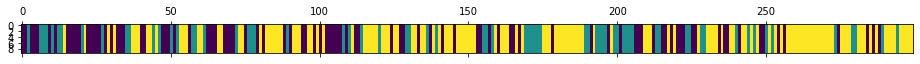

<Figure size 432x288 with 0 Axes>

569
N [[39. 20. 37.]
 [24. 26. 18.]
 [33. 22. 80.]]
alphas [[1.70277029 0.72449353 0.42832817]
 [0.92031472 1.50694909 0.42832817]
 [0.92031472 0.72449353 1.21078374]]
M [[6. 4. 4.]
 [4. 5. 4.]
 [4. 2. 7.]]
sum_w [[4.]
 [5.]
 [6.]]
barM [[2. 4. 4.]
 [4. 0. 4.]
 [4. 2. 1.]]
pi_z [[0.37499173 0.22874916 0.39625911]
 [0.22744946 0.37810273 0.39444782]
 [0.24169345 0.16719395 0.5911126 ]]
beta_vec [0.40447187 0.35135702 0.24417111]
hyper>> a_k: 2.9234128178435563  gamma: 1.0699894562060341  rho: 0.33555841393975583


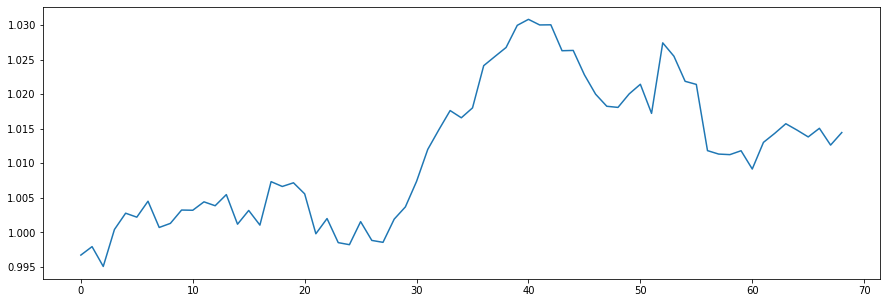

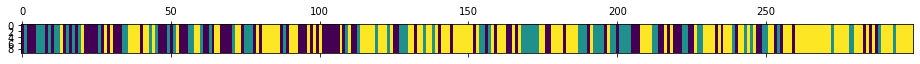

<Figure size 432x288 with 0 Axes>

N [[34. 21. 37.]
 [25. 29. 20.]
 [33. 24. 76.]]
alphas [[1.76663691 0.68248889 0.47428701]
 [0.78566115 1.66346466 0.47428701]
 [0.78566115 0.68248889 1.45526278]]
M [[5. 5. 4.]
 [3. 8. 4.]
 [2. 3. 5.]]
sum_w [[4.]
 [6.]
 [1.]]
barM [[1. 5. 4.]
 [3. 2. 4.]
 [2. 3. 4.]]
pi_z [[0.34217679 0.24277249 0.41505072]
 [0.37232004 0.41110166 0.21657829]
 [0.20233767 0.1740458  0.62361654]]
beta_vec [0.22846937 0.31987665 0.45165399]
hyper>> a_k: 3.653423298193809  gamma: 0.3250044353563086  rho: 0.2412420459682863


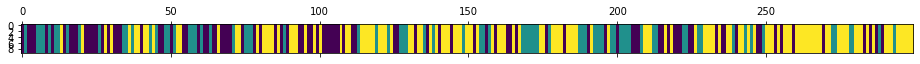

<Figure size 432x288 with 0 Axes>

570
N [[35. 22. 39.]
 [24. 31. 22.]
 [37. 24. 65.]]
alphas [[1.51469101 0.88671853 1.25201375]
 [0.6333317  1.76807784 1.25201375]
 [0.6333317  0.88671853 2.13337307]]
M [[8. 4. 8.]
 [2. 4. 4.]
 [3. 3. 5.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[3. 4. 8.]
 [2. 1. 4.]
 [3. 3. 2.]]
pi_z [[0.35244019 0.30151178 0.34604803]
 [0.37236731 0.37984035 0.24779233]
 [0.27947846 0.2265278  0.49399374]]
beta_vec [0.18984044 0.40687925 0.40328031]
hyper>> a_k: 3.404047554906106  gamma: 0.10883546816873443  rho: 0.216034203793814


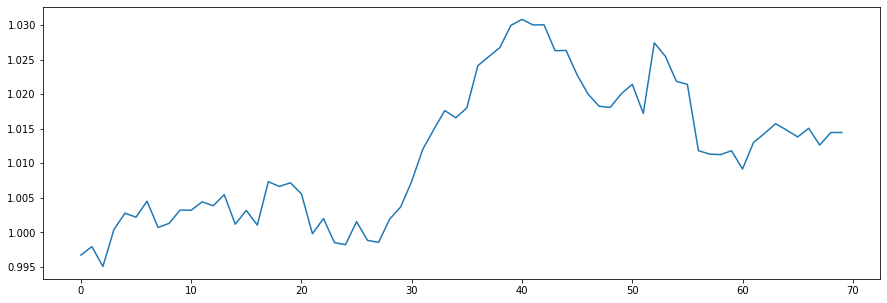

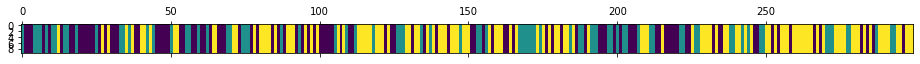

<Figure size 432x288 with 0 Axes>

N [[40. 23. 41.]
 [28. 31. 21.]
 [36. 26. 53.]]
alphas [[1.2420097  1.08582111 1.07621675]
 [0.50661899 1.82121181 1.07621675]
 [0.50661899 1.08582111 1.81160746]]
M [[6. 4. 3.]
 [3. 4. 2.]
 [2. 2. 8.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[3. 4. 3.]
 [3. 2. 2.]
 [2. 2. 5.]]
pi_z [[0.38854224 0.2670224  0.34443536]
 [0.3954564  0.36282697 0.24171663]
 [0.24424271 0.20072174 0.55503555]]
beta_vec [0.24183691 0.19941614 0.55874694]
hyper>> a_k: 2.4762145414589214  gamma: 0.17998846325506018  rho: 0.27167627023497803


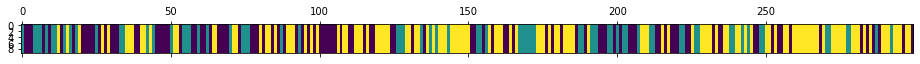

<Figure size 432x288 with 0 Axes>

571
N [[41. 21. 44.]
 [26. 28. 17.]
 [38. 22. 62.]]
alphas [[1.10887817 0.35964419 1.00769218]
 [0.43614944 1.03237292 1.00769218]
 [0.43614944 0.35964419 1.68042091]]
M [[5. 2. 6.]
 [3. 3. 3.]
 [3. 1. 3.]]
sum_w [[4.]
 [1.]
 [0.]]
barM [[1. 2. 6.]
 [3. 2. 3.]
 [3. 1. 3.]]
pi_z [[0.43135777 0.16328193 0.4053603 ]
 [0.38235647 0.24132476 0.37631876]
 [0.27240873 0.25943799 0.46815328]]
beta_vec [0.16909471 0.27506567 0.55583962]
hyper>> a_k: 1.8007628173972667  gamma: 0.7937125572718338  rho: 0.17258703004957177


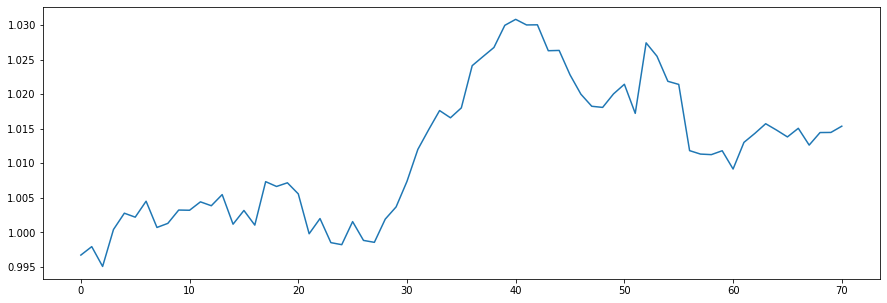

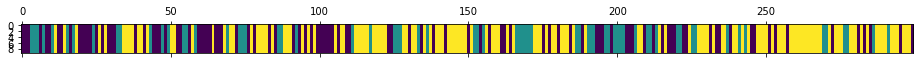

<Figure size 432x288 with 0 Axes>

N [[37. 19. 44.]
 [22. 27. 18.]
 [42. 21. 69.]]
alphas [[0.56273512 0.40984083 0.82818687]
 [0.25194682 0.72062914 0.82818687]
 [0.25194682 0.40984083 1.13897517]]
M [[2. 2. 3.]
 [2. 3. 4.]
 [1. 2. 4.]]
sum_w [[1.]
 [3.]
 [0.]]
barM [[1. 2. 3.]
 [2. 0. 4.]
 [1. 2. 4.]]
pi_z [[0.32082941 0.30067409 0.3784965 ]
 [0.38609712 0.34884254 0.26506034]
 [0.31242485 0.16282562 0.52474953]]
beta_vec [0.13668633 0.2502683  0.61304537]
hyper>> a_k: 1.6473169101413059  gamma: 0.9297675845636525  rho: 0.23510415804436213


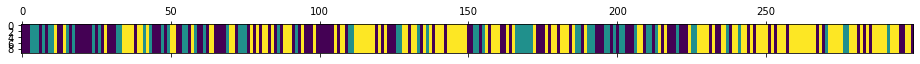

<Figure size 432x288 with 0 Axes>

572
N [[40. 24. 46.]
 [27. 23. 14.]
 [43. 17. 65.]]
alphas [[0.55951937 0.31534453 0.77245301]
 [0.17222831 0.70263559 0.77245301]
 [0.17222831 0.31534453 1.15974407]]
M [[1. 2. 4.]
 [2. 2. 3.]
 [3. 2. 5.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[0. 2. 4.]
 [2. 2. 3.]
 [3. 2. 4.]]
pi_z [[0.45901582 0.21791287 0.32307131]
 [0.39858468 0.31308222 0.28833311]
 [0.37259899 0.12510393 0.50229709]]
beta_vec [0.29264862 0.33208761 0.37526377]
hyper>> a_k: 0.9495377113268094  gamma: 0.03728155455443662  rho: 0.1466072242300942


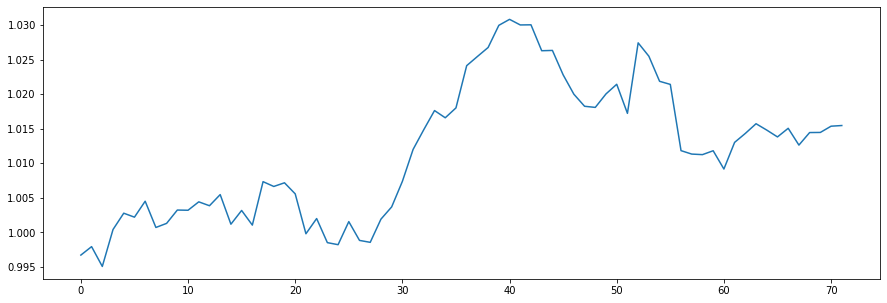

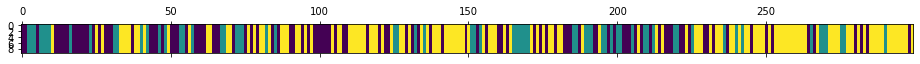

<Figure size 432x288 with 0 Axes>

N [[39. 21. 47.]
 [22. 27. 16.]
 [45. 17. 65.]]
alphas [[0.37635064 0.2691001  0.30408698]
 [0.23714155 0.40830918 0.30408698]
 [0.23714155 0.2691001  0.44329607]]
M [[3. 2. 2.]
 [1. 2. 2.]
 [2. 1. 3.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[2. 2. 2.]
 [1. 2. 2.]
 [2. 1. 1.]]
pi_z [[0.34573214 0.18500026 0.4692676 ]
 [0.28328871 0.44984405 0.26686724]
 [0.30996891 0.17440044 0.51563066]]
beta_vec [0.19160904 0.47927914 0.32911182]
hyper>> a_k: 1.3485995042666628  gamma: 1.0139282330163208  rho: 0.17595261427620995


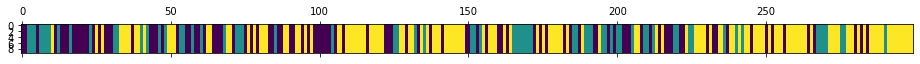

<Figure size 432x288 with 0 Axes>

573
N [[35. 23. 43.]
 [26. 29. 13.]
 [40. 16. 74.]]
alphas [[0.45022664 0.53262765 0.36574522]
 [0.21293703 0.76991726 0.36574522]
 [0.21293703 0.53262765 0.60303483]]
M [[2. 3. 4.]
 [1. 2. 1.]
 [1. 4. 4.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[0. 3. 4.]
 [1. 1. 1.]
 [1. 4. 2.]]
pi_z [[0.3421327  0.21299717 0.44487014]
 [0.30703694 0.47072157 0.22224149]
 [0.33682401 0.11610625 0.54706974]]
beta_vec [0.10344987 0.60587213 0.29067799]
hyper>> a_k: 1.6035084052234099  gamma: 0.9671256467187072  rho: 0.5056118024425387


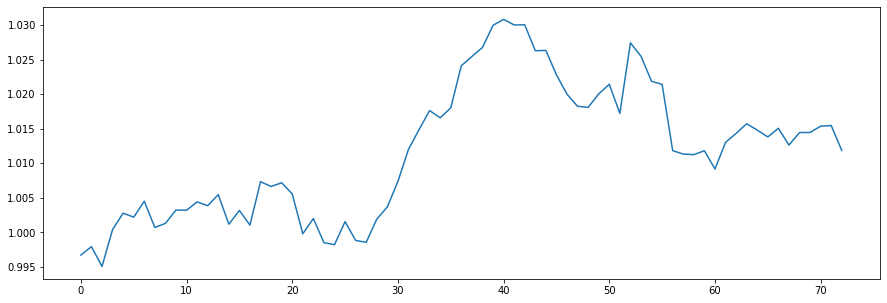

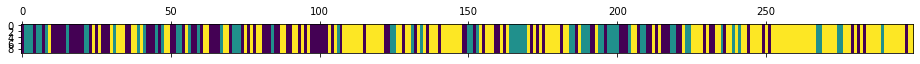

<Figure size 432x288 with 0 Axes>

N [[38. 21. 41.]
 [19. 26. 18.]
 [43. 16. 77.]]
alphas [[0.89276324 0.48030855 0.23043661]
 [0.08201047 1.29106132 0.23043661]
 [0.08201047 0.48030855 1.04118939]]
M [[2. 1. 2.]
 [1. 9. 1.]
 [3. 2. 7.]]
sum_w [[2.]
 [5.]
 [3.]]
barM [[0. 1. 2.]
 [1. 4. 1.]
 [3. 2. 4.]]
pi_z [[0.3732162  0.25535902 0.37142477]
 [0.28695417 0.42869137 0.28435446]
 [0.37448863 0.11441878 0.51109259]]
beta_vec [0.22221569 0.35401204 0.42377226]
hyper>> a_k: 2.075099620614825  gamma: 1.9225543826485059  rho: 0.2938397529561425


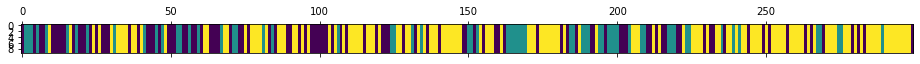

<Figure size 432x288 with 0 Axes>

574
N [[36. 22. 44.]
 [22. 25. 16.]
 [44. 16. 74.]]
alphas [[0.93537116 0.51875256 0.6209759 ]
 [0.3256244  1.12849932 0.6209759 ]
 [0.3256244  0.51875256 1.23072266]]
M [[2. 2. 4.]
 [2. 2. 3.]
 [1. 2. 6.]]
sum_w [[0.]
 [1.]
 [5.]]
barM [[2. 2. 4.]
 [2. 1. 3.]
 [1. 2. 1.]]
pi_z [[0.34360211 0.16506808 0.49132981]
 [0.38387238 0.3090053  0.30712232]
 [0.31431996 0.11724059 0.56843945]]
beta_vec [0.31168983 0.22495027 0.46335991]
hyper>> a_k: 1.52073076073205  gamma: 2.144704730195255  rho: 0.19445685327121784


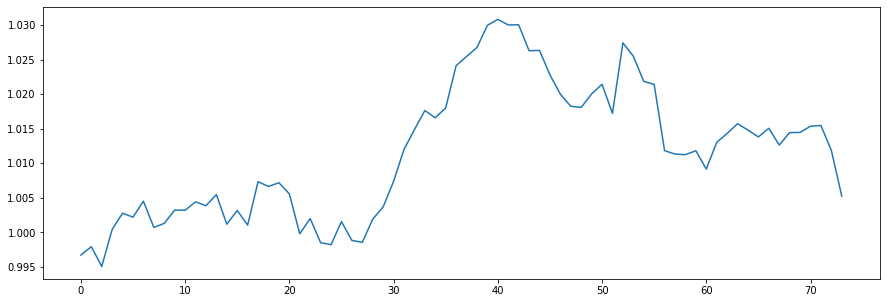

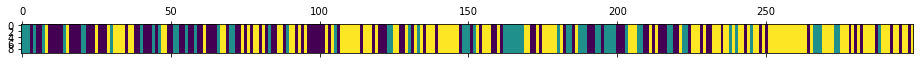

<Figure size 432x288 with 0 Axes>

N [[43. 20. 46.]
 [24. 27. 14.]
 [41. 18. 66.]]
alphas [[0.67754099 0.27556728 0.56762248]
 [0.38182448 0.5712838  0.56762248]
 [0.38182448 0.27556728 0.863339  ]]
M [[2. 3. 3.]
 [1. 2. 2.]
 [2. 2. 4.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[1. 3. 3.]
 [1. 2. 2.]
 [2. 2. 1.]]
pi_z [[0.46560431 0.19422099 0.3401747 ]
 [0.35172959 0.40246111 0.2458093 ]
 [0.28923593 0.17771605 0.53304802]]
beta_vec [0.20481322 0.56410101 0.23108577]
hyper>> a_k: 0.879126475084389  gamma: 1.8131628870754053  rho: 0.27360658846123953


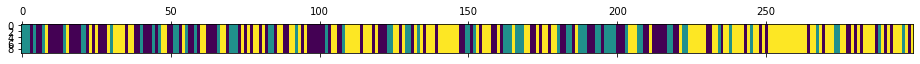

<Figure size 432x288 with 0 Axes>

575
N [[43. 21. 44.]
 [24. 24. 17.]
 [41. 20. 65.]]
alphas [[0.37132682 0.36023021 0.14756945]
 [0.13079202 0.600765   0.14756945]
 [0.13079202 0.36023021 0.38810425]]
M [[3. 3. 1.]
 [1. 5. 1.]
 [3. 1. 4.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[2. 3. 1.]
 [1. 4. 1.]
 [3. 1. 1.]]
pi_z [[0.35799198 0.22628115 0.41572687]
 [0.34603985 0.42314979 0.23081036]
 [0.26835653 0.11939718 0.61224629]]
beta_vec [0.19893628 0.63452182 0.1665419 ]
hyper>> a_k: 1.6698295465989175  gamma: 0.7697413706972551  rho: 0.27442456189129644


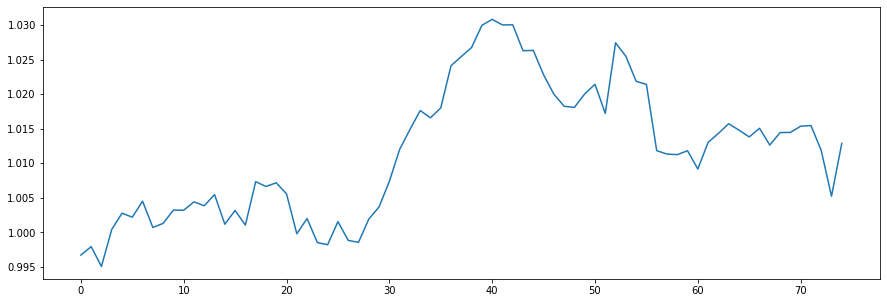

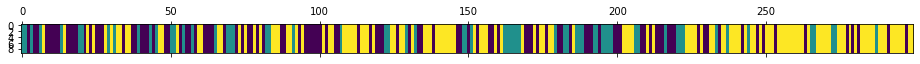

<Figure size 432x288 with 0 Axes>

N [[44. 19. 45.]
 [22. 25. 16.]
 [42. 19. 67.]]
alphas [[0.69927091 0.76877858 0.20178005]
 [0.24102867 1.22702082 0.20178005]
 [0.24102867 0.76877858 0.6600223 ]]
M [[4. 1. 2.]
 [1. 4. 1.]
 [2. 5. 7.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[1. 1. 2.]
 [1. 3. 1.]
 [2. 5. 3.]]
pi_z [[0.50871563 0.14943478 0.34184959]
 [0.29755846 0.53153338 0.17090816]
 [0.34334843 0.10488945 0.55176213]]
beta_vec [0.17704936 0.2820916  0.54085905]
hyper>> a_k: 2.2150905710609856  gamma: 0.4717985992387956  rho: 0.23443372735990542


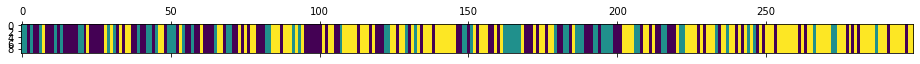

<Figure size 432x288 with 0 Axes>

576
N [[41. 23. 42.]
 [21. 24. 20.]
 [44. 18. 66.]]
alphas [[0.819532   0.47837055 0.91718803]
 [0.30024006 0.99766248 0.91718803]
 [0.30024006 0.47837055 1.43647997]]
M [[2. 3. 6.]
 [1. 4. 1.]
 [2. 3. 3.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[1. 3. 6.]
 [1. 2. 1.]
 [2. 3. 2.]]
pi_z [[0.35043746 0.19560845 0.45395409]
 [0.29802943 0.29063325 0.41133732]
 [0.29109629 0.09886241 0.6100413 ]]
beta_vec [0.28923649 0.09785598 0.61290753]
hyper>> a_k: 2.51902382676974  gamma: 0.8742107928741171  rho: 0.11703329281870488


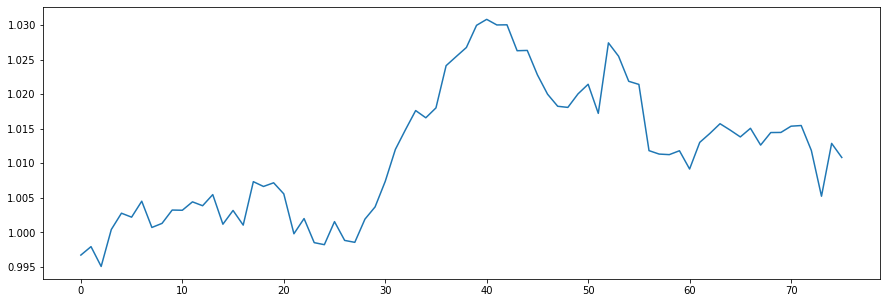

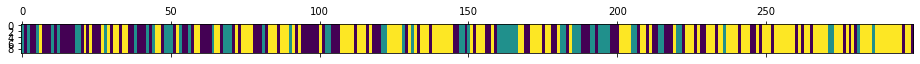

<Figure size 432x288 with 0 Axes>

N [[40. 22. 43.]
 [23. 25. 12.]
 [43. 13. 78.]]
alphas [[0.93813356 0.21765266 1.36323761]
 [0.6433239  0.51246231 1.36323761]
 [0.6433239  0.21765266 1.65804727]]
M [[3. 1. 7.]
 [2. 4. 3.]
 [2. 1. 5.]]
sum_w [[0.]
 [4.]
 [2.]]
barM [[3. 1. 7.]
 [2. 0. 3.]
 [2. 1. 3.]]
pi_z [[0.40251532 0.2515861  0.34589858]
 [0.3602412  0.41598662 0.22377217]
 [0.33909897 0.09781334 0.56308769]]
beta_vec [0.3187927  0.03837292 0.64283438]
hyper>> a_k: 1.774550058667917  gamma: 1.4511650144333526  rho: 0.27430943718712436


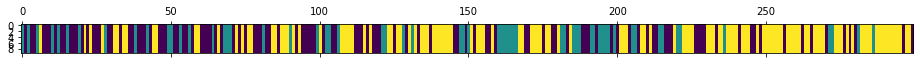

<Figure size 432x288 with 0 Axes>

577
N [[45. 24. 45.]
 [28. 23.  9.]
 [41. 13. 71.]]
alphas [[0.89730886 0.04941566 0.82782554]
 [0.41053303 0.53619149 0.82782554]
 [0.41053303 0.04941566 1.31460137]]
M [[4. 1. 4.]
 [2. 2. 3.]
 [2. 1. 3.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[2. 1. 4.]
 [2. 0. 3.]
 [2. 1. 2.]]
pi_z [[0.35604256 0.252925   0.39103244]
 [0.37584477 0.47386009 0.15029515]
 [0.26944676 0.10264379 0.62790945]]
beta_vec [0.41975404 0.12383218 0.45641378]
hyper>> a_k: 1.6800681144969993  gamma: 1.0234973051728538  rho: 0.16058689960292996


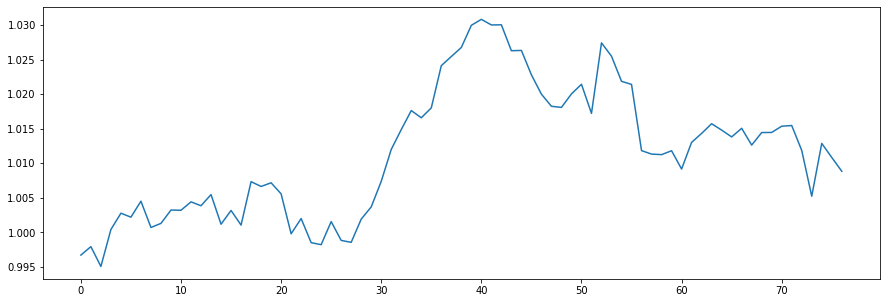

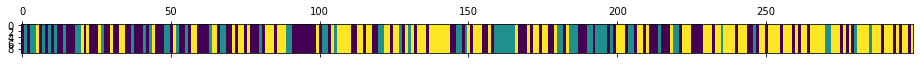

<Figure size 432x288 with 0 Axes>

N [[43. 26. 47.]
 [27. 24. 12.]
 [45. 13. 62.]]
alphas [[0.86176395 0.17463696 0.64366721]
 [0.59196702 0.44443388 0.64366721]
 [0.59196702 0.17463696 0.91346414]]
M [[3. 1. 6.]
 [5. 2. 1.]
 [3. 1. 4.]]
sum_w [[0.]
 [2.]
 [0.]]
barM [[3. 1. 6.]
 [5. 0. 1.]
 [3. 1. 4.]]
pi_z [[0.43113973 0.22687877 0.34198149]
 [0.4019915  0.40089675 0.19711175]
 [0.43123816 0.11550074 0.4532611 ]]
beta_vec [0.45333139 0.17911842 0.36755019]
hyper>> a_k: 1.9312217033715982  gamma: 0.6729742739617363  rho: 0.03255628600851812


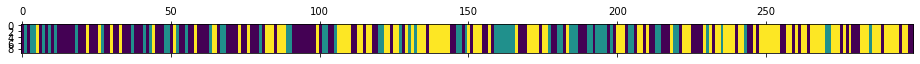

<Figure size 432x288 with 0 Axes>

578
N [[56. 27. 39.]
 [25. 24. 15.]
 [40. 13. 60.]]
alphas [[0.90985434 0.3346556  0.68671177]
 [0.84698093 0.397529   0.68671177]
 [0.84698093 0.3346556  0.74958518]]
M [[3. 2. 3.]
 [5. 2. 4.]
 [2. 1. 6.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[3. 2. 3.]
 [5. 2. 4.]
 [2. 1. 5.]]
pi_z [[0.47864381 0.18427954 0.33707665]
 [0.32715143 0.43814116 0.2347074 ]
 [0.35895379 0.11548895 0.52555726]]
beta_vec [0.39952574 0.1780235  0.42245076]
hyper>> a_k: 2.360360315506247  gamma: 0.36220010161836474  rho: 0.09554673129229097


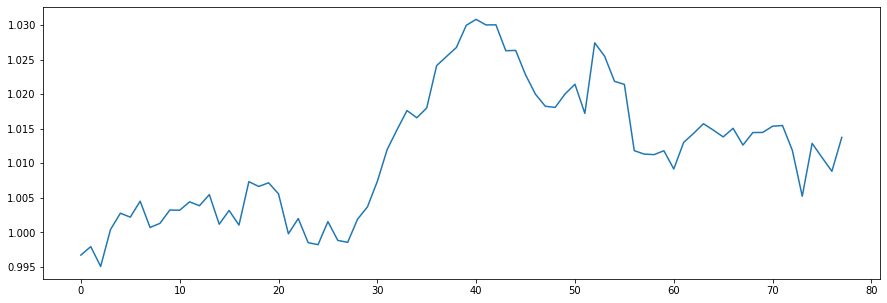

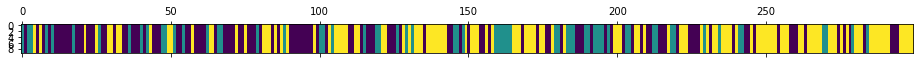

<Figure size 432x288 with 0 Axes>

N [[54. 24. 40.]
 [25. 23. 15.]
 [39. 16. 63.]]
alphas [[1.07844648 0.38005091 0.90186292]
 [0.85292177 0.60557563 0.90186292]
 [0.85292177 0.38005091 1.12738763]]
M [[4. 3. 1.]
 [2. 5. 3.]
 [3. 2. 6.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[3. 3. 1.]
 [2. 3. 3.]
 [3. 2. 4.]]
pi_z [[0.52873726 0.19182292 0.27943982]
 [0.37502785 0.37511022 0.24986193]
 [0.29962316 0.11258407 0.58779277]]
beta_vec [0.40693824 0.30005514 0.29300661]
hyper>> a_k: 2.3449683357075606  gamma: 0.7223001178013907  rho: 0.08640733752318881


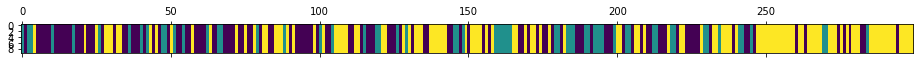

<Figure size 432x288 with 0 Axes>

579
N [[56. 23. 42.]
 [25. 23. 12.]
 [40. 14. 64.]]
alphas [[1.07442493 0.64282189 0.62772151]
 [0.87180246 0.84544436 0.62772151]
 [0.87180246 0.64282189 0.83034398]]
M [[5. 2. 4.]
 [7. 5. 4.]
 [3. 3. 4.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[5. 2. 4.]
 [7. 3. 4.]
 [3. 3. 3.]]
pi_z [[0.42859101 0.21057088 0.36083811]
 [0.36928863 0.41361072 0.21710065]
 [0.29593402 0.19350177 0.51056421]]
beta_vec [0.40894237 0.23636861 0.35468902]
hyper>> a_k: 3.1065211332557596  gamma: 0.514820315843152  rho: 0.15944730733185514


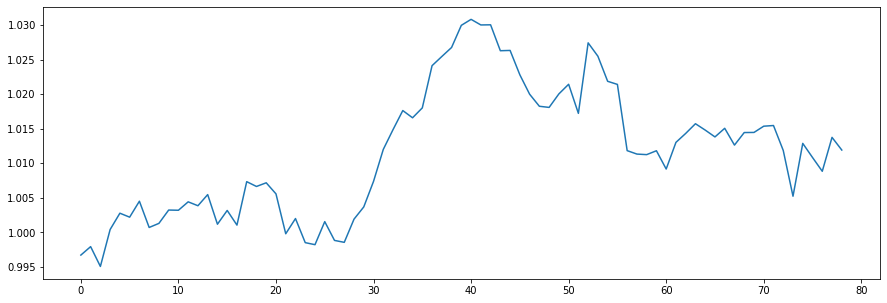

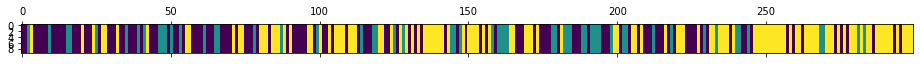

<Figure size 432x288 with 0 Axes>

N [[56. 25. 44.]
 [26. 19. 12.]
 [43. 13. 61.]]
alphas [[1.56315459 0.61720446 0.92616209]
 [1.06782816 1.11253089 0.92616209]
 [1.06782816 0.61720446 1.42148852]]
M [[6. 2. 5.]
 [4. 4. 2.]
 [3. 5. 5.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[2. 2. 5.]
 [4. 2. 2.]
 [3. 5. 4.]]
pi_z [[0.48582678 0.19565187 0.31852136]
 [0.5117289  0.34029957 0.14797153]
 [0.37504909 0.1179695  0.50698141]]
beta_vec [0.61552222 0.21828195 0.16619583]
hyper>> a_k: 3.593104945637754  gamma: 1.2156051667435972  rho: 0.18072403257491013


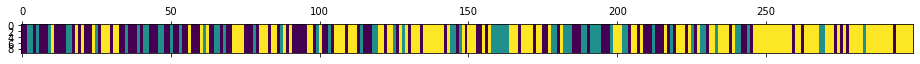

<Figure size 432x288 with 0 Axes>

580
N [[39. 28. 38.]
 [25. 23. 15.]
 [41. 12. 78.]]
alphas [[2.46130059 0.64256629 0.48923807]
 [1.81194017 1.29192671 0.48923807]
 [1.81194017 0.64256629 1.13859848]]
M [[6. 1. 3.]
 [8. 6. 3.]
 [8. 3. 3.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[4. 1. 3.]
 [8. 3. 3.]
 [8. 3. 2.]]
pi_z [[0.35976269 0.29627068 0.34396662]
 [0.40279724 0.30472024 0.29248252]
 [0.31812175 0.12043347 0.56144478]]
beta_vec [0.51312016 0.20664318 0.28023666]
hyper>> a_k: 3.8983009676862843  gamma: 0.5393052548393539  rho: 0.11127922888669758


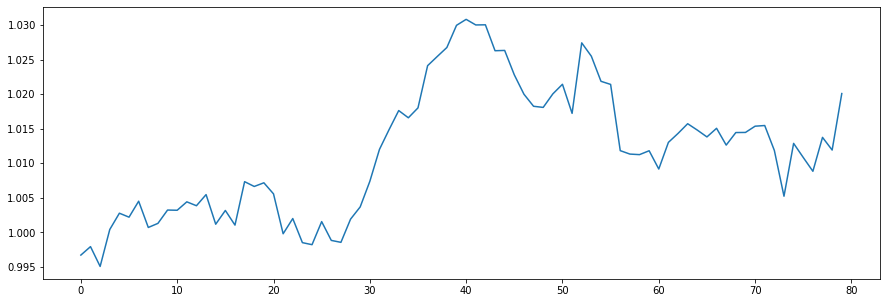

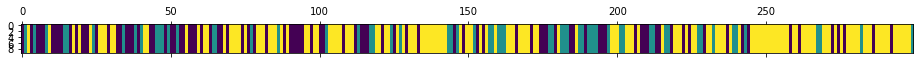

<Figure size 432x288 with 0 Axes>

N [[31. 23. 41.]
 [21. 22. 17.]
 [43. 16. 85.]]
alphas [[2.21150526 0.71591551 0.9708802 ]
 [1.77770533 1.14971543 0.9708802 ]
 [1.77770533 0.71591551 1.40468013]]
M [[7. 5. 8.]
 [4. 3. 2.]
 [6. 4. 5.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[7. 5. 8.]
 [4. 3. 2.]
 [6. 4. 5.]]
pi_z [[0.36742979 0.23989559 0.39267462]
 [0.44143311 0.36076913 0.19779775]
 [0.27806515 0.12747171 0.59446314]]
beta_vec [0.21774284 0.30094667 0.48131049]
hyper>> a_k: 4.068029538662018  gamma: 0.37697922071496826  rho: 0.025102239736568475


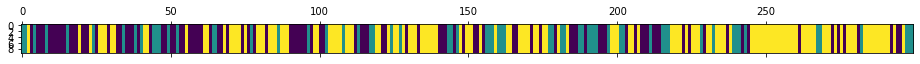

<Figure size 432x288 with 0 Axes>

581
N [[44. 22. 37.]
 [25. 24. 14.]
 [34. 17. 82.]]
alphas [[0.96566579 1.19352828 1.90883547]
 [0.86354914 1.29564493 1.90883547]
 [0.86354914 1.19352828 2.01095212]]
M [[ 4.  3.  5.]
 [ 2.  4.  2.]
 [ 4.  2. 11.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[ 4.  3.  5.]
 [ 2.  4.  2.]
 [ 4.  2. 11.]]
pi_z [[0.41875225 0.22577037 0.35547738]
 [0.29350705 0.38547797 0.32101498]
 [0.26456503 0.11357693 0.62185804]]
beta_vec [0.26483056 0.35953708 0.37563236]
hyper>> a_k: 4.207276447967271  gamma: 0.27428184475761824  rho: 0.034759759051921565


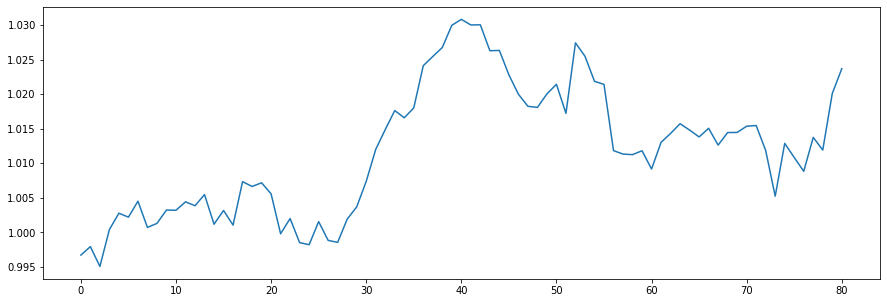

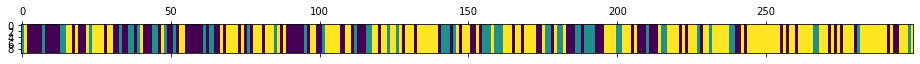

<Figure size 432x288 with 0 Axes>

N [[42. 18. 41.]
 [21. 21. 16.]
 [38. 18. 84.]]
alphas [[1.22172943 1.46009179 1.52545523]
 [1.07548552 1.6063357  1.52545523]
 [1.07548552 1.46009179 1.67169915]]
M [[7. 5. 6.]
 [3. 4. 3.]
 [7. 4. 6.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[7. 5. 6.]
 [3. 4. 3.]
 [7. 4. 6.]]
pi_z [[0.40793611 0.21888578 0.37317811]
 [0.43169881 0.30356291 0.26473829]
 [0.29005865 0.12162777 0.58831357]]
beta_vec [0.36591676 0.21680103 0.41728222]
hyper>> a_k: 3.0975369910643336  gamma: 0.3394847446152657  rho: 0.04359506265291694


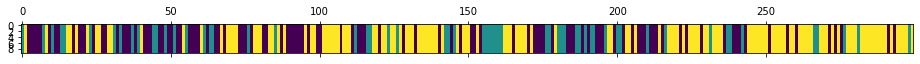

<Figure size 432x288 with 0 Axes>

582
N [[44. 23. 41.]
 [26. 19. 13.]
 [38. 16. 79.]]
alphas [[1.21906559 0.64227297 1.23619843]
 [1.08402827 0.77731029 1.23619843]
 [1.08402827 0.64227297 1.37123575]]
M [[5. 3. 8.]
 [3. 2. 6.]
 [6. 1. 9.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[4. 3. 8.]
 [3. 1. 6.]
 [6. 1. 7.]]
pi_z [[0.38008467 0.185621   0.43429433]
 [0.43751195 0.24171688 0.32077117]
 [0.30433671 0.15495517 0.54070812]]
beta_vec [0.31400127 0.05136705 0.63463167]
hyper>> a_k: 4.019682070813871  gamma: 0.8802386357713393  rho: 0.13512070525712583


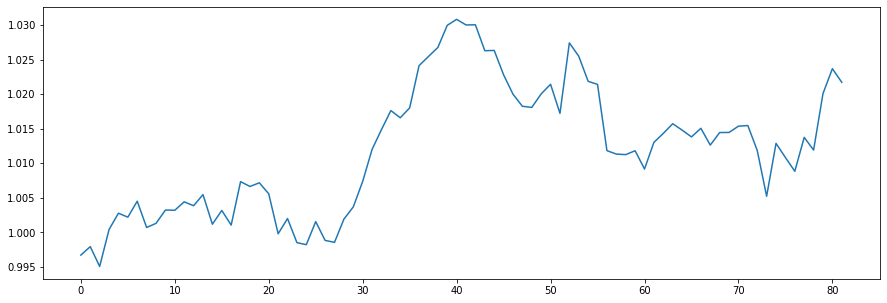

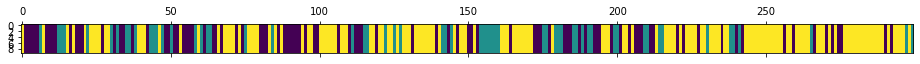

<Figure size 432x288 with 0 Axes>

N [[37. 19. 39.]
 [21. 23. 15.]
 [37. 18. 90.]]
alphas [[1.6347802  0.17857961 2.20632227]
 [1.09163792 0.72172188 2.20632227]
 [1.09163792 0.17857961 2.74946455]]
M [[ 5.  2.  7.]
 [ 4.  3.  4.]
 [ 4.  1. 13.]]
sum_w [[2.]
 [3.]
 [2.]]
barM [[ 3.  2.  7.]
 [ 4.  0.  4.]
 [ 4.  1. 11.]]
pi_z [[0.36630024 0.23056867 0.40313109]
 [0.37667377 0.35447126 0.26885497]
 [0.22234878 0.13124775 0.64640347]]
beta_vec [0.34737487 0.07075556 0.58186957]
hyper>> a_k: 3.6285837884768237  gamma: 0.6162405791332478  rho: 0.12207639120208379


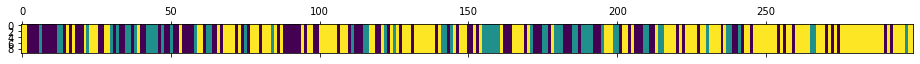

<Figure size 432x288 with 0 Axes>

583
N [[40. 22. 41.]
 [20. 25. 15.]
 [43. 13. 80.]]
alphas [[1.54956853 0.2254003  1.85361497]
 [1.10660411 0.66836471 1.85361497]
 [1.10660411 0.2254003  2.29657938]]
M [[8. 1. 8.]
 [4. 4. 6.]
 [1. 1. 8.]]
sum_w [[2.]
 [4.]
 [1.]]
barM [[6. 1. 8.]
 [4. 0. 6.]
 [1. 1. 7.]]
pi_z [[0.31928206 0.15748083 0.52323711]
 [0.34244878 0.41692188 0.24062934]
 [0.24322266 0.05546436 0.70131298]]
beta_vec [0.31839548 0.17336389 0.50824063]
hyper>> a_k: 3.211998068380149  gamma: 0.26865842057285827  rho: 0.269047564489231


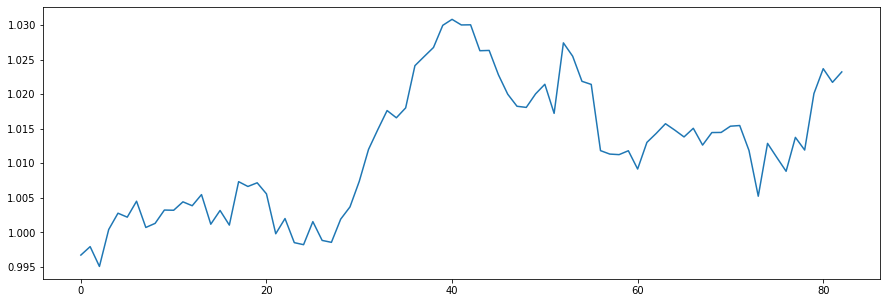

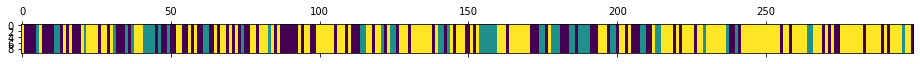

<Figure size 432x288 with 0 Axes>

N [[36. 19. 43.]
 [16. 24. 14.]
 [47. 11. 89.]]
alphas [[1.61171484 0.40702684 1.19325639]
 [0.74753458 1.27120709 1.19325639]
 [0.74753458 0.40702684 2.05743665]]
M [[7. 5. 3.]
 [3. 5. 4.]
 [5. 1. 8.]]
sum_w [[3.]
 [4.]
 [4.]]
barM [[4. 5. 3.]
 [3. 1. 4.]
 [5. 1. 4.]]
pi_z [[0.37420286 0.17802149 0.44777565]
 [0.38326396 0.45216689 0.16456915]
 [0.32799257 0.09291338 0.57909405]]
beta_vec [0.29783492 0.26125744 0.44090764]
hyper>> a_k: 3.2951264864927947  gamma: 0.12966184597950917  rho: 0.2121203993905905


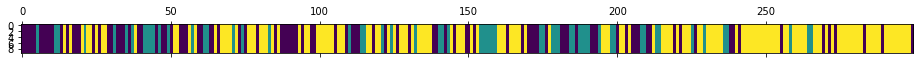

<Figure size 432x288 with 0 Axes>

584
N [[40. 20. 39.]
 [19. 24. 16.]
 [40. 15. 86.]]
alphas [[1.47219152 0.67826688 1.14466809]
 [0.77322797 1.37723043 1.14466809]
 [0.77322797 0.67826688 1.84363163]]
M [[4. 3. 3.]
 [3. 4. 3.]
 [4. 1. 7.]]
sum_w [[3.]
 [4.]
 [2.]]
barM [[1. 3. 3.]
 [3. 0. 3.]
 [4. 1. 5.]]
pi_z [[0.41108431 0.20284623 0.38606945]
 [0.28461905 0.37538301 0.33999794]
 [0.28239079 0.09199958 0.62560963]]
beta_vec [0.3955167  0.24815214 0.35633116]
hyper>> a_k: 2.5563587533206946  gamma: 0.27905487230914716  rho: 0.3540105332777895


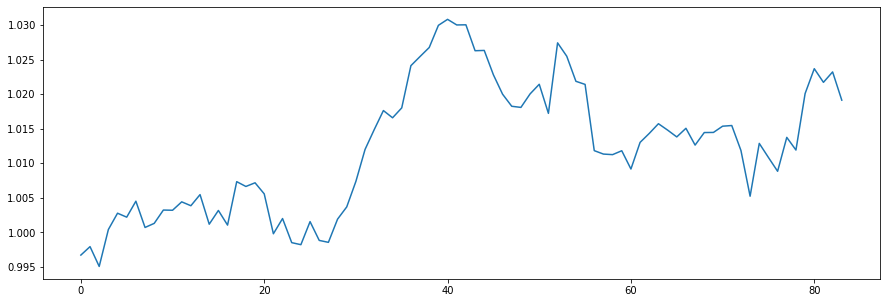

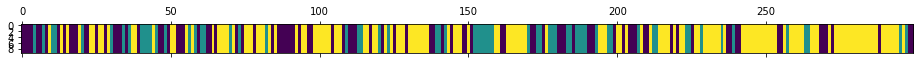

<Figure size 432x288 with 0 Axes>

N [[38. 23. 33.]
 [19. 24. 21.]
 [37. 17. 87.]]
alphas [[1.55812662 0.40979368 0.58843845]
 [0.65314869 1.31477161 0.58843845]
 [0.65314869 0.40979368 1.49341638]]
M [[6. 3. 3.]
 [1. 3. 5.]
 [3. 2. 5.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[5. 3. 3.]
 [1. 0. 5.]
 [3. 2. 1.]]
pi_z [[0.41341742 0.28242222 0.30416036]
 [0.34732463 0.43101487 0.2216605 ]
 [0.22096252 0.11155968 0.66747781]]
beta_vec [0.41952676 0.13760656 0.44286669]
hyper>> a_k: 2.591501587543756  gamma: 0.3862606154422454  rho: 0.41220336644124944


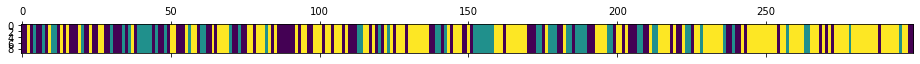

<Figure size 432x288 with 0 Axes>

585
N [[37. 23. 39.]
 [19. 26. 17.]
 [43. 13. 82.]]
alphas [[1.70728068 0.20961275 0.67460816]
 [0.639055   1.27783843 0.67460816]
 [0.639055   0.20961275 1.74283384]]
M [[7. 1. 6.]
 [4. 4. 4.]
 [2. 1. 3.]]
sum_w [[4.]
 [4.]
 [3.]]
barM [[3. 1. 6.]
 [4. 0. 4.]
 [2. 1. 0.]]
pi_z [[0.42913646 0.14969118 0.42117236]
 [0.25172831 0.43632047 0.31195122]
 [0.32037492 0.10588088 0.5737442 ]]
beta_vec [0.37622399 0.05634247 0.56743354]
hyper>> a_k: 3.506035258426671  gamma: 0.31962057941030575  rho: 0.4584812387388895


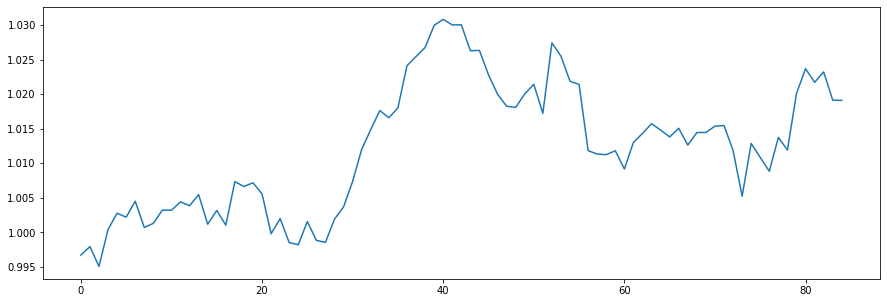

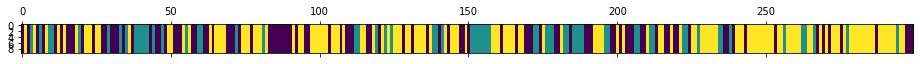

<Figure size 432x288 with 0 Axes>

N [[38. 23. 39.]
 [17. 27. 20.]
 [45. 14. 76.]]
alphas [[2.32174418 0.10697091 1.07732017]
 [0.71429279 1.7144223  1.07732017]
 [0.71429279 0.10697091 2.68477156]]
M [[4. 1. 3.]
 [3. 6. 5.]
 [4. 1. 7.]]
sum_w [[3.]
 [6.]
 [4.]]
barM [[1. 1. 3.]
 [3. 0. 5.]
 [4. 1. 3.]]
pi_z [[0.3646821  0.23018767 0.40513023]
 [0.24024581 0.4166474  0.34310678]
 [0.31700214 0.12732454 0.55567332]]
beta_vec [0.53038915 0.09040439 0.37920646]
hyper>> a_k: 2.678483594641417  gamma: 0.6662798887161351  rho: 0.26573753417500334


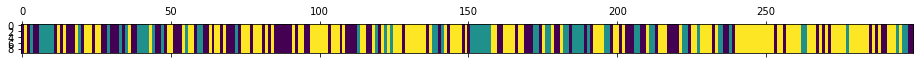

<Figure size 432x288 with 0 Axes>

586
N [[36. 22. 42.]
 [17. 28. 18.]
 [47. 13. 76.]]
alphas [[1.75489525 0.17779921 0.74578913]
 [1.04312162 0.88957284 0.74578913]
 [1.04312162 0.17779921 1.45756276]]
M [[9. 2. 6.]
 [3. 5. 2.]
 [5. 2. 8.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[4. 2. 6.]
 [3. 1. 2.]
 [5. 2. 3.]]
pi_z [[0.33136009 0.1675704  0.50106951]
 [0.25752186 0.41518812 0.32729001]
 [0.38105363 0.07855729 0.54038908]]
beta_vec [0.54361952 0.07118981 0.38519067]
hyper>> a_k: 4.758927734871858  gamma: 0.9665432081481671  rho: 0.29292828254633174


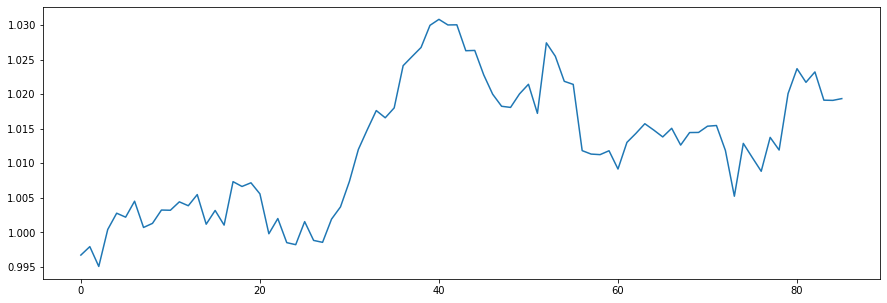

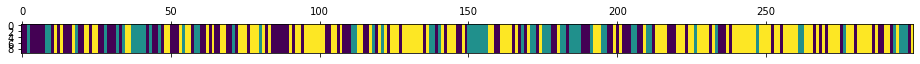

<Figure size 432x288 with 0 Axes>

N [[40. 22. 44.]
 [18. 27. 17.]
 [47. 13. 71.]]
alphas [[3.22325158 0.23954683 1.29612932]
 [1.82922705 1.63357136 1.29612932]
 [1.82922705 0.23954683 2.69015385]]
M [[ 7.  2.  6.]
 [ 5.  9.  3.]
 [10.  2. 12.]]
sum_w [[3.]
 [7.]
 [6.]]
barM [[ 4.  2.  6.]
 [ 5.  2.  3.]
 [10.  2.  6.]]
pi_z [[0.38984884 0.19150111 0.41865005]
 [0.26807012 0.417353   0.31457689]
 [0.42176586 0.14011204 0.4381221 ]]
beta_vec [0.495795   0.07170414 0.43250086]
hyper>> a_k: 4.906939112728306  gamma: 0.9910036549096076  rho: 0.28337279919927144


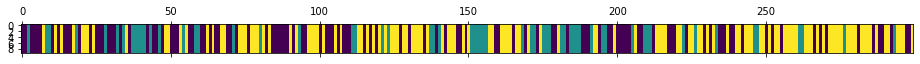

<Figure size 432x288 with 0 Axes>

587
N [[44. 21. 49.]
 [17. 25. 19.]
 [53. 15. 56.]]
alphas [[3.13392945 0.25214372 1.52086594]
 [1.74343638 1.6426368  1.52086594]
 [1.74343638 0.25214372 2.91135901]]
M [[6. 2. 8.]
 [4. 8. 6.]
 [7. 1. 8.]]
sum_w [[3.]
 [6.]
 [4.]]
barM [[3. 2. 8.]
 [4. 2. 6.]
 [7. 1. 4.]]
pi_z [[0.42244296 0.14736595 0.43019109]
 [0.31726798 0.32144737 0.36128465]
 [0.46902613 0.09530028 0.43567359]]
beta_vec [0.43758575 0.10719793 0.45521632]
hyper>> a_k: 4.41982706505871  gamma: 0.9893132033298974  rho: 0.4093901150718885


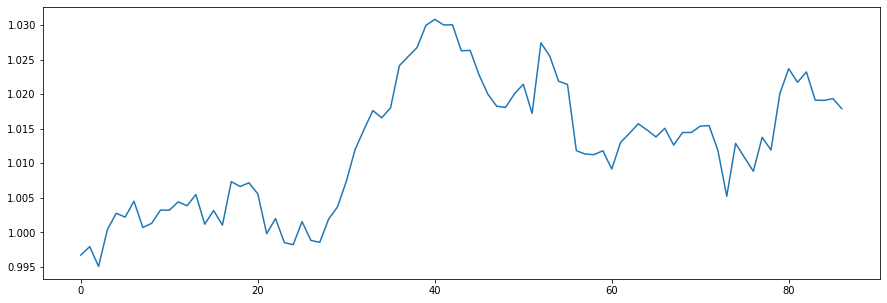

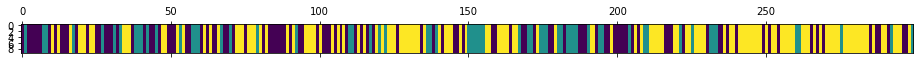

<Figure size 432x288 with 0 Axes>

N [[39. 25. 44.]
 [20. 24. 17.]
 [49. 13. 68.]]
alphas [[2.95170454 0.27982878 1.18829375]
 [1.14227103 2.08926229 1.18829375]
 [1.14227103 0.27982878 2.99772726]]
M [[7. 4. 8.]
 [5. 7. 4.]
 [7. 1. 9.]]
sum_w [[6.]
 [7.]
 [3.]]
barM [[1. 4. 8.]
 [5. 0. 4.]
 [7. 1. 6.]]
pi_z [[0.35181549 0.27045    0.37773451]
 [0.31597616 0.45802266 0.22600119]
 [0.38197651 0.06812053 0.54990296]]
beta_vec [0.31010456 0.11183598 0.57805946]
hyper>> a_k: 3.167483753481006  gamma: 0.3729894958793093  rho: 0.2610456029628224


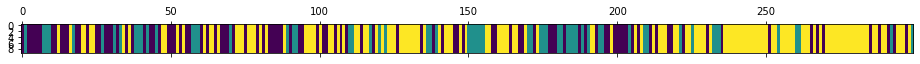

<Figure size 432x288 with 0 Axes>

588
N [[34. 25. 43.]
 [19. 27. 16.]
 [49. 10. 76.]]
alphas [[1.55269652 0.2617662  1.35302104]
 [0.72583881 1.0886239  1.35302104]
 [0.72583881 0.2617662  2.17987874]]
M [[ 6.  3.  5.]
 [ 3.  2.  4.]
 [ 4.  2. 11.]]
sum_w [[2.]
 [2.]
 [4.]]
barM [[4. 3. 5.]
 [3. 0. 4.]
 [4. 2. 7.]]
pi_z [[0.22230471 0.35426588 0.42342941]
 [0.34968801 0.38080234 0.26950966]
 [0.4071751  0.04585903 0.54696587]]
beta_vec [0.35577611 0.23473712 0.40948677]
hyper>> a_k: 2.8648642593697478  gamma: 0.9276698923474735  rho: 0.2761566213679874


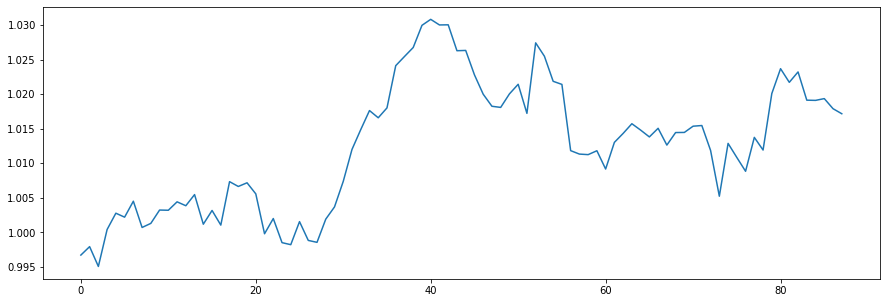

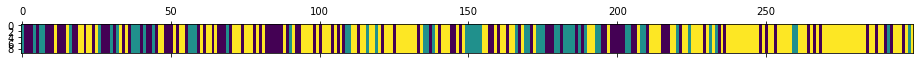

<Figure size 432x288 with 0 Axes>

N [[32. 24. 46.]
 [18. 23. 18.]
 [52. 11. 75.]]
alphas [[1.52892879 0.48677741 0.84915805]
 [0.73777756 1.27792865 0.84915805]
 [0.73777756 0.48677741 1.64030929]]
M [[7. 1. 5.]
 [4. 2. 3.]
 [3. 3. 6.]]
sum_w [[4.]
 [2.]
 [5.]]
barM [[3. 1. 5.]
 [4. 0. 3.]
 [3. 3. 1.]]
pi_z [[0.3445661  0.23422143 0.42121247]
 [0.24880976 0.36743922 0.38375102]
 [0.34509749 0.07291685 0.58198566]]
beta_vec [0.51941599 0.27253673 0.20804728]
hyper>> a_k: 2.759681000323993  gamma: 0.7224590254854896  rho: 0.2502389699788551


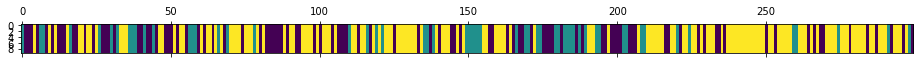

<Figure size 432x288 with 0 Axes>

589
N [[36. 21. 44.]
 [16. 21. 19.]
 [49. 14. 79.]]
alphas [[1.76530401 0.56390609 0.4304709 ]
 [1.07472428 1.25448582 0.4304709 ]
 [1.07472428 0.56390609 1.12105063]]
M [[7. 3. 2.]
 [4. 1. 2.]
 [4. 3. 6.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[6. 3. 2.]
 [4. 0. 2.]
 [4. 3. 3.]]
pi_z [[0.39014045 0.1708992  0.43896035]
 [0.29278022 0.32617978 0.38104   ]
 [0.3736257  0.09239388 0.53398042]]
beta_vec [0.60715445 0.23807653 0.15476902]
hyper>> a_k: 2.372969319534182  gamma: 0.4800624220764516  rho: 0.29859477657983635


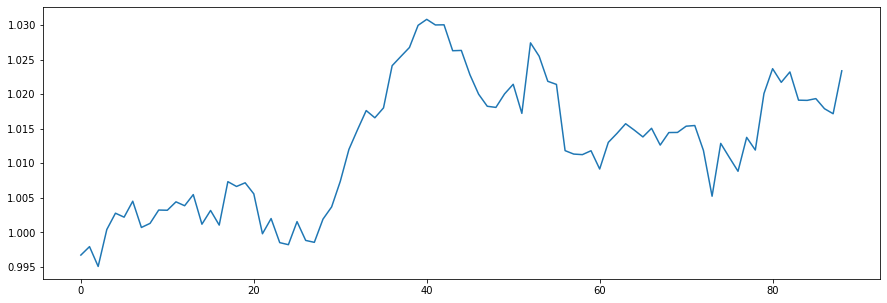

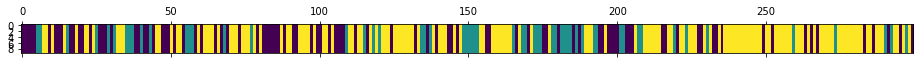

<Figure size 432x288 with 0 Axes>

N [[37. 20. 39.]
 [14. 21. 22.]
 [46. 16. 84.]]
alphas [[1.71911204 0.39625769 0.25759959]
 [1.0105558  1.10481393 0.25759959]
 [1.0105558  0.39625769 0.96615583]]
M [[6. 2. 4.]
 [4. 3. 2.]
 [4. 1. 5.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[3. 2. 4.]
 [4. 2. 2.]
 [4. 1. 2.]]
pi_z [[0.37542971 0.31036998 0.3142003 ]
 [0.36592642 0.28912343 0.34495016]
 [0.32072172 0.07257886 0.60669942]]
beta_vec [0.58068731 0.14322452 0.27608817]
hyper>> a_k: 2.515355565434077  gamma: 0.5155486970516198  rho: 0.13633869504605356


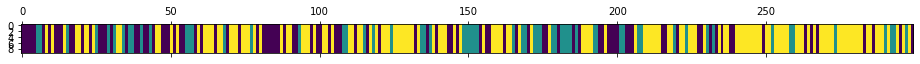

<Figure size 432x288 with 0 Axes>

590
N [[35. 24. 39.]
 [14. 23. 25.]
 [49. 15. 75.]]
alphas [[1.60443427 0.31114314 0.59977815]
 [1.26149397 0.65408344 0.59977815]
 [1.26149397 0.31114314 0.94271845]]
M [[5. 2. 3.]
 [3. 4. 1.]
 [4. 2. 7.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[3. 2. 3.]
 [3. 1. 1.]
 [4. 2. 3.]]
pi_z [[0.38634576 0.30208407 0.31157017]
 [0.26181246 0.36124698 0.37694056]
 [0.37406    0.10706678 0.51887322]]
beta_vec [0.46982739 0.27196528 0.25820733]
hyper>> a_k: 2.8904006896780112  gamma: 0.5023923235537547  rho: 0.43074215240224073


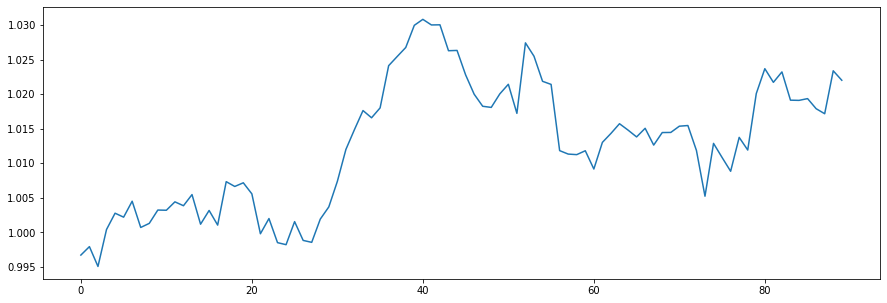

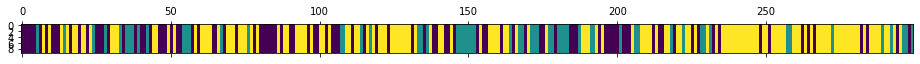

<Figure size 432x288 with 0 Axes>

N [[35. 22. 43.]
 [13. 24. 22.]
 [51. 14. 75.]]
alphas [[2.01806354 0.44748713 0.42485003]
 [0.77304612 1.69250454 0.42485003]
 [0.77304612 0.44748713 1.66986744]]
M [[3. 3. 3.]
 [2. 4. 3.]
 [5. 1. 7.]]
sum_w [[2.]
 [2.]
 [6.]]
barM [[1. 3. 3.]
 [2. 2. 3.]
 [5. 1. 1.]]
pi_z [[0.38954473 0.21190867 0.3985466 ]
 [0.26402312 0.40591943 0.33005745]
 [0.42604897 0.03780953 0.5361415 ]]
beta_vec [0.56539096 0.21092241 0.22368664]
hyper>> a_k: 2.915150452551874  gamma: 0.7772813252215057  rho: 0.230184581320287


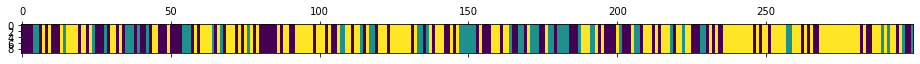

<Figure size 432x288 with 0 Axes>

591
N [[37. 24. 42.]
 [12. 24. 22.]
 [54. 10. 74.]]
alphas [[1.93983223 0.47333683 0.5019814 ]
 [1.26880954 1.14435951 0.5019814 ]
 [1.26880954 0.47333683 1.17300408]]
M [[8. 3. 3.]
 [3. 7. 1.]
 [8. 1. 7.]]
sum_w [[1.]
 [6.]
 [5.]]
barM [[7. 3. 3.]
 [3. 1. 1.]
 [8. 1. 2.]]
pi_z [[0.31932488 0.20511813 0.47555698]
 [0.25656661 0.34682948 0.39660391]
 [0.39361061 0.06519339 0.541196  ]]
beta_vec [0.62284402 0.11559662 0.26155936]
hyper>> a_k: 3.41292810818448  gamma: 1.6382507369539685  rho: 0.3174879743017304


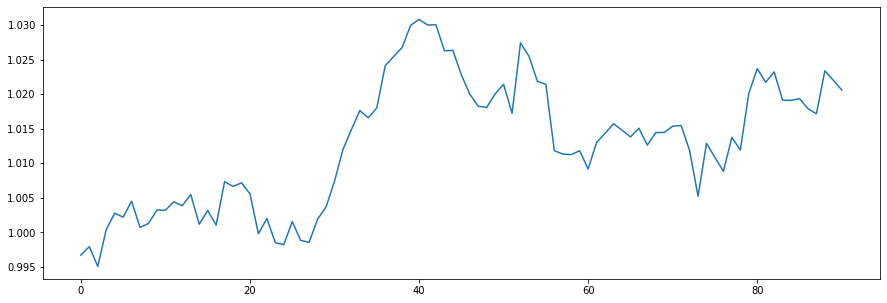

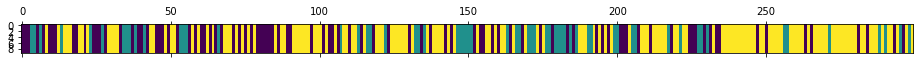

<Figure size 432x288 with 0 Axes>

N [[24. 25. 45.]
 [15. 24. 22.]
 [55. 11. 78.]]
alphas [[2.53439436 0.26926666 0.60926709]
 [1.45083073 1.35283029 0.60926709]
 [1.45083073 0.26926666 1.69283072]]
M [[6. 2. 2.]
 [3. 6. 2.]
 [4. 2. 9.]]
sum_w [[4.]
 [6.]
 [7.]]
barM [[2. 2. 2.]
 [3. 0. 2.]
 [4. 2. 2.]]
pi_z [[0.32547731 0.26414788 0.41037481]
 [0.27079542 0.4186833  0.31052128]
 [0.32252096 0.10393172 0.57354732]]
beta_vec [0.45523574 0.27574121 0.26902305]
hyper>> a_k: 2.958656298337063  gamma: 0.572172356838211  rho: 0.4319600910142512


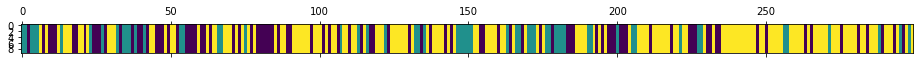

<Figure size 432x288 with 0 Axes>

592
N [[30. 19. 43.]
 [11. 23. 23.]
 [51. 15. 84.]]
alphas [[2.04310649 0.46342029 0.45212951]
 [0.76508505 1.74144174 0.45212951]
 [0.76508505 0.46342029 1.73015096]]
M [[4. 3. 4.]
 [2. 5. 3.]
 [5. 1. 8.]]
sum_w [[2.]
 [4.]
 [6.]]
barM [[2. 3. 4.]
 [2. 1. 3.]
 [5. 1. 2.]]
pi_z [[0.39751195 0.18495932 0.41752873]
 [0.28687578 0.35404455 0.35907967]
 [0.28937327 0.10016663 0.6104601 ]]
beta_vec [0.35470492 0.2645292  0.38076589]
hyper>> a_k: 3.5422561902371137  gamma: 0.7295603783617164  rho: 0.39449869377950536


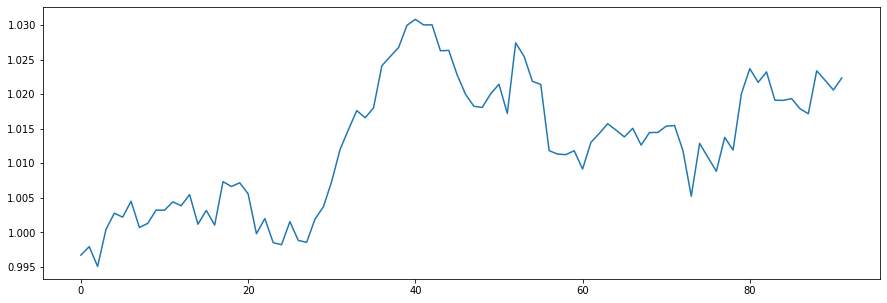

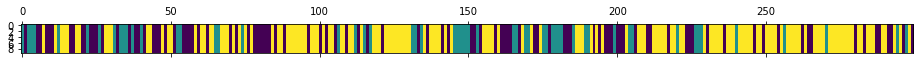

<Figure size 432x288 with 0 Axes>

N [[35. 19. 44.]
 [18. 22. 17.]
 [46. 16. 82.]]
alphas [[2.158201   0.567373   0.81668219]
 [0.76078556 1.96478844 0.81668219]
 [0.76078556 0.567373   2.21409763]]
M [[9. 1. 5.]
 [4. 7. 3.]
 [4. 2. 6.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[4. 1. 5.]
 [4. 3. 3.]
 [4. 2. 1.]]
pi_z [[0.31920499 0.22712794 0.45366707]
 [0.29500543 0.4640285  0.24096607]
 [0.28670059 0.11285007 0.60044934]]
beta_vec [0.37062323 0.34041217 0.2889646 ]
hyper>> a_k: 3.7887776184653457  gamma: 0.03750346870994818  rho: 0.4399276226956818


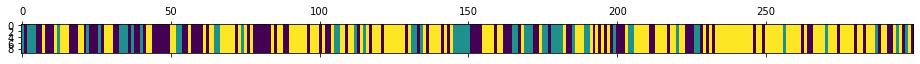

<Figure size 432x288 with 0 Axes>

593
N [[40. 16. 44.]
 [13. 23. 18.]
 [47. 15. 83.]]
alphas [[2.45324659 0.72235112 0.61317991]
 [0.78645866 2.38913905 0.61317991]
 [0.78645866 0.72235112 2.27996784]]
M [[ 5.  3.  1.]
 [ 2.  4.  4.]
 [ 4.  1. 11.]]
sum_w [[2.]
 [3.]
 [8.]]
barM [[3. 3. 1.]
 [2. 1. 4.]
 [4. 1. 3.]]
pi_z [[0.42623005 0.16624385 0.4075261 ]
 [0.21090872 0.41867873 0.37041255]
 [0.27682652 0.08900065 0.63417283]]
beta_vec [0.33319481 0.14942825 0.51737693]
hyper>> a_k: 2.597279587105002  gamma: 0.3644611074275218  rho: 0.4698018547181681


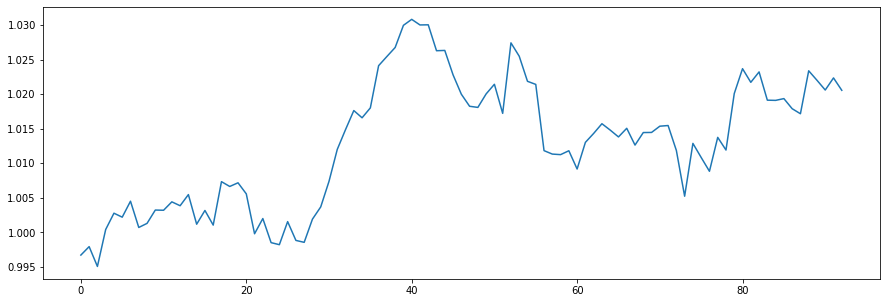

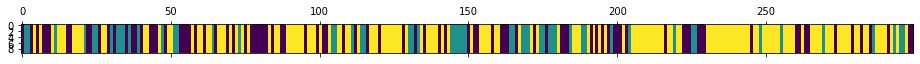

<Figure size 432x288 with 0 Axes>

N [[31. 18. 43.]
 [14. 22. 20.]
 [47. 16. 88.]]
alphas [[1.67904029 0.20577359 0.71246571]
 [0.45883352 1.42598035 0.71246571]
 [0.45883352 0.20577359 1.93267248]]
M [[4. 1. 3.]
 [1. 2. 1.]
 [1. 1. 8.]]
sum_w [[3.]
 [0.]
 [5.]]
barM [[1. 1. 3.]
 [1. 2. 1.]
 [1. 1. 3.]]
pi_z [[0.38020434 0.2051941  0.41460155]
 [0.14534013 0.47683988 0.37781999]
 [0.26522691 0.11229875 0.62247434]]
beta_vec [0.06112468 0.31779218 0.62108314]
hyper>> a_k: 2.273360843921096  gamma: 0.23575867913256524  rho: 0.3836968869772151


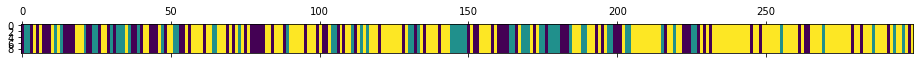

<Figure size 432x288 with 0 Axes>

594
N [[26. 19. 37.]
 [10. 24. 27.]
 [46. 18. 92.]]
alphas [[0.957922   0.44525207 0.87018678]
 [0.08564052 1.31753354 0.87018678]
 [0.08564052 0.44525207 1.74246826]]
M [[1. 1. 4.]
 [3. 4. 3.]
 [1. 5. 7.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[0. 1. 4.]
 [3. 2. 3.]
 [1. 5. 3.]]
pi_z [[0.27304419 0.28173467 0.44522114]
 [0.14696228 0.48570276 0.36733496]
 [0.31260028 0.12491584 0.56248389]]
beta_vec [0.12985092 0.55931472 0.31083436]
hyper>> a_k: 2.8985512355197227  gamma: 0.8971992865793038  rho: 0.22153192801189067


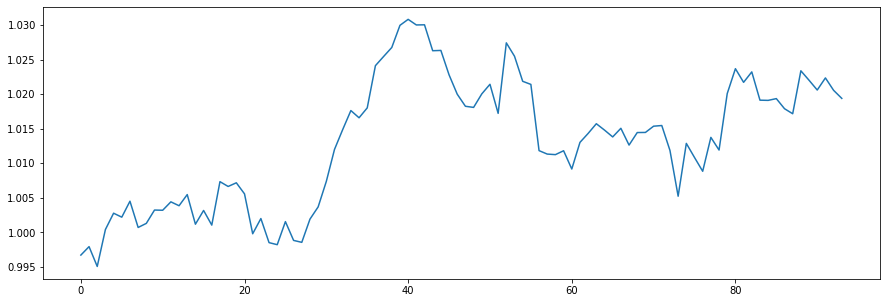

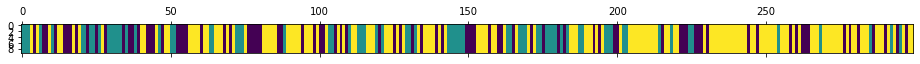

<Figure size 432x288 with 0 Axes>

N [[26. 21. 38.]
 [14. 33. 25.]
 [45. 18. 79.]]
alphas [[0.93512111 1.26205428 0.70137584]
 [0.29299947 1.90417592 0.70137584]
 [0.29299947 1.26205428 1.34349749]]
M [[2. 5. 3.]
 [2. 8. 4.]
 [1. 6. 8.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[1. 5. 3.]
 [2. 6. 4.]
 [1. 6. 5.]]
pi_z [[0.27817535 0.24296445 0.4788602 ]
 [0.14144466 0.4944368  0.36411853]
 [0.30663    0.11490234 0.57846766]]
beta_vec [0.11913077 0.53619327 0.34467596]
hyper>> a_k: 3.7728255603288536  gamma: 0.9414467950129253  rho: 0.1513396350329957


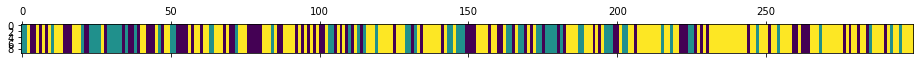

<Figure size 432x288 with 0 Axes>

595
N [[27. 18. 40.]
 [12. 25. 26.]
 [46. 20. 85.]]
alphas [[0.9524166  1.71680909 1.10359987]
 [0.38143856 2.28778713 1.10359987]
 [0.38143856 1.71680909 1.67457792]]
M [[6. 8. 5.]
 [3. 8. 2.]
 [3. 5. 8.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[3. 8. 5.]
 [3. 7. 2.]
 [3. 5. 3.]]
pi_z [[0.29723101 0.27734583 0.42542316]
 [0.16036153 0.47859215 0.36104632]
 [0.32501206 0.14982986 0.52515807]]
beta_vec [0.17881056 0.55334952 0.26783992]
hyper>> a_k: 5.6476363844344855  gamma: 0.8066394083029129  rho: 0.18301624461671256


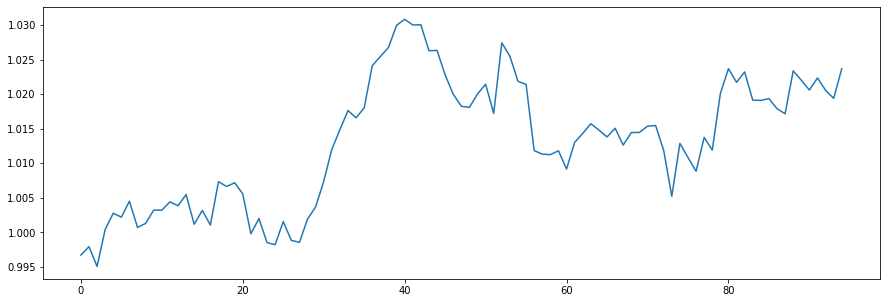

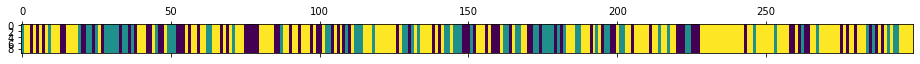

<Figure size 432x288 with 0 Axes>

N [[24. 21. 36.]
 [17. 27. 27.]
 [40. 23. 84.]]
alphas [[1.858646   2.55316972 1.23582066]
 [0.8250368  3.58677892 1.23582066]
 [0.8250368  2.55316972 2.26942987]]
M [[ 6.  4.  4.]
 [ 3.  8.  4.]
 [ 5. 10. 10.]]
sum_w [[4.]
 [1.]
 [5.]]
barM [[ 2.  4.  4.]
 [ 3.  7.  4.]
 [ 5. 10.  5.]]
pi_z [[0.30913124 0.30587975 0.38498901]
 [0.23514739 0.41223186 0.35262075]
 [0.28569368 0.16582423 0.54848209]]
beta_vec [0.14962592 0.55994619 0.29042789]
hyper>> a_k: 4.255494238879972  gamma: 0.715431106731931  rho: 0.22041304677869214


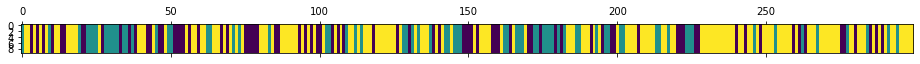

<Figure size 432x288 with 0 Axes>

596
N [[24. 19. 37.]
 [14. 28. 29.]
 [42. 24. 82.]]
alphas [[1.43435459 1.85763705 0.9635026 ]
 [0.49638814 2.7956035  0.9635026 ]
 [0.49638814 1.85763705 1.90146905]]
M [[6. 5. 4.]
 [3. 7. 5.]
 [3. 3. 6.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[3. 5. 4.]
 [3. 5. 5.]
 [3. 3. 3.]]
pi_z [[0.26829265 0.24515348 0.48655387]
 [0.13584609 0.44572597 0.41842795]
 [0.31897347 0.14713093 0.5338956 ]]
beta_vec [0.20440078 0.51525463 0.28034459]
hyper>> a_k: 4.084504078611428  gamma: 1.1949940163536268  rho: 0.2813528834802844


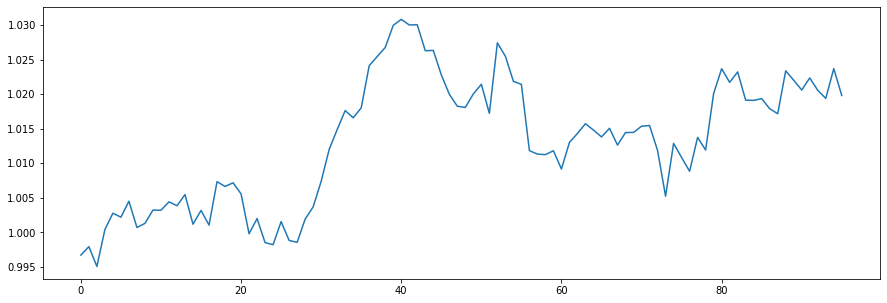

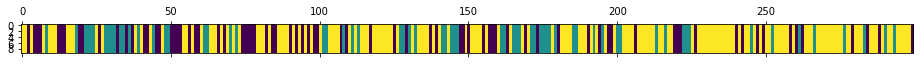

<Figure size 432x288 with 0 Axes>

N [[23. 14. 40.]
 [ 9. 25. 32.]
 [46. 27. 83.]]
alphas [[1.74916809 1.51243572 0.82290027]
 [0.59998109 2.66162272 0.82290027]
 [0.59998109 1.51243572 1.97208727]]
M [[4. 5. 3.]
 [3. 6. 2.]
 [4. 2. 9.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[2. 5. 3.]
 [3. 3. 2.]
 [4. 2. 4.]]
pi_z [[0.269238   0.22973793 0.50102408]
 [0.15339273 0.38500598 0.46160129]
 [0.29859614 0.12303243 0.57837143]]
beta_vec [0.42261587 0.34368249 0.23370164]
hyper>> a_k: 2.8775465741326904  gamma: 0.3459561768604554  rho: 0.4397992485808036


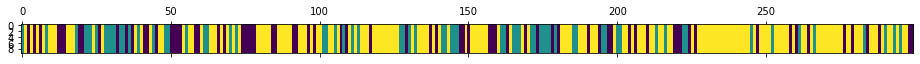

<Figure size 432x288 with 0 Axes>

597
N [[21. 17. 35.]
 [10. 24. 33.]
 [41. 26. 92.]]
alphas [[1.94680118 0.55401747 0.37672792]
 [0.68125836 1.81956029 0.37672792]
 [0.68125836 0.55401747 1.64227074]]
M [[ 6.  2.  2.]
 [ 2.  6.  3.]
 [ 2.  1. 11.]]
sum_w [[3.]
 [6.]
 [9.]]
barM [[3. 2. 2.]
 [2. 0. 3.]
 [2. 1. 2.]]
pi_z [[0.29596571 0.20651294 0.49752134]
 [0.21120027 0.37541407 0.41338567]
 [0.27601684 0.14315141 0.58083175]]
beta_vec [0.58842037 0.11195764 0.29962199]
hyper>> a_k: 3.9786701979107195  gamma: 0.8018415982754008  rho: 0.5066323574391962


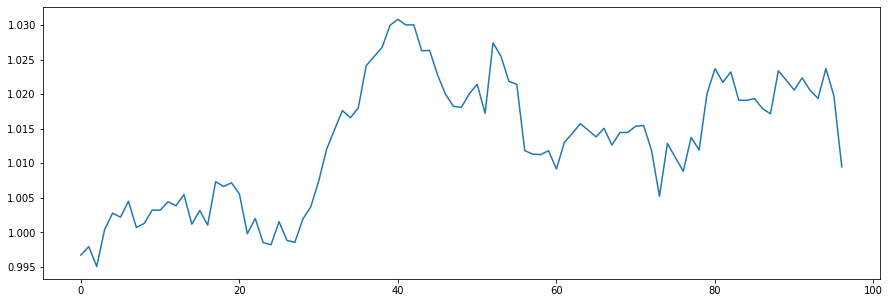

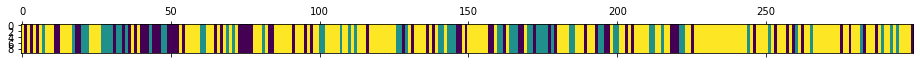

<Figure size 432x288 with 0 Axes>

N [[ 20.  15.  34.]
 [ 11.  25.  28.]
 [ 39.  24. 103.]]
alphas [[3.17076114 0.21976693 0.58814213]
 [1.15503807 2.23548999 0.58814213]
 [1.15503807 0.21976693 2.6038652 ]]
M [[ 6.  1.  2.]
 [ 3.  5.  3.]
 [ 4.  2. 14.]]
sum_w [[ 4.]
 [ 4.]
 [10.]]
barM [[2. 1. 2.]
 [3. 1. 3.]
 [4. 2. 4.]]
pi_z [[0.3312553  0.19744454 0.47130016]
 [0.14707649 0.41229158 0.44063193]
 [0.26582142 0.14370021 0.59047837]]
beta_vec [0.51437184 0.14765874 0.33796942]
hyper>> a_k: 2.8986168507276795  gamma: 0.6432773535314169  rho: 0.4210707608547854


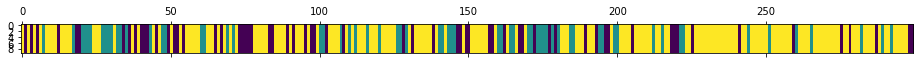

<Figure size 432x288 with 0 Axes>

598
N [[ 19.  13.  32.]
 [ 10.  24.  30.]
 [ 35.  27. 109.]]
alphas [[2.08368713 0.24778525 0.56714447]
 [0.86316433 1.46830805 0.56714447]
 [0.86316433 0.24778525 1.78766727]]
M [[8. 2. 1.]
 [3. 7. 3.]
 [3. 1. 7.]]
sum_w [[5.]
 [6.]
 [5.]]
barM [[3. 2. 1.]
 [3. 1. 3.]
 [3. 1. 2.]]
pi_z [[0.2781766  0.26571536 0.45610804]
 [0.11260021 0.40431293 0.48308686]
 [0.20347273 0.1776023  0.61892496]]
beta_vec [0.600069  0.1287167 0.2712143]
hyper>> a_k: 3.2613099823852467  gamma: 0.37613471670694  rho: 0.36452063060427714


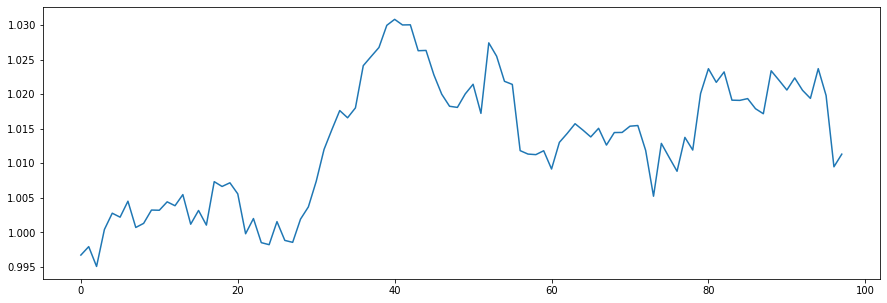

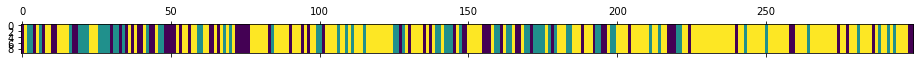

<Figure size 432x288 with 0 Axes>

N [[ 21.  16.  28.]
 [  9.  25.  33.]
 [ 35.  26. 106.]]
alphas [[2.43245489 0.26676474 0.56209035]
 [1.24364012 1.45557951 0.56209035]
 [1.24364012 0.26676474 1.75090512]]
M [[3. 2. 1.]
 [2. 5. 3.]
 [5. 2. 9.]]
sum_w [[3.]
 [4.]
 [8.]]
barM [[0. 2. 1.]
 [2. 1. 3.]
 [5. 2. 1.]]
pi_z [[0.32216152 0.23635881 0.44147967]
 [0.20406704 0.34617037 0.44976258]
 [0.2172358  0.12541637 0.65734782]]
beta_vec [0.41524058 0.27401687 0.31074255]
hyper>> a_k: 2.7035819552940286  gamma: 1.639576429192512  rho: 0.40488906207448716


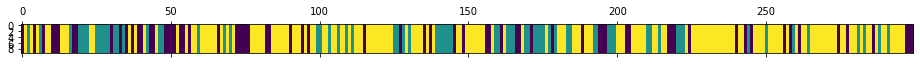

<Figure size 432x288 with 0 Axes>

599
N [[23. 15. 30.]
 [10. 30. 31.]
 [35. 26. 99.]]
alphas [[1.76274428 0.44087429 0.49996338]
 [0.66809352 1.53552505 0.49996338]
 [0.66809352 0.44087429 1.59461414]]
M [[ 4.  2.  3.]
 [ 2.  6.  1.]
 [ 5.  2. 10.]]
sum_w [[1.]
 [6.]
 [8.]]
barM [[3. 2. 3.]
 [2. 0. 1.]
 [5. 2. 2.]]
pi_z [[0.38685442 0.20667359 0.40647199]
 [0.13529266 0.39083046 0.47387688]
 [0.2519746  0.18653961 0.56148578]]
beta_vec [0.44566011 0.13677146 0.41756843]
hyper>> a_k: 3.3515301077334456  gamma: 0.8096979270762343  rho: 0.3463885571322147


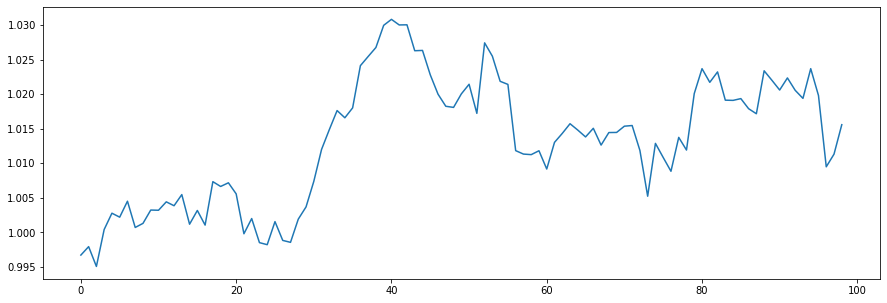

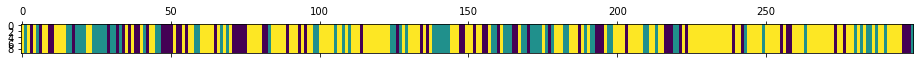

<Figure size 432x288 with 0 Axes>

N [[ 21.  14.  29.]
 [  9.  31.  33.]
 [ 33.  29. 100.]]
alphas [[2.13719401 0.29961134 0.91472476]
 [0.97626234 1.46054301 0.91472476]
 [0.97626234 0.29961134 2.07565644]]
M [[ 4.  1.  4.]
 [ 3.  4.  6.]
 [ 3.  2. 10.]]
sum_w [[4.]
 [3.]
 [7.]]
barM [[0. 1. 4.]
 [3. 1. 6.]
 [3. 2. 3.]]
pi_z [[0.27952923 0.21421349 0.50625729]
 [0.12794717 0.48987542 0.38217741]
 [0.24172981 0.18458183 0.57368836]]
beta_vec [0.34831749 0.1461479  0.50553461]
hyper>> a_k: 3.629086821183728  gamma: 0.598018039837592  rho: 0.2792219519145675


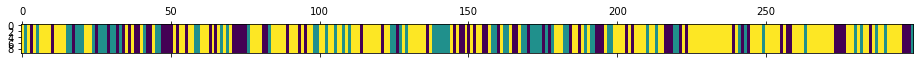

<Figure size 432x288 with 0 Axes>

600
N [[23. 17. 33.]
 [13. 26. 32.]
 [37. 28. 90.]]
alphas [[1.92443778 0.38228874 1.3223603 ]
 [0.91111708 1.39560944 1.3223603 ]
 [0.91111708 0.38228874 2.33568101]]
M [[ 4.  2. 11.]
 [ 1.  3.  3.]
 [ 2.  2.  7.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[ 0.  2. 11.]
 [ 1.  1.  3.]
 [ 2.  2.  4.]]
pi_z [[0.25051787 0.20937552 0.54010661]
 [0.2031931  0.35704726 0.43975964]
 [0.18697903 0.17467301 0.63834796]]
beta_vec [0.09272403 0.2427527  0.66452328]
hyper>> a_k: 2.705906329629568  gamma: 0.6294152650210686  rho: 0.24656247281704144


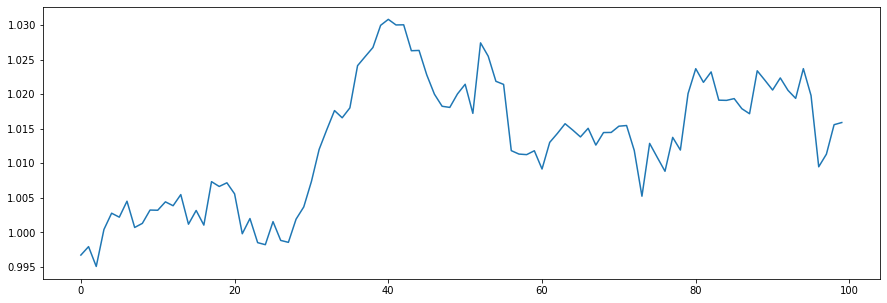

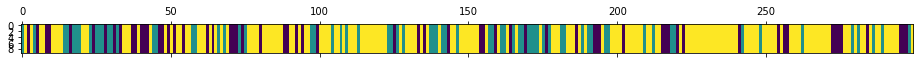

<Figure size 432x288 with 0 Axes>

N [[ 19.  16.  28.]
 [ 13.  23.  34.]
 [ 31.  30. 105.]]
alphas [[0.85621434 0.49490754 1.35478445]
 [0.18903939 1.16208249 1.35478445]
 [0.18903939 0.49490754 2.02195941]]
M [[4. 2. 5.]
 [1. 3. 5.]
 [2. 5. 9.]]
sum_w [[4.]
 [0.]
 [5.]]
barM [[0. 2. 5.]
 [1. 3. 5.]
 [2. 5. 4.]]
pi_z [[0.28300631 0.23943699 0.4775567 ]
 [0.11048808 0.38847744 0.50103448]
 [0.19480947 0.14135029 0.66384024]]
beta_vec [0.0869671  0.34548238 0.56755052]
hyper>> a_k: 2.9825690892603403  gamma: 0.9424820167871699  rho: 0.34400690785747906


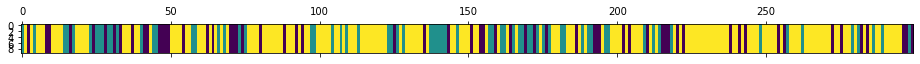

<Figure size 432x288 with 0 Axes>

601
N [[ 13.  19.  29.]
 [ 14.  20.  34.]
 [ 34.  29. 107.]]
alphas [[1.19617939 0.67595172 1.11043798]
 [0.17015502 1.70197609 1.11043798]
 [0.17015502 0.67595172 2.13646235]]
M [[ 3.  5.  4.]
 [ 1.  5.  3.]
 [ 1.  3. 11.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[0. 5. 4.]
 [1. 3. 3.]
 [1. 3. 6.]]
pi_z [[0.22370756 0.32671997 0.44957247]
 [0.20857021 0.33779306 0.45363673]
 [0.20612051 0.13404732 0.65983217]]
beta_vec [0.09012545 0.442169   0.46770554]
hyper>> a_k: 2.2872098909274188  gamma: 0.2660423642180712  rho: 0.5672023363761767


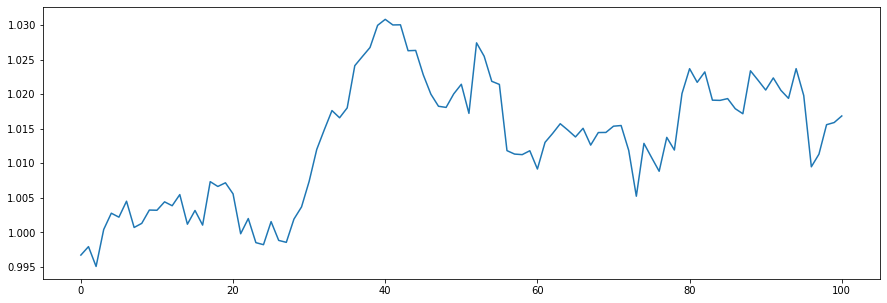

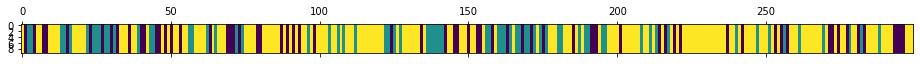

<Figure size 432x288 with 0 Axes>

N [[ 14.  21.  31.]
 [ 16.  21.  32.]
 [ 36.  27. 101.]]
alphas [[1.3865259  0.4377027  0.4629813 ]
 [0.08921511 1.73501349 0.4629813 ]
 [0.08921511 0.4377027  1.76029209]]
M [[2. 2. 4.]
 [1. 5. 2.]
 [1. 1. 7.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[0. 2. 4.]
 [1. 2. 2.]
 [1. 1. 2.]]
pi_z [[0.232404   0.25919004 0.50840596]
 [0.27181819 0.2337387  0.49444311]
 [0.22450372 0.13224873 0.64324755]]
beta_vec [0.07785135 0.46872143 0.45342723]
hyper>> a_k: 2.0920311666869154  gamma: 0.3971511995452342  rho: 0.37421199084117296


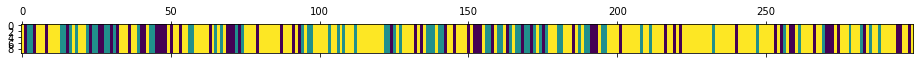

<Figure size 432x288 with 0 Axes>

602
N [[ 15.  18.  30.]
 [ 14.  18.  35.]
 [ 34.  31. 104.]]
alphas [[0.88478364 0.6136351  0.59361243]
 [0.10192049 1.39649825 0.59361243]
 [0.10192049 0.6136351  1.37647557]]
M [[1. 2. 4.]
 [1. 2. 4.]
 [1. 2. 6.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[0. 2. 4.]
 [1. 2. 4.]
 [1. 2. 2.]]
pi_z [[0.21468895 0.27674302 0.50856804]
 [0.17457829 0.30808711 0.5173346 ]
 [0.2114892  0.15028719 0.63822361]]
beta_vec [0.03695256 0.27595732 0.68709011]
hyper>> a_k: 1.8855327425509003  gamma: 1.2761813468532464  rho: 0.11129038617280837


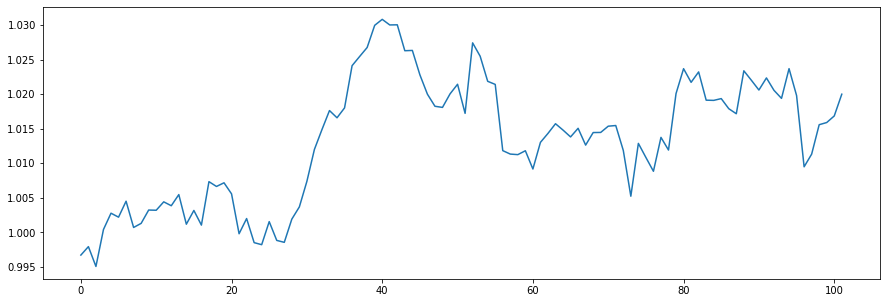

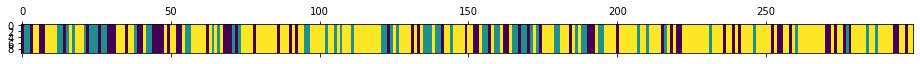

<Figure size 432x288 with 0 Axes>

N [[ 18.  16.  32.]
 [ 11.  19.  33.]
 [ 37.  28. 105.]]
alphas [[0.27176275 0.46241923 1.15135077]
 [0.06192108 0.67226089 1.15135077]
 [0.06192108 0.46241923 1.36119244]]
M [[3. 2. 4.]
 [1. 2. 2.]
 [1. 5. 6.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[1. 2. 4.]
 [1. 2. 2.]
 [1. 5. 5.]]
pi_z [[0.18164513 0.21784858 0.6005063 ]
 [0.17727047 0.31927833 0.5034512 ]
 [0.15776116 0.18210387 0.66013496]]
beta_vec [0.10161099 0.40532283 0.49306617]
hyper>> a_k: 2.2543428203915563  gamma: 1.519095635446035  rho: 0.0926977201693616


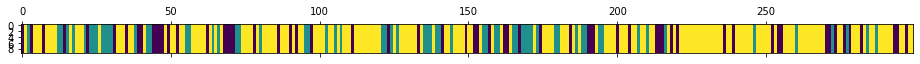

<Figure size 432x288 with 0 Axes>

603
N [[ 16.  15.  30.]
 [  8.  23.  34.]
 [ 37.  27. 109.]]
alphas [[0.41680455 0.82903532 1.00850295]
 [0.20783211 1.03800776 1.00850295]
 [0.20783211 0.82903532 1.21747539]]
M [[4. 4. 3.]
 [1. 6. 4.]
 [1. 2. 3.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[2. 4. 3.]
 [1. 5. 4.]
 [1. 2. 3.]]
pi_z [[0.31322317 0.18305632 0.50372051]
 [0.08125588 0.31909817 0.59964595]
 [0.24836743 0.11714716 0.63448542]]
beta_vec [0.20346461 0.3977546  0.39878079]
hyper>> a_k: 2.209814891334405  gamma: 0.4647910401428432  rho: 0.15921736682771465


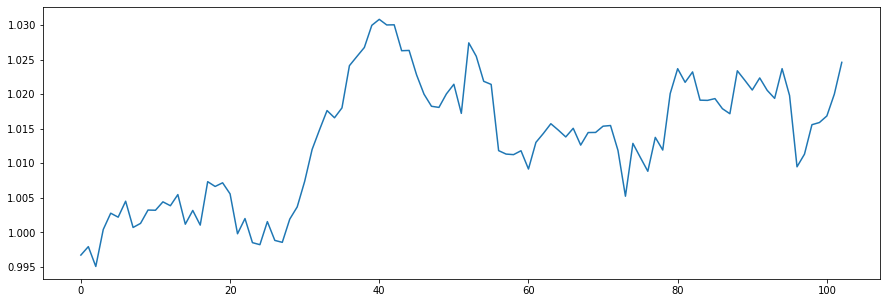

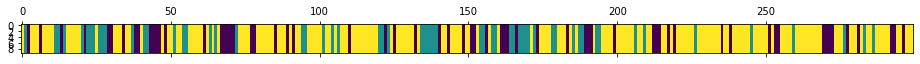

<Figure size 432x288 with 0 Axes>

N [[ 22.  13.  29.]
 [  6.  23.  31.]
 [ 36.  24. 115.]]
alphas [[0.72987286 0.7390177  0.74092434]
 [0.37803195 1.0908586  0.74092434]
 [0.37803195 0.7390177  1.09276525]]
M [[4. 3. 4.]
 [1. 3. 7.]
 [2. 3. 4.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[0. 3. 4.]
 [1. 1. 7.]
 [2. 3. 2.]]
pi_z [[0.32996053 0.21385876 0.45618071]
 [0.09971476 0.43709569 0.46318955]
 [0.19999905 0.12496525 0.6750357 ]]
beta_vec [0.09816237 0.27567322 0.62616441]
hyper>> a_k: 2.8076863712213207  gamma: 0.5926434605808819  rho: 0.2551765320331178


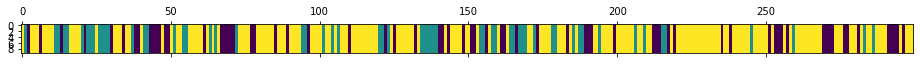

<Figure size 432x288 with 0 Axes>

604
N [[ 26.  14.  29.]
 [  6.  24.  30.]
 [ 37.  22. 111.]]
alphas [[0.92173583 0.5764963  1.30945425]
 [0.20528016 1.29295197 1.30945425]
 [0.20528016 0.5764963  2.02590992]]
M [[ 3.  2.  6.]
 [ 1.  4.  5.]
 [ 2.  4. 10.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[1. 2. 6.]
 [1. 2. 5.]
 [2. 4. 9.]]
pi_z [[0.45256438 0.14802098 0.39941464]
 [0.08693488 0.34769022 0.56537491]
 [0.21856405 0.18494972 0.59648622]]
beta_vec [0.25924738 0.20189515 0.53885747]
hyper>> a_k: 3.1318463362987594  gamma: 0.8526609402605777  rho: 0.3486933813278707


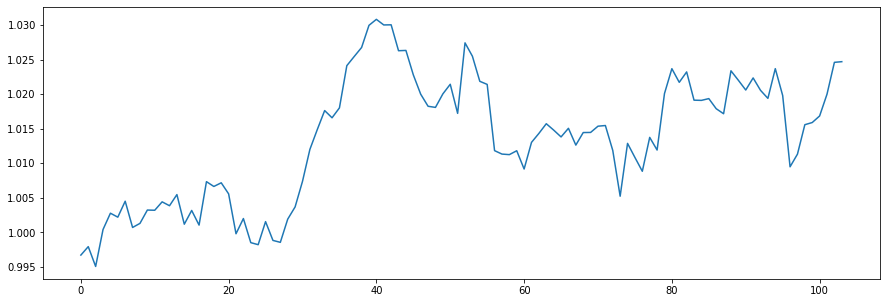

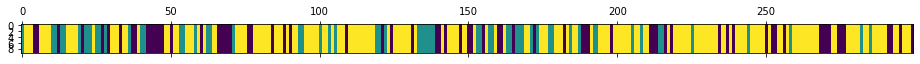

<Figure size 432x288 with 0 Axes>

N [[ 26.  13.  30.]
 [  9.  23.  29.]
 [ 35.  25. 109.]]
alphas [[1.62086489 0.41182415 1.09915729]
 [0.5288108  1.50387824 1.09915729]
 [0.5288108  0.41182415 2.19121138]]
M [[ 7.  1.  2.]
 [ 5.  3.  4.]
 [ 2.  3. 10.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[4. 1. 2.]
 [5. 0. 4.]
 [2. 3. 5.]]
pi_z [[0.36799837 0.15558386 0.47641777]
 [0.10165244 0.36044197 0.53790559]
 [0.17855115 0.11717739 0.70427146]]
beta_vec [0.50790094 0.2488509  0.24324816]
hyper>> a_k: 2.9473931935488915  gamma: 0.10543706305839894  rho: 0.4072614921472304


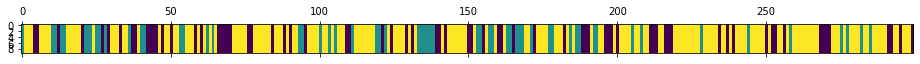

<Figure size 432x288 with 0 Axes>

605
N [[ 27.  12.  34.]
 [  6.  22.  30.]
 [ 40.  24. 104.]]
alphas [[2.08767967 0.43475085 0.42496268]
 [0.88731992 1.6351106  0.42496268]
 [0.88731992 0.43475085 1.62532243]]
M [[5. 1. 2.]
 [1. 6. 1.]
 [1. 2. 8.]]
sum_w [[4.]
 [6.]
 [6.]]
barM [[1. 1. 2.]
 [1. 0. 1.]
 [1. 2. 2.]]
pi_z [[0.42102103 0.17398223 0.40499674]
 [0.12493497 0.34359291 0.53147212]
 [0.2033535  0.17661245 0.62003405]]
beta_vec [0.20330906 0.33357488 0.46311606]
hyper>> a_k: 1.878180945051665  gamma: 1.4450953833954245  rho: 0.5411025033567645


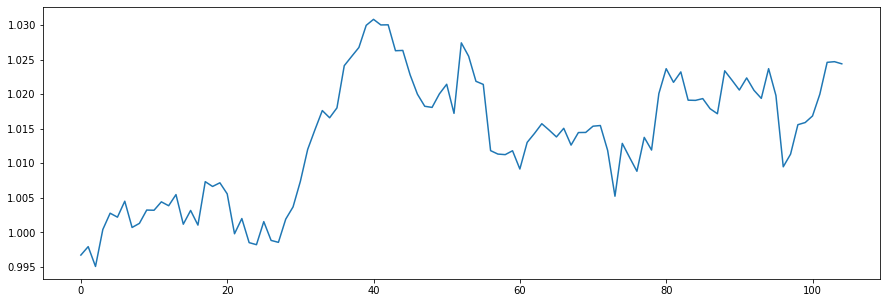

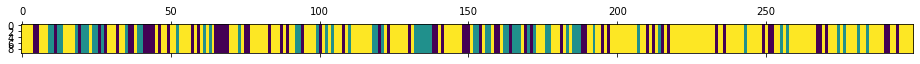

<Figure size 432x288 with 0 Axes>

N [[ 18.  15.  32.]
 [  7.  21.  32.]
 [ 40.  24. 110.]]
alphas [[1.19151897 0.2875057  0.39915628]
 [0.17523056 1.30379411 0.39915628]
 [0.17523056 0.2875057  1.41544469]]
M [[6. 4. 1.]
 [3. 3. 2.]
 [1. 1. 6.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[2. 4. 1.]
 [3. 1. 2.]
 [1. 1. 2.]]
pi_z [[0.33252044 0.24379648 0.42368308]
 [0.08570155 0.29357411 0.62072434]
 [0.24210807 0.13395705 0.62393488]]
beta_vec [0.44617709 0.29397366 0.25984925]
hyper>> a_k: 1.470482299251719  gamma: 1.0656666916924113  rho: 0.4963449050724405


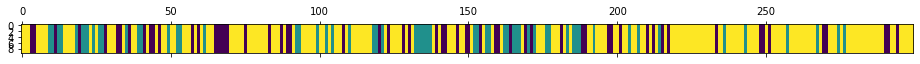

<Figure size 432x288 with 0 Axes>

606
N [[ 16.  11.  33.]
 [  6.  22.  32.]
 [ 38.  27. 114.]]
alphas [[1.06031224 0.21772157 0.19244849]
 [0.33044585 0.94758796 0.19244849]
 [0.33044585 0.21772157 0.92231489]]
M [[6. 1. 1.]
 [2. 2. 1.]
 [2. 1. 6.]]
sum_w [[5.]
 [1.]
 [5.]]
barM [[1. 1. 1.]
 [2. 1. 1.]
 [2. 1. 1.]]
pi_z [[0.30508027 0.2380966  0.45682313]
 [0.14966879 0.3399723  0.51035891]
 [0.15494493 0.17657089 0.66848418]]
beta_vec [0.17392328 0.21973835 0.60633837]
hyper>> a_k: 2.457953231374147  gamma: 1.0087324714525612  rho: 0.4574955872125866


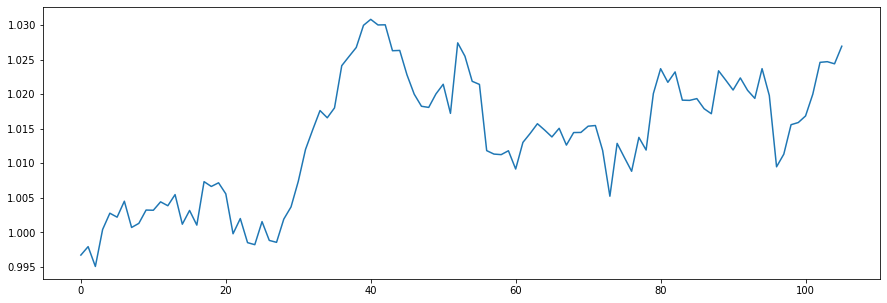

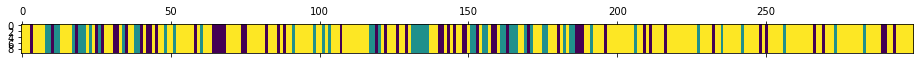

<Figure size 432x288 with 0 Axes>

N [[ 13.  10.  32.]
 [  6.  18.  29.]
 [ 36.  25. 130.]]
alphas [[1.35642083 0.29301021 0.80852219]
 [0.23191807 1.41751296 0.80852219]
 [0.23191807 0.29301021 1.93302495]]
M [[5. 2. 4.]
 [2. 4. 3.]
 [2. 1. 7.]]
sum_w [[5.]
 [4.]
 [6.]]
barM [[0. 2. 4.]
 [2. 0. 3.]
 [2. 1. 1.]]
pi_z [[0.20607702 0.18676054 0.60716244]
 [0.20139595 0.26187984 0.53672421]
 [0.23960059 0.17867628 0.58172314]]
beta_vec [0.28785705 0.08967715 0.62246581]
hyper>> a_k: 1.9540955223684389  gamma: 1.8193778746438765  rho: 0.3946956018326278


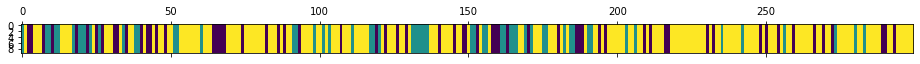

<Figure size 432x288 with 0 Axes>

607
N [[ 14.  12.  37.]
 [ 10.  21.  26.]
 [ 39.  24. 116.]]
alphas [[1.11175673 0.10607216 0.73626663]
 [0.34048382 0.87734507 0.73626663]
 [0.34048382 0.10607216 1.50753954]]
M [[3. 1. 3.]
 [2. 5. 4.]
 [1. 2. 2.]]
sum_w [[0.]
 [4.]
 [1.]]
barM [[3. 1. 3.]
 [2. 1. 4.]
 [1. 2. 1.]]
pi_z [[0.24914231 0.12555163 0.62530605]
 [0.25150315 0.34791153 0.40058532]
 [0.28002332 0.11246842 0.60750826]]
beta_vec [0.28917832 0.22126241 0.48955927]
hyper>> a_k: 3.0454851213318963  gamma: 0.28435839003982566  rho: 0.1996937374128184


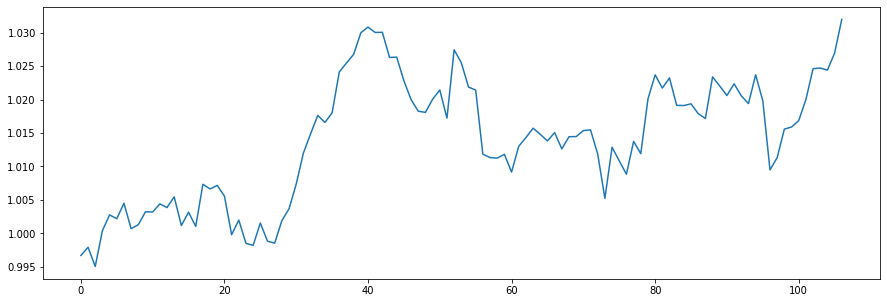

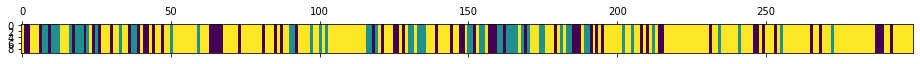

<Figure size 432x288 with 0 Axes>

N [[ 16.  12.  34.]
 [ 10.  20.  25.]
 [ 36.  23. 123.]]
alphas [[1.31298465 0.53928747 1.193213  ]
 [0.70482034 1.14745178 1.193213  ]
 [0.70482034 0.53928747 1.80137731]]
M [[3. 1. 7.]
 [3. 5. 5.]
 [2. 5. 9.]]
sum_w [[3.]
 [2.]
 [2.]]
barM [[0. 1. 7.]
 [3. 3. 5.]
 [2. 5. 7.]]
pi_z [[0.21136306 0.17780648 0.61083047]
 [0.30043745 0.33949318 0.36006937]
 [0.21144148 0.15336509 0.63519342]]
beta_vec [0.18231443 0.30855271 0.50913286]
hyper>> a_k: 3.2913073969882425  gamma: 0.814017040718189  rho: 0.0930712962781269


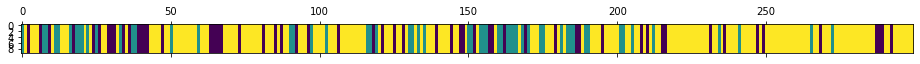

<Figure size 432x288 with 0 Axes>

608
N [[ 15.  12.  31.]
 [  8.  20.  27.]
 [ 35.  23. 128.]]
alphas [[0.85053138 0.92102402 1.51975199]
 [0.54420514 1.22735027 1.51975199]
 [0.54420514 0.92102402 1.82607824]]
M [[2. 3. 3.]
 [2. 5. 3.]
 [3. 3. 4.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[1. 3. 3.]
 [2. 3. 3.]
 [3. 3. 4.]]
pi_z [[0.23493849 0.22185133 0.54321018]
 [0.15530492 0.42114777 0.42354731]
 [0.22501214 0.11648134 0.65850652]]
beta_vec [0.26372531 0.35308726 0.38318743]
hyper>> a_k: 2.5531995759026604  gamma: 2.327556452408239  rho: 0.0745379948825281


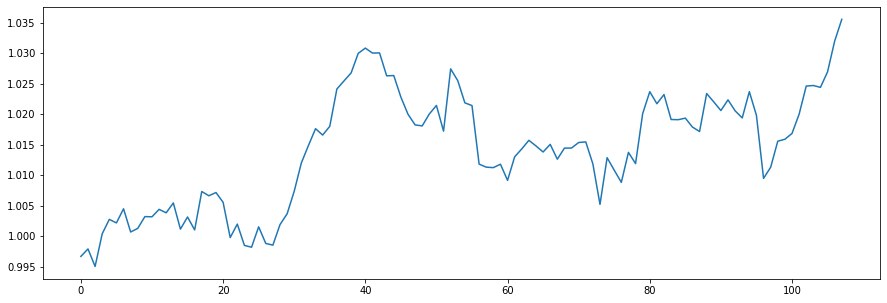

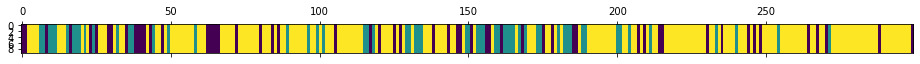

<Figure size 432x288 with 0 Axes>

N [[ 14.  11.  30.]
 [  9.  22.  27.]
 [ 33.  25. 128.]]
alphas [[0.81346406 0.83430606 0.90542945]
 [0.62315368 1.02461644 0.90542945]
 [0.62315368 0.83430606 1.09573983]]
M [[4. 2. 3.]
 [1. 7. 2.]
 [4. 6. 6.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[3. 2. 3.]
 [1. 6. 2.]
 [4. 6. 6.]]
pi_z [[0.22427454 0.20281668 0.57290878]
 [0.19247682 0.39984518 0.40767799]
 [0.14457614 0.09676469 0.75865917]]
beta_vec [0.25535872 0.46847971 0.27616158]
hyper>> a_k: 3.193737415212038  gamma: 0.6552810013176145  rho: 0.06597053796249541


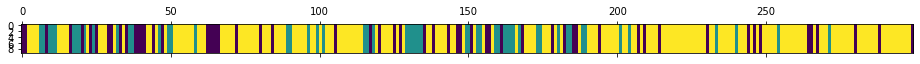

<Figure size 432x288 with 0 Axes>

609
N [[ 13.  12.  32.]
 [  8.  23.  24.]
 [ 36.  20. 131.]]
alphas [[0.97243908 1.39749597 0.82380237]
 [0.7617465  1.60818854 0.82380237]
 [0.7617465  1.39749597 1.03449495]]
M [[2. 3. 6.]
 [1. 7. 4.]
 [5. 4. 5.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[2. 3. 6.]
 [1. 6. 4.]
 [5. 4. 5.]]
pi_z [[0.31268751 0.21246798 0.47484451]
 [0.10750584 0.37915393 0.51334023]
 [0.18937431 0.12067603 0.68994966]]
beta_vec [0.33681361 0.29273591 0.37045048]
hyper>> a_k: 4.4858707312683395  gamma: 0.8063711681155439  rho: 0.04707565604879925


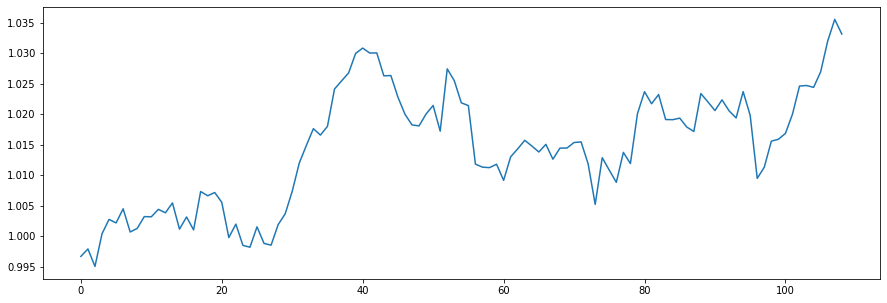

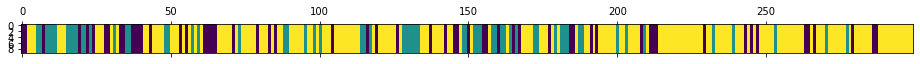

<Figure size 432x288 with 0 Axes>

N [[ 17.  12.  30.]
 [  8.  26.  28.]
 [ 34.  24. 120.]]
alphas [[1.65095091 1.25135685 1.58356297]
 [1.4397756  1.46253216 1.58356297]
 [1.4397756  1.25135685 1.79473828]]
M [[4. 2. 7.]
 [3. 3. 7.]
 [6. 3. 4.]]
sum_w [[0.]
 [2.]
 [0.]]
barM [[4. 2. 7.]
 [3. 1. 7.]
 [6. 3. 4.]]
pi_z [[0.356095   0.2170246  0.42688041]
 [0.12883831 0.40144059 0.4697211 ]
 [0.17675695 0.11398828 0.70925477]]
beta_vec [0.47698318 0.12298226 0.40003455]
hyper>> a_k: 4.022818907666258  gamma: 0.25781985422742193  rho: 0.020926575187071986


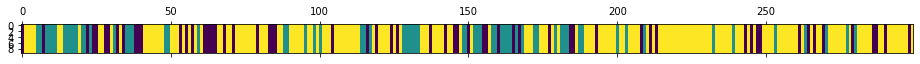

<Figure size 432x288 with 0 Axes>

610
N [[ 15.  13.  32.]
 [ 10.  30.  26.]
 [ 35.  23. 115.]]
alphas [[1.96284653 0.48438225 1.57559013]
 [1.87866271 0.56856607 1.57559013]
 [1.87866271 0.48438225 1.65977395]]
M [[7. 3. 5.]
 [3. 3. 4.]
 [3. 2. 7.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[6. 3. 5.]
 [3. 3. 4.]
 [3. 2. 7.]]
pi_z [[0.27065232 0.20590695 0.52344073]
 [0.21176507 0.42852923 0.3597057 ]
 [0.17972482 0.14989242 0.67038276]]
beta_vec [0.30968681 0.18533739 0.5049758 ]
hyper>> a_k: 3.4518276396108103  gamma: 0.619343386279818  rho: 0.1182073195336171


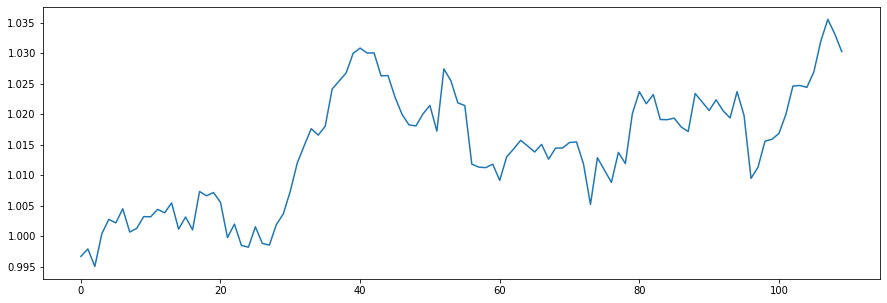

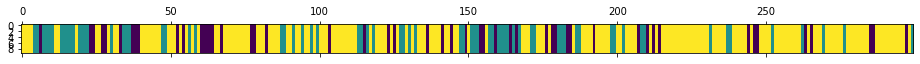

<Figure size 432x288 with 0 Axes>

N [[ 14.  12.  25.]
 [  8.  31.  30.]
 [ 29.  27. 123.]]
alphas [[1.35065487 0.56412926 1.53704351]
 [0.94262357 0.97216056 1.53704351]
 [0.94262357 0.56412926 1.9450748 ]]
M [[1. 2. 4.]
 [1. 7. 6.]
 [4. 5. 4.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[0. 2. 4.]
 [1. 5. 6.]
 [4. 5. 4.]]
pi_z [[0.21885008 0.30516249 0.47598743]
 [0.1810744  0.34511271 0.4738129 ]
 [0.16922488 0.18850398 0.64227114]]
beta_vec [0.17218022 0.41438608 0.4134337 ]
hyper>> a_k: 3.514101884591098  gamma: 0.528882410800715  rho: 0.11195877112183886


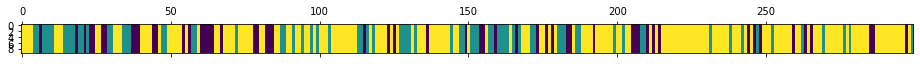

<Figure size 432x288 with 0 Axes>

611
N [[ 17.  15.  23.]
 [ 10.  30.  34.]
 [ 28.  29. 113.]]
alphas [[0.93075171 1.29316111 1.29018907]
 [0.53731718 1.68659564 1.29018907]
 [0.53731718 1.29316111 1.68362359]]
M [[4. 5. 6.]
 [1. 5. 4.]
 [1. 4. 8.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[4. 5. 6.]
 [1. 4. 4.]
 [1. 4. 6.]]
pi_z [[0.26082615 0.23760343 0.50157042]
 [0.11021017 0.42637291 0.46341692]
 [0.19144057 0.18134454 0.62721489]]
beta_vec [0.0954267  0.39069496 0.51387834]
hyper>> a_k: 3.101054856856548  gamma: 0.1708497687748079  rho: 0.03720972753749511


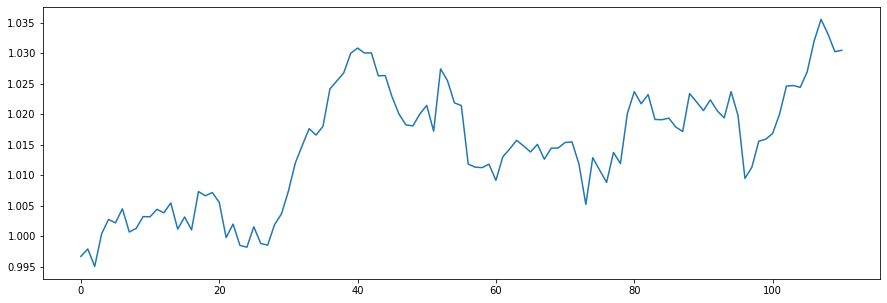

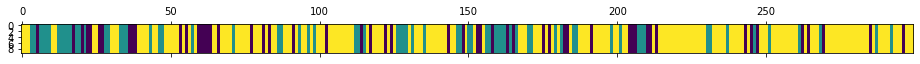

<Figure size 432x288 with 0 Axes>

N [[ 13.  15.  25.]
 [ 10.  29.  31.]
 [ 30.  26. 120.]]
alphas [[0.40030162 1.16648445 1.53426879]
 [0.28491221 1.28187386 1.53426879]
 [0.28491221 1.16648445 1.6496582 ]]
M [[2. 4. 6.]
 [1. 4. 7.]
 [2. 5. 5.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[1. 4. 6.]
 [1. 4. 7.]
 [2. 5. 3.]]
pi_z [[0.12054009 0.34329999 0.53615992]
 [0.10546122 0.41558957 0.47894921]
 [0.12371695 0.2034064  0.67287665]]
beta_vec [0.10366676 0.37248497 0.52384826]
hyper>> a_k: 3.8262047250116975  gamma: 0.7251968438385092  rho: 0.14443163232807935


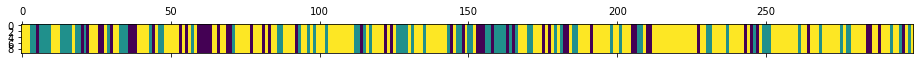

<Figure size 432x288 with 0 Axes>

612
N [[ 14.  15.  24.]
 [ 11.  29.  36.]
 [ 28.  32. 110.]]
alphas [[0.89198641 1.21935925 1.71485906]
 [0.33936142 1.77198425 1.71485906]
 [0.33936142 1.21935925 2.26748405]]
M [[4. 3. 6.]
 [2. 9. 5.]
 [3. 7. 6.]]
sum_w [[2.]
 [4.]
 [1.]]
barM [[2. 3. 6.]
 [2. 5. 5.]
 [3. 7. 5.]]
pi_z [[0.234672   0.40595466 0.35937334]
 [0.19443302 0.36206285 0.44350413]
 [0.21411682 0.18414661 0.60173658]]
beta_vec [0.16438441 0.41166591 0.42394967]
hyper>> a_k: 3.9350769619019506  gamma: 1.0547921274199992  rho: 0.12723973523932508


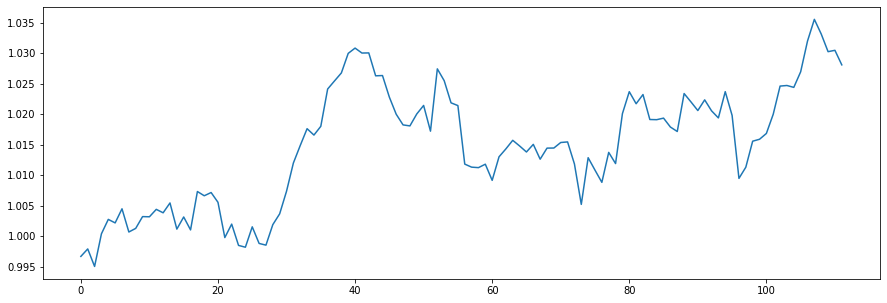

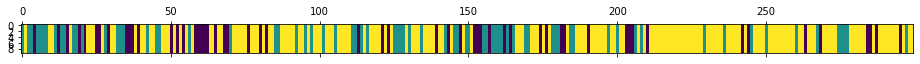

<Figure size 432x288 with 0 Axes>

N [[ 14.  15.  26.]
 [ 11.  27.  36.]
 [ 30.  32. 108.]]
alphas [[1.0652565  1.41381669 1.45600378]
 [0.56455835 1.91451484 1.45600378]
 [0.56455835 1.41381669 1.95670193]]
M [[ 5.  4.  4.]
 [ 1.  6.  7.]
 [ 2.  5. 13.]]
sum_w [[3.]
 [2.]
 [0.]]
barM [[ 2.  4.  4.]
 [ 1.  4.  7.]
 [ 2.  5. 13.]]
pi_z [[0.29648265 0.20670634 0.49681101]
 [0.09160762 0.38640164 0.52199073]
 [0.23190557 0.18753451 0.58055992]]
beta_vec [0.16873536 0.41502275 0.41624189]
hyper>> a_k: 6.11873766872973  gamma: 1.5583076450436553  rho: 0.12279945194165066


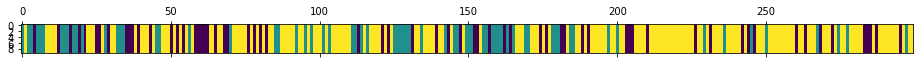

<Figure size 432x288 with 0 Axes>

613
N [[ 14.  17.  33.]
 [ 10.  27.  31.]
 [ 40.  24. 103.]]
alphas [[1.65704108 2.22757651 2.23412008]
 [0.90566345 2.97895414 2.23412008]
 [0.90566345 2.22757651 2.98549771]]
M [[ 3.  7.  8.]
 [ 3.  6.  9.]
 [ 2.  6. 11.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[0. 7. 8.]
 [3. 5. 9.]
 [2. 6. 7.]]
pi_z [[0.20659157 0.3318271  0.46158134]
 [0.08834886 0.47017842 0.44147272]
 [0.26798636 0.13834032 0.59367332]]
beta_vec [0.17156992 0.39483586 0.43359422]
hyper>> a_k: 5.142192319750688  gamma: 0.48323943381342005  rho: 0.1656632612189575


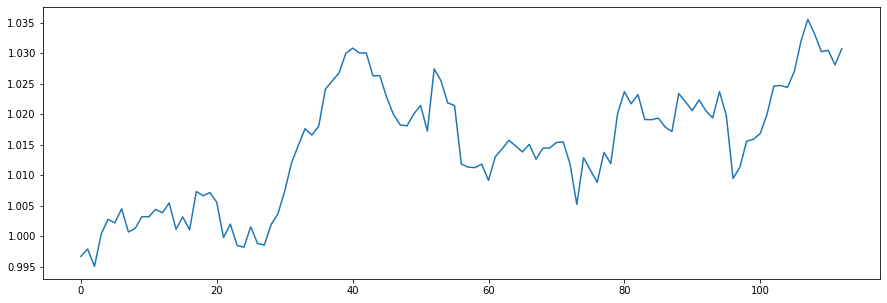

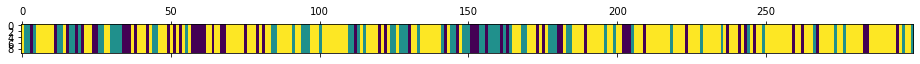

<Figure size 432x288 with 0 Axes>

N [[ 14.  14.  30.]
 [ 12.  26.  29.]
 [ 32.  28. 114.]]
alphas [[1.58796221 1.69397216 1.86025795]
 [0.73608986 2.54584451 1.86025795]
 [0.73608986 1.69397216 2.7121303 ]]
M [[4. 4. 9.]
 [2. 6. 7.]
 [2. 4. 9.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[2. 4. 9.]
 [2. 4. 7.]
 [2. 4. 6.]]
pi_z [[0.29977071 0.17871618 0.52151311]
 [0.14510901 0.45094546 0.40394553]
 [0.16548499 0.17341466 0.66110035]]
beta_vec [0.08871536 0.31999044 0.5912942 ]
hyper>> a_k: 6.127622015624669  gamma: 0.9174960220210239  rho: 0.2596966999865418


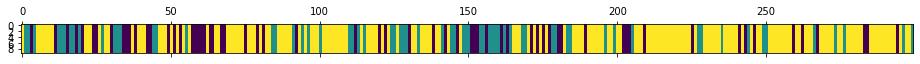

<Figure size 432x288 with 0 Axes>

614
N [[ 16.  16.  32.]
 [ 14.  25.  27.]
 [ 34.  25. 110.]]
alphas [[1.99376258 1.45157225 2.68228719]
 [0.40243937 3.04289546 2.68228719]
 [0.40243937 1.45157225 4.2736104 ]]
M [[ 4.  6.  6.]
 [ 4.  6.  4.]
 [ 5.  6. 12.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[0. 6. 6.]
 [4. 4. 4.]
 [5. 6. 8.]]
pi_z [[0.2854697  0.24892536 0.46560494]
 [0.16975879 0.36610789 0.46413333]
 [0.20090038 0.14960117 0.64949844]]
beta_vec [0.30989923 0.3481523  0.34194847]
hyper>> a_k: 5.898896184619961  gamma: 0.8123801796490672  rho: 0.1996277580739196


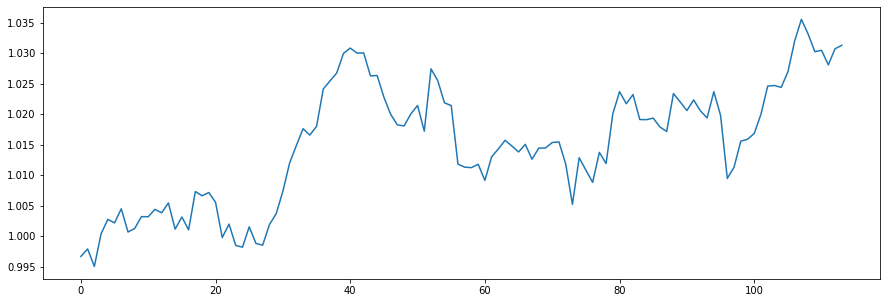

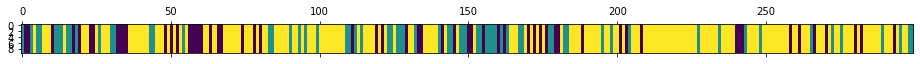

<Figure size 432x288 with 0 Axes>

N [[ 15.  15.  28.]
 [ 10.  22.  33.]
 [ 33.  28. 115.]]
alphas [[2.64071463 1.64373588 1.61444567]
 [1.46313121 2.8213193  1.61444567]
 [1.46313121 1.64373588 2.79202909]]
M [[4. 4. 5.]
 [4. 9. 4.]
 [6. 6. 9.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[2. 4. 5.]
 [4. 8. 4.]
 [6. 6. 7.]]
pi_z [[0.32807646 0.25952824 0.4123953 ]
 [0.24235925 0.34545288 0.41218787]
 [0.13832593 0.16474796 0.69692611]]
beta_vec [0.27629605 0.39179754 0.33190641]
hyper>> a_k: 7.386066607157794  gamma: 1.9077721486572479  rho: 0.06097791438189544


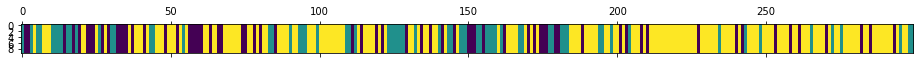

<Figure size 432x288 with 0 Axes>

615
N [[ 17.  15.  35.]
 [ 11.  29.  26.]
 [ 39.  22. 105.]]
alphas [[2.36668787 2.71738221 2.30199653]
 [1.91630093 3.16776915 2.30199653]
 [1.91630093 2.71738221 2.75238346]]
M [[ 8. 10.  6.]
 [ 3.  8.  7.]
 [ 5.  6.  7.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[ 7. 10.  6.]
 [ 3.  7.  7.]
 [ 5.  6.  6.]]
pi_z [[0.20974372 0.26742417 0.52283211]
 [0.28265715 0.37701588 0.34032697]
 [0.245483   0.1107966  0.6437204 ]]
beta_vec [0.22807318 0.41843377 0.35349305]
hyper>> a_k: 5.955590706996935  gamma: 0.4858248673758033  rho: 0.08142989672000273


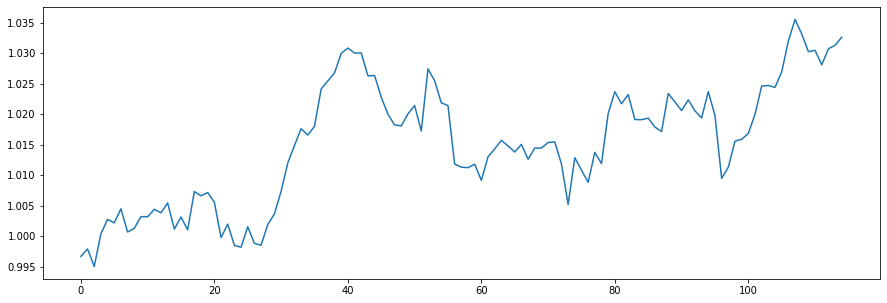

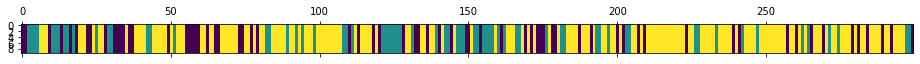

<Figure size 432x288 with 0 Axes>

N [[ 18.  13.  36.]
 [ 12.  29.  27.]
 [ 38.  25. 101.]]
alphas [[1.73266659 2.28909531 1.93382881]
 [1.24770345 2.77405845 1.93382881]
 [1.24770345 2.28909531 2.41879194]]
M [[ 3.  5.  9.]
 [ 4.  7.  8.]
 [ 7.  7. 11.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[1. 5. 9.]
 [4. 7. 8.]
 [7. 7. 8.]]
pi_z [[0.33341334 0.22619626 0.4403904 ]
 [0.17912469 0.46156478 0.35931053]
 [0.2576007  0.16346891 0.57893039]]
beta_vec [0.16278165 0.42764867 0.40956968]
hyper>> a_k: 5.775698389523551  gamma: 1.4128281066784618  rho: 0.03787269036292502


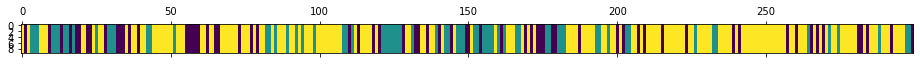

<Figure size 432x288 with 0 Axes>

616
N [[ 16.  15.  34.]
 [ 11.  31.  27.]
 [ 38.  23. 104.]]
alphas [[1.12331187 2.37642536 2.27596116]
 [0.90457064 2.59516659 2.27596116]
 [0.90457064 2.37642536 2.4947024 ]]
M [[5. 7. 7.]
 [3. 7. 7.]
 [7. 4. 9.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[3. 7. 7.]
 [3. 7. 7.]
 [7. 4. 9.]]
pi_z [[0.28427063 0.27250631 0.44322306]
 [0.17570425 0.37326852 0.45102722]
 [0.30379802 0.08069125 0.61551073]]
beta_vec [0.23794008 0.34644464 0.41561528]
hyper>> a_k: 6.670434582365262  gamma: 1.0670359697137952  rho: 0.10487481160139252


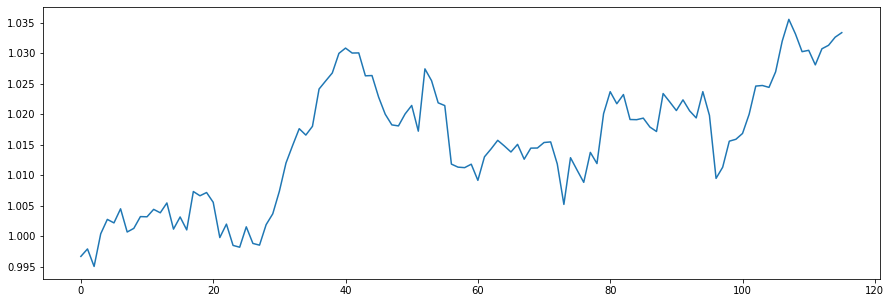

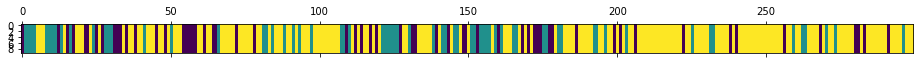

<Figure size 432x288 with 0 Axes>

N [[ 14.  12.  33.]
 [  9.  27.  30.]
 [ 36.  27. 111.]]
alphas [[2.12027082 2.06857729 2.48158648]
 [1.42071025 2.76813786 2.48158648]
 [1.42071025 2.06857729 3.18114705]]
M [[ 4.  5.  7.]
 [ 4.  5. 10.]
 [ 7.  5. 10.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[ 2.  5.  7.]
 [ 4.  3. 10.]
 [ 7.  5.  9.]]
pi_z [[0.267071   0.21013698 0.52279203]
 [0.10098589 0.51795519 0.38105892]
 [0.18110083 0.17067214 0.64822703]]
beta_vec [0.23624081 0.30792141 0.45583779]
hyper>> a_k: 5.916297450152262  gamma: 0.4541052831470051  rho: 0.13503763296936272


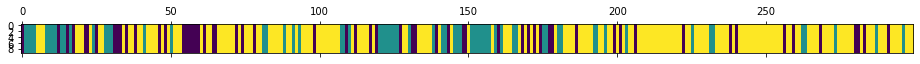

<Figure size 432x288 with 0 Axes>

617
N [[ 13.  13.  32.]
 [  6.  32.  28.]
 [ 39.  21. 115.]]
alphas [[2.00785552 1.5757492  2.33269274]
 [1.20893271 2.374672   2.33269274]
 [1.20893271 1.5757492  3.13161554]]
M [[4. 3. 9.]
 [3. 8. 7.]
 [5. 6. 9.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[3. 3. 9.]
 [3. 7. 7.]
 [5. 6. 7.]]
pi_z [[0.23846979 0.18302705 0.57850315]
 [0.09912629 0.46706551 0.43380819]
 [0.22665771 0.15481704 0.61852525]]
beta_vec [0.14341666 0.43422296 0.42236038]
hyper>> a_k: 7.48615699717913  gamma: 0.2299520090372196  rho: 0.09792934621738474


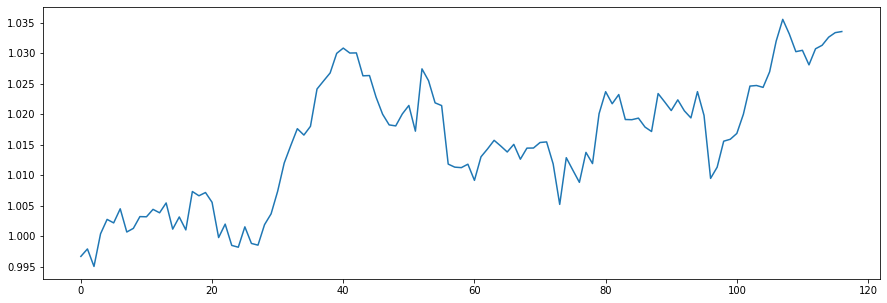

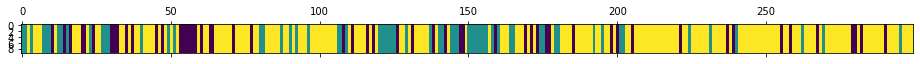

<Figure size 432x288 with 0 Axes>

N [[ 12.  12.  30.]
 [  6.  26.  31.]
 [ 36.  25. 121.]]
alphas [[1.70161324 2.93232615 2.85221761]
 [0.96849877 3.66544061 2.85221761]
 [0.96849877 2.93232615 3.58533208]]
M [[ 5.  4.  9.]
 [ 2. 10.  5.]
 [ 4.  7.  9.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[3. 4. 9.]
 [2. 8. 5.]
 [4. 7. 7.]]
pi_z [[0.19093464 0.25185287 0.5572125 ]
 [0.07696294 0.5410449  0.38199216]
 [0.22600281 0.12125072 0.65274646]]
beta_vec [0.10485616 0.34128443 0.55385941]
hyper>> a_k: 6.539196709920339  gamma: 1.0508320316898445  rho: 0.14200682713107848


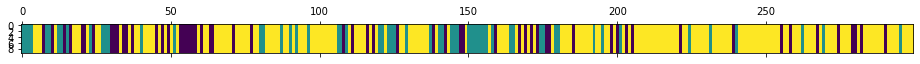

<Figure size 432x288 with 0 Axes>

618
N [[ 13.  12.  33.]
 [  6.  23.  29.]
 [ 39.  23. 121.]]
alphas [[1.51691509 1.91480568 3.10747594]
 [0.58830451 2.84341626 3.10747594]
 [0.58830451 1.91480568 4.03608652]]
M [[ 2.  3.  5.]
 [ 1.  7.  9.]
 [ 5. 10. 21.]]
sum_w [[1.]
 [3.]
 [6.]]
barM [[ 1.  3.  5.]
 [ 1.  4.  9.]
 [ 5. 10. 15.]]
pi_z [[0.17683475 0.20946613 0.61369912]
 [0.10997319 0.36522707 0.52479974]
 [0.21814951 0.17340477 0.60844572]]
beta_vec [0.12338548 0.28393696 0.59267756]
hyper>> a_k: 6.8005729761476195  gamma: 0.5546345683506665  rho: 0.12211311627738408


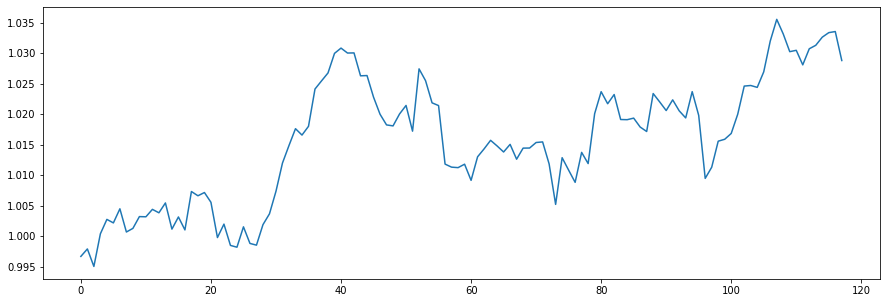

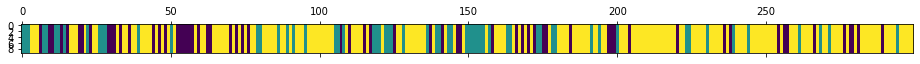

<Figure size 432x288 with 0 Axes>

N [[ 16.  11.  35.]
 [  8.  24.  29.]
 [ 38.  26. 112.]]
alphas [[1.56706696 1.69514166 3.53836436]
 [0.7366278  2.52558081 3.53836436]
 [0.7366278  1.69514166 4.36880352]]
M [[ 5.  3.  8.]
 [ 2.  9.  7.]
 [ 2.  4. 13.]]
sum_w [[5.]
 [3.]
 [2.]]
barM [[ 0.  3.  8.]
 [ 2.  6.  7.]
 [ 2.  4. 11.]]
pi_z [[0.24763379 0.13047759 0.62188861]
 [0.10579588 0.36279519 0.53140893]
 [0.20180118 0.13411117 0.66408766]]
beta_vec [0.08994048 0.39735323 0.5127063 ]
hyper>> a_k: 5.005287695068562  gamma: 1.2035688901665498  rho: 0.22975665208232532


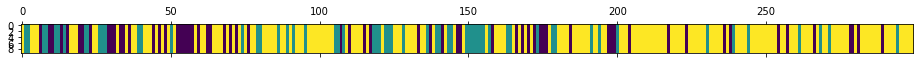

<Figure size 432x288 with 0 Axes>

619
N [[ 17.  10.  36.]
 [  9.  23.  28.]
 [ 37.  27. 112.]]
alphas [[1.49674473 1.53191174 1.97663122]
 [0.34674659 2.68190989 1.97663122]
 [0.34674659 1.53191174 3.12662937]]
M [[ 3.  3.  5.]
 [ 1.  5.  5.]
 [ 1.  4. 13.]]
sum_w [[2.]
 [2.]
 [6.]]
barM [[1. 3. 5.]
 [1. 3. 5.]
 [1. 4. 7.]]
pi_z [[0.23817434 0.17550805 0.58631761]
 [0.19712718 0.40922604 0.39364678]
 [0.18267604 0.14279595 0.67452802]]
beta_vec [0.16345091 0.27396257 0.56258652]
hyper>> a_k: 3.6224857824232237  gamma: 0.579650706123845  rho: 0.2739712896262913


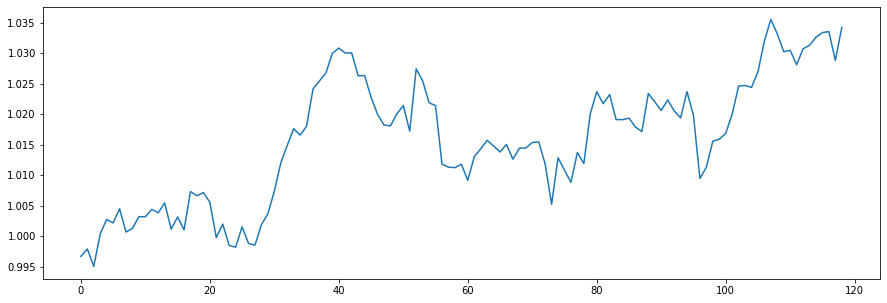

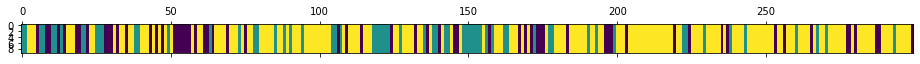

<Figure size 432x288 with 0 Axes>

N [[ 17.  13.  31.]
 [ 11.  25.  28.]
 [ 34.  26. 114.]]
alphas [[1.42233769 0.72052942 1.47961867]
 [0.42988058 1.71298652 1.47961867]
 [0.42988058 0.72052942 2.47207578]]
M [[ 4.  5.  6.]
 [ 1.  6.  3.]
 [ 4.  3. 10.]]
sum_w [[3.]
 [3.]
 [6.]]
barM [[1. 5. 6.]
 [1. 3. 3.]
 [4. 3. 4.]]
pi_z [[0.35275067 0.21940409 0.42784525]
 [0.27676475 0.31466566 0.40856959]
 [0.2642839  0.14413404 0.59158206]]
beta_vec [0.18599628 0.30965358 0.50435013]
hyper>> a_k: 3.2892604748483696  gamma: 0.6619147343851367  rho: 0.2811546834076337


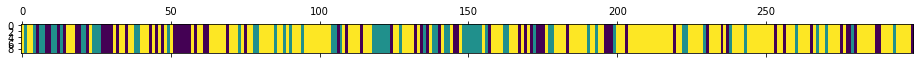

<Figure size 432x288 with 0 Axes>

620
N [[ 18.  14.  32.]
 [ 10.  25.  28.]
 [ 35.  25. 112.]]
alphas [[1.36457353 0.73216645 1.1925205 ]
 [0.43978254 1.65695744 1.1925205 ]
 [0.43978254 0.73216645 2.11731149]]
M [[5. 1. 5.]
 [3. 4. 5.]
 [5. 3. 9.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[1. 1. 5.]
 [3. 1. 5.]
 [5. 3. 5.]]
pi_z [[0.34685598 0.27788099 0.37526303]
 [0.13930591 0.49460583 0.36608826]
 [0.21875698 0.13793641 0.64330661]]
beta_vec [0.18242766 0.2973804  0.52019193]
hyper>> a_k: 3.751466981232047  gamma: 0.2580492207431651  rho: 0.28084642155386613


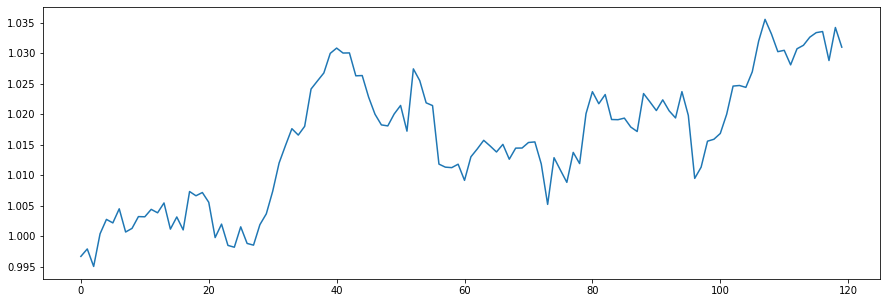

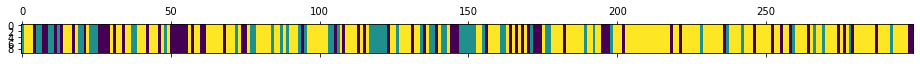

<Figure size 432x288 with 0 Axes>

N [[ 17.  13.  35.]
 [ 11.  22.  27.]
 [ 37.  25. 112.]]
alphas [[1.54575418 0.80229691 1.40341589]
 [0.49216811 1.85588299 1.40341589]
 [0.49216811 0.80229691 2.45700196]]
M [[ 5.  4.  4.]
 [ 1.  6.  3.]
 [ 1.  2. 10.]]
sum_w [[2.]
 [5.]
 [5.]]
barM [[3. 4. 4.]
 [1. 1. 3.]
 [1. 2. 5.]]
pi_z [[0.35657354 0.16859505 0.47483141]
 [0.16764944 0.39295902 0.43939154]
 [0.21587361 0.15174687 0.63237952]]
beta_vec [0.18863546 0.44597048 0.36539406]
hyper>> a_k: 3.6673089384389925  gamma: 1.028159095915365  rho: 0.323603066352687


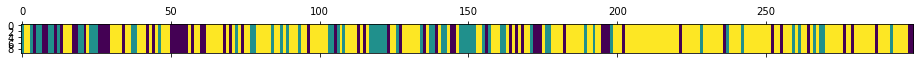

<Figure size 432x288 with 0 Axes>

621
N [[ 17.  13.  29.]
 [  8.  23.  31.]
 [ 34.  26. 118.]]
alphas [[1.65467333 1.10625499 0.90638062]
 [0.46792091 2.29300741 0.90638062]
 [0.46792091 1.10625499 2.09313304]]
M [[ 3.  3.  5.]
 [ 2. 10.  4.]
 [ 3.  2. 10.]]
sum_w [[2.]
 [3.]
 [8.]]
barM [[1. 3. 5.]
 [2. 7. 4.]
 [3. 2. 2.]]
pi_z [[0.30795652 0.20611365 0.48592982]
 [0.14856065 0.33803651 0.51340284]
 [0.19798067 0.14805419 0.65396513]]
beta_vec [0.16831085 0.35226127 0.47942788]
hyper>> a_k: 3.5277928991356484  gamma: 1.695900743600265  rho: 0.29252709832800017


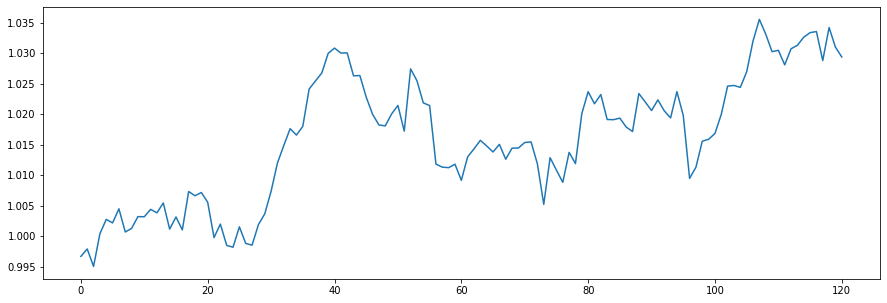

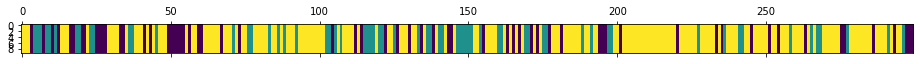

<Figure size 432x288 with 0 Axes>

N [[ 17.  14.  31.]
 [  9.  25.  30.]
 [ 36.  25. 112.]]
alphas [[1.45204825 0.87917998 1.19656467]
 [0.42007323 1.911155   1.19656467]
 [0.42007323 0.87917998 2.22853969]]
M [[ 2.  5.  3.]
 [ 1.  5.  2.]
 [ 2.  4. 11.]]
sum_w [[1.]
 [5.]
 [2.]]
barM [[1. 5. 3.]
 [1. 0. 2.]
 [2. 4. 9.]]
pi_z [[0.25888323 0.20329155 0.53782522]
 [0.13402263 0.42018043 0.44579694]
 [0.1804038  0.12076528 0.69883092]]
beta_vec [0.08633553 0.3258194  0.58784507]
hyper>> a_k: 2.6739258130542725  gamma: 0.4570027252594027  rho: 0.258383269982361


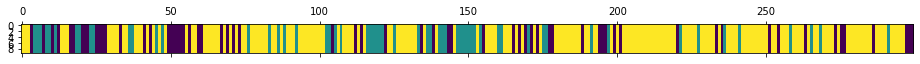

<Figure size 432x288 with 0 Axes>

622
N [[ 19.  13.  32.]
 [ 10.  23.  26.]
 [ 35.  23. 118.]]
alphas [[0.86210348 0.64610902 1.16571331]
 [0.17120579 1.33700672 1.16571331]
 [0.17120579 0.64610902 1.856611  ]]
M [[3. 3. 7.]
 [1. 6. 4.]
 [2. 3. 6.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[0. 3. 7.]
 [1. 5. 4.]
 [2. 3. 5.]]
pi_z [[0.24964648 0.20063108 0.54972243]
 [0.13504333 0.40765101 0.45730565]
 [0.22197151 0.15201845 0.62601004]]
beta_vec [0.08325966 0.29380899 0.62293135]
hyper>> a_k: 3.2957636583281826  gamma: 0.2754035220750353  rho: 0.15484449805093586


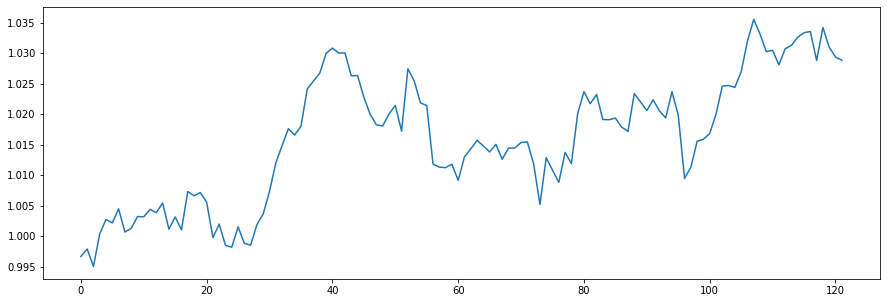

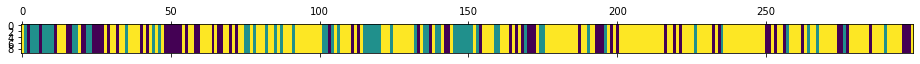

<Figure size 432x288 with 0 Axes>

N [[ 21.  10.  35.]
 [ 10.  24.  26.]
 [ 34.  26. 113.]]
alphas [[0.74224506 0.8183852  1.7351334 ]
 [0.23191419 1.32871607 1.7351334 ]
 [0.23191419 0.8183852  2.24546427]]
M [[ 5.  3.  7.]
 [ 1.  5.  5.]
 [ 1.  1. 12.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[ 3.  3.  7.]
 [ 1.  5.  5.]
 [ 1.  1. 10.]]
pi_z [[0.31394076 0.17603455 0.51002469]
 [0.1334347  0.51791428 0.34865101]
 [0.20122144 0.18427066 0.6145079 ]]
beta_vec [0.19330796 0.17185525 0.63483678]
hyper>> a_k: 3.66143950340365  gamma: 1.0150174586271086  rho: 0.24819840863820097


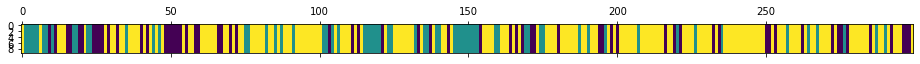

<Figure size 432x288 with 0 Axes>

623
N [[ 18.  12.  33.]
 [  8.  28.  30.]
 [ 37.  26. 107.]]
alphas [[1.44087765 0.47306184 1.74750001]
 [0.53211419 1.3818253  1.74750001]
 [0.53211419 0.47306184 2.65626347]]
M [[ 4.  3.  2.]
 [ 2.  3.  7.]
 [ 2.  2. 14.]]
sum_w [[4.]
 [0.]
 [2.]]
barM [[ 0.  3.  2.]
 [ 2.  3.  7.]
 [ 2.  2. 12.]]
pi_z [[0.18672872 0.19488114 0.61839014]
 [0.13289614 0.41534651 0.45175735]
 [0.22337423 0.16634491 0.61028086]]
beta_vec [0.15542504 0.17626282 0.66831214]
hyper>> a_k: 4.638651521138664  gamma: 0.20025548520647324  rho: 0.20963196737026282


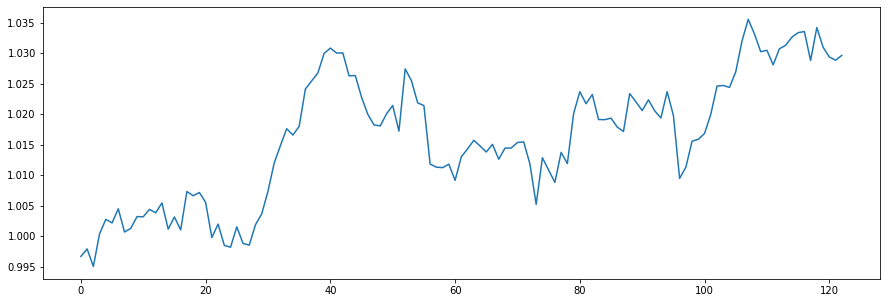

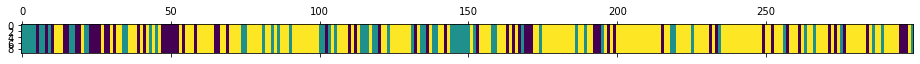

<Figure size 432x288 with 0 Axes>

N [[ 18.  13.  29.]
 [  7.  24.  31.]
 [ 35.  26. 116.]]
alphas [[1.54223545 0.64622211 2.45019395]
 [0.56982581 1.61863176 2.45019395]
 [0.56982581 0.64622211 3.4226036 ]]
M [[ 5.  1.  8.]
 [ 2.  2.  7.]
 [ 4.  3. 14.]]
sum_w [[4.]
 [2.]
 [5.]]
barM [[1. 1. 8.]
 [2. 0. 7.]
 [4. 3. 9.]]
pi_z [[0.32807559 0.21779711 0.4541273 ]
 [0.12419889 0.40140477 0.47439634]
 [0.17711689 0.15849004 0.66439307]]
beta_vec [0.23344736 0.2721957  0.49435694]
hyper>> a_k: 5.282807382213635  gamma: 0.23986425917054857  rho: 0.3063824883373462


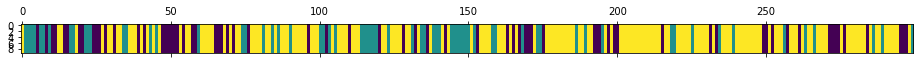

<Figure size 432x288 with 0 Axes>

624
N [[ 24.  13.  32.]
 [  9.  28.  30.]
 [ 36.  26. 101.]]
alphas [[2.47396862 0.99739248 1.81144628]
 [0.85540895 2.61595215 1.81144628]
 [0.85540895 0.99739248 3.43000595]]
M [[ 5.  2.  6.]
 [ 4.  5.  6.]
 [ 6.  6. 13.]]
sum_w [[5.]
 [3.]
 [4.]]
barM [[0. 2. 6.]
 [4. 2. 6.]
 [6. 6. 9.]]
pi_z [[0.46095128 0.16594361 0.37310511]
 [0.13814386 0.38723221 0.47462392]
 [0.25400675 0.15134727 0.59464598]]
beta_vec [0.14393877 0.33416593 0.5218953 ]
hyper>> a_k: 6.821797661016207  gamma: 0.5039789636439613  rho: 0.21937797807119125


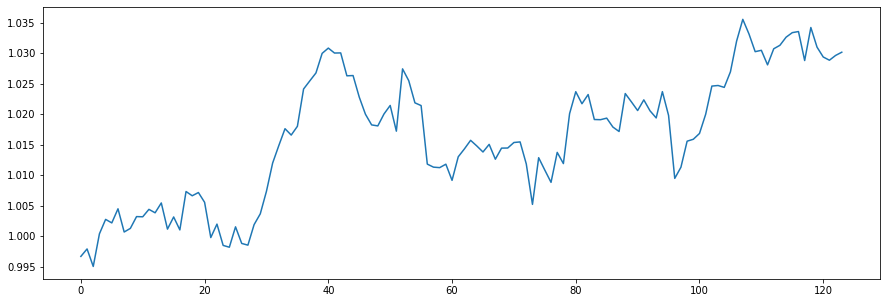

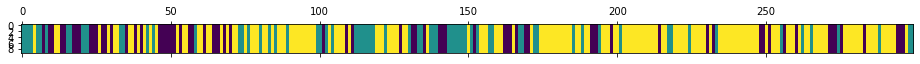

<Figure size 432x288 with 0 Axes>

N [[ 28.  13.  28.]
 [ 13.  30.  28.]
 [ 28.  28. 103.]]
alphas [[2.26306146 1.77951562 2.77922058]
 [0.76650928 3.2760678  2.77922058]
 [0.76650928 1.77951562 4.27577276]]
M [[ 3.  3.  5.]
 [ 3.  8.  6.]
 [ 1.  6. 12.]]
sum_w [[1.]
 [5.]
 [7.]]
barM [[2. 3. 5.]
 [3. 3. 6.]
 [1. 6. 5.]]
pi_z [[0.35435601 0.22845332 0.41719067]
 [0.19095557 0.43147051 0.37757392]
 [0.17819099 0.17145761 0.6503514 ]]
beta_vec [0.17932397 0.35365335 0.46702268]
hyper>> a_k: 5.419005874766684  gamma: 0.5052102829634858  rho: 0.3312205324490224


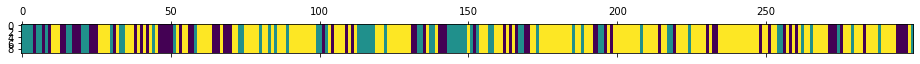

<Figure size 432x288 with 0 Axes>

625
N [[ 25.  14.  29.]
 [ 13.  28.  26.]
 [ 30.  25. 109.]]
alphas [[2.44477757 1.28168212 1.69254619]
 [0.64989156 3.07656813 1.69254619]
 [0.64989156 1.28168212 3.4874322 ]]
M [[ 6.  1.  4.]
 [ 3.  8.  5.]
 [ 3.  5. 16.]]
sum_w [[4.]
 [5.]
 [8.]]
barM [[2. 1. 4.]
 [3. 3. 5.]
 [3. 5. 8.]]
pi_z [[0.36158042 0.26798937 0.37043021]
 [0.13225756 0.43966227 0.42808017]
 [0.18370706 0.16969759 0.64659536]]
beta_vec [0.24310079 0.35822404 0.39867517]
hyper>> a_k: 3.6282311019353197  gamma: 1.2215643602000952  rho: 0.28149436689816104


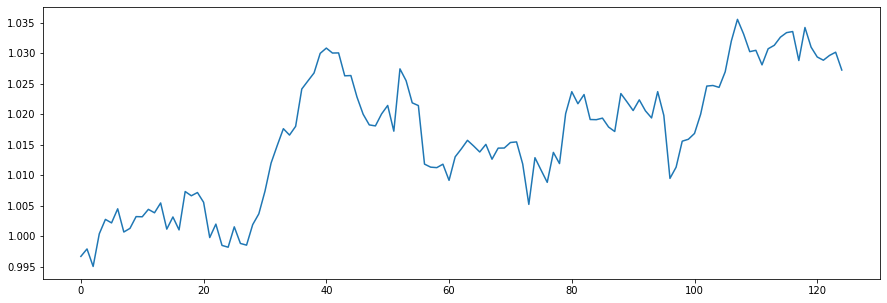

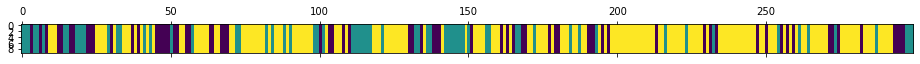

<Figure size 432x288 with 0 Axes>

N [[ 25.  15.  29.]
 [ 14.  28.  24.]
 [ 30.  23. 111.]]
alphas [[1.65506716 0.93385585 1.0393081 ]
 [0.63374054 1.95518246 1.0393081 ]
 [0.63374054 0.93385585 2.06063471]]
M [[ 4.  4.  3.]
 [ 3.  6.  4.]
 [ 3.  4. 10.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[1. 4. 3.]
 [3. 4. 4.]
 [3. 4. 5.]]
pi_z [[0.42864014 0.22996598 0.34139388]
 [0.17675429 0.41893534 0.40431037]
 [0.2055945  0.17349301 0.62091249]]
beta_vec [0.28511223 0.28893127 0.4259565 ]
hyper>> a_k: 3.330529224722367  gamma: 1.184271815764101  rho: 0.266126386366491


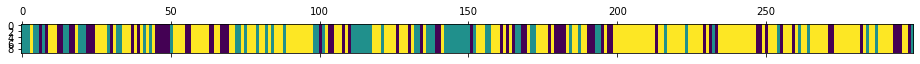

<Figure size 432x288 with 0 Axes>

626
N [[ 25.  13.  29.]
 [ 10.  30.  28.]
 [ 32.  25. 107.]]
alphas [[1.58320947 0.7062022  1.04111756]
 [0.69686776 1.5925439  1.04111756]
 [0.69686776 0.7062022  1.92745926]]
M [[1. 2. 2.]
 [2. 4. 5.]
 [4. 1. 9.]]
sum_w [[0.]
 [2.]
 [5.]]
barM [[1. 2. 2.]
 [2. 2. 5.]
 [4. 1. 4.]]
pi_z [[0.35369149 0.22957626 0.41673225]
 [0.24463249 0.39519196 0.36017555]
 [0.2141264  0.1298811  0.6559925 ]]
beta_vec [0.51888545 0.22758468 0.25352987]
hyper>> a_k: 1.7958481638347716  gamma: 0.6666387690360133  rho: 0.30719092406811627


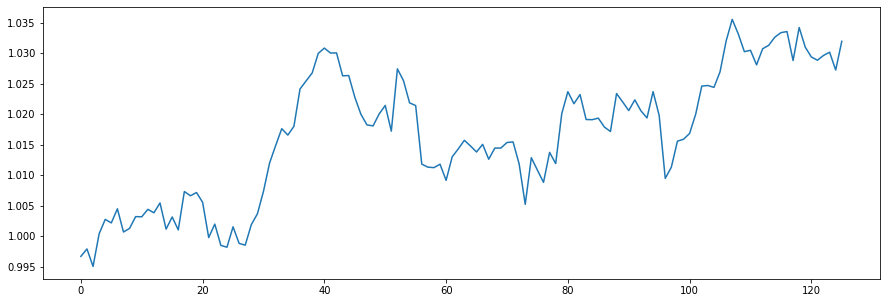

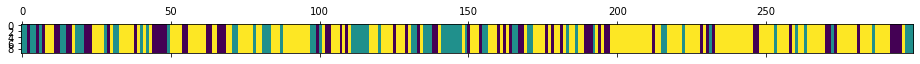

<Figure size 432x288 with 0 Axes>

N [[ 23.  13.  29.]
 [ 10.  30.  26.]
 [ 32.  23. 113.]]
alphas [[1.19725511 0.28315629 0.31543676]
 [0.64558685 0.83482455 0.31543676]
 [0.64558685 0.28315629 0.86710502]]
M [[2. 2. 2.]
 [4. 4. 2.]
 [3. 3. 5.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[0. 2. 2.]
 [4. 1. 2.]
 [3. 3. 2.]]
pi_z [[0.46626435 0.18418385 0.3495518 ]
 [0.16044266 0.48894801 0.35060934]
 [0.12022464 0.17565426 0.7041211 ]]
beta_vec [0.27215297 0.51711447 0.21073256]
hyper>> a_k: 3.007662746719789  gamma: 0.9662770519377648  rho: 0.41385712164606964


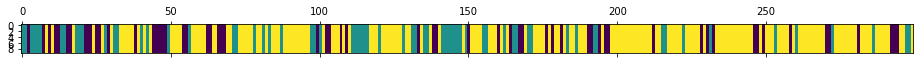

<Figure size 432x288 with 0 Axes>

627
N [[ 22.  11.  28.]
 [  9.  28.  30.]
 [ 30.  28. 113.]]
alphas [[1.72452659 0.91163148 0.37150467]
 [0.47978395 2.15637413 0.37150467]
 [0.47978395 0.91163148 1.61624732]]
M [[5. 4. 3.]
 [2. 8. 3.]
 [3. 2. 6.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[4. 4. 3.]
 [2. 6. 3.]
 [3. 2. 2.]]
pi_z [[0.41095557 0.09338127 0.49566316]
 [0.15620447 0.46817125 0.37562428]
 [0.15554825 0.13253993 0.71191182]]
beta_vec [0.25914796 0.47805814 0.2627939 ]
hyper>> a_k: 2.986451184668324  gamma: 2.6956132047134216  rho: 0.1242167400257043


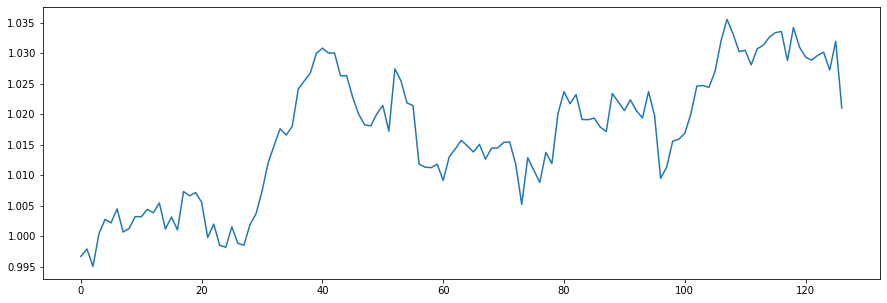

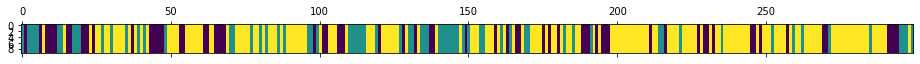

<Figure size 432x288 with 0 Axes>

N [[ 30.  10.  28.]
 [ 10.  28.  31.]
 [ 28.  32. 102.]]
alphas [[1.04876457 1.25035339 0.68733323]
 [0.67779734 1.62132062 0.68733323]
 [0.67779734 1.25035339 1.05830046]]
M [[4. 5. 3.]
 [2. 7. 2.]
 [2. 3. 3.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[2. 5. 3.]
 [2. 7. 2.]
 [2. 3. 1.]]
pi_z [[0.45787942 0.11476208 0.4273585 ]
 [0.22136891 0.33887519 0.4397559 ]
 [0.18663816 0.21203201 0.60132984]]
beta_vec [0.30126887 0.50178251 0.19694862]
hyper>> a_k: 2.3381597766909046  gamma: 1.2825212688849712  rho: 0.12472701330934363


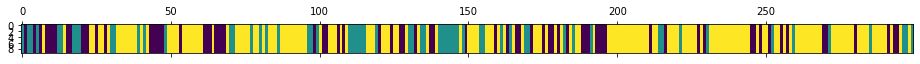

<Figure size 432x288 with 0 Axes>

628
N [[ 28.  11.  34.]
 [ 11.  24.  26.]
 [ 34.  26. 105.]]
alphas [[0.90818689 1.026912   0.40306089]
 [0.6165552  1.31854369 0.40306089]
 [0.6165552  1.026912   0.69469257]]
M [[6. 2. 4.]
 [3. 4. 1.]
 [3. 4. 2.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[4. 2. 4.]
 [3. 4. 1.]
 [3. 4. 1.]]
pi_z [[0.36673019 0.26047311 0.3727967 ]
 [0.17789053 0.3898248  0.43228467]
 [0.16571922 0.18377083 0.65050995]]
beta_vec [0.30657032 0.43530647 0.25812321]
hyper>> a_k: 2.879143377539296  gamma: 0.8982327103634076  rho: 0.21338361004193673


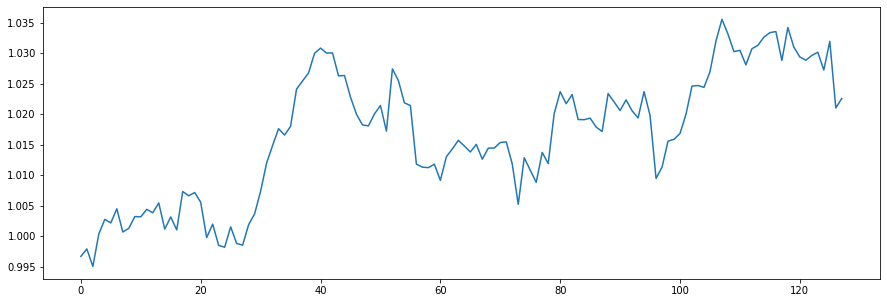

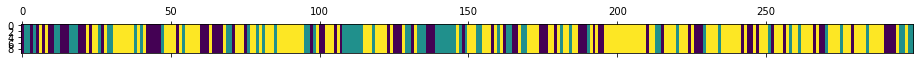

<Figure size 432x288 with 0 Axes>

N [[32. 14. 31.]
 [14. 27. 29.]
 [31. 29. 92.]]
alphas [[1.30867675 0.98587399 0.58459263]
 [0.69431475 1.600236   0.58459263]
 [0.69431475 0.98587399 1.19895464]]
M [[7. 2. 3.]
 [1. 5. 2.]
 [4. 4. 5.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[3. 2. 3.]
 [1. 3. 2.]
 [4. 4. 4.]]
pi_z [[0.44797004 0.21789311 0.33413685]
 [0.10779423 0.49250453 0.39970124]
 [0.26318119 0.17473587 0.56208294]]
beta_vec [0.25319071 0.35141657 0.39539272]
hyper>> a_k: 2.512231330394401  gamma: 0.44439051515758854  rho: 0.21923225667125606


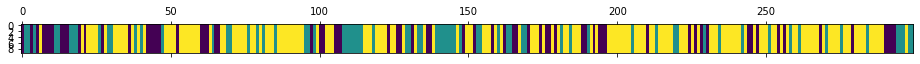

<Figure size 432x288 with 0 Axes>

629
N [[26. 12. 31.]
 [11. 29. 32.]
 [32. 31. 95.]]
alphas [[1.04738791 0.68929278 0.77555064]
 [0.49662577 1.24005493 0.77555064]
 [0.49662577 0.68929278 1.32631278]]
M [[4. 4. 5.]
 [5. 3. 3.]
 [2. 5. 4.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[1. 4. 5.]
 [5. 2. 3.]
 [2. 5. 2.]]
pi_z [[0.41588169 0.19817741 0.3859409 ]
 [0.12969329 0.39128252 0.47902419]
 [0.17436934 0.17757761 0.64805305]]
beta_vec [0.22277452 0.47442254 0.30280294]
hyper>> a_k: 2.892893135528312  gamma: 0.5277358187028605  rho: 0.21883866438685398


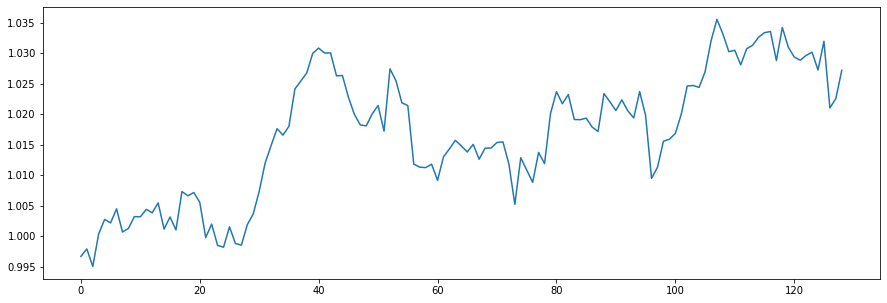

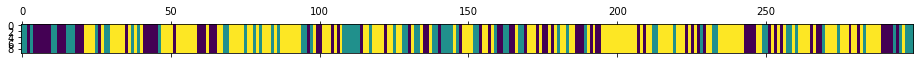

<Figure size 432x288 with 0 Axes>

N [[32. 17. 30.]
 [12. 27. 32.]
 [35. 27. 87.]]
alphas [[1.13650635 1.07210778 0.68427901]
 [0.50342948 1.70518465 0.68427901]
 [0.50342948 1.07210778 1.31735588]]
M [[4. 4. 5.]
 [4. 8. 1.]
 [4. 5. 2.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[2. 4. 5.]
 [4. 8. 1.]
 [4. 5. 1.]]
pi_z [[0.4200477  0.2278998  0.3520525 ]
 [0.20855928 0.38922784 0.40221288]
 [0.25476249 0.15191629 0.59332121]]
beta_vec [0.23263118 0.36667287 0.40069596]
hyper>> a_k: 4.385060457683711  gamma: 0.31979163898974367  rho: 0.15336952548714822


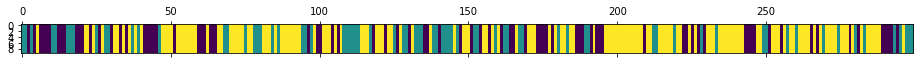

<Figure size 432x288 with 0 Axes>

630
N [[32. 21. 29.]
 [12. 29. 32.]
 [38. 23. 83.]]
alphas [[1.53618389 1.36128248 1.48759409]
 [0.86364925 2.03381712 1.48759409]
 [0.86364925 1.36128248 2.16012873]]
M [[4. 5. 5.]
 [3. 7. 8.]
 [2. 3. 7.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[2. 5. 5.]
 [3. 5. 8.]
 [2. 3. 5.]]
pi_z [[0.50145443 0.23975656 0.258789  ]
 [0.18306195 0.37973349 0.43720456]
 [0.25348918 0.21750342 0.5290074 ]]
beta_vec [0.20030613 0.50871323 0.29098064]
hyper>> a_k: 4.135507890896933  gamma: 1.0046638585837786  rho: 0.18448893165563768


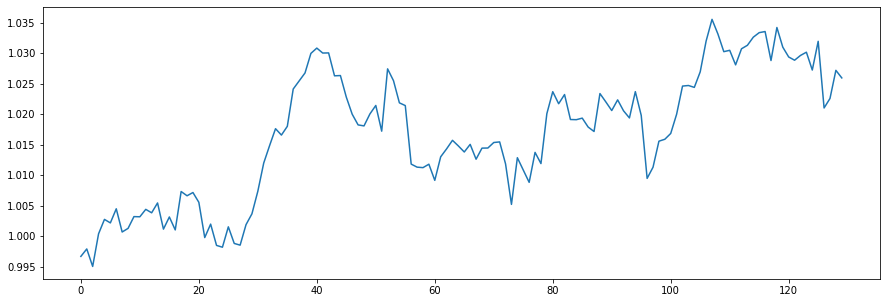

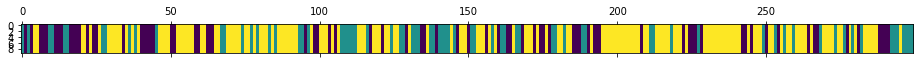

<Figure size 432x288 with 0 Axes>

N [[31. 17. 29.]
 [14. 28. 30.]
 [32. 27. 91.]]
alphas [[1.43849837 1.71566204 0.98134748]
 [0.67554294 2.47861747 0.98134748]
 [0.67554294 1.71566204 1.74430291]]
M [[ 7.  7.  4.]
 [ 1.  5.  4.]
 [ 2.  7. 11.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[5. 7. 4.]
 [1. 4. 4.]
 [2. 7. 8.]]
pi_z [[0.43970643 0.18277363 0.37751994]
 [0.20878085 0.35655494 0.43466421]
 [0.24072    0.2087036  0.5505764 ]]
beta_vec [0.16435753 0.38735602 0.44828646]
hyper>> a_k: 3.859576826848143  gamma: 0.5611710937740981  rho: 0.16811019264405122


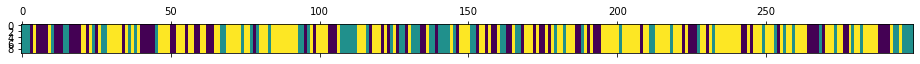

<Figure size 432x288 with 0 Axes>

631
N [[35. 16. 30.]
 [10. 26. 33.]
 [36. 27. 86.]]
alphas [[1.17654392 1.24370047 1.43933243]
 [0.52770972 1.89253468 1.43933243]
 [0.52770972 1.24370047 2.08816664]]
M [[4. 2. 3.]
 [2. 5. 4.]
 [2. 4. 6.]]
sum_w [[3.]
 [3.]
 [2.]]
barM [[1. 2. 3.]
 [2. 2. 4.]
 [2. 4. 4.]]
pi_z [[0.36012333 0.20233499 0.43754168]
 [0.15727163 0.29269416 0.55003421]
 [0.27591066 0.24891107 0.47517826]]
beta_vec [0.24926958 0.16715138 0.58357904]
hyper>> a_k: 2.5913022840177753  gamma: 0.8650737174199153  rho: 0.28925630176387995


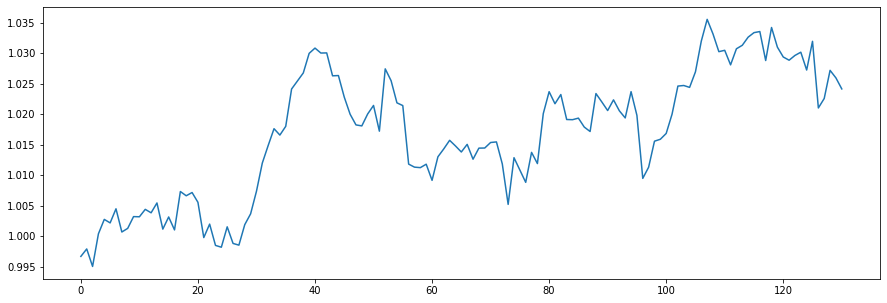

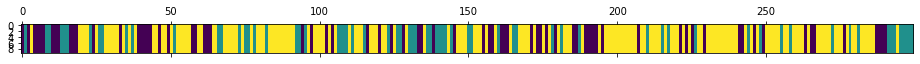

<Figure size 432x288 with 0 Axes>

N [[29. 15. 30.]
 [ 8. 24. 35.]
 [37. 28. 93.]]
alphas [[1.2086432  0.30785135 1.07480773]
 [0.45909269 1.05740186 1.07480773]
 [0.45909269 0.30785135 1.82435825]]
M [[5. 3. 5.]
 [1. 6. 4.]
 [1. 2. 5.]]
sum_w [[4.]
 [5.]
 [0.]]
barM [[1. 3. 5.]
 [1. 1. 4.]
 [1. 2. 5.]]
pi_z [[0.37775384 0.25218777 0.3700584 ]
 [0.15074033 0.36004579 0.48921388]
 [0.25485152 0.16755377 0.57759471]]
beta_vec [0.20067604 0.24229938 0.55702458]
hyper>> a_k: 2.172773609542944  gamma: 0.3290851322780471  rho: 0.28345229258545057


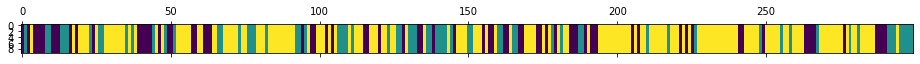

<Figure size 432x288 with 0 Axes>

632
N [[ 31.  15.  26.]
 [ 10.  29.  30.]
 [ 31.  25. 102.]]
alphas [[0.92830937 0.37723492 0.86722932]
 [0.31243171 0.99311258 0.86722932]
 [0.31243171 0.37723492 1.48310698]]
M [[3. 1. 1.]
 [3. 2. 3.]
 [2. 3. 4.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[2. 1. 1.]
 [3. 0. 3.]
 [2. 3. 3.]]
pi_z [[0.45890961 0.23376134 0.30732905]
 [0.18919558 0.52443848 0.28636594]
 [0.16705163 0.16415879 0.66878958]]
beta_vec [0.37287395 0.20824423 0.41888182]
hyper>> a_k: 2.0381781553751743  gamma: 1.5052256739247654  rho: 0.292100800700443


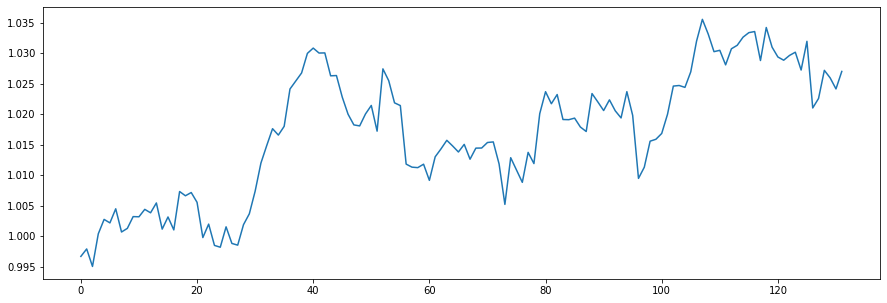

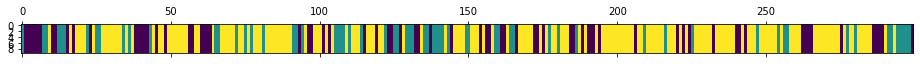

<Figure size 432x288 with 0 Axes>

N [[ 30.  12.  29.]
 [  9.  25.  31.]
 [ 33.  27. 103.]]
alphas [[1.13334521 0.30045991 0.60437303]
 [0.53799174 0.89581338 0.60437303]
 [0.53799174 0.30045991 1.19972651]]
M [[7. 1. 3.]
 [2. 3. 3.]
 [2. 3. 5.]]
sum_w [[6.]
 [0.]
 [3.]]
barM [[1. 1. 3.]
 [2. 3. 3.]
 [2. 3. 2.]]
pi_z [[0.36978391 0.12406814 0.50614796]
 [0.1281882  0.49610981 0.37570199]
 [0.20057289 0.23705218 0.56237493]]
beta_vec [0.35674486 0.20952119 0.43373395]
hyper>> a_k: 2.59270901449839  gamma: 0.6191754107721342  rho: 0.22888524340673455


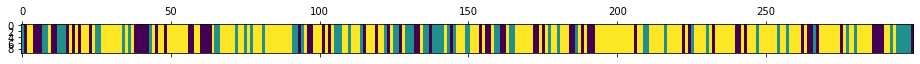

<Figure size 432x288 with 0 Axes>

633
N [[ 25.  11.  31.]
 [  9.  23.  32.]
 [ 33.  30. 105.]]
alphas [[1.30666434 0.41889072 0.86715396]
 [0.71323151 1.01232355 0.86715396]
 [0.71323151 0.41889072 1.46058679]]
M [[3. 3. 3.]
 [2. 2. 4.]
 [5. 2. 9.]]
sum_w [[2.]
 [1.]
 [7.]]
barM [[1. 3. 3.]
 [2. 1. 4.]
 [5. 2. 2.]]
pi_z [[0.34140949 0.20114041 0.4574501 ]
 [0.17634527 0.34803382 0.47562091]
 [0.21428512 0.17979105 0.60592384]]
beta_vec [0.40033734 0.32058654 0.27907612]
hyper>> a_k: 2.8149608452622314  gamma: 0.4489248026571019  rho: 0.31572871772214345


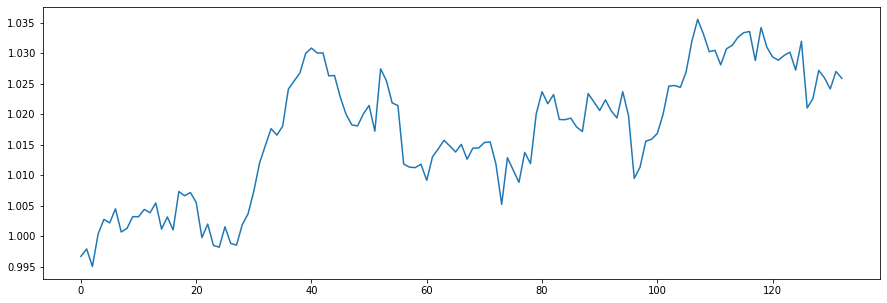

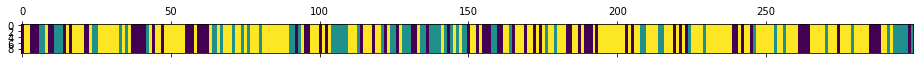

<Figure size 432x288 with 0 Axes>

N [[28. 13. 33.]
 [ 9. 26. 31.]
 [36. 28. 95.]]
alphas [[1.65989251 0.61751279 0.53755555]
 [0.77112853 1.50627676 0.53755555]
 [0.77112853 0.61751279 1.42631953]]
M [[2. 2. 3.]
 [1. 8. 4.]
 [3. 2. 6.]]
sum_w [[1.]
 [6.]
 [5.]]
barM [[1. 2. 3.]
 [1. 2. 4.]
 [3. 2. 1.]]
pi_z [[0.44979187 0.11036206 0.43984607]
 [0.11802611 0.37565334 0.50632055]
 [0.16590502 0.17815263 0.65594236]]
beta_vec [0.4867513  0.15153002 0.36171867]
hyper>> a_k: 3.0907498610704365  gamma: 0.9613770694591505  rho: 0.30749842258490967


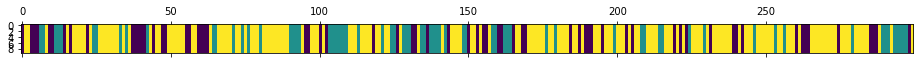

<Figure size 432x288 with 0 Axes>

634
N [[ 24.   9.  32.]
 [  7.  33.  29.]
 [ 34.  27. 104.]]
alphas [[1.99221845 0.32432716 0.77420425]
 [1.04181774 1.27472787 0.77420425]
 [1.04181774 0.32432716 1.72460496]]
M [[5. 2. 3.]
 [2. 2. 3.]
 [4. 2. 8.]]
sum_w [[3.]
 [2.]
 [7.]]
barM [[2. 2. 3.]
 [2. 0. 3.]
 [4. 2. 1.]]
pi_z [[0.42185627 0.1447269  0.43341683]
 [0.09271801 0.42029178 0.48699021]
 [0.26650286 0.09618328 0.63731386]]
beta_vec [0.43571237 0.20518347 0.35910416]
hyper>> a_k: 1.6397101577446596  gamma: 0.19184828862085054  rho: 0.39298313759114095


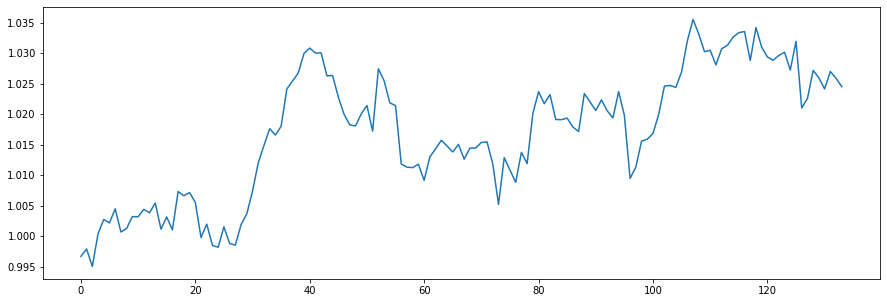

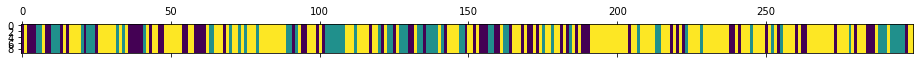

<Figure size 432x288 with 0 Axes>

N [[24. 13. 36.]
 [11. 30. 27.]
 [38. 25. 95.]]
alphas [[1.07805678 0.20422562 0.35742776]
 [0.43367834 0.84860406 0.35742776]
 [0.43367834 0.20422562 1.0018062 ]]
M [[2. 1. 1.]
 [4. 4. 1.]
 [2. 1. 6.]]
sum_w [[0.]
 [4.]
 [3.]]
barM [[2. 1. 1.]
 [4. 0. 1.]
 [2. 1. 3.]]
pi_z [[0.40895533 0.09786462 0.49318005]
 [0.25104294 0.35589012 0.39306694]
 [0.22977685 0.15492768 0.61529548]]
beta_vec [0.28191786 0.1210895  0.59699264]
hyper>> a_k: 2.2570002262515954  gamma: 0.4590776326832763  rho: 0.5505189060510153


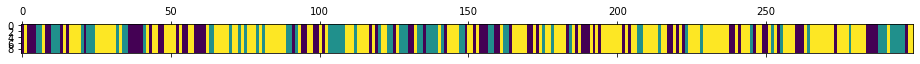

<Figure size 432x288 with 0 Axes>

635
N [[29. 13. 34.]
 [12. 30. 28.]
 [35. 27. 91.]]
alphas [[1.52852103 0.12284275 0.60563645]
 [0.28599973 1.36536404 0.60563645]
 [0.28599973 0.12284275 1.84815775]]
M [[6. 1. 3.]
 [2. 4. 2.]
 [2. 2. 5.]]
sum_w [[5.]
 [4.]
 [4.]]
barM [[1. 1. 3.]
 [2. 0. 2.]
 [2. 2. 1.]]
pi_z [[0.45195632 0.18354315 0.36450053]
 [0.1680906  0.45691107 0.37499833]
 [0.2529072  0.15588662 0.59120617]]
beta_vec [0.21267217 0.27430596 0.51302188]
hyper>> a_k: 2.115986161773503  gamma: 0.767843409385238  rho: 0.38975861334137946


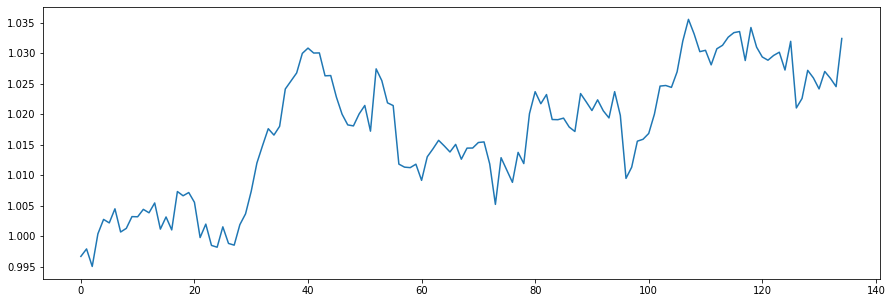

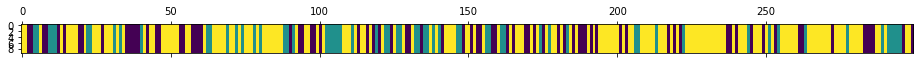

<Figure size 432x288 with 0 Axes>

N [[25. 12. 40.]
 [10. 23. 29.]
 [43. 27. 90.]]
alphas [[1.09933939 0.35420095 0.66244582]
 [0.27461556 1.17892478 0.66244582]
 [0.27461556 0.35420095 1.48716966]]
M [[5. 1. 2.]
 [1. 4. 2.]
 [2. 3. 7.]]
sum_w [[4.]
 [3.]
 [3.]]
barM [[1. 1. 2.]
 [1. 1. 2.]
 [2. 3. 4.]]
pi_z [[0.30729582 0.13211253 0.56059165]
 [0.14513324 0.42129437 0.43357239]
 [0.3021493  0.15330529 0.54454541]]
beta_vec [0.31281125 0.42386125 0.26332749]
hyper>> a_k: 3.221268197716403  gamma: 1.5334608906248872  rho: 0.3637537101266719


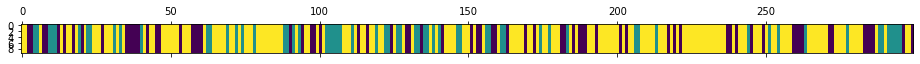

<Figure size 432x288 with 0 Axes>

636
N [[25. 11. 35.]
 [ 7. 24. 32.]
 [39. 28. 98.]]
alphas [[1.81286116 0.86871209 0.53969495]
 [0.6411129  2.04046035 0.53969495]
 [0.6411129  0.86871209 1.71144321]]
M [[4. 2. 5.]
 [3. 8. 3.]
 [4. 4. 5.]]
sum_w [[4.]
 [5.]
 [4.]]
barM [[0. 2. 5.]
 [3. 3. 3.]
 [4. 4. 1.]]
pi_z [[0.34667491 0.1926664  0.46065869]
 [0.17342591 0.40102303 0.42555106]
 [0.27411314 0.16436097 0.56152589]]
beta_vec [0.27243925 0.29081392 0.43674683]
hyper>> a_k: 4.251345044861519  gamma: 3.018262439886495  rho: 0.4110323892684564


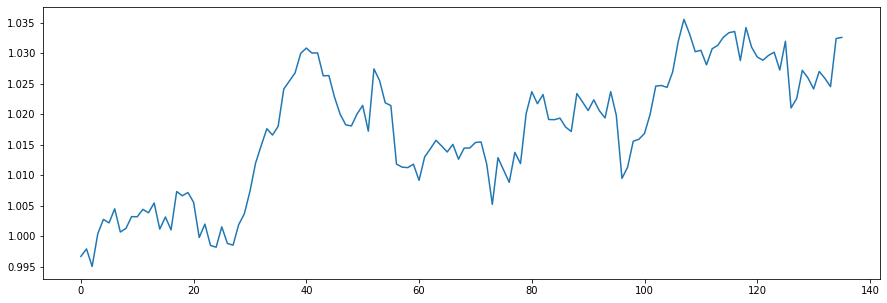

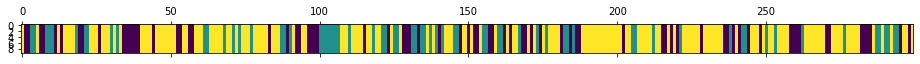

<Figure size 432x288 with 0 Axes>

N [[29. 16. 30.]
 [14. 25. 29.]
 [31. 27. 98.]]
alphas [[2.42960239 0.72817029 1.09357237]
 [0.68216188 2.4756108  1.09357237]
 [0.68216188 0.72817029 2.84101288]]
M [[7. 5. 5.]
 [2. 6. 8.]
 [1. 4. 9.]]
sum_w [[4.]
 [5.]
 [6.]]
barM [[3. 5. 5.]
 [2. 1. 8.]
 [1. 4. 3.]]
pi_z [[0.33781781 0.17643083 0.48575136]
 [0.20601313 0.32771128 0.46627559]
 [0.22250235 0.15956072 0.61793693]]
beta_vec [0.2168154  0.46014199 0.32304261]
hyper>> a_k: 3.5802531384870444  gamma: 1.2919381433890418  rho: 0.34680745310009053


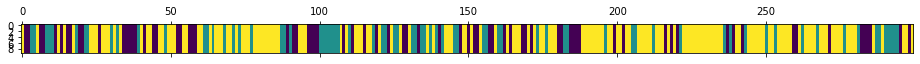

<Figure size 432x288 with 0 Axes>

637
N [[28. 17. 29.]
 [12. 26. 35.]
 [34. 30. 88.]]
alphas [[1.74870182 1.0760856  0.75546571]
 [0.50704335 2.31774408 0.75546571]
 [0.50704335 1.0760856  1.99712419]]
M [[7. 4. 4.]
 [3. 8. 5.]
 [4. 4. 7.]]
sum_w [[4.]
 [5.]
 [2.]]
barM [[3. 4. 4.]
 [3. 3. 5.]
 [4. 4. 5.]]
pi_z [[0.39631905 0.2090311  0.39464986]
 [0.0908068  0.48614991 0.42304329]
 [0.21491855 0.21129167 0.57378978]]
beta_vec [0.18898599 0.38183659 0.42917742]
hyper>> a_k: 5.55948911934475  gamma: 1.0452995001199428  rho: 0.13135079519182602


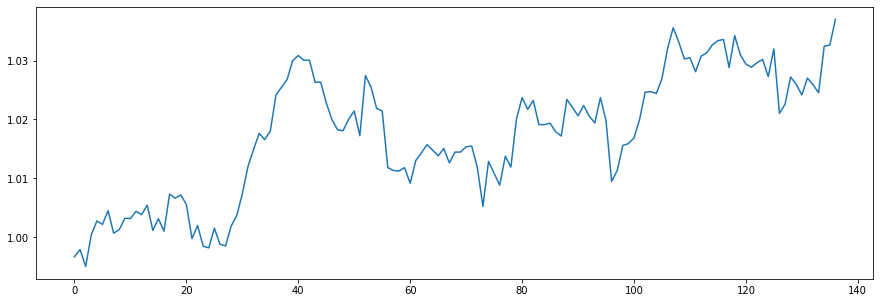

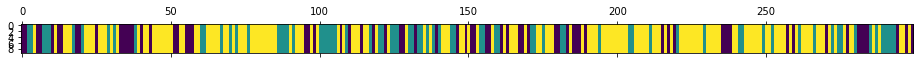

<Figure size 432x288 with 0 Axes>

N [[26. 14. 29.]
 [10. 29. 36.]
 [34. 32. 89.]]
alphas [[1.64290311 1.84398274 2.07260327]
 [0.91265979 2.57422605 2.07260327]
 [0.91265979 1.84398274 2.80284659]]
M [[7. 3. 5.]
 [4. 4. 5.]
 [2. 4. 9.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[5. 3. 5.]
 [4. 2. 5.]
 [2. 4. 6.]]
pi_z [[0.41421005 0.23952467 0.34626528]
 [0.10580982 0.47053674 0.42365344]
 [0.17424865 0.18655653 0.63919482]]
beta_vec [0.33054061 0.24403219 0.42542719]
hyper>> a_k: 3.904043292357547  gamma: 1.4459944011650399  rho: 0.19348745628777692


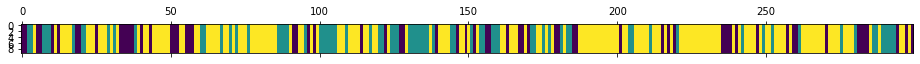

<Figure size 432x288 with 0 Axes>

638
N [[ 24.  12.  28.]
 [  9.  34.  32.]
 [ 31.  29. 100.]]
alphas [[1.79614337 0.76837438 1.33952554]
 [1.04075997 1.52375778 1.33952554]
 [1.04075997 0.76837438 2.09490895]]
M [[5. 2. 7.]
 [3. 5. 4.]
 [4. 3. 8.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[1. 2. 7.]
 [3. 3. 4.]
 [4. 3. 7.]]
pi_z [[0.36151145 0.13736385 0.50112471]
 [0.12762766 0.34291216 0.52946018]
 [0.15647694 0.16626621 0.67725685]]
beta_vec [0.18159782 0.23444459 0.58395758]
hyper>> a_k: 3.5647072451271966  gamma: 0.9687007212495063  rho: 0.26708325838447167


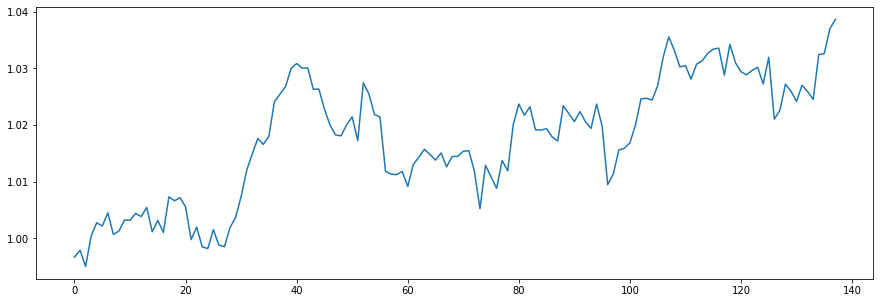

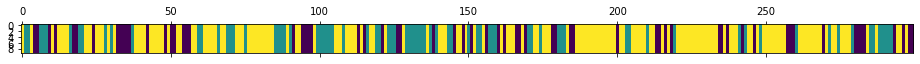

<Figure size 432x288 with 0 Axes>

N [[ 23.  12.  29.]
 [ 11.  37.  29.]
 [ 30.  28. 100.]]
alphas [[1.42652221 0.61251782 1.52566721]
 [0.47444858 1.56459145 1.52566721]
 [0.47444858 0.61251782 2.47774084]]
M [[ 2.  3.  7.]
 [ 3.  4.  6.]
 [ 3.  1. 11.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[0. 3. 7.]
 [3. 2. 6.]
 [3. 1. 6.]]
pi_z [[0.38535277 0.14268973 0.47195749]
 [0.08321689 0.42537527 0.49140784]
 [0.22498395 0.20248304 0.572533  ]]
beta_vec [0.22380108 0.1651835  0.61101543]
hyper>> a_k: 3.7130158435754725  gamma: 0.8115618266971235  rho: 0.30307791031483233


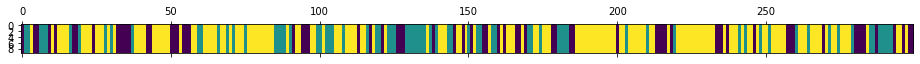

<Figure size 432x288 with 0 Axes>

639
N [[30. 15. 24.]
 [11. 31. 33.]
 [28. 29. 98.]]
alphas [[1.70445927 0.42744249 1.58111409]
 [0.57912619 1.55277557 1.58111409]
 [0.57912619 0.42744249 2.70644717]]
M [[ 8.  2.  2.]
 [ 1.  5.  6.]
 [ 2.  2. 14.]]
sum_w [[6.]
 [2.]
 [4.]]
barM [[ 2.  2.  2.]
 [ 1.  3.  6.]
 [ 2.  2. 10.]]
pi_z [[0.34872171 0.26603522 0.38524306]
 [0.10551489 0.48782896 0.40665615]
 [0.15025349 0.19380051 0.655946  ]]
beta_vec [0.28485034 0.21534836 0.4998013 ]
hyper>> a_k: 3.61085551362493  gamma: 0.47875635975464553  rho: 0.26690194274928575


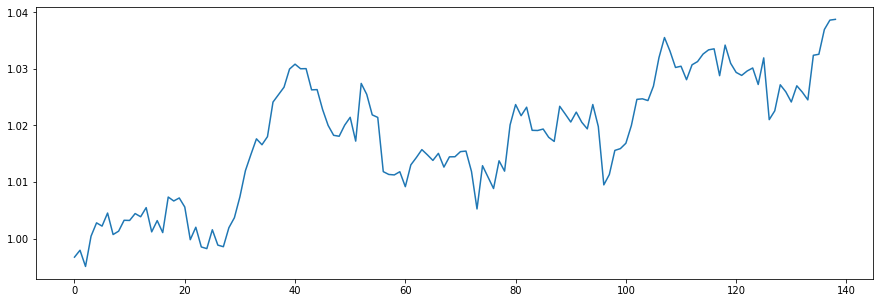

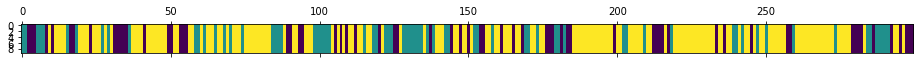

<Figure size 432x288 with 0 Axes>

N [[ 25.  12.  28.]
 [ 11.  32.  28.]
 [ 29.  27. 107.]]
alphas [[1.71777486 0.57005104 1.32302961]
 [0.75403051 1.53379539 1.32302961]
 [0.75403051 0.57005104 2.28677396]]
M [[6. 3. 4.]
 [2. 6. 5.]
 [2. 4. 8.]]
sum_w [[4.]
 [4.]
 [4.]]
barM [[2. 3. 4.]
 [2. 2. 5.]
 [2. 4. 4.]]
pi_z [[0.42110072 0.21236237 0.36653691]
 [0.0778115  0.52773514 0.39445336]
 [0.17712317 0.18123929 0.64163754]]
beta_vec [0.23394589 0.42090082 0.34515328]
hyper>> a_k: 2.9689055108437143  gamma: 0.5526205043851009  rho: 0.3377508320957916


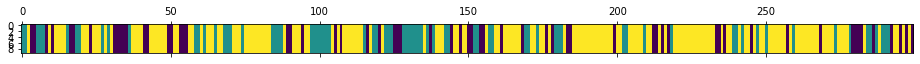

<Figure size 432x288 with 0 Axes>

640
N [[ 21.  11.  30.]
 [ 11.  35.  28.]
 [ 30.  28. 105.]]
alphas [[1.46272424 0.82755635 0.67862492]
 [0.45997394 1.83030665 0.67862492]
 [0.45997394 0.82755635 1.68137523]]
M [[8. 1. 3.]
 [3. 4. 4.]
 [2. 4. 4.]]
sum_w [[5.]
 [1.]
 [2.]]
barM [[3. 1. 3.]
 [3. 3. 4.]
 [2. 4. 2.]]
pi_z [[0.31586702 0.32213464 0.36199834]
 [0.20762332 0.43111648 0.36126021]
 [0.12473902 0.19823123 0.67702975]]
beta_vec [0.31820219 0.3342902  0.34750761]
hyper>> a_k: 2.404495381444596  gamma: 0.8736728462281764  rho: 0.3125593516258338


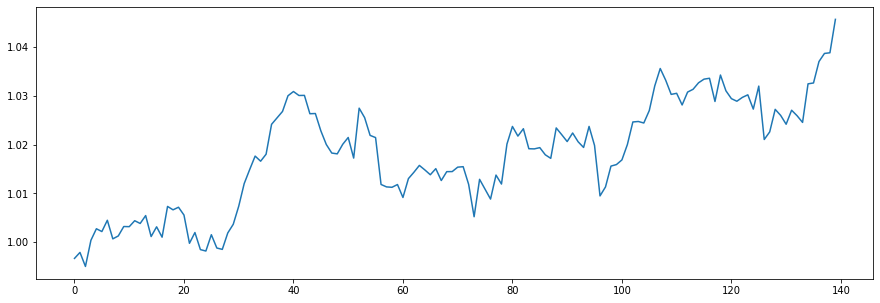

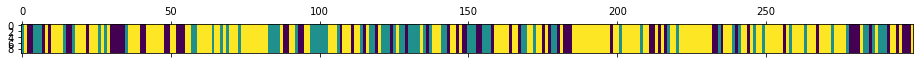

<Figure size 432x288 with 0 Axes>

N [[ 23.  18.  26.]
 [ 14.  28.  32.]
 [ 29.  28. 101.]]
alphas [[1.27751914 0.55256427 0.57441197]
 [0.52597162 1.30411179 0.57441197]
 [0.52597162 0.55256427 1.32595949]]
M [[6. 3. 3.]
 [2. 6. 4.]
 [5. 3. 6.]]
sum_w [[5.]
 [3.]
 [4.]]
barM [[1. 3. 3.]
 [2. 3. 4.]
 [5. 3. 2.]]
pi_z [[0.21271922 0.33302337 0.45425741]
 [0.21195946 0.42632379 0.36171675]
 [0.15106403 0.20743456 0.64150141]]
beta_vec [0.31820403 0.40829147 0.2735045 ]
hyper>> a_k: 3.6521088225008533  gamma: 0.734021813384886  rho: 0.4368866950500693


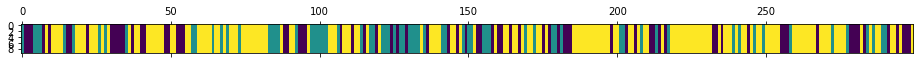

<Figure size 432x288 with 0 Axes>

641
N [[27. 19. 29.]
 [14. 25. 30.]
 [34. 25. 96.]]
alphas [[2.24996059 0.83967226 0.56247598]
 [0.65440283 2.43523001 0.56247598]
 [0.65440283 0.83967226 2.15803373]]
M [[ 7.  2.  3.]
 [ 2.  6.  1.]
 [ 6.  2. 10.]]
sum_w [[5.]
 [5.]
 [8.]]
barM [[2. 2. 3.]
 [2. 1. 1.]
 [6. 2. 2.]]
pi_z [[0.45870154 0.22863093 0.31266753]
 [0.17791991 0.39360586 0.42847423]
 [0.22648008 0.12186237 0.65165755]]
beta_vec [0.36522922 0.28264073 0.35213004]
hyper>> a_k: 3.631217060553552  gamma: 0.17387422170348246  rho: 0.5210847203977487


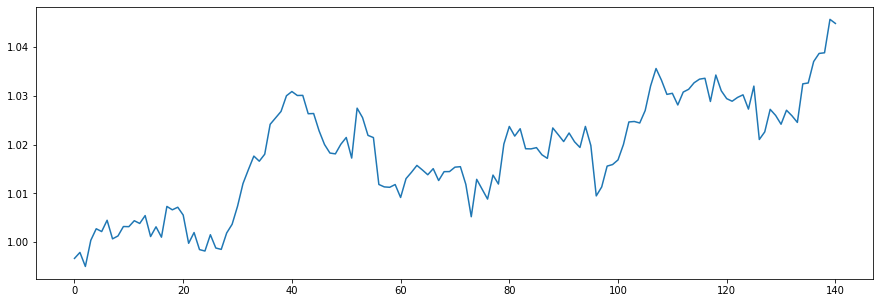

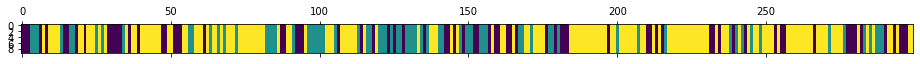

<Figure size 432x288 with 0 Axes>

N [[27. 21. 27.]
 [15. 28. 29.]
 [33. 23. 96.]]
alphas [[2.52732191 0.49152505 0.61237011]
 [0.63515018 2.38369678 0.61237011]
 [0.63515018 0.49152505 2.50454183]]
M [[11.  1.  2.]
 [ 4.  4.  4.]
 [ 2.  3.  9.]]
sum_w [[8.]
 [4.]
 [7.]]
barM [[3. 1. 2.]
 [4. 0. 4.]
 [2. 3. 2.]]
pi_z [[0.45581927 0.23964792 0.30453281]
 [0.21919653 0.40165198 0.3791515 ]
 [0.2056081  0.13452839 0.6598635 ]]
beta_vec [0.37266376 0.14193088 0.48540537]
hyper>> a_k: 3.626542500273225  gamma: 0.470640970525686  rho: 0.5821501027292114


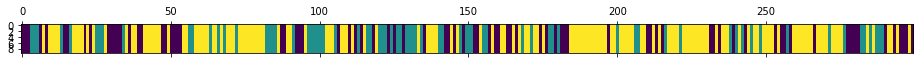

<Figure size 432x288 with 0 Axes>

642
N [[30. 21. 29.]
 [14. 29. 30.]
 [36. 23. 87.]]
alphas [[2.67590826 0.21507501 0.73555923]
 [0.56471617 2.3262671  0.73555923]
 [0.56471617 0.21507501 2.84675131]]
M [[ 9.  4.  4.]
 [ 4.  7.  4.]
 [ 2.  1. 14.]]
sum_w [[ 7.]
 [ 5.]
 [10.]]
barM [[2. 4. 4.]
 [4. 2. 4.]
 [2. 1. 4.]]
pi_z [[0.36389861 0.23285044 0.40325095]
 [0.16553517 0.46871264 0.36575219]
 [0.21160574 0.20954469 0.57884957]]
beta_vec [0.30480959 0.3130331  0.38215731]
hyper>> a_k: 5.036626917118501  gamma: 0.20864611576683564  rho: 0.5912587499810972


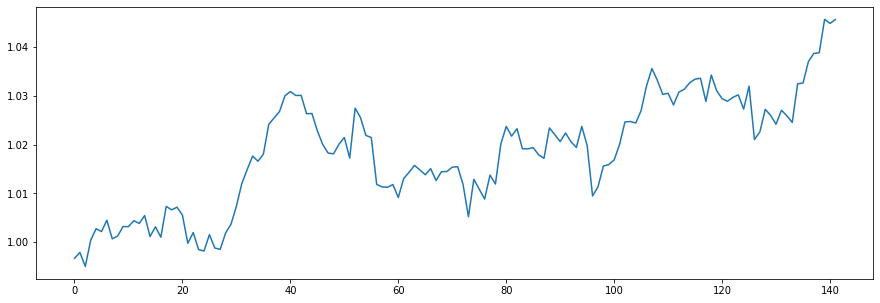

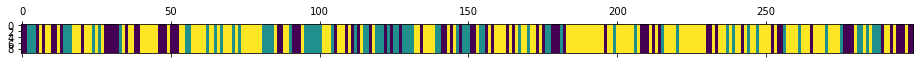

<Figure size 432x288 with 0 Axes>

N [[28. 16. 32.]
 [12. 28. 32.]
 [36. 28. 87.]]
alphas [[3.60545428 0.6444341  0.78673854]
 [0.62750454 3.62238383 0.78673854]
 [0.62750454 0.6444341  3.76468827]]
M [[ 9.  2.  5.]
 [ 3.  8.  4.]
 [ 4.  2. 12.]]
sum_w [[7.]
 [7.]
 [8.]]
barM [[2. 2. 5.]
 [3. 1. 4.]
 [4. 2. 4.]]
pi_z [[0.30864541 0.16174501 0.52960959]
 [0.23908187 0.32082237 0.44009576]
 [0.24314929 0.18412323 0.57272748]]
beta_vec [0.48005447 0.11236321 0.40758233]
hyper>> a_k: 5.222218711572345  gamma: 1.070224247009704  rho: 0.5107259353906928


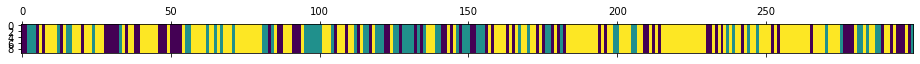

<Figure size 432x288 with 0 Axes>

643
N [[23. 18. 33.]
 [11. 27. 30.]
 [40. 22. 95.]]
alphas [[3.89370787 0.2870988  1.04141204]
 [1.22658533 2.95422134 1.04141204]
 [1.22658533 0.2870988  3.70853458]]
M [[11.  1.  3.]
 [ 4.  8.  5.]
 [ 7.  2.  8.]]
sum_w [[9.]
 [7.]
 [7.]]
barM [[2. 1. 3.]
 [4. 1. 5.]
 [7. 2. 1.]]
pi_z [[0.3778266  0.19949624 0.42267716]
 [0.1883701  0.32501012 0.48661978]
 [0.22734834 0.18820197 0.58444969]]
beta_vec [0.64312897 0.06169906 0.29517197]
hyper>> a_k: 4.117019978563993  gamma: 0.720622649962396  rho: 0.3432679982556915


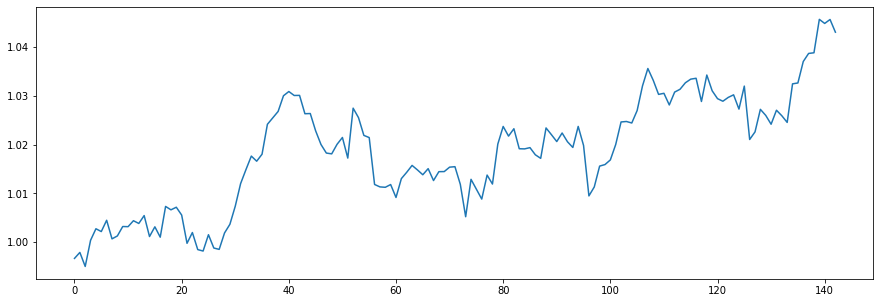

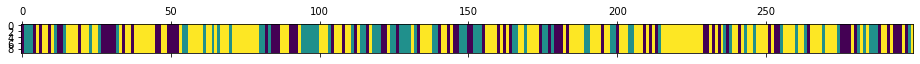

<Figure size 432x288 with 0 Axes>

N [[25. 21. 31.]
 [15. 28. 30.]
 [37. 23. 89.]]
alphas [[3.15211967 0.1668206  0.79807971]
 [1.73887846 1.58006181 0.79807971]
 [1.73887846 0.1668206  2.21132092]]
M [[4. 1. 6.]
 [9. 9. 3.]
 [4. 1. 7.]]
sum_w [[2.]
 [8.]
 [5.]]
barM [[2. 1. 6.]
 [9. 1. 3.]
 [4. 1. 2.]]
pi_z [[0.32441998 0.32355197 0.35202805]
 [0.16567084 0.35270829 0.48162087]
 [0.20641462 0.16711986 0.62646552]]
beta_vec [0.54242763 0.09331788 0.36425449]
hyper>> a_k: 3.3336385302827685  gamma: 0.49613335189815  rho: 0.3009819997010391


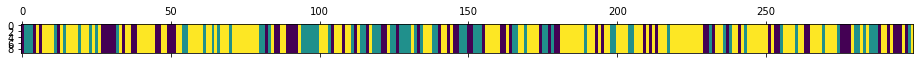

<Figure size 432x288 with 0 Axes>

644
N [[25. 18. 27.]
 [13. 28. 33.]
 [32. 28. 95.]]
alphas [[2.26736983 0.21745618 0.84881252]
 [1.26400464 1.22082137 0.84881252]
 [1.26400464 0.21745618 1.85217771]]
M [[5. 2. 1.]
 [5. 4. 5.]
 [4. 1. 9.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[3. 2. 1.]
 [5. 1. 5.]
 [4. 1. 6.]]
pi_z [[0.25527118 0.32192522 0.4228036 ]
 [0.19086196 0.27838868 0.53074936]
 [0.21968282 0.15068054 0.62963664]]
beta_vec [0.33728138 0.08420948 0.57850914]
hyper>> a_k: 2.6008980627656784  gamma: 0.4011352632268979  rho: 0.2746907968023951


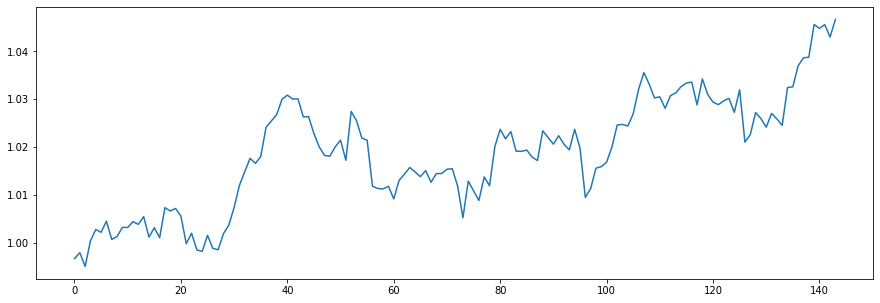

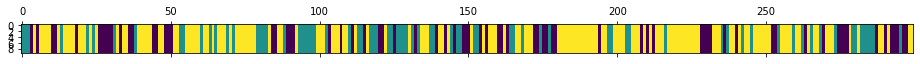

<Figure size 432x288 with 0 Axes>

N [[29. 20. 24.]
 [11. 29. 36.]
 [33. 27. 90.]]
alphas [[1.35070901 0.15885742 1.09133163]
 [0.63626625 0.87330018 1.09133163]
 [0.63626625 0.15885742 1.80577439]]
M [[6. 2. 4.]
 [5. 5. 5.]
 [4. 1. 8.]]
sum_w [[2.]
 [5.]
 [4.]]
barM [[4. 2. 4.]
 [5. 0. 5.]
 [4. 1. 4.]]
pi_z [[0.46836017 0.27121529 0.26042454]
 [0.15741519 0.41362714 0.42895768]
 [0.29015012 0.17018278 0.5396671 ]]
beta_vec [0.3338649  0.18856608 0.47756902]
hyper>> a_k: 4.119787225123872  gamma: 0.5052189200998354  rho: 0.34732251264957203


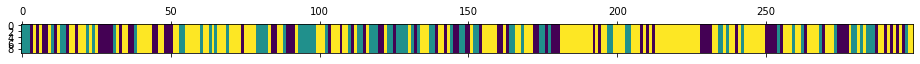

<Figure size 432x288 with 0 Axes>

645
N [[28. 21. 27.]
 [10. 29. 35.]
 [38. 24. 87.]]
alphas [[2.32862164 0.5070339  1.28413169]
 [0.89772679 1.93792875 1.28413169]
 [0.89772679 0.5070339  2.71502654]]
M [[ 8.  5.  9.]
 [ 2.  6.  4.]
 [ 3.  2. 14.]]
sum_w [[4.]
 [4.]
 [9.]]
barM [[4. 5. 9.]
 [2. 2. 4.]
 [3. 2. 5.]]
pi_z [[0.33678032 0.33142056 0.33179912]
 [0.13086867 0.41851552 0.45061581]
 [0.27644212 0.18137904 0.54217884]]
beta_vec [0.18803471 0.32130584 0.49065945]
hyper>> a_k: 4.048339890048068  gamma: 0.4577471409979488  rho: 0.2606678520463437


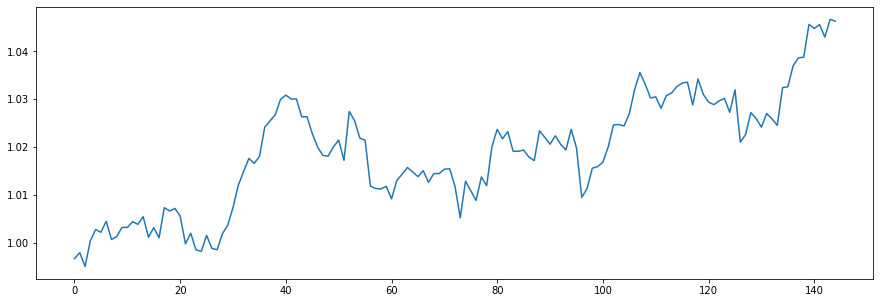

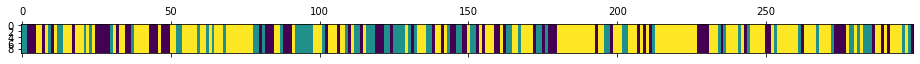

<Figure size 432x288 with 0 Axes>

N [[29. 22. 22.]
 [14. 26. 34.]
 [31. 25. 96.]]
alphas [[1.6180727  0.96169017 1.46857702]
 [0.56280064 2.01696223 1.46857702]
 [0.56280064 0.96169017 2.52384908]]
M [[5. 4. 4.]
 [3. 5. 4.]
 [3. 6. 9.]]
sum_w [[1.]
 [4.]
 [2.]]
barM [[4. 4. 4.]
 [3. 1. 4.]
 [3. 6. 7.]]
pi_z [[0.3676798  0.32965924 0.30266096]
 [0.19118242 0.3665954  0.44222219]
 [0.20565365 0.16890341 0.62544294]]
beta_vec [0.19432744 0.46125621 0.34441635]
hyper>> a_k: 3.45612525682993  gamma: 0.5569915884684336  rho: 0.2020527853333351


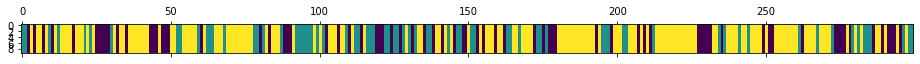

<Figure size 432x288 with 0 Axes>

646
N [[25. 22. 28.]
 [15. 25. 32.]
 [35. 24. 93.]]
alphas [[1.23423701 1.27205494 0.94983331]
 [0.53591728 1.97037467 0.94983331]
 [0.53591728 1.27205494 1.64815304]]
M [[3. 5. 4.]
 [2. 6. 4.]
 [3. 4. 6.]]
sum_w [[0.]
 [6.]
 [2.]]
barM [[3. 5. 4.]
 [2. 0. 4.]
 [3. 4. 4.]]
pi_z [[0.23520988 0.26779546 0.49699466]
 [0.16089993 0.39812504 0.44097503]
 [0.16843454 0.1455047  0.68606075]]
beta_vec [0.40457652 0.29306378 0.3023597 ]
hyper>> a_k: 4.5181632151938285  gamma: 0.2931212149472428  rho: 0.22497320667431933


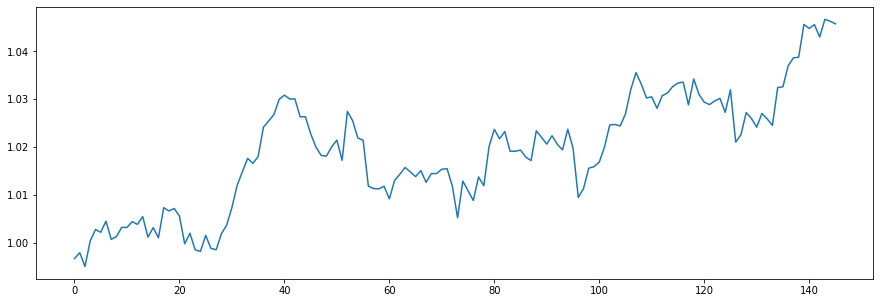

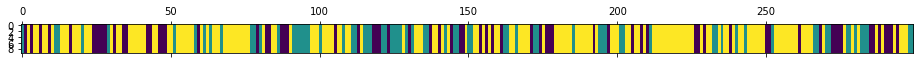

<Figure size 432x288 with 0 Axes>

N [[24. 15. 31.]
 [10. 29. 32.]
 [36. 27. 95.]]
alphas [[2.43317026 1.02622072 1.05877223]
 [1.41670459 2.04268639 1.05877223]
 [1.41670459 1.02622072 2.0752379 ]]
M [[6. 3. 3.]
 [4. 3. 1.]
 [2. 5. 8.]]
sum_w [[4.]
 [2.]
 [5.]]
barM [[2. 3. 3.]
 [4. 1. 1.]
 [2. 5. 3.]]
pi_z [[0.32963306 0.24599174 0.4243752 ]
 [0.22886284 0.33842588 0.43271128]
 [0.22583379 0.20186449 0.57230172]]
beta_vec [0.27572208 0.52535565 0.19892227]
hyper>> a_k: 2.980735867450641  gamma: 0.45922979128487723  rho: 0.32478620753060244


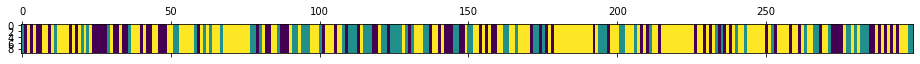

<Figure size 432x288 with 0 Axes>

647
N [[22. 21. 35.]
 [11. 26. 35.]
 [45. 25. 79.]]
alphas [[1.52302952 1.05734863 0.40035772]
 [0.55492762 2.02545053 0.40035772]
 [0.55492762 1.05734863 1.36845962]]
M [[6. 2. 1.]
 [1. 6. 2.]
 [1. 2. 7.]]
sum_w [[1.]
 [2.]
 [6.]]
barM [[5. 2. 1.]
 [1. 4. 2.]
 [1. 2. 1.]]
pi_z [[0.24670526 0.33997008 0.41332465]
 [0.11560554 0.43106495 0.45332951]
 [0.27951663 0.18220928 0.5382741 ]]
beta_vec [0.61401817 0.3170174  0.06896444]
hyper>> a_k: 2.026370147448375  gamma: 1.3268943351099813  rho: 0.2921460566235164


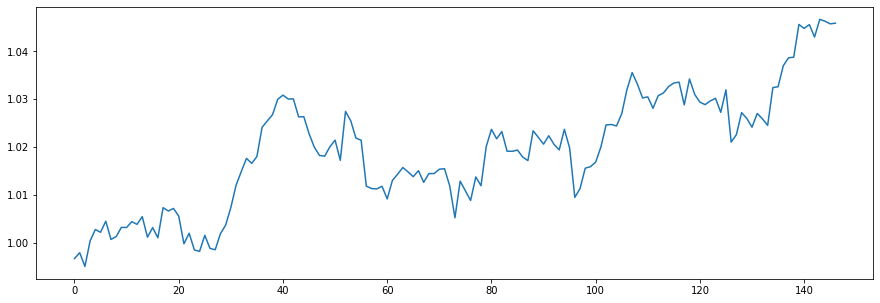

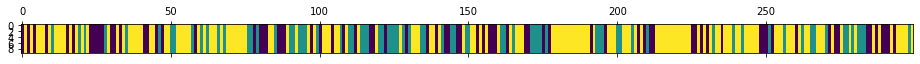

<Figure size 432x288 with 0 Axes>

N [[24. 22. 31.]
 [10. 26. 39.]
 [43. 26. 78.]]
alphas [[1.4727278  0.45472154 0.0989208 ]
 [0.88073176 1.04671759 0.0989208 ]
 [0.88073176 0.45472154 0.69091685]]
M [[3. 2. 1.]
 [4. 4. 1.]
 [5. 2. 6.]]
sum_w [[2.]
 [1.]
 [5.]]
barM [[1. 2. 1.]
 [4. 3. 1.]
 [5. 2. 1.]]
pi_z [[0.21078626 0.30871215 0.48050159]
 [0.06780168 0.23619482 0.6960035 ]
 [0.24931944 0.18074047 0.56994009]]
beta_vec [0.57054276 0.31251069 0.11694655]
hyper>> a_k: 2.5027190454436137  gamma: 1.3114271463882625  rho: 0.5291739436497845


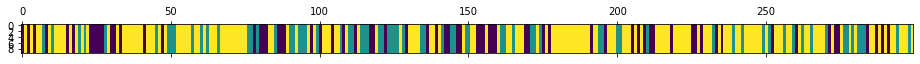

<Figure size 432x288 with 0 Axes>

648
N [[20. 21. 28.]
 [ 6. 23. 43.]
 [43. 28. 87.]]
alphas [[1.99667011 0.36824551 0.13780342]
 [0.6722964  1.69261922 0.13780342]
 [0.6722964  0.36824551 1.46217713]]
M [[7. 2. 2.]
 [2. 7. 1.]
 [5. 2. 3.]]
sum_w [[6.]
 [2.]
 [3.]]
barM [[1. 2. 2.]
 [2. 5. 1.]
 [5. 2. 0.]]
pi_z [[0.37204667 0.18934039 0.43861294]
 [0.07107073 0.41029587 0.5186334 ]
 [0.23366596 0.25587878 0.51045525]]
beta_vec [0.33946818 0.58771689 0.07281492]
hyper>> a_k: 2.6493937288083647  gamma: 0.16788961456323953  rho: 0.2583453023728202


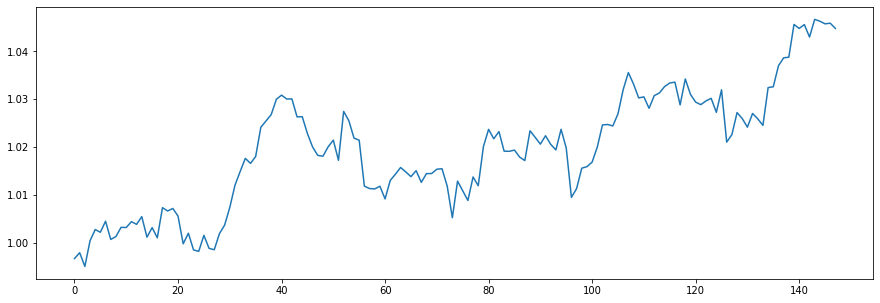

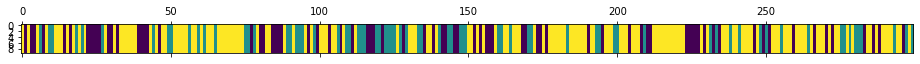

<Figure size 432x288 with 0 Axes>

N [[26. 18. 33.]
 [12. 24. 35.]
 [39. 30. 82.]]
alphas [[1.35149144 1.15482567 0.14307662]
 [0.66703302 1.8392841  0.14307662]
 [0.66703302 1.15482567 0.82753504]]
M [[4. 3. 1.]
 [1. 4. 1.]
 [2. 3. 5.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[2. 3. 1.]
 [1. 1. 1.]
 [2. 3. 1.]]
pi_z [[0.28075771 0.29693488 0.42230742]
 [0.15827838 0.33933818 0.50238344]
 [0.20635993 0.27081715 0.52282292]]
beta_vec [0.27352996 0.62474086 0.10172918]
hyper>> a_k: 1.9908283126003032  gamma: 0.6027957992610447  rho: 0.34205597842736263


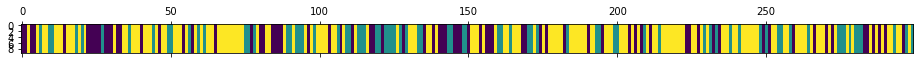

<Figure size 432x288 with 0 Axes>

649
N [[22. 19. 34.]
 [13. 25. 38.]
 [40. 32. 76.]]
alphas [[1.03925893 0.81831906 0.13325033]
 [0.3582842  1.49929378 0.13325033]
 [0.3582842  0.81831906 0.81422505]]
M [[3. 2. 2.]
 [2. 6. 1.]
 [3. 3. 4.]]
sum_w [[2.]
 [5.]
 [4.]]
barM [[1. 2. 2.]
 [2. 1. 1.]
 [3. 3. 0.]]
pi_z [[0.24595515 0.30729919 0.44674566]
 [0.17425378 0.2976848  0.52806141]
 [0.32186604 0.20470353 0.47343043]]
beta_vec [0.39627861 0.39237895 0.21134244]
hyper>> a_k: 1.7008424082976292  gamma: 0.36109728317338513  rho: 0.3920018096173711


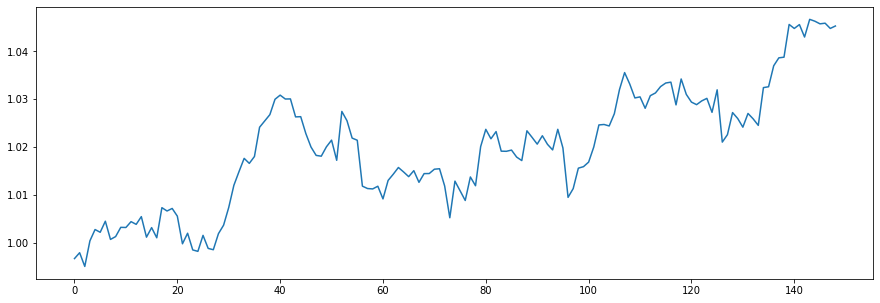

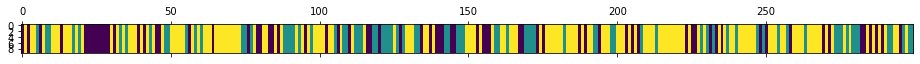

<Figure size 432x288 with 0 Axes>

N [[20. 18. 34.]
 [11. 28. 39.]
 [41. 32. 76.]]
alphas [[1.07652862 0.40576264 0.21855114]
 [0.40979532 1.07249595 0.21855114]
 [0.40979532 0.40576264 0.88528444]]
M [[6. 2. 1.]
 [1. 4. 2.]
 [1. 3. 4.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[1. 2. 1.]
 [1. 1. 2.]
 [1. 3. 1.]]
pi_z [[0.28556457 0.27456193 0.43987351]
 [0.08412118 0.34955881 0.56632001]
 [0.2963396  0.17567891 0.52798149]]
beta_vec [0.21860354 0.54583776 0.2355587 ]
hyper>> a_k: 2.490145286829014  gamma: 0.6132378195227647  rho: 0.3619338168209418


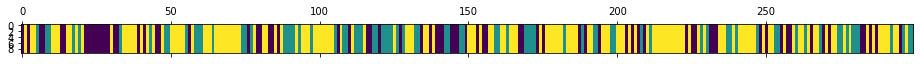

<Figure size 432x288 with 0 Axes>

650
N [[26. 19. 30.]
 [12. 30. 37.]
 [37. 30. 78.]]
alphas [[1.24860203 0.86726933 0.37427393]
 [0.34733425 1.76853712 0.37427393]
 [0.34733425 0.86726933 1.27554171]]
M [[4. 4. 1.]
 [2. 8. 3.]
 [2. 1. 5.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[3. 4. 1.]
 [2. 5. 3.]
 [2. 1. 2.]]
pi_z [[0.38569798 0.26148326 0.35281876]
 [0.23059434 0.36637881 0.40302685]
 [0.28014738 0.14953289 0.57031973]]
beta_vec [0.26909262 0.2682615  0.46264588]
hyper>> a_k: 3.132860412728343  gamma: 0.4984295463529364  rho: 0.22515545369545295


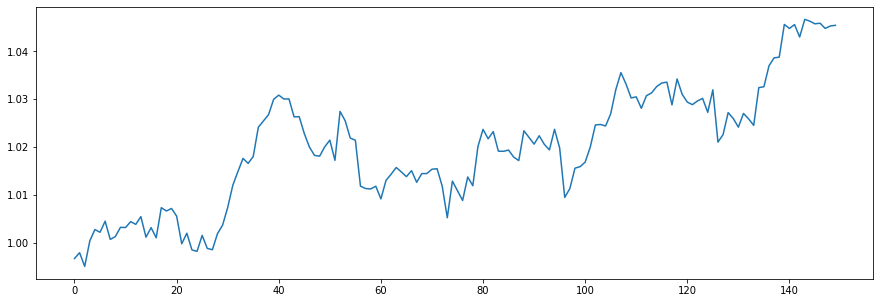

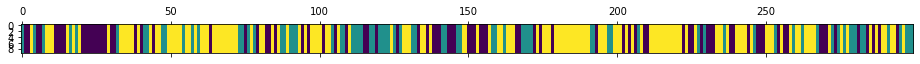

<Figure size 432x288 with 0 Axes>

N [[35. 21. 31.]
 [15. 28. 32.]
 [37. 26. 74.]]
alphas [[1.35859751 0.65119938 1.12306352]
 [0.6532169  1.35657999 1.12306352]
 [0.6532169  0.65119938 1.82844413]]
M [[7. 4. 5.]
 [2. 4. 2.]
 [5. 2. 3.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[3. 4. 5.]
 [2. 2. 2.]
 [5. 2. 1.]]
pi_z [[0.36011407 0.30089497 0.33899096]
 [0.2226531  0.37727206 0.40007484]
 [0.26620952 0.19281422 0.54097626]]
beta_vec [0.30271092 0.43388825 0.26340084]
hyper>> a_k: 1.8085355788636206  gamma: 0.8207995358350858  rho: 0.32823437990911425


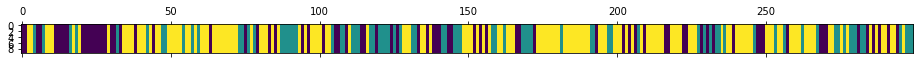

<Figure size 432x288 with 0 Axes>

651
N [[26. 23. 28.]
 [17. 31. 30.]
 [34. 24. 86.]]
alphas [[0.96139069 0.52713605 0.32000884]
 [0.36776713 1.12075961 0.32000884]
 [0.36776713 0.52713605 0.9136324 ]]
M [[4. 3. 3.]
 [1. 4. 1.]
 [2. 2. 4.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[1. 3. 3.]
 [1. 2. 1.]
 [2. 2. 0.]]
pi_z [[0.3315812  0.35705024 0.31136856]
 [0.20052568 0.35940817 0.44006615]
 [0.26945317 0.14355392 0.58699291]]
beta_vec [0.28166401 0.29453744 0.42379855]
hyper>> a_k: 2.1134471993360875  gamma: 0.8907807526218238  rho: 0.42516976533275647


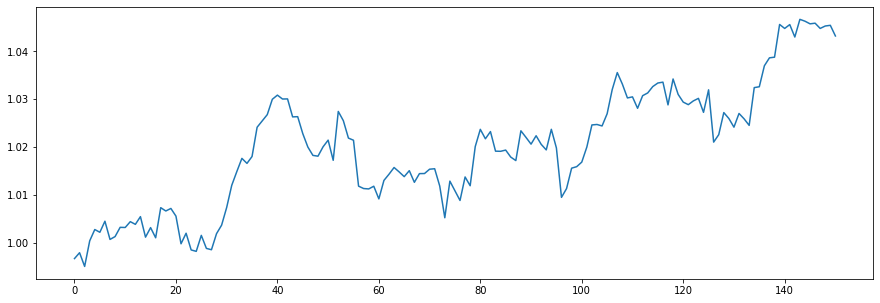

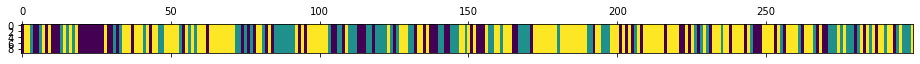

<Figure size 432x288 with 0 Axes>

N [[25. 23. 30.]
 [19. 32. 32.]
 [34. 27. 77.]]
alphas [[1.24075995 0.35782568 0.51486157]
 [0.3421861  1.25639953 0.51486157]
 [0.3421861  0.35782568 1.41343542]]
M [[3. 2. 3.]
 [3. 4. 4.]
 [3. 1. 3.]]
sum_w [[3.]
 [4.]
 [2.]]
barM [[0. 2. 3.]
 [3. 0. 4.]
 [3. 1. 1.]]
pi_z [[0.37904714 0.32193203 0.29902084]
 [0.20735679 0.43501927 0.35762395]
 [0.22754383 0.20854187 0.56391431]]
beta_vec [0.57726295 0.11995211 0.30278495]
hyper>> a_k: 2.337157184358712  gamma: 0.65219592237471  rho: 0.25859776465119094


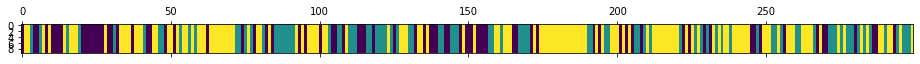

<Figure size 432x288 with 0 Axes>

652
N [[28. 27. 24.]
 [19. 34. 35.]
 [32. 27. 73.]]
alphas [[1.6046496  0.20784984 0.52465775]
 [1.00026597 0.81223346 0.52465775]
 [1.00026597 0.20784984 1.12904137]]
M [[6. 1. 4.]
 [2. 4. 3.]
 [3. 1. 4.]]
sum_w [[5.]
 [4.]
 [2.]]
barM [[1. 1. 4.]
 [2. 0. 3.]
 [3. 1. 2.]]
pi_z [[0.39664948 0.31013374 0.29321679]
 [0.17797306 0.5017599  0.32026703]
 [0.2476228  0.22219738 0.53017982]]
beta_vec [0.43755927 0.17551379 0.38692693]
hyper>> a_k: 1.949082094076448  gamma: 0.5952156966845026  rho: 0.29710168686502414


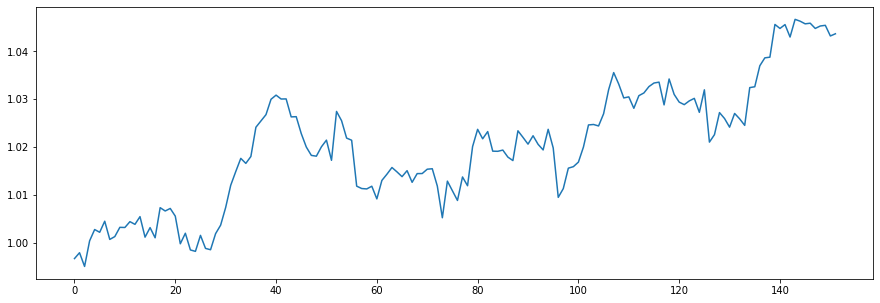

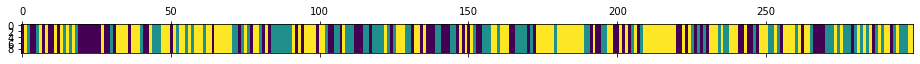

<Figure size 432x288 with 0 Axes>

N [[28. 26. 29.]
 [23. 34. 34.]
 [32. 31. 62.]]
alphas [[1.17853463 0.24045504 0.53009242]
 [0.59945905 0.81953062 0.53009242]
 [0.59945905 0.24045504 1.109168  ]]
M [[2. 4. 6.]
 [3. 3. 5.]
 [2. 3. 3.]]
sum_w [[1.]
 [3.]
 [1.]]
barM [[1. 4. 6.]
 [3. 0. 5.]
 [2. 3. 2.]]
pi_z [[0.39834644 0.33484521 0.26680834]
 [0.22244977 0.3674153  0.41013492]
 [0.30215729 0.23396873 0.46387399]]
beta_vec [0.23847474 0.38898198 0.37254328]
hyper>> a_k: 2.3003338257219137  gamma: 0.9493169233036791  rho: 0.28990697549459543


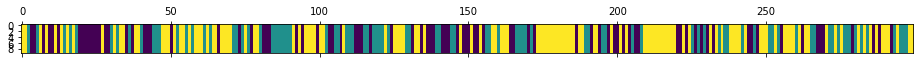

<Figure size 432x288 with 0 Axes>

653
N [[31. 27. 29.]
 [22. 33. 34.]
 [34. 29. 60.]]
alphas [[1.05641963 0.63538301 0.60853119]
 [0.38953681 1.30226583 0.60853119]
 [0.38953681 0.63538301 1.27541401]]
M [[4. 2. 2.]
 [2. 6. 2.]
 [2. 2. 6.]]
sum_w [[2.]
 [5.]
 [4.]]
barM [[2. 2. 2.]
 [2. 1. 2.]
 [2. 2. 2.]]
pi_z [[0.33611261 0.266738   0.39714939]
 [0.18947727 0.4182066  0.39231613]
 [0.36013513 0.20967037 0.4301945 ]]
beta_vec [0.33259277 0.1780627  0.48934453]
hyper>> a_k: 1.9399822787632186  gamma: 3.407942945822412  rho: 0.4587986242540003


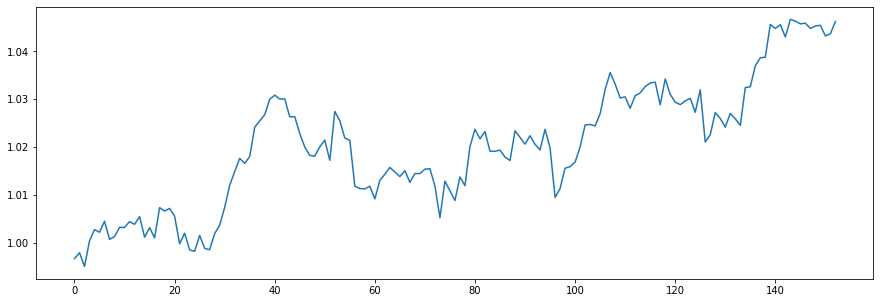

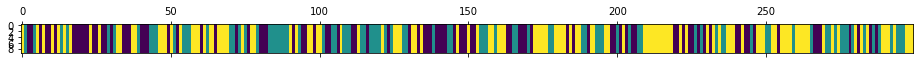

<Figure size 432x288 with 0 Axes>

N [[37. 27. 30.]
 [22. 35. 32.]
 [35. 27. 54.]]
alphas [[1.23925736 0.18695178 0.51377314]
 [0.34919616 1.07701298 0.51377314]
 [0.34919616 0.18695178 1.40383434]]
M [[5. 1. 2.]
 [1. 1. 2.]
 [3. 2. 6.]]
sum_w [[5.]
 [1.]
 [4.]]
barM [[0. 1. 2.]
 [1. 0. 2.]
 [3. 2. 2.]]
pi_z [[0.40366399 0.28352789 0.31280812]
 [0.29860759 0.38128267 0.32010974]
 [0.35394979 0.22188148 0.42416873]]
beta_vec [0.33310777 0.29148885 0.37540338]
hyper>> a_k: 2.4461950902708574  gamma: 1.6824607458838197  rho: 0.3398224624391968


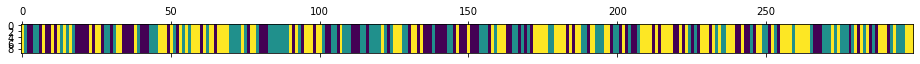

<Figure size 432x288 with 0 Axes>

654
N [[32. 32. 29.]
 [24. 38. 32.]
 [37. 24. 51.]]
alphas [[1.36921546 0.47073206 0.60624757]
 [0.53794342 1.3020041  0.60624757]
 [0.53794342 0.47073206 1.43751961]]
M [[11.  5.  5.]
 [ 3.  5.  1.]
 [ 3.  2.  6.]]
sum_w [[9.]
 [3.]
 [4.]]
barM [[2. 5. 5.]
 [3. 2. 1.]
 [3. 2. 2.]]
pi_z [[0.28464587 0.38208734 0.3332668 ]
 [0.27022115 0.39781203 0.33196682]
 [0.26966099 0.21965771 0.5106813 ]]
beta_vec [0.35391956 0.4314023  0.21467814]
hyper>> a_k: 4.691751648100648  gamma: 1.0056407084632402  rho: 0.33387680583312446


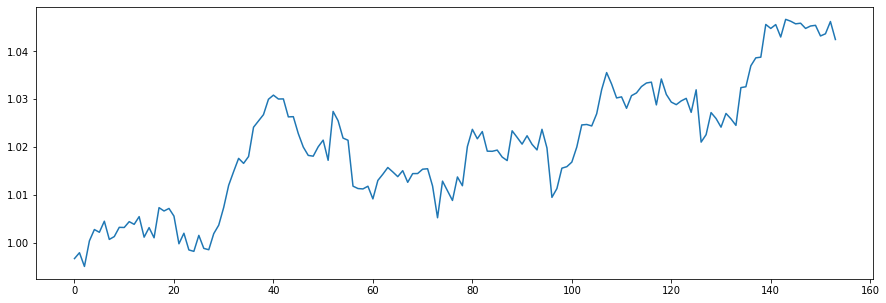

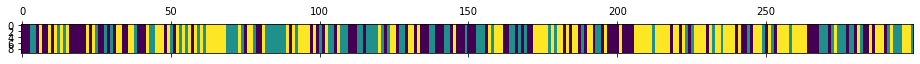

<Figure size 432x288 with 0 Axes>

N [[36. 32. 29.]
 [23. 32. 31.]
 [38. 23. 55.]]
alphas [[2.67256641 1.34825497 0.67093027]
 [1.10609936 2.91472202 0.67093027]
 [1.10609936 1.34825497 2.23739733]]
M [[7. 5. 6.]
 [2. 5. 3.]
 [5. 5. 8.]]
sum_w [[6.]
 [1.]
 [4.]]
barM [[1. 5. 6.]
 [2. 4. 3.]
 [5. 5. 4.]]
pi_z [[0.32982978 0.33694168 0.33322854]
 [0.19776323 0.47809866 0.32413811]
 [0.29393377 0.15906376 0.54700247]]
beta_vec [0.22484854 0.47735605 0.29779542]
hyper>> a_k: 5.880624394051471  gamma: 0.2602168378530187  rho: 0.3231945320598486


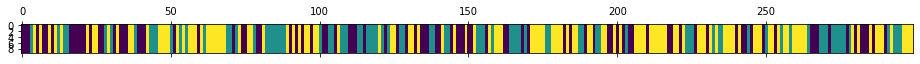

<Figure size 432x288 with 0 Axes>

655
N [[32. 24. 37.]
 [19. 39. 27.]
 [42. 22. 57.]]
alphas [[2.79549155 1.89989556 1.18523729]
 [0.8949059  3.8004812  1.18523729]
 [0.8949059  1.89989556 3.08582294]]
M [[6. 6. 7.]
 [3. 9. 4.]
 [3. 3. 9.]]
sum_w [[3.]
 [4.]
 [7.]]
barM [[3. 6. 7.]
 [3. 5. 4.]
 [3. 3. 2.]]
pi_z [[0.37339698 0.25064252 0.3759605 ]
 [0.29159147 0.49890991 0.20949862]
 [0.3651698  0.12909631 0.50573389]]
beta_vec [0.23656449 0.4218616  0.3415739 ]
hyper>> a_k: 4.402606326186823  gamma: 1.1441428857821652  rho: 0.2808051464569153


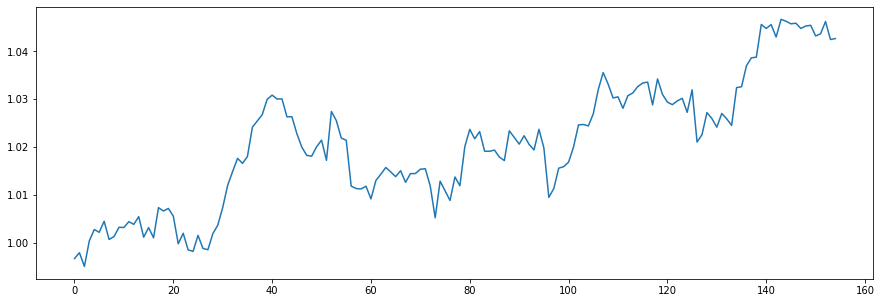

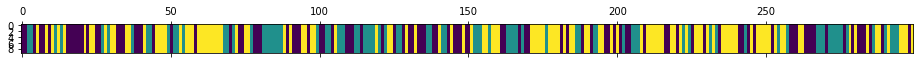

<Figure size 432x288 with 0 Axes>

N [[40. 24. 37.]
 [22. 37. 24.]
 [38. 22. 55.]]
alphas [[1.98531619 1.33575381 1.08153632]
 [0.74904168 2.57202833 1.08153632]
 [0.74904168 1.33575381 2.31781083]]
M [[7. 5. 6.]
 [1. 9. 2.]
 [3. 4. 9.]]
sum_w [[5.]
 [6.]
 [4.]]
barM [[2. 5. 6.]
 [1. 3. 2.]
 [3. 4. 5.]]
pi_z [[0.4289354  0.18259337 0.38847123]
 [0.18138569 0.48407158 0.33454273]
 [0.38050661 0.15369936 0.46579403]]
beta_vec [0.10751607 0.51161832 0.38086561]
hyper>> a_k: 4.974696485890376  gamma: 0.3113378234710954  rho: 0.34290119671919395


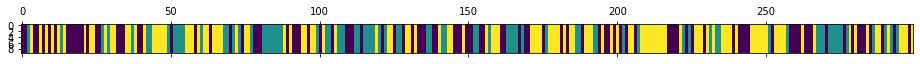

<Figure size 432x288 with 0 Axes>

656
N [[40. 24. 38.]
 [22. 34. 24.]
 [40. 22. 55.]]
alphas [[2.05728513 1.67241229 1.24499906]
 [0.35145575 3.37824167 1.24499906]
 [0.35145575 1.67241229 2.95082844]]
M [[9. 3. 3.]
 [2. 6. 7.]
 [1. 5. 9.]]
sum_w [[7.]
 [4.]
 [4.]]
barM [[2. 3. 3.]
 [2. 2. 7.]
 [1. 5. 5.]]
pi_z [[0.38486466 0.27009322 0.34504212]
 [0.25386603 0.37732192 0.36881205]
 [0.40462304 0.18716951 0.40820745]]
beta_vec [0.11201401 0.28595371 0.60203228]
hyper>> a_k: 4.201752423496608  gamma: 0.4079670874901351  rho: 0.27981350463415083


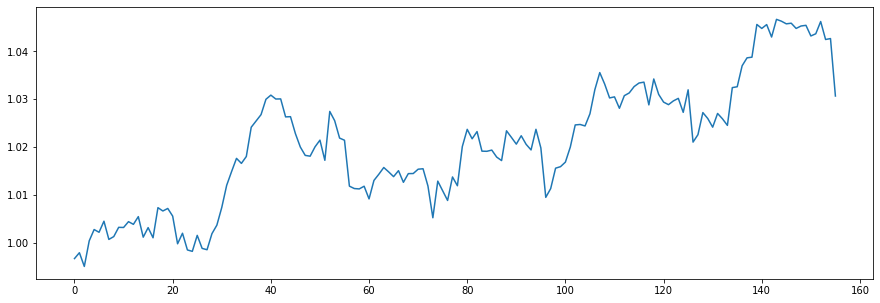

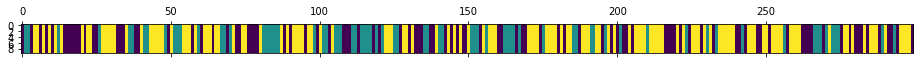

<Figure size 432x288 with 0 Axes>

N [[34. 25. 40.]
 [19. 32. 22.]
 [47. 16. 64.]]
alphas [[1.51466654 0.8653089  1.82177698]
 [0.33895947 2.04101598 1.82177698]
 [0.33895947 0.8653089  2.99748405]]
M [[ 8.  2.  7.]
 [ 2.  8.  6.]
 [ 2.  4. 13.]]
sum_w [[7.]
 [4.]
 [6.]]
barM [[1. 2. 7.]
 [2. 4. 6.]
 [2. 4. 7.]]
pi_z [[0.34689321 0.25817811 0.39492869]
 [0.23165897 0.45916138 0.30917966]
 [0.33136144 0.10408118 0.56455738]]
beta_vec [0.11114454 0.3179322  0.57092325]
hyper>> a_k: 5.518846044731034  gamma: 1.0892112542557408  rho: 0.32827295490993863


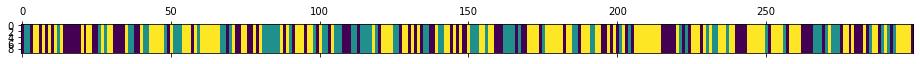

<Figure size 432x288 with 0 Axes>

657
N [[32. 23. 35.]
 [17. 33. 28.]
 [41. 22. 68.]]
alphas [[2.2237183  1.17862495 2.11650279]
 [0.41203041 2.99031285 2.11650279]
 [0.41203041 1.17862495 3.92819069]]
M [[ 5.  2.  7.]
 [ 2.  5.  9.]
 [ 3.  4. 11.]]
sum_w [[4.]
 [1.]
 [7.]]
barM [[1. 2. 7.]
 [2. 4. 9.]
 [3. 4. 4.]]
pi_z [[0.41920525 0.30092669 0.27986807]
 [0.25460842 0.31958683 0.42580475]
 [0.2387468  0.10704021 0.65421299]]
beta_vec [0.25835797 0.1963811  0.54526093]
hyper>> a_k: 3.374796063274242  gamma: 0.42028436716711554  rho: 0.2974451157904612


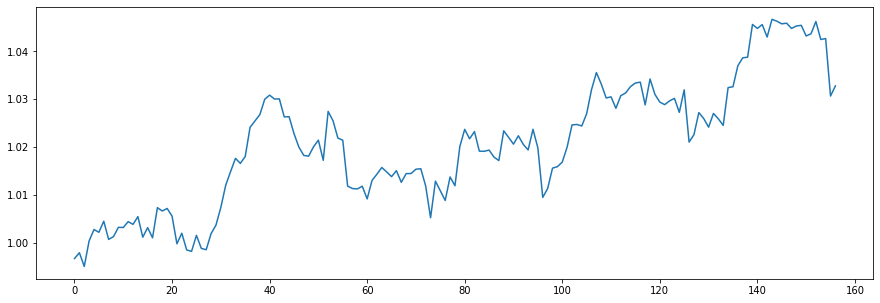

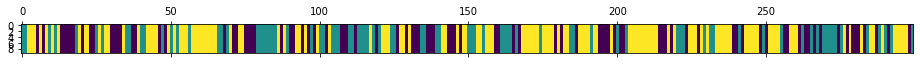

<Figure size 432x288 with 0 Axes>

N [[34. 24. 32.]
 [25. 34. 24.]
 [30. 26. 70.]]
alphas [[1.61637805 0.46561554 1.29280247]
 [0.61256144 1.46943215 1.29280247]
 [0.61256144 0.46561554 2.29661908]]
M [[ 5.  1.  3.]
 [ 2.  8.  4.]
 [ 2.  2. 12.]]
sum_w [[5.]
 [6.]
 [7.]]
barM [[0. 1. 3.]
 [2. 2. 4.]
 [2. 2. 5.]]
pi_z [[0.4501253  0.23814514 0.31172956]
 [0.28240163 0.44924334 0.26835503]
 [0.22036005 0.18973234 0.58990761]]
beta_vec [0.24535068 0.28485788 0.46979144]
hyper>> a_k: 3.3908641323617217  gamma: 0.669439704142877  rho: 0.532514459970606


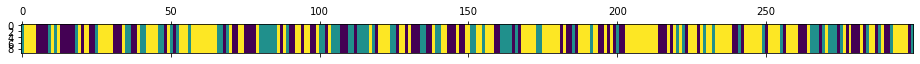

<Figure size 432x288 with 0 Axes>

658
N [[37. 21. 31.]
 [19. 28. 26.]
 [33. 24. 80.]]
alphas [[2.19460917 0.451551   0.74470397]
 [0.38892498 2.25723518 0.74470397]
 [0.38892498 0.451551   2.55038815]]
M [[8. 1. 5.]
 [2. 7. 5.]
 [3. 3. 7.]]
sum_w [[8.]
 [4.]
 [4.]]
barM [[0. 1. 5.]
 [2. 3. 5.]
 [3. 3. 3.]]
pi_z [[0.45199435 0.1765891  0.37141655]
 [0.25679479 0.39880811 0.3443971 ]
 [0.22880947 0.14298675 0.62820378]]
beta_vec [0.2068973  0.27493278 0.51816991]
hyper>> a_k: 3.9816312379772856  gamma: 0.30141260692603833  rho: 0.3431257125069531


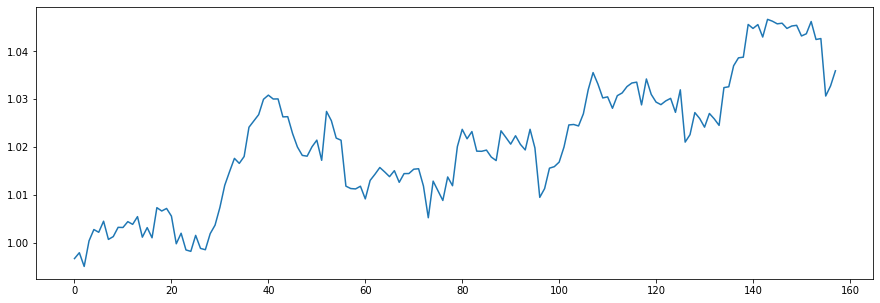

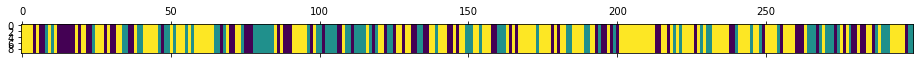

<Figure size 432x288 with 0 Axes>

N [[26. 18. 31.]
 [18. 33. 30.]
 [31. 30. 82.]]
alphas [[1.90732572 0.71906777 1.35523775]
 [0.54112566 2.08526783 1.35523775]
 [0.54112566 0.71906777 2.72143781]]
M [[5. 2. 5.]
 [1. 4. 4.]
 [3. 3. 9.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[1. 2. 5.]
 [1. 2. 4.]
 [3. 3. 3.]]
pi_z [[0.35342236 0.27795788 0.36861975]
 [0.28757134 0.370305   0.34212366]
 [0.19130854 0.19307183 0.61561964]]
beta_vec [0.27258497 0.31924453 0.40817049]
hyper>> a_k: 3.8817393647480327  gamma: 1.5419471322108589  rho: 0.4241945285992993


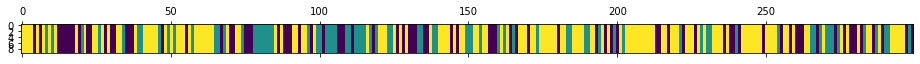

<Figure size 432x288 with 0 Axes>

659
N [[27. 18. 38.]
 [19. 28. 29.]
 [37. 30. 73.]]
alphas [[2.25587457 0.713552   0.91231279]
 [0.60926197 2.3601646  0.91231279]
 [0.60926197 0.713552   2.55892539]]
M [[ 8.  3.  4.]
 [ 3.  4.  3.]
 [ 2.  3. 10.]]
sum_w [[8.]
 [3.]
 [8.]]
barM [[0. 3. 4.]
 [3. 1. 3.]
 [2. 3. 2.]]
pi_z [[0.31847524 0.26925193 0.41227282]
 [0.25593022 0.38639907 0.35767071]
 [0.25230124 0.18867258 0.55902617]]
beta_vec [0.10845692 0.34237613 0.54916695]
hyper>> a_k: 2.589432584682989  gamma: 0.47688657731019446  rho: 0.4104801692112122


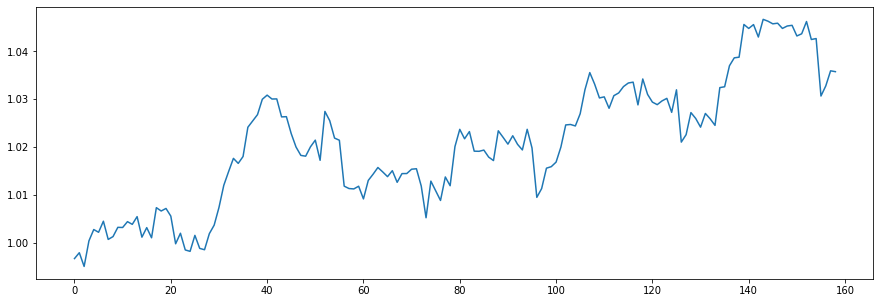

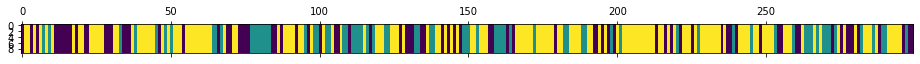

<Figure size 432x288 with 0 Axes>

N [[27. 18. 35.]
 [14. 28. 29.]
 [39. 25. 84.]]
alphas [[1.22847258 0.52264464 0.83831536]
 [0.16556186 1.58555537 0.83831536]
 [0.16556186 0.52264464 1.90122608]]
M [[5. 5. 6.]
 [1. 6. 3.]
 [2. 4. 6.]]
sum_w [[5.]
 [5.]
 [3.]]
barM [[0. 5. 6.]
 [1. 1. 3.]
 [2. 4. 3.]]
pi_z [[0.4112215  0.18806218 0.40071632]
 [0.12911084 0.54678307 0.32410609]
 [0.24660862 0.1673706  0.58602078]]
beta_vec [0.09491373 0.4607868  0.44429946]
hyper>> a_k: 2.524506280702842  gamma: 0.76374822749439  rho: 0.2579419186616034


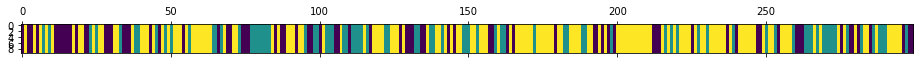

<Figure size 432x288 with 0 Axes>

660
N [[29. 17. 30.]
 [12. 31. 37.]
 [35. 32. 76.]]
alphas [[0.82898077 0.86320587 0.83231964]
 [0.17780477 1.51438187 0.83231964]
 [0.17780477 0.86320587 1.48349563]]
M [[4. 3. 3.]
 [1. 4. 2.]
 [1. 4. 6.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[1. 3. 3.]
 [1. 3. 2.]
 [1. 4. 3.]]
pi_z [[0.39264901 0.23625621 0.37109478]
 [0.12741834 0.34113943 0.53144223]
 [0.24048716 0.2371222  0.52239064]]
beta_vec [0.19376719 0.4174848  0.38874802]
hyper>> a_k: 2.5088029334735027  gamma: 0.902262261749125  rho: 0.20264898507566706


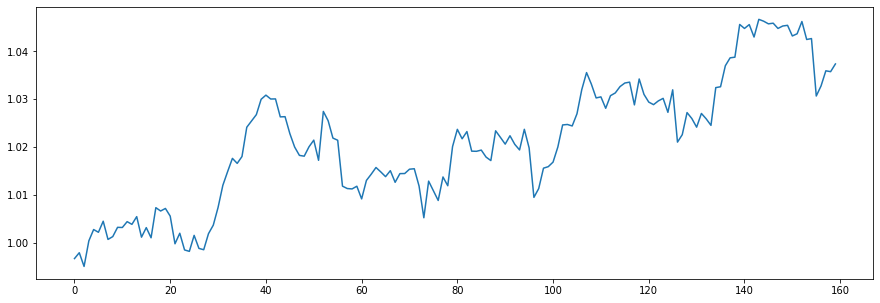

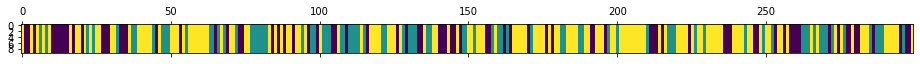

<Figure size 432x288 with 0 Axes>

N [[29. 19. 31.]
 [13. 32. 36.]
 [36. 30. 73.]]
alphas [[0.89601758 0.83513515 0.7776502 ]
 [0.38761122 1.34354152 0.7776502 ]
 [0.38761122 0.83513515 1.28605657]]
M [[4. 3. 7.]
 [2. 4. 6.]
 [2. 3. 7.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[1. 3. 7.]
 [2. 3. 6.]
 [2. 3. 5.]]
pi_z [[0.32009359 0.29743347 0.38247294]
 [0.13971123 0.52496718 0.33532159]
 [0.25545112 0.22672488 0.517824  ]]
beta_vec [0.19346603 0.27665683 0.52987714]
hyper>> a_k: 4.136737985623951  gamma: 0.3571324684193372  rho: 0.24820134929366494


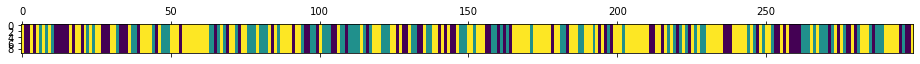

<Figure size 432x288 with 0 Axes>

661
N [[24. 26. 25.]
 [14. 31. 42.]
 [37. 30. 70.]]
alphas [[1.62842215 0.8604011  1.64791474]
 [0.6016782  1.88714505 1.64791474]
 [0.6016782  0.8604011  2.67465869]]
M [[4. 3. 6.]
 [1. 7. 5.]
 [4. 3. 7.]]
sum_w [[3.]
 [5.]
 [1.]]
barM [[1. 3. 6.]
 [1. 2. 5.]
 [4. 3. 6.]]
pi_z [[0.26226342 0.28861573 0.44912085]
 [0.18621137 0.38864909 0.42513954]
 [0.29879604 0.25481206 0.4463919 ]]
beta_vec [0.10432597 0.24771935 0.64795467]
hyper>> a_k: 2.638623427838613  gamma: 0.5865069742906097  rho: 0.24964314722254433


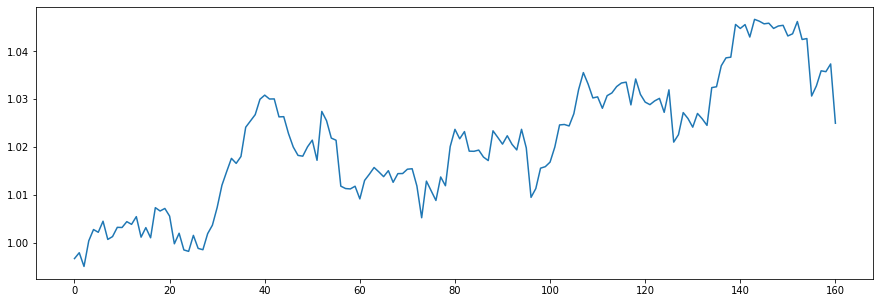

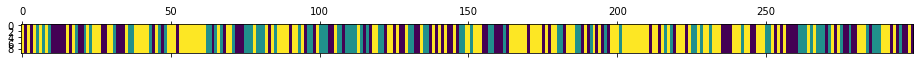

<Figure size 432x288 with 0 Axes>

N [[27. 27. 32.]
 [17. 28. 36.]
 [43. 26. 63.]]
alphas [[0.86527021 0.49046182 1.2828914 ]
 [0.20655595 1.14917607 1.2828914 ]
 [0.20655595 0.49046182 1.94160566]]
M [[ 5.  3.  5.]
 [ 1.  3.  4.]
 [ 1.  2. 11.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[1. 3. 5.]
 [1. 0. 4.]
 [1. 2. 7.]]
pi_z [[0.24676712 0.32775267 0.42548021]
 [0.16568318 0.4130947  0.42122213]
 [0.37636022 0.18172375 0.44191603]]
beta_vec [0.14752475 0.33922239 0.51325287]
hyper>> a_k: 2.9670658596867416  gamma: 0.27410626266794885  rho: 0.2839502524940248


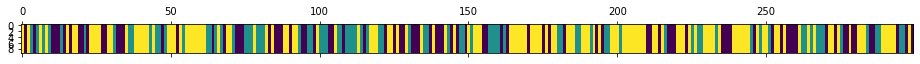

<Figure size 432x288 with 0 Axes>

662
N [[31. 29. 27.]
 [15. 29. 37.]
 [41. 23. 67.]]
alphas [[1.15592527 0.72070061 1.09043998]
 [0.31342617 1.56319971 1.09043998]
 [0.31342617 0.72070061 1.93293908]]
M [[3. 3. 5.]
 [4. 5. 3.]
 [5. 5. 8.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[1. 3. 5.]
 [4. 5. 3.]
 [5. 5. 6.]]
pi_z [[0.2935068  0.3679972  0.338496  ]
 [0.15623321 0.40470236 0.43906443]
 [0.34171188 0.21294602 0.4453421 ]]
beta_vec [0.20288248 0.53799113 0.25912639]
hyper>> a_k: 4.969390067946616  gamma: 0.9300107197085524  rho: 0.11193281916243221


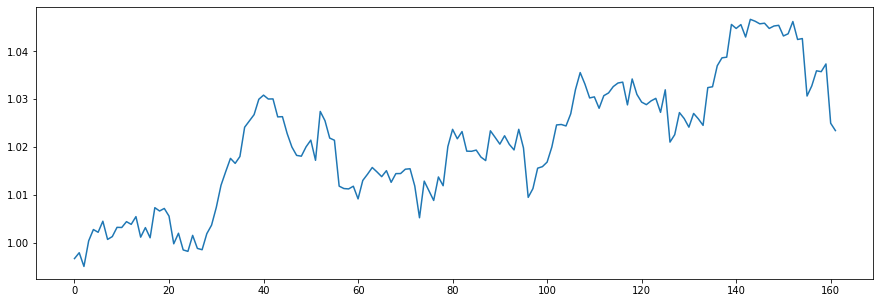

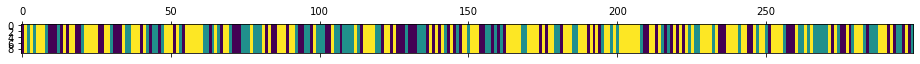

<Figure size 432x288 with 0 Axes>

N [[23. 32. 29.]
 [19. 30. 37.]
 [41. 25. 63.]]
alphas [[1.45158909 2.37423677 1.14356421]
 [0.89535125 2.93047461 1.14356421]
 [0.89535125 2.37423677 1.69980205]]
M [[ 4.  8.  9.]
 [ 3. 10.  3.]
 [ 6.  6.  2.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[3. 8. 9.]
 [3. 8. 3.]
 [6. 6. 1.]]
pi_z [[0.29238161 0.46129942 0.24631897]
 [0.15593993 0.48589332 0.35816675]
 [0.27893126 0.20228995 0.51877879]]
beta_vec [0.3117443  0.45609348 0.23216222]
hyper>> a_k: 5.278320096587714  gamma: 0.4575526784476082  rho: 0.05258716313769266


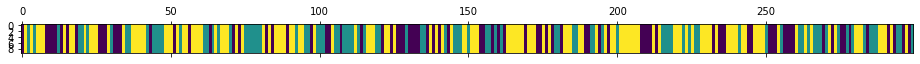

<Figure size 432x288 with 0 Axes>

663
N [[28. 24. 31.]
 [20. 36. 34.]
 [35. 30. 61.]]
alphas [[1.83652662 2.28080866 1.16098482]
 [1.55895474 2.55838054 1.16098482]
 [1.55895474 2.28080866 1.4385567 ]]
M [[ 6.  6.  6.]
 [ 6.  6.  4.]
 [ 5. 10.  7.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[ 6.  6.  6.]
 [ 6.  6.  4.]
 [ 5. 10.  6.]]
pi_z [[0.40016657 0.24366094 0.35617249]
 [0.26320871 0.36404907 0.37274222]
 [0.29520021 0.2670736  0.43772619]]
beta_vec [0.34524005 0.51337721 0.14138274]
hyper>> a_k: 4.708857329312427  gamma: 1.3823872591216169  rho: 0.05163642175344692


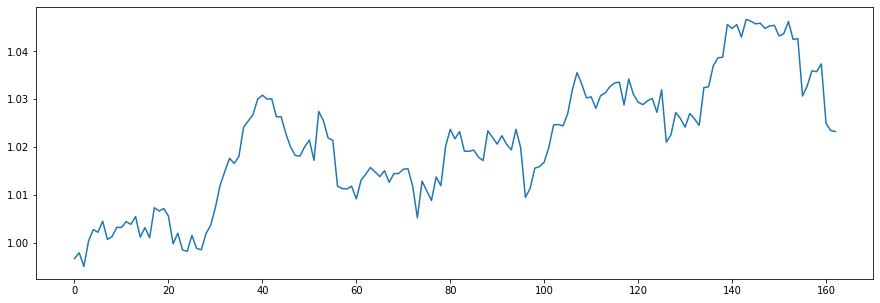

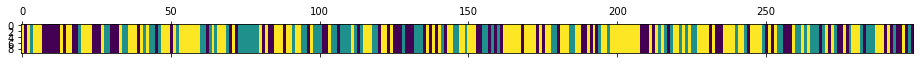

<Figure size 432x288 with 0 Axes>

N [[26. 24. 32.]
 [18. 31. 35.]
 [39. 28. 66.]]
alphas [[1.78489006 2.29259312 0.63137415]
 [1.54174151 2.53574167 0.63137415]
 [1.54174151 2.29259312 0.87452269]]
M [[11.  6.  6.]
 [ 5.  5.  3.]
 [ 4. 10.  6.]]
sum_w [[0.]
 [1.]
 [4.]]
barM [[11.  6.  6.]
 [ 5.  4.  3.]
 [ 4. 10.  2.]]
pi_z [[0.33100356 0.37235282 0.29664362]
 [0.16505244 0.39156111 0.44338645]
 [0.3125302  0.19055775 0.49691206]]
beta_vec [0.3851272  0.41120628 0.20366651]
hyper>> a_k: 6.029759889406739  gamma: 0.1180889265842549  rho: 0.12759351383404802


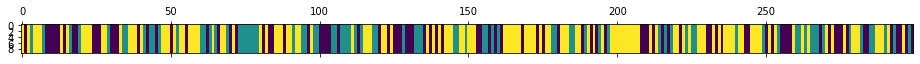

<Figure size 432x288 with 0 Axes>

664
N [[30. 27. 35.]
 [23. 27. 30.]
 [39. 26. 62.]]
alphas [[2.79528202 2.1631102  1.07136767]
 [2.02592376 2.93246846 1.07136767]
 [2.02592376 2.1631102  1.84072592]]
M [[8. 6. 2.]
 [4. 9. 3.]
 [4. 5. 6.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[6. 6. 2.]
 [4. 7. 3.]
 [4. 5. 3.]]
pi_z [[0.21636254 0.41637161 0.36726586]
 [0.28645688 0.29982321 0.41371991]
 [0.23005406 0.22588988 0.54405606]]
beta_vec [0.32067328 0.36075331 0.31857342]
hyper>> a_k: 4.543696233725097  gamma: 1.677014482894983  rho: 0.1561438208476048


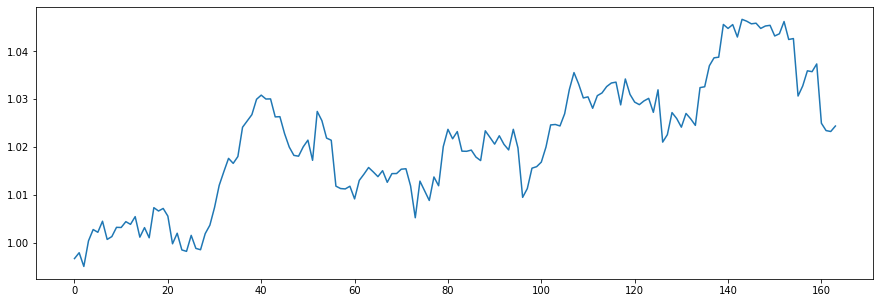

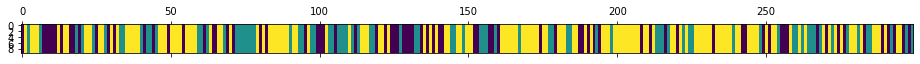

<Figure size 432x288 with 0 Axes>

N [[20. 26. 32.]
 [19. 29. 31.]
 [38. 25. 79.]]
alphas [[1.93900395 1.38320976 1.22148252]
 [1.22953386 2.09267985 1.22148252]
 [1.22953386 1.38320976 1.93095261]]
M [[1. 6. 2.]
 [4. 6. 3.]
 [4. 6. 8.]]
sum_w [[1.]
 [2.]
 [5.]]
barM [[0. 6. 2.]
 [4. 4. 3.]
 [4. 6. 3.]]
pi_z [[0.25491726 0.27567105 0.4694117 ]
 [0.17988393 0.3845426  0.43557347]
 [0.29417602 0.13910491 0.56671907]]
beta_vec [0.40173642 0.33336965 0.26489393]
hyper>> a_k: 3.3731891355608266  gamma: 0.10174970906202402  rho: 0.4262083242598305


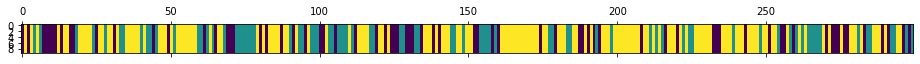

<Figure size 432x288 with 0 Axes>

665
N [[20. 22. 29.]
 [15. 32. 34.]
 [36. 27. 84.]]
alphas [[2.21524527 0.64523958 0.51270428]
 [0.77756398 2.08292087 0.51270428]
 [0.77756398 0.64523958 1.95038557]]
M [[ 9.  2.  2.]
 [ 1.  5.  1.]
 [ 2.  4. 12.]]
sum_w [[ 5.]
 [ 1.]
 [12.]]
barM [[4. 2. 2.]
 [1. 4. 1.]
 [2. 4. 0.]]
pi_z [[0.25175105 0.25254192 0.49570703]
 [0.13127923 0.35581523 0.51290554]
 [0.28392123 0.1592726  0.55680617]]
beta_vec [0.27346242 0.41904861 0.30748897]
hyper>> a_k: 2.7263414283842087  gamma: 0.43392363625826  rho: 0.5303036493248895


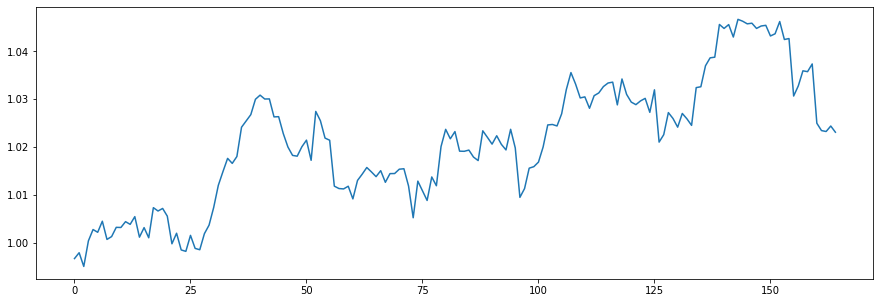

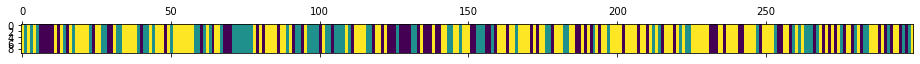

<Figure size 432x288 with 0 Axes>

N [[22. 25. 34.]
 [17. 29. 34.]
 [42. 25. 71.]]
alphas [[1.79597183 0.5366138  0.3937558 ]
 [0.35018302 1.98240261 0.3937558 ]
 [0.35018302 0.5366138  1.83954461]]
M [[6. 3. 2.]
 [2. 3. 1.]
 [2. 5. 8.]]
sum_w [[5.]
 [1.]
 [5.]]
barM [[1. 3. 2.]
 [2. 2. 1.]
 [2. 5. 3.]]
pi_z [[0.26423812 0.36603091 0.36973096]
 [0.16338703 0.41140985 0.42520312]
 [0.29605486 0.18259958 0.52134556]]
beta_vec [0.26178415 0.59785338 0.14036247]
hyper>> a_k: 3.1659527848745355  gamma: 1.6409577407427938  rho: 0.300235030468828


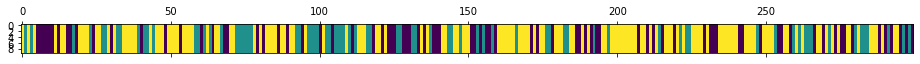

<Figure size 432x288 with 0 Axes>

666
N [[22. 26. 34.]
 [16. 28. 32.]
 [43. 22. 76.]]
alphas [[1.53049252 1.32449805 0.31096222]
 [0.57996259 2.27502798 0.31096222]
 [0.57996259 1.32449805 1.26149215]]
M [[2. 6. 4.]
 [4. 8. 2.]
 [4. 2. 5.]]
sum_w [[1.]
 [4.]
 [4.]]
barM [[1. 6. 4.]
 [4. 4. 2.]
 [4. 2. 1.]]
pi_z [[0.26416225 0.26307674 0.47276101]
 [0.28401388 0.32484365 0.39114247]
 [0.2955133  0.19982594 0.50466076]]
beta_vec [0.32821587 0.52407685 0.14770728]
hyper>> a_k: 2.5645272701952218  gamma: 0.9118974966831682  rho: 0.36422681442958166


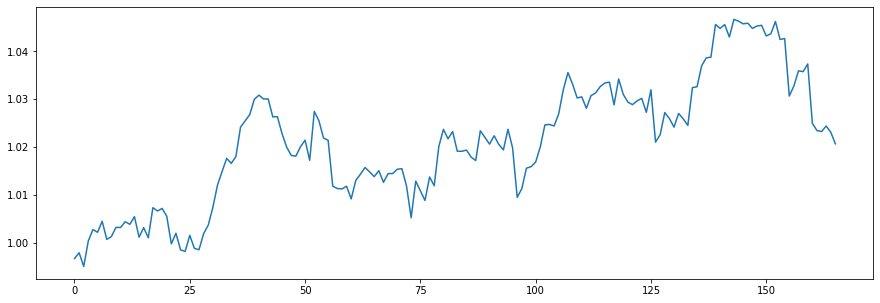

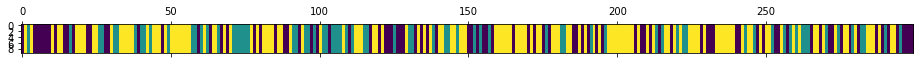

<Figure size 432x288 with 0 Axes>

N [[25. 28. 38.]
 [19. 23. 31.]
 [47. 22. 66.]]
alphas [[1.46921168 0.85448512 0.24083047]
 [0.53514208 1.78855472 0.24083047]
 [0.53514208 0.85448512 1.17490007]]
M [[4. 2. 1.]
 [1. 6. 2.]
 [3. 3. 6.]]
sum_w [[4.]
 [5.]
 [5.]]
barM [[0. 2. 1.]
 [1. 1. 2.]
 [3. 3. 1.]]
pi_z [[0.31501355 0.30448156 0.38050489]
 [0.24157762 0.38670883 0.37171355]
 [0.32440148 0.15027792 0.52532061]]
beta_vec [0.3818708  0.47254632 0.14558288]
hyper>> a_k: 1.527984813850266  gamma: 1.246684910646019  rho: 0.4185104773912722


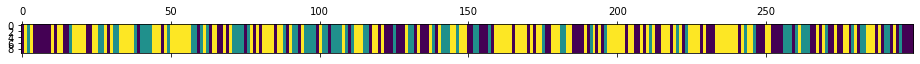

<Figure size 432x288 with 0 Axes>

667
N [[36. 22. 39.]
 [18. 29. 26.]
 [43. 22. 64.]]
alphas [[0.97877259 0.41986079 0.12935143]
 [0.33929494 1.05933845 0.12935143]
 [0.33929494 0.41986079 0.76882908]]
M [[2. 1. 3.]
 [4. 5. 1.]
 [3. 4. 8.]]
sum_w [[0.]
 [2.]
 [5.]]
barM [[2. 1. 3.]
 [4. 3. 1.]
 [3. 4. 3.]]
pi_z [[0.37624887 0.21357058 0.41018056]
 [0.21701262 0.38923786 0.39374953]
 [0.35394654 0.17206194 0.47399153]]
beta_vec [0.36868607 0.23998709 0.39132684]
hyper>> a_k: 2.095943041314583  gamma: 0.5534328330108855  rho: 0.25028634150586376


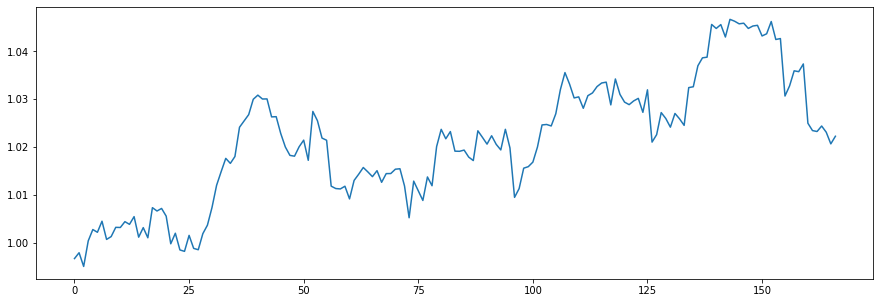

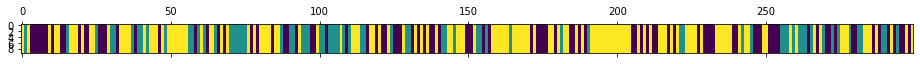

<Figure size 432x288 with 0 Axes>

N [[35. 23. 38.]
 [16. 26. 28.]
 [44. 21. 68.]]
alphas [[1.1039234  0.37710543 0.61491422]
 [0.57933748 0.90169134 0.61491422]
 [0.57933748 0.37710543 1.13950013]]
M [[3. 4. 2.]
 [6. 3. 3.]
 [3. 3. 5.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[2. 4. 2.]
 [6. 0. 3.]
 [3. 3. 2.]]
pi_z [[0.35536755 0.22728829 0.41734416]
 [0.2367413  0.31115865 0.45210005]
 [0.32866226 0.18474178 0.48659596]]
beta_vec [0.2810954  0.42715068 0.29175392]
hyper>> a_k: 3.335240363085962  gamma: 0.9929861698585155  rho: 0.27672070483871214


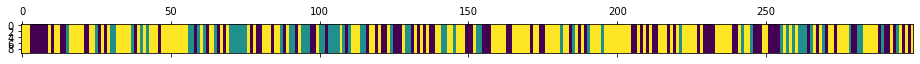

<Figure size 432x288 with 0 Axes>

668
N [[32. 19. 38.]
 [11. 21. 30.]
 [46. 22. 80.]]
alphas [[1.60101939 1.03042    0.70380098]
 [0.67808932 1.95335006 0.70380098]
 [0.67808932 1.03042    1.62673104]]
M [[ 1.  3.  2.]
 [ 2. 10.  2.]
 [ 3.  1.  6.]]
sum_w [[0.]
 [4.]
 [2.]]
barM [[1. 3. 2.]
 [2. 6. 2.]
 [3. 1. 4.]]
pi_z [[0.30936246 0.22302068 0.46761686]
 [0.12386033 0.32634168 0.54979799]
 [0.36771925 0.15013822 0.48214253]]
beta_vec [0.15833566 0.4775136  0.36415074]
hyper>> a_k: 2.5147370197582273  gamma: 0.4477377556620254  rho: 0.26034855573268967


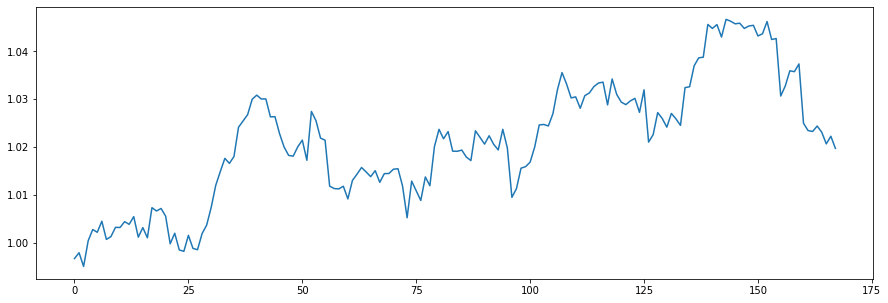

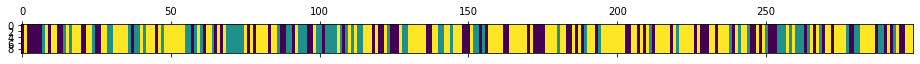

<Figure size 432x288 with 0 Axes>

N [[28. 21. 34.]
 [15. 25. 32.]
 [40. 26. 78.]]
alphas [[0.94921705 0.88818908 0.67733089]
 [0.29450889 1.54289723 0.67733089]
 [0.29450889 0.88818908 1.33203904]]
M [[5. 2. 3.]
 [2. 3. 3.]
 [2. 2. 3.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[3. 2. 3.]
 [2. 1. 3.]
 [2. 2. 0.]]
pi_z [[0.35167108 0.25530395 0.39302496]
 [0.21014268 0.32014289 0.46971443]
 [0.29544193 0.16702401 0.53753406]]
beta_vec [0.45214607 0.21737598 0.33047795]
hyper>> a_k: 1.9559101763251594  gamma: 0.30399633510800633  rho: 0.3129716320900755


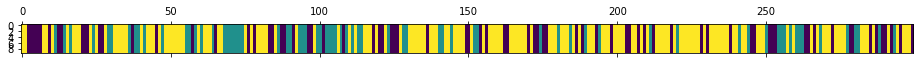

<Figure size 432x288 with 0 Axes>

669
N [[25. 18. 34.]
 [13. 25. 33.]
 [38. 28. 85.]]
alphas [[1.21972282 0.2921024  0.44408496]
 [0.60757842 0.9042468  0.44408496]
 [0.60757842 0.2921024  1.05622936]]
M [[2. 1. 2.]
 [2. 3. 5.]
 [5. 2. 3.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[0. 1. 2.]
 [2. 0. 5.]
 [5. 2. 2.]]
pi_z [[0.31808802 0.25211472 0.42979726]
 [0.19657482 0.39696822 0.40645697]
 [0.23734481 0.18831367 0.57434152]]
beta_vec [0.26028929 0.16186485 0.57784585]
hyper>> a_k: 2.201047025264019  gamma: 1.7919933948178672  rho: 0.30689725122007083


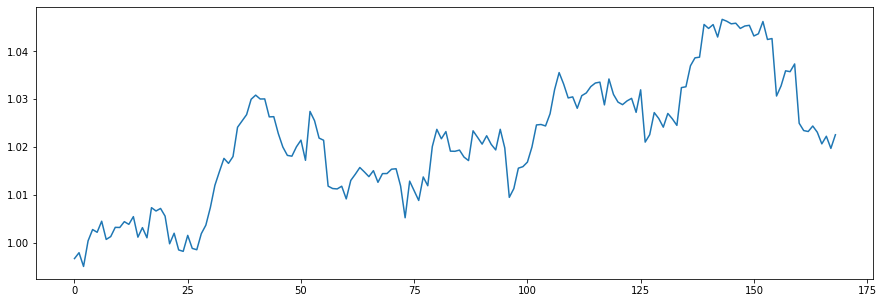

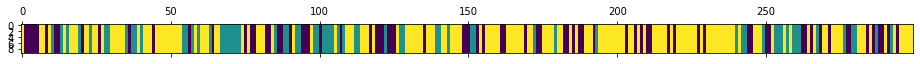

<Figure size 432x288 with 0 Axes>

N [[26. 19. 32.]
 [12. 25. 29.]
 [39. 22. 95.]]
alphas [[1.07258007 0.24693321 0.88153375]
 [0.39708479 0.92242849 0.88153375]
 [0.39708479 0.24693321 1.55702903]]
M [[5. 2. 5.]
 [2. 6. 1.]
 [2. 2. 8.]]
sum_w [[4.]
 [4.]
 [5.]]
barM [[1. 2. 5.]
 [2. 2. 1.]
 [2. 2. 3.]]
pi_z [[0.37324587 0.28788126 0.33887287]
 [0.19192868 0.38833901 0.41973232]
 [0.28198953 0.15400047 0.56401   ]]
beta_vec [0.12346457 0.24506972 0.63146571]
hyper>> a_k: 2.0334336455874085  gamma: 2.053316872639543  rho: 0.3632367509064855


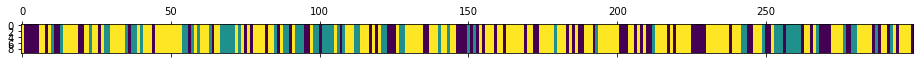

<Figure size 432x288 with 0 Axes>

670
N [[29. 19. 33.]
 [13. 25. 26.]
 [39. 20. 95.]]
alphas [[0.89848171 0.31732015 0.81763178]
 [0.15986388 1.05593798 0.81763178]
 [0.15986388 0.31732015 1.55624961]]
M [[6. 2. 5.]
 [1. 2. 2.]
 [3. 3. 7.]]
sum_w [[6.]
 [1.]
 [6.]]
barM [[0. 2. 5.]
 [1. 1. 2.]
 [3. 3. 1.]]
pi_z [[0.38543317 0.20161229 0.41295454]
 [0.19163224 0.41304372 0.39532404]
 [0.15960431 0.16528563 0.67511006]]
beta_vec [0.39931375 0.2185964  0.38208985]
hyper>> a_k: 2.330659231330094  gamma: 0.3743083300859375  rho: 0.339380962214618


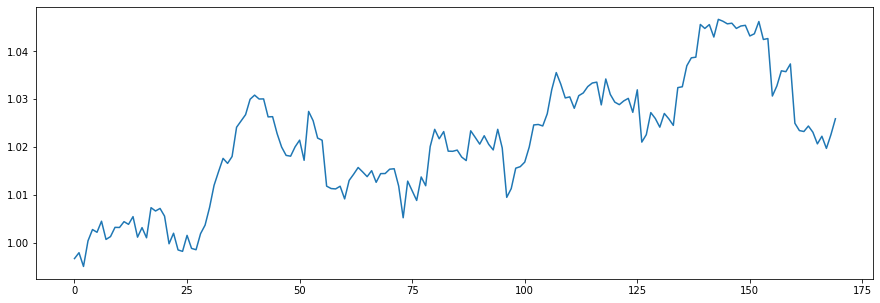

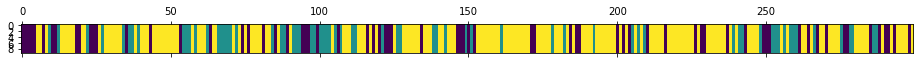

<Figure size 432x288 with 0 Axes>

N [[ 21.  19.  29.]
 [ 13.  24.  30.]
 [ 34.  24. 105.]]
alphas [[1.40579591 0.33656804 0.58829528]
 [0.61481454 1.12754942 0.58829528]
 [0.61481454 0.33656804 1.37927665]]
M [[3. 1. 2.]
 [3. 2. 3.]
 [5. 2. 8.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[1. 1. 2.]
 [3. 1. 3.]
 [5. 2. 4.]]
pi_z [[0.31726813 0.33435418 0.34837769]
 [0.14323578 0.42176867 0.43499554]
 [0.20076867 0.14584077 0.65339056]]
beta_vec [0.41055064 0.16125224 0.42819711]
hyper>> a_k: 2.7400463402092923  gamma: 0.8684936174111149  rho: 0.22720089004359367


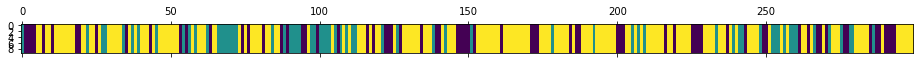

<Figure size 432x288 with 0 Axes>

671
N [[ 27.  17.  28.]
 [ 10.  21.  32.]
 [ 35.  25. 104.]]
alphas [[1.49188416 0.34145249 0.90670969]
 [0.86934319 0.96399346 0.90670969]
 [0.86934319 0.34145249 1.52925065]]
M [[3. 1. 4.]
 [3. 7. 2.]
 [4. 2. 8.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[1. 1. 4.]
 [3. 4. 2.]
 [4. 2. 4.]]
pi_z [[0.35050959 0.23637782 0.41311259]
 [0.14736408 0.30393671 0.54869921]
 [0.27975676 0.14756123 0.57268201]]
beta_vec [0.35677212 0.36045053 0.28277736]
hyper>> a_k: 2.2336561722119908  gamma: 0.48925744611357697  rho: 0.45368628325679294


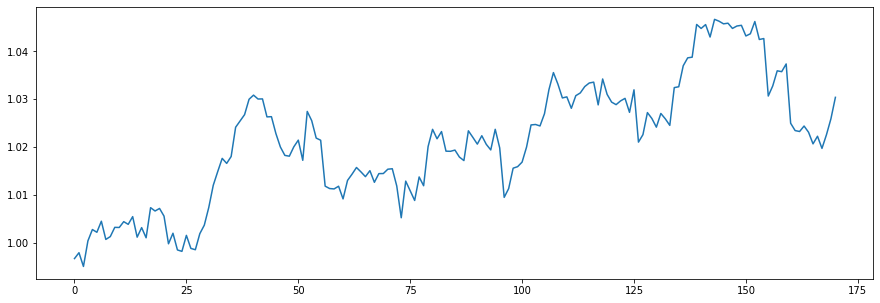

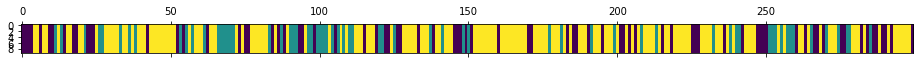

<Figure size 432x288 with 0 Axes>

N [[26. 19. 32.]
 [14. 20. 30.]
 [38. 25. 95.]]
alphas [[1.44873998 0.43984949 0.34506671]
 [0.43536081 1.45322866 0.34506671]
 [0.43536081 0.43984949 1.35844587]]
M [[3. 3. 1.]
 [1. 5. 2.]
 [1. 2. 7.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[1. 3. 1.]
 [1. 2. 2.]
 [1. 2. 2.]]
pi_z [[0.27321884 0.35691991 0.36986125]
 [0.22792553 0.32005062 0.45202385]
 [0.25700878 0.1920169  0.55097432]]
beta_vec [0.17325984 0.37778962 0.44895054]
hyper>> a_k: 1.6142728152846  gamma: 0.3680502668067491  rho: 0.2578585935837231


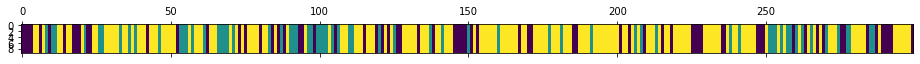

<Figure size 432x288 with 0 Axes>

672
N [[ 24.  17.  30.]
 [ 11.  19.  34.]
 [ 36.  28. 100.]]
alphas [[0.62382265 0.45259902 0.53785114]
 [0.20756853 0.86885314 0.53785114]
 [0.20756853 0.45259902 0.95410526]]
M [[4. 4. 2.]
 [1. 3. 1.]
 [2. 5. 5.]]
sum_w [[3.]
 [1.]
 [0.]]
barM [[1. 4. 2.]
 [1. 2. 1.]
 [2. 5. 5.]]
pi_z [[0.35041853 0.23509445 0.41448701]
 [0.11192901 0.38929707 0.49877392]
 [0.20665057 0.1569744  0.63637503]]
beta_vec [0.22628974 0.42172512 0.35198514]
hyper>> a_k: 2.893235841733436  gamma: 0.5822027365928586  rho: 0.2330880146155201


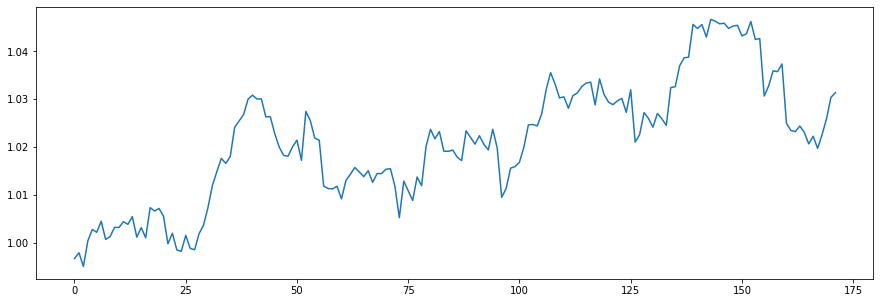

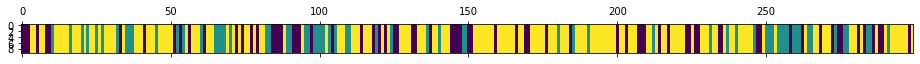

<Figure size 432x288 with 0 Axes>

N [[23. 16. 34.]
 [12. 23. 30.]
 [37. 26. 98.]]
alphas [[1.17648323 0.93574785 0.78100477]
 [0.50210463 1.61012644 0.78100477]
 [0.50210463 0.93574785 1.45538337]]
M [[4. 3. 4.]
 [1. 7. 2.]
 [3. 3. 7.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[1. 3. 4.]
 [1. 4. 2.]
 [3. 3. 4.]]
pi_z [[0.27926716 0.17524395 0.54548889]
 [0.15343956 0.40346487 0.44309557]
 [0.24579457 0.16145618 0.59274925]]
beta_vec [0.1846304  0.47291771 0.34245189]
hyper>> a_k: 2.848757145896193  gamma: 0.46990883159947416  rho: 0.40387818991049096


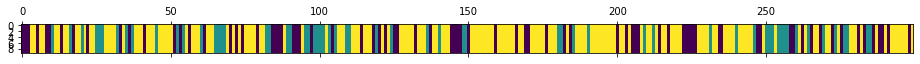

<Figure size 432x288 with 0 Axes>

673
N [[22. 18. 38.]
 [14. 21. 26.]
 [42. 22. 96.]]
alphas [[1.46409139 0.80311182 0.58155394]
 [0.31354051 1.9536627  0.58155394]
 [0.31354051 0.80311182 1.73210482]]
M [[3. 4. 3.]
 [3. 8. 1.]
 [4. 2. 4.]]
sum_w [[3.]
 [6.]
 [3.]]
barM [[0. 4. 3.]
 [3. 2. 1.]
 [4. 2. 1.]]
pi_z [[0.30771226 0.26570574 0.426582  ]
 [0.25037499 0.35623888 0.39338613]
 [0.25585077 0.15954776 0.58460147]]
beta_vec [0.2831127  0.50358659 0.21330071]
hyper>> a_k: 2.422909421326364  gamma: 0.46469291127812784  rho: 0.4248217557730364


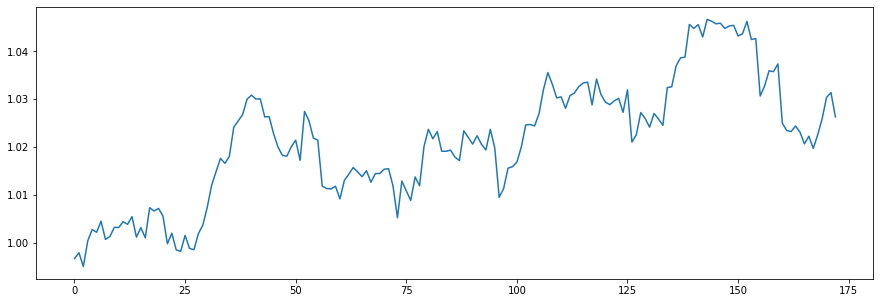

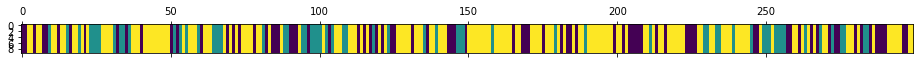

<Figure size 432x288 with 0 Axes>

N [[26. 17. 38.]
 [13. 24. 26.]
 [42. 22. 91.]]
alphas [[1.42385185 0.70180068 0.29725689]
 [0.39454722 1.73110532 0.29725689]
 [0.39454722 0.70180068 1.32656152]]
M [[4. 2. 3.]
 [3. 1. 1.]
 [4. 2. 4.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[3. 2. 3.]
 [3. 1. 1.]
 [4. 2. 0.]]
pi_z [[0.33295848 0.28819035 0.37885117]
 [0.15154533 0.53626914 0.31218553]
 [0.26398523 0.16622862 0.56978615]]
beta_vec [0.48540677 0.44766874 0.06692448]
hyper>> a_k: 1.8720363595214826  gamma: 0.9700124094915515  rho: 0.3608705357411397


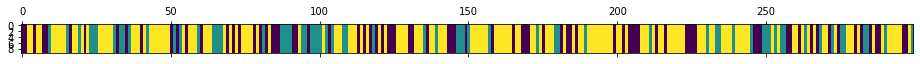

<Figure size 432x288 with 0 Axes>

674
N [[23. 17. 40.]
 [17. 23. 26.]
 [40. 25. 88.]]
alphas [[1.25633915 0.53562383 0.08007338]
 [0.58077639 1.2111866  0.08007338]
 [0.58077639 0.53562383 0.75563614]]
M [[2. 3. 1.]
 [1. 5. 2.]
 [3. 6. 3.]]
sum_w [[0.]
 [4.]
 [2.]]
barM [[2. 3. 1.]
 [1. 1. 2.]
 [3. 6. 1.]]
pi_z [[0.20792702 0.1917838  0.60028919]
 [0.29470561 0.33581621 0.36947818]
 [0.26538443 0.17423413 0.56038144]]
beta_vec [0.30472415 0.57242921 0.12284665]
hyper>> a_k: 1.3754731403235874  gamma: 0.21626362801134627  rho: 0.20982918354085023


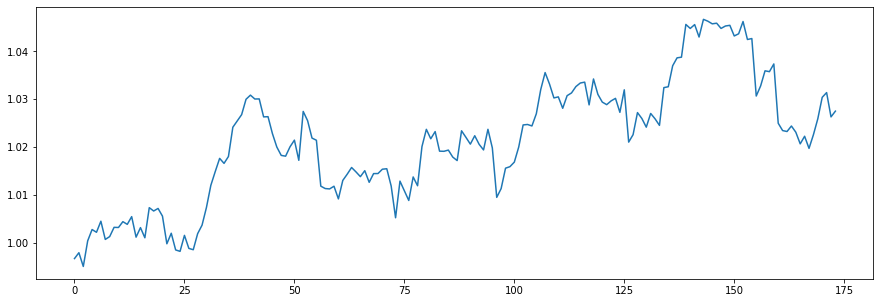

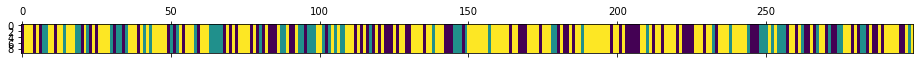

<Figure size 432x288 with 0 Axes>

N [[24. 19. 44.]
 [16. 21. 25.]
 [47. 21. 82.]]
alphas [[0.61980651 0.62214969 0.13351695]
 [0.3311921  0.91076409 0.13351695]
 [0.3311921  0.62214969 0.42213136]]
M [[5. 3. 1.]
 [1. 3. 1.]
 [4. 5. 1.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[4. 3. 1.]
 [1. 1. 1.]
 [4. 5. 0.]]
pi_z [[0.3282663  0.20779417 0.46393953]
 [0.34066212 0.32426292 0.33507496]
 [0.27707317 0.14266669 0.58026014]]
beta_vec [0.54074253 0.36326453 0.09599294]
hyper>> a_k: 1.7944433889757803  gamma: 0.5560571815900167  rho: 0.1639577469047951


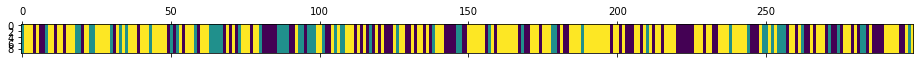

<Figure size 432x288 with 0 Axes>

675
N [[32. 19. 41.]
 [14. 19. 24.]
 [46. 19. 85.]]
alphas [[1.10545133 0.54498052 0.14401154]
 [0.81123843 0.83919342 0.14401154]
 [0.81123843 0.54498052 0.43822443]]
M [[4. 3. 3.]
 [2. 3. 1.]
 [4. 4. 1.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[3. 3. 3.]
 [2. 1. 1.]
 [4. 4. 1.]]
pi_z [[0.41096836 0.28506996 0.30396167]
 [0.1810955  0.33570207 0.48320243]
 [0.26313131 0.18416455 0.55270415]]
beta_vec [0.42265049 0.33844091 0.2389086 ]
hyper>> a_k: 1.9639377702438046  gamma: 1.290463697901702  rho: 0.2508069375813802


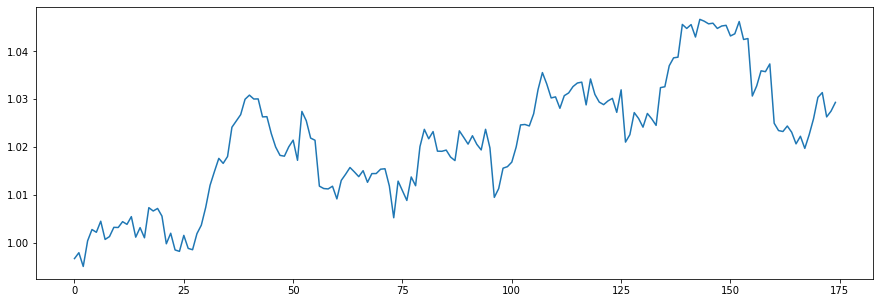

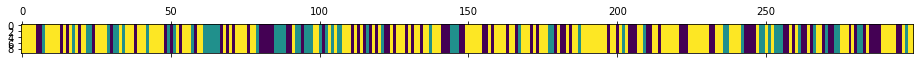

<Figure size 432x288 with 0 Axes>

N [[28. 19. 40.]
 [14. 23. 25.]
 [45. 20. 85.]]
alphas [[1.11444386 0.49797131 0.3515226 ]
 [0.62187465 0.99054053 0.3515226 ]
 [0.62187465 0.49797131 0.84409182]]
M [[8. 2. 2.]
 [4. 2. 2.]
 [4. 2. 5.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[6. 2. 2.]
 [4. 0. 2.]
 [4. 2. 3.]]
pi_z [[0.4072732  0.18392195 0.40880485]
 [0.19470754 0.4034774  0.40181506]
 [0.2547226  0.13060993 0.61466747]]
beta_vec [0.58090413 0.07544402 0.34365184]
hyper>> a_k: 2.2905730362449783  gamma: 0.6068271572628895  rho: 0.2948481746084373


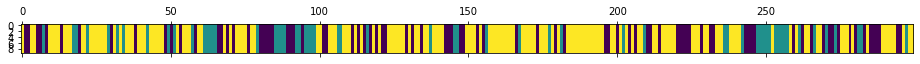

<Figure size 432x288 with 0 Axes>

676
N [[29. 18. 39.]
 [15. 24. 20.]
 [42. 17. 95.]]
alphas [[1.61364866 0.12185731 0.55506706]
 [0.93827738 0.79722859 0.55506706]
 [0.93827738 0.12185731 1.23043834]]
M [[8. 2. 3.]
 [4. 3. 1.]
 [3. 2. 7.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[6. 2. 3.]
 [4. 0. 1.]
 [3. 2. 2.]]
pi_z [[0.36300895 0.1437481  0.49324294]
 [0.24098673 0.42352575 0.33548752]
 [0.27583465 0.0848864  0.63927895]]
beta_vec [0.57807901 0.22941594 0.19250504]
hyper>> a_k: 3.675465646790435  gamma: 0.9538834646077671  rho: 0.20496700545241311


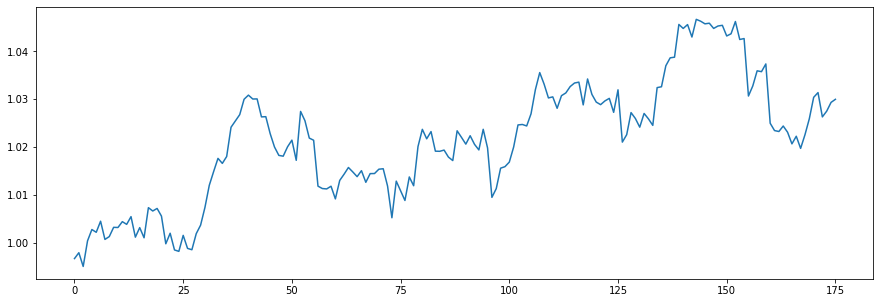

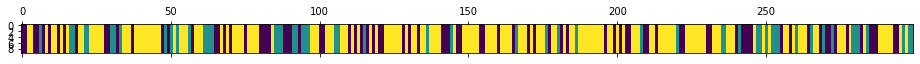

<Figure size 432x288 with 0 Axes>

N [[26. 20. 40.]
 [14. 18. 22.]
 [46. 16. 97.]]
alphas [[2.44256339 0.6703801  0.56252216]
 [1.6892142  1.42372929 0.56252216]
 [1.6892142  0.6703801  1.31587134]]
M [[8. 3. 2.]
 [3. 4. 4.]
 [6. 7. 5.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[7. 3. 2.]
 [3. 2. 4.]
 [6. 7. 1.]]
pi_z [[0.28794156 0.27617302 0.43588541]
 [0.24530312 0.38592778 0.3687691 ]
 [0.27300675 0.09314644 0.63384681]]
beta_vec [0.27367168 0.37711752 0.3492108 ]
hyper>> a_k: 3.491207232084613  gamma: 0.5136278534701265  rho: 0.22534736184533688


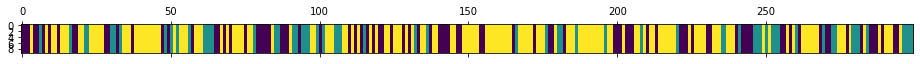

<Figure size 432x288 with 0 Axes>

677
N [[33. 23. 34.]
 [13. 23. 25.]
 [44. 15. 89.]]
alphas [[1.52687198 1.01990411 0.94443114]
 [0.74013764 1.80663845 0.94443114]
 [0.74013764 1.01990411 1.73116548]]
M [[4. 2. 5.]
 [2. 6. 4.]
 [1. 2. 7.]]
sum_w [[1.]
 [4.]
 [2.]]
barM [[3. 2. 5.]
 [2. 2. 4.]
 [1. 2. 5.]]
pi_z [[0.37959531 0.32627588 0.29412881]
 [0.19959881 0.37722621 0.42317498]
 [0.2804414  0.08897267 0.63058593]]
beta_vec [0.2605075  0.15576302 0.58372948]
hyper>> a_k: 3.1328115683598154  gamma: 0.9095267264694068  rho: 0.12141738399942474


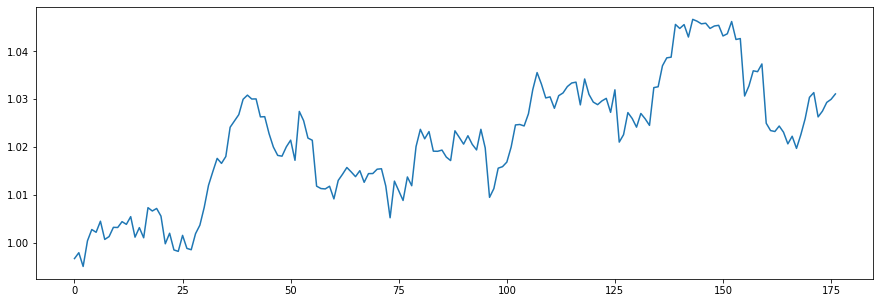

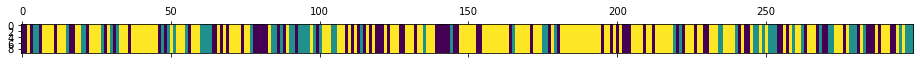

<Figure size 432x288 with 0 Axes>

N [[25. 26. 33.]
 [13. 20. 27.]
 [46. 14. 95.]]
alphas [[1.09740743 0.42872741 1.60667673]
 [0.71702964 0.8091052  1.60667673]
 [0.71702964 0.42872741 1.98705452]]
M [[ 7.  2.  6.]
 [ 2.  1.  6.]
 [ 2.  2. 11.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[4. 2. 6.]
 [2. 0. 6.]
 [2. 2. 8.]]
pi_z [[0.33114649 0.28326414 0.38558937]
 [0.12118616 0.36488187 0.51393198]
 [0.37511754 0.1296049  0.49527756]]
beta_vec [0.25493085 0.03868045 0.70638869]
hyper>> a_k: 4.29707460681458  gamma: 0.14017222639930674  rho: 0.32316234831517904


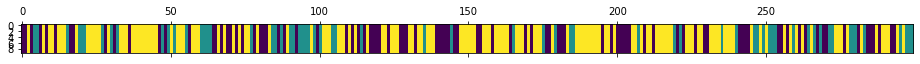

<Figure size 432x288 with 0 Axes>

678
N [[32. 25. 36.]
 [14. 21. 29.]
 [47. 18. 77.]]
alphas [[2.13009919 0.11249908 2.05447634]
 [0.74144647 1.5011518  2.05447634]
 [0.74144647 0.11249908 3.44312906]]
M [[6. 1. 7.]
 [2. 5. 4.]
 [7. 1. 7.]]
sum_w [[6.]
 [5.]
 [4.]]
barM [[0. 1. 7.]
 [2. 0. 4.]
 [7. 1. 3.]]
pi_z [[0.36613081 0.26581077 0.36805842]
 [0.24761699 0.28992374 0.46245928]
 [0.303002   0.09527738 0.60172062]]
beta_vec [0.25415574 0.05962874 0.68621552]
hyper>> a_k: 3.8305821669650673  gamma: 0.4948832754315896  rho: 0.4309016742478765


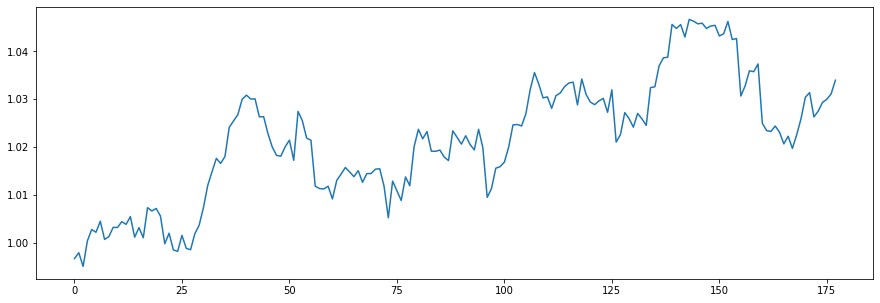

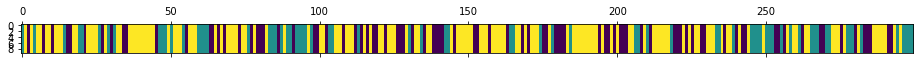

<Figure size 432x288 with 0 Axes>

N [[29. 25. 34.]
 [10. 30. 31.]
 [49. 16. 75.]]
alphas [[2.20465816 0.12998934 1.49593467]
 [0.55405389 1.78059361 1.49593467]
 [0.55405389 0.12998934 3.14653894]]
M [[5. 1. 7.]
 [3. 8. 3.]
 [6. 1. 6.]]
sum_w [[3.]
 [6.]
 [4.]]
barM [[2. 1. 7.]
 [3. 2. 3.]
 [6. 1. 2.]]
pi_z [[0.37987706 0.2212675  0.39885544]
 [0.16730282 0.47169381 0.36100337]
 [0.38356803 0.08080873 0.53562324]]
beta_vec [0.38050225 0.14199715 0.4775006 ]
hyper>> a_k: 2.5063978521325865  gamma: 0.5135004086431492  rho: 0.24430878843505677


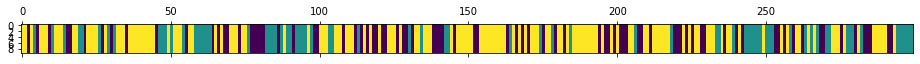

<Figure size 432x288 with 0 Axes>

679
N [[26. 23. 36.]
 [13. 33. 27.]
 [46. 17. 78.]]
alphas [[1.33303019 0.26895153 0.90441613]
 [0.72069516 0.88128655 0.90441613]
 [0.72069516 0.26895153 1.51675116]]
M [[6. 1. 6.]
 [1. 1. 5.]
 [4. 1. 5.]]
sum_w [[6.]
 [1.]
 [2.]]
barM [[0. 1. 6.]
 [1. 0. 5.]
 [4. 1. 3.]]
pi_z [[0.30537187 0.27191227 0.42271586]
 [0.13970765 0.52201177 0.33828058]
 [0.32278704 0.10342874 0.57378421]]
beta_vec [0.06807176 0.13029854 0.8016297 ]
hyper>> a_k: 2.7628752110507033  gamma: 0.3934174804182877  rho: 0.38152755405150784


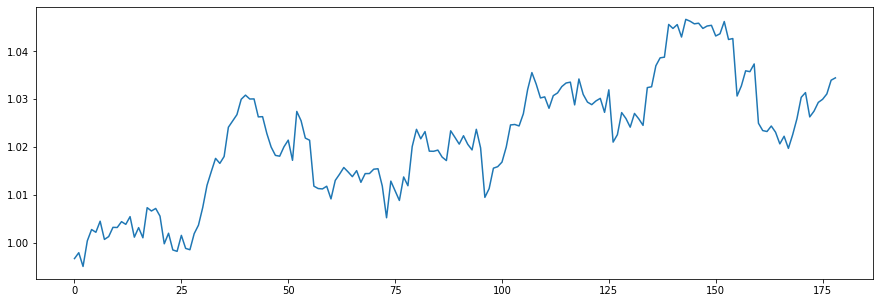

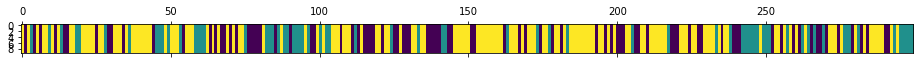

<Figure size 432x288 with 0 Axes>

N [[30. 22. 36.]
 [10. 26. 31.]
 [48. 19. 77.]]
alphas [[1.17043147 0.22264923 1.36979452]
 [0.11631844 1.27676225 1.36979452]
 [0.11631844 0.22264923 2.42390754]]
M [[5. 1. 2.]
 [1. 4. 5.]
 [1. 2. 6.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[0. 1. 2.]
 [1. 1. 5.]
 [1. 2. 3.]]
pi_z [[0.38112561 0.22271551 0.39615888]
 [0.11502539 0.47258082 0.41239378]
 [0.2847161  0.1891159  0.526168  ]]
beta_vec [0.05769459 0.0798965  0.86240891]
hyper>> a_k: 2.013497370934942  gamma: 0.6476491246221009  rho: 0.33180126839571344


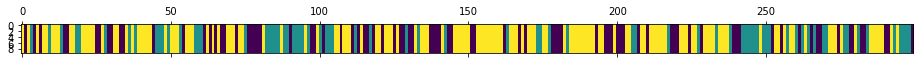

<Figure size 432x288 with 0 Axes>

680
N [[34. 25. 27.]
 [12. 29. 33.]
 [40. 20. 79.]]
alphas [[0.74570423 0.10749406 1.16029908]
 [0.07762324 0.77557505 1.16029908]
 [0.07762324 0.10749406 1.82838006]]
M [[5. 1. 7.]
 [1. 2. 3.]
 [2. 1. 4.]]
sum_w [[5.]
 [2.]
 [1.]]
barM [[0. 1. 7.]
 [1. 0. 3.]
 [2. 1. 3.]]
pi_z [[0.42361796 0.35064083 0.22574121]
 [0.17653945 0.29482672 0.52863383]
 [0.36443906 0.10179502 0.53376593]]
beta_vec [0.13816657 0.14006409 0.72176933]
hyper>> a_k: 1.625919555867702  gamma: 0.32148133699518366  rho: 0.2975769964439481


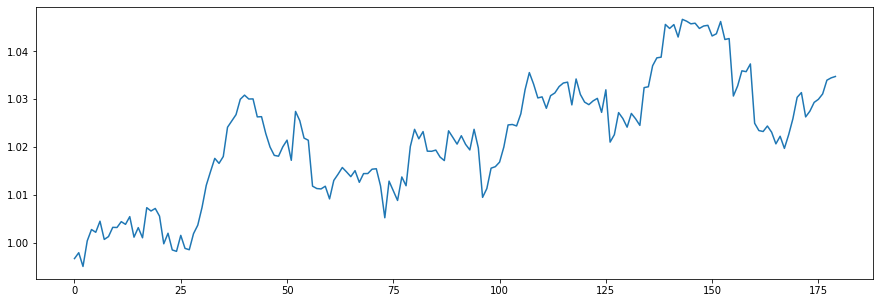

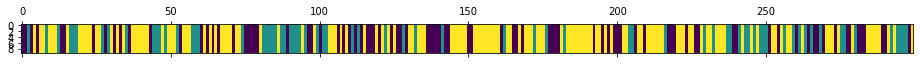

<Figure size 432x288 with 0 Axes>

N [[31. 26. 32.]
 [14. 24. 33.]
 [43. 21. 75.]]
alphas [[0.64163399 0.15996486 0.8243207 ]
 [0.15779773 0.64380112 0.8243207 ]
 [0.15779773 0.15996486 1.30815696]]
M [[2. 1. 5.]
 [1. 2. 2.]
 [1. 1. 2.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[1. 1. 5.]
 [1. 1. 2.]
 [1. 1. 1.]]
pi_z [[0.31589704 0.24434681 0.43975614]
 [0.15377678 0.40000226 0.44622096]
 [0.25058409 0.18750073 0.56191517]]
beta_vec [0.29532805 0.1038696  0.60080234]
hyper>> a_k: 1.5349963294475053  gamma: 0.8571880761387867  rho: 0.38140706677419417


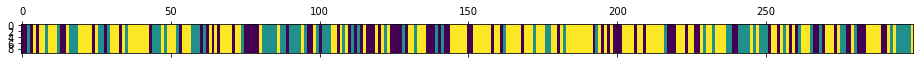

<Figure size 432x288 with 0 Axes>

681
N [[26. 22. 32.]
 [16. 29. 31.]
 [38. 25. 80.]]
alphas [[0.86588362 0.09862812 0.57048458]
 [0.28042517 0.68408657 0.57048458]
 [0.28042517 0.09862812 1.15594303]]
M [[2. 1. 5.]
 [3. 2. 6.]
 [2. 1. 3.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[1. 1. 5.]
 [3. 0. 6.]
 [2. 1. 2.]]
pi_z [[0.36066534 0.21547706 0.4238576 ]
 [0.17371635 0.36695577 0.45932789]
 [0.30976362 0.141853   0.54838339]]
beta_vec [0.30033124 0.06604827 0.63362049]
hyper>> a_k: 2.0320522837773938  gamma: 0.23812032835077077  rho: 0.17750036057676166


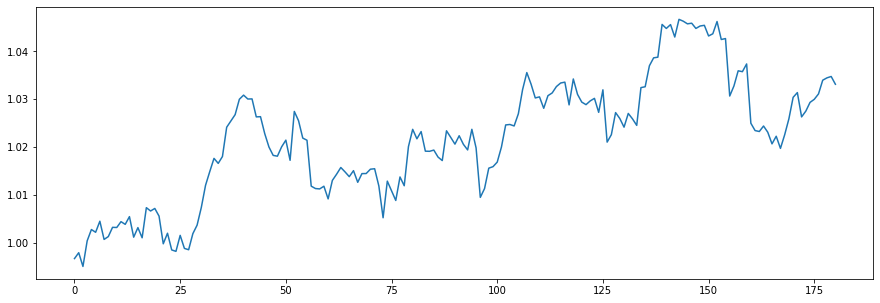

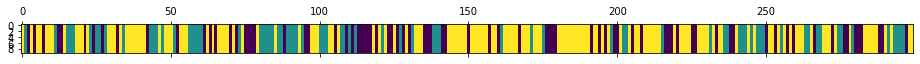

<Figure size 432x288 with 0 Axes>

N [[25. 21. 34.]
 [12. 34. 30.]
 [43. 21. 79.]]
alphas [[0.86265232 0.11039058 1.05900938]
 [0.50196231 0.4710806  1.05900938]
 [0.50196231 0.11039058 1.41969939]]
M [[2. 2. 8.]
 [2. 4. 5.]
 [3. 1. 6.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[2. 2. 8.]
 [2. 3. 5.]
 [3. 1. 4.]]
pi_z [[0.34748511 0.20529802 0.44721688]
 [0.12443083 0.3913761  0.48419307]
 [0.2898956  0.1644085  0.5456959 ]]
beta_vec [0.17727238 0.21083709 0.61189053]
hyper>> a_k: 2.3752615188874957  gamma: 0.16806266770818476  rho: 0.1316547829006761


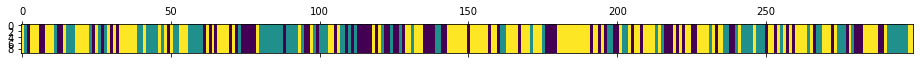

<Figure size 432x288 with 0 Axes>

682
N [[28. 23. 30.]
 [13. 43. 30.]
 [40. 20. 72.]]
alphas [[0.67834714 0.43486141 1.26205296]
 [0.3656326  0.74757595 1.26205296]
 [0.3656326  0.43486141 1.5747675 ]]
M [[4. 3. 4.]
 [3. 1. 4.]
 [1. 2. 8.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[3. 3. 4.]
 [3. 1. 4.]
 [1. 2. 6.]]
pi_z [[0.30694155 0.27050786 0.42255059]
 [0.13293925 0.55674642 0.31031433]
 [0.29482878 0.13555106 0.56962016]]
beta_vec [0.1738299  0.19234821 0.63382189]
hyper>> a_k: 1.94970297263219  gamma: 0.5752468054058772  rho: 0.06815063482775004


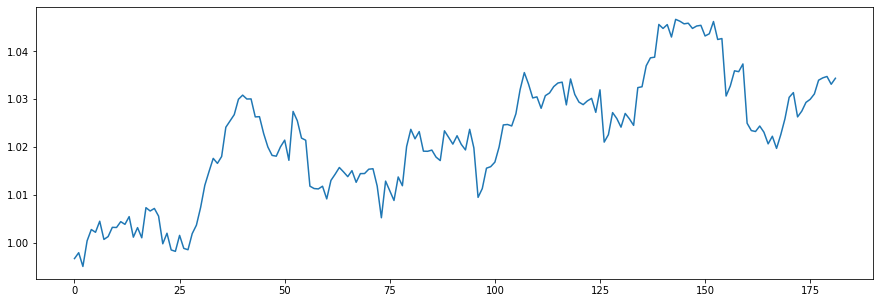

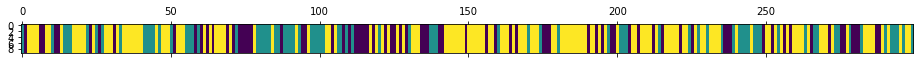

<Figure size 432x288 with 0 Axes>

N [[24. 23. 30.]
 [12. 34. 34.]
 [41. 24. 77.]]
alphas [[0.44869279 0.34946389 1.15154629]
 [0.31581929 0.48233739 1.15154629]
 [0.31581929 0.34946389 1.28441979]]
M [[4. 3. 4.]
 [2. 3. 5.]
 [2. 3. 8.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[4. 3. 4.]
 [2. 3. 5.]
 [2. 3. 8.]]
pi_z [[0.28296503 0.33352483 0.38351014]
 [0.24062108 0.33018054 0.42919838]
 [0.28768968 0.17061277 0.54169756]]
beta_vec [0.16145352 0.18740356 0.65114292]
hyper>> a_k: 2.8988104421615044  gamma: 0.09974270640613009  rho: 0.020065423595858438


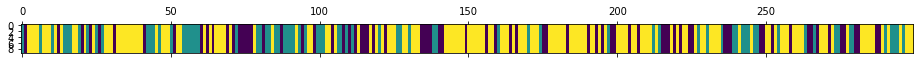

<Figure size 432x288 with 0 Axes>

683
N [[22. 22. 32.]
 [13. 28. 33.]
 [41. 24. 84.]]
alphas [[0.51679793 0.53234691 1.8496656 ]
 [0.45863207 0.59051277 1.8496656 ]
 [0.45863207 0.53234691 1.90783146]]
M [[3. 1. 4.]
 [4. 3. 7.]
 [1. 3. 3.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[3. 1. 4.]
 [4. 3. 7.]
 [1. 3. 3.]]
pi_z [[0.22350201 0.28114725 0.49535074]
 [0.24705639 0.33601584 0.41692777]
 [0.26637715 0.15849433 0.57512852]]
beta_vec [0.23512416 0.420196   0.34467984]
hyper>> a_k: 1.8553832542934607  gamma: 0.7003630411966052  rho: 0.06486774966618598


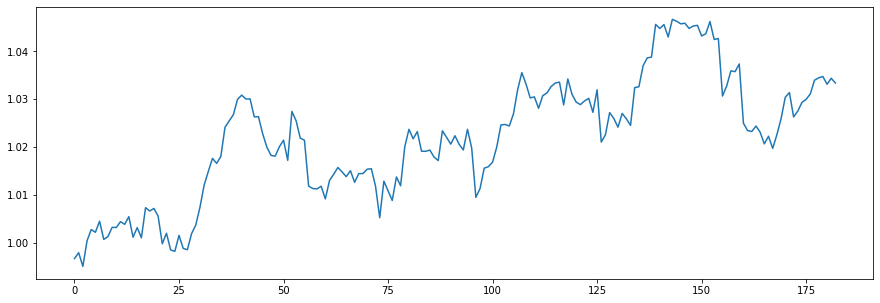

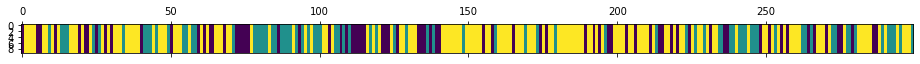

<Figure size 432x288 with 0 Axes>

N [[21. 23. 31.]
 [12. 28. 38.]
 [42. 28. 76.]]
alphas [[0.52830171 0.72905213 0.59802941]
 [0.40794717 0.84940667 0.59802941]
 [0.40794717 0.72905213 0.71838395]]
M [[1. 5. 5.]
 [1. 4. 2.]
 [2. 1. 3.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[1. 5. 5.]
 [1. 3. 2.]
 [2. 1. 3.]]
pi_z [[0.26769248 0.30730696 0.42500055]
 [0.12946229 0.43240655 0.43813116]
 [0.29872755 0.16459412 0.53667833]]
beta_vec [0.18430702 0.23705365 0.57863933]
hyper>> a_k: 2.2615729507723987  gamma: 0.3530345535673823  rho: 0.17087255132341572


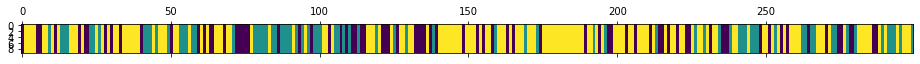

<Figure size 432x288 with 0 Axes>

684
N [[22. 20. 35.]
 [13. 28. 34.]
 [42. 27. 78.]]
alphas [[0.73204077 0.44450693 1.08502525]
 [0.34560003 0.83094767 1.08502525]
 [0.34560003 0.44450693 1.47146599]]
M [[3. 1. 1.]
 [1. 3. 5.]
 [1. 2. 5.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[0. 1. 1.]
 [1. 2. 5.]
 [1. 2. 4.]]
pi_z [[0.27063274 0.20588218 0.52348507]
 [0.21205074 0.38433763 0.40361162]
 [0.26335948 0.17355456 0.56308596]]
beta_vec [0.17512285 0.24094955 0.58392759]
hyper>> a_k: 1.726165727387473  gamma: 1.4397118070306911  rho: 0.23840112217422033


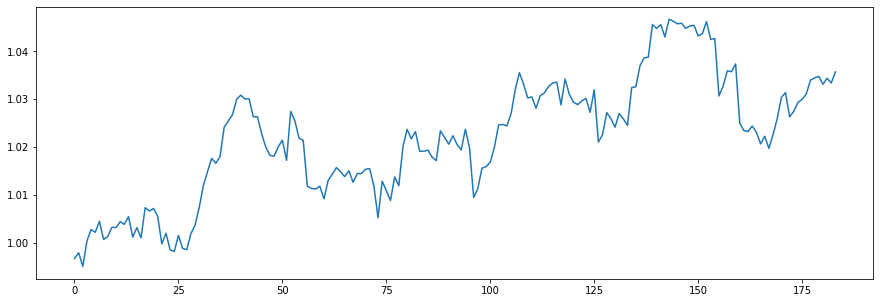

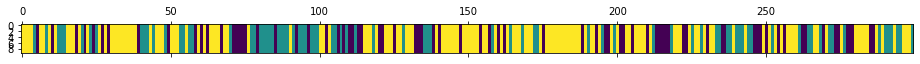

<Figure size 432x288 with 0 Axes>

N [[24. 23. 30.]
 [14. 32. 35.]
 [39. 27. 75.]]
alphas [[0.64174438 0.31676334 0.767658  ]
 [0.23022454 0.72828319 0.767658  ]
 [0.23022454 0.31676334 1.17917785]]
M [[1. 4. 3.]
 [2. 3. 7.]
 [3. 3. 6.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[0. 4. 3.]
 [2. 0. 7.]
 [3. 3. 3.]]
pi_z [[0.32813939 0.30104524 0.37081537]
 [0.16201038 0.40545264 0.43253698]
 [0.29255638 0.20342948 0.50401415]]
beta_vec [0.32599055 0.073219   0.60079046]
hyper>> a_k: 1.9043338591374945  gamma: 0.8105036547624295  rho: 0.2779196945694149


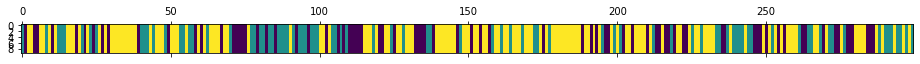

<Figure size 432x288 with 0 Axes>

685
N [[26. 26. 27.]
 [15. 29. 40.]
 [38. 29. 69.]]
alphas [[0.97751561 0.10068212 0.82613613]
 [0.44826372 0.62993401 0.82613613]
 [0.44826372 0.10068212 1.35538801]]
M [[4. 1. 4.]
 [3. 2. 3.]
 [1. 1. 5.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[2. 1. 4.]
 [3. 1. 3.]
 [1. 1. 2.]]
pi_z [[0.31662426 0.22000951 0.46336623]
 [0.21065076 0.32430961 0.46503963]
 [0.23886346 0.25129904 0.5098375 ]]
beta_vec [0.26778717 0.21719606 0.51501677]
hyper>> a_k: 1.0249943386060514  gamma: 1.0997493733949866  rho: 0.30354755870946165


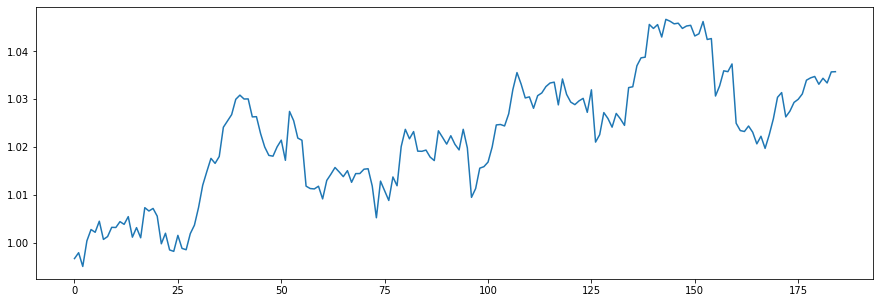

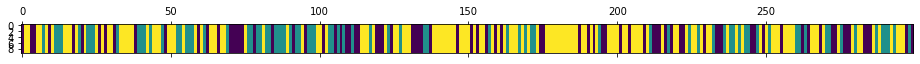

<Figure size 432x288 with 0 Axes>

N [[26. 22. 34.]
 [16. 27. 37.]
 [41. 30. 66.]]
alphas [[0.50229703 0.15504754 0.36764977]
 [0.1911625  0.46618207 0.36764977]
 [0.1911625  0.15504754 0.6787843 ]]
M [[3. 2. 3.]
 [2. 4. 1.]
 [1. 3. 2.]]
sum_w [[2.]
 [4.]
 [0.]]
barM [[1. 2. 3.]
 [2. 0. 1.]
 [1. 3. 2.]]
pi_z [[0.21265981 0.35649098 0.43084921]
 [0.15765758 0.40149361 0.44084881]
 [0.28335525 0.19187208 0.52477267]]
beta_vec [0.25123307 0.55103644 0.1977305 ]
hyper>> a_k: 1.4402924266971913  gamma: 0.24249260302147954  rho: 0.23988369109376706


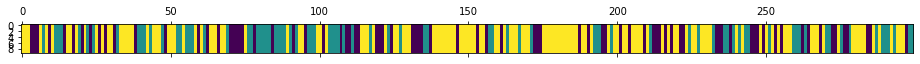

<Figure size 432x288 with 0 Axes>

686
N [[26. 24. 31.]
 [16. 32. 34.]
 [39. 26. 71.]]
alphas [[0.62055005 0.60326905 0.21647333]
 [0.27504739 0.94877171 0.21647333]
 [0.27504739 0.60326905 0.56197599]]
M [[2. 1. 1.]
 [4. 2. 1.]
 [1. 5. 4.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[0. 1. 1.]
 [4. 0. 1.]
 [1. 5. 2.]]
pi_z [[0.37414447 0.29525545 0.33060008]
 [0.15452923 0.43599325 0.40947752]
 [0.29893778 0.14559676 0.55546546]]
beta_vec [0.30227351 0.34836481 0.34936168]
hyper>> a_k: 1.2516013107636592  gamma: 0.2998477953038997  rho: 0.2758325253608813


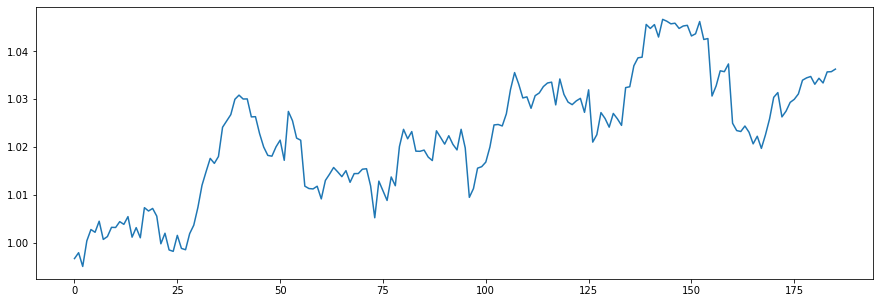

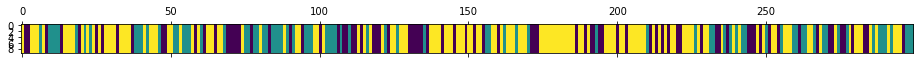

<Figure size 432x288 with 0 Axes>

N [[25. 24. 34.]
 [16. 28. 34.]
 [42. 26. 70.]]
alphas [[0.61920368 0.31574705 0.31665058]
 [0.27397133 0.6609794  0.31665058]
 [0.27397133 0.31574705 0.66188293]]
M [[1. 3. 1.]
 [1. 2. 2.]
 [2. 2. 5.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[0. 3. 1.]
 [1. 2. 2.]
 [2. 2. 2.]]
pi_z [[0.28017753 0.28114646 0.43867601]
 [0.20212775 0.35221779 0.44565446]
 [0.28294442 0.2507155  0.46634008]]
beta_vec [0.15998794 0.63657272 0.20343934]
hyper>> a_k: 1.1441374751969626  gamma: 1.9396152895042744  rho: 0.21942053495826752


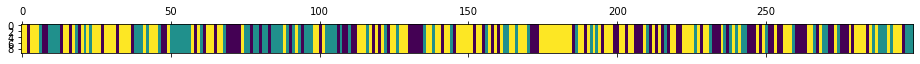

<Figure size 432x288 with 0 Axes>

687
N [[30. 27. 31.]
 [15. 29. 37.]
 [43. 25. 62.]]
alphas [[0.39393092 0.56851687 0.18168969]
 [0.14288366 0.81956412 0.18168969]
 [0.14288366 0.56851687 0.43273694]]
M [[2. 2. 2.]
 [1. 4. 2.]
 [1. 3. 3.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[0. 2. 2.]
 [1. 3. 2.]
 [1. 3. 3.]]
pi_z [[0.34304364 0.36323412 0.29372224]
 [0.18600268 0.35995551 0.45404181]
 [0.31989233 0.23908227 0.4410254 ]]
beta_vec [0.08150678 0.45484064 0.46365258]
hyper>> a_k: 1.2832496770381179  gamma: 0.26307643414239057  rho: 0.1044111785841544


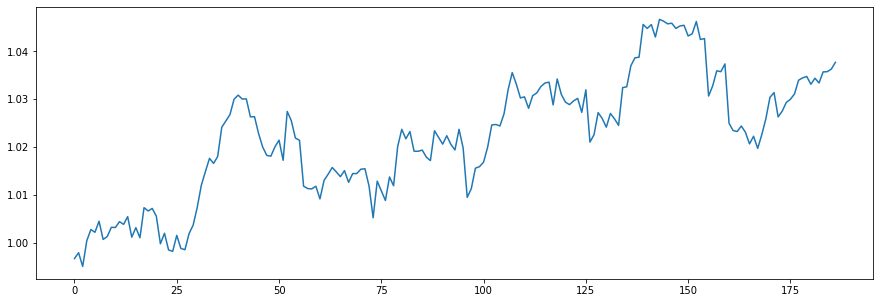

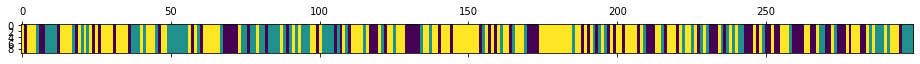

<Figure size 432x288 with 0 Axes>

N [[30. 25. 28.]
 [13. 28. 40.]
 [40. 28. 67.]]
alphas [[0.22765843 0.522732   0.53285925]
 [0.09367281 0.65671761 0.53285925]
 [0.09367281 0.522732   0.66684486]]
M [[2. 3. 4.]
 [1. 3. 3.]
 [1. 2. 6.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[0. 3. 4.]
 [1. 3. 3.]
 [1. 2. 5.]]
pi_z [[0.41104985 0.29166016 0.29728998]
 [0.135246   0.30326043 0.56149357]
 [0.32805217 0.21922367 0.45272416]]
beta_vec [0.19430286 0.17337677 0.63232037]
hyper>> a_k: 1.8200424362300118  gamma: 0.8208620256186562  rho: 0.2114500988764089


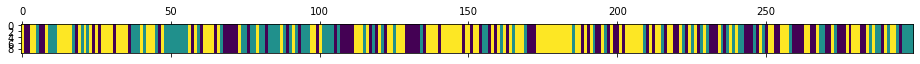

<Figure size 432x288 with 0 Axes>

688
N [[32. 32. 26.]
 [13. 29. 40.]
 [45. 21. 61.]]
alphas [[0.66371051 0.24882935 0.90750258]
 [0.27886236 0.6336775  0.90750258]
 [0.27886236 0.24882935 1.29235073]]
M [[1. 2. 5.]
 [3. 2. 4.]
 [3. 2. 7.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[0. 2. 5.]
 [3. 2. 4.]
 [3. 2. 4.]]
pi_z [[0.36943737 0.33345035 0.29711228]
 [0.1157154  0.37230224 0.51198237]
 [0.32292952 0.21090702 0.46616346]]
beta_vec [0.23687975 0.2999071  0.46321315]
hyper>> a_k: 2.1872921031876755  gamma: 0.6991684296410764  rho: 0.09625228323553228


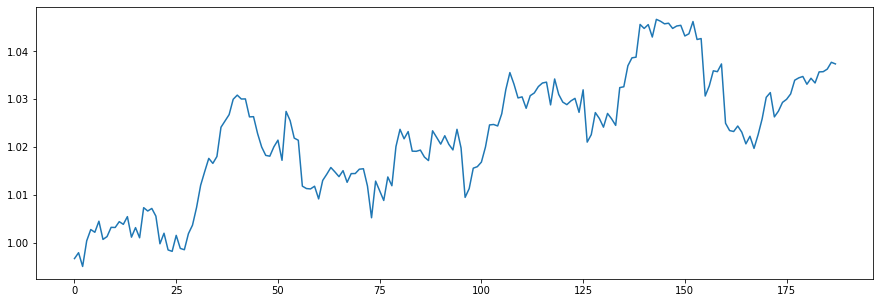

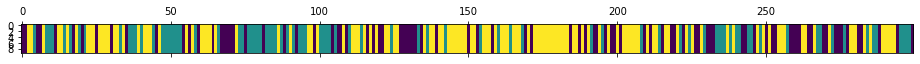

<Figure size 432x288 with 0 Axes>

N [[30. 29. 29.]
 [14. 33. 37.]
 [45. 21. 61.]]
alphas [[0.67878632 0.59284444 0.91566134]
 [0.46825447 0.8033763  0.91566134]
 [0.46825447 0.59284444 1.1261932 ]]
M [[3. 4. 6.]
 [2. 2. 5.]
 [3. 2. 4.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[2. 4. 6.]
 [2. 1. 5.]
 [3. 2. 3.]]
pi_z [[0.26978196 0.35756908 0.37264896]
 [0.25554555 0.36146217 0.38299228]
 [0.33609539 0.20920307 0.45470155]]
beta_vec [0.29451951 0.18123695 0.52424354]
hyper>> a_k: 3.123823690880587  gamma: 0.5907019030233082  rho: 0.09805150507709796


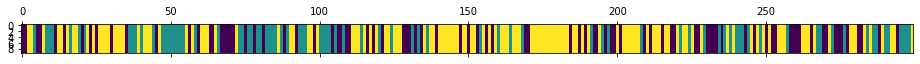

<Figure size 432x288 with 0 Axes>

689
N [[26. 29. 33.]
 [18. 30. 34.]
 [44. 23. 62.]]
alphas [[1.13611261 0.5106402  1.47707089]
 [0.82981699 0.81693581 1.47707089]
 [0.82981699 0.5106402  1.7833665 ]]
M [[4. 3. 5.]
 [4. 4. 3.]
 [2. 2. 5.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[3. 3. 5.]
 [4. 3. 3.]
 [2. 2. 5.]]
pi_z [[0.35015418 0.33073636 0.31910946]
 [0.25602331 0.38469777 0.35927892]
 [0.33175593 0.18872515 0.47951892]]
beta_vec [0.1608657  0.34552048 0.49361382]
hyper>> a_k: 2.7845252185321314  gamma: 0.7993691811271888  rho: 0.11568815321924637


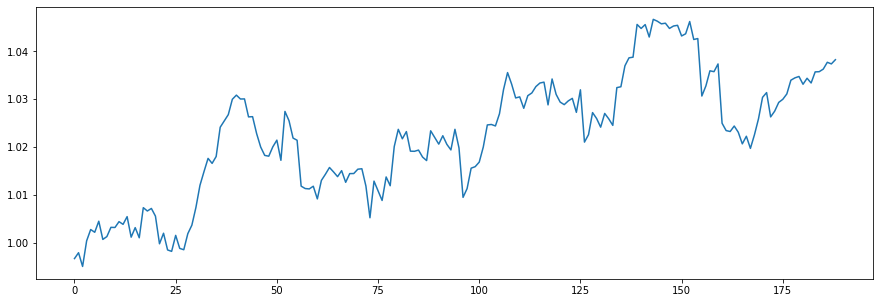

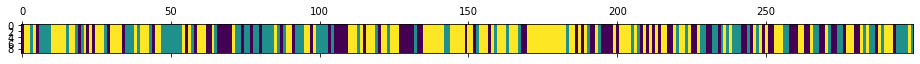

<Figure size 432x288 with 0 Axes>

N [[30. 27. 26.]
 [16. 34. 36.]
 [37. 26. 67.]]
alphas [[0.71825045 0.85080572 1.21546905]
 [0.39611387 1.1729423  1.21546905]
 [0.39611387 0.85080572 1.53760563]]
M [[2. 5. 7.]
 [1. 5. 3.]
 [2. 4. 7.]]
sum_w [[0.]
 [2.]
 [0.]]
barM [[2. 5. 7.]
 [1. 3. 3.]
 [2. 4. 7.]]
pi_z [[0.36684125 0.26433383 0.36882492]
 [0.22133041 0.39172973 0.38693985]
 [0.2624379  0.2362485  0.50131359]]
beta_vec [0.12745448 0.42613191 0.44641361]
hyper>> a_k: 2.9329462967987565  gamma: 0.21039044162593834  rho: 0.14121956524872217


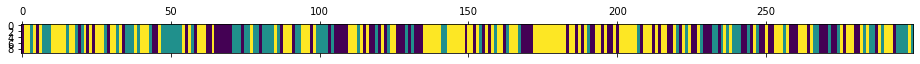

<Figure size 432x288 with 0 Axes>

690
N [[34. 25. 33.]
 [18. 30. 32.]
 [40. 25. 62.]]
alphas [[0.73521625 1.07332269 1.12440735]
 [0.32102685 1.48751209 1.12440735]
 [0.32102685 1.07332269 1.53859675]]
M [[4. 7. 3.]
 [1. 1. 4.]
 [4. 2. 9.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[3. 7. 3.]
 [1. 1. 4.]
 [4. 2. 6.]]
pi_z [[0.2961642  0.24895577 0.45488002]
 [0.24001035 0.40478465 0.35520501]
 [0.26065398 0.23643727 0.50290876]]
beta_vec [0.28280164 0.30618985 0.4110085 ]
hyper>> a_k: 3.574904325003421  gamma: 0.28233028361110996  rho: 0.09534626408649936


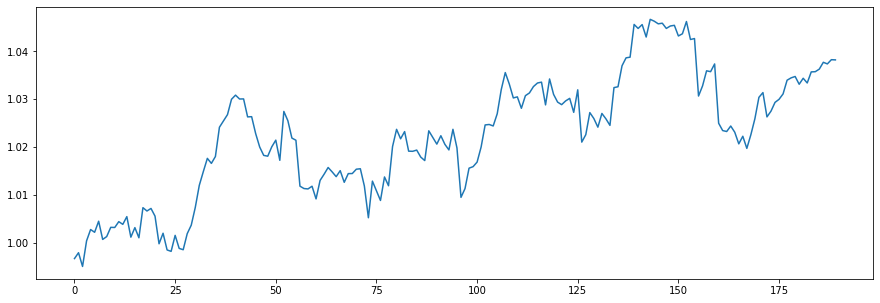

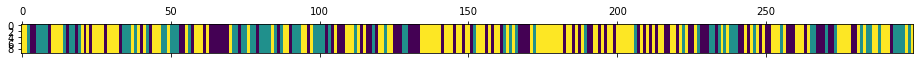

<Figure size 432x288 with 0 Axes>

N [[32. 22. 39.]
 [18. 29. 29.]
 [43. 24. 63.]]
alphas [[1.25544858 0.99023346 1.32922228]
 [0.91459481 1.33108723 1.32922228]
 [0.91459481 0.99023346 1.67007605]]
M [[4. 3. 6.]
 [4. 4. 6.]
 [7. 4. 9.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[3. 3. 6.]
 [4. 3. 6.]
 [7. 4. 8.]]
pi_z [[0.37919776 0.21386227 0.40693997]
 [0.31658486 0.29691136 0.38650378]
 [0.25393714 0.23779335 0.50826951]]
beta_vec [0.43307835 0.14006577 0.42685588]
hyper>> a_k: 3.727595349829999  gamma: 0.36230425662640253  rho: 0.06703690962922473


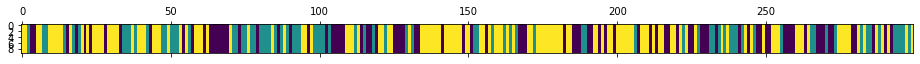

<Figure size 432x288 with 0 Axes>

691
N [[34. 25. 30.]
 [18. 27. 34.]
 [37. 27. 67.]]
alphas [[1.75600689 0.48710798 1.48448048]
 [1.50612042 0.73699445 1.48448048]
 [1.50612042 0.48710798 1.73436695]]
M [[8. 3. 3.]
 [2. 1. 6.]
 [4. 1. 9.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[6. 3. 3.]
 [2. 0. 6.]
 [4. 1. 8.]]
pi_z [[0.49971371 0.25038391 0.24990238]
 [0.20853525 0.37168714 0.41977761]
 [0.26769124 0.2145592  0.51774956]]
beta_vec [0.38386017 0.10158087 0.51455896]
hyper>> a_k: 3.024404816652194  gamma: 0.38548402636513635  rho: 0.35101135622844454


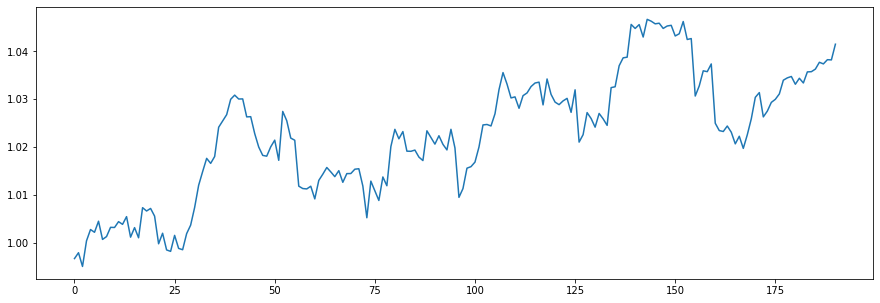

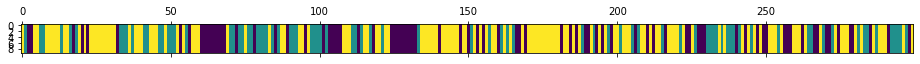

<Figure size 432x288 with 0 Axes>

N [[32. 22. 30.]
 [16. 29. 37.]
 [35. 31. 67.]]
alphas [[1.81504286 0.19938338 1.00997858]
 [0.75344242 1.26098382 1.00997858]
 [0.75344242 0.19938338 2.07157901]]
M [[ 9.  2.  3.]
 [ 3.  6.  6.]
 [ 5.  2. 12.]]
sum_w [[6.]
 [6.]
 [7.]]
barM [[3. 2. 3.]
 [3. 0. 6.]
 [5. 2. 5.]]
pi_z [[0.42613165 0.16236461 0.41150374]
 [0.19092262 0.28443126 0.52464612]
 [0.24965917 0.25018466 0.50015617]]
beta_vec [0.36393501 0.06999696 0.56606803]
hyper>> a_k: 5.100894951605065  gamma: 0.30800222708564434  rho: 0.3914281803194893


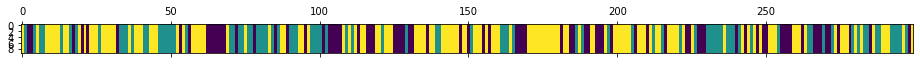

<Figure size 432x288 with 0 Axes>

692
N [[34. 21. 26.]
 [16. 36. 35.]
 [31. 30. 70.]]
alphas [[3.12638325 0.21728883 1.75722287]
 [1.12974922 2.21392286 1.75722287]
 [1.12974922 0.21728883 3.7538569 ]]
M [[ 7.  1.  6.]
 [ 4.  8.  3.]
 [ 4.  1. 11.]]
sum_w [[4.]
 [6.]
 [6.]]
barM [[3. 1. 6.]
 [4. 2. 3.]
 [4. 1. 5.]]
pi_z [[0.48580442 0.19264826 0.32154732]
 [0.15680768 0.44696535 0.39622697]
 [0.18464294 0.2000187  0.61533837]]
beta_vec [0.31732406 0.30152877 0.38114717]
hyper>> a_k: 3.7691772683376357  gamma: 0.833026792980701  rho: 0.3938421395180247


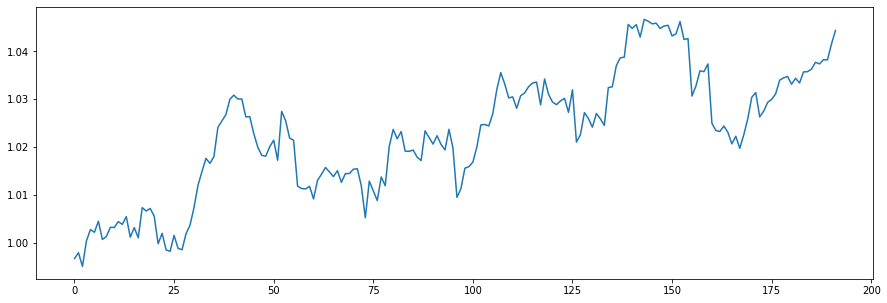

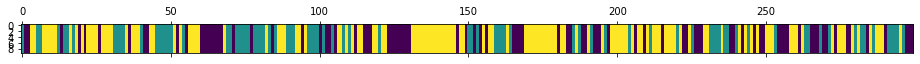

<Figure size 432x288 with 0 Axes>

N [[39. 23. 26.]
 [14. 36. 32.]
 [35. 23. 71.]]
alphas [[2.20945634 0.68890773 0.8708132 ]
 [0.7249955  2.17336857 0.8708132 ]
 [0.7249955  0.68890773 2.35527404]]
M [[7. 3. 2.]
 [4. 8. 2.]
 [6. 6. 7.]]
sum_w [[6.]
 [5.]
 [4.]]
barM [[1. 3. 2.]
 [4. 3. 2.]
 [6. 6. 3.]]
pi_z [[0.41891765 0.21843085 0.3626515 ]
 [0.08831323 0.4160364  0.49565037]
 [0.23635884 0.20064736 0.56299379]]
beta_vec [0.29722367 0.45412947 0.24864686]
hyper>> a_k: 4.189655327748895  gamma: 0.8982036112954925  rho: 0.46365094881696367


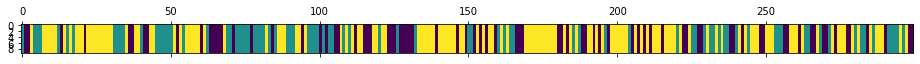

<Figure size 432x288 with 0 Axes>

693
N [[30. 21. 30.]
 [13. 36. 35.]
 [38. 27. 69.]]
alphas [[2.61043422 1.02048236 0.55873874]
 [0.66789655 2.96302003 0.55873874]
 [0.66789655 1.02048236 2.50127641]]
M [[ 6.  3.  4.]
 [ 4. 12.  3.]
 [ 2.  3. 11.]]
sum_w [[5.]
 [6.]
 [9.]]
barM [[1. 3. 4.]
 [4. 6. 3.]
 [2. 3. 2.]]
pi_z [[0.42771802 0.22183288 0.3504491 ]
 [0.20323982 0.3733001  0.42346007]
 [0.2295619  0.20163851 0.56879959]]
beta_vec [0.24827278 0.49039968 0.26132755]
hyper>> a_k: 3.9278573651477204  gamma: 0.6718732427765749  rho: 0.45369022266794656


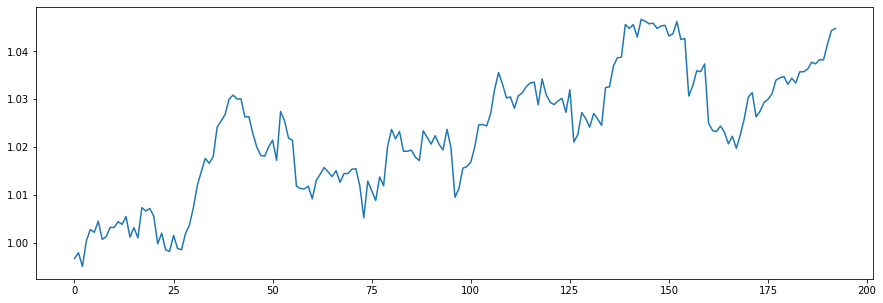

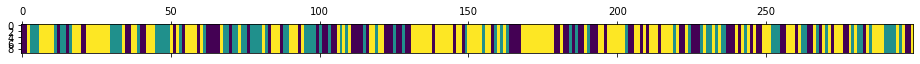

<Figure size 432x288 with 0 Axes>

N [[36. 25. 27.]
 [15. 29. 34.]
 [36. 24. 73.]]
alphas [[2.31478089 1.05231281 0.56076367]
 [0.5327504  2.83434329 0.56076367]
 [0.5327504  1.05231281 2.34279415]]
M [[ 5.  3.  1.]
 [ 2.  5.  3.]
 [ 3.  3. 10.]]
sum_w [[4.]
 [3.]
 [6.]]
barM [[1. 3. 1.]
 [2. 2. 3.]
 [3. 3. 4.]]
pi_z [[0.33463529 0.29640775 0.36895696]
 [0.18884184 0.4044613  0.40669686]
 [0.33237604 0.18501031 0.48261365]]
beta_vec [0.20313973 0.52702646 0.2698338 ]
hyper>> a_k: 2.7076002468135347  gamma: 1.5553071464555936  rho: 0.3868965227442523


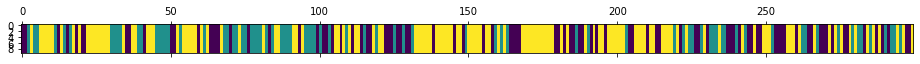

<Figure size 432x288 with 0 Axes>

694
N [[33. 26. 32.]
 [20. 28. 31.]
 [38. 25. 66.]]
alphas [[1.38478102 0.87488455 0.44793467]
 [0.3372199  1.92244567 0.44793467]
 [0.3372199  0.87488455 1.49549579]]
M [[5. 3. 5.]
 [1. 9. 2.]
 [2. 3. 9.]]
sum_w [[5.]
 [2.]
 [8.]]
barM [[0. 3. 5.]
 [1. 7. 2.]
 [2. 3. 1.]]
pi_z [[0.32167564 0.28725679 0.39106757]
 [0.26513562 0.32943152 0.40543286]
 [0.34215759 0.16802614 0.48981626]]
beta_vec [0.10517063 0.35829859 0.53653078]
hyper>> a_k: 5.596769384728492  gamma: 1.2020094106897672  rho: 0.4630837598352375


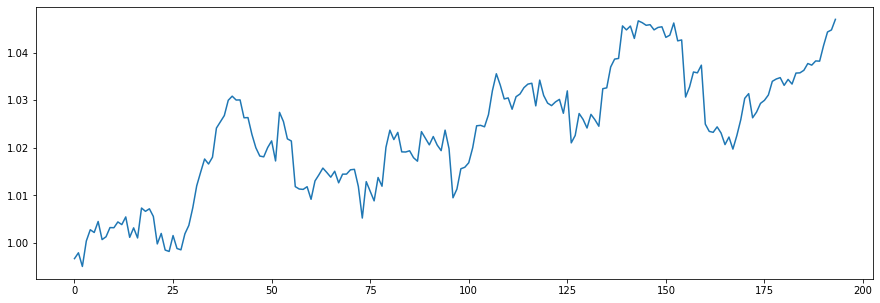

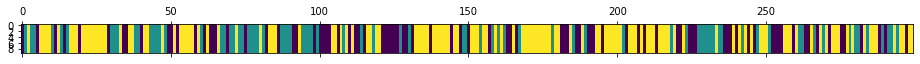

<Figure size 432x288 with 0 Axes>

N [[31. 27. 31.]
 [17. 29. 32.]
 [41. 22. 69.]]
alphas [[2.90781038 1.07668597 1.61227304]
 [0.31603737 3.66845898 1.61227304]
 [0.31603737 1.07668597 4.20404605]]
M [[ 8.  4.  9.]
 [ 4. 10.  3.]
 [ 1.  5. 15.]]
sum_w [[ 7.]
 [ 8.]
 [12.]]
barM [[1. 4. 9.]
 [4. 2. 3.]
 [1. 5. 3.]]
pi_z [[0.36079522 0.33999494 0.29920985]
 [0.21817991 0.39646836 0.38535173]
 [0.30089789 0.16367664 0.53542547]]
beta_vec [0.11960658 0.39757696 0.48281646]
hyper>> a_k: 6.564782354618385  gamma: 1.0650200566307533  rho: 0.528599763129604


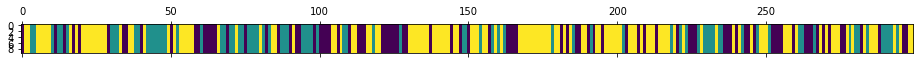

<Figure size 432x288 with 0 Axes>

695
N [[34. 24. 31.]
 [19. 33. 27.]
 [36. 22. 73.]]
alphas [[3.84028169 1.23035754 1.49414312]
 [0.3701393  4.70049994 1.49414312]
 [0.3701393  1.23035754 4.96428551]]
M [[ 9.  3.  5.]
 [ 3.  9.  5.]
 [ 3.  4. 13.]]
sum_w [[9.]
 [8.]
 [8.]]
barM [[0. 3. 5.]
 [3. 1. 5.]
 [3. 4. 5.]]
pi_z [[0.4136933  0.24593316 0.34037354]
 [0.25399784 0.38518991 0.36081225]
 [0.28898429 0.13803749 0.57297822]]
beta_vec [0.22138946 0.40798022 0.37063032]
hyper>> a_k: 5.168929420858015  gamma: 0.6089785950951639  rho: 0.5619415059318819


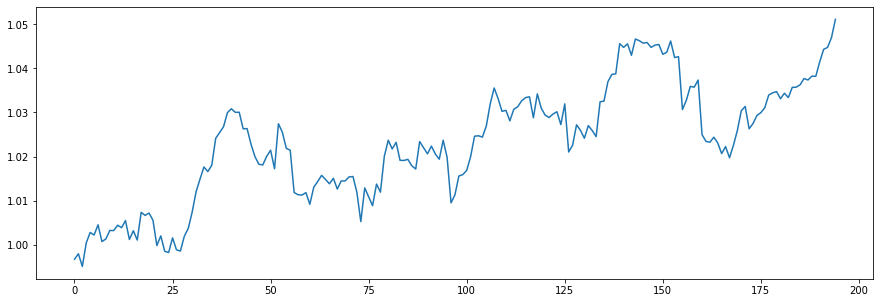

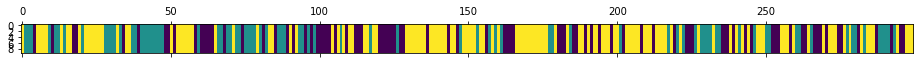

<Figure size 432x288 with 0 Axes>

N [[35. 24. 29.]
 [17. 34. 30.]
 [36. 23. 71.]]
alphas [[3.40592668 0.92378694 0.83921581]
 [0.50129069 3.82842292 0.83921581]
 [0.50129069 0.92378694 3.74385179]]
M [[9. 4. 6.]
 [2. 8. 3.]
 [2. 4. 7.]]
sum_w [[8.]
 [4.]
 [6.]]
barM [[1. 4. 6.]
 [2. 4. 3.]
 [2. 4. 1.]]
pi_z [[0.41704224 0.20160702 0.38135074]
 [0.28659874 0.38358583 0.32981543]
 [0.21721775 0.20850091 0.57428134]]
beta_vec [0.08858731 0.57029239 0.3411203 ]
hyper>> a_k: 3.7730577315224316  gamma: 0.602122348624682  rho: 0.36701079405488873


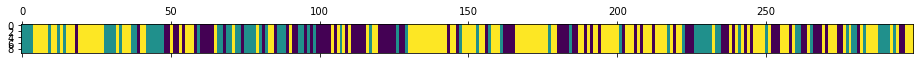

<Figure size 432x288 with 0 Axes>

696
N [[39. 19. 29.]
 [14. 31. 29.]
 [34. 24. 80.]]
alphas [[1.59632642 1.36203206 0.81469925]
 [0.21157351 2.74678497 0.81469925]
 [0.21157351 1.36203206 2.19945217]]
M [[7. 4. 3.]
 [2. 8. 4.]
 [1. 2. 5.]]
sum_w [[6.]
 [7.]
 [3.]]
barM [[1. 4. 3.]
 [2. 1. 4.]
 [1. 2. 2.]]
pi_z [[0.46370306 0.2029894  0.33330755]
 [0.0994958  0.48767119 0.41283302]
 [0.19738482 0.18511864 0.61749654]]
beta_vec [0.15802598 0.55810865 0.28386537]
hyper>> a_k: 2.9692611729141376  gamma: 0.7605706438758879  rho: 0.30511129730101566


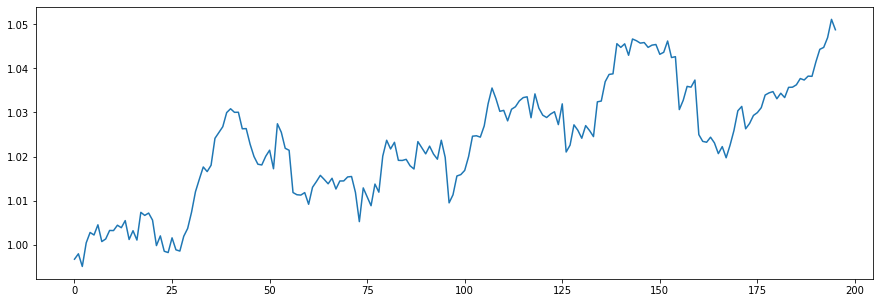

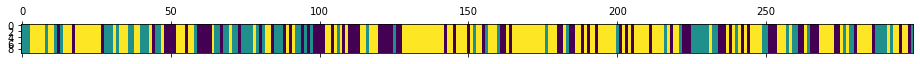

<Figure size 432x288 with 0 Axes>

N [[31. 19. 31.]
 [13. 30. 28.]
 [36. 23. 88.]]
alphas [[1.23201109 1.15154895 0.58570114]
 [0.32605596 2.05750407 0.58570114]
 [0.32605596 1.15154895 1.49165627]]
M [[5. 5. 3.]
 [2. 6. 3.]
 [3. 5. 8.]]
sum_w [[3.]
 [3.]
 [2.]]
barM [[2. 5. 3.]
 [2. 3. 3.]
 [3. 5. 6.]]
pi_z [[0.27296174 0.29620532 0.43083295]
 [0.24430183 0.4596968  0.29600137]
 [0.22569452 0.14443705 0.62986843]]
beta_vec [0.3282407  0.45071723 0.22104207]
hyper>> a_k: 3.7413855883819007  gamma: 0.5015698092163042  rho: 0.1373116675777829


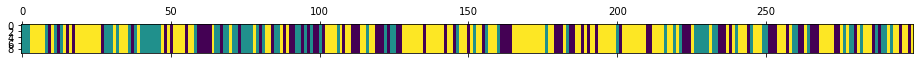

<Figure size 432x288 with 0 Axes>

697
N [[28. 23. 29.]
 [18. 27. 30.]
 [34. 25. 85.]]
alphas [[1.5731819  1.45475732 0.71344637]
 [1.059446   1.96849321 0.71344637]
 [1.059446   1.45475732 1.22718227]]
M [[6. 3. 2.]
 [4. 5. 1.]
 [2. 7. 6.]]
sum_w [[4.]
 [1.]
 [3.]]
barM [[2. 3. 2.]
 [4. 4. 1.]
 [2. 7. 3.]]
pi_z [[0.29401311 0.38661321 0.31937369]
 [0.21367016 0.40829267 0.37803716]
 [0.17238192 0.17021505 0.65740303]]
beta_vec [0.32075985 0.32207537 0.35716478]
hyper>> a_k: 3.2742595001026404  gamma: 1.4904827471230782  rho: 0.3585863417691516


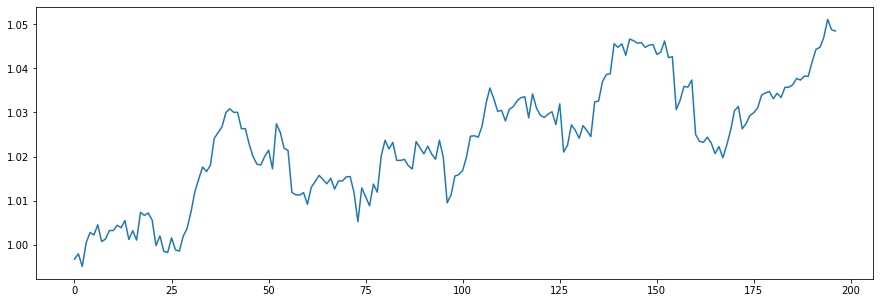

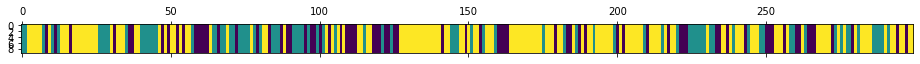

<Figure size 432x288 with 0 Axes>

N [[26. 24. 25.]
 [15. 34. 33.]
 [34. 24. 84.]]
alphas [[1.84775007 0.67640812 0.75010131]
 [0.67364534 1.85051285 0.75010131]
 [0.67364534 0.67640812 1.92420605]]
M [[ 5.  1.  4.]
 [ 2.  5.  3.]
 [ 5.  6. 11.]]
sum_w [[ 4.]
 [ 4.]
 [10.]]
barM [[1. 1. 4.]
 [2. 1. 3.]
 [5. 6. 1.]]
pi_z [[0.46074814 0.23442553 0.30482634]
 [0.12375443 0.41896951 0.45727606]
 [0.20644293 0.14288492 0.65067215]]
beta_vec [0.22490333 0.45594195 0.31915472]
hyper>> a_k: 4.022025455687091  gamma: 0.5448245678596525  rho: 0.43177354858400097


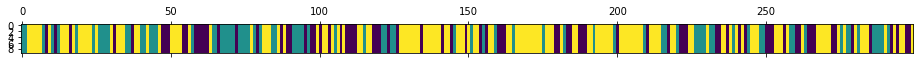

<Figure size 432x288 with 0 Axes>

698
N [[30. 24. 26.]
 [12. 32. 35.]
 [38. 23. 79.]]
alphas [[2.25060305 1.04201942 0.72940298]
 [0.51399885 2.77862363 0.72940298]
 [0.51399885 1.04201942 2.46600719]]
M [[5. 5. 1.]
 [2. 9. 2.]
 [3. 4. 9.]]
sum_w [[5.]
 [4.]
 [6.]]
barM [[0. 5. 1.]
 [2. 5. 2.]
 [3. 4. 3.]]
pi_z [[0.48866425 0.27153711 0.23979864]
 [0.11240484 0.41127421 0.47632095]
 [0.20278769 0.19128997 0.60592234]]
beta_vec [0.16847771 0.61795631 0.21356599]
hyper>> a_k: 3.7787919811424993  gamma: 0.6947685103673796  rho: 0.4485848643851189


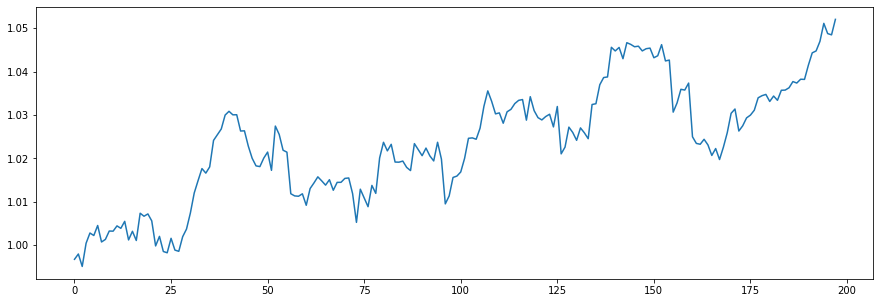

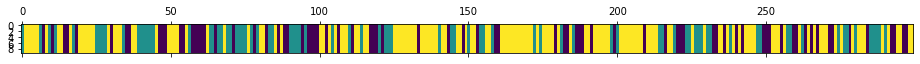

<Figure size 432x288 with 0 Axes>

N [[28. 23. 27.]
 [14. 33. 34.]
 [36. 25. 79.]]
alphas [[2.04616303 1.28762511 0.44500384]
 [0.35105415 2.982734   0.44500384]
 [0.35105415 1.28762511 2.14011273]]
M [[5. 3. 3.]
 [2. 8. 3.]
 [1. 4. 7.]]
sum_w [[4.]
 [4.]
 [6.]]
barM [[1. 3. 3.]
 [2. 4. 3.]
 [1. 4. 1.]]
pi_z [[0.40517375 0.22819613 0.36663011]
 [0.14400379 0.39100574 0.46499047]
 [0.23564042 0.1943331  0.57002648]]
beta_vec [0.14476925 0.50293817 0.35229258]
hyper>> a_k: 3.3176101699014016  gamma: 2.031162161797651  rho: 0.37118958755812165


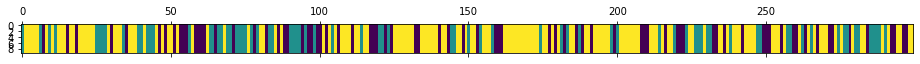

<Figure size 432x288 with 0 Axes>

699
N [[24. 20. 34.]
 [17. 28. 30.]
 [37. 27. 82.]]
alphas [[1.53347241 1.04920337 0.73493439]
 [0.30201006 2.28066572 0.73493439]
 [0.30201006 1.04920337 1.96639674]]
M [[6. 3. 4.]
 [1. 6. 5.]
 [2. 4. 9.]]
sum_w [[4.]
 [4.]
 [6.]]
barM [[2. 3. 4.]
 [1. 2. 5.]
 [2. 4. 3.]]
pi_z [[0.35544179 0.23495342 0.40960479]
 [0.20642112 0.35648217 0.43709671]
 [0.30730876 0.18629156 0.50639968]]
beta_vec [0.32637754 0.18793406 0.4856884 ]
hyper>> a_k: 4.453360722706731  gamma: 1.0344533518255203  rho: 0.3152482542594711


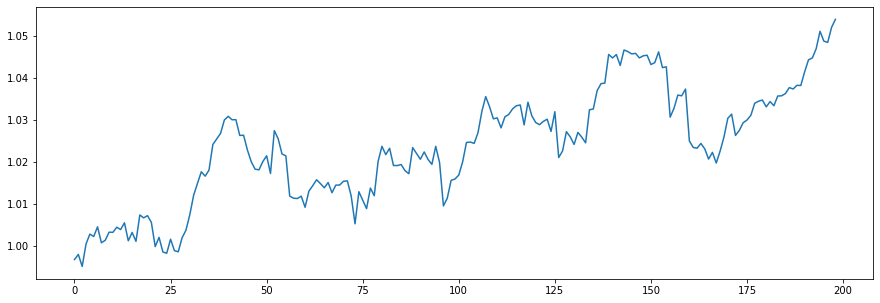

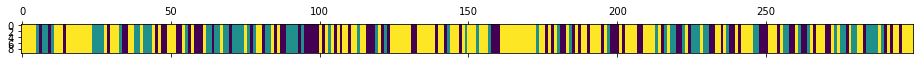

<Figure size 432x288 with 0 Axes>

N [[27. 22. 36.]
 [16. 28. 29.]
 [42. 23. 76.]]
alphas [[2.39918506 0.57309485 1.48108081]
 [0.99527086 1.97700905 1.48108081]
 [0.99527086 0.57309485 2.88499501]]
M [[ 6.  3.  3.]
 [ 3.  5.  5.]
 [ 3.  3. 11.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[3. 3. 3.]
 [3. 4. 5.]
 [3. 3. 7.]]
pi_z [[0.252752   0.30530909 0.44193891]
 [0.2437484  0.38116908 0.37508252]
 [0.29422626 0.16071976 0.54505399]]
beta_vec [0.19769802 0.48481889 0.31748309]
hyper>> a_k: 3.0919163910786343  gamma: 0.8610457969868031  rho: 0.14233487998772612


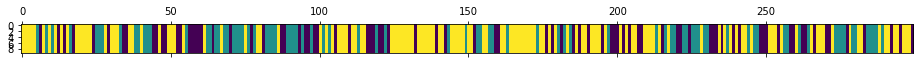

<Figure size 432x288 with 0 Axes>

700
N [[26. 24. 34.]
 [18. 33. 32.]
 [39. 26. 67.]]
alphas [[0.96434886 1.28565673 0.84191081]
 [0.52426131 1.72574428 0.84191081]
 [0.52426131 1.28565673 1.28199836]]
M [[6. 4. 3.]
 [1. 2. 3.]
 [1. 5. 4.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[4. 4. 3.]
 [1. 1. 3.]
 [1. 5. 1.]]
pi_z [[0.35662073 0.25585757 0.38752169]
 [0.15406607 0.44351561 0.40241832]
 [0.32442267 0.20289595 0.47268139]]
beta_vec [0.34360665 0.37349474 0.28289861]
hyper>> a_k: 1.9074246630773823  gamma: 1.3369345651785058  rho: 0.2513672695722928


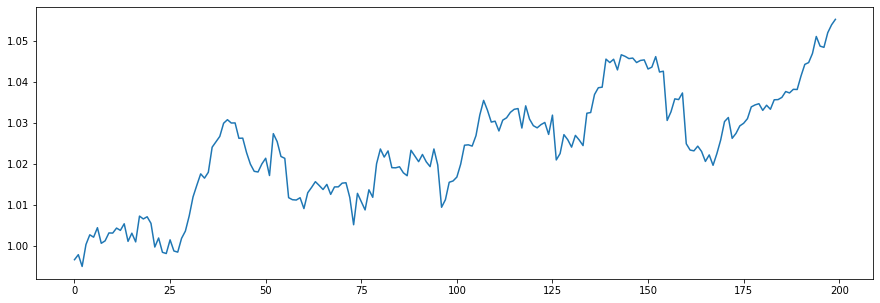

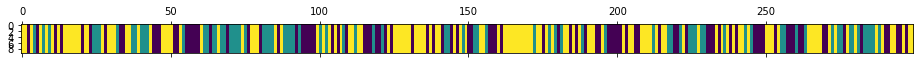

<Figure size 432x288 with 0 Axes>

N [[36. 23. 37.]
 [15. 29. 34.]
 [45. 26. 54.]]
alphas [[0.97012087 0.53333574 0.40396805]
 [0.49065674 1.01279987 0.40396805]
 [0.49065674 0.53333574 0.88343218]]
M [[1. 3. 2.]
 [4. 6. 2.]
 [3. 1. 4.]]
sum_w [[0.]
 [4.]
 [2.]]
barM [[1. 3. 2.]
 [4. 2. 2.]
 [3. 1. 2.]]
pi_z [[0.34916378 0.25575538 0.39508083]
 [0.18480001 0.41112191 0.40407808]
 [0.40364905 0.17404288 0.42230807]]
beta_vec [0.4094185  0.40612605 0.18445545]
hyper>> a_k: 1.8351967531502864  gamma: 1.176157626477616  rho: 0.2409888063875083


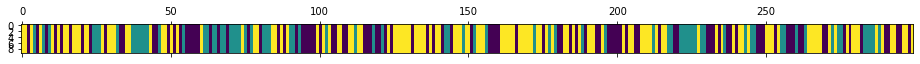

<Figure size 432x288 with 0 Axes>

701
N [[37. 24. 41.]
 [18. 30. 26.]
 [47. 20. 56.]]
alphas [[1.01255519 0.56570714 0.25693443]
 [0.57029331 1.00796901 0.25693443]
 [0.57029331 0.56570714 0.6991963 ]]
M [[4. 4. 2.]
 [2. 2. 1.]
 [3. 1. 3.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[3. 4. 2.]
 [2. 1. 1.]
 [3. 1. 1.]]
pi_z [[0.35699556 0.2080699  0.43493454]
 [0.21098938 0.46016993 0.32884069]
 [0.38024137 0.1325429  0.48721574]]
beta_vec [0.48572076 0.21469938 0.29957986]
hyper>> a_k: 1.7749199465982908  gamma: 2.7421006927470737  rho: 0.1602169911405927


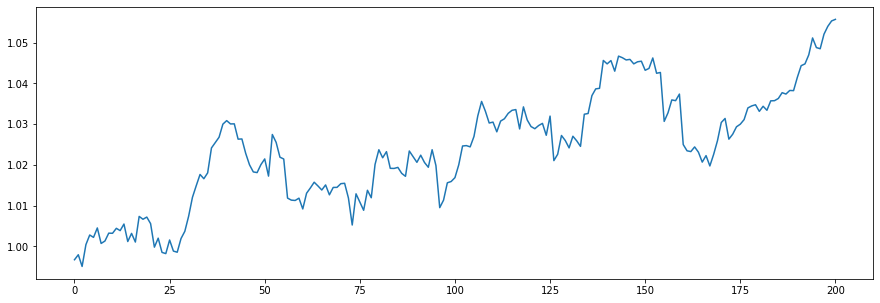

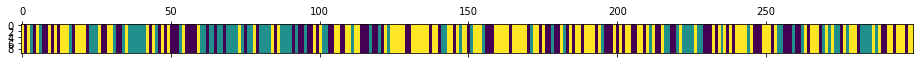

<Figure size 432x288 with 0 Axes>

N [[33. 24. 42.]
 [21. 32. 27.]
 [45. 24. 51.]]
alphas [[1.00836226 0.32001964 0.44653805]
 [0.72398992 0.60439198 0.44653805]
 [0.72398992 0.32001964 0.73091038]]
M [[2. 4. 2.]
 [4. 3. 1.]
 [2. 1. 5.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[1. 4. 2.]
 [4. 1. 1.]
 [2. 1. 2.]]
pi_z [[0.31081756 0.25704191 0.43214053]
 [0.26797293 0.41063247 0.3213946 ]
 [0.3719733  0.18749524 0.44053146]]
beta_vec [0.31456897 0.37827491 0.30715612]
hyper>> a_k: 1.500206017552232  gamma: 0.8424474743135498  rho: 0.3183490678674983


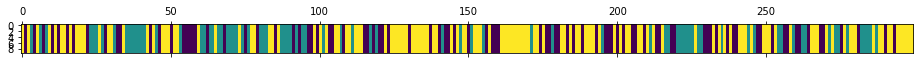

<Figure size 432x288 with 0 Axes>

702
N [[26. 26. 39.]
 [16. 33. 30.]
 [49. 20. 60.]]
alphas [[0.79927271 0.38683029 0.31410302]
 [0.32168353 0.86441947 0.31410302]
 [0.32168353 0.38683029 0.79169221]]
M [[4. 3. 1.]
 [4. 3. 2.]
 [3. 3. 5.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[0. 3. 1.]
 [4. 1. 2.]
 [3. 3. 2.]]
pi_z [[0.35314565 0.2424771  0.40437726]
 [0.19955564 0.46716953 0.33327483]
 [0.3514167  0.16659255 0.48199075]]
beta_vec [0.33107886 0.28363336 0.38528778]
hyper>> a_k: 1.7782264331025204  gamma: 0.06537161759401144  rho: 0.27876179190427247


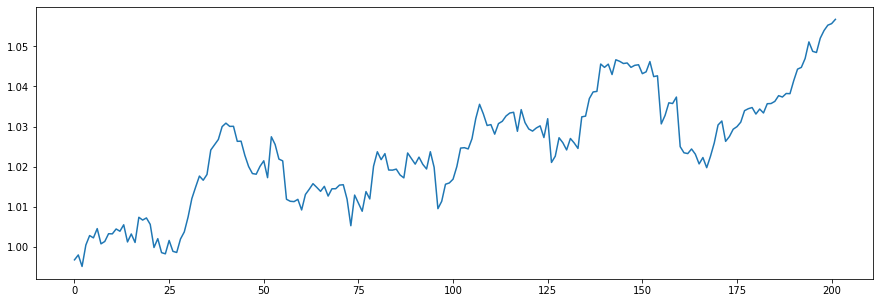

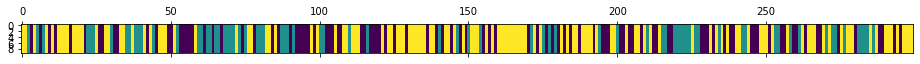

<Figure size 432x288 with 0 Axes>

N [[33. 26. 42.]
 [18. 29. 27.]
 [50. 19. 55.]]
alphas [[0.92031845 0.36376683 0.49414115]
 [0.42461687 0.85946842 0.49414115]
 [0.42461687 0.36376683 0.98984274]]
M [[5. 3. 6.]
 [4. 3. 4.]
 [4. 1. 5.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[4. 3. 6.]
 [4. 1. 4.]
 [4. 1. 4.]]
pi_z [[0.28259245 0.25613289 0.46127466]
 [0.30016984 0.45564391 0.24418625]
 [0.39776546 0.1675347  0.43469984]]
beta_vec [0.41844616 0.25685669 0.32469716]
hyper>> a_k: 3.1092022059207283  gamma: 0.489935463401425  rho: 0.07403609142371284


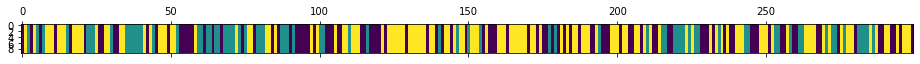

<Figure size 432x288 with 0 Axes>

703
N [[36. 25. 40.]
 [17. 30. 26.]
 [48. 18. 59.]]
alphas [[1.43490344 0.73949272 0.93480605]
 [1.20471026 0.96968589 0.93480605]
 [1.20471026 0.73949272 1.16499923]]
M [[5. 2. 3.]
 [4. 6. 3.]
 [3. 2. 5.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[4. 2. 3.]
 [4. 3. 3.]
 [3. 2. 1.]]
pi_z [[0.36464175 0.2398063  0.39555194]
 [0.16330762 0.38626022 0.45043216]
 [0.42496157 0.16463642 0.41040201]]
beta_vec [0.2697863  0.27217671 0.45803699]
hyper>> a_k: 3.534141846625541  gamma: 0.15880441339470963  rho: 0.24906241952648156


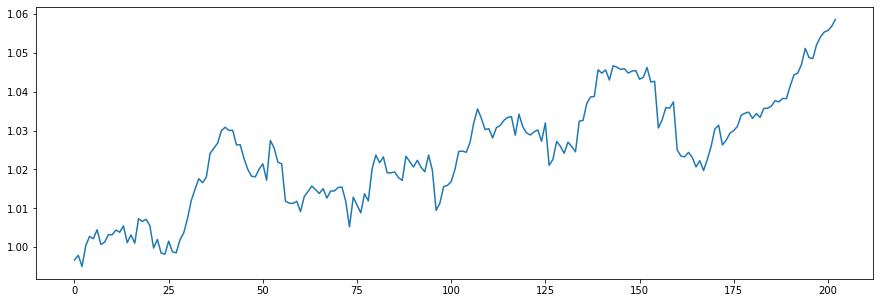

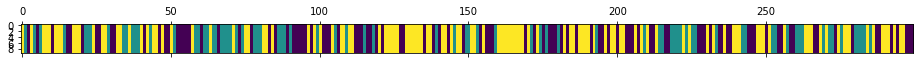

<Figure size 432x288 with 0 Axes>

N [[38. 27. 37.]
 [18. 29. 31.]
 [46. 22. 51.]]
alphas [[1.59621316 0.72233518 1.21559351]
 [0.71599124 1.6025571  1.21559351]
 [0.71599124 0.72233518 2.09581543]]
M [[5. 3. 3.]
 [1. 2. 6.]
 [6. 3. 6.]]
sum_w [[3.]
 [2.]
 [2.]]
barM [[2. 3. 3.]
 [1. 0. 6.]
 [6. 3. 4.]]
pi_z [[0.33858857 0.28089564 0.38051578]
 [0.20427012 0.42886719 0.36686269]
 [0.37150814 0.19102109 0.43747077]]
beta_vec [0.23138563 0.22867201 0.53994236]
hyper>> a_k: 2.607432643913469  gamma: 0.9613612333142691  rho: 0.2698264287355129


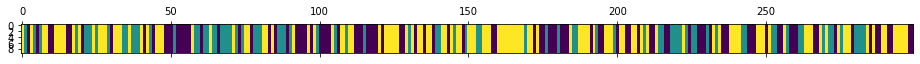

<Figure size 432x288 with 0 Axes>

704
N [[43. 24. 33.]
 [20. 30. 30.]
 [37. 26. 56.]]
alphas [[1.14408434 0.4353637  1.0279846 ]
 [0.44053011 1.13891794 1.0279846 ]
 [0.44053011 0.4353637  1.73153884]]
M [[6. 2. 6.]
 [5. 8. 3.]
 [2. 3. 4.]]
sum_w [[2.]
 [8.]
 [2.]]
barM [[4. 2. 6.]
 [5. 0. 3.]
 [2. 3. 2.]]
pi_z [[0.43897404 0.22281187 0.33821409]
 [0.35028165 0.2703674  0.37935095]
 [0.28178465 0.1869649  0.53125044]]
beta_vec [0.46223097 0.23731112 0.30045792]
hyper>> a_k: 3.242747721509635  gamma: 0.5320323908930802  rho: 0.33311958923543544


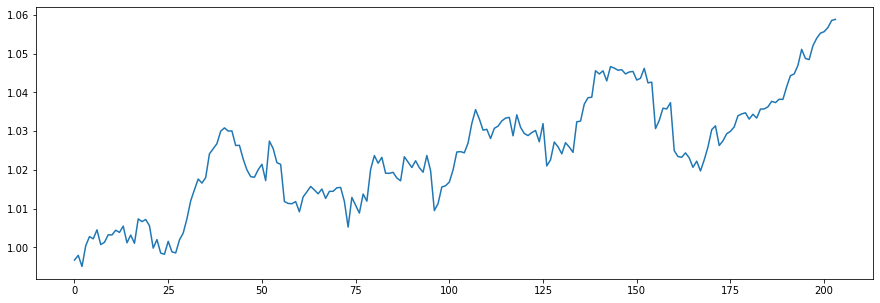

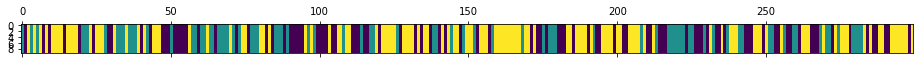

<Figure size 432x288 with 0 Axes>

N [[37. 27. 34.]
 [22. 33. 26.]
 [38. 21. 61.]]
alphas [[2.07980878 0.5131912  0.64974774]
 [0.99958599 1.59341399 0.64974774]
 [0.99958599 0.5131912  1.72997053]]
M [[5. 3. 5.]
 [3. 3. 2.]
 [5. 3. 6.]]
sum_w [[0.]
 [0.]
 [5.]]
barM [[5. 3. 5.]
 [3. 3. 2.]
 [5. 3. 1.]]
pi_z [[0.37035948 0.30601141 0.32362911]
 [0.27630695 0.41084492 0.31284813]
 [0.33607688 0.16226979 0.50165333]]
beta_vec [0.53574494 0.33365333 0.13060173]
hyper>> a_k: 2.4624750049888573  gamma: 1.6035372993304977  rho: 0.26532837435110973


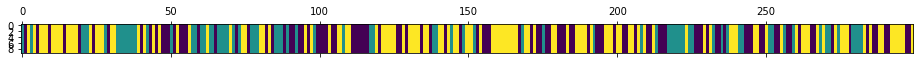

<Figure size 432x288 with 0 Axes>

705
N [[41. 21. 43.]
 [19. 32. 22.]
 [45. 20. 56.]]
alphas [[1.6225863  0.60361575 0.23627296]
 [0.96922181 1.25698024 0.23627296]
 [0.96922181 0.60361575 0.88963745]]
M [[7. 2. 2.]
 [3. 5. 2.]
 [2. 2. 2.]]
sum_w [[5.]
 [4.]
 [2.]]
barM [[2. 2. 2.]
 [3. 1. 2.]
 [2. 2. 0.]]
pi_z [[0.42126485 0.18015953 0.39857562]
 [0.21934846 0.56176481 0.21888674]
 [0.27061231 0.1781393  0.55124839]]
beta_vec [0.49927682 0.12558566 0.37513753]
hyper>> a_k: 1.919966895735935  gamma: 1.0700457080714523  rho: 0.40332047225368334


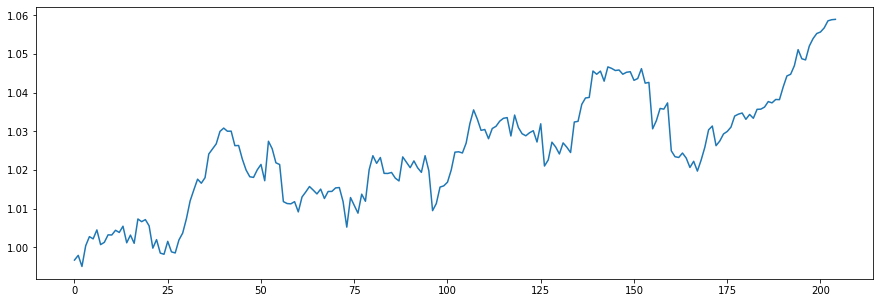

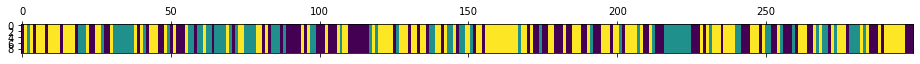

<Figure size 432x288 with 0 Axes>

N [[42. 20. 35.]
 [14. 37. 27.]
 [41. 21. 62.]]
alphas [[1.34633594 0.14387155 0.4297594 ]
 [0.57197399 0.9182335  0.4297594 ]
 [0.57197399 0.14387155 1.20412136]]
M [[3. 2. 2.]
 [2. 4. 3.]
 [1. 1. 7.]]
sum_w [[2.]
 [4.]
 [6.]]
barM [[1. 2. 2.]
 [2. 0. 3.]
 [1. 1. 1.]]
pi_z [[0.4324011  0.22267787 0.34492103]
 [0.15193286 0.5866374  0.26142974]
 [0.40524076 0.13647145 0.4582878 ]]
beta_vec [0.1820818  0.34655693 0.47136127]
hyper>> a_k: 2.328738916796886  gamma: 1.853243218401062  rho: 0.5668643021705664


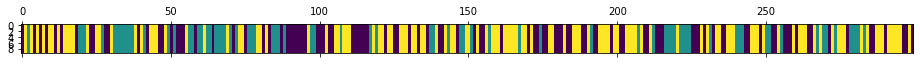

<Figure size 432x288 with 0 Axes>

706
N [[43. 20. 41.]
 [14. 34. 27.]
 [47. 21. 52.]]
alphas [[1.50373758 0.3495581  0.47544324]
 [0.18365862 1.66963706 0.47544324]
 [0.18365862 0.3495581  1.7955222 ]]
M [[6. 3. 7.]
 [1. 5. 2.]
 [1. 3. 2.]]
sum_w [[5.]
 [4.]
 [2.]]
barM [[1. 3. 7.]
 [1. 1. 2.]
 [1. 3. 0.]]
pi_z [[0.36915551 0.23847394 0.39237055]
 [0.23735544 0.40331412 0.35933044]
 [0.41426143 0.18221242 0.40352615]]
beta_vec [0.14642373 0.36636847 0.4872078 ]
hyper>> a_k: 2.6272069621647085  gamma: 0.6188114791134062  rho: 0.34407061280624696


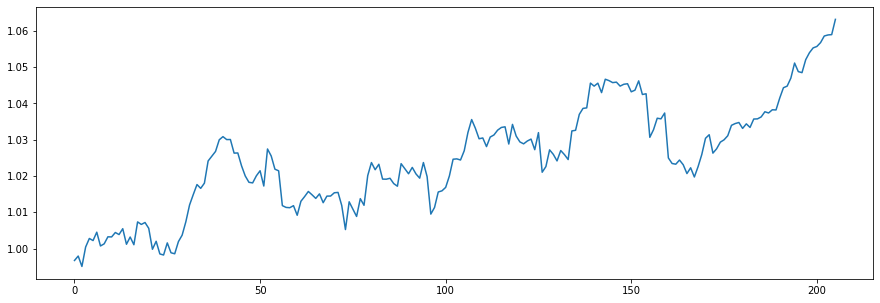

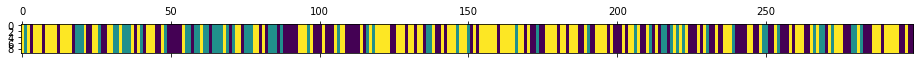

<Figure size 432x288 with 0 Axes>

N [[45. 19. 42.]
 [13. 20. 28.]
 [48. 22. 62.]]
alphas [[1.15627119 0.63134895 0.83958682]
 [0.25232648 1.53529366 0.83958682]
 [0.25232648 0.63134895 1.74353152]]
M [[6. 3. 3.]
 [3. 3. 3.]
 [2. 2. 4.]]
sum_w [[4.]
 [1.]
 [1.]]
barM [[2. 3. 3.]
 [3. 2. 3.]
 [2. 2. 3.]]
pi_z [[0.37030125 0.16364857 0.46605018]
 [0.2057423  0.48733048 0.30692722]
 [0.40201657 0.15277081 0.44521262]]
beta_vec [0.375259   0.33539239 0.28934861]
hyper>> a_k: 2.4078919243801264  gamma: 0.31799010982022896  rho: 0.17957878934356805


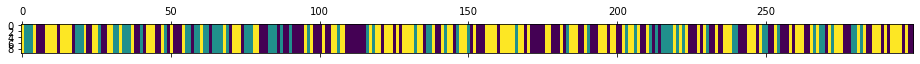

<Figure size 432x288 with 0 Axes>

707
N [[51. 18. 40.]
 [16. 25. 28.]
 [42. 26. 53.]]
alphas [[1.17372508 0.66256284 0.57160401]
 [0.74131876 1.09496916 0.57160401]
 [0.74131876 0.66256284 1.00401032]]
M [[7. 2. 3.]
 [5. 1. 3.]
 [3. 4. 4.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[4. 2. 3.]
 [5. 0. 3.]
 [3. 4. 3.]]
pi_z [[0.52462554 0.17680408 0.29857037]
 [0.16366001 0.3528518  0.48348819]
 [0.36515818 0.19819877 0.43664305]]
beta_vec [0.41348017 0.12649742 0.46002241]
hyper>> a_k: 2.5758637294307256  gamma: 3.041165660132948  rho: 0.23010550689314577


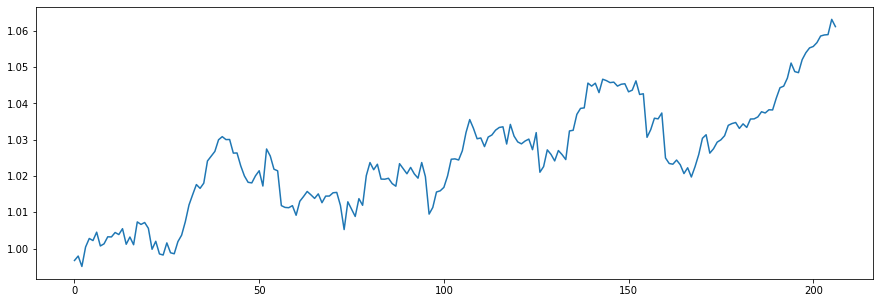

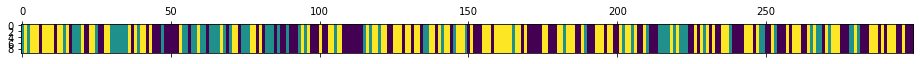

<Figure size 432x288 with 0 Axes>

N [[51. 17. 39.]
 [16. 26. 30.]
 [40. 29. 51.]]
alphas [[1.41271087 0.2508625  0.91229036]
 [0.81999044 0.84358293 0.91229036]
 [0.81999044 0.2508625  1.50501079]]
M [[6. 2. 6.]
 [4. 5. 5.]
 [4. 1. 5.]]
sum_w [[2.]
 [4.]
 [2.]]
barM [[4. 2. 6.]
 [4. 1. 5.]
 [4. 1. 3.]]
pi_z [[0.54812682 0.12733371 0.32453947]
 [0.13957813 0.43931131 0.42111056]
 [0.32217848 0.27310221 0.40471931]]
beta_vec [0.31791328 0.1734918  0.50859492]
hyper>> a_k: 4.215148398855147  gamma: 0.6765203346394392  rho: 0.2531263170801471


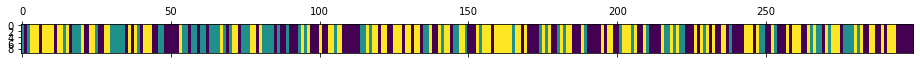

<Figure size 432x288 with 0 Axes>

708
N [[55. 19. 38.]
 [19. 28. 29.]
 [38. 29. 44.]]
alphas [[2.06781431 0.54618401 1.60115008]
 [1.00084932 1.613149   1.60115008]
 [1.00084932 0.54618401 2.66811507]]
M [[8. 2. 5.]
 [3. 7. 8.]
 [6. 3. 9.]]
sum_w [[4.]
 [4.]
 [4.]]
barM [[4. 2. 5.]
 [3. 3. 8.]
 [6. 3. 5.]]
pi_z [[0.49823449 0.15323167 0.34853384]
 [0.26183758 0.39985595 0.33830647]
 [0.29602232 0.32396113 0.38001655]]
beta_vec [0.34425678 0.25982065 0.39592257]
hyper>> a_k: 4.1876041207838695  gamma: 0.7782516908013447  rho: 0.22178202766390184


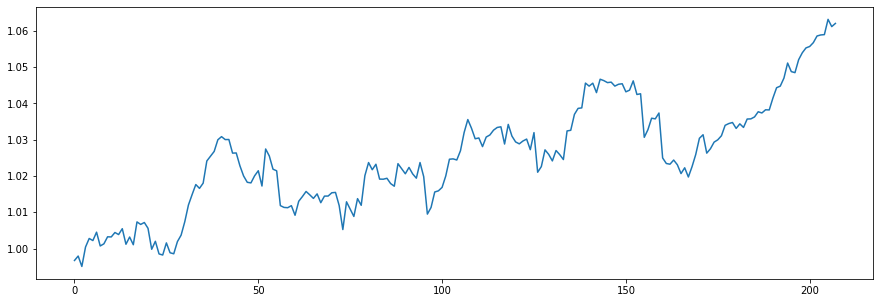

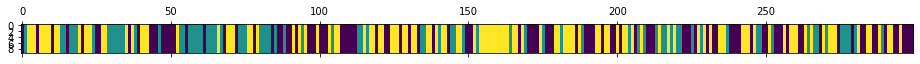

<Figure size 432x288 with 0 Axes>

N [[48. 23. 34.]
 [16. 31. 31.]
 [41. 24. 51.]]
alphas [[2.05062302 0.84672141 1.29025969]
 [1.12188769 1.77545674 1.29025969]
 [1.12188769 0.84672141 2.21899502]]
M [[6. 5. 3.]
 [2. 4. 3.]
 [3. 3. 7.]]
sum_w [[0.]
 [1.]
 [3.]]
barM [[6. 5. 3.]
 [2. 3. 3.]
 [3. 3. 4.]]
pi_z [[0.40259042 0.21273903 0.38467055]
 [0.26987607 0.34110639 0.38901754]
 [0.43505793 0.28791436 0.27702771]]
beta_vec [0.24317247 0.24638296 0.51044457]
hyper>> a_k: 4.1223231342933735  gamma: 0.2723169828175561  rho: 0.27938287423037345


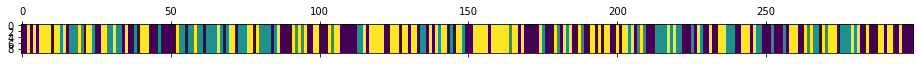

<Figure size 432x288 with 0 Axes>

709
N [[51. 24. 37.]
 [17. 28. 30.]
 [44. 23. 45.]]
alphas [[1.87407869 0.73190932 1.51633513]
 [0.7223722  1.8836158  1.51633513]
 [0.7223722  0.73190932 2.66804162]]
M [[10.  2.  6.]
 [ 2.  3.  3.]
 [ 1.  3.  8.]]
sum_w [[5.]
 [2.]
 [4.]]
barM [[5. 2. 6.]
 [2. 1. 3.]
 [1. 3. 4.]]
pi_z [[0.46598035 0.18173357 0.35228607]
 [0.21659899 0.38328127 0.40011973]
 [0.28950652 0.27726566 0.43322783]]
beta_vec [0.29044927 0.27209477 0.43745596]
hyper>> a_k: 3.2874435998214584  gamma: 1.1882894461161795  rho: 0.26917842244291207


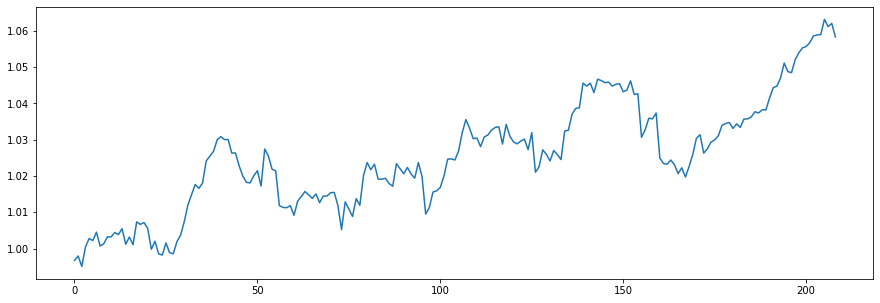

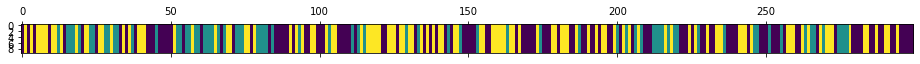

<Figure size 432x288 with 0 Axes>

N [[57. 24. 38.]
 [17. 25. 29.]
 [45. 22. 42.]]
alphas [[1.58272334 0.65371714 1.05100312]
 [0.69781446 1.53862602 1.05100312]
 [0.69781446 0.65371714 1.935912  ]]
M [[8. 1. 2.]
 [2. 6. 4.]
 [2. 3. 3.]]
sum_w [[6.]
 [1.]
 [1.]]
barM [[2. 1. 2.]
 [2. 5. 4.]
 [2. 3. 2.]]
pi_z [[0.48929906 0.19023555 0.32046539]
 [0.23412304 0.2708285  0.49504846]
 [0.49779262 0.17227835 0.32992903]]
beta_vec [0.31460889 0.42214814 0.26324297]
hyper>> a_k: 2.9054761514110177  gamma: 1.9649097005386762  rho: 0.36647469560434076


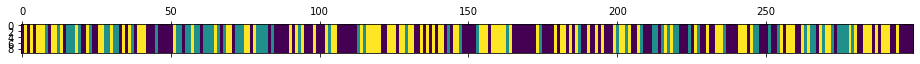

<Figure size 432x288 with 0 Axes>

710
N [[62. 25. 36.]
 [16. 22. 32.]
 [45. 23. 38.]]
alphas [[1.64388176 0.77704498 0.4845494 ]
 [0.57909828 1.84182847 0.4845494 ]
 [0.57909828 0.77704498 1.54933289]]
M [[5. 4. 3.]
 [3. 4. 2.]
 [5. 2. 6.]]
sum_w [[4.]
 [4.]
 [4.]]
barM [[1. 4. 3.]
 [3. 0. 2.]
 [5. 2. 2.]]
pi_z [[0.51286254 0.20038258 0.28675488]
 [0.21132884 0.28297455 0.5056966 ]
 [0.41160011 0.14911236 0.43928753]]
beta_vec [0.49762377 0.23440344 0.26797279]
hyper>> a_k: 4.435219178227981  gamma: 0.27040504214124284  rho: 0.2727862609973121


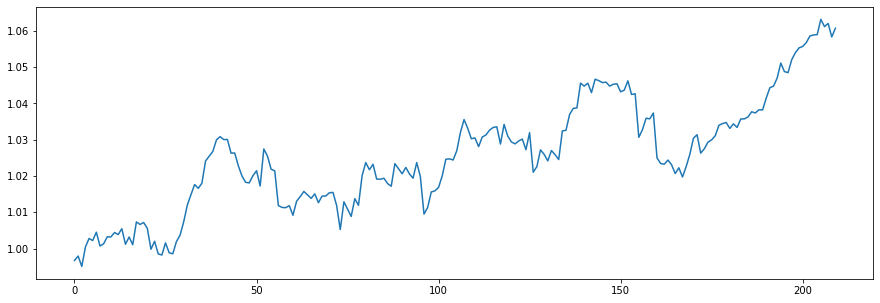

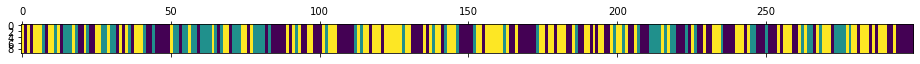

<Figure size 432x288 with 0 Axes>

N [[55. 22. 35.]
 [15. 24. 32.]
 [42. 25. 49.]]
alphas [[2.81487884 0.75603367 0.86430667]
 [1.60501198 1.96590053 0.86430667]
 [1.60501198 0.75603367 2.07417352]]
M [[10.  2.  3.]
 [ 4.  4.  4.]
 [ 6.  4.  8.]]
sum_w [[4.]
 [4.]
 [6.]]
barM [[6. 2. 3.]
 [4. 0. 4.]
 [6. 4. 2.]]
pi_z [[0.48604842 0.18790467 0.32604691]
 [0.22156717 0.35625752 0.4221753 ]
 [0.43906044 0.18453228 0.37640728]]
beta_vec [0.62290313 0.20786542 0.16923145]
hyper>> a_k: 3.756586927228991  gamma: 0.6370812137165481  rho: 0.3325093399394113


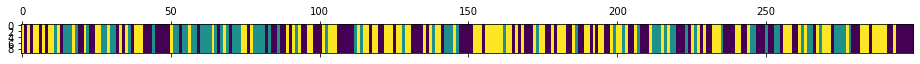

<Figure size 432x288 with 0 Axes>

711
N [[55. 23. 36.]
 [14. 26. 33.]
 [45. 24. 43.]]
alphas [[2.81102154 0.52121978 0.4243456 ]
 [1.5619213  1.77032002 0.4243456 ]
 [1.5619213  0.52121978 1.67344584]]
M [[8. 2. 1.]
 [5. 7. 2.]
 [4. 2. 8.]]
sum_w [[5.]
 [4.]
 [6.]]
barM [[3. 2. 1.]
 [5. 3. 2.]
 [4. 2. 2.]]
pi_z [[0.5439225  0.15066863 0.30540888]
 [0.1539907  0.49054104 0.35546826]
 [0.34241164 0.24015595 0.4174324 ]]
beta_vec [0.50315009 0.35122607 0.14562384]
hyper>> a_k: 3.294044161215312  gamma: 1.2156438534424656  rho: 0.42643339357698556


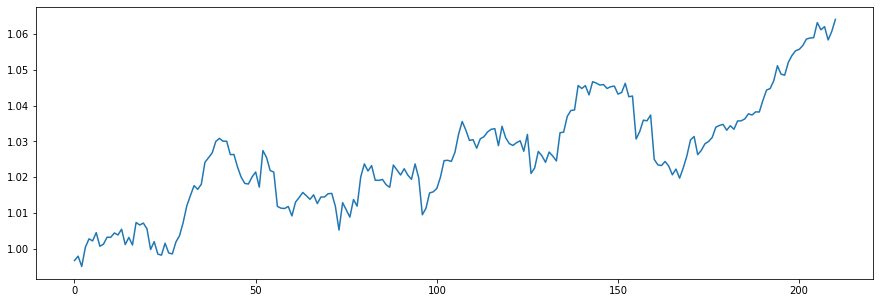

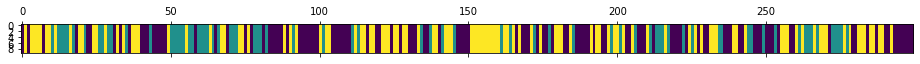

<Figure size 432x288 with 0 Axes>

N [[63. 22. 33.]
 [15. 26. 31.]
 [40. 24. 45.]]
alphas [[2.35531894 0.66359028 0.27513494]
 [0.95062851 2.06828071 0.27513494]
 [0.95062851 0.66359028 1.67982537]]
M [[ 7.  1.  1.]
 [ 1.  9.  1.]
 [ 5.  3. 12.]]
sum_w [[ 6.]
 [ 7.]
 [11.]]
barM [[1. 1. 1.]
 [1. 2. 1.]
 [5. 3. 1.]]
pi_z [[0.64591692 0.14141847 0.21266461]
 [0.22502388 0.3411708  0.43380533]
 [0.41717055 0.15625366 0.42657579]]
beta_vec [0.3791084  0.33384695 0.28704465]
hyper>> a_k: 3.9966946091972346  gamma: 0.6206086654857627  rho: 0.5063409517486691


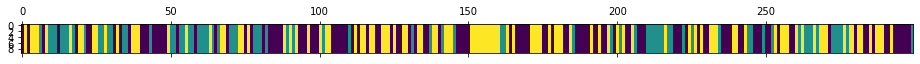

<Figure size 432x288 with 0 Axes>

712
N [[60. 23. 36.]
 [19. 30. 26.]
 [41. 21. 43.]]
alphas [[2.77167271 0.65868152 0.56634037]
 [0.74798256 2.68237167 0.56634037]
 [0.74798256 0.65868152 2.59003053]]
M [[16.  2.  2.]
 [ 4.  7.  6.]
 [ 3.  2.  8.]]
sum_w [[9.]
 [3.]
 [6.]]
barM [[7. 2. 2.]
 [4. 4. 6.]
 [3. 2. 2.]]
pi_z [[0.55400822 0.19874652 0.24724526]
 [0.24573875 0.37240633 0.38185491]
 [0.30712208 0.2626779  0.43020002]]
beta_vec [0.62568665 0.16422506 0.21008829]
hyper>> a_k: 5.290855496910255  gamma: 1.1481374568183147  rho: 0.33147970164160884


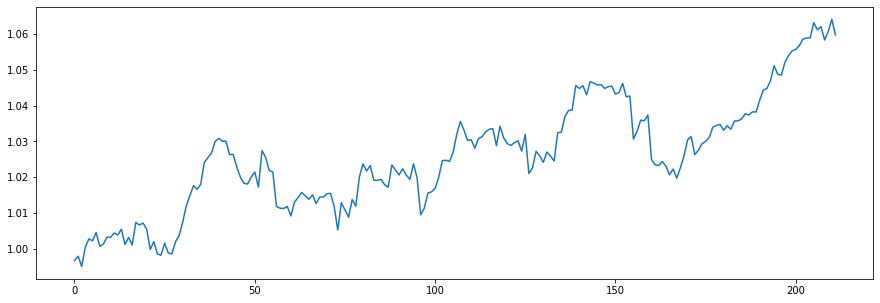

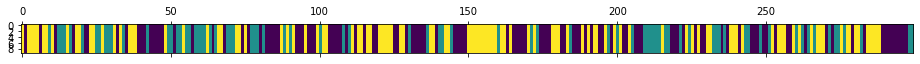

<Figure size 432x288 with 0 Axes>

N [[58. 25. 32.]
 [22. 26. 29.]
 [35. 26. 46.]]
alphas [[3.9668926  0.58087131 0.74309159]
 [2.2130814  2.33468251 0.74309159]
 [2.2130814  0.58087131 2.49690279]]
M [[9. 2. 4.]
 [5. 5. 4.]
 [8. 4. 9.]]
sum_w [[6.]
 [4.]
 [7.]]
barM [[3. 2. 4.]
 [5. 1. 4.]
 [8. 4. 2.]]
pi_z [[0.48997256 0.17856179 0.33146565]
 [0.2610786  0.31586855 0.42305285]
 [0.36949137 0.25684659 0.37366204]]
beta_vec [0.51467845 0.17579256 0.30952898]
hyper>> a_k: 5.195644747944847  gamma: 1.1309721696310475  rho: 0.34581084308856597


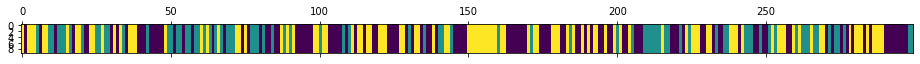

<Figure size 432x288 with 0 Axes>

713
N [[57. 29. 31.]
 [25. 28. 27.]
 [35. 23. 44.]]
alphas [[3.54606863 0.5975074  1.05206872]
 [1.74935833 2.39421769 1.05206872]
 [1.74935833 0.5975074  2.84877901]]
M [[9. 2. 5.]
 [3. 5. 6.]
 [6. 4. 6.]]
sum_w [[6.]
 [3.]
 [3.]]
barM [[3. 2. 5.]
 [3. 2. 6.]
 [6. 4. 3.]]
pi_z [[0.47449819 0.24458909 0.28091272]
 [0.24277862 0.34782423 0.40939715]
 [0.29490245 0.21406742 0.49103014]]
beta_vec [0.45995596 0.10952094 0.43052309]
hyper>> a_k: 4.400044265635175  gamma: 0.5892142645202342  rho: 0.2837098732185236


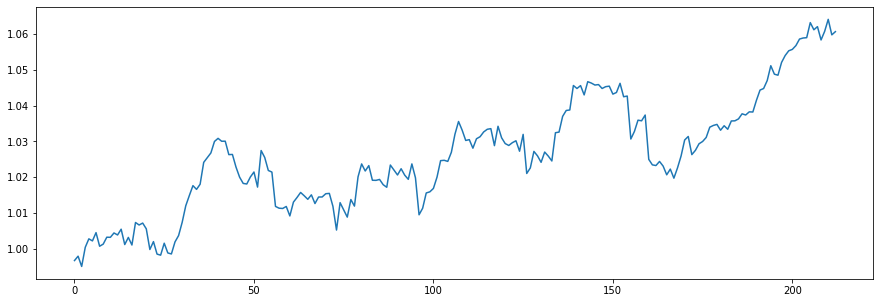

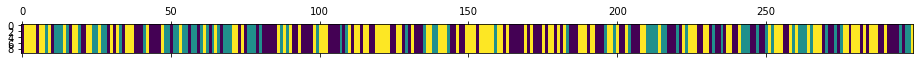

<Figure size 432x288 with 0 Axes>

N [[49. 25. 39.]
 [24. 22. 27.]
 [40. 25. 48.]]
alphas [[2.69798301 0.34517807 1.35688319]
 [1.44964701 1.59351407 1.35688319]
 [1.44964701 0.34517807 2.60521919]]
M [[7. 3. 6.]
 [5. 5. 4.]
 [7. 2. 8.]]
sum_w [[1.]
 [5.]
 [2.]]
barM [[6. 3. 6.]
 [5. 0. 4.]
 [7. 2. 6.]]
pi_z [[0.53783155 0.16172146 0.30044699]
 [0.39256403 0.28323432 0.32420165]
 [0.37967442 0.18076696 0.43955862]]
beta_vec [0.40345327 0.08441161 0.51213512]
hyper>> a_k: 4.5608417679954325  gamma: 0.4047636735032432  rho: 0.16915495878163614


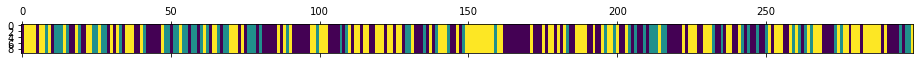

<Figure size 432x288 with 0 Axes>

714
N [[54. 27. 36.]
 [24. 16. 26.]
 [39. 23. 54.]]
alphas [[2.30031575 0.31986536 1.94066065]
 [1.52882675 1.09135436 1.94066065]
 [1.52882675 0.31986536 2.71214965]]
M [[11.  2.  6.]
 [ 6.  3.  5.]
 [10.  4.  8.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[10.  2.  6.]
 [ 6.  2.  5.]
 [10.  4.  7.]]
pi_z [[0.46176452 0.2201436  0.31809189]
 [0.41702496 0.21377056 0.36920448]
 [0.36664033 0.19315233 0.44020734]]
beta_vec [0.47075491 0.22211169 0.3071334 ]
hyper>> a_k: 5.288621728221403  gamma: 0.34082933019011885  rho: 0.0715079764858354


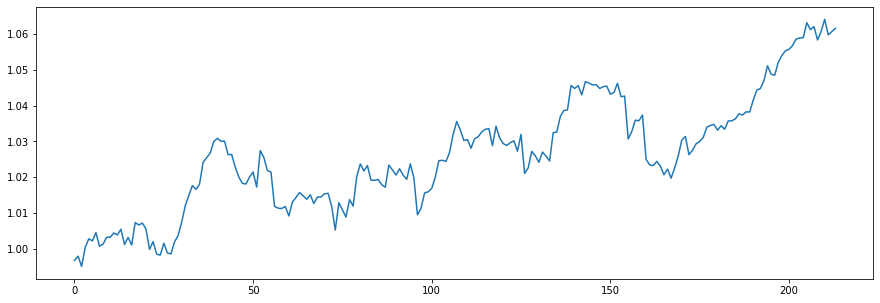

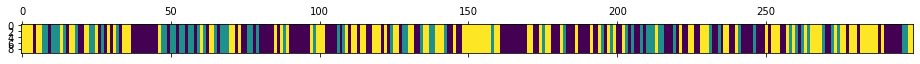

<Figure size 432x288 with 0 Axes>

N [[64. 28. 32.]
 [23. 17. 26.]
 [37. 21. 51.]]
alphas [[2.68979381 1.09066682 1.5081611 ]
 [2.31161517 1.46884545 1.5081611 ]
 [2.31161517 1.09066682 1.88633974]]
M [[ 9.  5. 11.]
 [ 4.  4.  6.]
 [ 6.  3.  5.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[ 9.  5. 11.]
 [ 4.  4.  6.]
 [ 6.  3.  4.]]
pi_z [[0.40572759 0.33655756 0.25771486]
 [0.36013371 0.23545798 0.40440831]
 [0.29994742 0.19673903 0.50331355]]
beta_vec [0.34990581 0.27530231 0.37479188]
hyper>> a_k: 4.222201999824071  gamma: 1.0738156928111917  rho: 0.08361440738123087


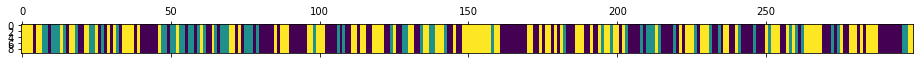

<Figure size 432x288 with 0 Axes>

715
N [[63. 27. 32.]
 [22. 17. 24.]
 [37. 19. 58.]]
alphas [[1.70688025 1.06519009 1.45013165]
 [1.35384334 1.41822701 1.45013165]
 [1.35384334 1.06519009 1.80316857]]
M [[7. 3. 3.]
 [5. 5. 5.]
 [4. 4. 4.]]
sum_w [[2.]
 [0.]
 [1.]]
barM [[5. 3. 3.]
 [5. 5. 5.]
 [4. 4. 3.]]
pi_z [[0.53862007 0.24183227 0.21954767]
 [0.39403651 0.35579383 0.25016966]
 [0.31900477 0.13435036 0.54664487]]
beta_vec [0.39508732 0.13991095 0.46500172]
hyper>> a_k: 4.054074915060765  gamma: 0.4540758555256824  rho: 0.05797668359588946


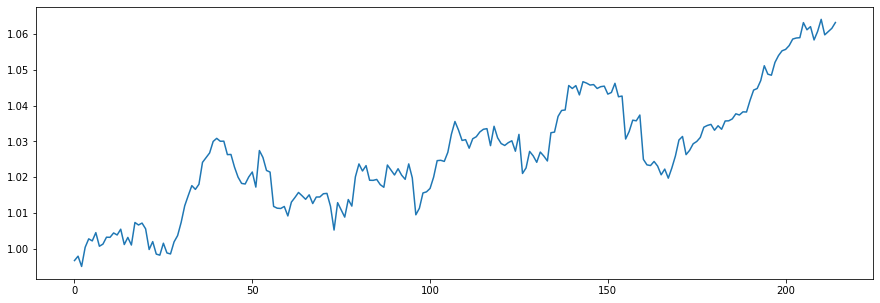

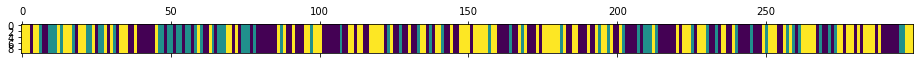

<Figure size 432x288 with 0 Axes>

N [[62. 27. 34.]
 [24. 15. 24.]
 [37. 21. 55.]]
alphas [[1.74389338 0.53432456 1.77585698]
 [1.50885156 0.76936638 1.77585698]
 [1.50885156 0.53432456 2.01089879]]
M [[5. 4. 6.]
 [3. 2. 6.]
 [8. 3. 8.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[5. 4. 6.]
 [3. 2. 6.]
 [8. 3. 7.]]
pi_z [[0.5246798  0.18809526 0.28722494]
 [0.36511493 0.25569031 0.37919475]
 [0.30733562 0.14392035 0.54874403]]
beta_vec [0.43868193 0.07611236 0.4852057 ]
hyper>> a_k: 4.112635122287157  gamma: 0.49464581361339327  rho: 0.034734550204672164


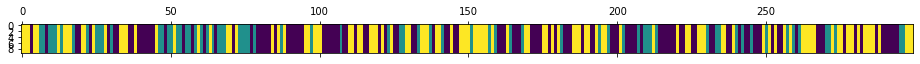

<Figure size 432x288 with 0 Axes>

716
N [[63. 26. 31.]
 [21. 20. 29.]
 [36. 24. 49.]]
alphas [[1.88432331 0.30214969 1.92616213]
 [1.74147278 0.44500022 1.92616213]
 [1.74147278 0.30214969 2.06901266]]
M [[ 7.  3.  4.]
 [ 2.  2.  7.]
 [ 6.  3. 10.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[ 7.  3.  4.]
 [ 2.  2.  7.]
 [ 6.  3. 10.]]
pi_z [[0.52966168 0.18151236 0.28882597]
 [0.26212254 0.29373616 0.4441413 ]
 [0.32151134 0.22412052 0.45436814]]
beta_vec [0.49607348 0.17707799 0.32684853]
hyper>> a_k: 3.5390942849485167  gamma: 0.43440913433579115  rho: 0.017065833635097654


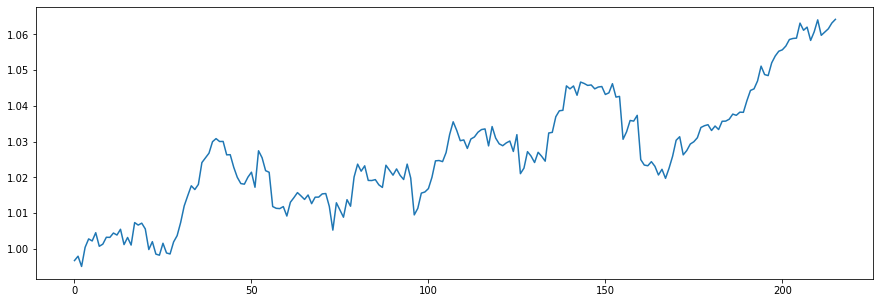

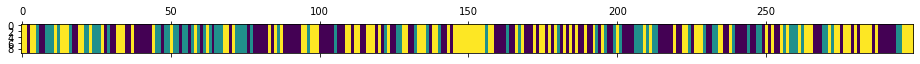

<Figure size 432x288 with 0 Axes>

N [[59. 24. 34.]
 [20. 24. 29.]
 [38. 25. 46.]]
alphas [[1.78608675 0.61600062 1.13700692]
 [1.72568916 0.67639821 1.13700692]
 [1.72568916 0.61600062 1.19740451]]
M [[10.  2.  4.]
 [ 6.  3.  3.]
 [ 4.  5.  2.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[10.  2.  4.]
 [ 6.  2.  3.]
 [ 4.  5.  2.]]
pi_z [[0.45294838 0.1681034  0.37894822]
 [0.24918259 0.38136018 0.36945722]
 [0.40505221 0.17700293 0.41794487]]
beta_vec [0.4681937  0.23004699 0.30175931]
hyper>> a_k: 3.6209392754557435  gamma: 0.5107931816261626  rho: 0.04573400676058677


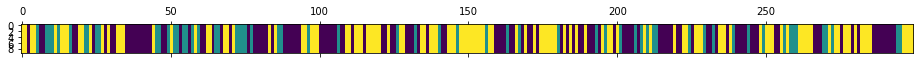

<Figure size 432x288 with 0 Axes>

717
N [[65. 25. 31.]
 [18. 17. 26.]
 [38. 19. 60.]]
alphas [[1.7833681  0.7948904  1.04268078]
 [1.61776804 0.96049046 1.04268078]
 [1.61776804 0.7948904  1.20828084]]
M [[6. 2. 2.]
 [6. 3. 4.]
 [4. 3. 5.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[4. 2. 2.]
 [6. 2. 4.]
 [4. 3. 4.]]
pi_z [[0.50793992 0.18593641 0.30612367]
 [0.29608994 0.27203434 0.43187572]
 [0.33245428 0.11814835 0.54939737]]
beta_vec [0.29663274 0.25090128 0.45246598]
hyper>> a_k: 2.6080136478390545  gamma: 0.4141399044427705  rho: 0.15570170155672766


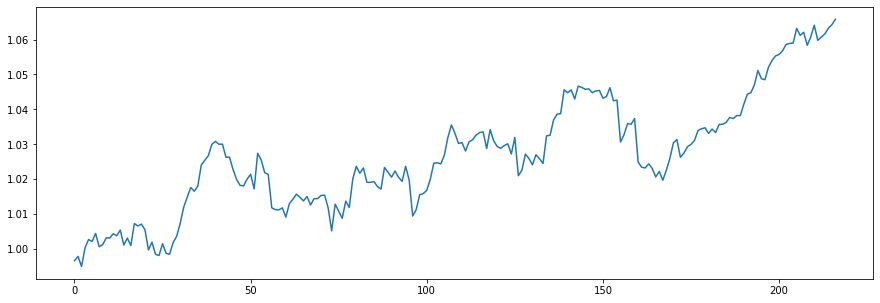

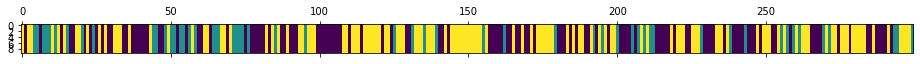

<Figure size 432x288 with 0 Axes>

N [[61. 21. 38.]
 [16. 13. 25.]
 [43. 21. 61.]]
alphas [[1.0592401  0.55246993 0.99630362]
 [0.65316794 0.95854209 0.99630362]
 [0.65316794 0.55246993 1.40237578]]
M [[4. 2. 2.]
 [3. 4. 5.]
 [2. 3. 8.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[3. 2. 2.]
 [3. 2. 5.]
 [2. 3. 6.]]
pi_z [[0.49652685 0.19793813 0.30553502]
 [0.25212237 0.28653782 0.46133982]
 [0.34601928 0.16626866 0.48771205]]
beta_vec [0.24466101 0.45276832 0.30257067]
hyper>> a_k: 2.1829371411856204  gamma: 0.4472187723313078  rho: 0.159236248361683


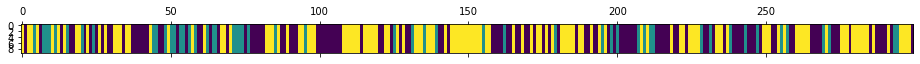

<Figure size 432x288 with 0 Axes>

718
N [[61. 25. 37.]
 [18. 11. 23.]
 [43. 17. 64.]]
alphas [[0.79663749 0.83098129 0.55531836]
 [0.44903477 1.17858401 0.55531836]
 [0.44903477 0.83098129 0.90292108]]
M [[5. 5. 3.]
 [1. 3. 5.]
 [3. 2. 5.]]
sum_w [[3.]
 [0.]
 [2.]]
barM [[2. 5. 3.]
 [1. 3. 5.]
 [3. 2. 3.]]
pi_z [[0.47501841 0.27337813 0.25160346]
 [0.39932755 0.06999711 0.53067534]
 [0.32986259 0.08378468 0.58635272]]
beta_vec [0.3157821  0.35501293 0.32920497]
hyper>> a_k: 2.3621393696261883  gamma: 1.4616253025013919  rho: 0.17567120690615176


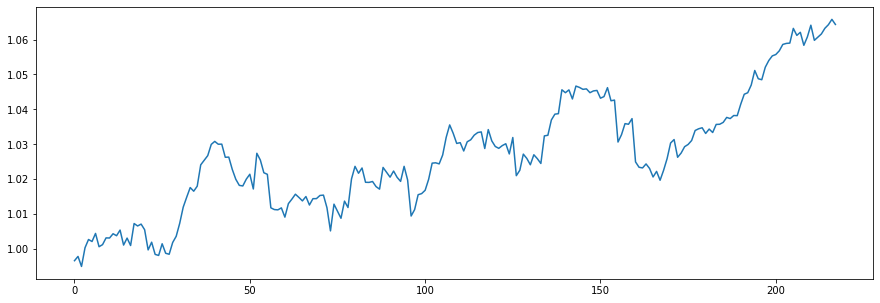

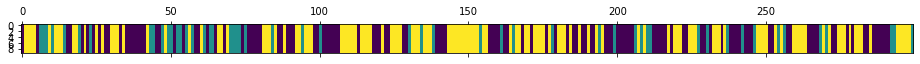

<Figure size 432x288 with 0 Axes>

N [[67. 23. 33.]
 [17. 11. 23.]
 [39. 18. 68.]]
alphas [[1.02984431 0.69127389 0.64102116]
 [0.61488444 1.10623377 0.64102116]
 [0.61488444 0.69127389 1.05598104]]
M [[8. 5. 2.]
 [4. 3. 2.]
 [3. 4. 8.]]
sum_w [[6.]
 [2.]
 [5.]]
barM [[2. 5. 2.]
 [4. 1. 2.]
 [3. 4. 3.]]
pi_z [[0.53781198 0.19855803 0.26362999]
 [0.40112621 0.16415075 0.43472304]
 [0.31319636 0.11132593 0.57547772]]
beta_vec [0.20464472 0.47224593 0.32310934]
hyper>> a_k: 2.9768102284364106  gamma: 0.7398588918637558  rho: 0.33636450984935556


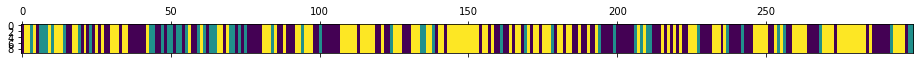

<Figure size 432x288 with 0 Axes>

719
N [[60. 22. 38.]
 [20. 11. 19.]
 [40. 17. 72.]]
alphas [[1.40557243 0.93292983 0.63830797]
 [0.40427911 1.93422314 0.63830797]
 [0.40427911 0.93292983 1.63960129]]
M [[4. 4. 6.]
 [4. 4. 1.]
 [4. 3. 7.]]
sum_w [[3.]
 [4.]
 [3.]]
barM [[1. 4. 6.]
 [4. 0. 1.]
 [4. 3. 4.]]
pi_z [[0.53545284 0.17220988 0.29233729]
 [0.29085369 0.18237111 0.5267752 ]
 [0.29937327 0.20808593 0.49254081]]
beta_vec [0.22657173 0.43502262 0.33840565]
hyper>> a_k: 3.0527628061072716  gamma: 0.3798973025783449  rho: 0.1958969745953052


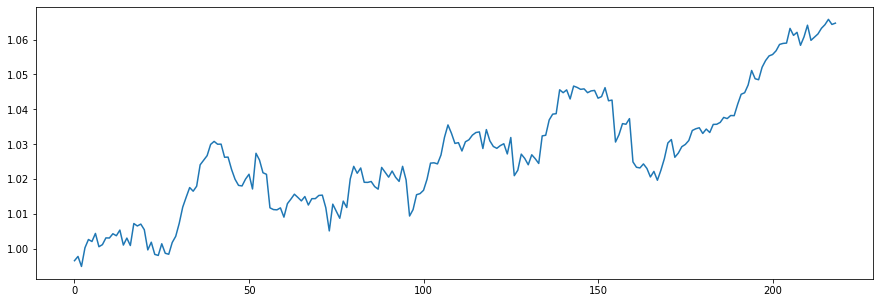

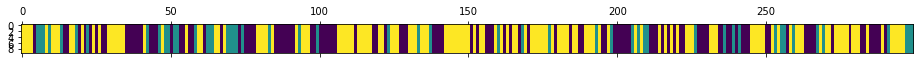

<Figure size 432x288 with 0 Axes>

N [[59. 17. 37.]
 [16. 12. 22.]
 [38. 21. 77.]]
alphas [[1.15420074 1.06786561 0.83069646]
 [0.55617374 1.66589261 0.83069646]
 [0.55617374 1.06786561 1.42872346]]
M [[3. 3. 4.]
 [2. 4. 3.]
 [2. 5. 6.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[2. 3. 4.]
 [2. 3. 3.]
 [2. 5. 4.]]
pi_z [[0.55137917 0.18017479 0.26844605]
 [0.29811414 0.23366584 0.46822001]
 [0.23389302 0.18738474 0.57872224]]
beta_vec [0.21298545 0.43058618 0.35642837]
hyper>> a_k: 2.1684255419714735  gamma: 1.6538059072338316  rho: 0.24944676735420382


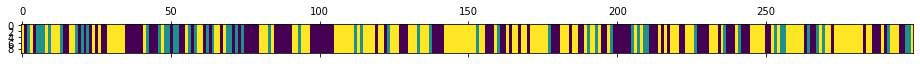

<Figure size 432x288 with 0 Axes>

720
N [[59. 21. 29.]
 [17.  8. 27.]
 [34. 23. 81.]]
alphas [[0.88754457 0.70078711 0.58009387]
 [0.34663783 1.24169385 0.58009387]
 [0.34663783 0.70078711 1.12100061]]
M [[4. 2. 2.]
 [3. 3. 2.]
 [4. 2. 5.]]
sum_w [[0.]
 [2.]
 [4.]]
barM [[4. 2. 2.]
 [3. 1. 2.]
 [4. 2. 1.]]
pi_z [[0.55779913 0.26591521 0.17628565]
 [0.305273   0.11218954 0.58253746]
 [0.24609062 0.18074406 0.57316533]]
beta_vec [0.60903295 0.24746223 0.14350482]
hyper>> a_k: 2.1228109906040094  gamma: 0.7893878268555887  rho: 0.24662363880207028


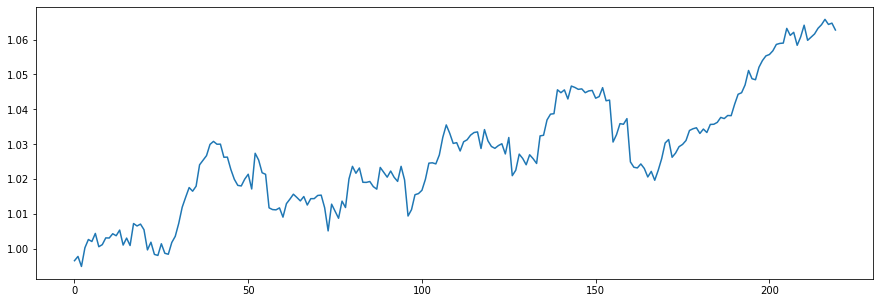

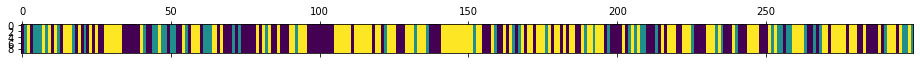

<Figure size 432x288 with 0 Axes>

N [[54. 22. 36.]
 [17. 11. 26.]
 [41. 22. 70.]]
alphas [[1.49754693 0.39576031 0.22950376]
 [0.97401155 0.91929568 0.22950376]
 [0.97401155 0.39576031 0.75303913]]
M [[4. 1. 3.]
 [3. 4. 1.]
 [4. 4. 3.]]
sum_w [[0.]
 [3.]
 [3.]]
barM [[4. 1. 3.]
 [3. 1. 1.]
 [4. 4. 0.]]
pi_z [[0.42948719 0.22106303 0.34944977]
 [0.19657189 0.09652175 0.70690636]
 [0.29867475 0.14343625 0.557889  ]]
beta_vec [0.42142512 0.19365698 0.3849179 ]
hyper>> a_k: 2.3298676898448134  gamma: 0.9052427841333052  rho: 0.2584784737192545


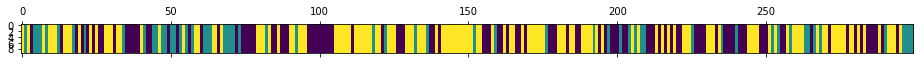

<Figure size 432x288 with 0 Axes>

721
N [[51. 21. 35.]
 [15. 16. 27.]
 [41. 21. 72.]]
alphas [[1.3302945  0.33457091 0.66500227]
 [0.72807386 0.93679156 0.66500227]
 [0.72807386 0.33457091 1.26722292]]
M [[5. 2. 3.]
 [2. 1. 3.]
 [3. 1. 8.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[2. 2. 3.]
 [2. 0. 3.]
 [3. 1. 3.]]
pi_z [[0.48208691 0.14963044 0.36828265]
 [0.3032492  0.35551529 0.34123552]
 [0.28519962 0.11110743 0.60369295]]
beta_vec [0.38006291 0.10881199 0.51112511]
hyper>> a_k: 1.9774105726169815  gamma: 1.447748209979482  rho: 0.2661743947472359


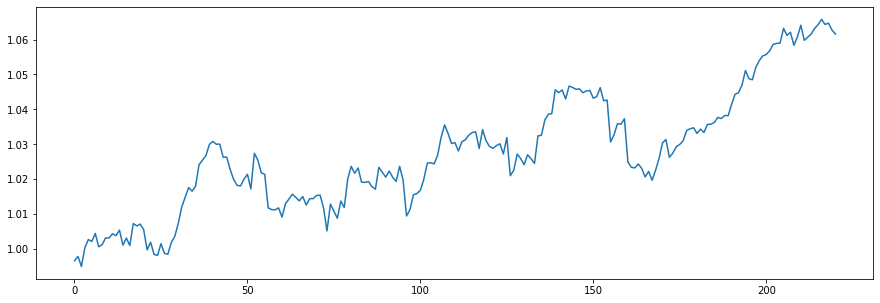

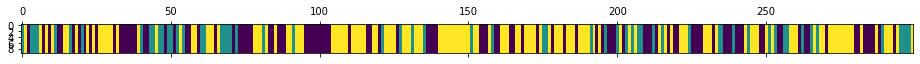

<Figure size 432x288 with 0 Axes>

N [[50. 19. 37.]
 [18. 16. 25.]
 [38. 23. 73.]]
alphas [[1.07783566 0.1578943  0.74168062]
 [0.55149959 0.68423036 0.74168062]
 [0.55149959 0.1578943  1.26801668]]
M [[4. 3. 3.]
 [4. 2. 3.]
 [1. 3. 3.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[2. 3. 3.]
 [4. 2. 3.]
 [1. 3. 0.]]
pi_z [[0.51036065 0.19345625 0.2961831 ]
 [0.29521809 0.2554353  0.44934661]
 [0.26846308 0.22214771 0.50938921]]
beta_vec [0.20502223 0.41420352 0.38077425]
hyper>> a_k: 2.976211109805556  gamma: 0.992340288835544  rho: 0.13582945936937885


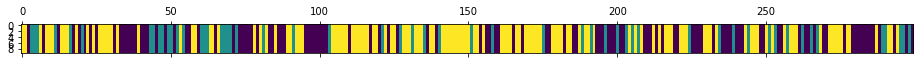

<Figure size 432x288 with 0 Axes>

722
N [[53. 22. 39.]
 [22. 12. 21.]
 [38. 21. 71.]]
alphas [[0.93156489 1.06531238 0.97933384]
 [0.52730775 1.46956952 0.97933384]
 [0.52730775 1.06531238 1.38359099]]
M [[ 6.  5.  7.]
 [ 3.  5.  4.]
 [ 1.  2. 10.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[4. 5. 7.]
 [3. 4. 4.]
 [1. 2. 6.]]
pi_z [[0.52039552 0.12158518 0.3580193 ]
 [0.40589999 0.22205818 0.37204183]
 [0.31404546 0.17995884 0.5059957 ]]
beta_vec [0.19323085 0.38162434 0.42514481]
hyper>> a_k: 3.7994774134667595  gamma: 0.6998188447569526  rho: 0.17719176955566618


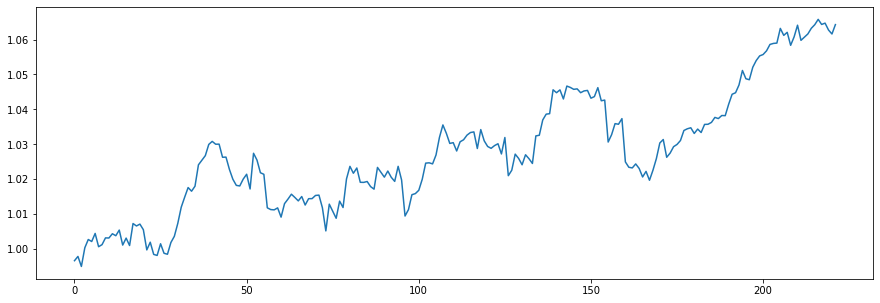

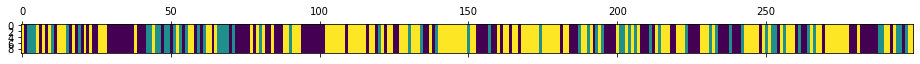

<Figure size 432x288 with 0 Axes>

N [[55. 19. 35.]
 [21. 12. 25.]
 [33. 27. 72.]]
alphas [[1.2773224  1.19304976 1.32910526]
 [0.60408627 1.86628589 1.32910526]
 [0.60408627 1.19304976 2.00234138]]
M [[3. 1. 4.]
 [3. 7. 6.]
 [5. 1. 7.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[0. 1. 4.]
 [3. 6. 6.]
 [5. 1. 3.]]
pi_z [[0.45980725 0.20725143 0.33294132]
 [0.29495572 0.18694758 0.51809669]
 [0.27125121 0.17368197 0.55506682]]
beta_vec [0.22435721 0.22174267 0.55390012]
hyper>> a_k: 3.4695472012804065  gamma: 0.23687415245083995  rho: 0.24021963618434233


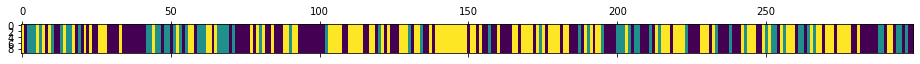

<Figure size 432x288 with 0 Axes>

723
N [[61. 23. 37.]
 [22. 18. 22.]
 [38. 21. 57.]]
alphas [[1.42488004 0.58453448 1.46013269]
 [0.59142667 1.41798784 1.46013269]
 [0.59142667 0.58453448 2.29358605]]
M [[4. 3. 5.]
 [4. 3. 4.]
 [6. 2. 8.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[3. 3. 5.]
 [4. 0. 4.]
 [6. 2. 5.]]
pi_z [[0.47217357 0.23476738 0.29305905]
 [0.25879625 0.32570849 0.41549526]
 [0.34727218 0.22894284 0.42378498]]
beta_vec [0.3903467  0.18120261 0.42845069]
hyper>> a_k: 3.001281421167505  gamma: 0.47961438867156453  rho: 0.1865283787058722


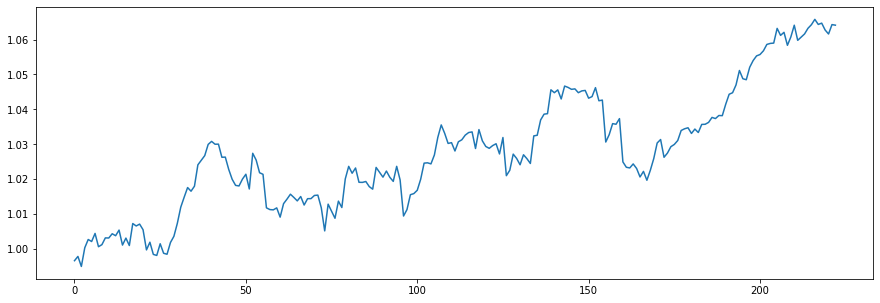

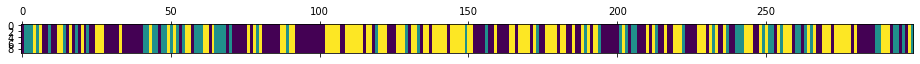

<Figure size 432x288 with 0 Axes>

N [[65. 23. 35.]
 [19. 17. 23.]
 [39. 20. 58.]]
alphas [[1.51283895 0.44239843 1.04604404]
 [0.9530148  1.00222259 1.04604404]
 [0.9530148  0.44239843 1.6058682 ]]
M [[10.  5.  4.]
 [ 6.  3.  4.]
 [ 6.  3.  6.]]
sum_w [[3.]
 [2.]
 [0.]]
barM [[7. 5. 4.]
 [6. 1. 4.]
 [6. 3. 6.]]
pi_z [[0.49995077 0.25146414 0.24858509]
 [0.2990571  0.35799161 0.34295129]
 [0.31596771 0.16707201 0.51696028]]
beta_vec [0.51277612 0.21680078 0.2704231 ]
hyper>> a_k: 4.115531437047521  gamma: 0.3455158318617778  rho: 0.20980817378511307


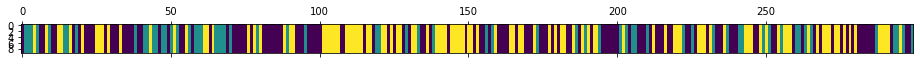

<Figure size 432x288 with 0 Axes>

724
N [[62. 28. 39.]
 [23. 17. 23.]
 [44. 18. 45.]]
alphas [[2.53105047 0.70504899 0.87943197]
 [1.66757834 1.56852113 0.87943197]
 [1.66757834 0.70504899 1.74290411]]
M [[13.  2.  4.]
 [ 6.  6.  7.]
 [ 3.  5.  5.]]
sum_w [[6.]
 [3.]
 [2.]]
barM [[7. 2. 4.]
 [6. 3. 7.]
 [3. 5. 3.]]
pi_z [[0.45675472 0.13543824 0.40780703]
 [0.40447475 0.22900283 0.36652243]
 [0.45929795 0.16391783 0.37678421]]
beta_vec [0.44531403 0.17233753 0.38234844]
hyper>> a_k: 4.2297784875693925  gamma: 0.5166020463766119  rho: 0.3289315420813029


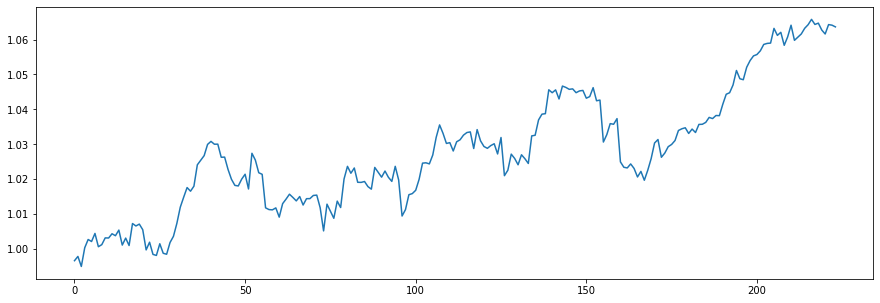

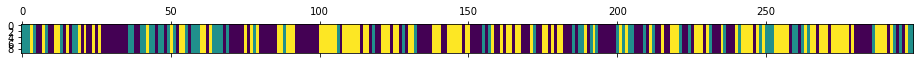

<Figure size 432x288 with 0 Axes>

N [[62. 28. 33.]
 [21. 18. 25.]
 [40. 18. 54.]]
alphas [[2.65531848 0.48917508 1.08528493]
 [1.26401092 1.88048264 1.08528493]
 [1.26401092 0.48917508 2.47659249]]
M [[ 5.  2.  5.]
 [ 3.  4.  2.]
 [ 5.  1. 11.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[2. 2. 5.]
 [3. 1. 2.]
 [5. 1. 8.]]
pi_z [[0.52202707 0.23361816 0.24435478]
 [0.281719   0.35882218 0.35945882]
 [0.41398417 0.15365078 0.43236505]]
beta_vec [0.30065137 0.18135234 0.51799629]
hyper>> a_k: 2.538988666568746  gamma: 0.2615130426887778  rho: 0.23514624536345385


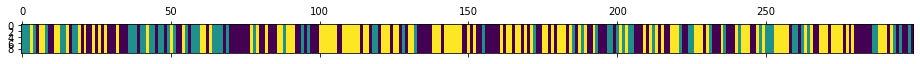

<Figure size 432x288 with 0 Axes>

725
N [[50. 27. 40.]
 [20. 22. 25.]
 [46. 19. 50.]]
alphas [[1.18088509 0.35217809 1.00592549]
 [0.58385143 0.94921174 1.00592549]
 [0.58385143 0.35217809 1.60295914]]
M [[7. 1. 5.]
 [4. 3. 3.]
 [3. 2. 3.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[5. 1. 5.]
 [4. 1. 3.]
 [3. 2. 1.]]
pi_z [[0.48462474 0.15833585 0.35703941]
 [0.45467185 0.32718393 0.21814423]
 [0.26624721 0.18030201 0.55345078]]
beta_vec [0.68641782 0.13229549 0.18128669]
hyper>> a_k: 2.4439922372801846  gamma: 1.5077128466887346  rho: 0.12280405456855485


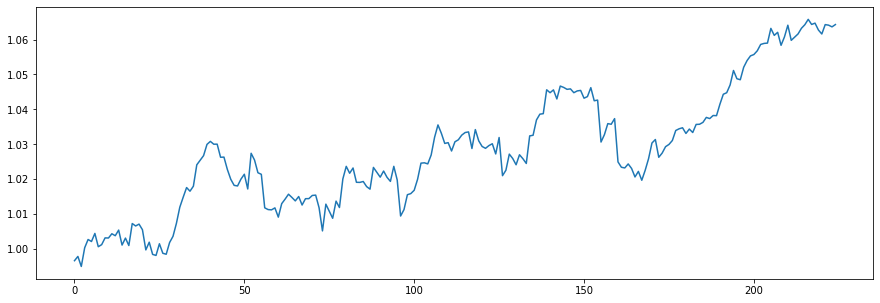

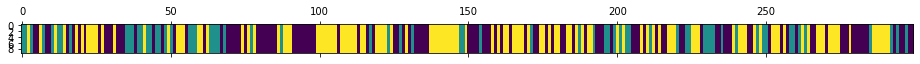

<Figure size 432x288 with 0 Axes>

N [[54. 25. 37.]
 [23. 21. 22.]
 [39. 20. 58.]]
alphas [[1.77171592 0.28362303 0.3886533 ]
 [1.47158376 0.58375518 0.3886533 ]
 [1.47158376 0.28362303 0.68878545]]
M [[7. 2. 3.]
 [9. 2. 2.]
 [4. 3. 2.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[6. 2. 3.]
 [9. 1. 2.]
 [4. 3. 1.]]
pi_z [[0.46856681 0.21534925 0.31608394]
 [0.31985238 0.40964752 0.27050011]
 [0.3894751  0.11323358 0.49729132]]
beta_vec [0.62324018 0.30867274 0.06808708]
hyper>> a_k: 2.803117631900185  gamma: 1.2526446430681006  rho: 0.1376983512591249


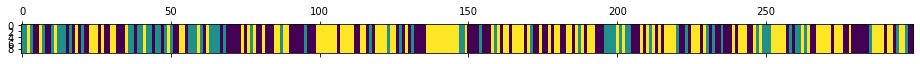

<Figure size 432x288 with 0 Axes>

726
N [[49. 26. 37.]
 [22. 19. 24.]
 [41. 20. 61.]]
alphas [[1.89243906 0.74610305 0.16457552]
 [1.50645438 1.13208773 0.16457552]
 [1.50645438 0.74610305 0.5505602 ]]
M [[7. 4. 1.]
 [7. 3. 1.]
 [8. 2. 2.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[7. 4. 1.]
 [7. 1. 1.]
 [8. 2. 0.]]
pi_z [[0.3802399  0.30948489 0.31027521]
 [0.34821232 0.29283183 0.35895585]
 [0.40045909 0.16802427 0.43151664]]
beta_vec [0.78198451 0.18677489 0.0312406 ]
hyper>> a_k: 3.3507280430172575  gamma: 0.298253000757337  rho: 0.19918067733871408


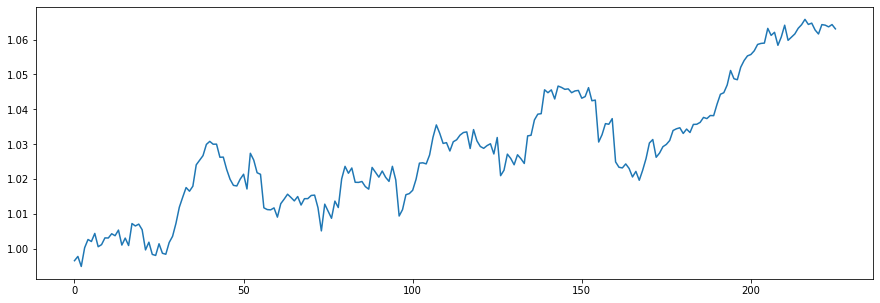

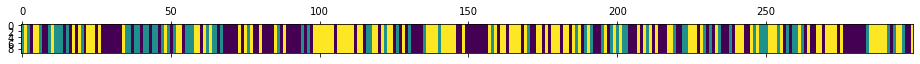

<Figure size 432x288 with 0 Axes>

N [[50. 29. 36.]
 [25. 15. 29.]
 [39. 25. 51.]]
alphas [[2.76572102 0.50117826 0.08382877]
 [2.09832073 1.16857854 0.08382877]
 [2.09832073 0.50117826 0.75122905]]
M [[11.  2.  2.]
 [ 8.  3.  1.]
 [ 7.  1.  5.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[8. 2. 2.]
 [8. 0. 1.]
 [7. 1. 0.]]
pi_z [[0.44802194 0.25765784 0.29432022]
 [0.43018917 0.17616038 0.39365045]
 [0.30937118 0.15364929 0.53697952]]
beta_vec [0.87970836 0.08484507 0.03544656]
hyper>> a_k: 3.6777687648390773  gamma: 0.5308079621419609  rho: 0.3265750207418608


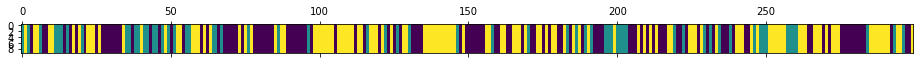

<Figure size 432x288 with 0 Axes>

727
N [[57. 28. 32.]
 [17. 18. 26.]
 [43. 15. 63.]]
alphas [[3.3798423  0.21013591 0.08779055]
 [2.17877489 1.41120332 0.08779055]
 [2.17877489 0.21013591 1.28885796]]
M [[9. 3. 2.]
 [5. 3. 1.]
 [8. 1. 5.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[6. 3. 2.]
 [5. 0. 1.]
 [8. 1. 1.]]
pi_z [[0.46544634 0.25117405 0.28337961]
 [0.34251381 0.35221865 0.30526754]
 [0.32626517 0.07290611 0.60082872]]
beta_vec [0.73838347 0.17004527 0.09157126]
hyper>> a_k: 4.598092422916683  gamma: 0.3936360119528717  rho: 0.3028603867702844


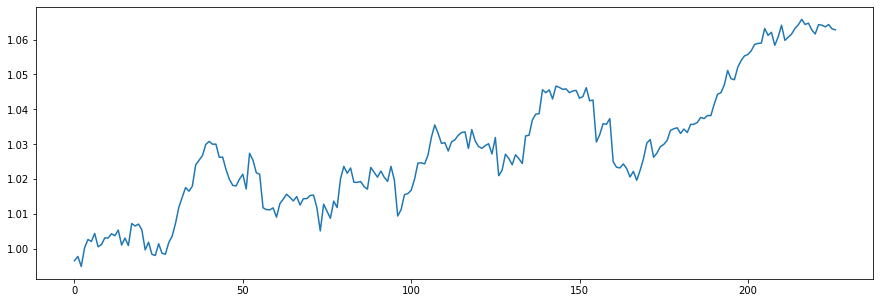

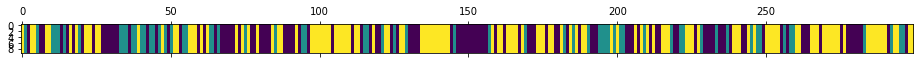

<Figure size 432x288 with 0 Axes>

N [[53. 27. 34.]
 [22. 19. 22.]
 [39. 17. 66.]]
alphas [[3.75947739 0.54508221 0.29353282]
 [2.36689734 1.93766226 0.29353282]
 [2.36689734 0.54508221 1.68611287]]
M [[11.  4.  3.]
 [ 6.  4.  2.]
 [ 8.  4.  4.]]
sum_w [[4.]
 [4.]
 [4.]]
barM [[7. 4. 3.]
 [6. 0. 2.]
 [8. 4. 0.]]
pi_z [[0.48703852 0.2212741  0.29168739]
 [0.37375146 0.27770118 0.34854736]
 [0.36515759 0.10140577 0.53343664]]
beta_vec [0.45133187 0.26869922 0.2799689 ]
hyper>> a_k: 5.732420619119349  gamma: 1.0871174652165279  rho: 0.32594018724790647


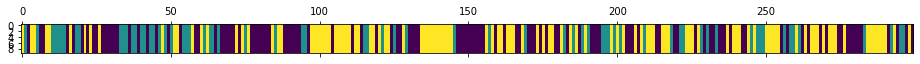

<Figure size 432x288 with 0 Axes>

728
N [[57. 25. 36.]
 [22. 22. 24.]
 [38. 21. 54.]]
alphas [[3.61237006 1.03825229 1.08179827]
 [1.74394381 2.90667854 1.08179827]
 [1.74394381 1.03825229 2.95022452]]
M [[12.  4.  3.]
 [ 4.  6.  3.]
 [ 4.  3.  8.]]
sum_w [[5.]
 [4.]
 [5.]]
barM [[7. 4. 3.]
 [4. 2. 3.]
 [4. 3. 3.]]
pi_z [[0.44879455 0.25461395 0.2965915 ]
 [0.30648307 0.40162938 0.29188755]
 [0.31756229 0.16164477 0.52079295]]
beta_vec [0.34463303 0.27984537 0.37552159]
hyper>> a_k: 5.068903569870883  gamma: 0.6302974499212969  rho: 0.34700659133878203


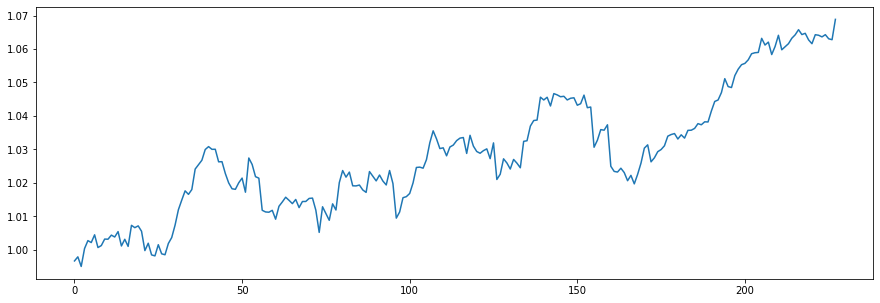

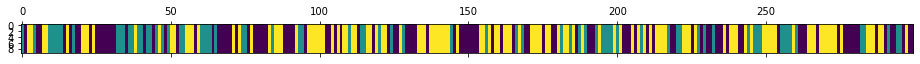

<Figure size 432x288 with 0 Axes>

N [[49. 24. 36.]
 [21. 27. 25.]
 [39. 22. 56.]]
alphas [[2.89966472 0.92627717 1.24296168]
 [1.14072177 2.68522012 1.24296168]
 [1.14072177 0.92627717 3.00190463]]
M [[12.  3.  3.]
 [ 3.  6.  4.]
 [ 4.  3.  8.]]
sum_w [[6.]
 [4.]
 [3.]]
barM [[6. 3. 3.]
 [3. 2. 4.]
 [4. 3. 5.]]
pi_z [[0.4609788  0.22445342 0.31456777]
 [0.28872025 0.45725664 0.25402311]
 [0.35503496 0.18215759 0.46280745]]
beta_vec [0.36196314 0.26240992 0.37562695]
hyper>> a_k: 3.219378820442253  gamma: 0.6410645188992005  rho: 0.36695300317787566


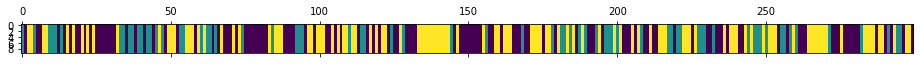

<Figure size 432x288 with 0 Axes>

729
N [[56. 29. 35.]
 [20. 22. 26.]
 [44. 17. 50.]]
alphas [[1.91904815 0.53479616 0.76553451]
 [0.73768742 1.71615689 0.76553451]
 [0.73768742 0.53479616 1.94689524]]
M [[10.  3.  2.]
 [ 2.  3.  5.]
 [ 7.  1.  6.]]
sum_w [[6.]
 [3.]
 [4.]]
barM [[4. 3. 2.]
 [2. 0. 5.]
 [7. 1. 2.]]
pi_z [[0.48428055 0.26567486 0.25004459]
 [0.25108053 0.326822   0.42209747]
 [0.45534469 0.12084014 0.42381517]]
beta_vec [0.45579943 0.23985518 0.30434539]
hyper>> a_k: 3.7697475621313608  gamma: 0.6790420100718729  rho: 0.3017137029908053


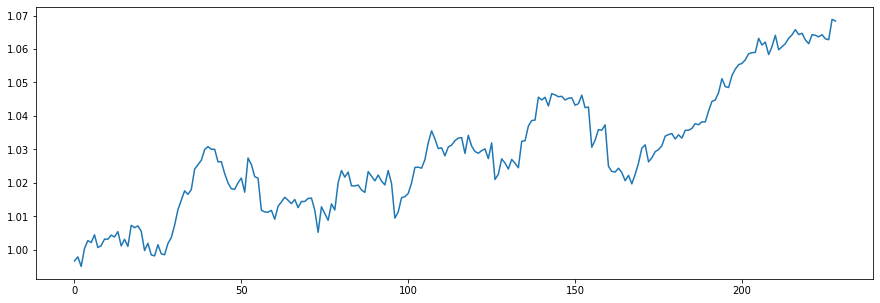

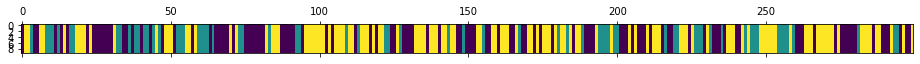

<Figure size 432x288 with 0 Axes>

N [[54. 25. 34.]
 [15. 27. 25.]
 [43. 15. 61.]]
alphas [[2.33721409 0.63138591 0.80114756]
 [1.19982959 1.76877041 0.80114756]
 [1.19982959 0.63138591 1.93853206]]
M [[ 4.  1.  5.]
 [ 2.  2.  3.]
 [ 7.  3. 11.]]
sum_w [[2.]
 [2.]
 [7.]]
barM [[2. 1. 5.]
 [2. 0. 3.]
 [7. 3. 4.]]
pi_z [[0.44379608 0.22553053 0.33067339]
 [0.19604457 0.4525725  0.35138293]
 [0.39327763 0.11827992 0.48844245]]
beta_vec [0.3107406 0.1304301 0.5588293]
hyper>> a_k: 3.6149851369146897  gamma: 1.3500614907210282  rho: 0.4211037360081682


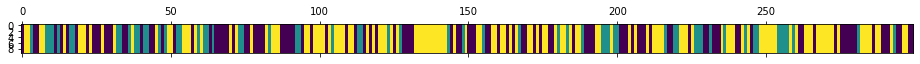

<Figure size 432x288 with 0 Axes>

730
N [[50. 23. 38.]
 [14. 21. 27.]
 [46. 18. 62.]]
alphas [[2.17257103 0.27295125 1.16946285]
 [0.65028729 1.795235   1.16946285]
 [0.65028729 0.27295125 2.6917466 ]]
M [[11.  3.  3.]
 [ 2.  5.  3.]
 [ 4.  1.  5.]]
sum_w [[10.]
 [ 5.]
 [ 4.]]
barM [[1. 3. 3.]
 [2. 0. 3.]
 [4. 1. 1.]]
pi_z [[0.50490822 0.19655105 0.29854073]
 [0.27453668 0.29074484 0.43471848]
 [0.36355633 0.1556954  0.48074827]]
beta_vec [0.32214736 0.30260226 0.37525038]
hyper>> a_k: 2.682776697358178  gamma: 0.39125838151295556  rho: 0.4818556000762039


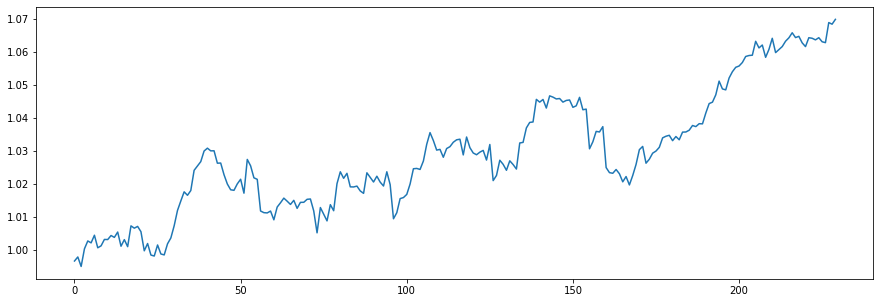

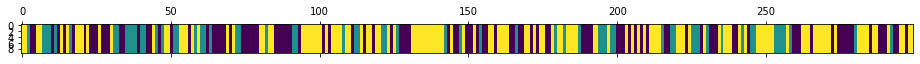

<Figure size 432x288 with 0 Axes>

N [[50. 23. 35.]
 [14. 23. 26.]
 [44. 17. 67.]]
alphas [[1.74051698 0.42063703 0.52162269]
 [0.44780601 1.713348   0.52162269]
 [0.44780601 0.42063703 1.81433367]]
M [[5. 3. 3.]
 [1. 3. 4.]
 [1. 3. 9.]]
sum_w [[5.]
 [2.]
 [6.]]
barM [[0. 3. 3.]
 [1. 1. 4.]
 [1. 3. 3.]]
pi_z [[0.38698503 0.20708862 0.40592635]
 [0.2595206  0.34689516 0.39358423]
 [0.34530021 0.12559918 0.52910061]]
beta_vec [0.07326655 0.41393282 0.51280063]
hyper>> a_k: 2.5154421347896845  gamma: 0.6178856273589373  rho: 0.49888381076887345


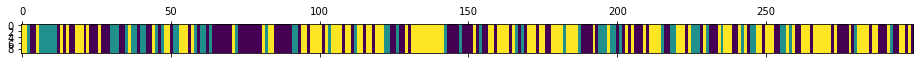

<Figure size 432x288 with 0 Axes>

731
N [[53. 25. 38.]
 [19. 21. 21.]
 [43. 15. 64.]]
alphas [[1.34726795 0.52177423 0.64639995]
 [0.0923546  1.77668758 0.64639995]
 [0.0923546  0.52177423 1.90131331]]
M [[3. 2. 5.]
 [1. 5. 3.]
 [1. 3. 5.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[0. 2. 5.]
 [1. 3. 3.]
 [1. 3. 1.]]
pi_z [[0.47493245 0.18295856 0.34210899]
 [0.38692623 0.33112405 0.28194972]
 [0.40917241 0.09895266 0.49187492]]
beta_vec [0.12874977 0.55439546 0.31685476]
hyper>> a_k: 1.8421871790266708  gamma: 0.5812914107428994  rho: 0.4200790324464976


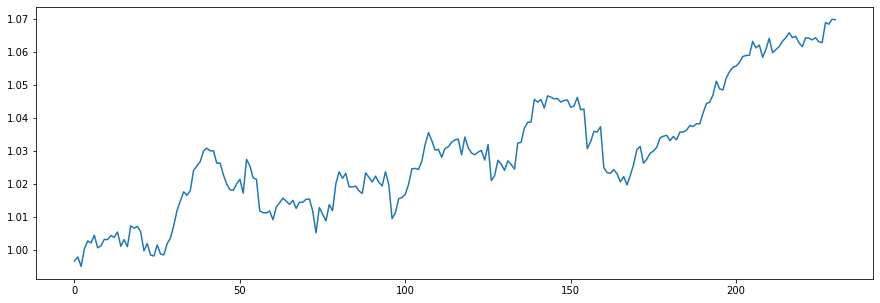

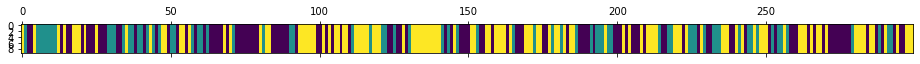

<Figure size 432x288 with 0 Axes>

N [[53. 28. 33.]
 [22. 25. 25.]
 [39. 19. 55.]]
alphas [[0.91141055 0.59227341 0.33850322]
 [0.13754634 1.36613762 0.33850322]
 [0.13754634 0.59227341 1.11236743]]
M [[4. 6. 2.]
 [1. 3. 5.]
 [2. 3. 6.]]
sum_w [[4.]
 [1.]
 [4.]]
barM [[0. 6. 2.]
 [1. 2. 5.]
 [2. 3. 2.]]
pi_z [[0.50229929 0.20025009 0.29745062]
 [0.38458371 0.37556686 0.23984942]
 [0.33704465 0.15323839 0.50971696]]
beta_vec [0.11387543 0.47437254 0.41175203]
hyper>> a_k: 2.39979960244273  gamma: 0.29376705339382553  rho: 0.3036804170836639


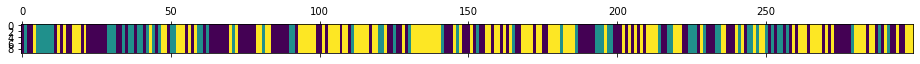

<Figure size 432x288 with 0 Axes>

732
N [[55. 25. 38.]
 [23. 22. 19.]
 [40. 17. 60.]]
alphas [[0.91906111 0.79268954 0.68804895]
 [0.19028896 1.52146169 0.68804895]
 [0.19028896 0.79268954 1.41682109]]
M [[6. 3. 2.]
 [2. 3. 3.]
 [1. 4. 5.]]
sum_w [[4.]
 [0.]
 [3.]]
barM [[2. 3. 2.]
 [2. 3. 3.]
 [1. 4. 2.]]
pi_z [[0.51424948 0.15928977 0.32646075]
 [0.39787304 0.33135152 0.27077544]
 [0.32253931 0.16373387 0.51372681]]
beta_vec [0.28307889 0.45058912 0.26633199]
hyper>> a_k: 1.8453031171700265  gamma: 0.02485875939603312  rho: 0.14788322873119547


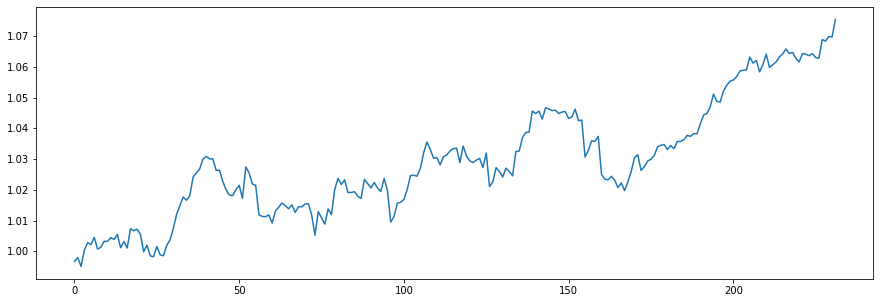

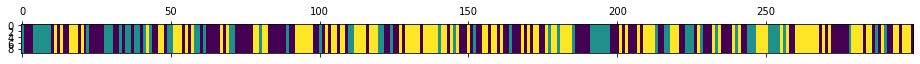

<Figure size 432x288 with 0 Axes>

N [[57. 24. 38.]
 [22. 28. 17.]
 [41. 15. 57.]]
alphas [[0.71800652 0.70851252 0.41878407]
 [0.44511714 0.98140191 0.41878407]
 [0.44511714 0.70851252 0.69167345]]
M [[3. 3. 3.]
 [2. 5. 2.]
 [2. 2. 4.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[2. 3. 3.]
 [2. 5. 2.]
 [2. 2. 0.]]
pi_z [[0.53591668 0.17583762 0.28824571]
 [0.38085356 0.36980421 0.24934223]
 [0.36406365 0.14704459 0.48889175]]
beta_vec [0.26568441 0.51346525 0.22085034]
hyper>> a_k: 1.2991670953879892  gamma: 0.5736413472458823  rho: 0.19007967770121942


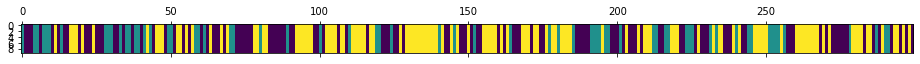

<Figure size 432x288 with 0 Axes>

733
N [[55. 26. 36.]
 [23. 24. 18.]
 [39. 15. 63.]]
alphas [[0.5265042  0.54027934 0.23238355]
 [0.27955894 0.78722461 0.23238355]
 [0.27955894 0.54027934 0.47932881]]
M [[5. 4. 2.]
 [4. 3. 1.]
 [1. 3. 3.]]
sum_w [[3.]
 [0.]
 [3.]]
barM [[2. 4. 2.]
 [4. 3. 1.]
 [1. 3. 0.]]
pi_z [[0.49875172 0.21868477 0.28256351]
 [0.42018827 0.35356025 0.22625148]
 [0.2756618  0.10031711 0.62402109]]
beta_vec [0.25977326 0.51050217 0.22972458]
hyper>> a_k: 1.8191517028662278  gamma: 1.0852776344697364  rho: 0.20708172054530136


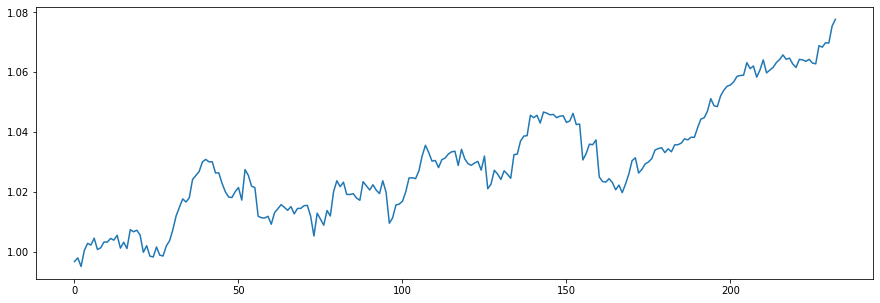

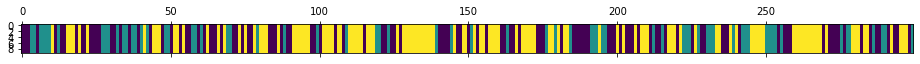

<Figure size 432x288 with 0 Axes>

N [[47. 29. 39.]
 [29. 26. 12.]
 [38. 13. 66.]]
alphas [[0.75142005 0.73636805 0.3313636 ]
 [0.37470698 1.11308112 0.3313636 ]
 [0.37470698 0.73636805 0.70807667]]
M [[3. 3. 3.]
 [1. 5. 2.]
 [3. 3. 3.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[2. 3. 3.]
 [1. 5. 2.]
 [3. 3. 1.]]
pi_z [[0.32853982 0.30285278 0.3686074 ]
 [0.41049314 0.35080071 0.23870615]
 [0.30681522 0.10442933 0.58875545]]
beta_vec [0.22603949 0.52220188 0.25175863]
hyper>> a_k: 1.5619469559079444  gamma: 0.6349808292641445  rho: 0.20816187425940613


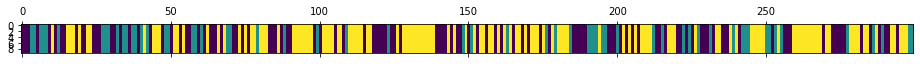

<Figure size 432x288 with 0 Axes>

734
N [[41. 29. 43.]
 [28. 18. 14.]
 [44. 13. 69.]]
alphas [[0.60470551 0.64586407 0.31137737]
 [0.27956771 0.97100188 0.31137737]
 [0.27956771 0.64586407 0.63651518]]
M [[3. 3. 1.]
 [3. 3. 1.]
 [1. 4. 4.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[1. 3. 1.]
 [3. 2. 1.]
 [1. 4. 3.]]
pi_z [[0.3410624  0.33504523 0.32389236]
 [0.52075586 0.32013054 0.1591136 ]
 [0.3485977  0.09925629 0.55214601]]
beta_vec [0.2008639  0.50903383 0.29010228]
hyper>> a_k: 1.9787491807004136  gamma: 0.8748399071350502  rho: 0.22108881197941607


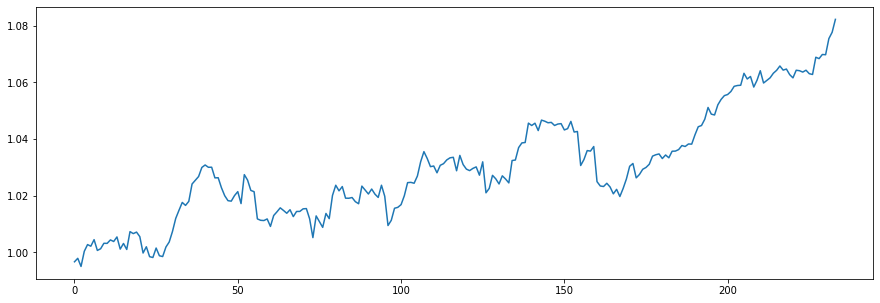

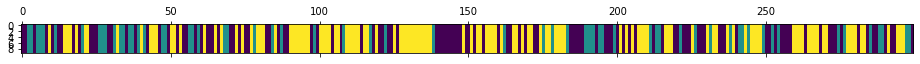

<Figure size 432x288 with 0 Axes>

N [[47. 31. 38.]
 [28. 18. 17.]
 [42. 13. 65.]]
alphas [[0.74706478 0.7845585  0.4471259 ]
 [0.30958547 1.22203781 0.4471259 ]
 [0.30958547 0.7845585  0.88460521]]
M [[4. 3. 5.]
 [3. 3. 2.]
 [3. 3. 5.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[2. 3. 5.]
 [3. 3. 2.]
 [3. 3. 3.]]
pi_z [[0.39647308 0.27803619 0.32549073]
 [0.37492611 0.32411865 0.30095523]
 [0.3636618  0.10181118 0.53452702]]
beta_vec [0.21197231 0.4364293  0.3515984 ]
hyper>> a_k: 3.906496347181075  gamma: 0.5374155729906556  rho: 0.17273683818796978


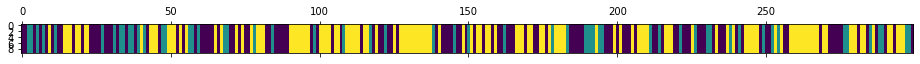

<Figure size 432x288 with 0 Axes>

735
N [[50. 30. 40.]
 [28. 14. 14.]
 [42. 12. 69.]]
alphas [[1.35982684 1.41040879 1.13626072]
 [0.68503101 2.08520462 1.13626072]
 [0.68503101 1.41040879 1.81105655]]
M [[5. 2. 3.]
 [4. 4. 5.]
 [3. 3. 5.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[3. 2. 3.]
 [4. 1. 5.]
 [3. 3. 4.]]
pi_z [[0.37886815 0.25254316 0.36858869]
 [0.44866442 0.22365434 0.32768125]
 [0.3392508  0.12048154 0.54026765]]
beta_vec [0.32513288 0.30064788 0.37421924]
hyper>> a_k: 2.38664824979196  gamma: 1.0490215011688568  rho: 0.2595386527665413


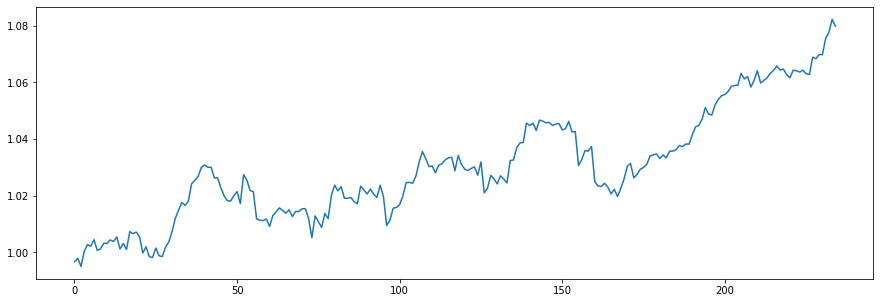

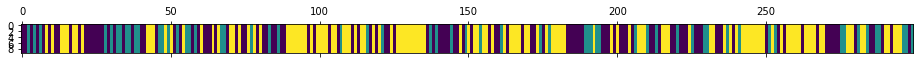

<Figure size 432x288 with 0 Axes>

N [[44. 30. 43.]
 [28. 13. 17.]
 [44. 16. 64.]]
alphas [[1.19400905 0.53131118 0.66132802]
 [0.57458158 1.15073865 0.66132802]
 [0.57458158 0.53131118 1.28075549]]
M [[5. 2. 5.]
 [5. 4. 2.]
 [2. 1. 6.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[4. 2. 5.]
 [5. 1. 2.]
 [2. 1. 2.]]
pi_z [[0.40727747 0.30129623 0.2914263 ]
 [0.38510222 0.31050229 0.30439549]
 [0.35383462 0.10374523 0.54242014]]
beta_vec [0.62258095 0.05396382 0.32345523]
hyper>> a_k: 2.4370173719054113  gamma: 1.4411576345403714  rho: 0.40438287139081963


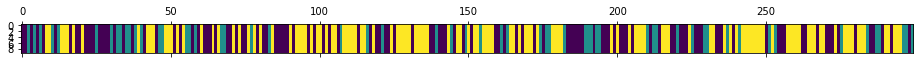

<Figure size 432x288 with 0 Axes>

736
N [[44. 30. 43.]
 [28. 13. 17.]
 [45. 15. 64.]]
alphas [[1.88918256 0.07833006 0.46950475]
 [0.90369448 1.06381815 0.46950475]
 [0.90369448 0.07833006 1.45499283]]
M [[ 6.  1.  3.]
 [ 3.  2.  1.]
 [ 5.  1. 10.]]
sum_w [[2.]
 [2.]
 [6.]]
barM [[4. 1. 3.]
 [3. 0. 1.]
 [5. 1. 4.]]
pi_z [[0.36348921 0.30034755 0.33616324]
 [0.29324719 0.24498754 0.46176526]
 [0.4431149  0.09345471 0.46343039]]
beta_vec [0.46171501 0.09016429 0.44812071]
hyper>> a_k: 2.5741403345401026  gamma: 0.5372322207145371  rho: 0.3446813040904074


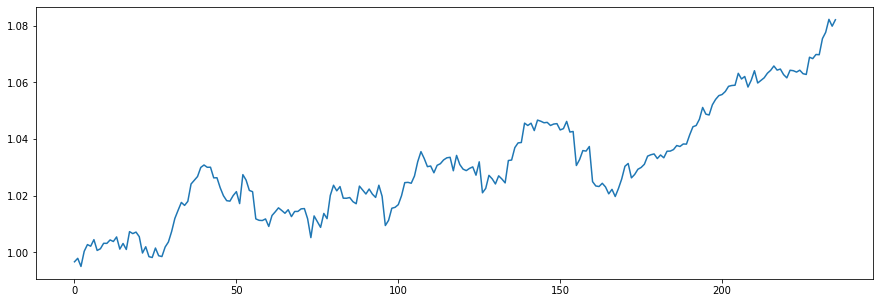

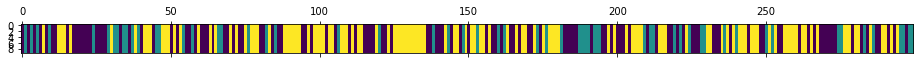

<Figure size 432x288 with 0 Axes>

N [[48. 29. 45.]
 [27. 13. 18.]
 [47. 16. 56.]]
alphas [[1.66611691 0.15209654 0.75592688]
 [0.77885887 1.03935459 0.75592688]
 [0.77885887 0.15209654 1.64318493]]
M [[6. 1. 3.]
 [3. 3. 2.]
 [3. 2. 9.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[3. 1. 3.]
 [3. 1. 2.]
 [3. 2. 5.]]
pi_z [[0.35953598 0.26850388 0.37196014]
 [0.3763014  0.34174411 0.28195449]
 [0.39027763 0.15598542 0.45373695]]
beta_vec [0.30438907 0.07655528 0.61905565]
hyper>> a_k: 2.4489953456643034  gamma: 0.2973549995666057  rho: 0.24315712655283878


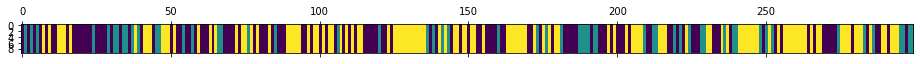

<Figure size 432x288 with 0 Axes>

737
N [[52. 30. 41.]
 [25. 14. 17.]
 [46. 12. 62.]]
alphas [[1.15967723 0.14189557 1.14742254]
 [0.56418656 0.73738624 1.14742254]
 [0.56418656 0.14189557 1.74291322]]
M [[4. 1. 6.]
 [5. 1. 2.]
 [1. 2. 4.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[3. 1. 6.]
 [5. 0. 2.]
 [1. 2. 3.]]
pi_z [[0.46359478 0.20800366 0.32840156]
 [0.44394317 0.21639717 0.33965966]
 [0.44578535 0.10179594 0.45241871]]
beta_vec [0.17415165 0.1080021  0.71784626]
hyper>> a_k: 1.3425157747403307  gamma: 0.8434196670733187  rho: 0.08548398080228493


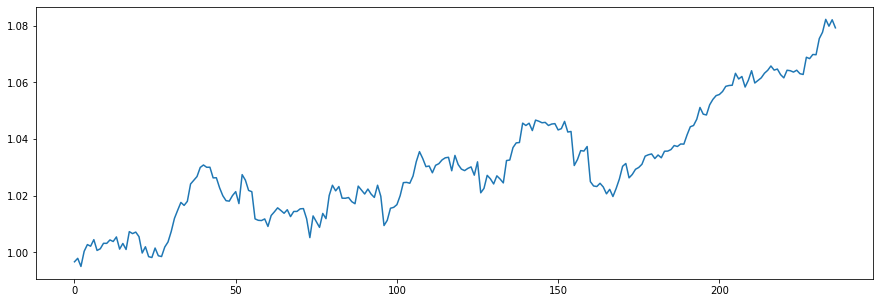

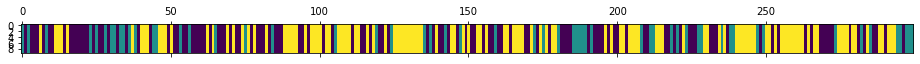

<Figure size 432x288 with 0 Axes>

N [[49. 30. 43.]
 [29. 13. 14.]
 [44. 13. 64.]]
alphas [[0.32857866 0.13259981 0.88133731]
 [0.21381506 0.2473634  0.88133731]
 [0.21381506 0.13259981 0.9961009 ]]
M [[6. 2. 4.]
 [1. 1. 3.]
 [3. 3. 4.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[6. 2. 4.]
 [1. 0. 3.]
 [3. 3. 4.]]
pi_z [[0.38419631 0.23173046 0.38407323]
 [0.55228414 0.14679899 0.30091687]
 [0.37515544 0.10724464 0.51759992]]
beta_vec [0.45503059 0.26144787 0.28352154]
hyper>> a_k: 2.0910771689792385  gamma: 0.8592506045006797  rho: 0.05662883423227224


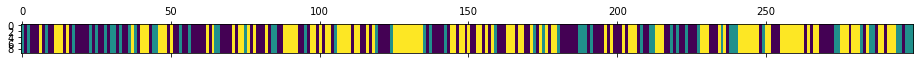

<Figure size 432x288 with 0 Axes>

738
N [[56. 31. 40.]
 [30. 14. 13.]
 [41. 12. 62.]]
alphas [[1.01603678 0.51574825 0.55929214]
 [0.89762152 0.63416351 0.55929214]
 [0.89762152 0.51574825 0.6777074 ]]
M [[9. 1. 2.]
 [4. 2. 3.]
 [3. 1. 5.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[9. 1. 2.]
 [4. 2. 3.]
 [3. 1. 5.]]
pi_z [[0.48200489 0.26096166 0.25703346]
 [0.5287693  0.226026   0.2452047 ]
 [0.36005263 0.12203122 0.51791615]]
beta_vec [0.54366635 0.11373681 0.34259684]
hyper>> a_k: 2.927057243039813  gamma: 0.9746613619753429  rho: 0.03593734981838028


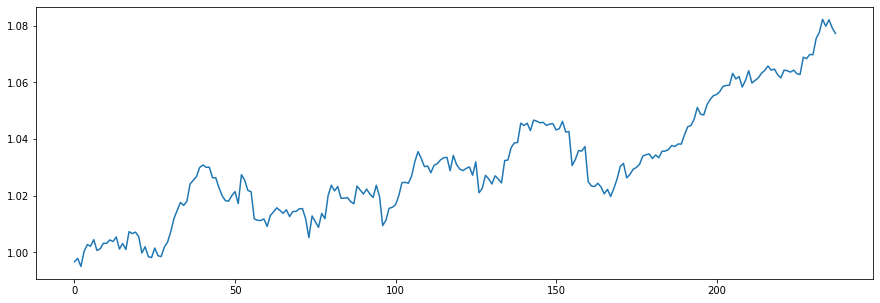

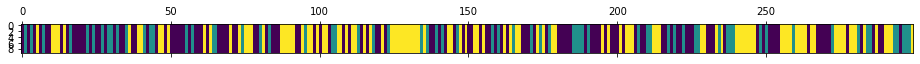

<Figure size 432x288 with 0 Axes>

N [[52. 34. 40.]
 [37. 15. 15.]
 [37. 17. 52.]]
alphas [[1.63934457 0.32095012 0.96676256]
 [1.53415389 0.4261408  0.96676256]
 [1.53415389 0.32095012 1.07195324]]
M [[6. 3. 4.]
 [5. 3. 3.]
 [6. 3. 4.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[6. 3. 4.]
 [5. 3. 3.]
 [6. 3. 4.]]
pi_z [[0.32155466 0.38797164 0.29047369]
 [0.61109988 0.15565487 0.23324525]
 [0.29872992 0.16050563 0.54076445]]
beta_vec [0.4536551  0.14232679 0.40401811]
hyper>> a_k: 3.4861383763040106  gamma: 0.9876604313233396  rho: 0.051021278044828436


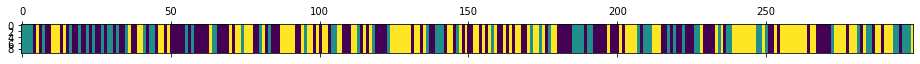

<Figure size 432x288 with 0 Axes>

739
N [[52. 29. 38.]
 [29. 21. 18.]
 [38. 18. 56.]]
alphas [[1.67868131 0.47085562 1.33660145]
 [1.50081408 0.64872285 1.33660145]
 [1.50081408 0.47085562 1.51446868]]
M [[7. 2. 4.]
 [4. 3. 3.]
 [7. 3. 5.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[6. 2. 4.]
 [4. 2. 3.]
 [7. 3. 5.]]
pi_z [[0.39105557 0.27286825 0.33607618]
 [0.44520538 0.34129023 0.21350439]
 [0.3737157  0.16819843 0.45808587]]
beta_vec [0.46997399 0.0941406  0.43588542]
hyper>> a_k: 2.8876801884499756  gamma: 0.18338745035467172  rho: 0.19373631711913378


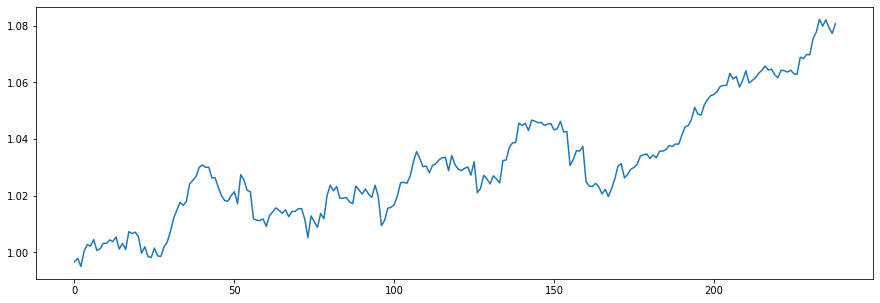

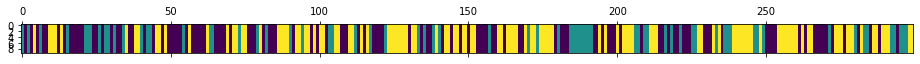

<Figure size 432x288 with 0 Axes>

N [[52. 31. 34.]
 [27. 23. 19.]
 [38. 15. 60.]]
alphas [[1.65365685 0.21918112 1.01484223]
 [1.09420832 0.77862964 1.01484223]
 [1.09420832 0.21918112 1.57429075]]
M [[3. 2. 6.]
 [4. 3. 3.]
 [4. 2. 7.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[2. 2. 6.]
 [4. 1. 3.]
 [4. 2. 6.]]
pi_z [[0.39996618 0.26003033 0.34000349]
 [0.42057879 0.25929742 0.3201238 ]
 [0.27463953 0.14039138 0.58496908]]
beta_vec [0.34550304 0.23876053 0.41573644]
hyper>> a_k: 4.325676206493931  gamma: 0.5638575954736398  rho: 0.20962548426916555


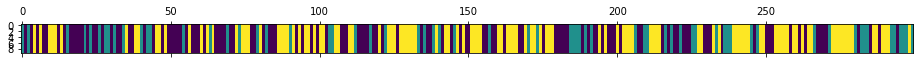

<Figure size 432x288 with 0 Axes>

740
N [[50. 31. 39.]
 [33. 15. 16.]
 [37. 18. 60.]]
alphas [[2.08801377 0.81629938 1.42136306]
 [1.1812418  1.72307135 1.42136306]
 [1.1812418  0.81629938 2.32813503]]
M [[10.  5.  5.]
 [ 3.  3.  4.]
 [ 7.  4.  7.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[7. 5. 5.]
 [3. 2. 4.]
 [7. 4. 6.]]
pi_z [[0.45461809 0.28760211 0.2577798 ]
 [0.44070471 0.25138919 0.30790611]
 [0.36007286 0.14964569 0.49028145]]
beta_vec [0.31119626 0.19438271 0.49442104]
hyper>> a_k: 4.723844027887453  gamma: 0.7141972939325526  rho: 0.18172950945670005


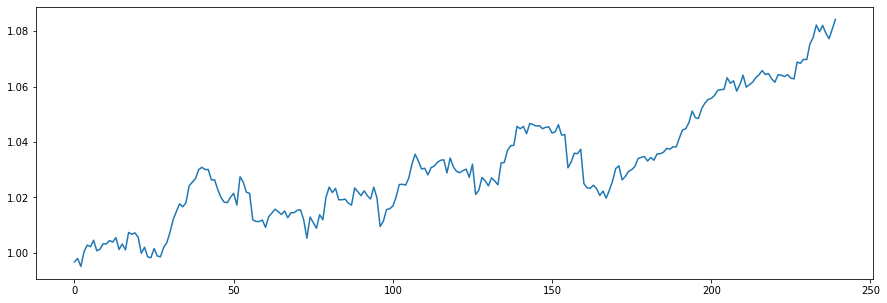

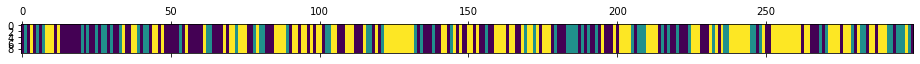

<Figure size 432x288 with 0 Axes>

N [[48. 32. 35.]
 [32. 17. 17.]
 [36. 16. 66.]]
alphas [[2.06135432 0.75136345 1.91112626]
 [1.20289246 1.6098253  1.91112626]
 [1.20289246 0.75136345 2.76958812]]
M [[5. 3. 2.]
 [6. 2. 5.]
 [6. 2. 9.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[3. 3. 2.]
 [6. 2. 5.]
 [6. 2. 9.]]
pi_z [[0.4558397  0.24813486 0.29602545]
 [0.47720364 0.35529521 0.16750115]
 [0.2798881  0.13706595 0.58304595]]
beta_vec [0.32230678 0.2218134  0.45587981]
hyper>> a_k: 3.862491501299135  gamma: 0.16978547711578476  rho: 0.06230786488337393


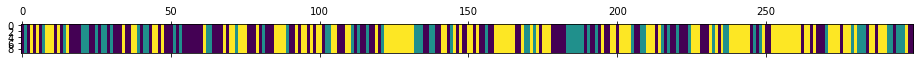

<Figure size 432x288 with 0 Axes>

741
N [[49. 28. 38.]
 [29. 22. 15.]
 [37. 16. 65.]]
alphas [[1.40800331 0.80336996 1.65111823]
 [1.16733971 1.04403356 1.65111823]
 [1.16733971 0.80336996 1.89178183]]
M [[8. 2. 7.]
 [2. 2. 7.]
 [3. 3. 4.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[7. 2. 7.]
 [2. 2. 7.]
 [3. 3. 4.]]
pi_z [[0.3815833  0.26485332 0.35356338]
 [0.32976827 0.3940728  0.27615892]
 [0.2959123  0.12211716 0.58197053]]
beta_vec [0.34425051 0.26150661 0.39424289]
hyper>> a_k: 3.1990068149961695  gamma: 0.6664143861228393  rho: 0.03135271256712665


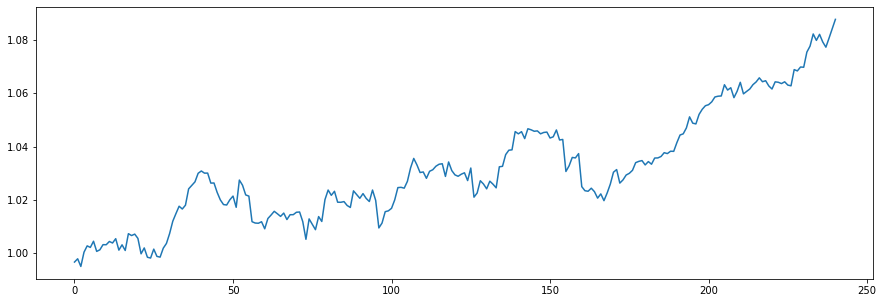

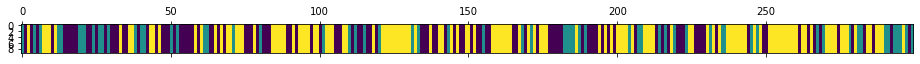

<Figure size 432x288 with 0 Axes>

N [[44. 29. 39.]
 [26. 16. 19.]
 [41. 17. 68.]]
alphas [[1.16702979 0.81033294 1.22164408]
 [1.06673225 0.91063048 1.22164408]
 [1.06673225 0.81033294 1.32194163]]
M [[4. 5. 5.]
 [3. 2. 6.]
 [9. 2. 7.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[4. 5. 5.]
 [3. 2. 6.]
 [9. 2. 7.]]
pi_z [[0.31713764 0.24183076 0.44103161]
 [0.38218824 0.18804354 0.42976822]
 [0.35770368 0.16980145 0.47249488]]
beta_vec [0.43250484 0.17080563 0.39668953]
hyper>> a_k: 3.3920187162029594  gamma: 0.9345591865988843  rho: 0.033080185920429


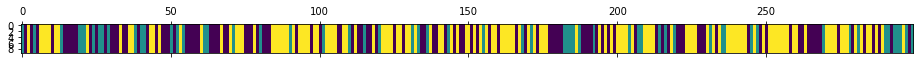

<Figure size 432x288 with 0 Axes>

742
N [[43. 25. 44.]
 [23. 13. 22.]
 [46. 20. 63.]]
alphas [[1.53074236 0.56021004 1.30106632]
 [1.41853375 0.67241865 1.30106632]
 [1.41853375 0.56021004 1.41327492]]
M [[ 9.  3. 10.]
 [ 4.  2.  4.]
 [ 7.  4.  6.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[ 9.  3. 10.]
 [ 4.  2.  4.]
 [ 7.  4.  6.]]
pi_z [[0.34734406 0.22415393 0.428502  ]
 [0.4199415  0.2395829  0.3404756 ]
 [0.2967642  0.22532111 0.47791469]]
beta_vec [0.49062182 0.16595611 0.34342207]
hyper>> a_k: 6.347139031580513  gamma: 0.6123826966621799  rho: 0.01968362654290667


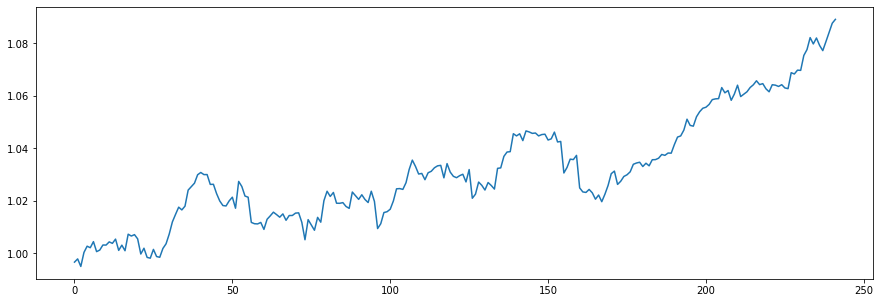

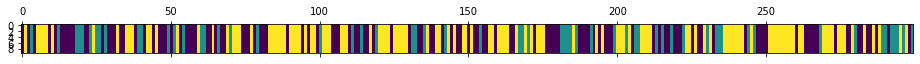

<Figure size 432x288 with 0 Axes>

N [[52. 24. 45.]
 [31. 16. 12.]
 [37. 20. 62.]]
alphas [[3.1776839  1.03261283 2.1368423 ]
 [3.05274919 1.15754754 2.1368423 ]
 [3.05274919 1.03261283 2.26177701]]
M [[5. 6. 9.]
 [9. 2. 5.]
 [9. 4. 8.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[5. 6. 9.]
 [9. 2. 5.]
 [9. 4. 6.]]
pi_z [[0.38573457 0.16041258 0.45385286]
 [0.53779765 0.21080963 0.25139272]
 [0.28747819 0.22904271 0.4834791 ]]
beta_vec [0.43069924 0.27484642 0.29445433]
hyper>> a_k: 4.988266040559875  gamma: 0.7196070904641015  rho: 0.061921383927736495


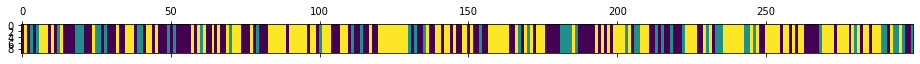

<Figure size 432x288 with 0 Axes>

743
N [[51. 20. 45.]
 [24. 13. 15.]
 [41. 19. 71.]]
alphas [[2.32428821 1.28611243 1.3778654 ]
 [2.01540787 1.59499277 1.3778654 ]
 [2.01540787 1.28611243 1.68674574]]
M [[11.  4.  6.]
 [ 4.  7.  2.]
 [ 8.  3.  7.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[11.  4.  6.]
 [ 4.  5.  2.]
 [ 8.  3.  5.]]
pi_z [[0.42626047 0.17013684 0.40360269]
 [0.40992479 0.30425435 0.28582086]
 [0.28094824 0.18340151 0.53565025]]
beta_vec [0.46493836 0.32940253 0.20565911]
hyper>> a_k: 6.521878023814054  gamma: 2.141919847982365  rho: 0.0979100920589073


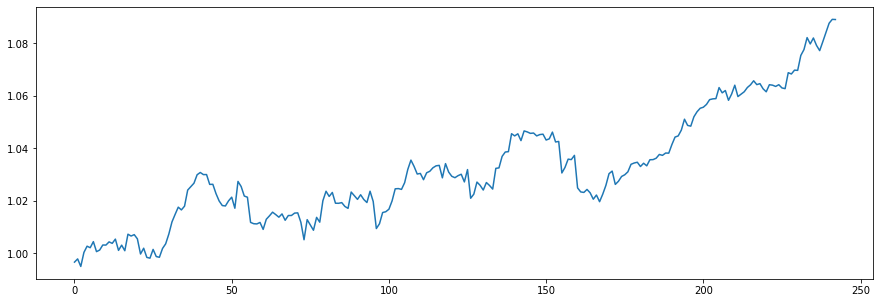

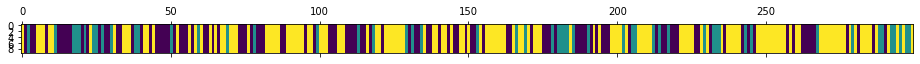

<Figure size 432x288 with 0 Axes>

N [[45. 21. 43.]
 [24. 13. 16.]
 [40. 18. 79.]]
alphas [[3.37393898 1.93798062 1.20995842]
 [2.7353813  2.5765383  1.20995842]
 [2.7353813  1.93798062 1.8485161 ]]
M [[9. 7. 5.]
 [7. 5. 4.]
 [3. 7. 9.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[6. 7. 5.]
 [7. 4. 4.]
 [3. 7. 5.]]
pi_z [[0.41508137 0.1943794  0.39053923]
 [0.43908792 0.29469825 0.26621383]
 [0.29764269 0.15226634 0.55009097]]
beta_vec [0.36969631 0.38407295 0.24623074]
hyper>> a_k: 4.83906924369238  gamma: 0.7416838665524462  rho: 0.20641983288869148


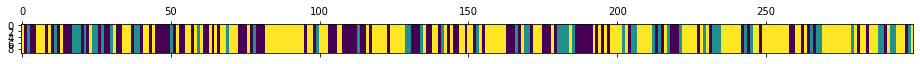

<Figure size 432x288 with 0 Axes>

744
N [[38. 20. 45.]
 [25. 15. 13.]
 [40. 18. 85.]]
alphas [[2.4185837  1.47491285 0.94557269]
 [1.41970384 2.47379272 0.94557269]
 [1.41970384 1.47491285 1.94445255]]
M [[ 5.  6. 11.]
 [ 3.  5.  1.]
 [ 4.  3.  6.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[ 4.  6. 11.]
 [ 3.  5.  1.]
 [ 4.  3.  2.]]
pi_z [[0.38559332 0.17970908 0.4346976 ]
 [0.37114035 0.32880014 0.30005951]
 [0.32372615 0.13435691 0.54191694]]
beta_vec [0.32443426 0.45014614 0.2254196 ]
hyper>> a_k: 4.1905893522169775  gamma: 0.2120053472220512  rho: 0.08665082539151953


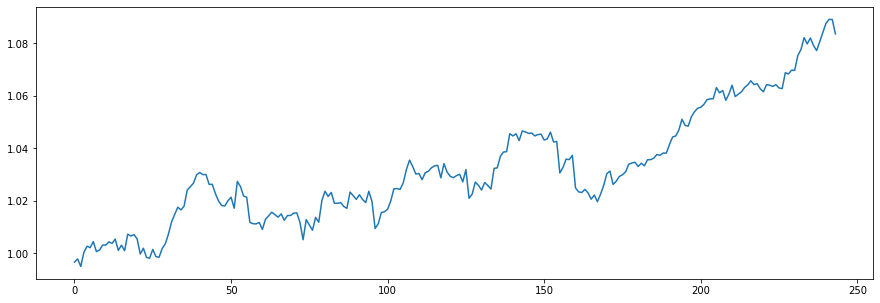

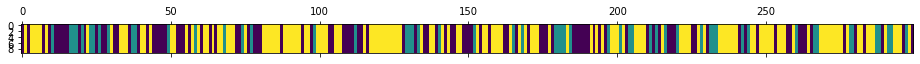

<Figure size 432x288 with 0 Axes>

N [[40. 18. 47.]
 [26. 16. 13.]
 [40. 21. 78.]]
alphas [[1.60488087 1.72292144 0.86278704]
 [1.24176285 2.08603946 0.86278704]
 [1.24176285 1.72292144 1.22590507]]
M [[6. 7. 6.]
 [3. 6. 3.]
 [6. 6. 5.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[6. 7. 6.]
 [3. 5. 3.]
 [6. 6. 3.]]
pi_z [[0.46379607 0.18172441 0.35447952]
 [0.41418039 0.36153878 0.22428083]
 [0.2728595  0.16029992 0.56684058]]
beta_vec [0.40490272 0.31458505 0.28051222]
hyper>> a_k: 6.0238244315985545  gamma: 0.4544441831945561  rho: 0.04757829988424251


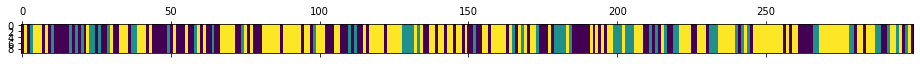

<Figure size 432x288 with 0 Axes>

745
N [[41. 21. 43.]
 [25. 18. 15.]
 [39. 19. 78.]]
alphas [[2.60961978 1.804844   1.60936066]
 [2.32301645 2.09144732 1.60936066]
 [2.32301645 1.804844   1.89596398]]
M [[6. 6. 8.]
 [9. 3. 5.]
 [7. 7. 4.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[6. 6. 8.]
 [9. 3. 5.]
 [7. 7. 4.]]
pi_z [[0.39704654 0.17956308 0.42339037]
 [0.3587607  0.41744363 0.22379567]
 [0.3017772  0.18996723 0.50825557]]
beta_vec [0.36451941 0.40177006 0.23371053]
hyper>> a_k: 4.2355474605854  gamma: 0.6830310106988942  rho: 0.0016501682435175898


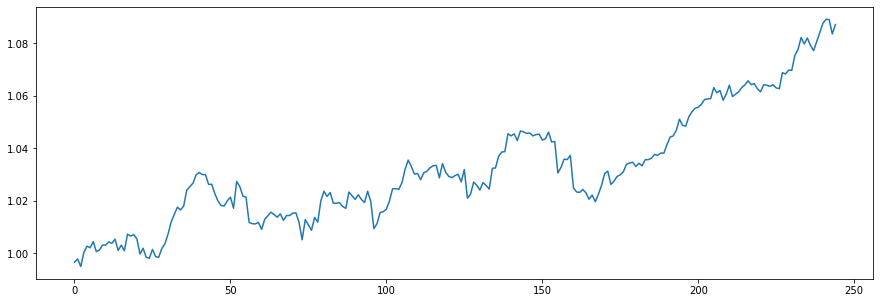

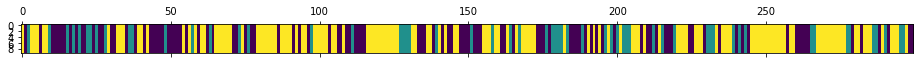

<Figure size 432x288 with 0 Axes>

N [[44. 25. 37.]
 [27. 16. 15.]
 [35. 17. 83.]]
alphas [[1.54838088 1.69890803 0.98825854]
 [1.54139152 1.7058974  0.98825854]
 [1.54139152 1.69890803 0.99524791]]
M [[6. 4. 3.]
 [7. 5. 4.]
 [5. 4. 4.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[6. 4. 3.]
 [7. 5. 4.]
 [5. 4. 4.]]
pi_z [[0.41086455 0.15156897 0.43756648]
 [0.45592234 0.33358925 0.21048841]
 [0.29223802 0.12246151 0.58530047]]
beta_vec [0.44005057 0.41295786 0.14699158]
hyper>> a_k: 3.4269848950995447  gamma: 0.5645671609345578  rho: 0.09637530750139552


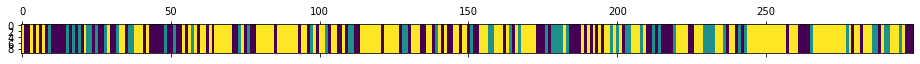

<Figure size 432x288 with 0 Axes>

746
N [[36. 21. 42.]
 [26. 14. 16.]
 [37. 21. 86.]]
alphas [[1.69298491 1.27880997 0.45519002]
 [1.36270818 1.60908669 0.45519002]
 [1.36270818 1.27880997 0.78546675]]
M [[8. 3. 3.]
 [4. 6. 2.]
 [6. 6. 3.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[4. 3. 3.]
 [4. 4. 2.]
 [6. 6. 1.]]
pi_z [[0.3867522  0.1887968  0.424451  ]
 [0.47342343 0.28799511 0.23858146]
 [0.28061148 0.15192659 0.56746193]]
beta_vec [0.4678217  0.38324477 0.14893353]
hyper>> a_k: 3.018166904661547  gamma: 0.5645044721682543  rho: 0.30788718747288185


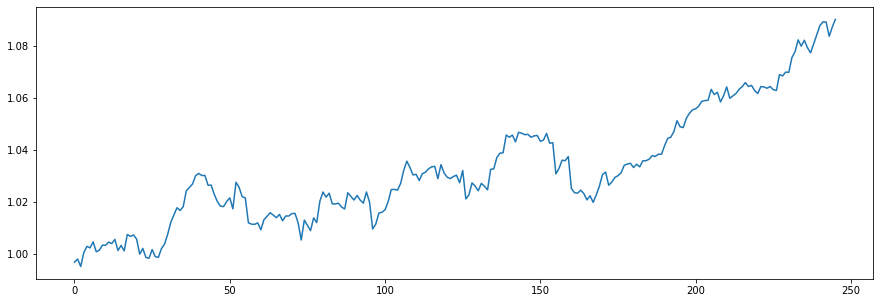

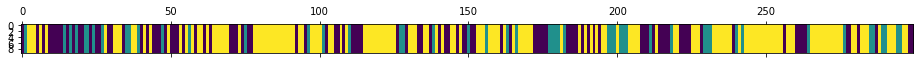

<Figure size 432x288 with 0 Axes>

N [[42. 17. 40.]
 [20. 15. 15.]
 [37. 18. 95.]]
alphas [[1.90649327 0.80056459 0.31110904]
 [0.97723835 1.72981951 0.31110904]
 [0.97723835 0.80056459 1.24036396]]
M [[3. 2. 2.]
 [6. 3. 2.]
 [6. 3. 4.]]
sum_w [[2.]
 [2.]
 [4.]]
barM [[1. 2. 2.]
 [6. 1. 2.]
 [6. 3. 0.]]
pi_z [[0.47423212 0.17063755 0.35513033]
 [0.41110994 0.25941773 0.32947233]
 [0.25466305 0.13165594 0.61368101]]
beta_vec [0.50257987 0.33737323 0.1600469 ]
hyper>> a_k: 2.0662667670830133  gamma: 0.19479318334708398  rho: 0.23010448094698277


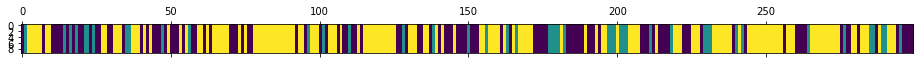

<Figure size 432x288 with 0 Axes>

747
N [[50. 18. 40.]
 [22. 13. 10.]
 [36. 14. 96.]]
alphas [[1.27496609 0.53669655 0.25460414]
 [0.79950885 1.01215379 0.25460414]
 [0.79950885 0.53669655 0.73006138]]
M [[5. 2. 1.]
 [6. 4. 1.]
 [4. 2. 4.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[3. 2. 1.]
 [6. 2. 1.]
 [4. 2. 3.]]
pi_z [[0.56197142 0.1254656  0.31256298]
 [0.45784156 0.32847491 0.21368353]
 [0.21418962 0.06548603 0.72032435]]
beta_vec [0.69362831 0.13657279 0.1697989 ]
hyper>> a_k: 2.8723666409658835  gamma: 0.922381604864167  rho: 0.22762052196995194


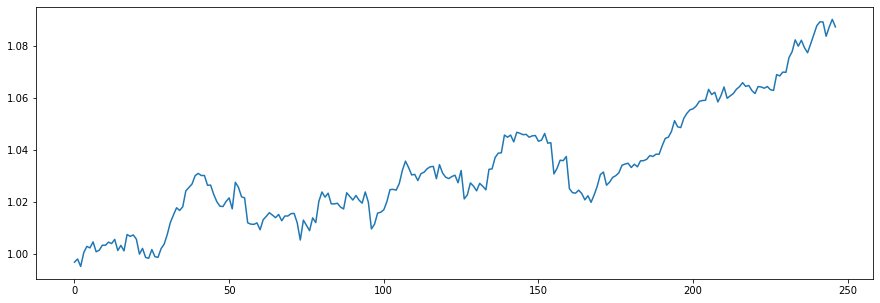

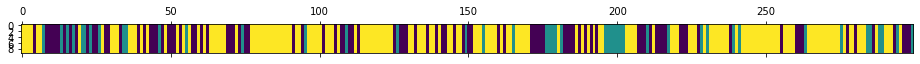

<Figure size 432x288 with 0 Axes>

N [[ 38.  14.  44.]
 [ 19.  13.  12.]
 [ 38.  18. 103.]]
alphas [[2.19266356 0.30299453 0.37670855]
 [1.53885397 0.95680412 0.37670855]
 [1.53885397 0.30299453 1.03051815]]
M [[7. 1. 3.]
 [5. 4. 2.]
 [5. 1. 4.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[5. 1. 3.]
 [5. 1. 2.]
 [5. 1. 1.]]
pi_z [[0.47789891 0.10059621 0.42150488]
 [0.39204182 0.42059911 0.18735908]
 [0.21644021 0.15118919 0.6323706 ]]
beta_vec [0.54957761 0.06778119 0.3826412 ]
hyper>> a_k: 2.5662448139406266  gamma: 0.9784397408843177  rho: 0.20326639578337158


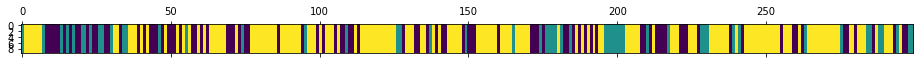

<Figure size 432x288 with 0 Axes>

748
N [[ 33.  19.  40.]
 [ 24.  18.  10.]
 [ 35.  15. 105.]]
alphas [[1.64530512 0.13858634 0.78235336]
 [1.12367379 0.66021767 0.78235336]
 [1.12367379 0.13858634 1.30398469]]
M [[4. 1. 1.]
 [2. 2. 2.]
 [4. 1. 7.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[1. 1. 1.]
 [2. 1. 2.]
 [4. 1. 2.]]
pi_z [[0.38864037 0.1929143  0.41844533]
 [0.41182654 0.42482704 0.16334641]
 [0.25504139 0.11041865 0.63453996]]
beta_vec [0.37939638 0.09487081 0.52573281]
hyper>> a_k: 1.841449354227176  gamma: 0.4538837859516318  rho: 0.31221416096894195


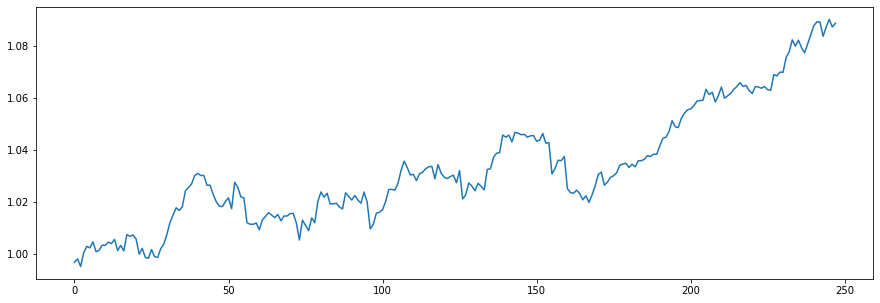

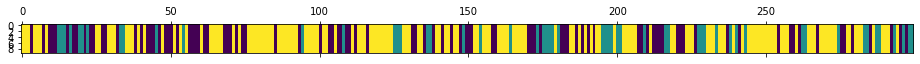

<Figure size 432x288 with 0 Axes>

N [[35. 15. 45.]
 [20. 20. 13.]
 [40. 18. 93.]]
alphas [[1.05544073 0.12015604 0.66585259]
 [0.48051416 0.6950826  0.66585259]
 [0.48051416 0.12015604 1.24077915]]
M [[1. 1. 2.]
 [1. 4. 5.]
 [4. 1. 5.]]
sum_w [[1.]
 [4.]
 [2.]]
barM [[0. 1. 2.]
 [1. 0. 5.]
 [4. 1. 3.]]
pi_z [[0.4023609  0.11752919 0.48010991]
 [0.44541303 0.35399556 0.20059141]
 [0.25631647 0.16982908 0.57385445]]
beta_vec [0.31301284 0.09773618 0.58925097]
hyper>> a_k: 1.5577271888158404  gamma: 1.2555138198886633  rho: 0.29541472543736474


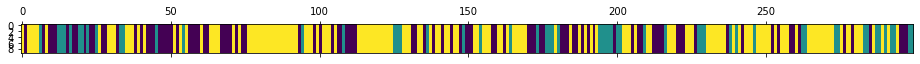

<Figure size 432x288 with 0 Axes>

749
N [[42. 13. 44.]
 [20. 21. 14.]
 [37. 21. 87.]]
alphas [[0.80372331 0.10727051 0.64673337]
 [0.34354776 0.56744606 0.64673337]
 [0.34354776 0.10727051 1.10690892]]
M [[4. 1. 4.]
 [2. 1. 2.]
 [1. 1. 7.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[1. 1. 4.]
 [2. 0. 2.]
 [1. 1. 2.]]
pi_z [[0.39855912 0.10211145 0.49932943]
 [0.29173117 0.40815373 0.3001151 ]
 [0.29637051 0.14923389 0.5543956 ]]
beta_vec [0.22085109 0.13472801 0.6444209 ]
hyper>> a_k: 1.5663220409719443  gamma: 0.7586736414632904  rho: 0.5396818592078272


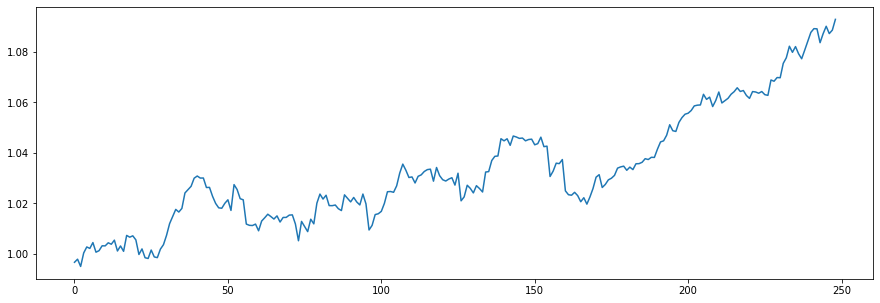

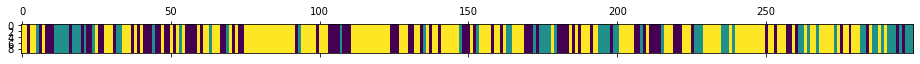

<Figure size 432x288 with 0 Axes>

N [[35. 14. 39.]
 [20. 25. 16.]
 [33. 22. 95.]]
alphas [[1.00455065 0.09713976 0.46463163]
 [0.15923506 0.94245536 0.46463163]
 [0.15923506 0.09713976 1.30994722]]
M [[3. 1. 3.]
 [1. 5. 3.]
 [1. 1. 7.]]
sum_w [[1.]
 [5.]
 [5.]]
barM [[2. 1. 3.]
 [1. 0. 3.]
 [1. 1. 2.]]
pi_z [[0.42322044 0.08716447 0.48961509]
 [0.23717937 0.44349482 0.31932581]
 [0.19075596 0.12655325 0.68269078]]
beta_vec [0.245952   0.04395457 0.71009342]
hyper>> a_k: 1.5848867627594487  gamma: 0.7447953537864501  rho: 0.39833404794865124


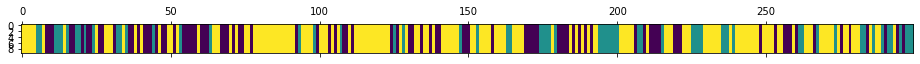

<Figure size 432x288 with 0 Axes>

750
N [[37. 15. 38.]
 [17. 26. 19.]
 [36. 21. 90.]]
alphas [[0.8658474  0.04191387 0.67712549]
 [0.23453304 0.67322823 0.67712549]
 [0.23453304 0.04191387 1.30843985]]
M [[3. 1. 2.]
 [1. 3. 1.]
 [2. 2. 4.]]
sum_w [[3.]
 [3.]
 [1.]]
barM [[0. 1. 2.]
 [1. 0. 1.]
 [2. 2. 3.]]
pi_z [[0.43880075 0.17551336 0.38568589]
 [0.2903061  0.37343876 0.33625514]
 [0.32329474 0.13754522 0.53916003]]
beta_vec [0.57110869 0.09140972 0.33748159]
hyper>> a_k: 0.8947098217248084  gamma: 0.8864231027644717  rho: 0.2112906982564062


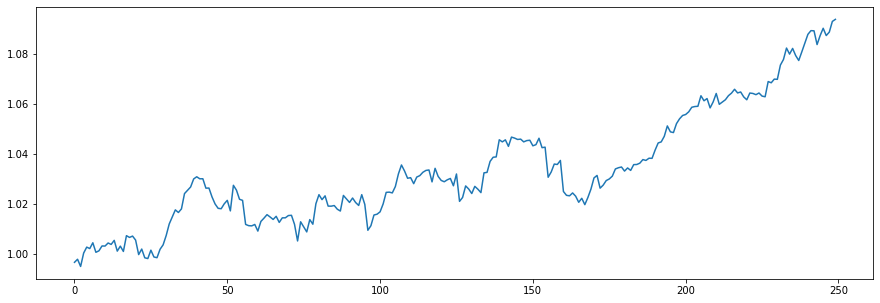

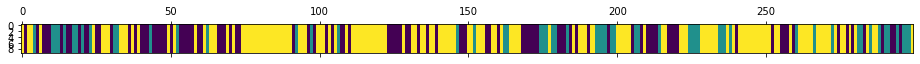

<Figure size 432x288 with 0 Axes>

N [[44. 18. 37.]
 [18. 22. 17.]
 [37. 16. 90.]]
alphas [[0.59205582 0.06450473 0.23814927]
 [0.40301196 0.25354859 0.23814927]
 [0.40301196 0.06450473 0.42719313]]
M [[6. 1. 2.]
 [4. 2. 3.]
 [2. 1. 4.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[5. 1. 2.]
 [4. 0. 3.]
 [2. 1. 0.]]
pi_z [[0.43294753 0.18349638 0.38355609]
 [0.31158262 0.4257691  0.26264828]
 [0.29322996 0.11326606 0.59350398]]
beta_vec [0.65624418 0.12001182 0.223744  ]
hyper>> a_k: 1.3979386211758733  gamma: 0.9321362736370306  rho: 0.3394964029581579


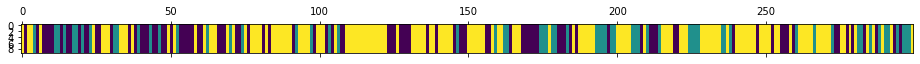

<Figure size 432x288 with 0 Axes>

751
N [[40. 23. 32.]
 [21. 21. 20.]
 [34. 18. 90.]]
alphas [[1.08053392 0.11081213 0.20659257]
 [0.60593879 0.58540726 0.20659257]
 [0.60593879 0.11081213 0.6811877 ]]
M [[5. 1. 2.]
 [3. 4. 2.]
 [3. 1. 5.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[3. 1. 2.]
 [3. 3. 2.]
 [3. 1. 2.]]
pi_z [[0.46246076 0.23699547 0.30054377]
 [0.31082388 0.38696538 0.30221075]
 [0.18649313 0.15628285 0.65722403]]
beta_vec [0.35406091 0.28507841 0.36086068]
hyper>> a_k: 1.8088415763512709  gamma: 1.7145720650008693  rho: 0.2745331960574234


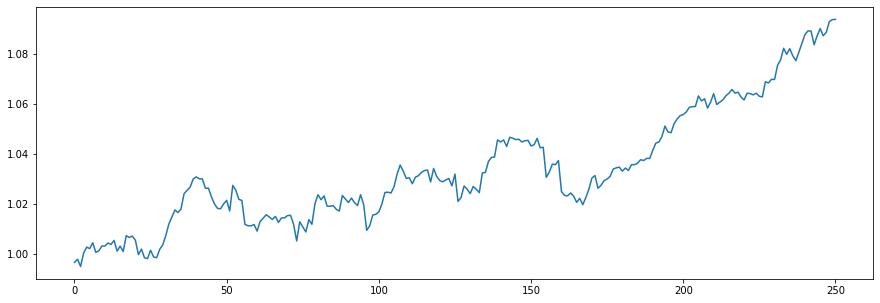

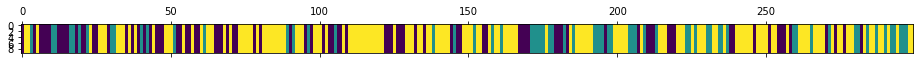

<Figure size 432x288 with 0 Axes>

N [[36. 18. 34.]
 [17. 22. 25.]
 [35. 24. 88.]]
alphas [[0.96120509 0.37409543 0.47354106]
 [0.46461803 0.87068248 0.47354106]
 [0.46461803 0.37409543 0.97012812]]
M [[3. 2. 2.]
 [1. 2. 1.]
 [4. 2. 4.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[1. 2. 2.]
 [1. 1. 1.]
 [4. 2. 2.]]
pi_z [[0.43954754 0.19189376 0.3685587 ]
 [0.27528808 0.45346317 0.27124875]
 [0.2190512  0.16717657 0.61377223]]
beta_vec [0.43443462 0.37612314 0.18944224]
hyper>> a_k: 1.7498940782093555  gamma: 0.49725141681083707  rho: 0.23320312119980088


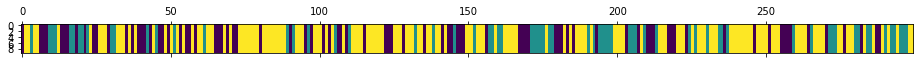

<Figure size 432x288 with 0 Axes>

752
N [[31. 14. 39.]
 [20. 26. 22.]
 [33. 28. 86.]]
alphas [[0.99101092 0.50468704 0.25419612]
 [0.58293016 0.9127678  0.25419612]
 [0.58293016 0.50468704 0.66227688]]
M [[2. 3. 1.]
 [3. 4. 3.]
 [5. 4. 8.]]
sum_w [[1.]
 [2.]
 [6.]]
barM [[1. 3. 1.]
 [3. 2. 3.]
 [5. 4. 2.]]
pi_z [[0.28043453 0.24945677 0.4701087 ]
 [0.32935537 0.41198336 0.25866127]
 [0.20079588 0.22862834 0.57057578]]
beta_vec [0.26295844 0.48129756 0.255744  ]
hyper>> a_k: 2.956785498652855  gamma: 0.3688863046224861  rho: 0.23908300123904522


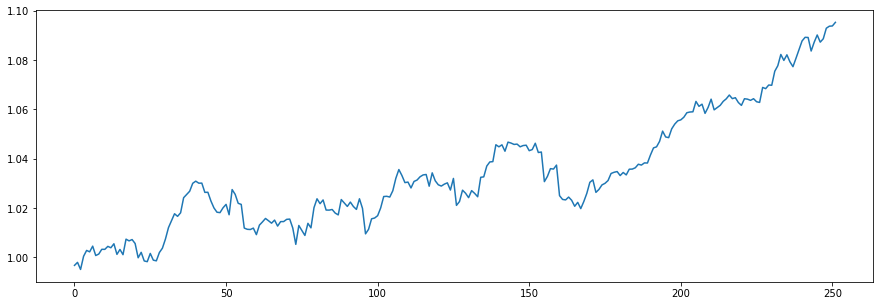

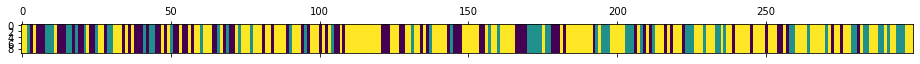

<Figure size 432x288 with 0 Axes>

N [[26. 14. 39.]
 [19. 23. 23.]
 [34. 28. 93.]]
alphas [[1.29853903 1.08285614 0.57539033]
 [0.59162188 1.78977329 0.57539033]
 [0.59162188 1.08285614 1.28230748]]
M [[4. 2. 2.]
 [1. 5. 2.]
 [2. 5. 6.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[1. 2. 2.]
 [1. 2. 2.]
 [2. 5. 1.]]
pi_z [[0.32871143 0.15051768 0.52077089]
 [0.30714297 0.30540598 0.38745105]
 [0.21895582 0.22263527 0.55840891]]
beta_vec [0.13518947 0.49434584 0.37046469]
hyper>> a_k: 2.055858357866087  gamma: 0.7169460050003419  rho: 0.2765087275577086


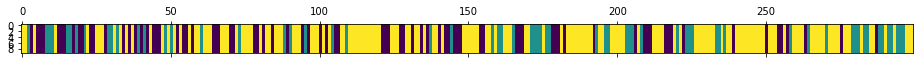

<Figure size 432x288 with 0 Axes>

753
N [[30. 13. 38.]
 [16. 22. 25.]
 [35. 28. 92.]]
alphas [[0.769543   0.73528782 0.55102754]
 [0.20108023 1.3037506  0.55102754]
 [0.20108023 0.73528782 1.11949031]]
M [[5. 5. 6.]
 [2. 7. 1.]
 [2. 2. 6.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[1. 5. 6.]
 [2. 4. 1.]
 [2. 2. 2.]]
pi_z [[0.41652642 0.09617947 0.48729411]
 [0.35149752 0.30837542 0.34012706]
 [0.21959166 0.18136509 0.59904325]]
beta_vec [0.21798279 0.37559773 0.40641948]
hyper>> a_k: 3.3196090293276552  gamma: 0.9251068149055108  rho: 0.2532347080989271


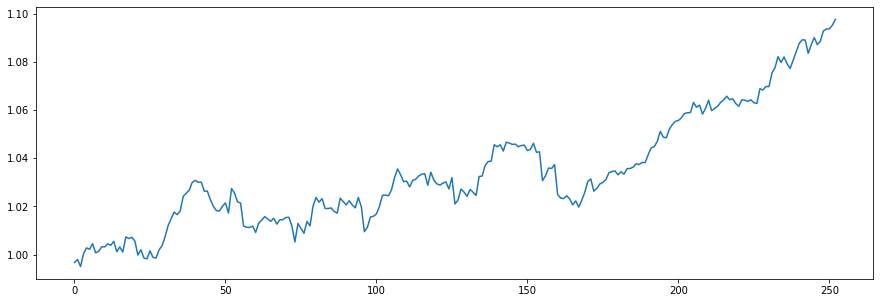

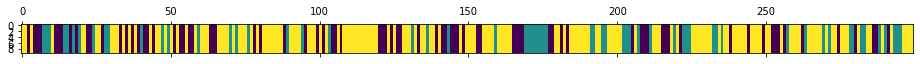

<Figure size 432x288 with 0 Axes>

N [[29. 11. 41.]
 [15. 22. 24.]
 [37. 28. 92.]]
alphas [[1.38101276 0.93109506 1.00750121]
 [0.54037253 1.77173529 1.00750121]
 [0.54037253 0.93109506 1.84814143]]
M [[5. 4. 3.]
 [2. 2. 3.]
 [3. 4. 5.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[3. 4. 3.]
 [2. 1. 3.]
 [3. 4. 3.]]
pi_z [[0.41723808 0.14528226 0.43747966]
 [0.24338395 0.41433496 0.34228108]
 [0.22344336 0.17080313 0.60575351]]
beta_vec [0.40157034 0.29530156 0.3031281 ]
hyper>> a_k: 2.593292351626332  gamma: 2.529475974279719  rho: 0.2599179484640482


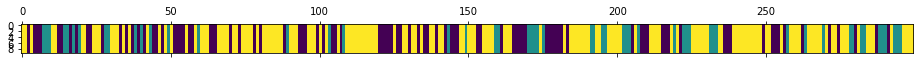

<Figure size 432x288 with 0 Axes>

754
N [[40. 13. 41.]
 [15. 22. 17.]
 [39. 19. 93.]]
alphas [[1.44475676 0.56675726 0.58177833]
 [0.77071353 1.24080049 0.58177833]
 [0.77071353 0.56675726 1.25582156]]
M [[7. 2. 2.]
 [2. 4. 4.]
 [1. 1. 4.]]
sum_w [[3.]
 [3.]
 [1.]]
barM [[4. 2. 2.]
 [2. 1. 4.]
 [1. 1. 3.]]
pi_z [[0.42034785 0.13466434 0.44498781]
 [0.25916143 0.4714983  0.26934027]
 [0.23803354 0.1467537  0.61521276]]
beta_vec [0.30446173 0.28705953 0.40847874]
hyper>> a_k: 1.939564296291909  gamma: 0.6967139575623479  rho: 0.30476180721679086


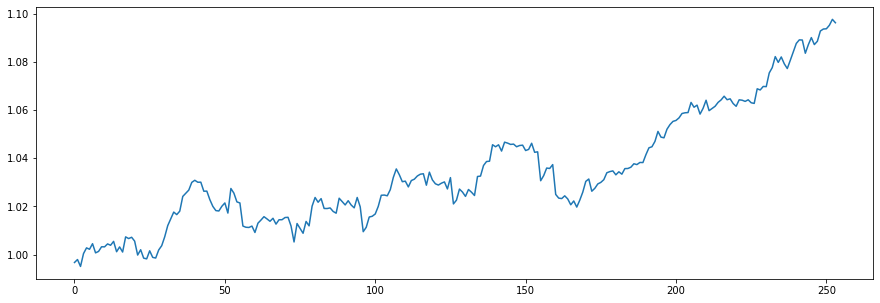

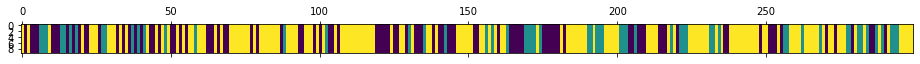

<Figure size 432x288 with 0 Axes>

N [[41. 14. 40.]
 [17. 20. 20.]
 [37. 23. 87.]]
alphas [[1.00165933 0.38708806 0.55081691]
 [0.41055421 0.97819318 0.55081691]
 [0.41055421 0.38708806 1.14192203]]
M [[4. 2. 2.]
 [1. 1. 4.]
 [2. 4. 4.]]
sum_w [[1.]
 [1.]
 [4.]]
barM [[3. 2. 2.]
 [1. 0. 4.]
 [2. 4. 0.]]
pi_z [[0.49865189 0.14107137 0.36027674]
 [0.26520978 0.38003586 0.35475436]
 [0.21488975 0.18445081 0.60065944]]
beta_vec [0.29178592 0.22413493 0.48407915]
hyper>> a_k: 1.8292166202521334  gamma: 1.3680067685643564  rho: 0.2997073846797406


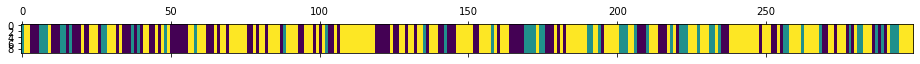

<Figure size 432x288 with 0 Axes>

755
N [[43. 15. 38.]
 [15. 18. 18.]
 [38. 18. 96.]]
alphas [[0.92200366 0.28711391 0.62009905]
 [0.37377393 0.83534364 0.62009905]
 [0.37377393 0.28711391 1.16832878]]
M [[5. 2. 2.]
 [2. 1. 3.]
 [2. 2. 8.]]
sum_w [[4.]
 [0.]
 [3.]]
barM [[1. 2. 2.]
 [2. 1. 3.]
 [2. 2. 5.]]
pi_z [[0.44945937 0.13486506 0.41567557]
 [0.25561417 0.3893292  0.35505662]
 [0.28340031 0.12591112 0.59068857]]
beta_vec [0.13471423 0.24530551 0.61998025]
hyper>> a_k: 1.7735992459377938  gamma: 0.49822619675749336  rho: 0.34637861420256466


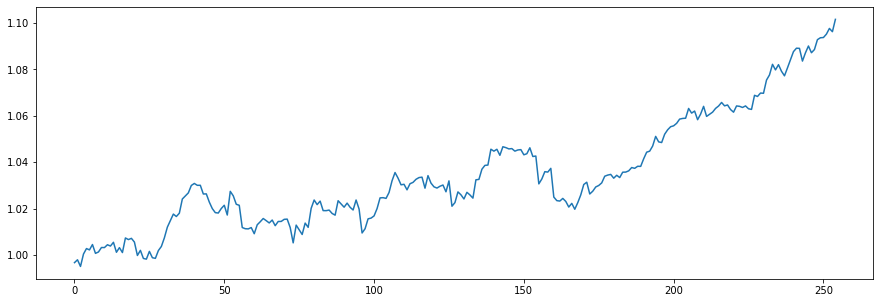

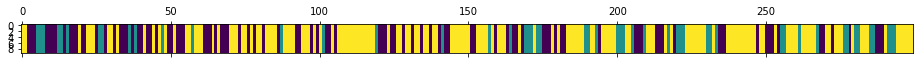

<Figure size 432x288 with 0 Axes>

N [[41. 17. 39.]
 [13. 19. 19.]
 [43. 15. 93.]]
alphas [[0.77050599 0.28437346 0.7187198 ]
 [0.15616914 0.89871031 0.7187198 ]
 [0.15616914 0.28437346 1.33305664]]
M [[4. 1. 3.]
 [1. 3. 3.]
 [1. 1. 5.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[2. 1. 3.]
 [1. 2. 3.]
 [1. 1. 2.]]
pi_z [[0.3455515  0.19184392 0.46260457]
 [0.26468687 0.39729245 0.33802069]
 [0.23753391 0.10893341 0.65353267]]
beta_vec [0.20824932 0.26372539 0.52802529]
hyper>> a_k: 1.3491370578977369  gamma: 0.5185767793669969  rho: 0.42130583229173324


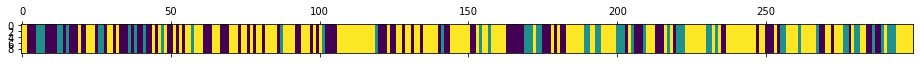

<Figure size 432x288 with 0 Axes>

756
N [[44. 16. 36.]
 [15. 19. 19.]
 [37. 18. 95.]]
alphas [[0.73098741 0.20590037 0.41224928]
 [0.1625881  0.77429968 0.41224928]
 [0.1625881  0.20590037 0.98064859]]
M [[4. 1. 4.]
 [1. 3. 4.]
 [1. 1. 6.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[3. 1. 4.]
 [1. 0. 4.]
 [1. 1. 2.]]
pi_z [[0.42939384 0.18749108 0.38311508]
 [0.32137743 0.35902185 0.31960072]
 [0.22034839 0.13342781 0.6462238 ]]
beta_vec [0.35054805 0.29175133 0.35770062]
hyper>> a_k: 2.7558871122848543  gamma: 0.6086483019339702  rho: 0.2979639752320137


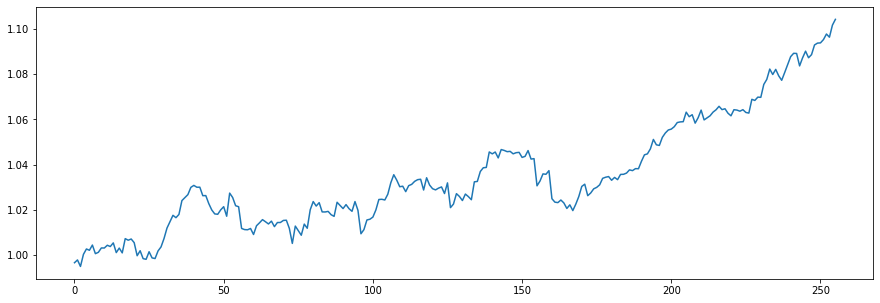

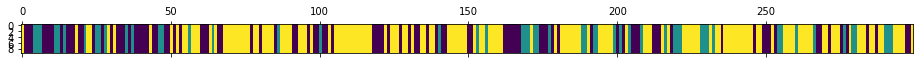

<Figure size 432x288 with 0 Axes>

N [[43. 16. 39.]
 [20. 18. 15.]
 [34. 19. 95.]]
alphas [[1.49937161 0.56446065 0.69205485]
 [0.67821654 1.38561572 0.69205485]
 [0.67821654 0.56446065 1.51320993]]
M [[4. 2. 4.]
 [2. 2. 3.]
 [2. 1. 5.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[0. 2. 4.]
 [2. 1. 3.]
 [2. 1. 3.]]
pi_z [[0.47723204 0.19997826 0.3227897 ]
 [0.38886475 0.26227412 0.34886113]
 [0.27421218 0.11482754 0.61096028]]
beta_vec [0.21862748 0.23316502 0.5482075 ]
hyper>> a_k: 1.1074210020461723  gamma: 0.29210894948371785  rho: 0.33604012094402846


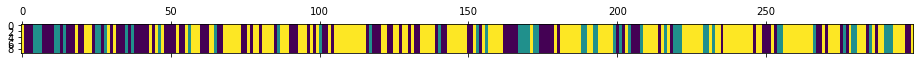

<Figure size 432x288 with 0 Axes>

757
N [[45. 17. 37.]
 [17. 17. 17.]
 [37. 17. 95.]]
alphas [[0.53289098 0.1714423  0.40308772]
 [0.16075309 0.54358019 0.40308772]
 [0.16075309 0.1714423  0.77522561]]
M [[3. 3. 2.]
 [1. 4. 5.]
 [2. 1. 4.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[2. 3. 2.]
 [1. 1. 5.]
 [2. 1. 1.]]
pi_z [[0.44286824 0.15941521 0.39771655]
 [0.3005517  0.31891562 0.38053269]
 [0.21033057 0.07798663 0.71168281]]
beta_vec [0.12146631 0.42571173 0.45282196]
hyper>> a_k: 1.569203441549688  gamma: 0.5609639732620273  rho: 0.3702992110586745


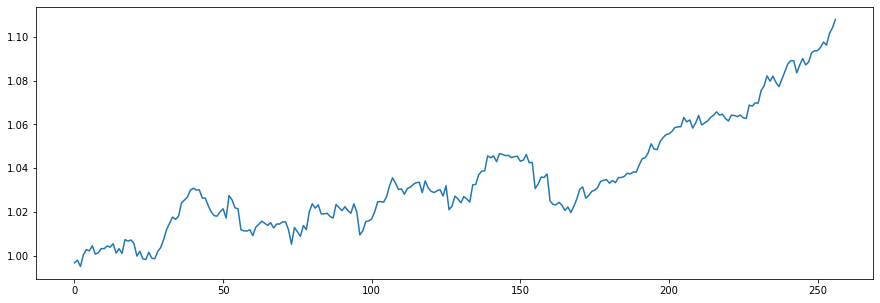

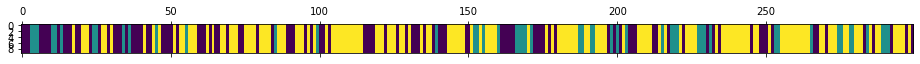

<Figure size 432x288 with 0 Axes>

N [[46. 17. 40.]
 [15. 19. 16.]
 [43. 14. 89.]]
alphas [[0.70109914 0.42065795 0.44744635]
 [0.12002434 1.00173275 0.44744635]
 [0.12002434 0.42065795 1.02852115]]
M [[6. 3. 1.]
 [1. 2. 1.]
 [1. 2. 6.]]
sum_w [[5.]
 [1.]
 [6.]]
barM [[1. 3. 1.]
 [1. 1. 1.]
 [1. 2. 0.]]
pi_z [[0.52956162 0.18016505 0.29027333]
 [0.33142739 0.28597595 0.38259666]
 [0.27037901 0.10992411 0.61969688]]
beta_vec [0.30129804 0.46176765 0.23693431]
hyper>> a_k: 1.8703107146989935  gamma: 0.8358379149419429  rho: 0.43832046884335557


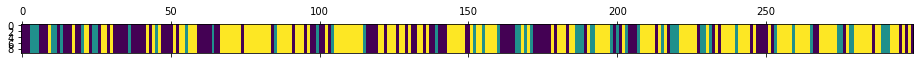

<Figure size 432x288 with 0 Axes>

758
N [[47. 19. 34.]
 [16. 15. 21.]
 [36. 19. 92.]]
alphas [[1.13631366 0.48509395 0.2489031 ]
 [0.31651819 1.30488942 0.2489031 ]
 [0.31651819 0.48509395 1.06869857]]
M [[4. 3. 1.]
 [2. 5. 1.]
 [1. 2. 5.]]
sum_w [[4.]
 [4.]
 [3.]]
barM [[0. 3. 1.]
 [2. 1. 1.]
 [1. 2. 2.]]
pi_z [[0.42963836 0.15166905 0.4186926 ]
 [0.35281433 0.29873769 0.34844798]
 [0.22405556 0.16245416 0.61349028]]
beta_vec [0.0919757  0.32215812 0.58586618]
hyper>> a_k: 1.7185123064339647  gamma: 0.3971264286775801  rho: 0.4368852398772289


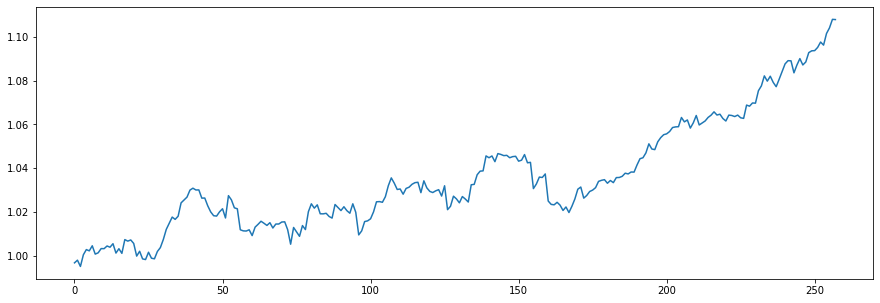

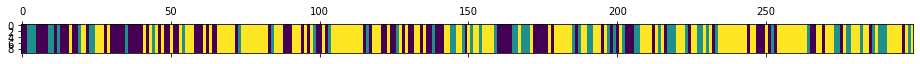

<Figure size 432x288 with 0 Axes>

N [[42. 17. 37.]
 [20. 17. 23.]
 [34. 25. 84.]]
alphas [[0.83979935 0.31175874 0.56695421]
 [0.08900669 1.0625514  0.56695421]
 [0.08900669 0.31175874 1.31774687]]
M [[2. 2. 2.]
 [1. 4. 1.]
 [2. 2. 5.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[0. 2. 2.]
 [1. 1. 1.]
 [2. 2. 2.]]
pi_z [[0.45379789 0.15751297 0.38868914]
 [0.35797355 0.3659645  0.27606195]
 [0.22668693 0.13004437 0.64326869]]
beta_vec [0.18889419 0.46166673 0.34943908]
hyper>> a_k: 1.7152770430380693  gamma: 0.9742172388597982  rho: 0.35742924634972084


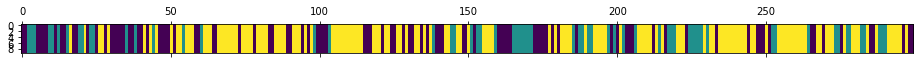

<Figure size 432x288 with 0 Axes>

759
N [[44. 17. 36.]
 [18. 27. 18.]
 [35. 19. 85.]]
alphas [[0.82128687 0.50884301 0.38514717]
 [0.20819669 1.12193319 0.38514717]
 [0.20819669 0.50884301 0.99823735]]
M [[3. 4. 3.]
 [2. 5. 1.]
 [2. 3. 8.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[2. 4. 3.]
 [2. 2. 1.]
 [2. 3. 5.]]
pi_z [[0.41864017 0.19559188 0.38576795]
 [0.34390539 0.41472604 0.24136857]
 [0.22330463 0.13387698 0.64281838]]
beta_vec [0.29144371 0.30620611 0.40235018]
hyper>> a_k: 2.5307628021097224  gamma: 0.5461861622082175  rho: 0.259420585062945


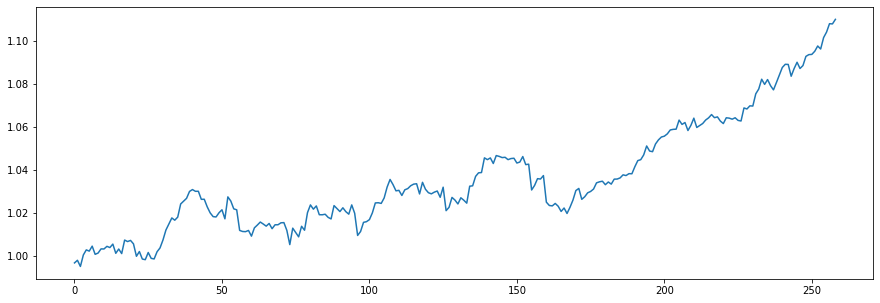

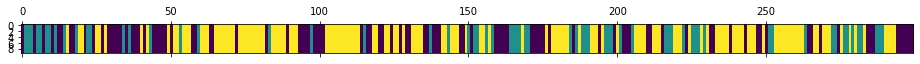

<Figure size 432x288 with 0 Axes>

N [[48. 20. 31.]
 [21. 24. 19.]
 [30. 20. 86.]]
alphas [[1.20276475 0.57390093 0.75409712]
 [0.54623278 1.2304329  0.75409712]
 [0.54623278 0.57390093 1.41062908]]
M [[3. 2. 1.]
 [2. 4. 2.]
 [1. 2. 2.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[2. 2. 1.]
 [2. 2. 2.]
 [1. 2. 2.]]
pi_z [[0.47656693 0.21459413 0.30883894]
 [0.26398021 0.44760382 0.28841597]
 [0.21929597 0.13518172 0.64552231]]
beta_vec [0.11302476 0.35133845 0.53563679]
hyper>> a_k: 1.0846319759713785  gamma: 0.6468345279035853  rho: 0.24021865643403642


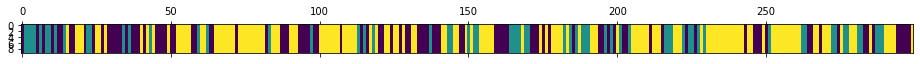

<Figure size 432x288 with 0 Axes>

760
N [[44. 22. 31.]
 [23. 22. 18.]
 [31. 19. 89.]]
alphas [[0.35369063 0.28953209 0.44140925]
 [0.0931418  0.55008093 0.44140925]
 [0.0931418  0.28953209 0.70195809]]
M [[3. 5. 5.]
 [2. 1. 1.]
 [2. 1. 3.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[1. 5. 5.]
 [2. 0. 1.]
 [2. 1. 3.]]
pi_z [[0.4463096  0.29028367 0.26340673]
 [0.37227426 0.3652974  0.26242833]
 [0.15297472 0.14304099 0.70398429]]
beta_vec [0.19320342 0.26014827 0.54664831]
hyper>> a_k: 1.3821624970081272  gamma: 0.692064597178696  rho: 0.23436825610352321


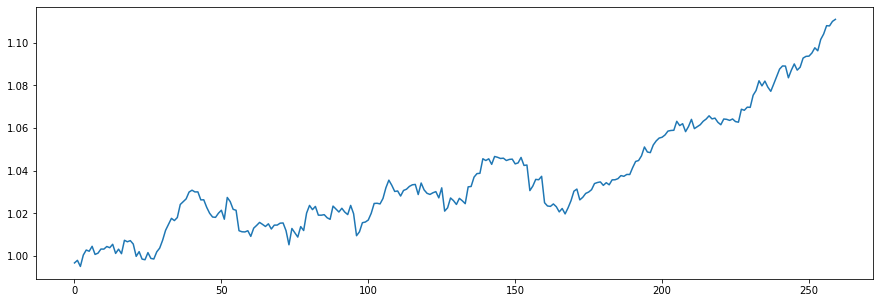

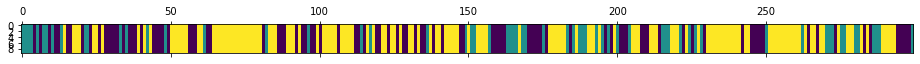

<Figure size 432x288 with 0 Axes>

N [[43. 22. 32.]
 [22. 21. 18.]
 [31. 19. 91.]]
alphas [[0.52838818 0.27529605 0.57847827]
 [0.20445317 0.59923106 0.57847827]
 [0.20445317 0.27529605 0.90241328]]
M [[5. 3. 2.]
 [1. 1. 2.]
 [2. 1. 4.]]
sum_w [[4.]
 [0.]
 [1.]]
barM [[1. 3. 2.]
 [1. 1. 2.]
 [2. 1. 3.]]
pi_z [[0.42482339 0.28858574 0.28659087]
 [0.39440436 0.26461726 0.34097837]
 [0.23754258 0.16276422 0.5996932 ]]
beta_vec [0.63377394 0.1794662  0.18675986]
hyper>> a_k: 1.8560059288704447  gamma: 1.8155772384668343  rho: 0.13022179982130058


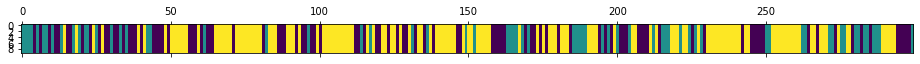

<Figure size 432x288 with 0 Axes>

761
N [[39. 26. 33.]
 [27. 23. 16.]
 [32. 17. 86.]]
alphas [[1.26480226 0.2897147  0.30148897]
 [1.02310983 0.53140713 0.30148897]
 [1.02310983 0.2897147  0.5431814 ]]
M [[3. 4. 2.]
 [5. 2. 3.]
 [2. 1. 4.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[3. 4. 2.]
 [5. 0. 3.]
 [2. 1. 2.]]
pi_z [[0.32069314 0.31104542 0.36826143]
 [0.38529893 0.3763761  0.23832497]
 [0.26753515 0.13857835 0.5938865 ]]
beta_vec [0.43793488 0.13715209 0.42491304]
hyper>> a_k: 1.7116066001361492  gamma: 1.204477793019196  rho: 0.1104778862134622


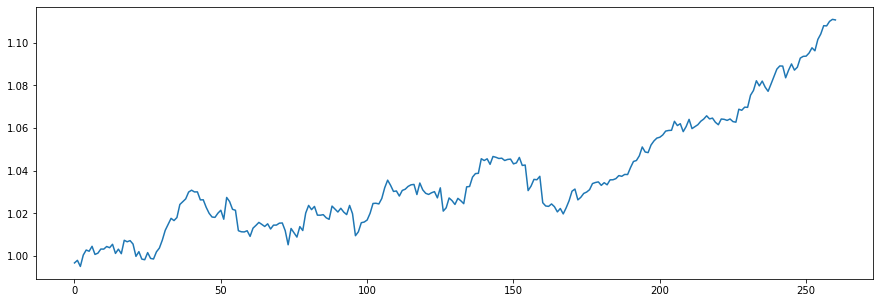

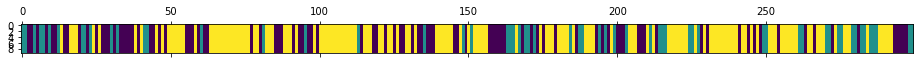

<Figure size 432x288 with 0 Axes>

N [[36. 23. 37.]
 [23. 20. 15.]
 [37. 15. 93.]]
alphas [[0.85585575 0.20881569 0.64693516]
 [0.66676107 0.39791037 0.64693516]
 [0.66676107 0.20881569 0.83602984]]
M [[4. 3. 2.]
 [5. 2. 2.]
 [3. 2. 3.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[3. 3. 2.]
 [5. 1. 2.]
 [3. 2. 3.]]
pi_z [[0.33937764 0.15056128 0.51006108]
 [0.34661028 0.36612701 0.28726271]
 [0.27601125 0.08289998 0.64108876]]
beta_vec [0.29024859 0.36719457 0.34255684]
hyper>> a_k: 2.0493986225832006  gamma: 0.16934336180487858  rho: 0.11017391954064953


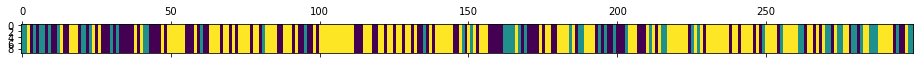

<Figure size 432x288 with 0 Axes>

762
N [[36. 20. 46.]
 [25. 16. 13.]
 [41. 18. 84.]]
alphas [[0.75509002 0.66961909 0.62468951]
 [0.52929975 0.89540937 0.62468951]
 [0.52929975 0.66961909 0.85047979]]
M [[2. 5. 3.]
 [3. 3. 4.]
 [2. 1. 5.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[0. 5. 3.]
 [3. 2. 4.]
 [2. 1. 4.]]
pi_z [[0.3330422  0.20514977 0.46180802]
 [0.50519596 0.28685461 0.20794943]
 [0.29671742 0.1340578  0.56922478]]
beta_vec [0.1548325  0.56203964 0.28312787]
hyper>> a_k: 3.2675494608242346  gamma: 0.5868788503156405  rho: 0.1933765289257533


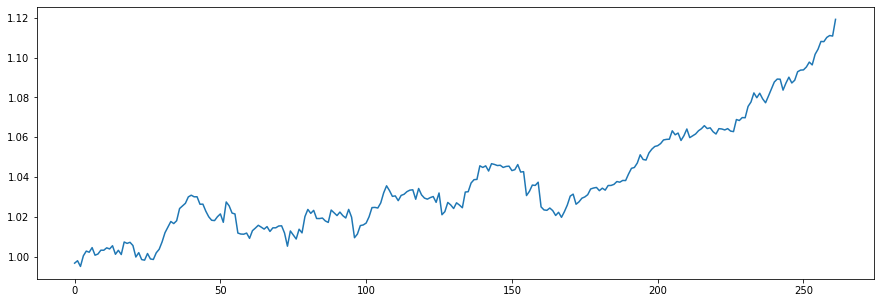

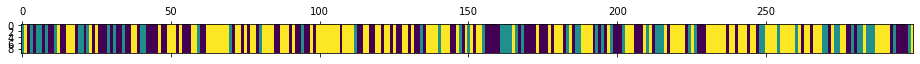

<Figure size 432x288 with 0 Axes>

N [[40. 24. 42.]
 [27. 15. 17.]
 [39. 19. 76.]]
alphas [[1.03995661 1.48135781 0.74623505]
 [0.40808924 2.11322518 0.74623505]
 [0.40808924 1.48135781 1.37810242]]
M [[4. 8. 5.]
 [2. 5. 1.]
 [2. 5. 8.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[1. 8. 5.]
 [2. 4. 1.]
 [2. 5. 7.]]
pi_z [[0.36494758 0.29249178 0.34256064]
 [0.5023984  0.24305079 0.2545508 ]
 [0.32786705 0.15432108 0.51781187]]
beta_vec [0.18063935 0.36630451 0.45305614]
hyper>> a_k: 3.5496566749421974  gamma: 1.0179765443167603  rho: 0.20410604505392888


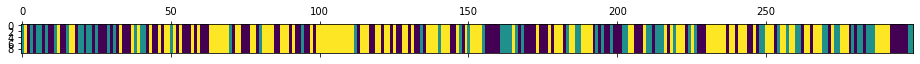

<Figure size 432x288 with 0 Axes>

763
N [[42. 26. 38.]
 [28. 20. 18.]
 [36. 19. 72.]]
alphas [[1.23483969 1.03486528 1.2799517 ]
 [0.51033331 1.75937167 1.2799517 ]
 [0.51033331 1.03486528 2.00445808]]
M [[ 4.  6.  8.]
 [ 2.  4.  6.]
 [ 3.  3. 11.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[3. 6. 8.]
 [2. 3. 6.]
 [3. 3. 9.]]
pi_z [[0.43609071 0.19726748 0.36664181]
 [0.46693824 0.25309759 0.27996417]
 [0.36715454 0.13695504 0.49589042]]
beta_vec [0.23356072 0.16975232 0.59668696]
hyper>> a_k: 6.512065623072643  gamma: 0.5757340214545469  rho: 0.2584440742438109


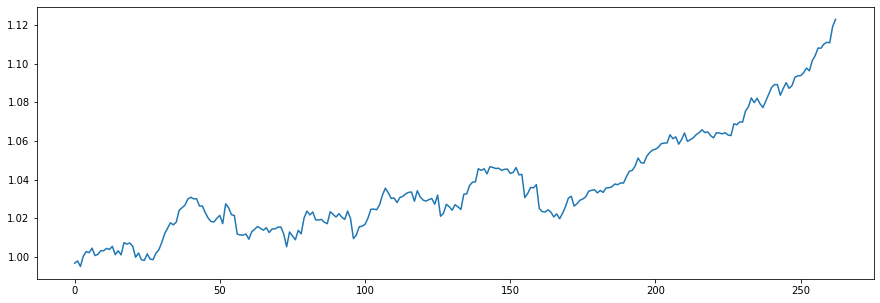

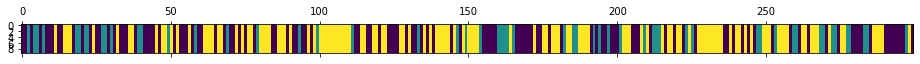

<Figure size 432x288 with 0 Axes>

N [[49. 25. 44.]
 [26. 17. 13.]
 [44. 14. 67.]]
alphas [[2.8108837  0.81974427 2.88143765]
 [1.12787893 2.50274904 2.88143765]
 [1.12787893 0.81974427 4.56444242]]
M [[10.  3.  6.]
 [ 5.  7.  5.]
 [ 2.  4. 10.]]
sum_w [[5.]
 [5.]
 [5.]]
barM [[5. 3. 6.]
 [5. 2. 5.]
 [2. 4. 5.]]
pi_z [[0.42171511 0.19565961 0.38262527]
 [0.44638298 0.30710459 0.24651243]
 [0.44413515 0.07588795 0.4799769 ]]
beta_vec [0.44231641 0.0928073  0.46487628]
hyper>> a_k: 5.083885789171619  gamma: 0.19144416721319224  rho: 0.2558546380457324


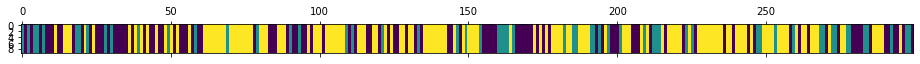

<Figure size 432x288 with 0 Axes>

764
N [[40. 26. 38.]
 [23. 15. 19.]
 [41. 16. 81.]]
alphas [[2.97408511 0.35110396 1.75869672]
 [1.67334936 1.65183972 1.75869672]
 [1.67334936 0.35110396 3.05943248]]
M [[ 7.  2.  6.]
 [ 3.  4.  3.]
 [ 4.  1. 11.]]
sum_w [[2.]
 [4.]
 [7.]]
barM [[5. 2. 6.]
 [3. 0. 3.]
 [4. 1. 4.]]
pi_z [[0.41178161 0.2598423  0.32837609]
 [0.38689537 0.30920179 0.30390283]
 [0.2886463  0.08674493 0.62460876]]
beta_vec [0.42544395 0.08837611 0.48617994]
hyper>> a_k: 4.5354211757962695  gamma: 0.37947663900008816  rho: 0.3944208610163706


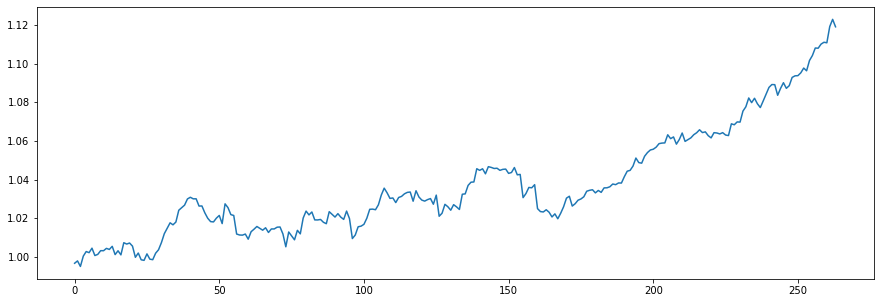

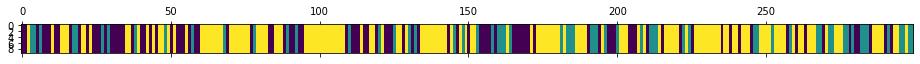

<Figure size 432x288 with 0 Axes>

N [[35. 25. 35.]
 [24. 17. 19.]
 [36. 18. 90.]]
alphas [[2.95737055 0.24272998 1.33532064]
 [1.16850583 2.03159471 1.33532064]
 [1.16850583 0.24272998 3.12418537]]
M [[13.  2. 10.]
 [ 4.  4.  5.]
 [ 4.  1. 15.]]
sum_w [[10.]
 [ 3.]
 [ 8.]]
barM [[ 3.  2. 10.]
 [ 4.  1.  5.]
 [ 4.  1.  7.]]
pi_z [[0.32529161 0.34274982 0.33195857]
 [0.31997861 0.31150741 0.36851398]
 [0.20319784 0.16788685 0.62891531]]
beta_vec [0.29300247 0.18476418 0.52223335]
hyper>> a_k: 5.335798785996473  gamma: 0.5084411781570513  rho: 0.32692922411644726


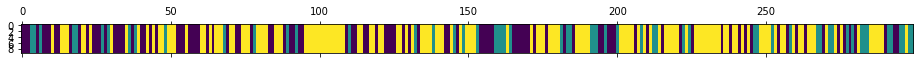

<Figure size 432x288 with 0 Axes>

765
N [[38. 23. 41.]
 [21. 17. 19.]
 [43. 17. 80.]]
alphas [[2.7967089  0.66355658 1.87553331]
 [1.05228034 2.40798514 1.87553331]
 [1.05228034 0.66355658 3.61996186]]
M [[ 6.  2.  6.]
 [ 4.  5.  5.]
 [ 5.  2. 14.]]
sum_w [[3.]
 [5.]
 [6.]]
barM [[3. 2. 6.]
 [4. 0. 5.]
 [5. 2. 8.]]
pi_z [[0.33124288 0.2160558  0.45270133]
 [0.40331576 0.24877743 0.34790681]
 [0.30397047 0.10347109 0.59255843]]
beta_vec [0.32973076 0.14277526 0.52749397]
hyper>> a_k: 4.785261066363802  gamma: 0.4889657995211216  rho: 0.23111501495784895


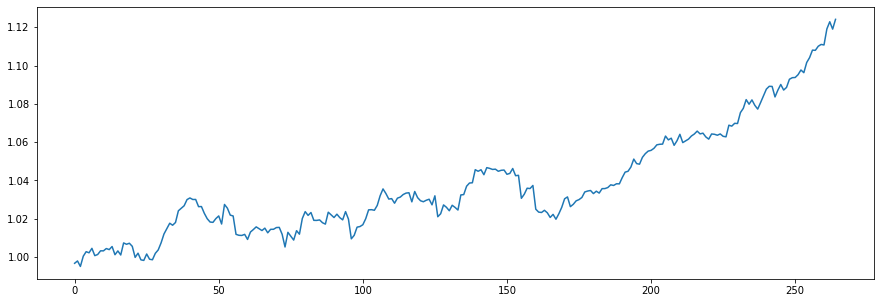

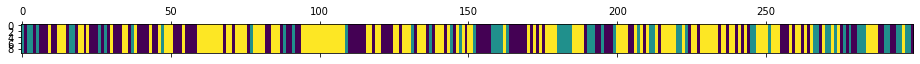

<Figure size 432x288 with 0 Axes>

N [[45. 21. 40.]
 [21. 21. 17.]
 [41. 16. 77.]]
alphas [[2.31912916 0.52531522 1.94081669]
 [1.21318347 1.6312609  1.94081669]
 [1.21318347 0.52531522 3.04676238]]
M [[ 5.  3.  7.]
 [ 5.  7.  8.]
 [ 6.  4. 10.]]
sum_w [[2.]
 [5.]
 [3.]]
barM [[3. 3. 7.]
 [5. 2. 8.]
 [6. 4. 7.]]
pi_z [[0.51742316 0.19319309 0.28938375]
 [0.33031393 0.32310661 0.34657946]
 [0.27577909 0.09572201 0.62849891]]
beta_vec [0.31755926 0.1420485  0.54039224]
hyper>> a_k: 7.255492026231827  gamma: 0.9625834853550028  rho: 0.1658108882595983


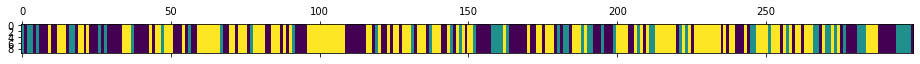

<Figure size 432x288 with 0 Axes>

766
N [[55. 20. 36.]
 [19. 17. 19.]
 [37. 18. 78.]]
alphas [[3.12505189 0.85974181 3.27069833]
 [1.92201231 2.06278138 3.27069833]
 [1.92201231 0.85974181 4.47373791]]
M [[13.  2.  6.]
 [ 6.  2.  5.]
 [ 6.  4. 15.]]
sum_w [[5.]
 [0.]
 [3.]]
barM [[ 8.  2.  6.]
 [ 6.  2.  5.]
 [ 6.  4. 12.]]
pi_z [[0.4518748  0.19141035 0.35671485]
 [0.38031826 0.30991597 0.30976577]
 [0.25548544 0.15311858 0.59139598]]
beta_vec [0.27722871 0.22309584 0.49967545]
hyper>> a_k: 5.960372469912812  gamma: 0.2561962811878019  rho: 0.12914342550433744


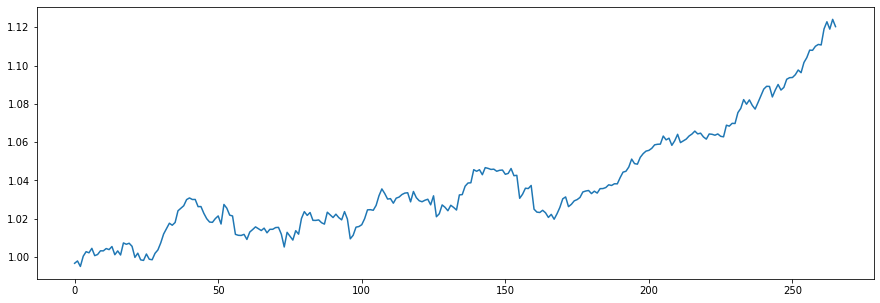

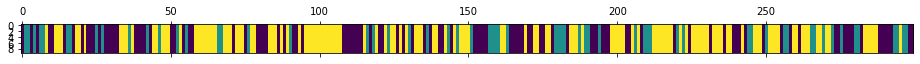

<Figure size 432x288 with 0 Axes>

N [[50. 22. 34.]
 [23. 19. 19.]
 [33. 20. 79.]]
alphas [[2.20873444 1.15800786 2.59363017]
 [1.43899152 1.92775078 2.59363017]
 [1.43899152 1.15800786 3.36337309]]
M [[ 4.  6. 10.]
 [ 4.  4.  6.]
 [ 4.  3. 14.]]
sum_w [[1.]
 [2.]
 [5.]]
barM [[ 3.  6. 10.]
 [ 4.  2.  6.]
 [ 4.  3.  9.]]
pi_z [[0.50059846 0.23211367 0.26728786]
 [0.28422619 0.34425833 0.37151548]
 [0.23357251 0.15646018 0.60996731]]
beta_vec [0.30391253 0.11803152 0.57805595]
hyper>> a_k: 6.066778048384173  gamma: 1.0031077428125386  rho: 0.09115137010829578


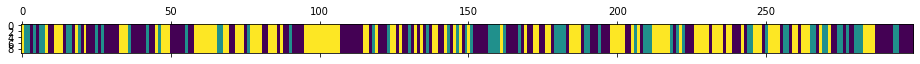

<Figure size 432x288 with 0 Axes>

767
N [[63. 26. 33.]
 [29. 21. 13.]
 [30. 16. 68.]]
alphas [[2.22870284 0.65080019 3.18727501]
 [1.67570771 1.20379533 3.18727501]
 [1.67570771 0.65080019 3.74027014]]
M [[ 6.  3. 10.]
 [ 5.  3.  6.]
 [ 5.  2. 13.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[ 5.  3. 10.]
 [ 5.  1.  6.]
 [ 5.  2. 10.]]
pi_z [[0.49884057 0.26642401 0.23473542]
 [0.48241915 0.27192147 0.24565938]
 [0.24837281 0.18669908 0.56492811]]
beta_vec [0.41029749 0.06943702 0.52026549]
hyper>> a_k: 6.593196344416727  gamma: 0.9791190885094566  rho: 0.13401876136223065


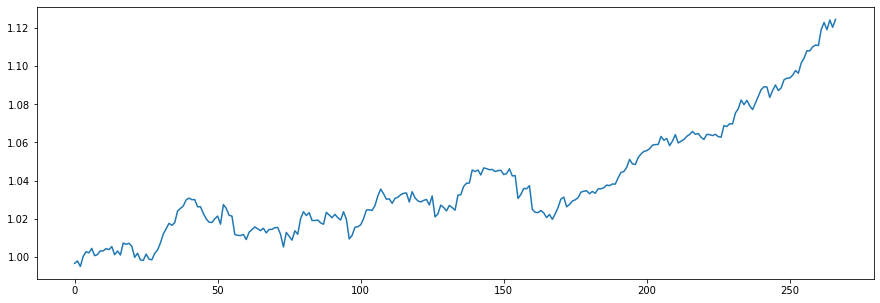

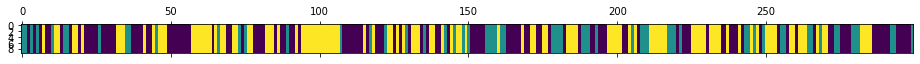

<Figure size 432x288 with 0 Axes>

N [[67. 23. 33.]
 [22. 24. 16.]
 [33. 16. 65.]]
alphas [[3.22624015 0.3964565  2.97049969]
 [2.34262815 1.2800685  2.97049969]
 [2.34262815 0.3964565  3.8541117 ]]
M [[11.  3. 10.]
 [ 5.  4.  3.]
 [ 7.  2.  9.]]
sum_w [[3.]
 [4.]
 [1.]]
barM [[ 8.  3. 10.]
 [ 5.  0.  3.]
 [ 7.  2.  8.]]
pi_z [[0.50706536 0.22978736 0.26314728]
 [0.31248054 0.30728555 0.38023391]
 [0.30641325 0.15645183 0.53713492]]
beta_vec [0.47944222 0.1058511  0.41470668]
hyper>> a_k: 5.85471645055435  gamma: 0.47420975410579996  rho: 0.1120154250432214


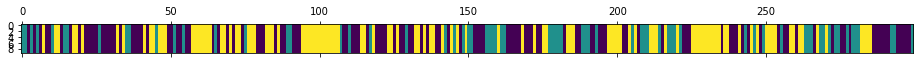

<Figure size 432x288 with 0 Axes>

768
N [[59. 28. 34.]
 [26. 26. 16.]
 [36. 14. 60.]]
alphas [[3.1483897  0.55030908 2.15601767]
 [2.49257115 1.20612763 2.15601767]
 [2.49257115 0.55030908 2.81183622]]
M [[12.  2.  5.]
 [ 7.  3.  7.]
 [ 6.  1.  9.]]
sum_w [[3.]
 [3.]
 [0.]]
barM [[9. 2. 5.]
 [7. 0. 7.]
 [6. 1. 9.]]
pi_z [[0.50323251 0.23505709 0.2617104 ]
 [0.37103117 0.41160658 0.21736225]
 [0.35509839 0.16035633 0.48454528]]
beta_vec [0.57892397 0.04854159 0.37253444]
hyper>> a_k: 6.5125383983265435  gamma: 1.1190013855817755  rho: 0.10776269885026915


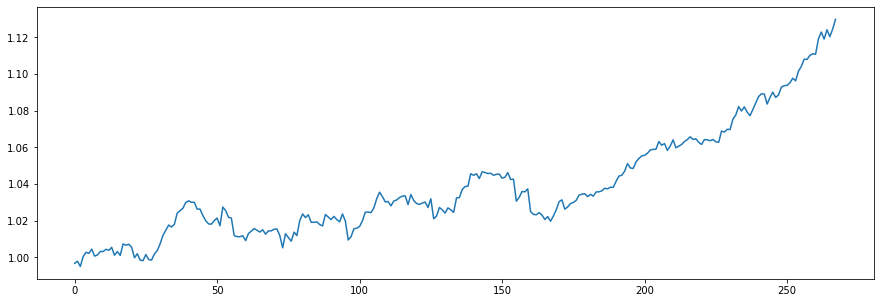

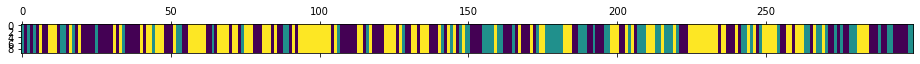

<Figure size 432x288 with 0 Axes>

N [[57. 26. 31.]
 [24. 28. 20.]
 [33. 18. 62.]]
alphas [[4.06577941 0.28206205 2.16469693]
 [3.3639707  0.98387077 2.16469693]
 [3.3639707  0.28206205 2.86650565]]
M [[14.  4.  7.]
 [ 9.  4.  5.]
 [11.  3. 12.]]
sum_w [[4.]
 [3.]
 [6.]]
barM [[10.  4.  7.]
 [ 9.  1.  5.]
 [11.  3.  6.]]
pi_z [[0.53915033 0.20072925 0.26012041]
 [0.35355817 0.32658694 0.31985488]
 [0.3072104  0.12496209 0.56782751]]
beta_vec [0.58070859 0.06713086 0.35216055]
hyper>> a_k: 8.40265592923897  gamma: 0.13140877369996487  rho: 0.26820115138463685


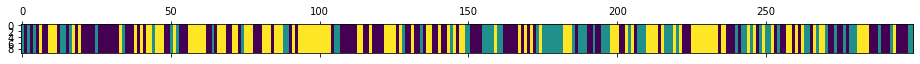

<Figure size 432x288 with 0 Axes>

769
N [[57. 24. 36.]
 [26. 28. 18.]
 [34. 20. 56.]]
alphas [[5.82441041 0.4127913  2.16545422]
 [3.57080841 2.6663933  2.16545422]
 [3.57080841 0.4127913  4.41905622]]
M [[18.  2.  5.]
 [ 9.  7.  4.]
 [ 7.  1. 15.]]
sum_w [[6.]
 [7.]
 [9.]]
barM [[12.  2.  5.]
 [ 9.  0.  4.]
 [ 7.  1.  6.]]
pi_z [[0.50829988 0.18526242 0.3064377 ]
 [0.33786051 0.48087269 0.1812668 ]
 [0.33828994 0.13973806 0.52197201]]
beta_vec [0.64018654 0.06594876 0.2938647 ]
hyper>> a_k: 9.74672545001326  gamma: 0.4349145253605341  rho: 0.352494455476867


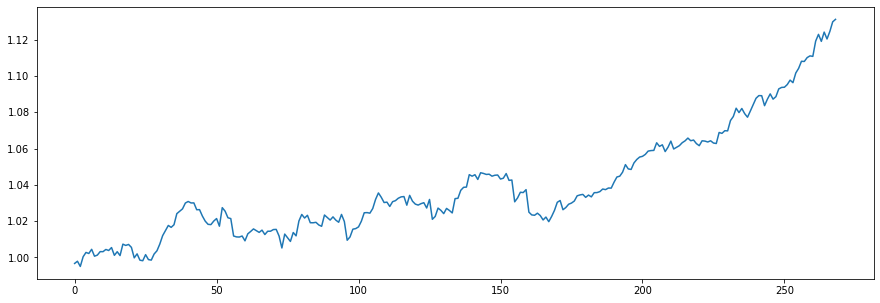

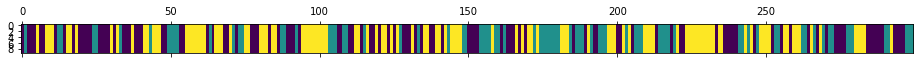

<Figure size 432x288 with 0 Axes>

N [[50. 26. 33.]
 [25. 38. 17.]
 [34. 16. 60.]]
alphas [[7.47592159 0.4162065  1.85459736]
 [4.04025491 3.85187318 1.85459736]
 [4.04025491 0.4162065  5.29026404]]
M [[17.  3.  2.]
 [ 7.  9.  4.]
 [ 8.  1. 11.]]
sum_w [[10.]
 [ 8.]
 [ 7.]]
barM [[7. 3. 2.]
 [7. 1. 4.]
 [8. 1. 4.]]
pi_z [[0.43347129 0.25579631 0.31073239]
 [0.33290365 0.52984755 0.13724879]
 [0.3183733  0.1424662  0.53916051]]
beta_vec [0.63201899 0.15080282 0.21717819]
hyper>> a_k: 7.61184986075628  gamma: 0.49501325954416375  rho: 0.4755285089398025


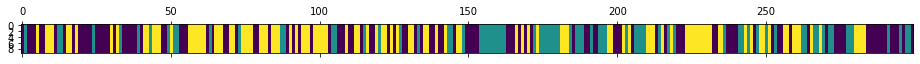

<Figure size 432x288 with 0 Axes>

770
N [[55. 26. 35.]
 [26. 33. 18.]
 [35. 18. 53.]]
alphas [[6.14279672 0.60203476 0.86701838]
 [2.52314511 4.22168637 0.86701838]
 [2.52314511 0.60203476 4.48667   ]]
M [[13.  3.  3.]
 [ 3. 10.  4.]
 [ 7.  3. 11.]]
sum_w [[5.]
 [9.]
 [5.]]
barM [[8. 3. 3.]
 [3. 1. 4.]
 [7. 3. 6.]]
pi_z [[0.5011476  0.20398237 0.29487003]
 [0.32367986 0.50435197 0.17196817]
 [0.26156194 0.16028886 0.57814919]]
beta_vec [0.44983285 0.15991781 0.39024934]
hyper>> a_k: 5.87064713790958  gamma: 1.0534072350253159  rho: 0.3443180255970079


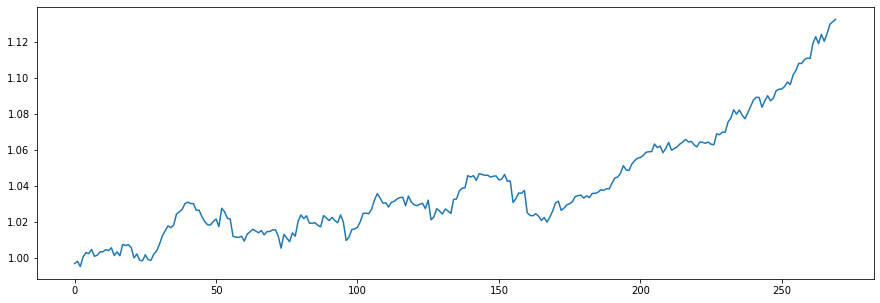

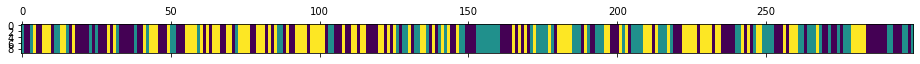

<Figure size 432x288 with 0 Axes>

N [[54. 24. 36.]
 [22. 38. 20.]
 [37. 19. 49.]]
alphas [[3.75290111 0.61556803 1.502178  ]
 [1.73153148 2.63693766 1.502178  ]
 [1.73153148 0.61556803 3.52354763]]
M [[14.  3.  3.]
 [ 5.  6.  2.]
 [ 8.  3.  9.]]
sum_w [[6.]
 [4.]
 [4.]]
barM [[8. 3. 3.]
 [5. 2. 2.]
 [8. 3. 5.]]
pi_z [[0.5181007  0.21466751 0.2672318 ]
 [0.24716111 0.57224587 0.18059302]
 [0.28830123 0.21159372 0.50010504]]
beta_vec [0.40290118 0.32185728 0.27524154]
hyper>> a_k: 5.0413483884762975  gamma: 0.28117257014974545  rho: 0.27369217603462015


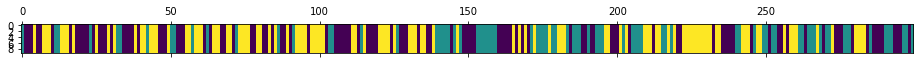

<Figure size 432x288 with 0 Axes>

771
N [[56. 22. 35.]
 [24. 38. 17.]
 [33. 19. 55.]]
alphas [[2.85502879 1.17850321 1.00781639]
 [1.47525118 2.55828082 1.00781639]
 [1.47525118 1.17850321 2.387594  ]]
M [[4. 6. 3.]
 [4. 7. 3.]
 [6. 5. 6.]]
sum_w [[4.]
 [1.]
 [1.]]
barM [[0. 6. 3.]
 [4. 6. 3.]
 [6. 5. 5.]]
pi_z [[0.49591783 0.20156696 0.30251521]
 [0.33852159 0.43543579 0.22604262]
 [0.2711463  0.25205526 0.47679844]]
beta_vec [0.35215424 0.42625606 0.2215897 ]
hyper>> a_k: 3.4769571538734327  gamma: 0.8730158750680738  rho: 0.16702308290670215


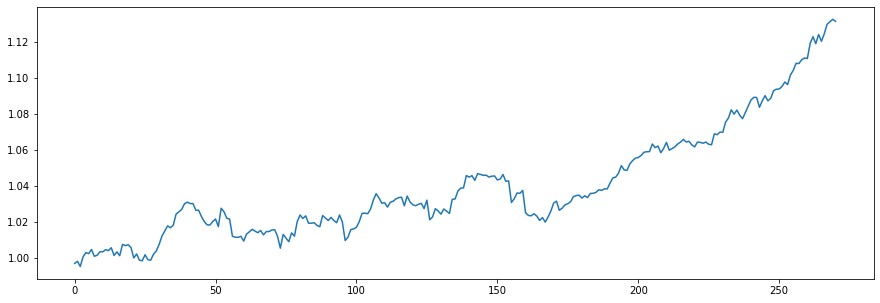

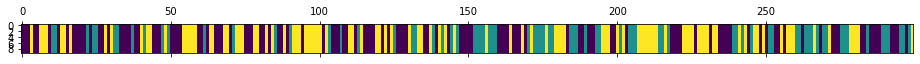

<Figure size 432x288 with 0 Axes>

N [[63. 23. 36.]
 [27. 30. 19.]
 [32. 22. 47.]]
alphas [[1.60065003 1.23453347 0.64177365]
 [1.01991793 1.81526557 0.64177365]
 [1.01991793 1.23453347 1.22250576]]
M [[6. 3. 5.]
 [5. 5. 4.]
 [5. 5. 7.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[6. 3. 5.]
 [5. 3. 4.]
 [5. 5. 5.]]
pi_z [[0.56213503 0.22289944 0.21496553]
 [0.35172056 0.38124574 0.2670337 ]
 [0.35163995 0.20502334 0.44333672]]
beta_vec [0.50867687 0.15214098 0.33918215]
hyper>> a_k: 4.1602540218472654  gamma: 0.40077034597662603  rho: 0.18724412422176615


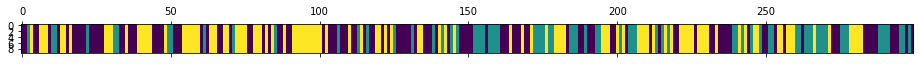

<Figure size 432x288 with 0 Axes>

772
N [[61. 23. 36.]
 [26. 32. 15.]
 [32. 18. 56.]]
alphas [[2.4989574  0.51442988 1.14686674]
 [1.71997428 1.293413   1.14686674]
 [1.71997428 0.51442988 1.92584986]]
M [[6. 4. 6.]
 [7. 5. 2.]
 [4. 4. 5.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[4. 4. 6.]
 [7. 4. 2.]
 [4. 4. 3.]]
pi_z [[0.50362468 0.23900598 0.25736934]
 [0.44148536 0.37105418 0.18746046]
 [0.26035275 0.20260583 0.53704142]]
beta_vec [0.39809847 0.34113256 0.26076897]
hyper>> a_k: 4.232101384640912  gamma: 0.6971778687719273  rho: 0.1587119265867056


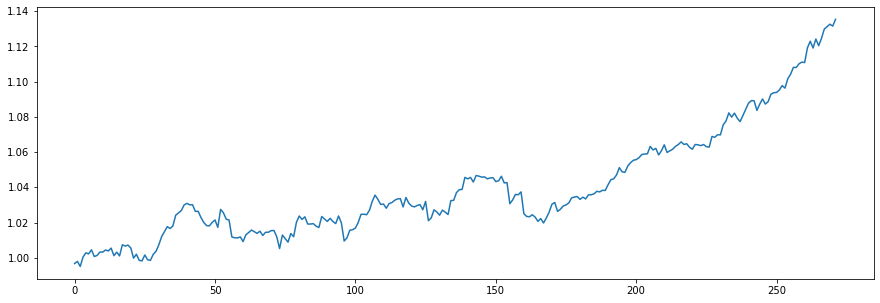

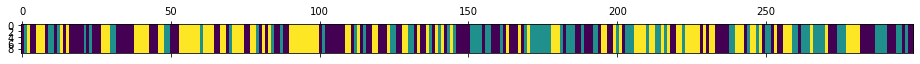

<Figure size 432x288 with 0 Axes>

N [[58. 26. 28.]
 [27. 35. 20.]
 [27. 21. 57.]]
alphas [[2.08908128 1.21457398 0.92844612]
 [1.41739631 1.88625895 0.92844612]
 [1.41739631 1.21457398 1.60013109]]
M [[9. 6. 3.]
 [3. 3. 4.]
 [5. 1. 6.]]
sum_w [[4.]
 [1.]
 [3.]]
barM [[5. 6. 3.]
 [3. 2. 4.]
 [5. 1. 3.]]
pi_z [[0.48555557 0.21768727 0.29675716]
 [0.27019094 0.41949774 0.31031132]
 [0.24999617 0.1913634  0.55864043]]
beta_vec [0.41796686 0.374697   0.20733613]
hyper>> a_k: 3.457667876576054  gamma: 0.675797304052885  rho: 0.1975553555928145


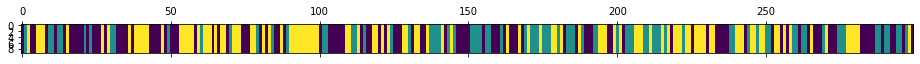

<Figure size 432x288 with 0 Axes>

773
N [[51. 24. 36.]
 [27. 33. 21.]
 [33. 24. 50.]]
alphas [[1.84276626 1.03962946 0.57527215]
 [1.15968545 1.72271027 0.57527215]
 [1.15968545 1.03962946 1.25835296]]
M [[ 8.  5.  3.]
 [ 2. 10.  4.]
 [ 6.  2.  4.]]
sum_w [[4.]
 [3.]
 [2.]]
barM [[4. 5. 3.]
 [2. 7. 4.]
 [6. 2. 2.]]
pi_z [[0.46392985 0.22037632 0.31569383]
 [0.31775821 0.46533379 0.216908  ]
 [0.33162419 0.21022369 0.45815211]]
beta_vec [0.39823576 0.42396776 0.17779648]
hyper>> a_k: 5.731962584227658  gamma: 0.5757286292891682  rho: 0.2448368132608205


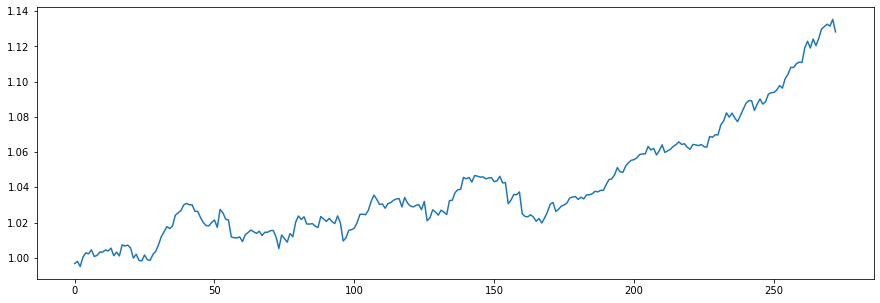

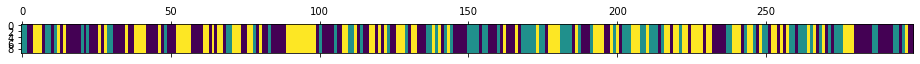

<Figure size 432x288 with 0 Axes>

N [[57. 27. 34.]
 [29. 32. 18.]
 [32. 20. 50.]]
alphas [[3.12718567 1.83517291 0.76960401]
 [1.72379021 3.23856836 0.76960401]
 [1.72379021 1.83517291 2.17299946]]
M [[ 7.  5.  4.]
 [ 4.  8.  1.]
 [ 4. 10.  8.]]
sum_w [[3.]
 [5.]
 [2.]]
barM [[ 4.  5.  4.]
 [ 4.  3.  1.]
 [ 4. 10.  6.]]
pi_z [[0.54813555 0.20259057 0.24927389]
 [0.44916376 0.36436316 0.18647308]
 [0.30883696 0.1313967  0.55976634]]
beta_vec [0.26048042 0.39525563 0.34426394]
hyper>> a_k: 5.0863394851604  gamma: 0.6805282123096669  rho: 0.22365802203261564


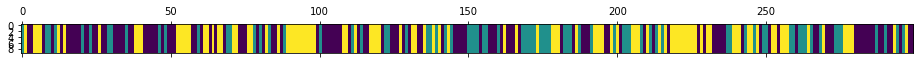

<Figure size 432x288 with 0 Axes>

774
N [[59. 29. 34.]
 [35. 27. 15.]
 [27. 22. 51.]]
alphas [[2.16616979 1.56076128 1.35940841]
 [1.02856916 2.69836191 1.35940841]
 [1.02856916 1.56076128 2.49700904]]
M [[ 8.  4.  5.]
 [ 4.  4.  4.]
 [ 5.  2. 10.]]
sum_w [[6.]
 [0.]
 [5.]]
barM [[2. 4. 5.]
 [4. 4. 4.]
 [5. 2. 5.]]
pi_z [[0.52231218 0.24263403 0.23505378]
 [0.44170025 0.44144721 0.11685254]
 [0.29866789 0.22748068 0.47385143]]
beta_vec [0.16537507 0.41156145 0.42306348]
hyper>> a_k: 4.738215843483898  gamma: 0.3024875637947961  rho: 0.26639479082626055


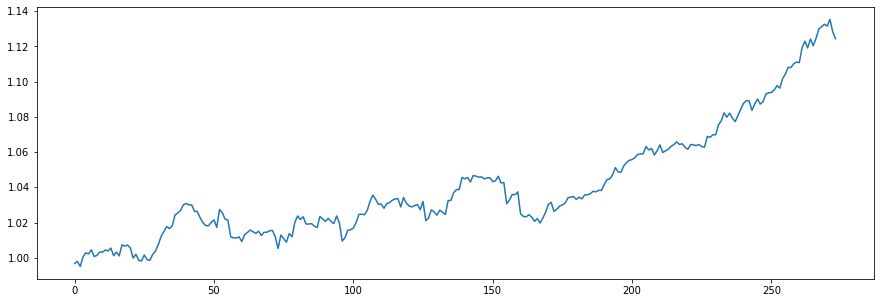

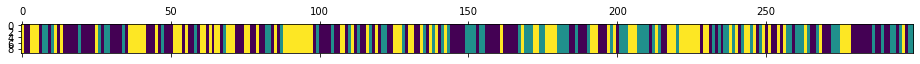

<Figure size 432x288 with 0 Axes>

N [[58. 29. 34.]
 [36. 26. 17.]
 [27. 24. 48.]]
alphas [[1.83707641 1.43057931 1.47056012]
 [0.57484039 2.69281533 1.47056012]
 [0.57484039 1.43057931 2.73279614]]
M [[ 7.  3.  6.]
 [ 5.  6.  7.]
 [ 4.  4. 10.]]
sum_w [[4.]
 [4.]
 [5.]]
barM [[3. 3. 6.]
 [5. 2. 7.]
 [4. 4. 5.]]
pi_z [[0.45824479 0.27305195 0.26870326]
 [0.38089805 0.35185045 0.2672515 ]
 [0.30844508 0.22637811 0.46517681]]
beta_vec [0.27782209 0.26217686 0.46000105]
hyper>> a_k: 4.670092747345087  gamma: 0.6343586559763561  rho: 0.2596828863664196


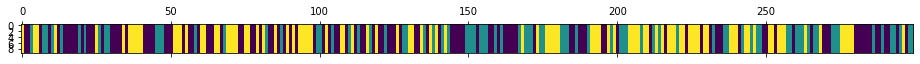

<Figure size 432x288 with 0 Axes>

775
N [[52. 32. 34.]
 [38. 28. 17.]
 [28. 23. 47.]]
alphas [[2.17327125 0.90643704 1.59038445]
 [0.96052809 2.11918021 1.59038445]
 [0.96052809 0.90643704 2.80312761]]
M [[8. 2. 6.]
 [5. 6. 5.]
 [3. 3. 7.]]
sum_w [[3.]
 [3.]
 [1.]]
barM [[5. 2. 6.]
 [5. 3. 5.]
 [3. 3. 6.]]
pi_z [[0.45687305 0.26701213 0.27611483]
 [0.48775223 0.28767239 0.22457538]
 [0.35249664 0.23202787 0.41547549]]
beta_vec [0.32318986 0.15638375 0.52042639]
hyper>> a_k: 4.7981957657036265  gamma: 0.21683613573970542  rho: 0.22251972791456873


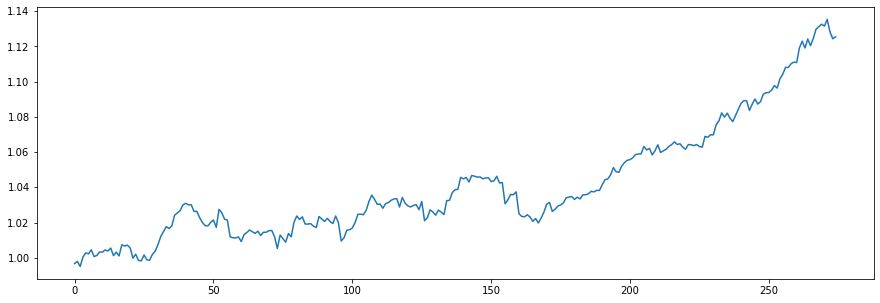

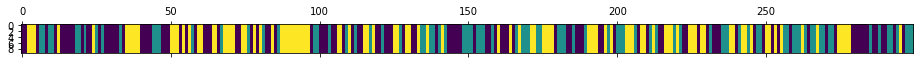

<Figure size 432x288 with 0 Axes>

N [[49. 36. 29.]
 [36. 31. 20.]
 [29. 20. 49.]]
alphas [[2.27335382 0.58338996 1.94145199]
 [1.2056606  1.65108318 1.94145199]
 [1.2056606  0.58338996 3.0091452 ]]
M [[ 8.  6.  4.]
 [12.  6.  6.]
 [ 5.  3. 12.]]
sum_w [[4.]
 [4.]
 [8.]]
barM [[ 4.  6.  4.]
 [12.  2.  6.]
 [ 5.  3.  4.]]
pi_z [[0.36605536 0.31535328 0.31859136]
 [0.37253889 0.41250374 0.21495737]
 [0.25842868 0.16424992 0.5773214 ]]
beta_vec [0.36835873 0.23499777 0.39664351]
hyper>> a_k: 5.9538605105307  gamma: 0.40341120077758624  rho: 0.289459540809878


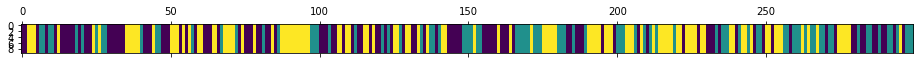

<Figure size 432x288 with 0 Axes>

776
N [[46. 33. 27.]
 [30. 34. 22.]
 [30. 19. 58.]]
alphas [[3.28172814 0.99414837 1.677984  ]
 [1.55832641 2.7175501  1.677984  ]
 [1.55832641 0.99414837 3.40138573]]
M [[ 7.  5.  7.]
 [ 8.  5.  5.]
 [ 5.  5. 13.]]
sum_w [[3.]
 [4.]
 [5.]]
barM [[4. 5. 7.]
 [8. 1. 5.]
 [5. 5. 8.]]
pi_z [[0.49627714 0.24427734 0.25944551]
 [0.31668966 0.38818344 0.29512691]
 [0.21879017 0.1321536  0.64905623]]
beta_vec [0.35239878 0.30011295 0.34748826]
hyper>> a_k: 5.31807833217707  gamma: 0.28433392129071594  rho: 0.22568997009003838


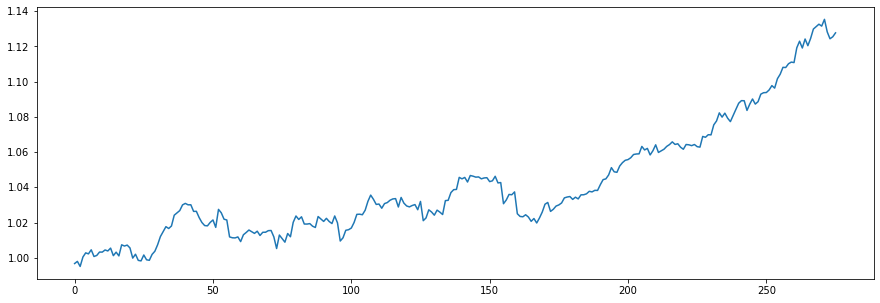

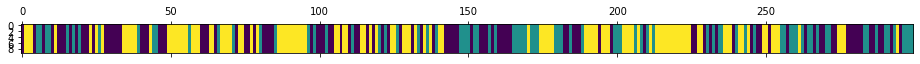

<Figure size 432x288 with 0 Axes>

N [[47. 36. 24.]
 [35. 27. 19.]
 [25. 18. 68.]]
alphas [[2.65135924 1.23581754 1.43090155]
 [1.4511223  2.43605448 1.43090155]
 [1.4511223  1.23581754 2.63113849]]
M [[10.  4.  5.]
 [ 9.  6.  2.]
 [ 5.  3. 10.]]
sum_w [[5.]
 [3.]
 [2.]]
barM [[5. 4. 5.]
 [9. 3. 2.]
 [5. 3. 8.]]
pi_z [[0.43196795 0.37148914 0.19654291]
 [0.46082804 0.32430238 0.21486958]
 [0.23872085 0.14478198 0.61649718]]
beta_vec [0.38168501 0.18859183 0.42972316]
hyper>> a_k: 6.251400528142912  gamma: 0.3864485907049666  rho: 0.2027829311106411


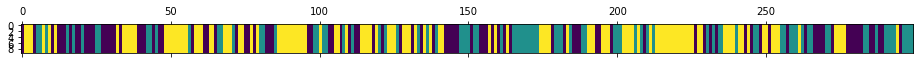

<Figure size 432x288 with 0 Axes>

777
N [[39. 29. 29.]
 [33. 38. 16.]
 [25. 20. 70.]]
alphas [[3.16988974 0.93988949 2.1416213 ]
 [1.90221242 2.20756681 2.1416213 ]
 [1.90221242 0.93988949 3.40929862]]
M [[ 8.  1.  6.]
 [ 4.  5.  8.]
 [ 6.  2. 11.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[4. 1. 6.]
 [4. 2. 8.]
 [6. 2. 7.]]
pi_z [[0.3949159  0.25971031 0.34537379]
 [0.3248555  0.45239655 0.22274795]
 [0.19286665 0.16705838 0.64007498]]
beta_vec [0.32943168 0.1432695  0.52729883]
hyper>> a_k: 5.187093546434963  gamma: 0.2825709983528874  rho: 0.3204066194231588


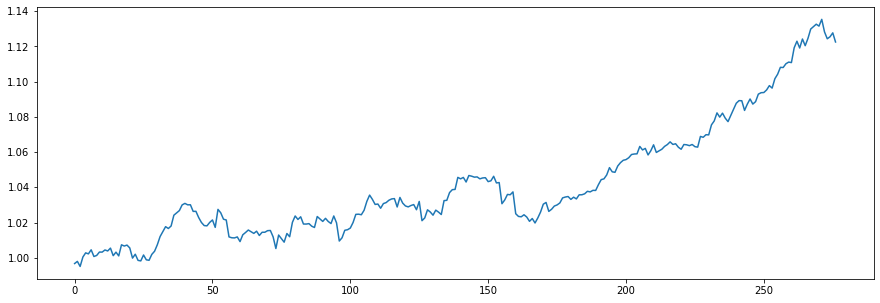

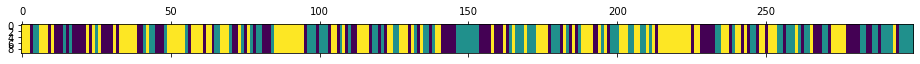

<Figure size 432x288 with 0 Axes>

N [[37. 24. 31.]
 [30. 43. 18.]
 [25. 24. 67.]]
alphas [[2.82326347 0.50504137 1.8587887 ]
 [1.16128436 2.16702048 1.8587887 ]
 [1.16128436 0.50504137 3.52076781]]
M [[ 4.  2.  7.]
 [ 7.  8.  5.]
 [ 4.  1. 10.]]
sum_w [[2.]
 [7.]
 [3.]]
barM [[2. 2. 7.]
 [7. 1. 5.]
 [4. 1. 7.]]
pi_z [[0.38729727 0.25773888 0.35496385]
 [0.35575443 0.42693027 0.2173153 ]
 [0.24811505 0.18970197 0.56218298]]
beta_vec [0.41054101 0.06572901 0.52372998]
hyper>> a_k: 4.024651038157272  gamma: 0.5078796580496041  rho: 0.31553024936401847


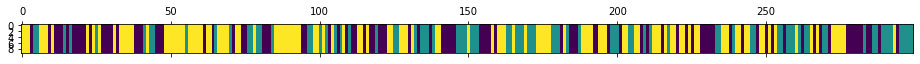

<Figure size 432x288 with 0 Axes>

778
N [[41. 22. 33.]
 [27. 38. 21.]
 [28. 26. 63.]]
alphas [[2.40083777 0.1810671  1.44274617]
 [1.13093862 1.45096625 1.44274617]
 [1.13093862 0.1810671  2.71264531]]
M [[ 8.  2.  5.]
 [ 4.  5.  5.]
 [ 5.  2. 11.]]
sum_w [[5.]
 [5.]
 [8.]]
barM [[3. 2. 5.]
 [4. 0. 5.]
 [5. 2. 3.]]
pi_z [[0.4400351  0.21596339 0.34400151]
 [0.23957956 0.45919157 0.30122887]
 [0.28655034 0.1342199  0.57922975]]
beta_vec [0.4540808  0.14427786 0.40164134]
hyper>> a_k: 5.474408147200944  gamma: 0.7438437502620644  rho: 0.3927074881815614


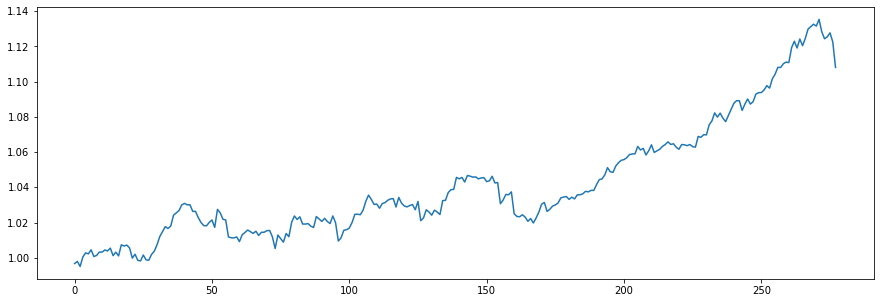

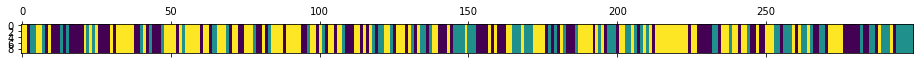

<Figure size 432x288 with 0 Axes>

N [[39. 25. 33.]
 [23. 29. 26.]
 [35. 24. 65.]]
alphas [[3.65946315 0.47966144 1.33528356]
 [1.50962208 2.62950251 1.33528356]
 [1.50962208 0.47966144 3.48512463]]
M [[ 9.  3.  4.]
 [ 3.  7.  5.]
 [ 6.  3. 15.]]
sum_w [[6.]
 [3.]
 [8.]]
barM [[3. 3. 4.]
 [3. 4. 5.]
 [6. 3. 7.]]
pi_z [[0.54994208 0.19452701 0.25553091]
 [0.26158056 0.43658855 0.30183088]
 [0.2927993  0.13698138 0.57021932]]
beta_vec [0.40063061 0.13597424 0.46339515]
hyper>> a_k: 6.576554002771232  gamma: 0.738326683687484  rho: 0.24714911956578578


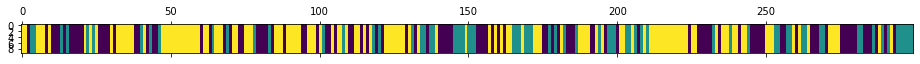

<Figure size 432x288 with 0 Axes>

779
N [[47. 23. 34.]
 [24. 25. 21.]
 [33. 22. 70.]]
alphas [[3.60897758 0.67323081 2.29434562]
 [1.98358804 2.29862034 2.29434562]
 [1.98358804 0.67323081 3.91973515]]
M [[12.  5.  5.]
 [ 6.  8.  6.]
 [ 5.  2.  9.]]
sum_w [[2.]
 [6.]
 [3.]]
barM [[10.  5.  5.]
 [ 6.  2.  6.]
 [ 5.  2.  6.]]
pi_z [[0.45157489 0.17716618 0.37125893]
 [0.412802   0.39048218 0.19671583]
 [0.23140789 0.23769786 0.53089425]]
beta_vec [0.30711884 0.2642219  0.42865927]
hyper>> a_k: 6.194820560243873  gamma: 0.8955942593746529  rho: 0.24241323828366215


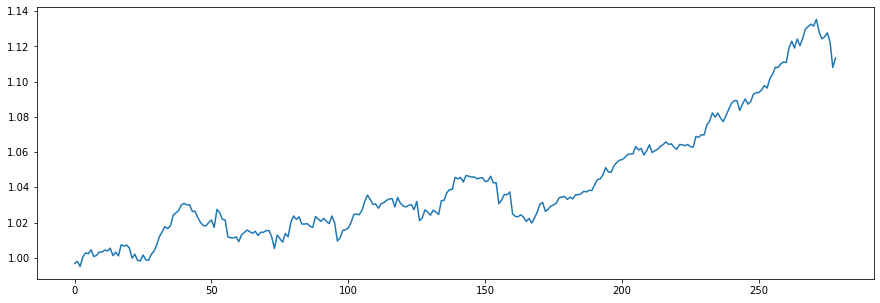

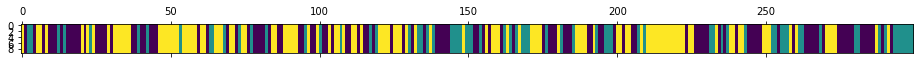

<Figure size 432x288 with 0 Axes>

N [[55. 27. 33.]
 [29. 23. 18.]
 [31. 20. 63.]]
alphas [[2.94305025 1.2400235  2.01174682]
 [1.44134373 2.74173001 2.01174682]
 [1.44134373 1.2400235  3.51345333]]
M [[10.  4.  7.]
 [ 5.  9.  6.]
 [ 6.  3. 12.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[8. 4. 7.]
 [5. 6. 6.]
 [6. 3. 8.]]
pi_z [[0.49334858 0.20632209 0.30032933]
 [0.30267902 0.3148052  0.38251578]
 [0.23305435 0.19606081 0.57088484]]
beta_vec [0.36230502 0.30932025 0.32837473]
hyper>> a_k: 5.967102393195508  gamma: 0.3133651047763973  rho: 0.10939972731350527


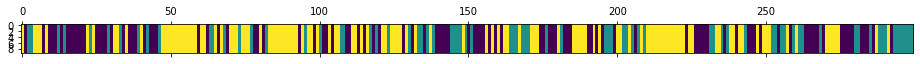

<Figure size 432x288 with 0 Axes>

780
N [[47. 28. 29.]
 [24. 27. 25.]
 [33. 21. 65.]]
alphas [[2.57819802 1.64382156 1.74508281]
 [1.92539865 2.29662094 1.74508281]
 [1.92539865 1.64382156 2.39788218]]
M [[ 6.  4.  7.]
 [ 8.  6.  4.]
 [ 8.  5. 11.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[4. 4. 7.]
 [8. 3. 4.]
 [8. 5. 8.]]
pi_z [[0.48032905 0.28406108 0.23560987]
 [0.30090484 0.47119874 0.22789642]
 [0.25948513 0.20666563 0.53384924]]
beta_vec [0.46110974 0.23188225 0.30700801]
hyper>> a_k: 7.189398115516864  gamma: 0.9137340662993697  rho: 0.21509538757143987


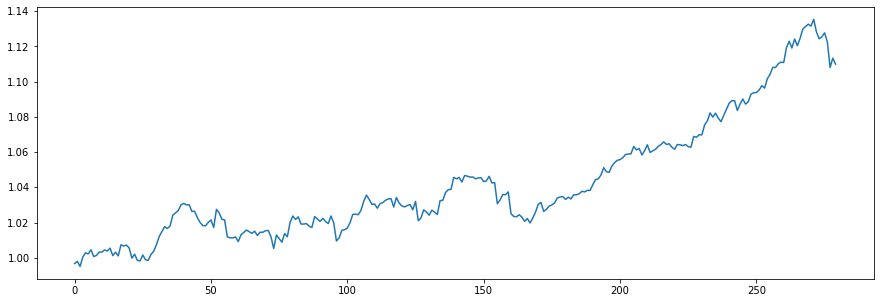

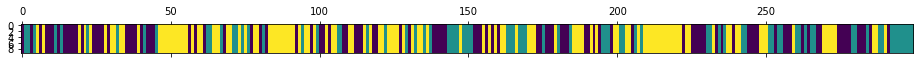

<Figure size 432x288 with 0 Axes>

N [[47. 25. 31.]
 [22. 31. 25.]
 [34. 22. 62.]]
alphas [[4.14844483 1.30850961 1.73244368]
 [2.60203846 2.85491598 1.73244368]
 [2.60203846 1.30850961 3.27885005]]
M [[11.  7.  5.]
 [ 4.  9.  4.]
 [ 9.  5. 12.]]
sum_w [[8.]
 [6.]
 [6.]]
barM [[3. 7. 5.]
 [4. 3. 4.]
 [9. 5. 6.]]
pi_z [[0.54111746 0.18270894 0.2761736 ]
 [0.27464897 0.42447734 0.30087369]
 [0.24827511 0.23814232 0.51358257]]
beta_vec [0.31098131 0.31567561 0.37334308]
hyper>> a_k: 7.358872752968182  gamma: 0.5284334690549229  rho: 0.3434012743176266


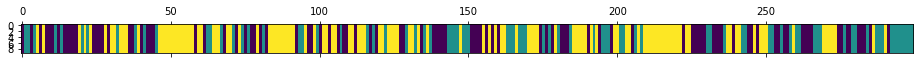

<Figure size 432x288 with 0 Axes>

781
N [[42. 27. 29.]
 [29. 32. 22.]
 [27. 24. 67.]]
alphas [[4.02965401 1.52528978 1.80392896]
 [1.50260773 4.05233606 1.80392896]
 [1.50260773 1.52528978 4.33097524]]
M [[ 8.  7.  4.]
 [ 6.  8.  5.]
 [ 4.  5. 10.]]
sum_w [[5.]
 [5.]
 [5.]]
barM [[3. 7. 4.]
 [6. 3. 5.]
 [4. 5. 5.]]
pi_z [[0.46900178 0.20519443 0.32580379]
 [0.34817956 0.40825064 0.2435698 ]
 [0.25129905 0.21413822 0.53456274]]
beta_vec [0.41113646 0.43981269 0.14905085]
hyper>> a_k: 7.642644923290261  gamma: 0.9702586768732324  rho: 0.2888805281919601


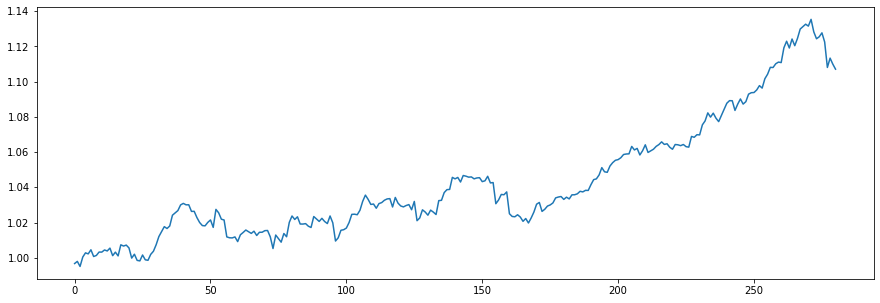

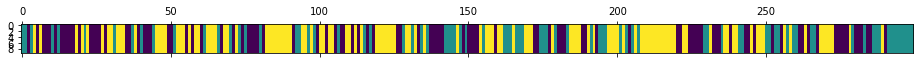

<Figure size 432x288 with 0 Axes>

N [[45. 26. 30.]
 [28. 29. 24.]
 [28. 26. 63.]]
alphas [[4.44226957 2.39030878 0.81006657]
 [2.23445827 4.59812009 0.81006657]
 [2.23445827 2.39030878 3.01787787]]
M [[12.  7.  3.]
 [ 7.  8.  6.]
 [ 5.  7. 11.]]
sum_w [[5.]
 [3.]
 [9.]]
barM [[7. 7. 3.]
 [7. 5. 6.]
 [5. 7. 2.]]
pi_z [[0.44834348 0.20261395 0.34904257]
 [0.40254966 0.38595076 0.21149958]
 [0.26220275 0.22614849 0.51164876]]
beta_vec [0.41405117 0.31662483 0.269324  ]
hyper>> a_k: 6.387414427833567  gamma: 0.6427166074844894  rho: 0.24798791809418158


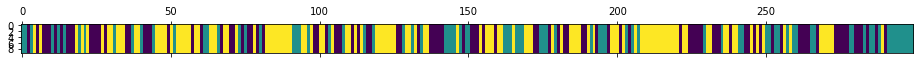

<Figure size 432x288 with 0 Axes>

782
N [[42. 24. 33.]
 [28. 31. 22.]
 [29. 26. 64.]]
alphas [[3.57286033 1.52087976 1.29367434]
 [1.98885872 3.10488137 1.29367434]
 [1.98885872 1.52087976 2.87767595]]
M [[ 8.  8.  5.]
 [ 4. 11.  4.]
 [ 9.  5.  8.]]
sum_w [[3.]
 [4.]
 [6.]]
barM [[5. 8. 5.]
 [4. 7. 4.]
 [9. 5. 2.]]
pi_z [[0.51477892 0.17848138 0.3067397 ]
 [0.40633107 0.36628342 0.22738552]
 [0.31108372 0.21818817 0.47072811]]
beta_vec [0.43616799 0.390324   0.17350801]
hyper>> a_k: 7.682241010932951  gamma: 0.7708625250292589  rho: 0.21071724244795303


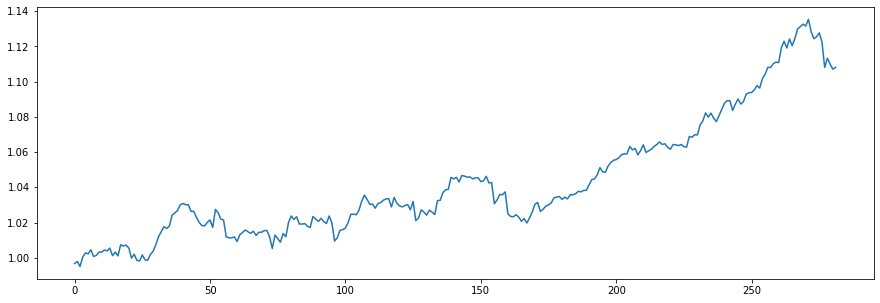

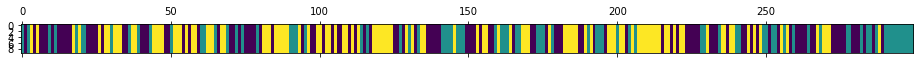

<Figure size 432x288 with 0 Axes>

N [[49. 25. 37.]
 [30. 31. 19.]
 [32. 24. 52.]]
alphas [[4.26346795 2.3667141  1.05205896]
 [2.64468731 3.98549474 1.05205896]
 [2.64468731 2.3667141  2.67083961]]
M [[ 8.  4.  5.]
 [ 9. 12.  1.]
 [16.  6. 11.]]
sum_w [[3.]
 [5.]
 [9.]]
barM [[ 5.  4.  5.]
 [ 9.  7.  1.]
 [16.  6.  2.]]
pi_z [[0.50638844 0.18196779 0.31164377]
 [0.33476972 0.41032377 0.25490651]
 [0.3415961  0.19492142 0.46348248]]
beta_vec [0.53805199 0.35135318 0.11059482]
hyper>> a_k: 12.543398993603434  gamma: 0.15106299306641477  rho: 0.25440374594513604


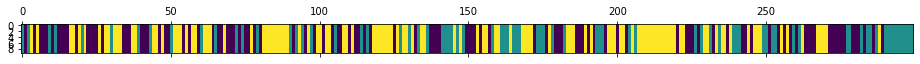

<Figure size 432x288 with 0 Axes>

783
N [[42. 28. 37.]
 [31. 26. 19.]
 [34. 22. 60.]]
alphas [[8.22311744 3.28596435 1.03431721]
 [5.03202975 6.47705204 1.03431721]
 [5.03202975 3.28596435 4.2254049 ]]
M [[19.  7.  3.]
 [ 9. 10.  3.]
 [15.  6.  9.]]
sum_w [[8.]
 [3.]
 [9.]]
barM [[11.  7.  3.]
 [ 9.  7.  3.]
 [15.  6.  0.]]
pi_z [[0.32662094 0.3376138  0.33576526]
 [0.36762668 0.33767223 0.29470109]
 [0.33768411 0.18143438 0.48088151]]
beta_vec [0.47775545 0.39244821 0.12979634]
hyper>> a_k: 9.192988473786311  gamma: 0.7250148334605838  rho: 0.24673954766303774


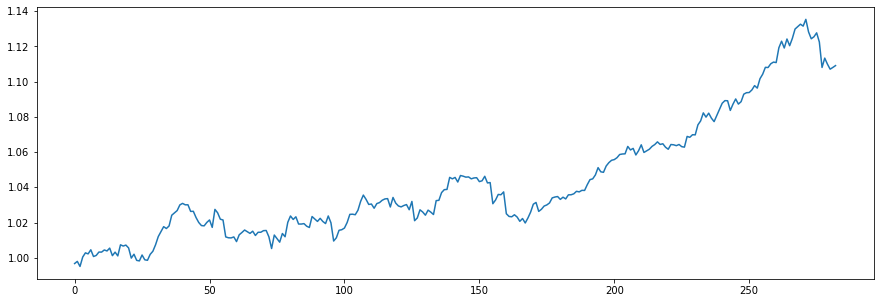

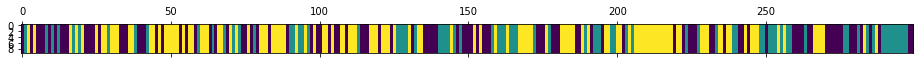

<Figure size 432x288 with 0 Axes>

N [[46. 24. 34.]
 [24. 29. 24.]
 [34. 24. 60.]]
alphas [[5.57659396 2.71759186 0.89880265]
 [3.30832014 4.98586568 0.89880265]
 [3.30832014 2.71759186 3.16707647]]
M [[15.  9.  4.]
 [ 8. 13.  4.]
 [ 6.  6.  9.]]
sum_w [[7.]
 [6.]
 [8.]]
barM [[8. 9. 4.]
 [8. 7. 4.]
 [6. 6. 1.]]
pi_z [[0.4083469  0.27813876 0.31351434]
 [0.27015512 0.40147276 0.32837212]
 [0.2688196  0.25408615 0.47709425]]
beta_vec [0.41685196 0.39872294 0.1844251 ]
hyper>> a_k: 7.7377769837780885  gamma: 0.37483986071297204  rho: 0.285017918014286


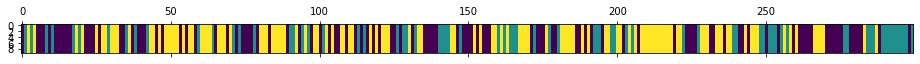

<Figure size 432x288 with 0 Axes>

784
N [[49. 21. 41.]
 [30. 25. 17.]
 [33. 25. 58.]]
alphas [[4.51158517 2.20588358 1.02030823]
 [2.30618008 4.41128867 1.02030823]
 [2.30618008 2.20588358 3.22571332]]
M [[13.  4.  4.]
 [10. 13.  2.]
 [ 6.  4. 12.]]
sum_w [[8.]
 [7.]
 [7.]]
barM [[ 5.  4.  4.]
 [10.  6.  2.]
 [ 6.  4.  5.]]
pi_z [[0.45807135 0.15644246 0.38548619]
 [0.30961762 0.44450569 0.24587669]
 [0.27194256 0.26601423 0.46204321]]
beta_vec [0.4788561  0.30683415 0.21430975]
hyper>> a_k: 7.130506108857572  gamma: 0.48244953756366676  rho: 0.3469606658058806


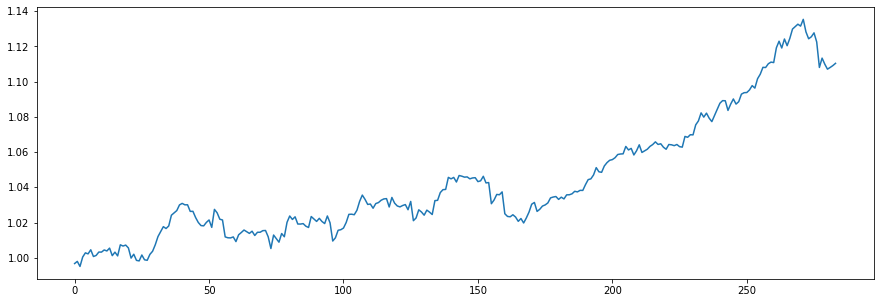

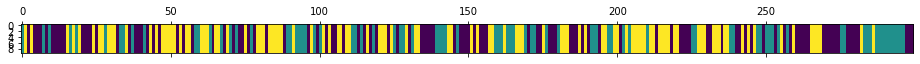

<Figure size 432x288 with 0 Axes>

N [[46. 26. 38.]
 [26. 36. 21.]
 [38. 21. 47.]]
alphas [[4.70379905 1.42877349 0.99793357]
 [2.2297939  3.90277864 0.99793357]
 [2.2297939  1.42877349 3.47193872]]
M [[12.  3.  3.]
 [ 5.  8.  3.]
 [ 6.  3. 11.]]
sum_w [[4.]
 [6.]
 [7.]]
barM [[8. 3. 3.]
 [5. 2. 3.]
 [6. 3. 4.]]
pi_z [[0.41684274 0.20277126 0.380386  ]
 [0.37795388 0.42872257 0.19332355]
 [0.42010509 0.208728   0.37116691]]
beta_vec [0.58155027 0.21803712 0.20041261]
hyper>> a_k: 5.073880326674329  gamma: 1.1057874278054702  rho: 0.34202066781398244


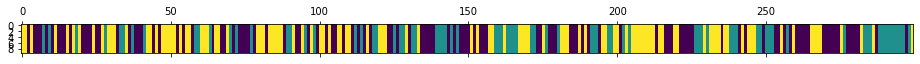

<Figure size 432x288 with 0 Axes>

785
N [[51. 24. 40.]
 [26. 35. 17.]
 [39. 19. 48.]]
alphas [[3.67688238 0.72791875 0.6690792 ]
 [1.94151044 2.46329069 0.6690792 ]
 [1.94151044 0.72791875 2.40445113]]
M [[ 6.  2.  2.]
 [ 7.  6.  1.]
 [10.  2. 11.]]
sum_w [[ 3.]
 [ 4.]
 [10.]]
barM [[ 3.  2.  2.]
 [ 7.  2.  1.]
 [10.  2.  1.]]
pi_z [[0.40478711 0.253901   0.34131189]
 [0.36581473 0.44481135 0.18937391]
 [0.45127212 0.19297087 0.35575701]]
beta_vec [0.47357076 0.19216137 0.33426787]
hyper>> a_k: 3.9864089134583116  gamma: 0.6444520803478547  rho: 0.5107815000909643


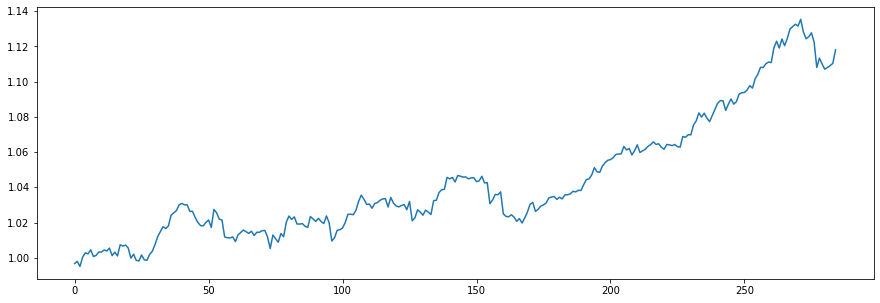

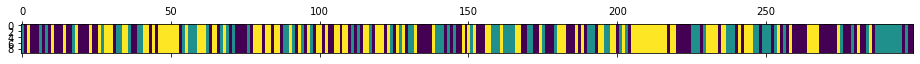

<Figure size 432x288 with 0 Axes>

N [[43. 31. 36.]
 [29. 32. 21.]
 [38. 19. 50.]]
alphas [[2.95975346 0.3747579  0.65189755]
 [0.92356953 2.41094183 0.65189755]
 [0.92356953 0.3747579  2.68808148]]
M [[ 9.  3.  4.]
 [ 3.  8.  4.]
 [ 4.  3. 10.]]
sum_w [[6.]
 [7.]
 [5.]]
barM [[3. 3. 4.]
 [3. 1. 4.]
 [4. 3. 5.]]
pi_z [[0.4015614  0.28687632 0.31156228]
 [0.33222708 0.39035339 0.27741954]
 [0.36037859 0.17015198 0.46946943]]
beta_vec [0.36867915 0.21109577 0.42022508]
hyper>> a_k: 5.625847883186123  gamma: 0.6242478788127951  rho: 0.368947704372989


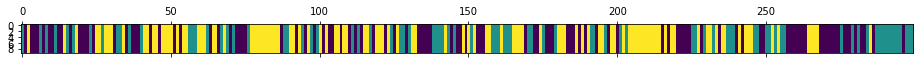

<Figure size 432x288 with 0 Axes>

786
N [[45. 30. 32.]
 [30. 30. 23.]
 [32. 23. 54.]]
alphas [[3.38452995 0.74943308 1.49188486]
 [1.30888629 2.82507674 1.49188486]
 [1.30888629 0.74943308 3.56752852]]
M [[14.  3.  5.]
 [ 4. 10.  3.]
 [ 6.  3. 10.]]
sum_w [[7.]
 [7.]
 [5.]]
barM [[7. 3. 5.]
 [4. 3. 3.]
 [6. 3. 5.]]
pi_z [[0.3945126  0.28954277 0.31594464]
 [0.28960239 0.45753009 0.25286752]
 [0.2903876  0.17833698 0.53127542]]
beta_vec [0.42634896 0.15809325 0.41555779]
hyper>> a_k: 6.959305211628774  gamma: 0.39202529285918075  rho: 0.2550592687809164


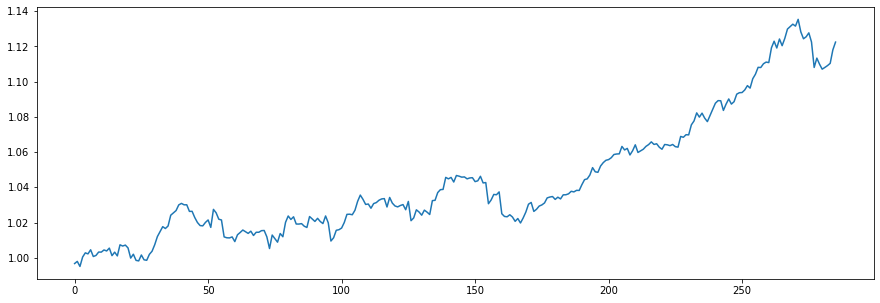

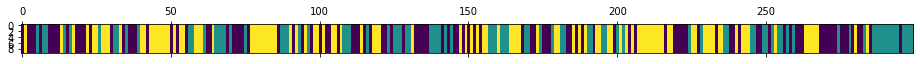

<Figure size 432x288 with 0 Axes>

N [[43. 31. 35.]
 [31. 38. 17.]
 [35. 17. 52.]]
alphas [[3.98534338 0.81959808 2.15436375]
 [2.21030808 2.59463338 2.15436375]
 [2.21030808 0.81959808 3.92939905]]
M [[ 9.  2.  8.]
 [ 6.  8.  2.]
 [ 5.  5. 13.]]
sum_w [[6.]
 [6.]
 [4.]]
barM [[3. 2. 8.]
 [6. 2. 2.]
 [5. 5. 9.]]
pi_z [[0.40265217 0.27934573 0.3180021 ]
 [0.28429379 0.4531037  0.26260251]
 [0.30327233 0.14973279 0.54699488]]
beta_vec [0.3755645  0.20848302 0.41595248]
hyper>> a_k: 5.797003619786122  gamma: 0.7629920831882607  rho: 0.2596525361079566


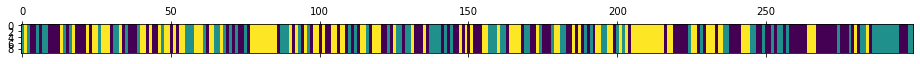

<Figure size 432x288 with 0 Axes>

787
N [[46. 36. 32.]
 [33. 31. 20.]
 [35. 17. 49.]]
alphas [[3.11705326 0.8947668  1.78518357]
 [1.61184656 2.39997349 1.78518357]
 [1.61184656 0.8947668  3.29039026]]
M [[ 9.  4.  5.]
 [ 5.  6.  6.]
 [ 3.  4. 10.]]
sum_w [[2.]
 [5.]
 [6.]]
barM [[7. 4. 5.]
 [5. 1. 6.]
 [3. 4. 4.]]
pi_z [[0.46803925 0.30553225 0.2264285 ]
 [0.33119115 0.39105474 0.27775411]
 [0.26848107 0.20593476 0.52558417]]
beta_vec [0.42694676 0.24902448 0.32402876]
hyper>> a_k: 4.181001064901299  gamma: 0.37758203300687637  rho: 0.29953612885334857


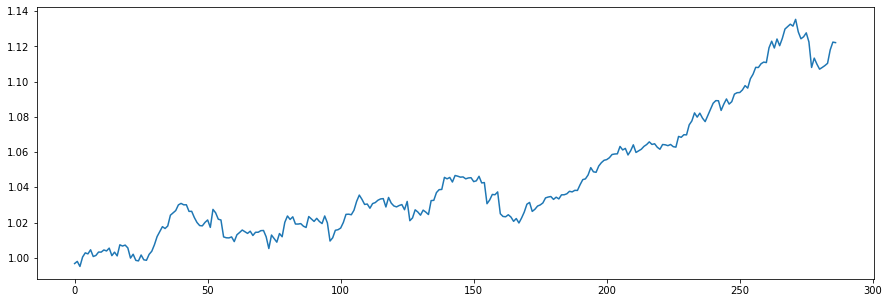

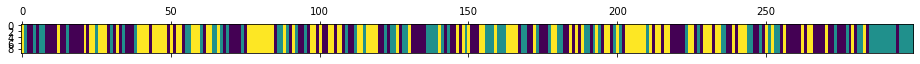

<Figure size 432x288 with 0 Axes>

N [[45. 31. 34.]
 [30. 31. 22.]
 [35. 21. 50.]]
alphas [[2.50273431 0.7293031  0.94896366]
 [1.25037344 1.98166397 0.94896366]
 [1.25037344 0.7293031  2.20132453]]
M [[6. 4. 2.]
 [4. 5. 5.]
 [5. 4. 3.]]
sum_w [[4.]
 [3.]
 [1.]]
barM [[2. 4. 2.]
 [4. 2. 5.]
 [5. 4. 2.]]
pi_z [[0.44251918 0.3178001  0.23968073]
 [0.26617388 0.42587306 0.30795306]
 [0.3875405  0.15121462 0.46124488]]
beta_vec [0.31924347 0.40759174 0.27316479]
hyper>> a_k: 3.897125737346314  gamma: 0.8806405655058648  rho: 0.20500049407826448


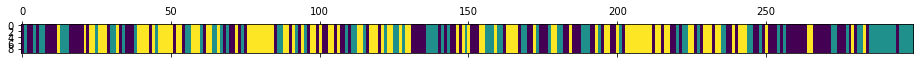

<Figure size 432x288 with 0 Axes>

788
N [[46. 33. 30.]
 [28. 37. 21.]
 [35. 16. 53.]]
alphas [[1.78799698 1.26280605 0.84632271]
 [0.98908427 2.06171875 0.84632271]
 [0.98908427 1.26280605 1.64523541]]
M [[5. 5. 3.]
 [8. 9. 1.]
 [4. 4. 5.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[3. 5. 3.]
 [8. 7. 1.]
 [4. 4. 3.]]
pi_z [[0.51303391 0.27332581 0.21364029]
 [0.36997568 0.4265808  0.20344351]
 [0.34224442 0.10152505 0.55623053]]
beta_vec [0.39505805 0.37888865 0.2260533 ]
hyper>> a_k: 3.4367986733342115  gamma: 2.2018134436529273  rho: 0.15803653866361078


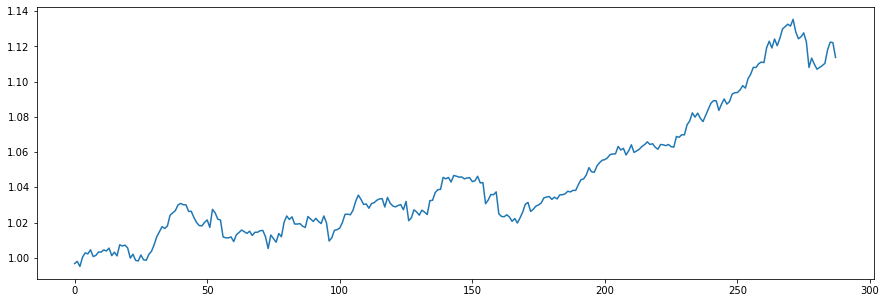

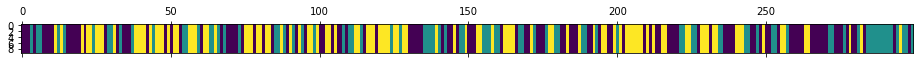

<Figure size 432x288 with 0 Axes>

N [[52. 32. 30.]
 [24. 31. 27.]
 [37. 20. 46.]]
alphas [[1.68630302 1.09637452 0.65412113]
 [1.14316325 1.63951429 0.65412113]
 [1.14316325 1.09637452 1.1972609 ]]
M [[6. 4. 3.]
 [5. 3. 2.]
 [5. 2. 5.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[2. 4. 3.]
 [5. 2. 2.]
 [5. 2. 3.]]
pi_z [[0.45571528 0.28981568 0.25446905]
 [0.30030088 0.3508811  0.34881802]
 [0.34866135 0.21484862 0.43649003]]
beta_vec [0.50855667 0.21151367 0.27992966]
hyper>> a_k: 3.3809437687621258  gamma: 1.333405767098243  rho: 0.24130273551585243


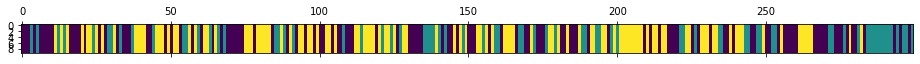

<Figure size 432x288 with 0 Axes>

789
N [[50. 26. 39.]
 [27. 25. 22.]
 [38. 23. 49.]]
alphas [[2.1203362  0.54255642 0.71805115]
 [1.30450522 1.3583874  0.71805115]
 [1.30450522 0.54255642 1.53388213]]
M [[7. 3. 1.]
 [6. 9. 4.]
 [3. 4. 6.]]
sum_w [[1.]
 [5.]
 [5.]]
barM [[6. 3. 1.]
 [6. 4. 4.]
 [3. 4. 1.]]
pi_z [[0.46204578 0.2060221  0.33193212]
 [0.41890304 0.28521104 0.29588592]
 [0.35730913 0.22487    0.41782086]]
beta_vec [0.41263915 0.40111588 0.18624498]
hyper>> a_k: 4.834599310989431  gamma: 0.4719110404173143  rho: 0.30856452171489035


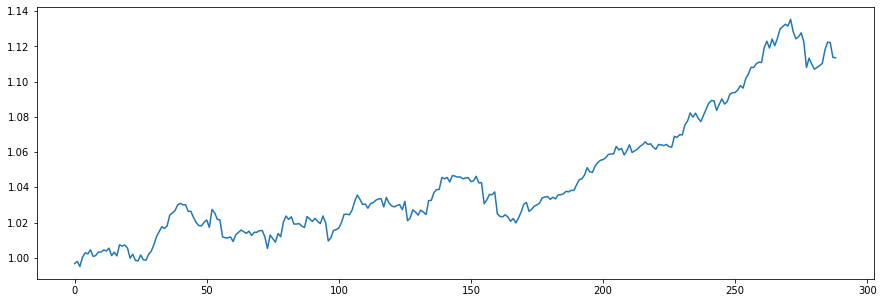

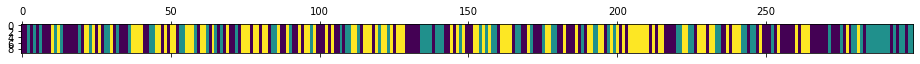

<Figure size 432x288 with 0 Axes>

N [[46. 33. 37.]
 [30. 28. 23.]
 [40. 20. 42.]]
alphas [[2.87116152 1.34085557 0.62258222]
 [1.3793757  2.83264139 0.62258222]
 [1.3793757  1.34085557 2.11436804]]
M [[8. 7. 4.]
 [3. 6. 2.]
 [4. 4. 8.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[4. 7. 4.]
 [3. 4. 2.]
 [4. 4. 2.]]
pi_z [[0.33606978 0.32940014 0.33453008]
 [0.29893634 0.4478609  0.25320276]
 [0.30051675 0.21209542 0.48738783]]
beta_vec [0.44182152 0.3344686  0.22370988]
hyper>> a_k: 4.765637098538383  gamma: 1.8493395604740595  rho: 0.1997246621459287


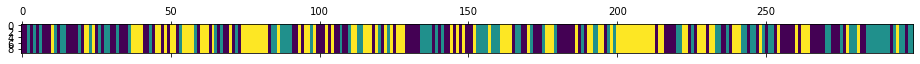

<Figure size 432x288 with 0 Axes>

790
N [[45. 36. 29.]
 [33. 34. 20.]
 [32. 17. 53.]]
alphas [[2.63684383 1.27560365 0.85318962]
 [1.68502857 2.22741891 0.85318962]
 [1.68502857 1.27560365 1.80500488]]
M [[9. 5. 3.]
 [7. 9. 3.]
 [5. 6. 5.]]
sum_w [[3.]
 [4.]
 [1.]]
barM [[6. 5. 3.]
 [7. 5. 3.]
 [5. 6. 4.]]
pi_z [[0.42295521 0.30485565 0.27218914]
 [0.33347706 0.37501878 0.29150416]
 [0.32218124 0.1472565  0.53056226]]
beta_vec [0.50843052 0.32805837 0.16351111]
hyper>> a_k: 4.818754447613235  gamma: 0.5224966242513059  rho: 0.14740287516436418


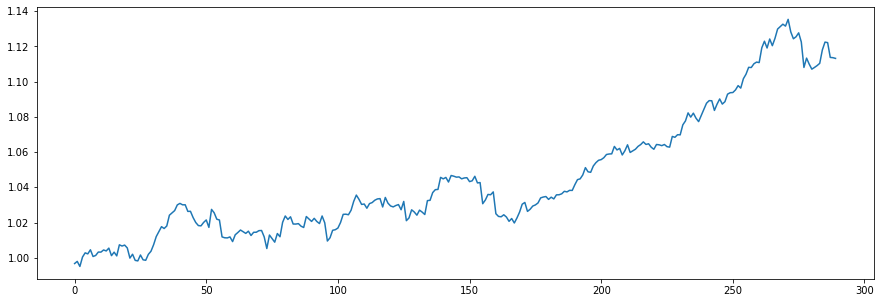

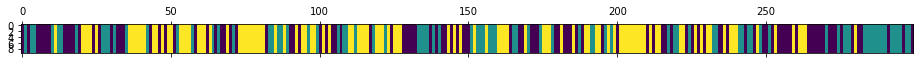

<Figure size 432x288 with 0 Axes>

N [[41. 33. 33.]
 [33. 33. 19.]
 [34. 18. 55.]]
alphas [[2.79916278 1.34781343 0.67177824]
 [2.08886452 2.05811169 0.67177824]
 [2.08886452 1.34781343 1.3820765 ]]
M [[ 5.  8.  4.]
 [ 5. 10.  2.]
 [ 7.  5.  6.]]
sum_w [[2.]
 [4.]
 [1.]]
barM [[3. 8. 4.]
 [5. 6. 2.]
 [7. 5. 5.]]
pi_z [[0.33500309 0.35019267 0.31480424]
 [0.42116461 0.33432971 0.24450568]
 [0.30139852 0.21956005 0.47904144]]
beta_vec [0.40394353 0.39866062 0.19739585]
hyper>> a_k: 4.290352453609268  gamma: 1.0929711930618136  rho: 0.19322973822905132


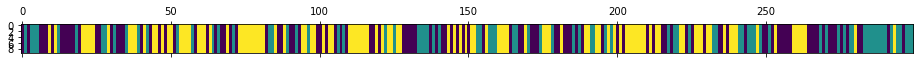

<Figure size 432x288 with 0 Axes>

791
N [[38. 36. 34.]
 [33. 29. 19.]
 [37. 16. 57.]]
alphas [[2.22720503 1.37989548 0.68325194]
 [1.39818135 2.20891916 0.68325194]
 [1.39818135 1.37989548 1.51227562]]
M [[8. 3. 2.]
 [4. 5. 3.]
 [5. 3. 5.]]
sum_w [[5.]
 [1.]
 [2.]]
barM [[3. 3. 2.]
 [4. 4. 3.]
 [5. 3. 3.]]
pi_z [[0.38081974 0.33567079 0.28350947]
 [0.41719319 0.32685839 0.25594843]
 [0.36082541 0.15375111 0.48542349]]
beta_vec [0.35225651 0.32965714 0.31808635]
hyper>> a_k: 3.2934876076806607  gamma: 0.5083095984150824  rho: 0.1659776066896168


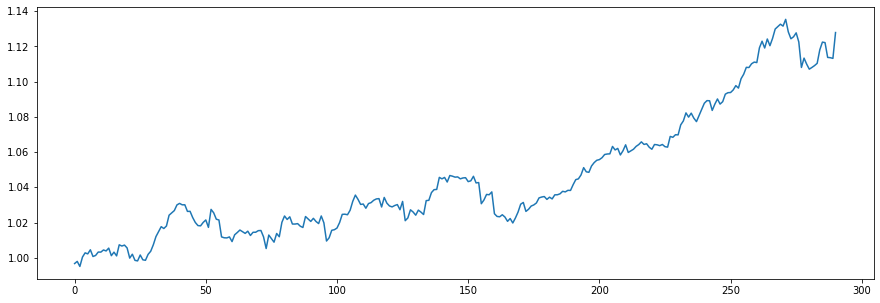

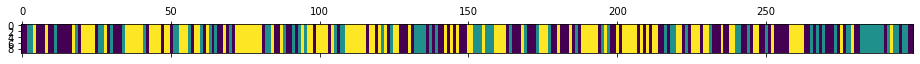

<Figure size 432x288 with 0 Axes>

N [[41. 33. 36.]
 [33. 24. 17.]
 [36. 17. 62.]]
alphas [[1.51423832 0.90551622 0.87373307]
 [0.96759313 1.45216141 0.87373307]
 [0.96759313 0.90551622 1.42037826]]
M [[7. 4. 5.]
 [8. 4. 4.]
 [6. 1. 6.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[4. 4. 5.]
 [8. 3. 4.]
 [6. 1. 2.]]
pi_z [[0.37967195 0.24563343 0.37469462]
 [0.48129685 0.29515894 0.22354421]
 [0.37108556 0.12296697 0.50594747]]
beta_vec [0.48692929 0.2341326  0.27893811]
hyper>> a_k: 4.5283589937678554  gamma: 0.034045518945278706  rho: 0.3354144906499547


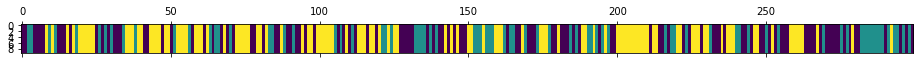

<Figure size 432x288 with 0 Axes>

792
N [[42. 40. 29.]
 [32. 23. 22.]
 [37. 14. 60.]]
alphas [[2.98428206 0.70461778 0.83945915]
 [1.46540484 2.223495   0.83945915]
 [1.46540484 0.70461778 2.35833638]]
M [[6. 4. 5.]
 [5. 5. 5.]
 [7. 3. 8.]]
sum_w [[3.]
 [5.]
 [6.]]
barM [[3. 4. 5.]
 [5. 0. 5.]
 [7. 3. 2.]]
pi_z [[0.38751228 0.38273263 0.22975509]
 [0.45541787 0.25578218 0.28879996]
 [0.35661994 0.18365616 0.4597239 ]]
beta_vec [0.35813234 0.4191572  0.22271046]
hyper>> a_k: 5.265171753498822  gamma: 0.5084445060345689  rho: 0.4066851694368309


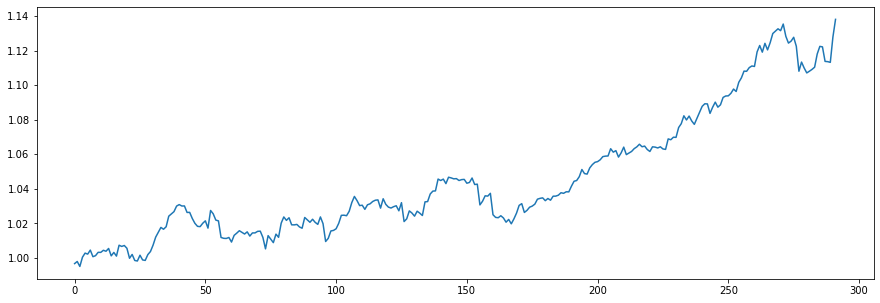

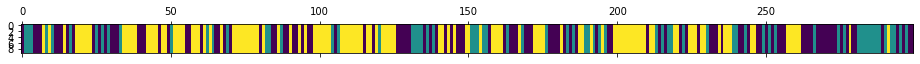

<Figure size 432x288 with 0 Axes>

N [[45. 38. 27.]
 [30. 20. 19.]
 [35. 11. 74.]]
alphas [[3.26003847 1.30940707 0.69572621]
 [1.11877121 3.45067434 0.69572621]
 [1.11877121 1.30940707 2.83699347]]
M [[6. 2. 3.]
 [4. 6. 2.]
 [6. 4. 9.]]
sum_w [[3.]
 [3.]
 [9.]]
barM [[3. 2. 3.]
 [4. 3. 2.]
 [6. 4. 0.]]
pi_z [[0.46258191 0.30857968 0.22883841]
 [0.42887434 0.21832094 0.35280472]
 [0.25020389 0.08625763 0.66353847]]
beta_vec [0.57474253 0.24520086 0.18005661]
hyper>> a_k: 3.0190310216908403  gamma: 0.29023519762058825  rho: 0.3559832413730074


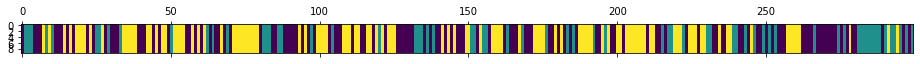

<Figure size 432x288 with 0 Axes>

793
N [[50. 36. 36.]
 [29. 22. 16.]
 [43.  9. 58.]]
alphas [[2.19220013 0.47674564 0.35008526]
 [1.11747568 1.55147009 0.35008526]
 [1.11747568 0.47674564 1.4248097 ]]
M [[8. 5. 2.]
 [4. 5. 1.]
 [7. 1. 6.]]
sum_w [[3.]
 [4.]
 [3.]]
barM [[5. 5. 2.]
 [4. 1. 1.]
 [7. 1. 3.]]
pi_z [[0.3889883  0.33620391 0.27480779]
 [0.55012493 0.3076872  0.14218787]
 [0.35689758 0.12023077 0.52287165]]
beta_vec [0.57174038 0.23329196 0.19496766]
hyper>> a_k: 3.610595666374957  gamma: 1.3486698441464957  rho: 0.19218726042889564


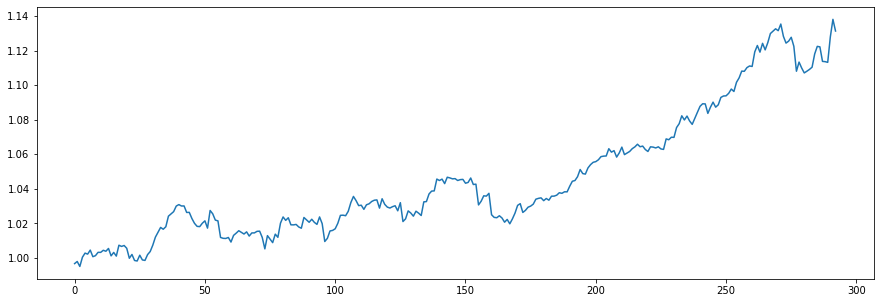

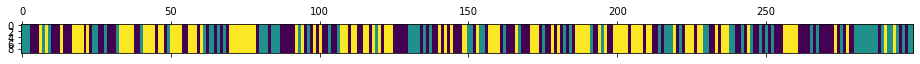

<Figure size 432x288 with 0 Axes>

N [[46. 38. 34.]
 [34. 26. 15.]
 [38. 11. 57.]]
alphas [[2.36149717 0.6804392  0.5686593 ]
 [1.66758668 1.37434969 0.5686593 ]
 [1.66758668 0.6804392  1.26256979]]
M [[ 5.  1.  5.]
 [ 5.  4.  2.]
 [10.  2.  2.]]
sum_w [[2.]
 [2.]
 [2.]]
barM [[ 3.  1.  5.]
 [ 5.  2.  2.]
 [10.  2.  0.]]
pi_z [[0.40476915 0.31783009 0.27740075]
 [0.55483359 0.27172764 0.17343878]
 [0.35394889 0.10644302 0.53960809]]
beta_vec [0.58403597 0.21425167 0.20171237]
hyper>> a_k: 2.8707654610976188  gamma: 0.5345592427424782  rho: 0.22326062113531112


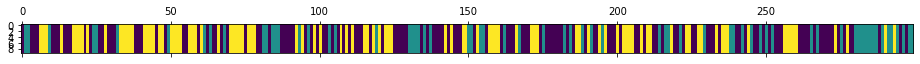

<Figure size 432x288 with 0 Axes>

794
N [[60. 38. 36.]
 [31. 22. 15.]
 [43.  8. 46.]]
alphas [[1.94323365 0.4777462  0.44978561]
 [1.30230477 1.11867508 0.44978561]
 [1.30230477 0.4777462  1.09071449]]
M [[6. 4. 2.]
 [6. 8. 4.]
 [7. 2. 6.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[5. 4. 2.]
 [6. 5. 4.]
 [7. 2. 3.]]
pi_z [[0.42330991 0.3068614  0.26982869]
 [0.44018217 0.27622446 0.28359337]
 [0.38986288 0.06532523 0.54481188]]
beta_vec [0.49882925 0.22766527 0.27350548]
hyper>> a_k: 3.8893059348475356  gamma: 0.261935882997816  rho: 0.13863068481408386


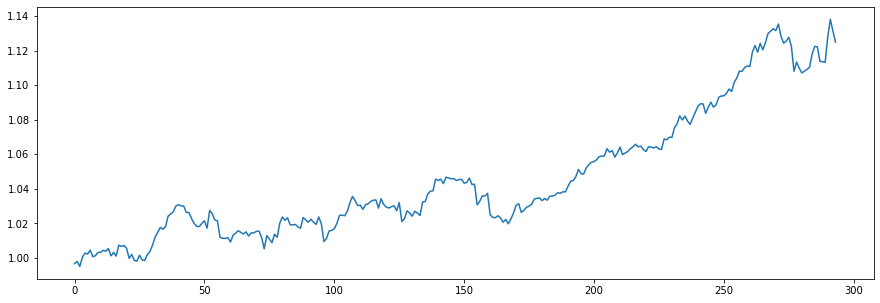

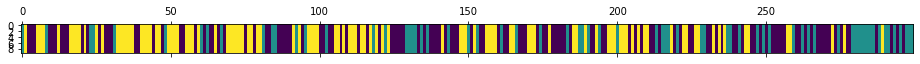

<Figure size 432x288 with 0 Axes>

N [[53. 36. 37.]
 [31. 20. 17.]
 [42. 12. 51.]]
alphas [[2.21031938 0.76270797 0.91627859]
 [1.67114224 1.30188511 0.91627859]
 [1.67114224 0.76270797 1.45545573]]
M [[ 7.  2.  3.]
 [ 4.  2.  4.]
 [10.  3.  9.]]
sum_w [[2.]
 [1.]
 [5.]]
barM [[ 5.  2.  3.]
 [ 4.  1.  4.]
 [10.  3.  4.]]
pi_z [[0.40260651 0.24634994 0.35104355]
 [0.48414513 0.27076914 0.24508573]
 [0.45822214 0.06772228 0.47405558]]
beta_vec [0.62818394 0.12412121 0.24769484]
hyper>> a_k: 3.9964735903461404  gamma: 2.3925914083947055  rho: 0.1987980574027777


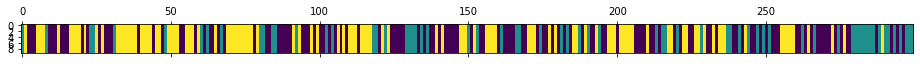

<Figure size 432x288 with 0 Axes>

795
N [[51. 37. 37.]
 [31. 20. 15.]
 [43.  9. 56.]]
alphas [[2.80592512 0.39743394 0.79311452]
 [2.01143394 1.19192513 0.79311452]
 [2.01143394 0.39743394 1.58760571]]
M [[6. 1. 4.]
 [9. 5. 1.]
 [6. 3. 9.]]
sum_w [[1.]
 [2.]
 [6.]]
barM [[5. 1. 4.]
 [9. 3. 1.]
 [6. 3. 3.]]
pi_z [[0.37180732 0.3117887  0.31640398]
 [0.46377614 0.29902683 0.23719703]
 [0.51987283 0.06384918 0.41627799]]
beta_vec [0.44836857 0.31779545 0.23383597]
hyper>> a_k: 4.120437202952446  gamma: 0.3232460583617235  rho: 0.23480201035771173


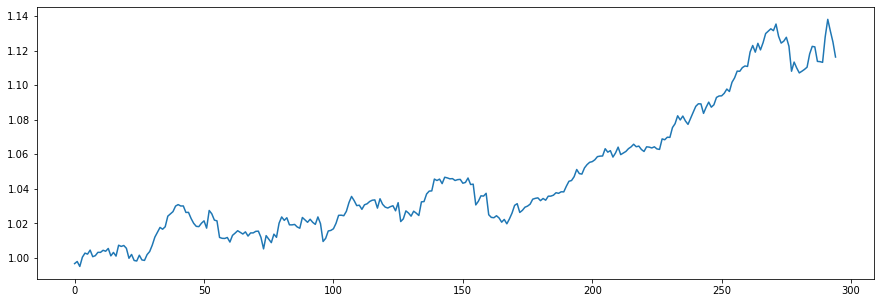

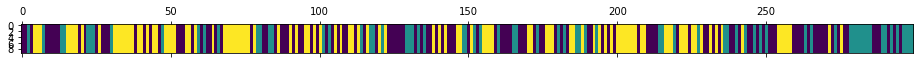

<Figure size 432x288 with 0 Axes>

N [[48. 38. 38.]
 [31. 23. 16.]
 [45.  9. 51.]]
alphas [[2.38117075 1.00199326 0.7372732 ]
 [1.41368381 1.9694802  0.7372732 ]
 [1.41368381 1.00199326 1.70476014]]
M [[5. 5. 3.]
 [8. 6. 3.]
 [4. 3. 7.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[3. 5. 3.]
 [8. 4. 3.]
 [4. 3. 2.]]
pi_z [[0.45993033 0.29135379 0.24871588]
 [0.4386524  0.29689307 0.26445454]
 [0.36634438 0.08881961 0.54483601]]
beta_vec [0.5412935  0.22453613 0.23417037]
hyper>> a_k: 3.2420832153555037  gamma: 0.47463469330557867  rho: 0.28576679483063


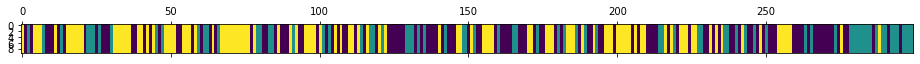

<Figure size 432x288 with 0 Axes>

796
N [[48. 41. 31.]
 [30. 26. 19.]
 [42.  8. 54.]]
alphas [[2.17990084 0.51993665 0.54224572]
 [1.25342111 1.44641638 0.54224572]
 [1.25342111 0.51993665 1.46872545]]
M [[4. 3. 2.]
 [5. 4. 2.]
 [4. 3. 9.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[4. 3. 2.]
 [5. 4. 2.]
 [4. 3. 7.]]
pi_z [[0.39467833 0.3529322  0.25238947]
 [0.33682642 0.46934659 0.19382699]
 [0.52326762 0.0843332  0.39239919]]
beta_vec [0.34949996 0.35938351 0.29111653]
hyper>> a_k: 3.681970085075517  gamma: 0.6531236962513515  rho: 0.08931134297956524


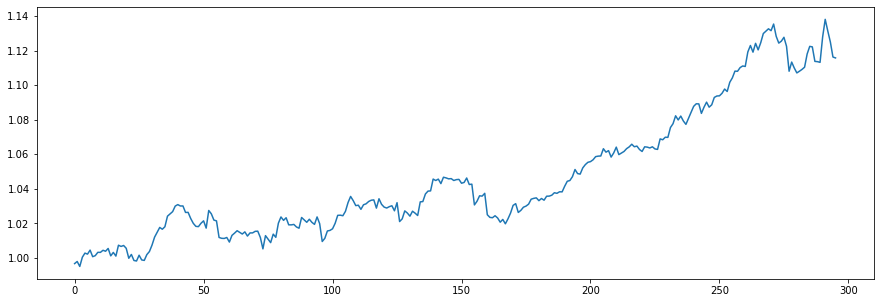

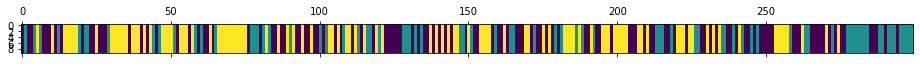

<Figure size 432x288 with 0 Axes>

N [[45. 40. 34.]
 [31. 26. 20.]
 [43. 11. 49.]]
alphas [[1.50075994 1.20505904 0.97615111]
 [1.17191825 1.53390073 0.97615111]
 [1.17191825 1.20505904 1.3049928 ]]
M [[9. 1. 2.]
 [2. 4. 3.]
 [4. 3. 5.]]
sum_w [[3.]
 [2.]
 [0.]]
barM [[6. 1. 2.]
 [2. 2. 3.]
 [4. 3. 5.]]
pi_z [[0.39214533 0.33110336 0.27675131]
 [0.4481079  0.28854367 0.26334844]
 [0.36123422 0.12056187 0.51820391]]
beta_vec [0.33328588 0.36202465 0.30468947]
hyper>> a_k: 2.8542620040106836  gamma: 0.20050340921015536  rho: 0.21691992776191257


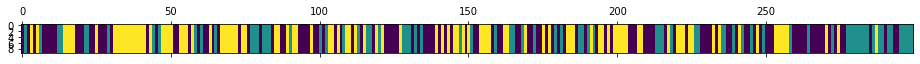

<Figure size 432x288 with 0 Axes>

797
N [[50. 38. 34.]
 [30. 29. 18.]
 [42. 10. 48.]]
alphas [[1.3640788  0.80916699 0.68101621]
 [0.74493249 1.42831329 0.68101621]
 [0.74493249 0.80916699 1.30016252]]
M [[4. 2. 5.]
 [4. 2. 1.]
 [3. 4. 5.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[1. 2. 5.]
 [4. 0. 1.]
 [3. 4. 2.]]
pi_z [[0.33335618 0.35442491 0.31221891]
 [0.46152381 0.3587109  0.17976529]
 [0.50218471 0.10320563 0.39460966]]
beta_vec [0.31233276 0.30536863 0.38229861]
hyper>> a_k: 3.136465576682257  gamma: 0.3061351579847815  rho: 0.41972462001189353


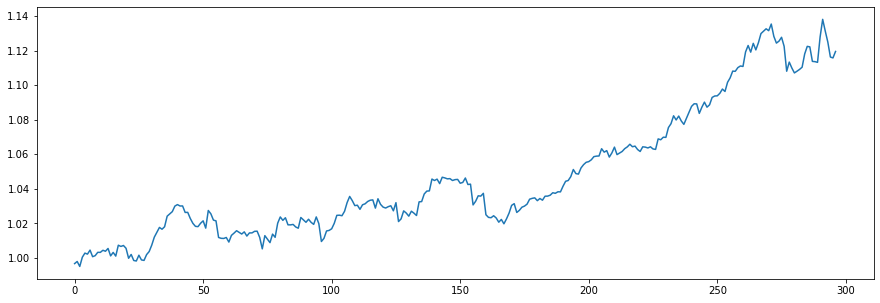

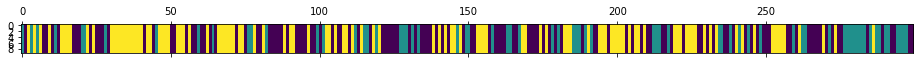

<Figure size 432x288 with 0 Axes>

N [[48. 32. 43.]
 [31. 25. 13.]
 [44. 12. 51.]]
alphas [[1.88490174 0.5557751  0.69578873]
 [0.56844992 1.87222693 0.69578873]
 [0.56844992 0.5557751  2.01224056]]
M [[5. 2. 4.]
 [4. 6. 2.]
 [3. 1. 8.]]
sum_w [[4.]
 [4.]
 [5.]]
barM [[1. 2. 4.]
 [4. 2. 2.]
 [3. 1. 3.]]
pi_z [[0.42922542 0.22489293 0.34588165]
 [0.37855522 0.43775067 0.18369411]
 [0.44350481 0.12292686 0.43356833]]
beta_vec [0.42086351 0.26035504 0.31878145]
hyper>> a_k: 2.5837160300291235  gamma: 0.4612847745899432  rho: 0.5120424825956684


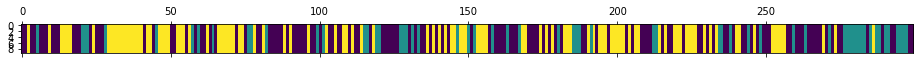

<Figure size 432x288 with 0 Axes>

798
N [[59. 28. 44.]
 [28. 23. 10.]
 [44. 10. 53.]]
alphas [[1.85357338 0.32824096 0.40190169]
 [0.53060101 1.65121333 0.40190169]
 [0.53060101 0.32824096 1.72487406]]
M [[10.  3.  3.]
 [ 1.  5.  2.]
 [ 2.  3.  8.]]
sum_w [[7.]
 [5.]
 [8.]]
barM [[3. 3. 3.]
 [1. 0. 2.]
 [2. 3. 0.]]
pi_z [[0.4887879  0.13277841 0.3784337 ]
 [0.57840771 0.25092562 0.17066667]
 [0.38020219 0.10299679 0.51680102]]
beta_vec [0.31776135 0.35656398 0.32567467]
hyper>> a_k: 2.445558842540309  gamma: 1.3428117251625493  rho: 0.524519102655259


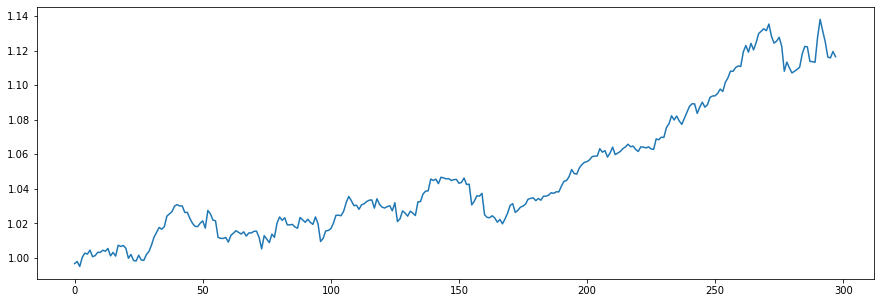

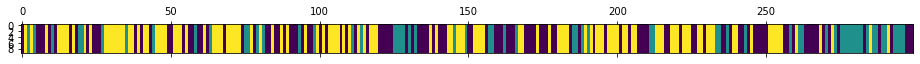

<Figure size 432x288 with 0 Axes>

N [[50. 23. 46.]
 [27. 22. 13.]
 [42. 17. 59.]]
alphas [[1.65224047 0.41461848 0.37869988]
 [0.36949814 1.69736081 0.37869988]
 [0.36949814 0.41461848 1.66144221]]
M [[6. 2. 5.]
 [4. 6. 4.]
 [6. 2. 5.]]
sum_w [[5.]
 [5.]
 [4.]]
barM [[1. 2. 5.]
 [4. 1. 4.]
 [6. 2. 1.]]
pi_z [[0.37671899 0.21849871 0.4047823 ]
 [0.35232163 0.33521179 0.31246658]
 [0.32967267 0.19840391 0.47192343]]
beta_vec [0.32595812 0.26130081 0.41274107]
hyper>> a_k: 3.4090533677331347  gamma: 1.255550607272879  rho: 0.4168219698244519


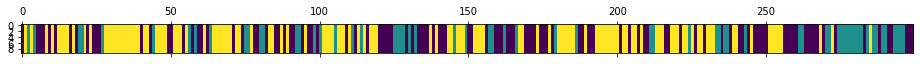

<Figure size 432x288 with 0 Axes>

799
N [[50. 22. 41.]
 [26. 26. 12.]
 [37. 16. 69.]]
alphas [[2.0690008  0.51948822 0.82056434]
 [0.64803246 1.94045656 0.82056434]
 [0.64803246 0.51948822 2.24153268]]
M [[3. 4. 5.]
 [1. 8. 4.]
 [3. 2. 8.]]
sum_w [[1.]
 [7.]
 [5.]]
barM [[2. 4. 5.]
 [1. 1. 4.]
 [3. 2. 3.]]
pi_z [[0.44047069 0.21819059 0.34133872]
 [0.35662547 0.45596446 0.18741007]
 [0.26978506 0.15685207 0.57336286]]
beta_vec [0.13656393 0.34098811 0.52244796]
hyper>> a_k: 2.749526649347019  gamma: 0.3457530279741508  rho: 0.3005118599575438


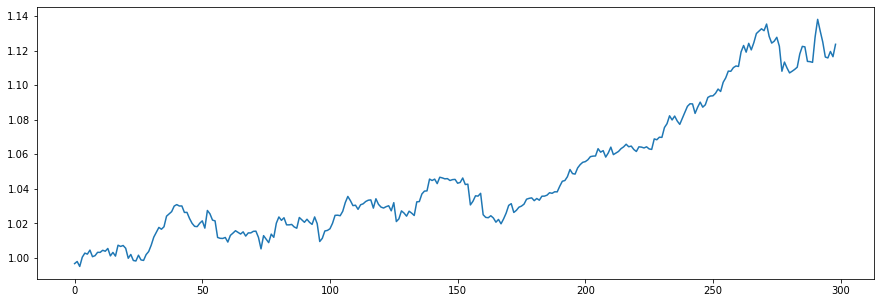

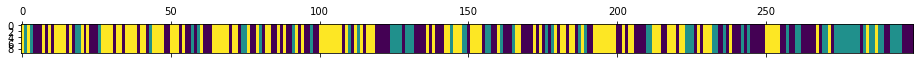

<Figure size 432x288 with 0 Axes>

N [[50. 22. 44.]
 [25. 28. 13.]
 [41. 16. 60.]]
alphas [[1.08891349 0.65580923 1.00480393]
 [0.26264812 1.4820746  1.00480393]
 [0.26264812 0.65580923 1.83106929]]
M [[4. 4. 6.]
 [2. 7. 3.]
 [3. 1. 7.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[0. 4. 6.]
 [2. 5. 3.]
 [3. 1. 1.]]
pi_z [[0.27620163 0.21045707 0.5133413 ]
 [0.35089794 0.48110824 0.16799382]
 [0.3925991  0.10511233 0.50228857]]
beta_vec [0.20122099 0.41288688 0.38589213]
hyper>> a_k: 3.530106241657964  gamma: 0.79504123730698  rho: 0.36808841744927434


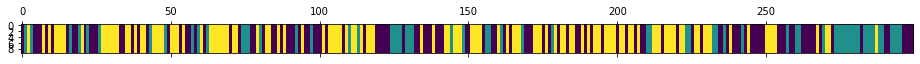

<Figure size 432x288 with 0 Axes>

800
N [[47. 24. 45.]
 [25. 27. 12.]
 [44. 13. 62.]]
alphas [[1.74825791 0.92103296 0.86081538]
 [0.44886669 2.22042418 0.86081538]
 [0.44886669 0.92103296 2.1602066 ]]
M [[ 8.  3.  4.]
 [ 1.  8.  4.]
 [ 2.  2. 12.]]
sum_w [[7.]
 [3.]
 [6.]]
barM [[1. 3. 4.]
 [1. 5. 4.]
 [2. 2. 6.]]
pi_z [[0.32187742 0.23963957 0.43848301]
 [0.33071584 0.45124294 0.21804122]
 [0.32752864 0.07454928 0.59792208]]
beta_vec [0.24605452 0.36072219 0.39322329]
hyper>> a_k: 3.667077335015619  gamma: 0.9921473098884455  rho: 0.3789271338187598


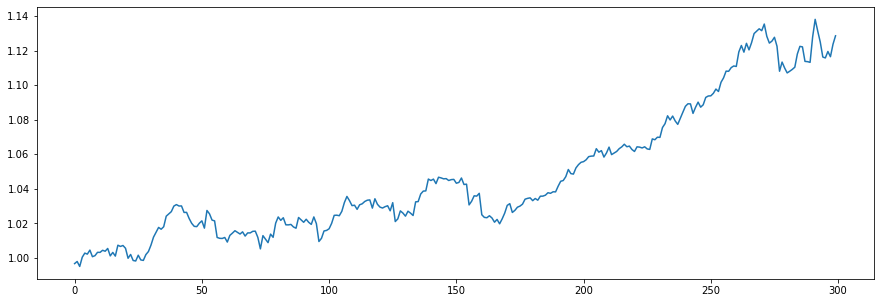

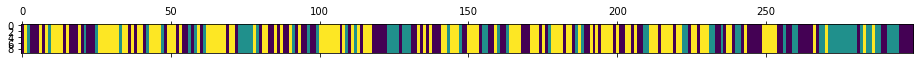

<Figure size 432x288 with 0 Axes>

N [[42. 23. 41.]
 [23. 30. 17.]
 [41. 17. 65.]]
alphas [[1.94994975 0.8215528  0.89557479]
 [0.56039465 2.2111079  0.89557479]
 [0.56039465 0.8215528  2.28512989]]
M [[6. 3. 7.]
 [5. 7. 3.]
 [4. 4. 7.]]
sum_w [[2.]
 [4.]
 [6.]]
barM [[4. 3. 7.]
 [5. 3. 3.]
 [4. 4. 1.]]
pi_z [[0.3624251  0.27193179 0.3656431 ]
 [0.22584514 0.43545283 0.33870204]
 [0.35911876 0.10449623 0.53638501]]
beta_vec [0.45291872 0.16026086 0.38682042]
hyper>> a_k: 5.585421750795955  gamma: 0.9051916214190434  rho: 0.2591002721365079


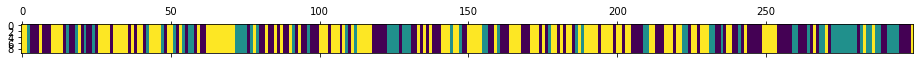

<Figure size 432x288 with 0 Axes>

801
N [[47. 27. 36.]
 [21. 28. 18.]
 [42. 12. 68.]]
alphas [[3.3214695  0.66319751 1.60075475]
 [1.8742852  2.1103818  1.60075475]
 [1.8742852  0.66319751 3.04793904]]
M [[6. 5. 5.]
 [1. 8. 7.]
 [5. 2. 7.]]
sum_w [[3.]
 [4.]
 [4.]]
barM [[3. 5. 5.]
 [1. 4. 7.]
 [5. 2. 3.]]
pi_z [[0.41222949 0.28660571 0.3011648 ]
 [0.34704747 0.36978215 0.28317038]
 [0.28163442 0.13218778 0.5861778 ]]
beta_vec [0.1999351  0.30496339 0.49510151]
hyper>> a_k: 4.221673426861895  gamma: 0.15309071164298685  rho: 0.31488634800230736


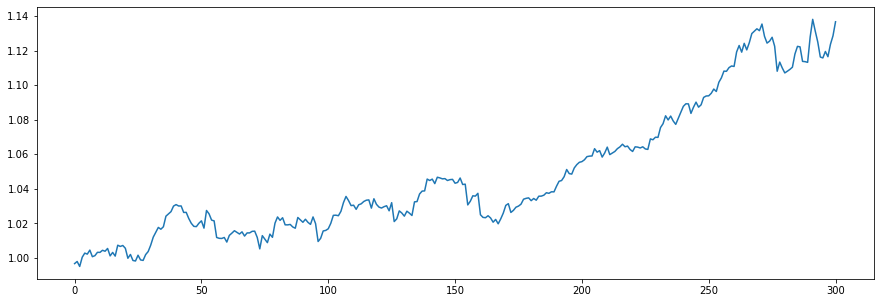

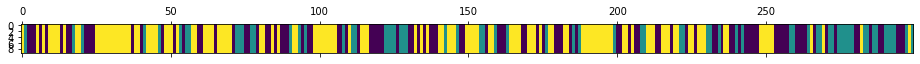

<Figure size 432x288 with 0 Axes>

N [[46. 28. 32.]
 [26. 27. 14.]
 [34. 13. 79.]]
alphas [[1.90762484 0.88205357 1.43199502]
 [0.57827751 2.21140089 1.43199502]
 [0.57827751 0.88205357 2.76134235]]
M [[8. 5. 4.]
 [4. 3. 5.]
 [3. 3. 9.]]
sum_w [[6.]
 [0.]
 [6.]]
barM [[2. 5. 4.]
 [4. 3. 5.]
 [3. 3. 3.]]
pi_z [[0.41145783 0.29717049 0.29137167]
 [0.41745116 0.38145196 0.20109688]
 [0.22290448 0.12627514 0.65082038]]
beta_vec [0.31776071 0.26970545 0.41253383]
hyper>> a_k: 3.9850469363046566  gamma: 0.9927449221117904  rho: 0.4569314218234216


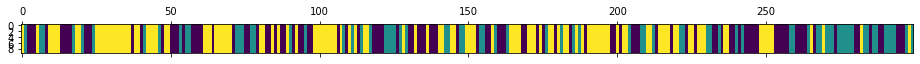

<Figure size 432x288 with 0 Axes>

802
N [[49. 29. 29.]
 [27. 29. 19.]
 [31. 17. 69.]]
alphas [[2.50857621 0.58368408 0.89278665]
 [0.68768305 2.40457724 0.89278665]
 [0.68768305 0.58368408 2.71367981]]
M [[9. 2. 2.]
 [5. 9. 2.]
 [3. 1. 8.]]
sum_w [[8.]
 [8.]
 [5.]]
barM [[1. 2. 2.]
 [5. 1. 2.]
 [3. 1. 3.]]
pi_z [[0.52756947 0.24926574 0.2231648 ]
 [0.31251226 0.47581636 0.21167139]
 [0.24151396 0.12465899 0.63382705]]
beta_vec [0.2594896  0.33831761 0.40219279]
hyper>> a_k: 4.8387239247279545  gamma: 0.5993872416937329  rho: 0.5033740633341294


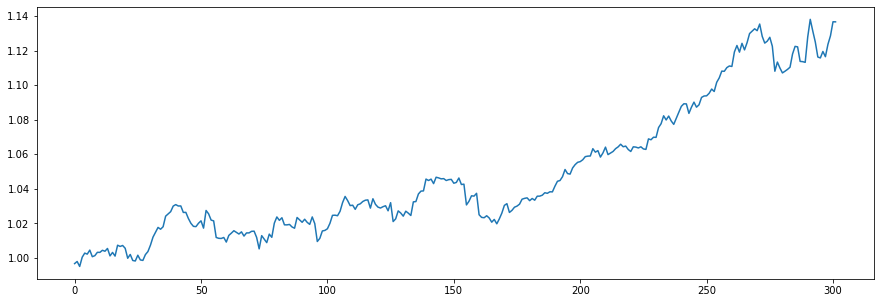

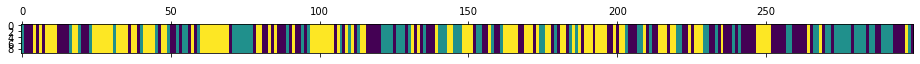

<Figure size 432x288 with 0 Axes>

N [[45. 29. 32.]
 [32. 36. 15.]
 [30. 17. 63.]]
alphas [[3.05925091 0.81298933 0.96648368]
 [0.62356279 3.24867745 0.96648368]
 [0.62356279 0.81298933 3.40217181]]
M [[9. 4. 3.]
 [2. 5. 2.]
 [2. 3. 8.]]
sum_w [[6.]
 [2.]
 [6.]]
barM [[3. 4. 3.]
 [2. 3. 2.]
 [2. 3. 2.]]
pi_z [[0.43103524 0.2202001  0.34876466]
 [0.33397506 0.53430517 0.13171977]
 [0.25298706 0.19787596 0.54913698]]
beta_vec [0.24427427 0.46354809 0.29217764]
hyper>> a_k: 3.074323392523264  gamma: 1.5567240748943953  rho: 0.5835506173589714


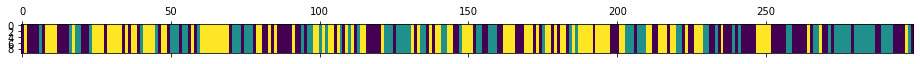

<Figure size 432x288 with 0 Axes>

803
N [[47. 25. 35.]
 [28. 42. 14.]
 [32. 17. 59.]]
alphas [[2.10676768 0.59348065 0.37407506]
 [0.31274437 2.38750396 0.37407506]
 [0.31274437 0.59348065 2.16809837]]
M [[6. 1. 3.]
 [2. 8. 2.]
 [3. 2. 9.]]
sum_w [[6.]
 [7.]
 [5.]]
barM [[0. 1. 3.]
 [2. 1. 2.]
 [3. 2. 4.]]
pi_z [[0.48608829 0.20753104 0.30638067]
 [0.32233377 0.48078965 0.19687658]
 [0.21758999 0.24441012 0.53799989]]
beta_vec [0.53372748 0.21240176 0.25387076]
hyper>> a_k: 2.721919507762703  gamma: 0.13017188925283554  rho: 0.4556039822439733


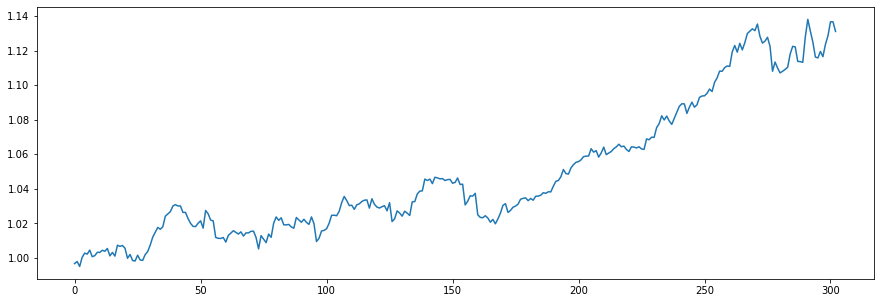

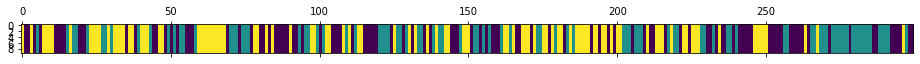

<Figure size 432x288 with 0 Axes>

N [[46. 29. 32.]
 [33. 41. 18.]
 [28. 22. 50.]]
alphas [[2.03099589 0.31473738 0.37618624]
 [0.79087852 1.55485474 0.37618624]
 [0.79087852 0.31473738 1.61630361]]
M [[6. 2. 4.]
 [6. 4. 2.]
 [7. 2. 6.]]
sum_w [[4.]
 [3.]
 [5.]]
barM [[2. 2. 4.]
 [6. 1. 2.]
 [7. 2. 1.]]
pi_z [[0.53883814 0.2566055  0.20455636]
 [0.30086449 0.44594207 0.25319344]
 [0.28349382 0.23943457 0.47707161]]
beta_vec [0.65611249 0.1015691  0.24231842]
hyper>> a_k: 4.302230172560228  gamma: 0.23609321027727254  rho: 0.21910708258081654


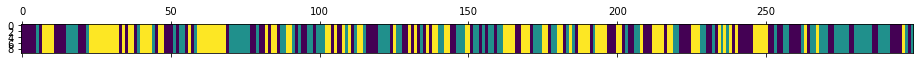

<Figure size 432x288 with 0 Axes>

804
N [[44. 30. 30.]
 [36. 46. 13.]
 [24. 19. 57.]]
alphas [[3.1469122  0.34122961 0.81408836]
 [2.2042631  1.28387871 0.81408836]
 [2.2042631  0.34122961 1.75673746]]
M [[ 6.  3.  3.]
 [12.  4.  4.]
 [ 5.  2.  9.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[ 4.  3.  3.]
 [12.  1.  4.]
 [ 5.  2.  5.]]
pi_z [[0.38387803 0.27994833 0.33617364]
 [0.34014943 0.53431316 0.12553741]
 [0.23952305 0.20005351 0.56042343]]
beta_vec [0.50445433 0.13169874 0.36384693]
hyper>> a_k: 5.745197247199505  gamma: 0.9338316917234728  rho: 0.31216433491102796


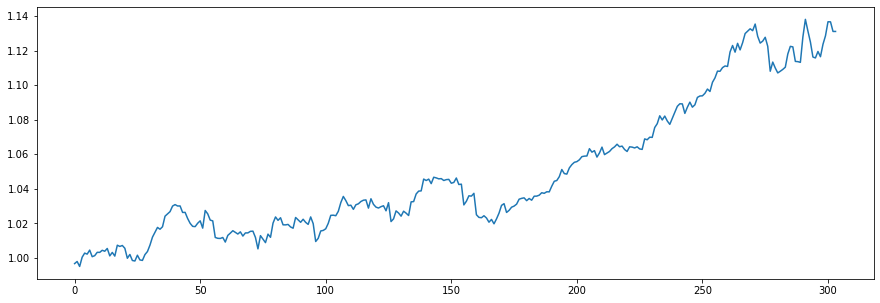

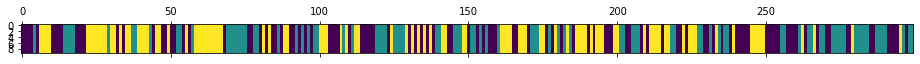

<Figure size 432x288 with 0 Axes>

N [[47. 31. 33.]
 [32. 45. 13.]
 [32. 14. 52.]]
alphas [[3.78692387 0.5204407  1.43783268]
 [1.99347819 2.31388637 1.43783268]
 [1.99347819 0.5204407  3.23127836]]
M [[ 9.  2.  4.]
 [ 2.  5.  4.]
 [11.  1. 11.]]
sum_w [[3.]
 [5.]
 [7.]]
barM [[ 6.  2.  4.]
 [ 2.  0.  4.]
 [11.  1.  4.]]
pi_z [[0.38376875 0.23142793 0.38480332]
 [0.40519936 0.44217336 0.15262728]
 [0.31744562 0.10293567 0.57961872]]
beta_vec [0.5684403  0.03174068 0.39981902]
hyper>> a_k: 4.169581734731825  gamma: 0.10020495453292234  rho: 0.4698569841007648


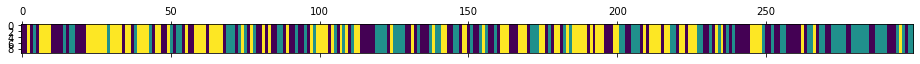

<Figure size 432x288 with 0 Axes>

805
N [[43. 37. 30.]
 [34. 36. 18.]
 [33. 15. 53.]]
alphas [[3.21562996 0.07016198 0.8837898 ]
 [1.25652286 2.02926908 0.8837898 ]
 [1.25652286 0.07016198 2.8428969 ]]
M [[ 7.  1.  5.]
 [ 5.  9.  2.]
 [ 6.  1. 13.]]
sum_w [[5.]
 [9.]
 [9.]]
barM [[2. 1. 5.]
 [5. 0. 2.]
 [6. 1. 4.]]
pi_z [[0.42813062 0.32771524 0.24415414]
 [0.33684794 0.48179128 0.18136079]
 [0.27922854 0.17420614 0.54656532]]
beta_vec [0.51753665 0.09952749 0.38293586]
hyper>> a_k: 3.887451150601109  gamma: 1.1177314211561262  rho: 0.5770929249539389


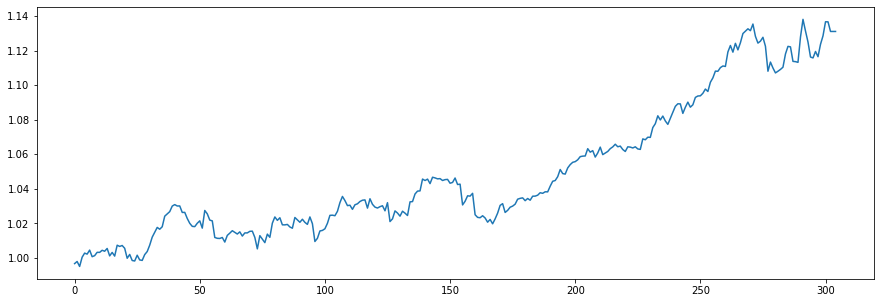

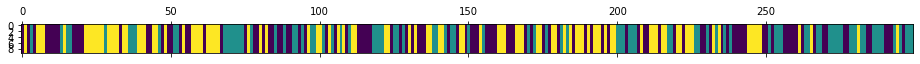

<Figure size 432x288 with 0 Axes>

N [[43. 35. 32.]
 [31. 39. 19.]
 [36. 15. 49.]]
alphas [[3.09426664 0.16362624 0.62955827]
 [0.85084609 2.4070468  0.62955827]
 [0.85084609 0.16362624 2.87297882]]
M [[9. 2. 3.]
 [4. 7. 3.]
 [1. 3. 8.]]
sum_w [[6.]
 [7.]
 [6.]]
barM [[3. 2. 3.]
 [4. 0. 3.]
 [1. 3. 2.]]
pi_z [[0.39555449 0.32683373 0.27761178]
 [0.24303822 0.51088362 0.24607816]
 [0.35363    0.12721357 0.51915643]]
beta_vec [0.54625184 0.12928015 0.32446801]
hyper>> a_k: 2.9544108882419144  gamma: 0.7747262777376578  rho: 0.3757599571624241


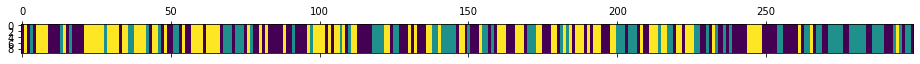

<Figure size 432x288 with 0 Axes>

806
N [[53. 29. 32.]
 [26. 40. 17.]
 [34. 15. 53.]]
alphas [[2.11758059 0.23842642 0.59840388]
 [1.00743128 1.34857573 0.59840388]
 [1.00743128 0.23842642 1.70855319]]
M [[9. 2. 4.]
 [3. 2. 2.]
 [3. 1. 6.]]
sum_w [[7.]
 [1.]
 [5.]]
barM [[2. 2. 4.]
 [3. 1. 2.]
 [3. 1. 1.]]
pi_z [[0.4911727  0.26397997 0.24484732]
 [0.26456056 0.56702217 0.16841727]
 [0.22014415 0.10037688 0.67947898]]
beta_vec [0.13964941 0.41670434 0.44364625]
hyper>> a_k: 2.0292177191397127  gamma: 1.4771516842253598  rho: 0.3849040924171846


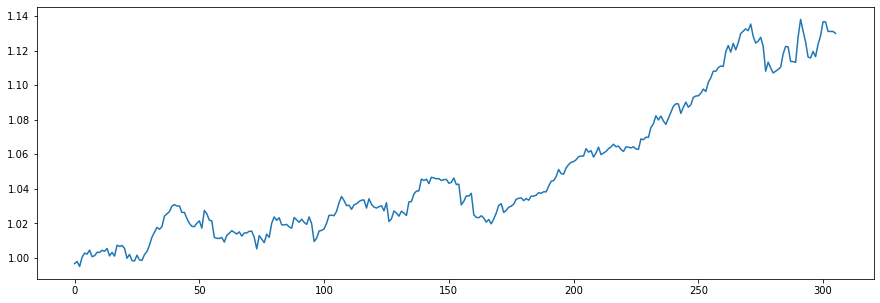

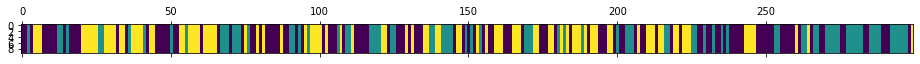

<Figure size 432x288 with 0 Axes>

N [[59. 29. 33.]
 [30. 42. 12.]
 [31. 13. 50.]]
alphas [[0.9553595  0.52011516 0.55374306]
 [0.17430529 1.30116936 0.55374306]
 [0.17430529 0.52011516 1.33479727]]
M [[5. 2. 2.]
 [1. 5. 4.]
 [3. 2. 8.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[2. 2. 2.]
 [1. 3. 4.]
 [3. 2. 3.]]
pi_z [[0.45736828 0.19782118 0.34481054]
 [0.40106812 0.41197813 0.18695375]
 [0.31939374 0.18850779 0.49209848]]
beta_vec [0.30964455 0.28197781 0.40837764]
hyper>> a_k: 3.2923571982935624  gamma: 1.1016909711153153  rho: 0.3886140181886503


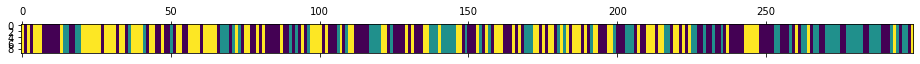

<Figure size 432x288 with 0 Axes>

807
N [[53. 26. 42.]
 [29. 35. 12.]
 [39. 15. 48.]]
alphas [[1.90274    0.56759342 0.82202378]
 [0.62328384 1.84704958 0.82202378]
 [0.62328384 0.56759342 2.10147994]]
M [[5. 5. 6.]
 [6. 9. 2.]
 [3. 3. 9.]]
sum_w [[3.]
 [5.]
 [8.]]
barM [[2. 5. 6.]
 [6. 4. 2.]
 [3. 3. 1.]]
pi_z [[0.41787042 0.18069072 0.40143887]
 [0.27099787 0.59815049 0.13085164]
 [0.36593171 0.15292368 0.48114462]]
beta_vec [0.40081613 0.24161986 0.35756401]
hyper>> a_k: 4.793806678551377  gamma: 0.864822427848209  rho: 0.2238435941007022


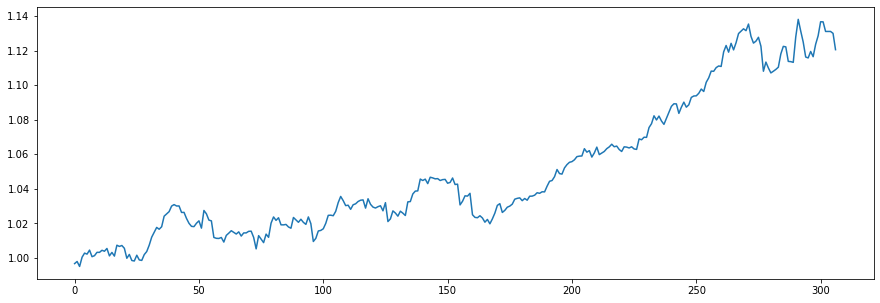

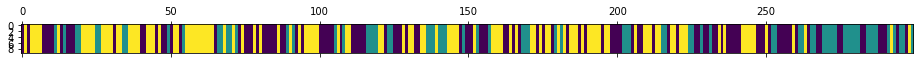

<Figure size 432x288 with 0 Axes>

N [[52. 20. 41.]
 [26. 35. 12.]
 [35. 19. 59.]]
alphas [[2.56439705 0.89900558 1.33040405]
 [1.49133413 1.9720685  1.33040405]
 [1.49133413 0.89900558 2.40346697]]
M [[7. 1. 4.]
 [3. 5. 3.]
 [5. 2. 8.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[5. 1. 4.]
 [3. 2. 3.]
 [5. 2. 4.]]
pi_z [[0.46556664 0.14317545 0.39125791]
 [0.36813412 0.5045339  0.12733198]
 [0.28944109 0.15008493 0.56047398]]
beta_vec [0.4701297  0.19675636 0.33311394]
hyper>> a_k: 3.436647973395988  gamma: 0.38335326253305224  rho: 0.322316538831821


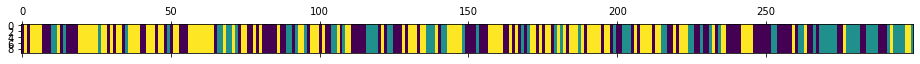

<Figure size 432x288 with 0 Axes>

808
N [[49. 20. 41.]
 [27. 33. 13.]
 [34. 20. 62.]]
alphas [[2.2026015  0.45823759 0.77580888]
 [1.09491302 1.56592607 0.77580888]
 [1.09491302 0.45823759 1.88349736]]
M [[7. 1. 4.]
 [3. 8. 2.]
 [3. 1. 9.]]
sum_w [[3.]
 [6.]
 [5.]]
barM [[4. 1. 4.]
 [3. 2. 2.]
 [3. 1. 4.]]
pi_z [[0.48126276 0.12914782 0.38958942]
 [0.34157151 0.4903853  0.16804319]
 [0.29070292 0.21072894 0.49856814]]
beta_vec [0.3519237  0.08782982 0.56024648]
hyper>> a_k: 3.0375331415859583  gamma: 0.37511893058411305  rho: 0.4004520018406676


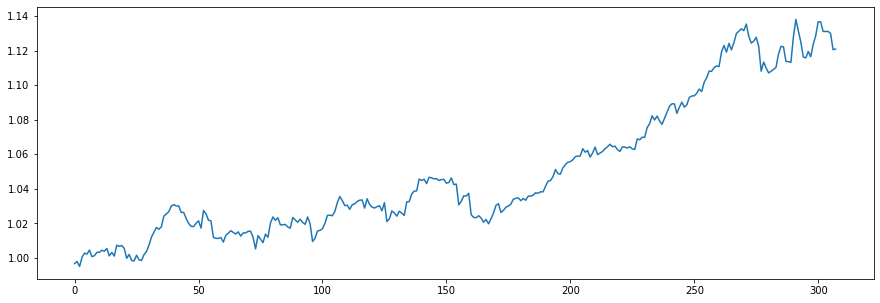

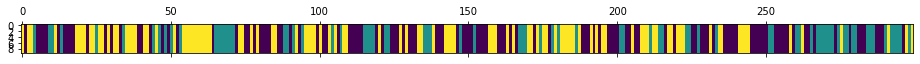

<Figure size 432x288 with 0 Axes>

N [[59. 21. 40.]
 [29. 33. 14.]
 [32. 21. 50.]]
alphas [[1.85729099 0.159951   1.02029114]
 [0.64090477 1.37633723 1.02029114]
 [0.64090477 0.159951   2.23667737]]
M [[ 6.  1.  4.]
 [ 4.  5.  4.]
 [ 3.  2. 11.]]
sum_w [[2.]
 [5.]
 [4.]]
barM [[4. 1. 4.]
 [4. 0. 4.]
 [3. 2. 7.]]
pi_z [[0.55722607 0.11595633 0.3268176 ]
 [0.34227087 0.48344595 0.17428317]
 [0.25799428 0.21259214 0.52941357]]
beta_vec [0.48984904 0.19149922 0.31865173]
hyper>> a_k: 3.8860162515390075  gamma: 0.3952670436479093  rho: 0.2946329170207977


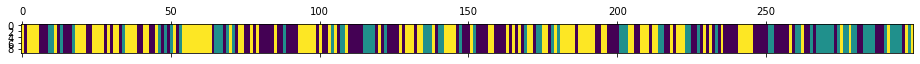

<Figure size 432x288 with 0 Axes>

809
N [[55. 20. 42.]
 [28. 30. 12.]
 [34. 20. 58.]]
alphas [[2.48765782 0.52491238 0.87344605]
 [1.34270952 1.66986068 0.87344605]
 [1.34270952 0.52491238 2.01839436]]
M [[10.  3.  4.]
 [ 4.  3.  1.]
 [ 7.  3.  3.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[8. 3. 4.]
 [4. 3. 1.]
 [7. 3. 0.]]
pi_z [[0.4951736  0.21248727 0.29233913]
 [0.36879338 0.46507153 0.16613509]
 [0.34970249 0.14736175 0.50293575]]
beta_vec [0.62243434 0.26586799 0.11169767]
hyper>> a_k: 3.220539174778088  gamma: 0.6438948475654626  rho: 0.1606171424211913


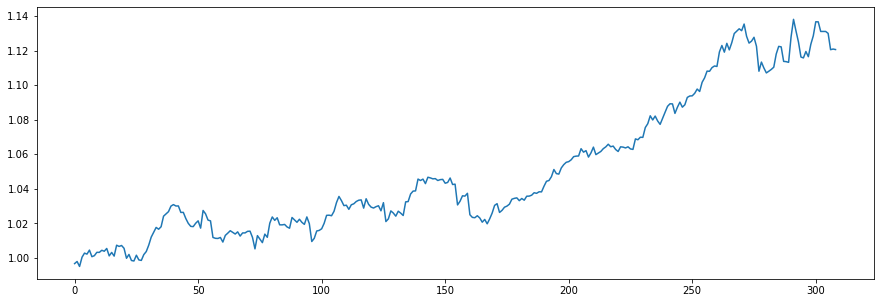

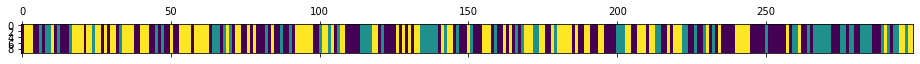

<Figure size 432x288 with 0 Axes>

N [[55. 26. 40.]
 [33. 28. 12.]
 [33. 19. 53.]]
alphas [[2.19987899 0.71871173 0.30194845]
 [1.68260519 1.23598553 0.30194845]
 [1.68260519 0.71871173 0.81922225]]
M [[7. 3. 2.]
 [3. 9. 1.]
 [6. 2. 5.]]
sum_w [[4.]
 [4.]
 [5.]]
barM [[3. 3. 2.]
 [3. 5. 1.]
 [6. 2. 0.]]
pi_z [[0.41987762 0.23512332 0.34499906]
 [0.53807745 0.36494815 0.0969744 ]
 [0.29982201 0.22505649 0.47512149]]
beta_vec [0.46199433 0.46926521 0.06874046]
hyper>> a_k: 4.3853653475296355  gamma: 1.3803524999722105  rho: 0.40371634853918514


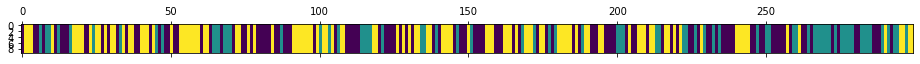

<Figure size 432x288 with 0 Axes>

810
N [[51. 28. 40.]
 [32. 28. 12.]
 [36. 16. 56.]]
alphas [[2.97852266 1.22709176 0.17975092]
 [1.20807898 2.99753545 0.17975092]
 [1.20807898 1.22709176 1.95019461]]
M [[11.  4.  2.]
 [ 4.  7.  1.]
 [ 5.  4.  6.]]
sum_w [[5.]
 [5.]
 [6.]]
barM [[6. 4. 2.]
 [4. 2. 1.]
 [5. 4. 0.]]
pi_z [[0.526225   0.18667325 0.28710175]
 [0.4907086  0.37746688 0.13182452]
 [0.31325914 0.10378947 0.58295139]]
beta_vec [0.65726976 0.21346543 0.12926481]
hyper>> a_k: 3.856821678293733  gamma: 0.7927944012143782  rho: 0.4904892518233342


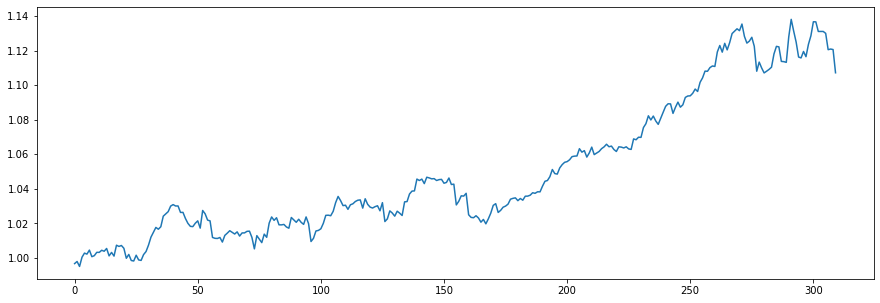

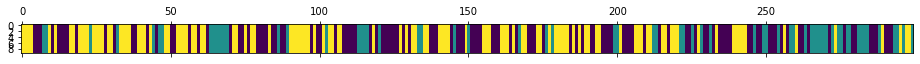

<Figure size 432x288 with 0 Axes>

N [[57. 20. 43.]
 [25. 28. 11.]
 [38. 17. 60.]]
alphas [[3.18332519 0.41947923 0.25401726]
 [1.29159561 2.3112088  0.25401726]
 [1.29159561 0.41947923 2.14574684]]
M [[ 9.  1.  3.]
 [ 7.  5.  1.]
 [ 5.  3. 14.]]
sum_w [[ 5.]
 [ 3.]
 [13.]]
barM [[4. 1. 3.]
 [7. 2. 1.]
 [5. 3. 1.]]
pi_z [[0.48569553 0.1107748  0.40352967]
 [0.38107542 0.47996373 0.13896085]
 [0.34842687 0.16582796 0.48574517]]
beta_vec [0.58261607 0.11150887 0.30587506]
hyper>> a_k: 3.3992487134163354  gamma: 1.3401606909718218  rho: 0.33730844157899514


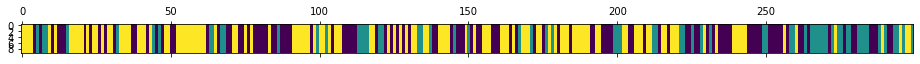

<Figure size 432x288 with 0 Axes>

811
N [[48. 21. 43.]
 [26. 25. 14.]
 [38. 19. 65.]]
alphas [[2.45902736 0.25119084 0.68903051]
 [1.31243208 1.39778613 0.68903051]
 [1.31243208 0.25119084 1.83562579]]
M [[8. 1. 6.]
 [2. 4. 1.]
 [5. 1. 7.]]
sum_w [[5.]
 [2.]
 [5.]]
barM [[3. 1. 6.]
 [2. 2. 1.]
 [5. 1. 2.]]
pi_z [[0.41716546 0.18029459 0.40253995]
 [0.34523987 0.45397114 0.20078899]
 [0.25644073 0.17392892 0.56963035]]
beta_vec [0.51414744 0.14431697 0.34153559]
hyper>> a_k: 2.434272668904646  gamma: 1.2972743975142973  rho: 0.3351340300447041


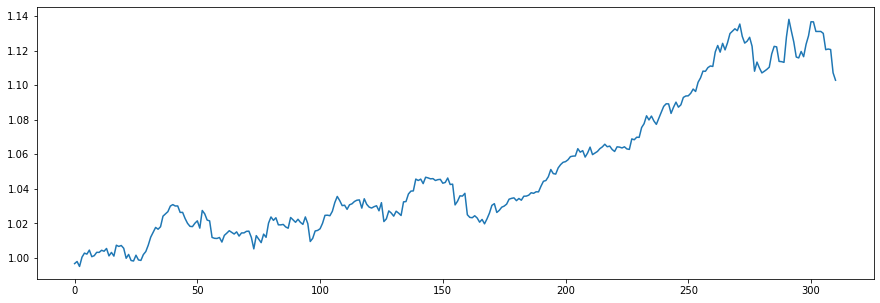

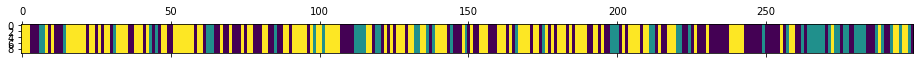

<Figure size 432x288 with 0 Axes>

N [[49. 19. 46.]
 [23. 22. 12.]
 [43. 15. 70.]]
alphas [[1.64793728 0.23357197 0.55276342]
 [0.83212967 1.04937958 0.55276342]
 [0.83212967 0.23357197 1.36857103]]
M [[6. 2. 1.]
 [3. 3. 2.]
 [8. 1. 5.]]
sum_w [[4.]
 [2.]
 [5.]]
barM [[2. 2. 1.]
 [3. 1. 2.]
 [8. 1. 0.]]
pi_z [[0.35958351 0.19308308 0.44733341]
 [0.39058948 0.34588971 0.26352081]
 [0.37595953 0.14065605 0.48338441]]
beta_vec [0.5241342  0.34570597 0.13015983]
hyper>> a_k: 2.373291694968256  gamma: 0.7134617578671227  rho: 0.34354791330915774


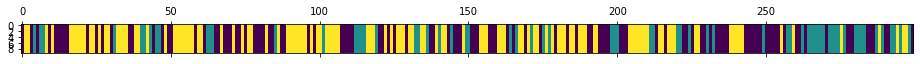

<Figure size 432x288 with 0 Axes>

812
N [[54. 22. 38.]
 [23. 27. 16.]
 [37. 17. 65.]]
alphas [[1.63191548 0.53859341 0.2027828 ]
 [0.81657608 1.35393282 0.2027828 ]
 [0.81657608 0.53859341 1.01812221]]
M [[6. 3. 1.]
 [4. 5. 2.]
 [4. 2. 3.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[4. 3. 1.]
 [4. 2. 2.]
 [4. 2. 2.]]
pi_z [[0.4664155  0.20218176 0.33140274]
 [0.2591861  0.44951962 0.29129429]
 [0.33406576 0.15746444 0.50846981]]
beta_vec [0.2846434  0.49413494 0.22122166]
hyper>> a_k: 2.8043840845805703  gamma: 1.3304879183489666  rho: 0.19901827274959932


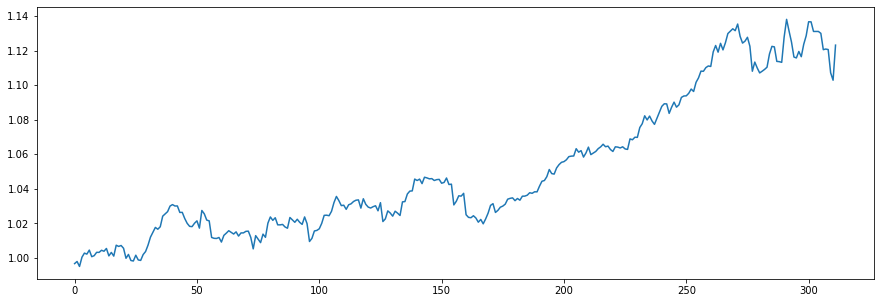

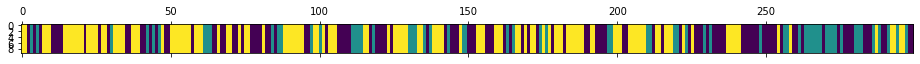

<Figure size 432x288 with 0 Axes>

N [[54. 24. 35.]
 [28. 23. 12.]
 [31. 16. 76.]]
alphas [[1.19750687 1.10995575 0.49692146]
 [0.6393832  1.66807943 0.49692146]
 [0.6393832  1.10995575 1.05504513]]
M [[7. 4. 2.]
 [3. 4. 4.]
 [3. 5. 9.]]
sum_w [[3.]
 [3.]
 [6.]]
barM [[4. 4. 2.]
 [3. 1. 4.]
 [3. 5. 3.]]
pi_z [[0.52362643 0.22718174 0.24919183]
 [0.46551283 0.31406515 0.22042202]
 [0.28710869 0.18453048 0.52836084]]
beta_vec [0.24556881 0.49219421 0.26223698]
hyper>> a_k: 4.31628727221905  gamma: 0.760102889952718  rho: 0.2987029348889276


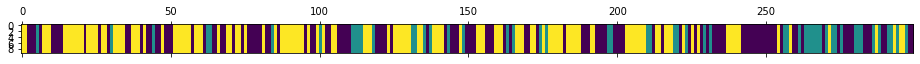

<Figure size 432x288 with 0 Axes>

813
N [[65. 21. 36.]
 [22. 18. 13.]
 [35. 14. 75.]]
alphas [[2.03262436 1.48987168 0.79379123]
 [0.74333668 2.77915936 0.79379123]
 [0.74333668 1.48987168 2.08307891]]
M [[15.  7.  5.]
 [ 5.  2.  2.]
 [ 3.  4.  5.]]
sum_w [[10.]
 [ 0.]
 [ 3.]]
barM [[5. 7. 5.]
 [5. 2. 2.]
 [3. 4. 2.]]
pi_z [[0.48772443 0.20942917 0.3028464 ]
 [0.47119543 0.35296612 0.17583845]
 [0.27894622 0.14435971 0.57669406]]
beta_vec [0.36082108 0.33036923 0.30880968]
hyper>> a_k: 5.629223349031934  gamma: 0.24279519325476223  rho: 0.4278871342924066


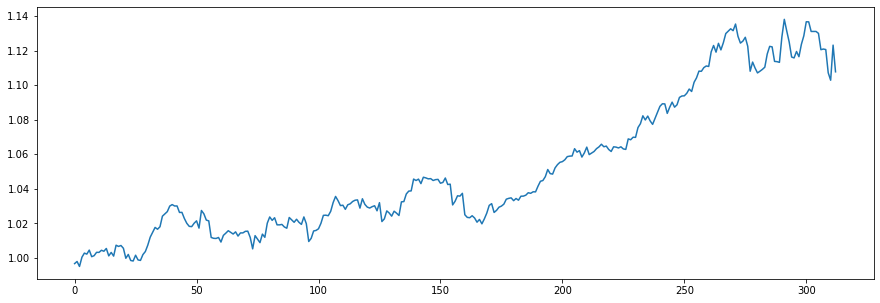

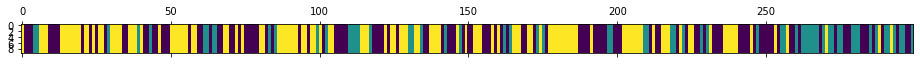

<Figure size 432x288 with 0 Axes>

N [[58. 24. 38.]
 [27. 22. 12.]
 [34. 16. 68.]]
alphas [[3.57071498 1.063971   0.99453737]
 [1.16204273 3.47264325 0.99453737]
 [1.16204273 1.063971   3.40320962]]
M [[ 7.  3.  4.]
 [ 5.  4.  2.]
 [ 6.  1. 10.]]
sum_w [[6.]
 [2.]
 [6.]]
barM [[1. 3. 4.]
 [5. 2. 2.]
 [6. 1. 4.]]
pi_z [[0.51835369 0.17137468 0.31027163]
 [0.40419455 0.39681256 0.19899289]
 [0.21889041 0.22721388 0.55389571]]
beta_vec [0.39889691 0.2556443  0.34545879]
hyper>> a_k: 3.8381753258461444  gamma: 2.2386914298032137  rho: 0.37298537272540444


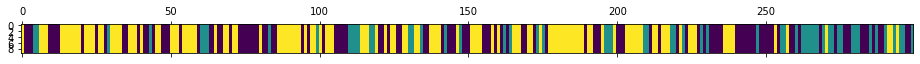

<Figure size 432x288 with 0 Axes>

814
N [[58. 23. 35.]
 [23. 23. 13.]
 [35. 13. 76.]]
alphas [[2.3915654  0.61523155 0.83137837]
 [0.95998215 2.0468148  0.83137837]
 [0.95998215 0.61523155 2.26296163]]
M [[12.  2.  2.]
 [ 4.  6.  5.]
 [ 5.  2.  8.]]
sum_w [[8.]
 [5.]
 [5.]]
barM [[4. 2. 2.]
 [4. 1. 5.]
 [5. 2. 3.]]
pi_z [[0.48962896 0.22067211 0.28969894]
 [0.46912693 0.2892584  0.24161468]
 [0.2511378  0.09083244 0.65802976]]
beta_vec [0.57312902 0.15760866 0.26926232]
hyper>> a_k: 4.336293755840743  gamma: 0.8473424854446536  rho: 0.48683349219517846


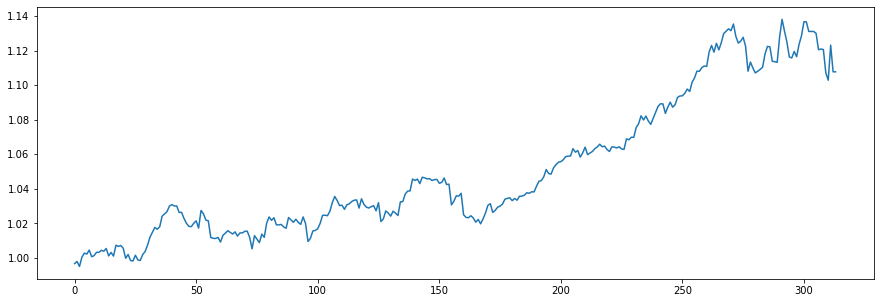

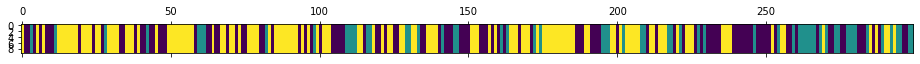

<Figure size 432x288 with 0 Axes>

N [[51. 19. 42.]
 [27. 22. 10.]
 [34. 18. 76.]]
alphas [[3.38640306 0.35071722 0.59917348]
 [1.27535003 2.46177025 0.59917348]
 [1.27535003 0.35071722 2.71022651]]
M [[12.  1.  2.]
 [ 5.  7.  2.]
 [ 6.  2.  9.]]
sum_w [[11.]
 [ 6.]
 [ 8.]]
barM [[1. 1. 2.]
 [5. 1. 2.]
 [6. 2. 1.]]
pi_z [[0.46613751 0.18486143 0.34900106]
 [0.43272748 0.37454478 0.19272774]
 [0.27809221 0.17177112 0.55013667]]
beta_vec [0.45311032 0.33852795 0.20836173]
hyper>> a_k: 4.451642988976663  gamma: 0.8990986293211711  rho: 0.534233245299149


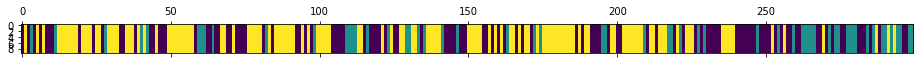

<Figure size 432x288 with 0 Axes>

815
N [[51. 23. 39.]
 [28. 19. 11.]
 [34. 16. 78.]]
alphas [[3.317707   0.70191309 0.4320229 ]
 [0.93949131 3.08012877 0.4320229 ]
 [0.93949131 0.70191309 2.81023858]]
M [[9. 2. 3.]
 [3. 4. 2.]
 [3. 4. 9.]]
sum_w [[7.]
 [3.]
 [8.]]
barM [[2. 2. 3.]
 [3. 1. 2.]
 [3. 4. 1.]]
pi_z [[0.51275485 0.17154529 0.31569986]
 [0.43110762 0.31296273 0.25592965]
 [0.24482289 0.11041447 0.64476264]]
beta_vec [0.46383574 0.25478219 0.28138207]
hyper>> a_k: 3.2370133543738966  gamma: 0.318262449736045  rho: 0.46945721841521143


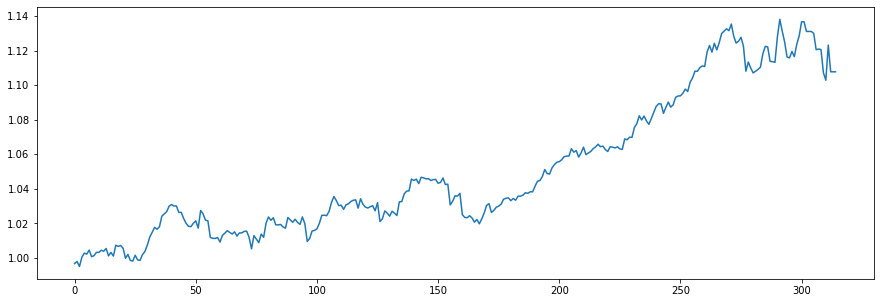

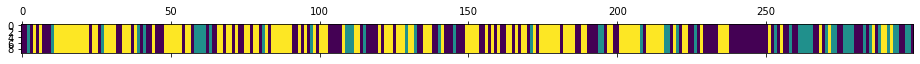

<Figure size 432x288 with 0 Axes>

N [[55. 20. 44.]
 [23. 17. 10.]
 [42. 12. 76.]]
alphas [[2.31621876 0.43755633 0.48323827]
 [0.79657947 1.95719561 0.48323827]
 [0.79657947 0.43755633 2.00287755]]
M [[7. 2. 6.]
 [1. 4. 3.]
 [2. 4. 5.]]
sum_w [[3.]
 [2.]
 [2.]]
barM [[4. 2. 6.]
 [1. 2. 3.]
 [2. 4. 3.]]
pi_z [[0.54610955 0.17959658 0.27429387]
 [0.44336167 0.31784319 0.23879515]
 [0.29503416 0.12168495 0.58328089]]
beta_vec [0.25730936 0.29356821 0.44912243]
hyper>> a_k: 3.0852055540342596  gamma: 1.5424537147426656  rho: 0.19470462357963642


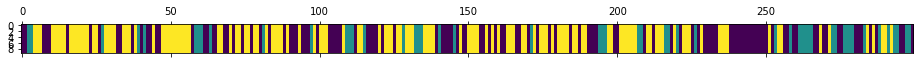

<Figure size 432x288 with 0 Axes>

816
N [[55. 18. 45.]
 [19. 21. 11.]
 [44. 12. 74.]]
alphas [[1.23998935 0.72937073 1.11584548]
 [0.63928556 1.33007451 1.11584548]
 [0.63928556 0.72937073 1.71654926]]
M [[8. 3. 7.]
 [1. 3. 3.]
 [5. 4. 6.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[4. 3. 7.]
 [1. 2. 3.]
 [5. 4. 4.]]
pi_z [[0.50792217 0.13574208 0.35633575]
 [0.37766324 0.45210453 0.17023223]
 [0.38457402 0.06773282 0.54769316]]
beta_vec [0.42676192 0.17045602 0.40278206]
hyper>> a_k: 3.3662951571376936  gamma: 2.3420945934218196  rho: 0.2589827247366428


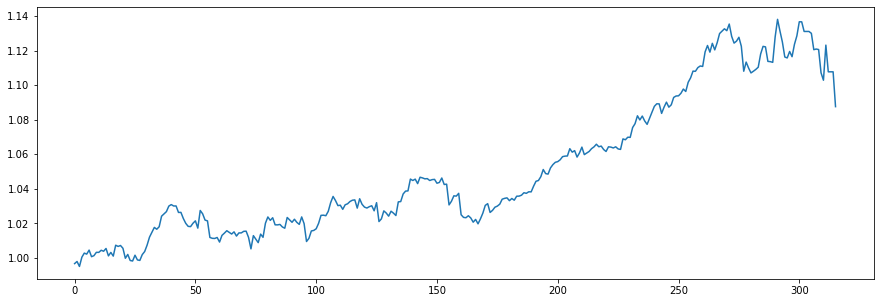

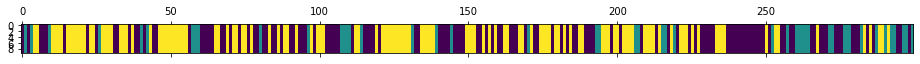

<Figure size 432x288 with 0 Axes>

N [[65. 19. 45.]
 [21. 17.  8.]
 [42. 11. 71.]]
alphas [[1.93636259 0.42519963 1.00473294]
 [1.06455029 1.29701193 1.00473294]
 [1.06455029 0.42519963 1.87654523]]
M [[ 9.  2.  4.]
 [ 4.  4.  4.]
 [ 3.  2. 11.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[7. 2. 4.]
 [4. 1. 4.]
 [3. 2. 6.]]
pi_z [[0.54909006 0.14090096 0.31000898]
 [0.34980107 0.41835223 0.2318467 ]
 [0.34547265 0.07142477 0.58310258]]
beta_vec [0.57479501 0.2451713  0.18003369]
hyper>> a_k: 3.659249116651729  gamma: 1.1478372633299285  rho: 0.23974522910299428


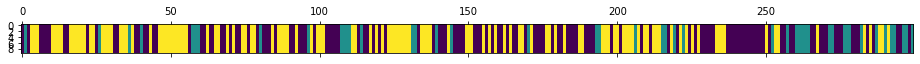

<Figure size 432x288 with 0 Axes>

817
N [[67. 16. 49.]
 [19. 18.  9.]
 [46. 12. 63.]]
alphas [[2.47634517 0.68205714 0.50084681]
 [1.59905765 1.55934466 0.50084681]
 [1.59905765 0.68205714 1.37813433]]
M [[14.  3.  3.]
 [ 3.  4.  3.]
 [ 5.  2.  7.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[12.  3.  3.]
 [ 3.  2.  3.]
 [ 5.  2.  4.]]
pi_z [[0.42509816 0.09250762 0.48239422]
 [0.42960853 0.36420101 0.20619046]
 [0.39665733 0.0764475  0.52689517]]
beta_vec [0.60177008 0.26355541 0.13467451]
hyper>> a_k: 5.091383061197697  gamma: 0.4263983379528507  rho: 0.17612924411151273


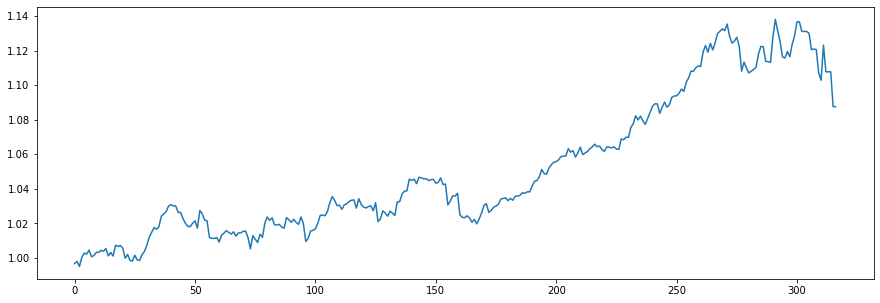

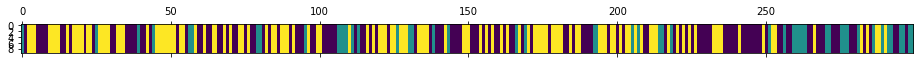

<Figure size 432x288 with 0 Axes>

N [[60. 16. 54.]
 [21. 18. 10.]
 [49. 15. 56.]]
alphas [[3.42095127 1.10552049 0.5649113 ]
 [2.52420982 2.00226194 0.5649113 ]
 [2.52420982 1.10552049 1.46165275]]
M [[12.  5.  2.]
 [ 7.  7.  2.]
 [11.  6.  6.]]
sum_w [[3.]
 [3.]
 [2.]]
barM [[ 9.  5.  2.]
 [ 7.  4.  2.]
 [11.  6.  4.]]
pi_z [[0.44334794 0.16838622 0.38826584]
 [0.53780257 0.25047275 0.21172468]
 [0.38417259 0.19462352 0.42120389]]
beta_vec [0.53083623 0.36242636 0.10673741]
hyper>> a_k: 7.127876934347087  gamma: 0.9727339074128317  rho: 0.19535802856844892


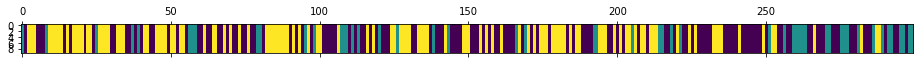

<Figure size 432x288 with 0 Axes>

818
N [[62. 21. 51.]
 [26. 17.  7.]
 [46. 12. 57.]]
alphas [[4.43704025 2.07865612 0.61218057]
 [3.04455227 3.4711441  0.61218057]
 [3.04455227 2.07865612 2.00466855]]
M [[7. 1. 6.]
 [8. 7. 3.]
 [9. 7. 6.]]
sum_w [[4.]
 [1.]
 [4.]]
barM [[3. 1. 6.]
 [8. 6. 3.]
 [9. 7. 2.]]
pi_z [[0.49865945 0.20881572 0.29252483]
 [0.5352261  0.2492181  0.2155558 ]
 [0.32979712 0.08313063 0.58707225]]
beta_vec [0.57076263 0.23687014 0.19236723]
hyper>> a_k: 6.683784603974055  gamma: 0.5366545087882388  rho: 0.11920755860446043


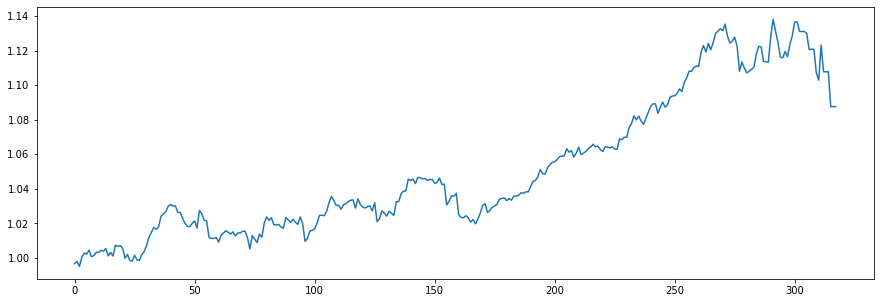

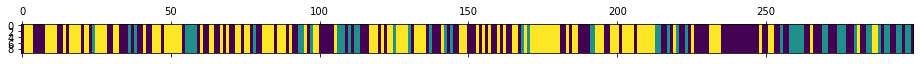

<Figure size 432x288 with 0 Axes>

N [[63. 22. 43.]
 [24. 20.  8.]
 [42.  9. 68.]]
alphas [[4.15685262 1.39446089 1.13247109]
 [3.36009498 2.19121854 1.13247109]
 [3.36009498 1.39446089 1.92922873]]
M [[13.  6.  5.]
 [ 8.  6.  5.]
 [ 9.  4.  8.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[12.  6.  5.]
 [ 8.  4.  5.]
 [ 9.  4.  4.]]
pi_z [[0.48373112 0.20717287 0.30909601]
 [0.45715237 0.36740317 0.17544446]
 [0.40746505 0.06955568 0.52297928]]
beta_vec [0.57889825 0.23901423 0.18208753]
hyper>> a_k: 7.820126994147937  gamma: 0.4538521782531841  rho: 0.19037091406278098


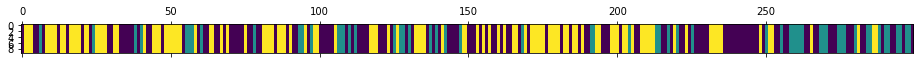

<Figure size 432x288 with 0 Axes>

819
N [[63. 24. 45.]
 [30. 20.  7.]
 [39. 13. 58.]]
alphas [[5.1539624  1.51329521 1.15286938]
 [3.66523768 3.00201993 1.15286938]
 [3.66523768 1.51329521 2.64159411]]
M [[17.  7.  6.]
 [ 8.  3.  2.]
 [ 8.  4.  8.]]
sum_w [[8.]
 [2.]
 [4.]]
barM [[9. 7. 6.]
 [8. 1. 2.]
 [8. 4. 4.]]
pi_z [[0.49274067 0.20254824 0.30471109]
 [0.48186906 0.31739348 0.20073746]
 [0.33447804 0.10229692 0.56322504]]
beta_vec [0.45989902 0.31917107 0.22092991]
hyper>> a_k: 6.131255741630192  gamma: 1.1493304723044797  rho: 0.1508568870787592


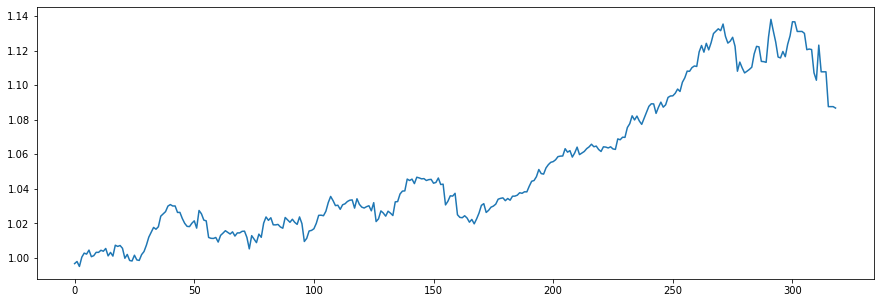

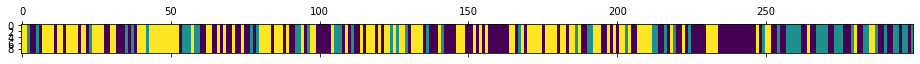

<Figure size 432x288 with 0 Axes>

N [[59. 23. 42.]
 [25. 20. 13.]
 [39. 16. 62.]]
alphas [[3.31932067 1.66170466 1.15023041]
 [2.39437852 2.58664682 1.15023041]
 [2.39437852 1.66170466 2.07517256]]
M [[9. 4. 3.]
 [7. 3. 2.]
 [5. 4. 7.]]
sum_w [[3.]
 [0.]
 [4.]]
barM [[6. 4. 3.]
 [7. 3. 2.]
 [5. 4. 3.]]
pi_z [[0.47883964 0.1662756  0.35488476]
 [0.40520927 0.37393974 0.22085099]
 [0.36208744 0.10927206 0.5286405 ]]
beta_vec [0.61042342 0.16701928 0.2225573 ]
hyper>> a_k: 5.240490257869482  gamma: 0.98988509265353  rho: 0.1716792068287934


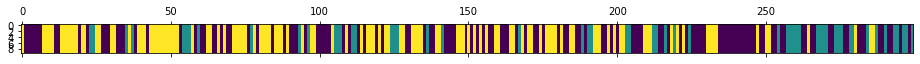

<Figure size 432x288 with 0 Axes>

820
N [[62. 20. 47.]
 [24. 23.  8.]
 [43. 12. 60.]]
alphas [[3.54941351 0.72499845 0.9660783 ]
 [2.6497303  1.62468166 0.9660783 ]
 [2.6497303  0.72499845 1.86576151]]
M [[7. 3. 3.]
 [8. 7. 3.]
 [4. 2. 5.]]
sum_w [[1.]
 [3.]
 [1.]]
barM [[6. 3. 3.]
 [8. 4. 3.]
 [4. 2. 4.]]
pi_z [[0.41490924 0.22535169 0.35973907]
 [0.44650647 0.43802575 0.11546778]
 [0.3585933  0.12732682 0.51407988]]
beta_vec [0.52367336 0.25475837 0.22156827]
hyper>> a_k: 4.816037477786777  gamma: 0.7047999602898857  rho: 0.1633768897813493


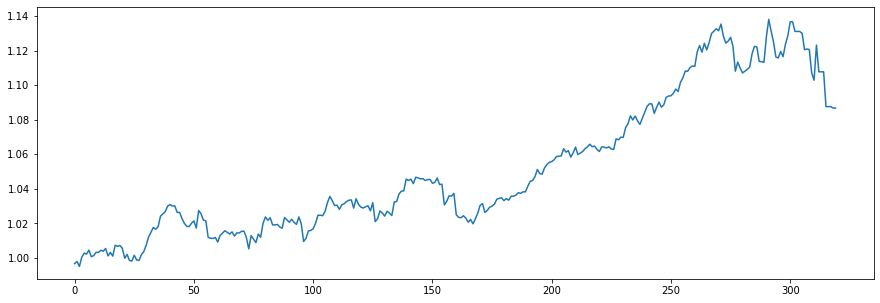

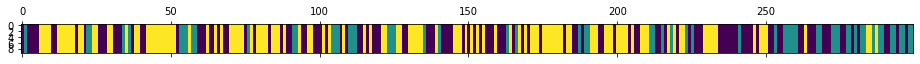

<Figure size 432x288 with 0 Axes>

N [[54. 23. 43.]
 [24. 25. 11.]
 [42. 12. 65.]]
alphas [[2.89681824 1.02647453 0.8927447 ]
 [2.10998902 1.81330376 0.8927447 ]
 [2.10998902 1.02647453 1.67957392]]
M [[11.  1.  4.]
 [ 3.  7.  2.]
 [ 6.  4.  7.]]
sum_w [[2.]
 [5.]
 [6.]]
barM [[9. 1. 4.]
 [3. 2. 2.]
 [6. 4. 1.]]
pi_z [[0.40216977 0.23133268 0.36649755]
 [0.34110626 0.4916042  0.16728955]
 [0.34875391 0.13420741 0.51703867]]
beta_vec [0.49501681 0.21151603 0.29346716]
hyper>> a_k: 4.359688588349884  gamma: 0.4618103923167011  rho: 0.29513900937133486


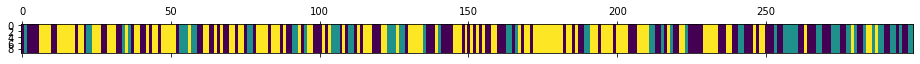

<Figure size 432x288 with 0 Axes>

821
N [[49. 23. 42.]
 [21. 28. 13.]
 [44. 11. 68.]]
alphas [[2.80788816 0.64998336 0.90181707]
 [1.52117399 1.93669753 0.90181707]
 [1.52117399 0.64998336 2.18853124]]
M [[ 9.  1.  3.]
 [ 2.  3.  4.]
 [11.  4.  8.]]
sum_w [[5.]
 [2.]
 [3.]]
barM [[ 4.  1.  3.]
 [ 2.  1.  4.]
 [11.  4.  5.]]
pi_z [[0.41506359 0.23303319 0.35190322]
 [0.25451441 0.26533092 0.48015467]
 [0.3901758  0.14442972 0.46539448]]
beta_vec [0.43561316 0.13459355 0.4297933 ]
hyper>> a_k: 2.7727707932254804  gamma: 0.42343283572875023  rho: 0.25006005133114767


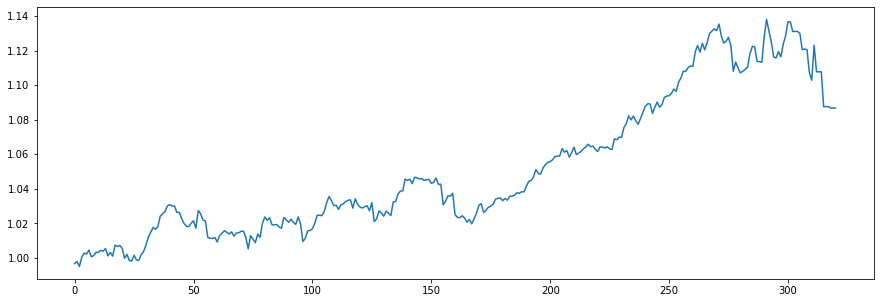

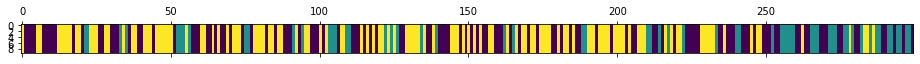

<Figure size 432x288 with 0 Axes>

N [[52. 20. 47.]
 [20. 23. 16.]
 [48. 15. 58.]]
alphas [[1.59917825 0.27987538 0.89371717]
 [0.90581904 0.97323458 0.89371717]
 [0.90581904 0.27987538 1.58707637]]
M [[8. 1. 5.]
 [2. 6. 3.]
 [4. 2. 6.]]
sum_w [[5.]
 [5.]
 [3.]]
barM [[3. 1. 5.]
 [2. 1. 3.]
 [4. 2. 3.]]
pi_z [[0.35346109 0.1540351  0.49250381]
 [0.33412844 0.34468023 0.32119133]
 [0.32683811 0.09354556 0.57961633]]
beta_vec [0.23968323 0.2064012  0.55391556]
hyper>> a_k: 3.147456418315776  gamma: 0.3305173754069823  rho: 0.3445074176028554


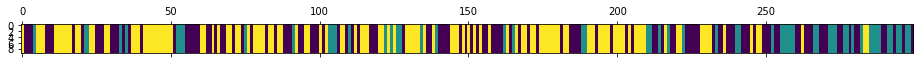

<Figure size 432x288 with 0 Axes>

822
N [[55. 23. 44.]
 [24. 23. 10.]
 [43. 11. 66.]]
alphas [[1.57882079 0.42583341 1.14280222]
 [0.49449871 1.51015549 1.14280222]
 [0.49449871 0.42583341 2.2271243 ]]
M [[5. 3. 2.]
 [1. 5. 6.]
 [2. 2. 9.]]
sum_w [[3.]
 [5.]
 [4.]]
barM [[2. 3. 2.]
 [1. 0. 6.]
 [2. 2. 5.]]
pi_z [[0.42382506 0.19764056 0.37853438]
 [0.42091234 0.35055275 0.22853491]
 [0.39904053 0.08981304 0.51114643]]
beta_vec [0.20130039 0.17174824 0.62695137]
hyper>> a_k: 3.2869202623419893  gamma: 0.6195068749839505  rho: 0.3142319732057505


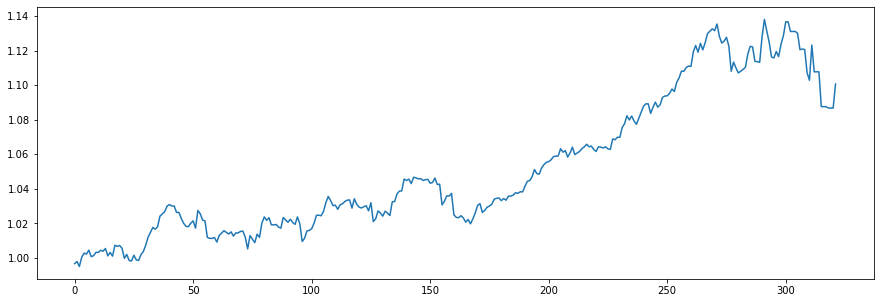

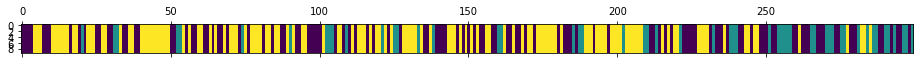

<Figure size 432x288 with 0 Axes>

N [[50. 20. 49.]
 [20. 21. 11.]
 [48. 12. 68.]]
alphas [[1.48659956 0.38713167 1.41318903]
 [0.45374412 1.41998711 1.41318903]
 [0.45374412 0.38713167 2.44604447]]
M [[4. 2. 3.]
 [3. 4. 3.]
 [2. 1. 8.]]
sum_w [[1.]
 [3.]
 [4.]]
barM [[3. 2. 3.]
 [3. 1. 3.]
 [2. 1. 4.]]
pi_z [[0.41744247 0.16802774 0.41452979]
 [0.33840885 0.50735181 0.15423934]
 [0.39767484 0.06904651 0.53327865]]
beta_vec [0.23675117 0.26968218 0.49356665]
hyper>> a_k: 3.3405107615637104  gamma: 1.6135070129472124  rho: 0.275960603370439


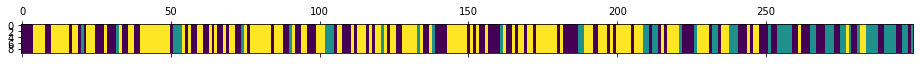

<Figure size 432x288 with 0 Axes>

823
N [[51. 17. 46.]
 [19. 25.  9.]
 [44. 11. 77.]]
alphas [[1.49447028 0.65226988 1.19377061]
 [0.57262091 1.57411924 1.19377061]
 [0.57262091 0.65226988 2.11561998]]
M [[6. 2. 6.]
 [1. 5. 2.]
 [3. 3. 7.]]
sum_w [[5.]
 [2.]
 [1.]]
barM [[1. 2. 6.]
 [1. 3. 2.]
 [3. 3. 6.]]
pi_z [[0.40876654 0.18432146 0.406912  ]
 [0.43394021 0.47310599 0.0929538 ]
 [0.36728624 0.11781757 0.51489619]]
beta_vec [0.18420664 0.38757265 0.42822071]
hyper>> a_k: 3.20722646295683  gamma: 0.4769788509381849  rho: 0.24068393719991543


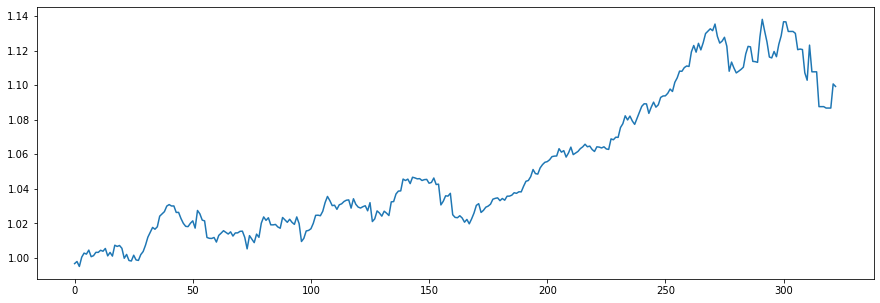

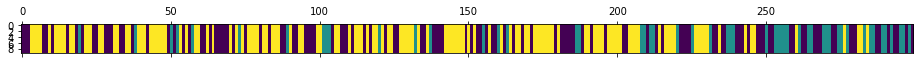

<Figure size 432x288 with 0 Axes>

N [[51. 21. 46.]
 [22. 18. 12.]
 [46. 12. 71.]]
alphas [[1.22052607 0.94385512 1.04284527]
 [0.44859818 1.71578301 1.04284527]
 [0.44859818 0.94385512 1.81477317]]
M [[3. 5. 3.]
 [2. 8. 2.]
 [2. 4. 4.]]
sum_w [[1.]
 [5.]
 [2.]]
barM [[2. 5. 3.]
 [2. 3. 2.]
 [2. 4. 2.]]
pi_z [[0.46428821 0.13780471 0.39790708]
 [0.43109679 0.31260523 0.25629798]
 [0.31809278 0.12638256 0.55552466]]
beta_vec [0.23946243 0.45671782 0.30381975]
hyper>> a_k: 3.0355594837436555  gamma: 0.49338851503311015  rho: 0.14403388266599107


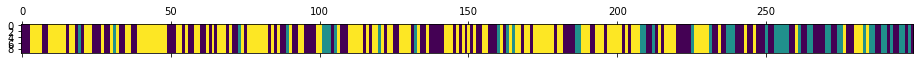

<Figure size 432x288 with 0 Axes>

824
N [[56. 16. 50.]
 [20. 16.  9.]
 [46. 13. 73.]]
alphas [[1.05942729 1.18670638 0.78942581]
 [0.62220387 1.6239298  0.78942581]
 [0.62220387 1.18670638 1.22664923]]
M [[3. 4. 3.]
 [2. 3. 2.]
 [4. 5. 4.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[2. 4. 3.]
 [2. 3. 2.]
 [4. 5. 4.]]
pi_z [[0.51221405 0.09839841 0.38938754]
 [0.47093823 0.36543724 0.16362453]
 [0.33097253 0.09031668 0.57871079]]
beta_vec [0.19258126 0.45661851 0.35080024]
hyper>> a_k: 3.023547901301641  gamma: 0.35172878029640275  rho: 0.08674581111270357


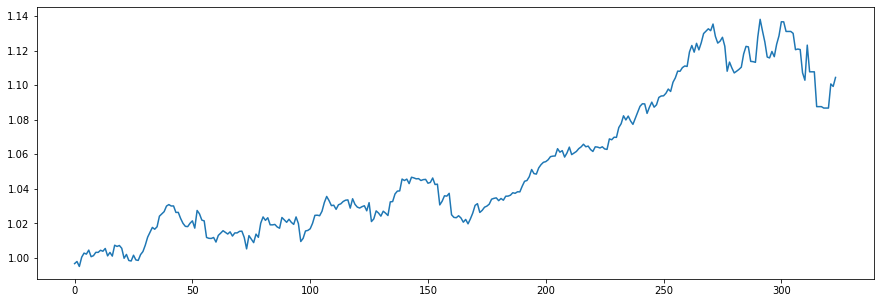

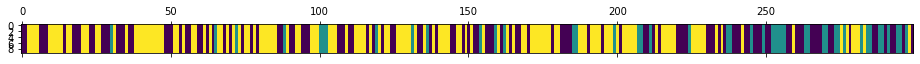

<Figure size 432x288 with 0 Axes>

N [[54. 13. 51.]
 [21. 15.  9.]
 [44. 17. 75.]]
alphas [[0.79404853 1.26084598 0.96865339]
 [0.53176842 1.52312609 0.96865339]
 [0.53176842 1.26084598 1.23093351]]
M [[4. 2. 6.]
 [3. 2. 4.]
 [2. 3. 7.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[2. 2. 6.]
 [3. 2. 4.]
 [2. 3. 4.]]
pi_z [[0.51055343 0.09484714 0.39459943]
 [0.41725301 0.41355781 0.16918919]
 [0.28152793 0.15567282 0.56279925]]
beta_vec [0.37301628 0.20081256 0.42617116]
hyper>> a_k: 3.0517868875182503  gamma: 0.7843202657960792  rho: 0.18620450795180685


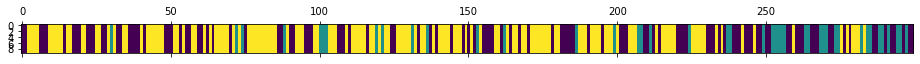

<Figure size 432x288 with 0 Axes>

825
N [[53. 14. 48.]
 [16. 15. 12.]
 [46. 14. 81.]]
alphas [[1.49465375 0.4987241  1.05840904]
 [0.92639728 1.06698057 1.05840904]
 [0.92639728 0.4987241  1.62666551]]
M [[8. 3. 5.]
 [3. 4. 3.]
 [2. 1. 7.]]
sum_w [[4.]
 [3.]
 [1.]]
barM [[4. 3. 5.]
 [3. 1. 3.]
 [2. 1. 6.]]
pi_z [[0.41473035 0.1259259  0.45934375]
 [0.35288292 0.43013533 0.21698175]
 [0.34120385 0.07485982 0.58393633]]
beta_vec [0.20788132 0.21245469 0.57966399]
hyper>> a_k: 3.5831524800294066  gamma: 0.6295951866637134  rho: 0.33846190338615884


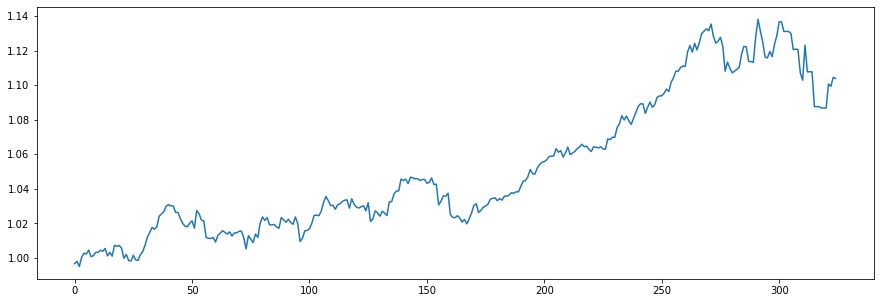

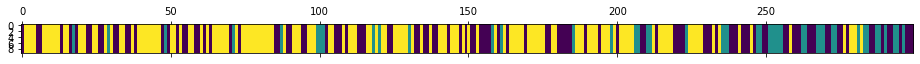

<Figure size 432x288 with 0 Axes>

N [[49. 15. 47.]
 [18. 18. 10.]
 [44. 13. 85.]]
alphas [[1.70552081 0.50360086 1.3740308 ]
 [0.4927602  1.71636147 1.3740308 ]
 [0.4927602  0.50360086 2.58679141]]
M [[6. 2. 5.]
 [1. 4. 3.]
 [3. 2. 6.]]
sum_w [[5.]
 [1.]
 [5.]]
barM [[1. 2. 5.]
 [1. 3. 3.]
 [3. 2. 1.]]
pi_z [[0.52558323 0.11756782 0.35684895]
 [0.41869672 0.28250228 0.298801  ]
 [0.38361957 0.0564187  0.55996173]]
beta_vec [0.20916743 0.37558754 0.41524503]
hyper>> a_k: 2.6469122987112788  gamma: 0.9875800127504949  rho: 0.42454768495997336


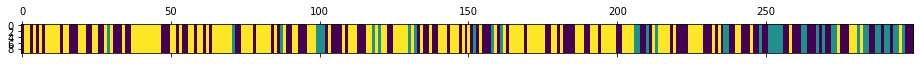

<Figure size 432x288 with 0 Axes>

826
N [[52. 16. 49.]
 [15. 14. 12.]
 [50. 11. 80.]]
alphas [[1.44233842 0.57208435 0.63248953]
 [0.31859793 1.69582484 0.63248953]
 [0.31859793 0.57208435 1.75623001]]
M [[6. 3. 2.]
 [3. 2. 3.]
 [2. 1. 3.]]
sum_w [[4.]
 [1.]
 [2.]]
barM [[2. 3. 2.]
 [3. 1. 3.]
 [2. 1. 1.]]
pi_z [[0.45859444 0.10951435 0.43189121]
 [0.36857354 0.42285431 0.20857214]
 [0.38217474 0.06102788 0.55679738]]
beta_vec [0.38757734 0.26661412 0.34580854]
hyper>> a_k: 1.5777508574589936  gamma: 0.37304629056789557  rho: 0.2538620213107071


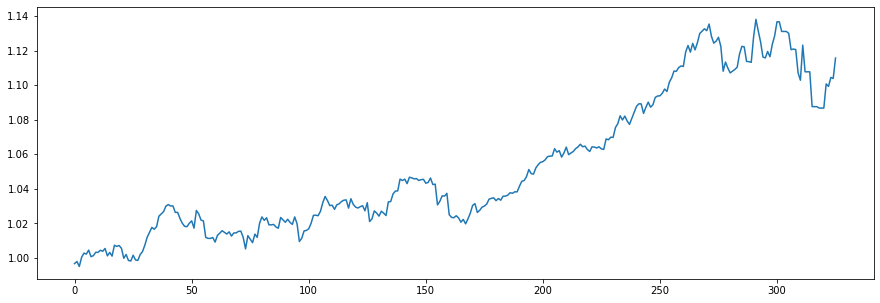

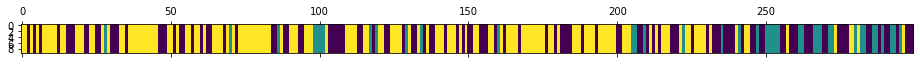

<Figure size 432x288 with 0 Axes>

N [[51. 14. 50.]
 [15. 15. 10.]
 [49. 11. 84.]]
alphas [[0.85679475 0.31386343 0.40709268]
 [0.45626373 0.71439445 0.40709268]
 [0.45626373 0.31386343 0.8076237 ]]
M [[5. 2. 1.]
 [3. 3. 1.]
 [5. 2. 6.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[4. 2. 1.]
 [3. 1. 1.]
 [5. 2. 3.]]
pi_z [[0.4982323  0.09598845 0.40577925]
 [0.32032547 0.42543073 0.2542438 ]
 [0.34663844 0.09218152 0.56118003]]
beta_vec [0.76287223 0.10721566 0.12991211]
hyper>> a_k: 2.598750728245779  gamma: 0.5320594568358157  rho: 0.3857788209774246


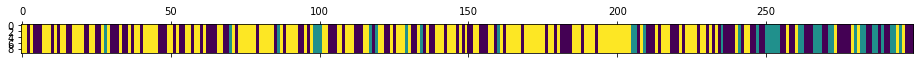

<Figure size 432x288 with 0 Axes>

827
N [[51. 13. 55.]
 [12. 14. 12.]
 [56. 11. 75.]]
alphas [[2.22024554 0.17113847 0.20736672]
 [1.21770255 1.17368146 0.20736672]
 [1.21770255 0.17113847 1.20990971]]
M [[11.  1.  3.]
 [ 2.  3.  1.]
 [ 3.  1.  4.]]
sum_w [[7.]
 [3.]
 [2.]]
barM [[4. 1. 3.]
 [2. 0. 1.]
 [3. 1. 2.]]
pi_z [[0.51850174 0.10478079 0.37671747]
 [0.32037529 0.43920695 0.24041776]
 [0.42946445 0.04955131 0.52098424]]
beta_vec [0.45153447 0.04706223 0.5014033 ]
hyper>> a_k: 2.2135646558383364  gamma: 0.5158840015326707  rho: 0.38067424666134525


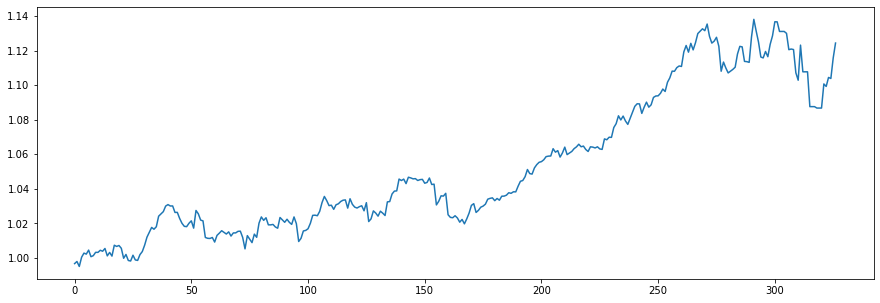

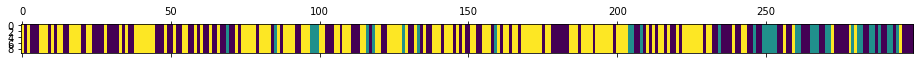

<Figure size 432x288 with 0 Axes>

N [[57. 14. 55.]
 [14. 14.  8.]
 [55.  8. 74.]]
alphas [[1.46166361 0.06451844 0.6873826 ]
 [0.61901655 0.9071655  0.6873826 ]
 [0.61901655 0.06451844 1.53002966]]
M [[6. 1. 3.]
 [2. 4. 1.]
 [3. 1. 7.]]
sum_w [[2.]
 [4.]
 [3.]]
barM [[4. 1. 3.]
 [2. 0. 1.]
 [3. 1. 4.]]
pi_z [[0.47978749 0.0762383  0.44397421]
 [0.41131025 0.42369719 0.16499256]
 [0.39018703 0.05559791 0.55421506]]
beta_vec [0.39800596 0.20892224 0.39307179]
hyper>> a_k: 3.0170807576201715  gamma: 1.0501271166790878  rho: 0.530878481747901


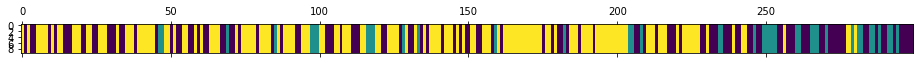

<Figure size 432x288 with 0 Axes>

828
N [[52. 16. 48.]
 [17. 17.  6.]
 [47.  7. 89.]]
alphas [[2.16503194 0.29570384 0.55634497]
 [0.56332869 1.8974071  0.55634497]
 [0.56332869 0.29570384 2.15804822]]
M [[ 8.  1.  3.]
 [ 3.  7.  4.]
 [ 3.  2. 12.]]
sum_w [[ 4.]
 [ 7.]
 [10.]]
barM [[4. 1. 3.]
 [3. 0. 4.]
 [3. 2. 2.]]
pi_z [[0.42069237 0.12029979 0.45900784]
 [0.3801437  0.54849962 0.07135668]
 [0.29313997 0.0455206  0.66133943]]
beta_vec [0.59919677 0.09018093 0.3106223 ]
hyper>> a_k: 4.251481177329637  gamma: 0.34087659951463156  rho: 0.466640001580798


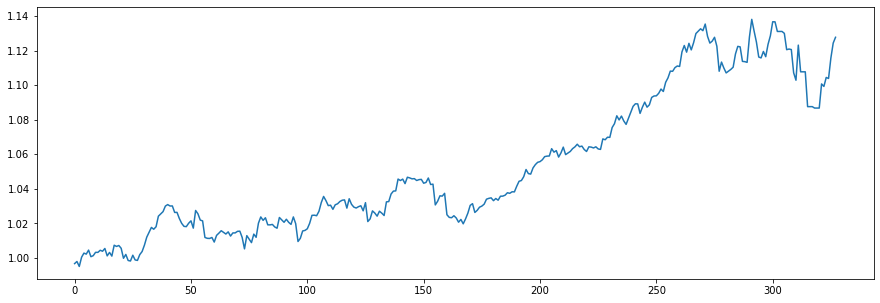

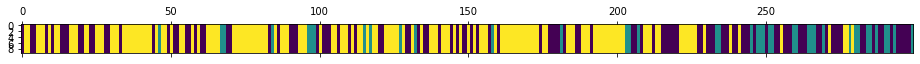

<Figure size 432x288 with 0 Axes>

N [[51. 19. 44.]
 [15. 14. 10.]
 [47.  7. 92.]]
alphas [[3.3426318  0.20449157 0.7043578 ]
 [1.35872062 2.18840275 0.7043578 ]
 [1.35872062 0.20449157 2.68826899]]
M [[13.  1.  5.]
 [ 5.  4.  2.]
 [ 6.  2. 11.]]
sum_w [[8.]
 [4.]
 [7.]]
barM [[5. 1. 5.]
 [5. 0. 2.]
 [6. 2. 4.]]
pi_z [[0.48149795 0.18619142 0.33231064]
 [0.48688762 0.27194779 0.2411646 ]
 [0.29230681 0.05049898 0.65719421]]
beta_vec [0.64028524 0.02406557 0.33564919]
hyper>> a_k: 3.426385858654408  gamma: 1.3077656698808995  rho: 0.3516051408639037


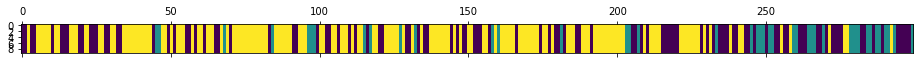

<Figure size 432x288 with 0 Axes>

829
N [[44. 18. 44.]
 [16. 16. 10.]
 [46.  8. 97.]]
alphas [[2.62722521 0.05346531 0.74569534]
 [1.42249032 1.25820019 0.74569534]
 [1.42249032 0.05346531 1.95043023]]
M [[8. 1. 1.]
 [3. 6. 3.]
 [6. 1. 7.]]
sum_w [[2.]
 [6.]
 [2.]]
barM [[6. 1. 1.]
 [3. 0. 3.]
 [6. 1. 5.]]
pi_z [[0.42134266 0.21781334 0.36084399]
 [0.40359326 0.39077884 0.2056279 ]
 [0.28838185 0.03387068 0.67774748]]
beta_vec [0.30375882 0.17878367 0.51745751]
hyper>> a_k: 3.147273473713257  gamma: 0.9823261829584894  rho: 0.2679358001549181


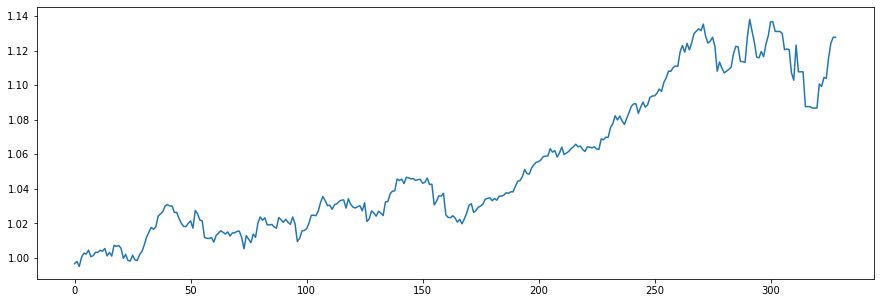

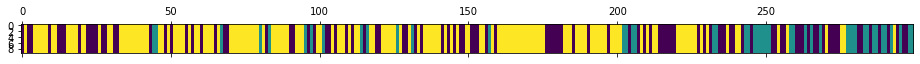

<Figure size 432x288 with 0 Axes>

N [[39. 21. 44.]
 [18. 17. 10.]
 [47.  7. 96.]]
alphas [[1.54312946 0.41191868 1.19222533]
 [0.69986222 1.25518592 1.19222533]
 [0.69986222 0.41191868 2.03549257]]
M [[4. 4. 6.]
 [5. 5. 2.]
 [4. 2. 9.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[1. 4. 6.]
 [5. 2. 2.]
 [4. 2. 5.]]
pi_z [[0.41848247 0.15597956 0.42553797]
 [0.47883769 0.36876214 0.15240017]
 [0.29349139 0.03030892 0.67619969]]
beta_vec [0.45116633 0.24021333 0.30862035]
hyper>> a_k: 4.400632131666806  gamma: 2.44078107287306  rho: 0.35215141865013855


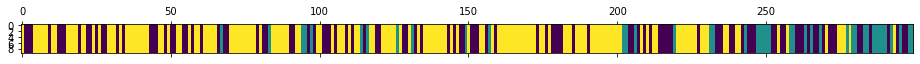

<Figure size 432x288 with 0 Axes>

830
N [[42. 19. 45.]
 [18. 15.  9.]
 [46.  8. 97.]]
alphas [[2.83593846 0.68483457 0.8798591 ]
 [1.28624961 2.23452342 0.8798591 ]
 [1.28624961 0.68483457 2.42954795]]
M [[7. 4. 5.]
 [5. 6. 5.]
 [3. 2. 8.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[4. 4. 5.]
 [5. 3. 5.]
 [3. 2. 3.]]
pi_z [[0.44439305 0.15319824 0.40240871]
 [0.3513164  0.44962507 0.19905853]
 [0.26564851 0.07072744 0.66362405]]
beta_vec [0.48342941 0.18024261 0.33632798]
hyper>> a_k: 3.533665803382726  gamma: 0.5511991167798064  rho: 0.32320427813316904


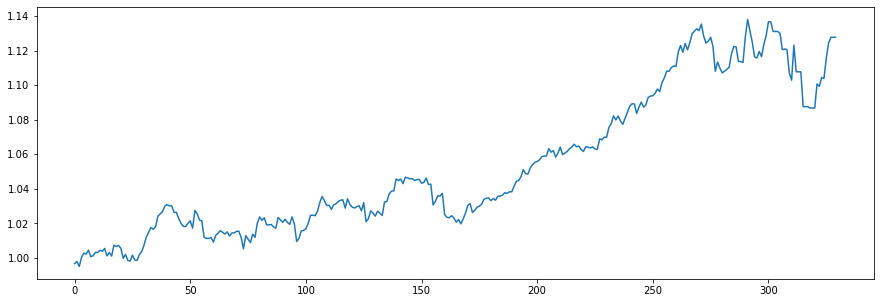

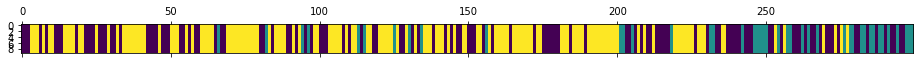

<Figure size 432x288 with 0 Axes>

N [[54. 22. 44.]
 [20. 12.  9.]
 [46.  7. 85.]]
alphas [[2.29825113 0.4310628  0.80435187]
 [1.15615522 1.57315871 0.80435187]
 [1.15615522 0.4310628  1.94644778]]
M [[ 7.  1.  4.]
 [ 3.  4.  1.]
 [ 6.  1. 10.]]
sum_w [[3.]
 [4.]
 [6.]]
barM [[4. 1. 4.]
 [3. 0. 1.]
 [6. 1. 4.]]
pi_z [[0.46774843 0.14117347 0.3910781 ]
 [0.47068108 0.28488543 0.24443349]
 [0.31316676 0.0385892  0.64824404]]
beta_vec [0.5656596  0.15473644 0.27960396]
hyper>> a_k: 2.7552592449305924  gamma: 0.9134503575398614  rho: 0.4544696777047334


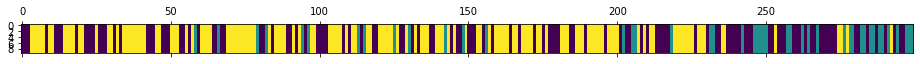

<Figure size 432x288 with 0 Axes>

831
N [[55. 20. 44.]
 [22. 13.  9.]
 [42. 11. 83.]]
alphas [[2.10241198 0.23258086 0.4202664 ]
 [0.8502302  1.48476264 0.4202664 ]
 [0.8502302  0.23258086 1.67244819]]
M [[10.  2.  3.]
 [ 4.  6.  1.]
 [ 3.  2.  5.]]
sum_w [[9.]
 [4.]
 [4.]]
barM [[1. 2. 3.]
 [4. 2. 1.]
 [3. 2. 1.]]
pi_z [[0.45430435 0.12853445 0.4171612 ]
 [0.3967134  0.36000733 0.24327928]
 [0.33112507 0.09960284 0.56927209]]
beta_vec [0.36017133 0.31666504 0.32316363]
hyper>> a_k: 3.0980732401779023  gamma: 0.1039476059907733  rho: 0.28494417522946935


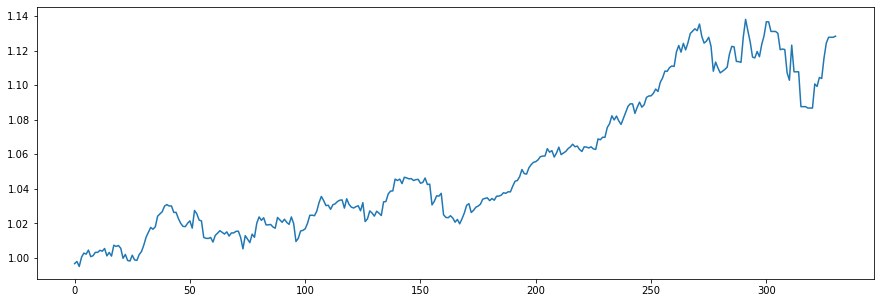

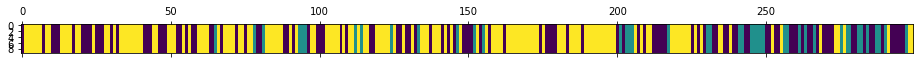

<Figure size 432x288 with 0 Axes>

N [[49. 14. 50.]
 [20. 14.  8.]
 [44. 14. 86.]]
alphas [[1.68066379 0.70150658 0.71590287]
 [0.79788586 1.58428451 0.71590287]
 [0.79788586 0.70150658 1.59868079]]
M [[5. 3. 4.]
 [2. 5. 3.]
 [5. 5. 7.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[3. 3. 4.]
 [2. 3. 3.]
 [5. 5. 2.]]
pi_z [[0.45007007 0.15927018 0.39065974]
 [0.46495555 0.32145641 0.21358804]
 [0.3142899  0.08628808 0.59942203]]
beta_vec [0.23032118 0.51264056 0.25703826]
hyper>> a_k: 2.4622533432943703  gamma: 0.6723958491374176  rho: 0.1427712421662319


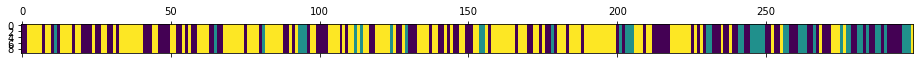

<Figure size 432x288 with 0 Axes>

832
N [[51. 17. 45.]
 [16. 19.  9.]
 [46.  8. 88.]]
alphas [[0.83768119 1.0820378  0.54253435]
 [0.48614223 1.43357677 0.54253435]
 [0.48614223 1.0820378  0.89407332]]
M [[3. 3. 6.]
 [2. 4. 4.]
 [3. 2. 2.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[2. 3. 6.]
 [2. 4. 4.]
 [3. 2. 1.]]
pi_z [[0.42283533 0.14508895 0.43207572]
 [0.40856206 0.44831196 0.14312598]
 [0.31298402 0.07054165 0.61647433]]
beta_vec [0.3920718  0.36021716 0.24771105]
hyper>> a_k: 3.4854799350776995  gamma: 1.662903300550813  rho: 0.10817689830221529


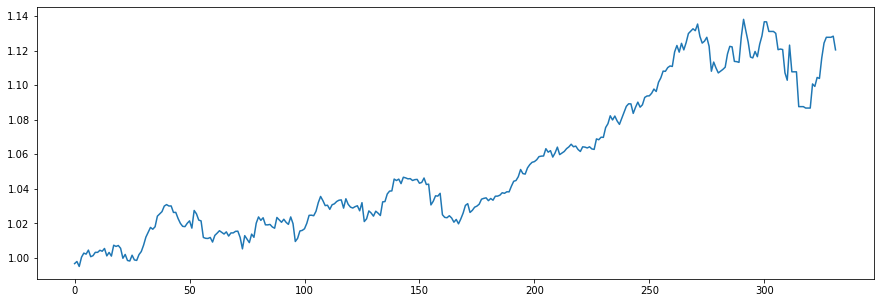

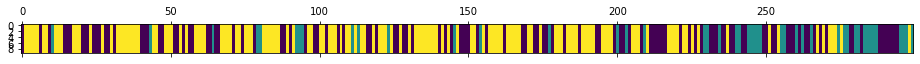

<Figure size 432x288 with 0 Axes>

N [[49. 17. 51.]
 [20. 18.  7.]
 [48. 11. 78.]]
alphas [[1.59577674 1.11971036 0.76999283]
 [1.21872833 1.49675877 0.76999283]
 [1.21872833 1.11971036 1.14704124]]
M [[4. 5. 2.]
 [5. 7. 1.]
 [4. 4. 2.]]
sum_w [[0.]
 [3.]
 [0.]]
barM [[4. 5. 2.]
 [5. 4. 1.]
 [4. 4. 2.]]
pi_z [[0.5091956  0.10935731 0.38144709]
 [0.39694261 0.40867991 0.19437748]
 [0.31274924 0.06403322 0.62321754]]
beta_vec [0.35829276 0.48871171 0.15299554]
hyper>> a_k: 2.470467184213273  gamma: 0.4518576773759715  rho: 0.11911258983807459


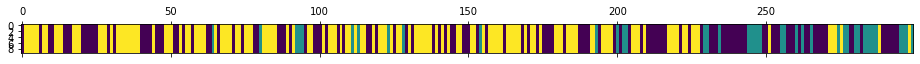

<Figure size 432x288 with 0 Axes>

833
N [[62. 14. 48.]
 [15. 17.  9.]
 [47. 10. 77.]]
alphas [[1.07398167 1.0635361  0.33294941]
 [0.77971793 1.35779984 0.33294941]
 [0.77971793 1.0635361  0.62721316]]
M [[6. 3. 2.]
 [2. 4. 1.]
 [3. 2. 3.]]
sum_w [[3.]
 [0.]
 [1.]]
barM [[3. 3. 2.]
 [2. 4. 1.]
 [3. 2. 2.]]
pi_z [[0.54860553 0.07323084 0.37816364]
 [0.31945962 0.4274854  0.25305498]
 [0.34506585 0.07857951 0.57635464]]
beta_vec [0.3466     0.33994468 0.31345532]
hyper>> a_k: 1.3902449406192843  gamma: 1.187325801883274  rho: 0.1668312040021117


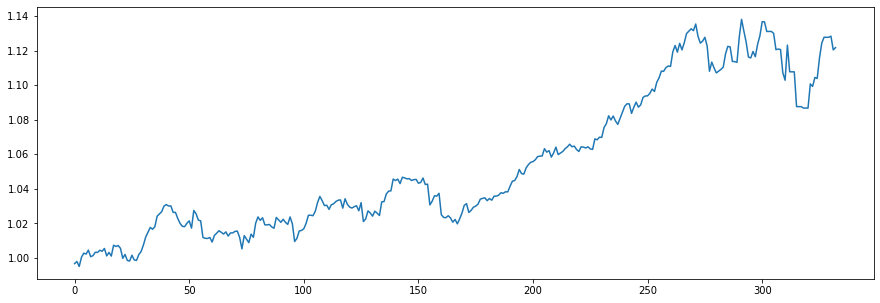

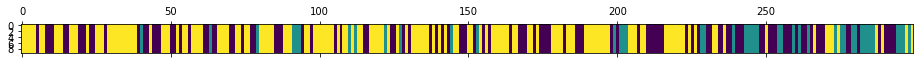

<Figure size 432x288 with 0 Axes>

N [[49. 14. 48.]
 [17. 18.  8.]
 [45. 10. 90.]]
alphas [[0.63340603 0.39376088 0.36307803]
 [0.4014698  0.62569712 0.36307803]
 [0.4014698  0.39376088 0.59501426]]
M [[3. 3. 2.]
 [4. 4. 3.]
 [3. 2. 4.]]
sum_w [[0.]
 [0.]
 [3.]]
barM [[3. 3. 2.]
 [4. 4. 3.]
 [3. 2. 1.]]
pi_z [[0.42460654 0.20052091 0.37487256]
 [0.33926412 0.54449787 0.11623801]
 [0.27697146 0.09487667 0.62815187]]
beta_vec [0.27809994 0.46293795 0.2589621 ]
hyper>> a_k: 1.7982660943125264  gamma: 0.42816005793092776  rho: 0.29089634914728674


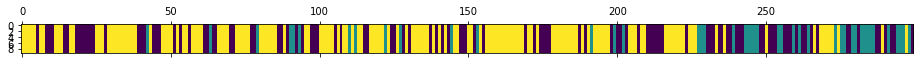

<Figure size 432x288 with 0 Axes>

834
N [[48. 18. 42.]
 [19. 16.  9.]
 [41. 10. 96.]]
alphas [[0.87773015 0.5903186  0.33021735]
 [0.3546211  1.11342764 0.33021735]
 [0.3546211  0.5903186  0.85332639]]
M [[5. 3. 4.]
 [2. 2. 1.]
 [3. 2. 6.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[2. 3. 4.]
 [2. 1. 1.]
 [3. 2. 2.]]
pi_z [[0.43501204 0.18406647 0.38092149]
 [0.27554588 0.44551685 0.27893727]
 [0.28722627 0.0543853  0.65838842]]
beta_vec [0.43679965 0.33411338 0.22908697]
hyper>> a_k: 1.5631046615312256  gamma: 0.5163451115383723  rho: 0.1679788455740429


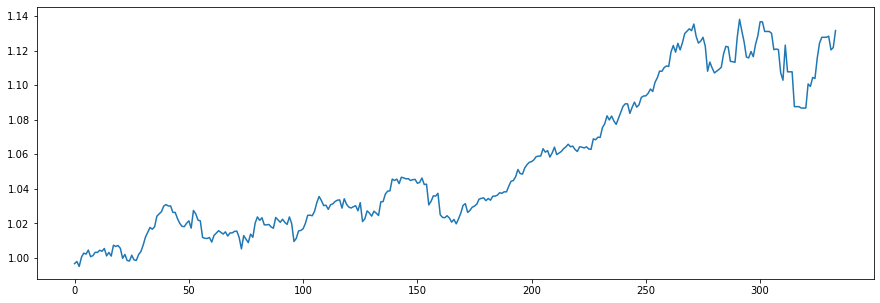

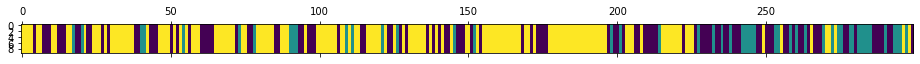

<Figure size 432x288 with 0 Axes>

N [[51. 18. 37.]
 [22. 16. 11.]
 [34. 15. 95.]]
alphas [[0.83064225 0.43452653 0.29793589]
 [0.56807373 0.69709505 0.29793589]
 [0.56807373 0.43452653 0.5605044 ]]
M [[5. 2. 3.]
 [1. 2. 1.]
 [3. 3. 2.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[3. 2. 3.]
 [1. 2. 1.]
 [3. 3. 2.]]
pi_z [[0.39482393 0.22040131 0.38477476]
 [0.54286253 0.23366918 0.2234683 ]
 [0.22690479 0.12723215 0.64586307]]
beta_vec [0.42913336 0.27745442 0.29341222]
hyper>> a_k: 1.5382550832229582  gamma: 1.230096879395912  rho: 0.14257884615399655


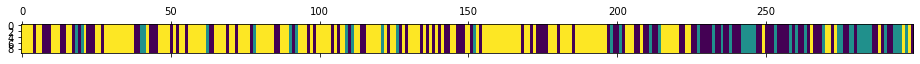

<Figure size 432x288 with 0 Axes>

835
N [[42. 21. 45.]
 [25. 13.  7.]
 [41. 11. 94.]]
alphas [[0.78532055 0.36594364 0.38699089]
 [0.56599791 0.58526628 0.38699089]
 [0.56599791 0.36594364 0.60631353]]
M [[3. 4. 1.]
 [4. 2. 1.]
 [4. 3. 5.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[3. 4. 1.]
 [4. 2. 1.]
 [4. 3. 5.]]
pi_z [[0.40150891 0.25239832 0.34609277]
 [0.45646607 0.35135639 0.19217754]
 [0.28369048 0.08980309 0.62650643]]
beta_vec [0.38743403 0.303844   0.30872197]
hyper>> a_k: 2.5596781546048217  gamma: 0.5973486461638664  rho: 0.016245100790267735


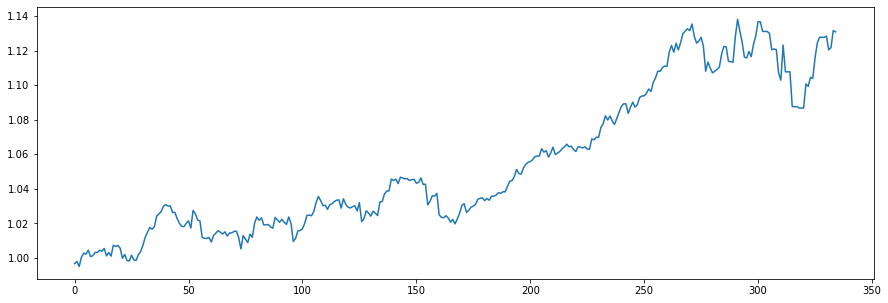

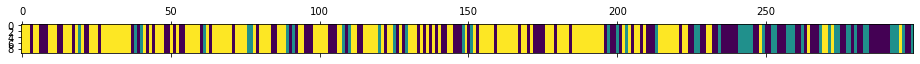

<Figure size 432x288 with 0 Axes>

N [[45. 19. 44.]
 [22. 14. 11.]
 [40. 15. 89.]]
alphas [[1.01717829 0.76510834 0.77739152]
 [0.97559606 0.80669057 0.77739152]
 [0.97559606 0.76510834 0.81897375]]
M [[5. 2. 2.]
 [1. 1. 2.]
 [4. 1. 7.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[5. 2. 2.]
 [1. 1. 2.]
 [4. 1. 7.]]
pi_z [[0.38611113 0.25159404 0.36229483]
 [0.39562035 0.34756575 0.25681391]
 [0.3085058  0.07797952 0.61351469]]
beta_vec [0.34669888 0.14259237 0.51070874]
hyper>> a_k: 1.35114001567525  gamma: 0.4343154453067451  rho: 0.09846006625462153


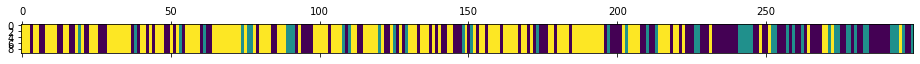

<Figure size 432x288 with 0 Axes>

836
N [[53. 20. 41.]
 [20. 14. 13.]
 [41. 13. 84.]]
alphas [[0.55534956 0.17369272 0.62209773]
 [0.42231623 0.30672606 0.62209773]
 [0.42231623 0.17369272 0.75513107]]
M [[5. 2. 4.]
 [1. 2. 2.]
 [5. 1. 2.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[5. 2. 4.]
 [1. 1. 2.]
 [5. 1. 2.]]
pi_z [[0.38824358 0.18367629 0.42808012]
 [0.53612809 0.28199559 0.18187632]
 [0.27534399 0.08378504 0.64087098]]
beta_vec [0.52968226 0.16277928 0.30753846]
hyper>> a_k: 2.2146767470813313  gamma: 0.5504390265549417  rho: 0.11278900975907248


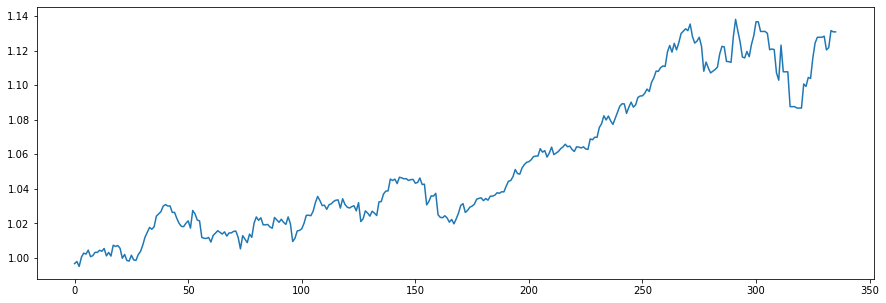

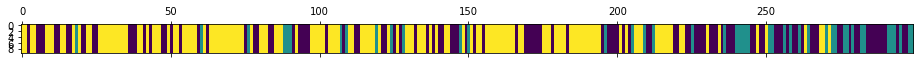

<Figure size 432x288 with 0 Axes>

N [[53. 19. 42.]
 [21. 12. 10.]
 [40. 12. 90.]]
alphas [[1.29055622 0.31984265 0.60427788]
 [1.04076503 0.56963384 0.60427788]
 [1.04076503 0.31984265 0.85406907]]
M [[7. 2. 2.]
 [3. 4. 2.]
 [3. 2. 6.]]
sum_w [[7.]
 [3.]
 [2.]]
barM [[0. 2. 2.]
 [3. 1. 2.]
 [3. 2. 4.]]
pi_z [[0.51564475 0.21437253 0.26998272]
 [0.50342152 0.20243794 0.29414054]
 [0.26773831 0.07787481 0.65438688]]
beta_vec [0.25101291 0.5662212  0.1827659 ]
hyper>> a_k: 2.5860627533562917  gamma: 0.7547389702400756  rho: 0.5188378441975671


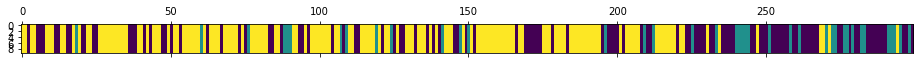

<Figure size 432x288 with 0 Axes>

837
N [[55. 15. 43.]
 [20. 11.  8.]
 [38. 13. 96.]]
alphas [[1.65408648 0.70455783 0.22741844]
 [0.31233926 2.04630505 0.22741844]
 [0.31233926 0.70455783 1.56916567]]
M [[9. 1. 1.]
 [3. 3. 1.]
 [3. 1. 6.]]
sum_w [[9.]
 [2.]
 [4.]]
barM [[0. 1. 1.]
 [3. 1. 1.]
 [3. 1. 2.]]
pi_z [[0.45955579 0.15647191 0.38397231]
 [0.48494999 0.40699775 0.10805226]
 [0.27582764 0.08658389 0.63758847]]
beta_vec [0.43366026 0.10082883 0.46551092]
hyper>> a_k: 2.5491792134235487  gamma: 0.7038734757816905  rho: 0.6892010105404055


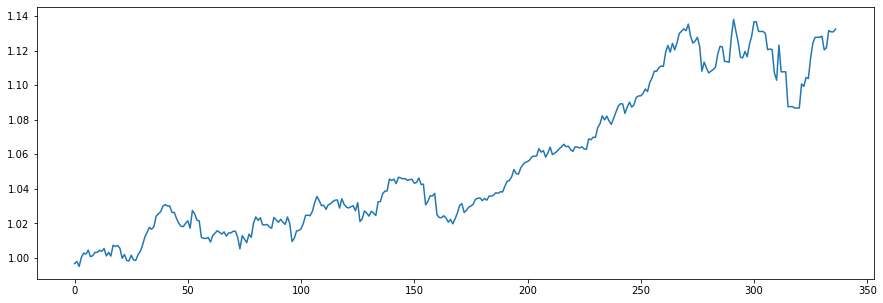

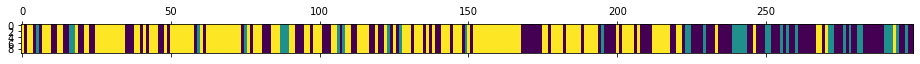

<Figure size 432x288 with 0 Axes>

N [[60. 17. 43.]
 [20. 13.  5.]
 [40.  8. 93.]]
alphas [[2.10047825 0.0798849  0.36881607]
 [0.34358136 1.83678179 0.36881607]
 [0.34358136 0.0798849  2.12571296]]
M [[11.  1.  1.]
 [ 2.  5.  2.]
 [ 2.  1.  6.]]
sum_w [[9.]
 [5.]
 [3.]]
barM [[2. 1. 1.]
 [2. 0. 2.]
 [2. 1. 3.]]
pi_z [[0.57717881 0.13423097 0.28859022]
 [0.40768311 0.45984391 0.13247298]
 [0.29902488 0.07848078 0.62249434]]
beta_vec [0.2321454  0.09534156 0.67251304]
hyper>> a_k: 2.067140156592333  gamma: 1.0308568809887322  rho: 0.6799332142637455


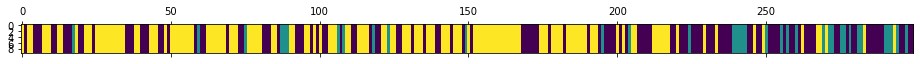

<Figure size 432x288 with 0 Axes>

838
N [[65. 15. 42.]
 [19. 11.  6.]
 [38. 10. 93.]]
alphas [[1.55910996 0.06308016 0.44495003]
 [0.15359271 1.46859741 0.44495003]
 [0.15359271 0.06308016 1.85046728]]
M [[6. 1. 4.]
 [1. 4. 2.]
 [3. 1. 4.]]
sum_w [[6.]
 [4.]
 [3.]]
barM [[0. 1. 4.]
 [1. 0. 2.]
 [3. 1. 1.]]
pi_z [[0.49204544 0.14841854 0.35953602]
 [0.54310058 0.29790669 0.15899273]
 [0.24114055 0.05689539 0.70196406]]
beta_vec [0.44209061 0.15303167 0.40487772]
hyper>> a_k: 2.839936362394306  gamma: 0.3907516782820642  rho: 0.4596509354841479


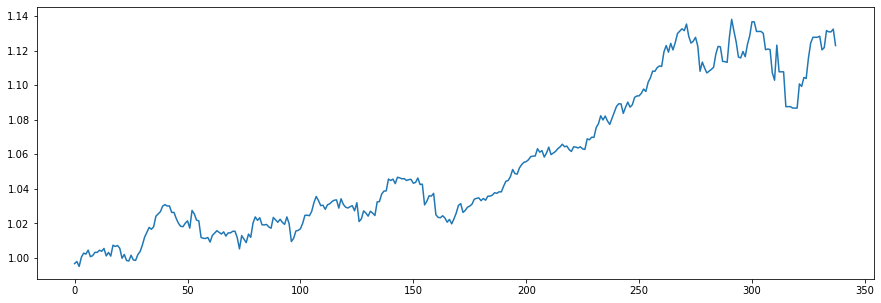

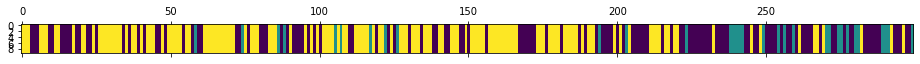

<Figure size 432x288 with 0 Axes>

N [[64. 14. 50.]
 [15.  9.  7.]
 [48.  9. 83.]]
alphas [[1.98379263 0.23483581 0.62130792]
 [0.67841322 1.54021521 0.62130792]
 [0.67841322 0.23483581 1.92668733]]
M [[7. 2. 5.]
 [5. 3. 2.]
 [3. 2. 8.]]
sum_w [[5.]
 [3.]
 [8.]]
barM [[2. 2. 5.]
 [5. 0. 2.]
 [3. 2. 0.]]
pi_z [[0.56835548 0.14736909 0.28427543]
 [0.36028131 0.44019232 0.19952636]
 [0.37834084 0.09048117 0.53117799]]
beta_vec [0.58298757 0.21604732 0.20096511]
hyper>> a_k: 2.576872326085427  gamma: 1.674422146951591  rho: 0.49987477800093516


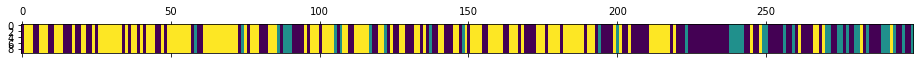

<Figure size 432x288 with 0 Axes>

839
N [[67. 19. 42.]
 [18. 12.  8.]
 [43.  7. 83.]]
alphas [[2.03944386 0.2784329  0.25899557]
 [0.75133038 1.56654638 0.25899557]
 [0.75133038 0.2784329  1.54710905]]
M [[8. 2. 2.]
 [2. 4. 4.]
 [3. 1. 8.]]
sum_w [[3.]
 [3.]
 [8.]]
barM [[5. 2. 2.]
 [2. 1. 4.]
 [3. 1. 0.]]
pi_z [[0.49717639 0.12170829 0.38111532]
 [0.46080575 0.31441927 0.22477497]
 [0.31880547 0.02955726 0.65163727]]
beta_vec [0.53099172 0.0927535  0.37625478]
hyper>> a_k: 3.1108455844836604  gamma: 0.947106671688467  rho: 0.4137993059691815


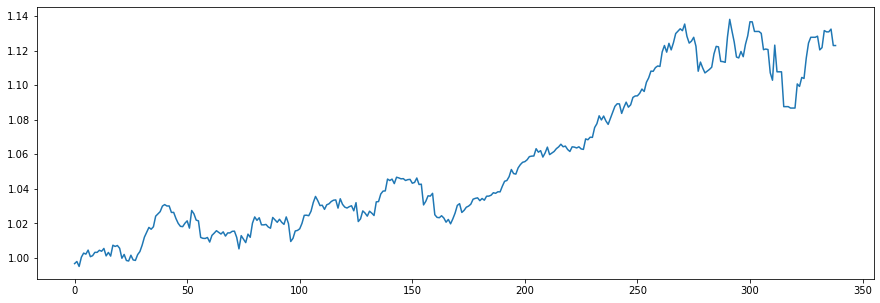

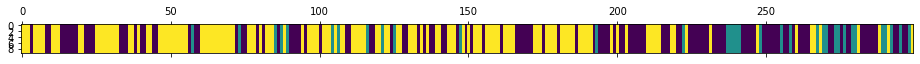

<Figure size 432x288 with 0 Axes>

N [[72. 15. 40.]
 [15.  8. 11.]
 [40. 10. 88.]]
alphas [[2.25557153 0.16914342 0.68613063]
 [0.96830579 1.45640916 0.68613063]
 [0.96830579 0.16914342 1.97339638]]
M [[3. 3. 5.]
 [3. 5. 3.]
 [3. 2. 8.]]
sum_w [[2.]
 [5.]
 [7.]]
barM [[1. 3. 5.]
 [3. 0. 3.]
 [3. 2. 1.]]
pi_z [[0.5976496  0.14861913 0.25373126]
 [0.39701464 0.23176197 0.37122339]
 [0.27436237 0.09717064 0.62846699]]
beta_vec [0.34384516 0.25977137 0.39638347]
hyper>> a_k: 3.4986025530301554  gamma: 0.7561416151524794  rho: 0.37848310014538805


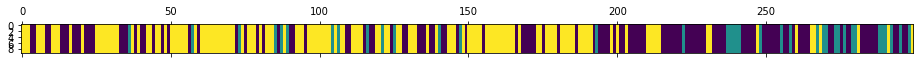

<Figure size 432x288 with 0 Axes>

840
N [[71. 15. 40.]
 [18.  9. 10.]
 [37. 13. 86.]]
alphas [[2.07183282 0.56485742 0.86191231]
 [0.74767088 1.88901936 0.86191231]
 [0.74767088 0.56485742 2.18607426]]
M [[9. 3. 5.]
 [1. 4. 4.]
 [3. 3. 7.]]
sum_w [[6.]
 [2.]
 [6.]]
barM [[3. 3. 5.]
 [1. 2. 4.]
 [3. 3. 1.]]
pi_z [[0.49748783 0.10841551 0.39409666]
 [0.50996965 0.21970087 0.27032948]
 [0.29597943 0.0460445  0.65797608]]
beta_vec [0.36249368 0.13553656 0.50196976]
hyper>> a_k: 3.549619487388866  gamma: 0.33607833070653853  rho: 0.438688591956532


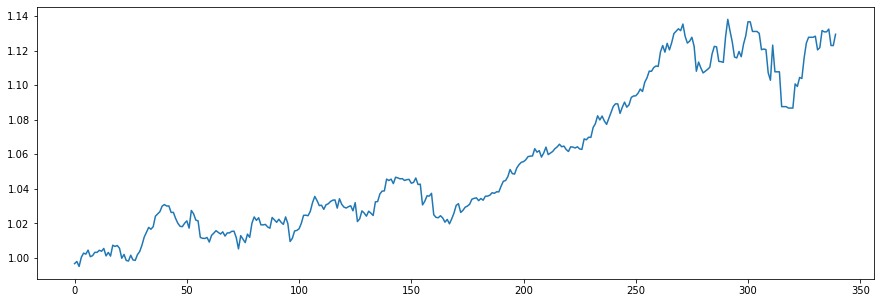

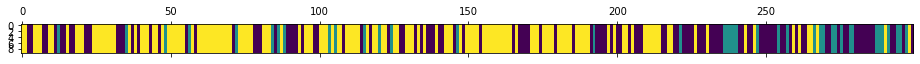

<Figure size 432x288 with 0 Axes>

N [[56. 15. 45.]
 [19. 10. 10.]
 [42. 14. 88.]]
alphas [[2.27942518 0.27004871 1.0001456 ]
 [0.7222476  1.82722629 1.0001456 ]
 [0.7222476  0.27004871 2.55732317]]
M [[7. 1. 2.]
 [6. 4. 5.]
 [3. 1. 5.]]
sum_w [[5.]
 [1.]
 [3.]]
barM [[2. 1. 2.]
 [6. 3. 5.]
 [3. 1. 2.]]
pi_z [[0.59944269 0.10845535 0.29210195]
 [0.37202207 0.2345558  0.39342213]
 [0.25191122 0.12883878 0.61924999]]
beta_vec [0.44407073 0.16384659 0.39208268]
hyper>> a_k: 2.4223005296459497  gamma: 0.8854754109564287  rho: 0.25596082916542706


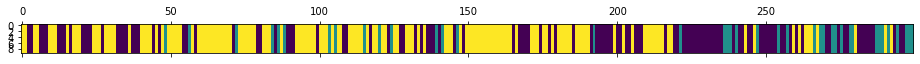

<Figure size 432x288 with 0 Axes>

841
N [[63. 14. 41.]
 [19.  9. 11.]
 [36. 16. 90.]]
alphas [[1.42035673 0.29529849 0.70664531]
 [0.80034267 0.91531254 0.70664531]
 [0.80034267 0.29529849 1.32665936]]
M [[3. 1. 2.]
 [2. 1. 2.]
 [3. 2. 6.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[2. 1. 2.]
 [2. 1. 2.]
 [3. 2. 3.]]
pi_z [[0.51263059 0.11037367 0.37699574]
 [0.32792618 0.42140373 0.25067009]
 [0.22317252 0.16648102 0.61034646]]
beta_vec [0.43421854 0.15820644 0.40757502]
hyper>> a_k: 1.1109334470823191  gamma: 0.642848637218977  rho: 0.1570347845883647


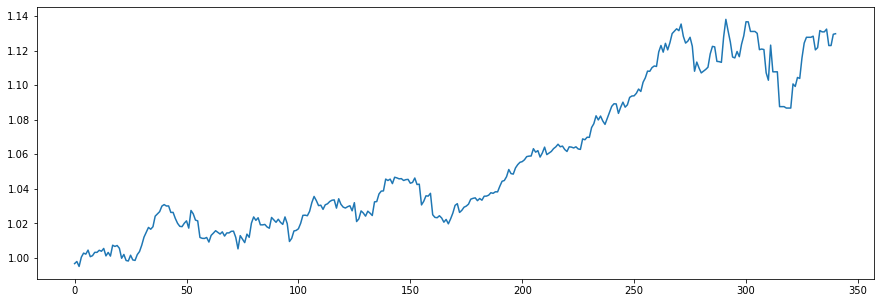

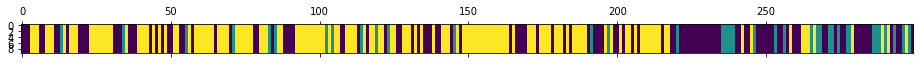

<Figure size 432x288 with 0 Axes>

N [[62. 11. 44.]
 [19.  9. 10.]
 [37. 17. 90.]]
alphas [[0.58109141 0.14815689 0.38168515]
 [0.40663622 0.32261209 0.38168515]
 [0.40663622 0.14815689 0.55614034]]
M [[3. 2. 2.]
 [2. 2. 3.]
 [2. 1. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[2. 2. 2.]
 [2. 1. 3.]
 [2. 1. 2.]]
pi_z [[0.46194043 0.10648679 0.43157279]
 [0.58470912 0.24955906 0.16573182]
 [0.20911806 0.1266721  0.66420984]]
beta_vec [0.53947905 0.19454969 0.26597127]
hyper>> a_k: 1.6331559756875422  gamma: 0.06910250948216565  rho: 0.2400936260334707


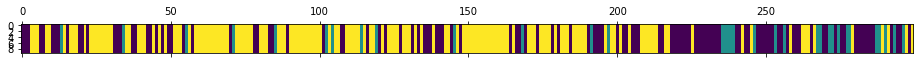

<Figure size 432x288 with 0 Axes>

842
N [[58. 11. 48.]
 [18.  8.  7.]
 [41. 14. 94.]]
alphas [[1.06162845 0.24144504 0.33008248]
 [0.66951811 0.63355538 0.33008248]
 [0.66951811 0.24144504 0.72219282]]
M [[9. 1. 2.]
 [2. 2. 1.]
 [3. 3. 6.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[7. 1. 2.]
 [2. 1. 1.]
 [3. 3. 2.]]
pi_z [[0.50973137 0.08451626 0.40575236]
 [0.45775406 0.48641972 0.05582623]
 [0.3371124  0.06409577 0.59879183]]
beta_vec [0.60693838 0.26552246 0.12753917]
hyper>> a_k: 3.113060981636532  gamma: 0.22850393169185598  rho: 0.3457944403515603


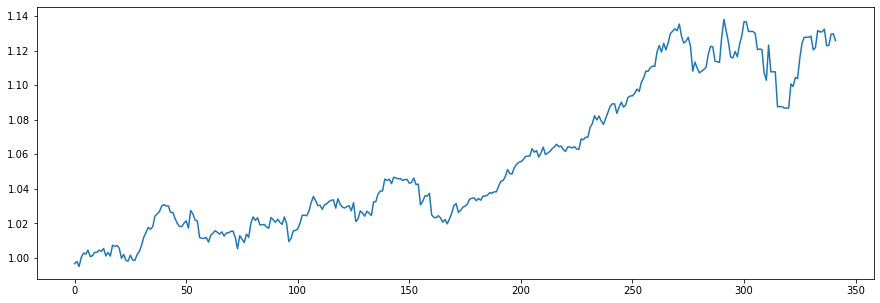

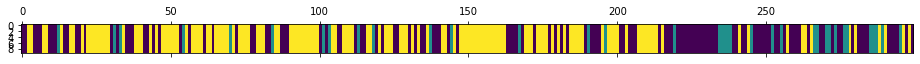

<Figure size 432x288 with 0 Axes>

N [[64. 15. 46.]
 [20.  9.  7.]
 [42. 12. 84.]]
alphas [[2.31255884 0.5407582  0.25974395]
 [1.23607966 1.61723738 0.25974395]
 [1.23607966 0.5407582  1.33622313]]
M [[7. 3. 3.]
 [3. 5. 1.]
 [7. 1. 8.]]
sum_w [[2.]
 [4.]
 [6.]]
barM [[5. 3. 3.]
 [3. 1. 1.]
 [7. 1. 2.]]
pi_z [[0.47850153 0.1461307  0.37536777]
 [0.6367508  0.22406869 0.13918051]
 [0.26511955 0.08308921 0.65179124]]
beta_vec [0.46842981 0.23650165 0.29506855]
hyper>> a_k: 3.778765774568418  gamma: 0.3022214153748192  rho: 0.16969794912599076


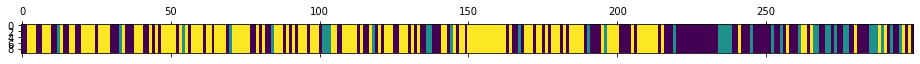

<Figure size 432x288 with 0 Axes>

843
N [[58. 14. 53.]
 [21. 12.  5.]
 [46. 12. 78.]]
alphas [[2.11095527 0.74202793 0.92578257]
 [1.46970647 1.38327673 0.92578257]
 [1.46970647 0.74202793 1.56703138]]
M [[10.  3.  4.]
 [ 5.  4.  2.]
 [ 5.  4.  5.]]
sum_w [[4.]
 [0.]
 [4.]]
barM [[6. 3. 4.]
 [5. 4. 2.]
 [5. 4. 1.]]
pi_z [[0.42373417 0.11896432 0.45730151]
 [0.59862084 0.34817462 0.05320454]
 [0.31869296 0.10058209 0.58072495]]
beta_vec [0.26016209 0.51159341 0.22824451]
hyper>> a_k: 4.108617836079726  gamma: 0.44553266514982154  rho: 0.23387675807642605


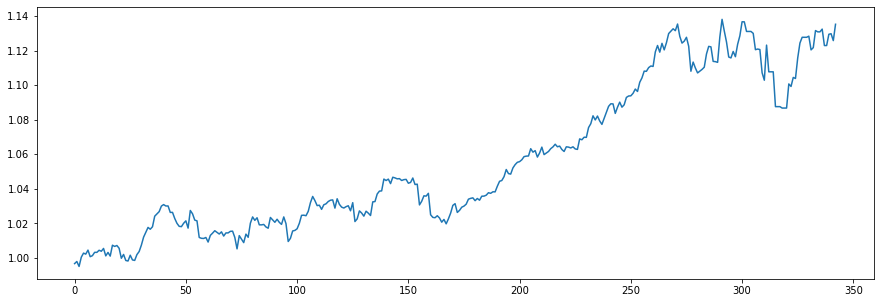

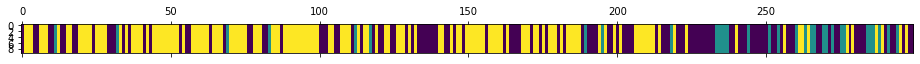

<Figure size 432x288 with 0 Axes>

N [[61. 10. 52.]
 [18.  9.  5.]
 [44. 13. 87.]]
alphas [[1.77982441 1.61034646 0.71844697]
 [0.81891419 2.57125668 0.71844697]
 [0.81891419 1.61034646 1.67935719]]
M [[9. 5. 3.]
 [3. 5. 1.]
 [3. 4. 8.]]
sum_w [[5.]
 [3.]
 [5.]]
barM [[4. 5. 3.]
 [3. 2. 1.]
 [3. 4. 3.]]
pi_z [[0.4978057  0.12635123 0.37584307]
 [0.5969509  0.32260634 0.08044275]
 [0.33121306 0.06952275 0.59926419]]
beta_vec [0.30233481 0.5331999  0.16446529]
hyper>> a_k: 3.8511090100051155  gamma: 0.610675644999345  rho: 0.37364113986418046


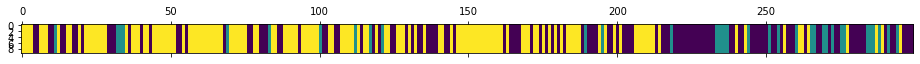

<Figure size 432x288 with 0 Axes>

844
N [[65. 12. 46.]
 [17. 11.  7.]
 [41. 12. 88.]]
alphas [[2.16821761 1.28617214 0.39671926]
 [0.72928485 2.7251049  0.39671926]
 [0.72928485 1.28617214 1.83565202]]
M [[7. 3. 3.]
 [1. 2. 2.]
 [5. 3. 4.]]
sum_w [[5.]
 [2.]
 [4.]]
barM [[2. 3. 3.]
 [1. 0. 2.]
 [5. 3. 0.]]
pi_z [[0.53564448 0.08742061 0.37693491]
 [0.42868386 0.3487797  0.22253645]
 [0.3134128  0.10218749 0.58439971]]
beta_vec [0.48771695 0.33231226 0.17997079]
hyper>> a_k: 1.862880656387889  gamma: 1.0418788518709774  rho: 0.5353486228102722


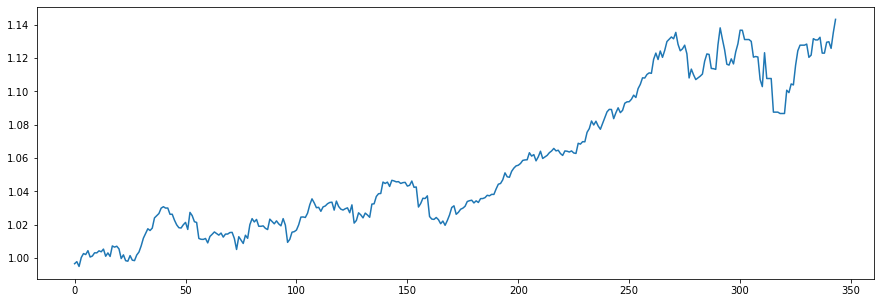

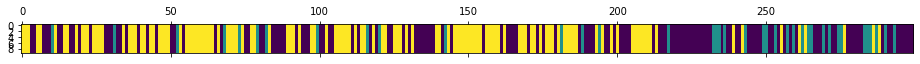

<Figure size 432x288 with 0 Axes>

N [[71. 18. 46.]
 [21.  7. 10.]
 [43. 13. 70.]]
alphas [[1.41945354 0.28764619 0.15578093]
 [0.42216295 1.28493678 0.15578093]
 [0.42216295 0.28764619 1.15307152]]
M [[4. 2. 2.]
 [2. 3. 2.]
 [5. 1. 4.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[1. 2. 2.]
 [2. 0. 2.]
 [5. 1. 0.]]
pi_z [[0.46103488 0.15899588 0.37996924]
 [0.5257203  0.17943775 0.29484195]
 [0.32775762 0.14309468 0.5291477 ]]
beta_vec [0.45363602 0.07693595 0.46942803]
hyper>> a_k: 1.5294869507314537  gamma: 0.8028569732456883  rho: 0.37421771860186


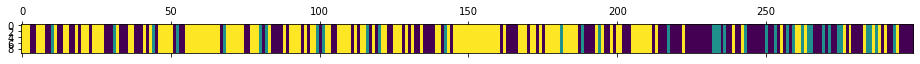

<Figure size 432x288 with 0 Axes>

845
N [[62. 16. 47.]
 [20.  5. 11.]
 [43. 15. 80.]]
alphas [[1.00654787 0.07363739 0.44930169]
 [0.43418676 0.6459985  0.44930169]
 [0.43418676 0.07363739 1.02166281]]
M [[6. 2. 3.]
 [1. 2. 1.]
 [1. 1. 7.]]
sum_w [[3.]
 [2.]
 [6.]]
barM [[3. 2. 3.]
 [1. 0. 1.]
 [1. 1. 1.]]
pi_z [[0.53059965 0.15165236 0.31774799]
 [0.56308266 0.09045777 0.34645957]
 [0.30341572 0.10157587 0.59500841]]
beta_vec [0.28687584 0.35339626 0.3597279 ]
hyper>> a_k: 1.4454833546358963  gamma: 0.7593984534365965  rho: 0.614093004727001


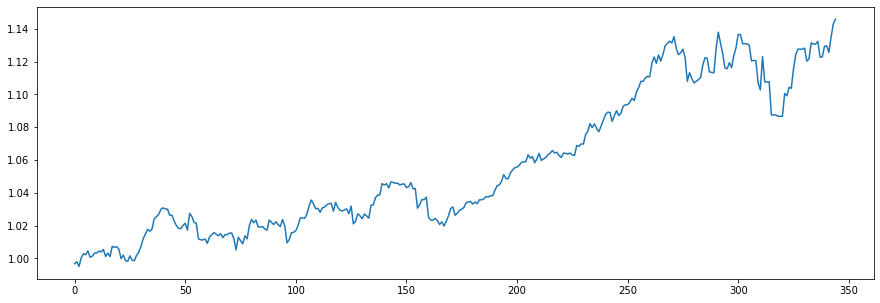

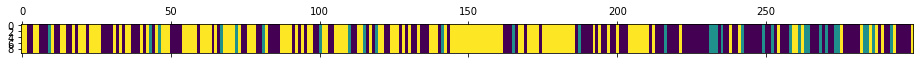

<Figure size 432x288 with 0 Axes>

N [[70. 14. 48.]
 [18.  5. 10.]
 [43. 14. 77.]]
alphas [[1.04768691 0.19713226 0.20066419]
 [0.16002569 1.08479348 0.20066419]
 [0.16002569 0.19713226 1.0883254 ]]
M [[ 7.  4.  2.]
 [ 2.  1.  3.]
 [ 1.  1. 11.]]
sum_w [[ 6.]
 [ 1.]
 [10.]]
barM [[1. 4. 2.]
 [2. 0. 3.]
 [1. 1. 1.]]
pi_z [[0.52455377 0.09900102 0.37644521]
 [0.59309761 0.06718657 0.33971582]
 [0.258589   0.23707816 0.50433284]]
beta_vec [0.35135762 0.18870431 0.45993807]
hyper>> a_k: 3.3766686747440846  gamma: 0.9121296404935194  rho: 0.588790090308617


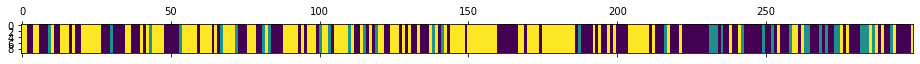

<Figure size 432x288 with 0 Axes>

846
N [[73. 14. 46.]
 [20.  6. 10.]
 [40. 16. 74.]]
alphas [[2.47601601 0.26201964 0.63863303]
 [0.48786695 2.25016869 0.63863303]
 [0.48786695 0.26201964 2.62678209]]
M [[10.  2.  2.]
 [ 3.  4.  1.]
 [ 2.  1.  7.]]
sum_w [[8.]
 [3.]
 [5.]]
barM [[2. 2. 2.]
 [3. 1. 1.]
 [2. 1. 2.]]
pi_z [[0.53065236 0.15343713 0.31591051]
 [0.57484597 0.11743858 0.30771546]
 [0.30148508 0.16331979 0.53519513]]
beta_vec [0.55351466 0.16056457 0.28592077]
hyper>> a_k: 3.3373276818491426  gamma: 0.9736135762264146  rho: 0.369525505423287


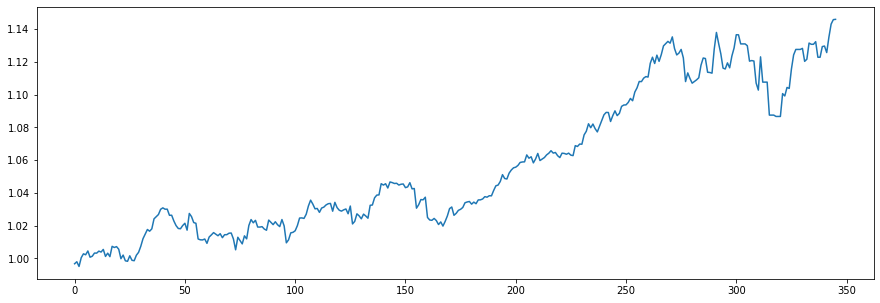

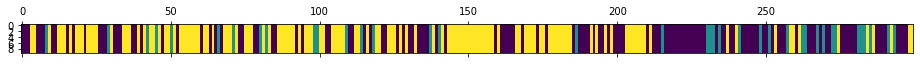

<Figure size 432x288 with 0 Axes>

N [[70. 14. 46.]
 [19.  7. 12.]
 [41. 17. 73.]]
alphas [[2.39787788 0.33784392 0.60160589]
 [1.16465018 1.57107162 0.60160589]
 [1.16465018 0.33784392 1.83483358]]
M [[9. 1. 2.]
 [2. 4. 1.]
 [4. 2. 8.]]
sum_w [[6.]
 [3.]
 [6.]]
barM [[3. 1. 2.]
 [2. 1. 1.]
 [4. 2. 2.]]
pi_z [[0.5286658  0.12594113 0.34539307]
 [0.33311879 0.23535474 0.43152646]
 [0.34209282 0.19440668 0.4635005 ]]
beta_vec [0.55298821 0.23184701 0.21516478]
hyper>> a_k: 3.4983158262744105  gamma: 1.644736658818269  rho: 0.405865880621619


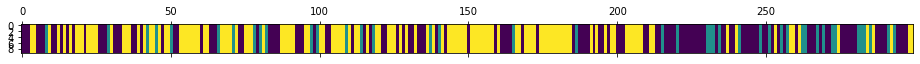

<Figure size 432x288 with 0 Axes>

847
N [[67. 18. 43.]
 [22.  6. 14.]
 [39. 18. 72.]]
alphas [[2.56921576 0.48188678 0.44721328]
 [1.14936873 1.90173381 0.44721328]
 [1.14936873 0.48188678 1.86706031]]
M [[8. 1. 2.]
 [4. 2. 2.]
 [2. 4. 7.]]
sum_w [[7.]
 [2.]
 [5.]]
barM [[1. 1. 2.]
 [4. 0. 2.]
 [2. 4. 2.]]
pi_z [[0.53583284 0.17979919 0.28436797]
 [0.49701679 0.20084329 0.30213992]
 [0.19095585 0.17887187 0.63017227]]
beta_vec [0.50685923 0.33620927 0.1569315 ]
hyper>> a_k: 2.3846015165238352  gamma: 0.5512863604816496  rho: 0.3215898480206245


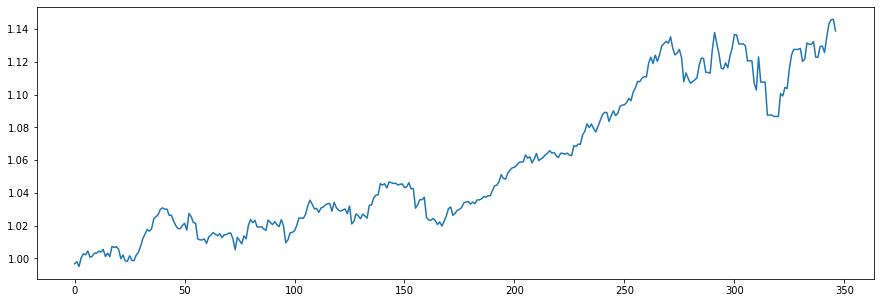

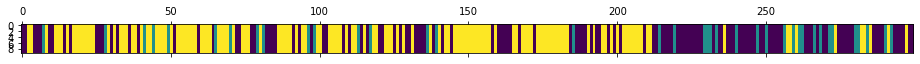

<Figure size 432x288 with 0 Axes>

N [[65. 15. 44.]
 [22.  5. 11.]
 [37. 18. 82.]]
alphas [[1.58682902 0.54389846 0.25387403]
 [0.81996538 1.3107621  0.25387403]
 [0.81996538 0.54389846 1.02073767]]
M [[6. 4. 1.]
 [3. 3. 1.]
 [2. 3. 3.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[5. 4. 1.]
 [3. 3. 1.]
 [2. 3. 1.]]
pi_z [[0.49101109 0.12369885 0.38529006]
 [0.58569099 0.13842531 0.2758837 ]
 [0.22316264 0.18479527 0.59204209]]
beta_vec [0.32080451 0.50345949 0.175736  ]
hyper>> a_k: 1.669715873422914  gamma: 0.7493166685817224  rho: 0.1920908701236005


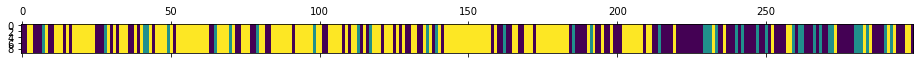

<Figure size 432x288 with 0 Axes>

848
N [[59. 13. 44.]
 [20.  7. 11.]
 [37. 18. 90.]]
alphas [[0.75349562 0.67915612 0.23706412]
 [0.43275845 0.9998933  0.23706412]
 [0.43275845 0.67915612 0.5578013 ]]
M [[1. 3. 2.]
 [3. 2. 2.]
 [2. 2. 3.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[0. 3. 2.]
 [3. 2. 2.]
 [2. 2. 1.]]
pi_z [[0.55961082 0.09680449 0.34358469]
 [0.68684573 0.13033791 0.18281636]
 [0.20510197 0.13925083 0.6556472 ]]
beta_vec [0.12561235 0.40695548 0.46743216]
hyper>> a_k: 1.170988179592122  gamma: 0.4471323944753335  rho: 0.2909234134664648


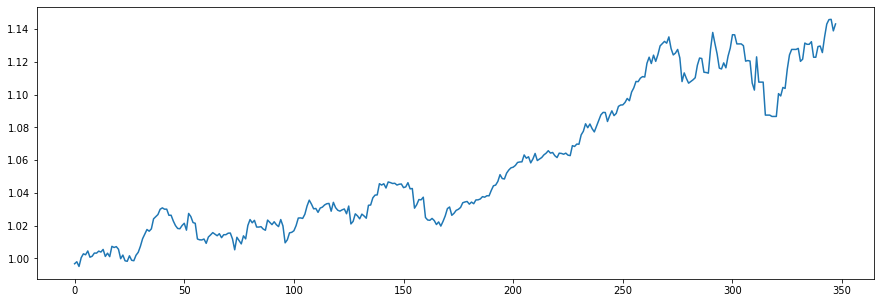

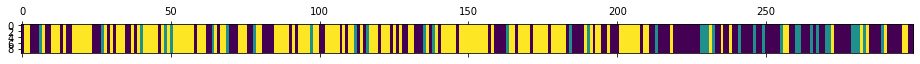

<Figure size 432x288 with 0 Axes>

N [[67. 11. 48.]
 [21.  6.  9.]
 [38. 19. 80.]]
alphas [[0.44496636 0.3379034  0.38811842]
 [0.10429849 0.67857128 0.38811842]
 [0.10429849 0.3379034  0.72878629]]
M [[4. 2. 3.]
 [1. 2. 2.]
 [2. 2. 1.]]
sum_w [[4.]
 [0.]
 [0.]]
barM [[0. 2. 3.]
 [1. 2. 2.]
 [2. 2. 1.]]
pi_z [[0.49322473 0.1262923  0.38048297]
 [0.57764493 0.14864972 0.27370534]
 [0.24169287 0.14061636 0.61769077]]
beta_vec [0.14554863 0.50985402 0.34459735]
hyper>> a_k: 1.4306490775455865  gamma: 0.28041471189408596  rho: 0.14679315625135864


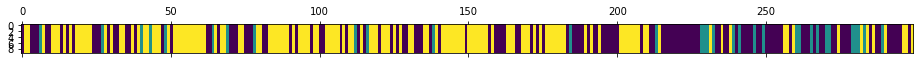

<Figure size 432x288 with 0 Axes>

849
N [[66. 12. 51.]
 [18.  6.  8.]
 [45. 14. 79.]]
alphas [[0.38767192 0.622348   0.42062916]
 [0.17766242 0.83235749 0.42062916]
 [0.17766242 0.622348   0.63063866]]
M [[6. 4. 3.]
 [2. 1. 2.]
 [2. 4. 4.]]
sum_w [[4.]
 [0.]
 [1.]]
barM [[2. 4. 3.]
 [2. 1. 2.]
 [2. 4. 3.]]
pi_z [[0.51408783 0.11660029 0.36931188]
 [0.53121884 0.29057753 0.17820363]
 [0.33558764 0.14856982 0.51584254]]
beta_vec [0.25939642 0.47665545 0.26394813]
hyper>> a_k: 2.1105149329619057  gamma: 0.25419682540990535  rho: 0.27584275682786374


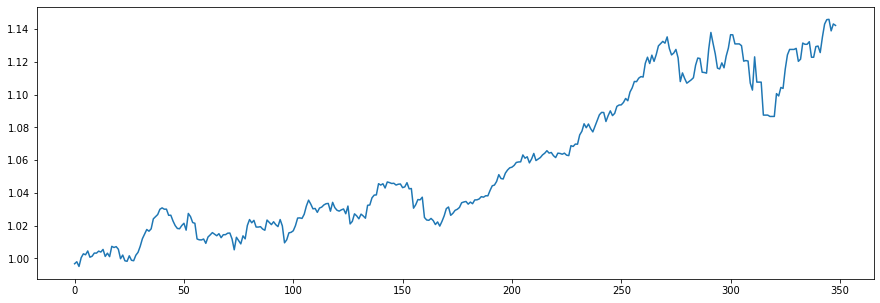

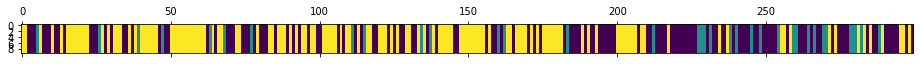

<Figure size 432x288 with 0 Axes>

N [[63. 16. 52.]
 [22.  6.  7.]
 [47. 13. 73.]]
alphas [[0.97861739 0.72849382 0.40340372]
 [0.39644714 1.31066407 0.40340372]
 [0.39644714 0.72849382 0.98557398]]
M [[6. 3. 1.]
 [2. 1. 1.]
 [4. 1. 4.]]
sum_w [[5.]
 [1.]
 [2.]]
barM [[1. 3. 1.]
 [2. 0. 1.]
 [4. 1. 2.]]
pi_z [[0.46843976 0.12813711 0.40342313]
 [0.54869906 0.21525322 0.23604772]
 [0.35366564 0.11603824 0.53029612]]
beta_vec [0.45567388 0.34418444 0.20014168]
hyper>> a_k: 2.2979290673853243  gamma: 0.48200063912954694  rho: 0.4309923071788987


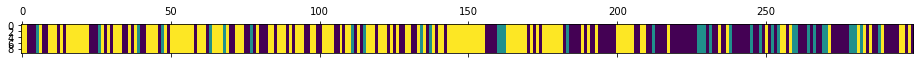

<Figure size 432x288 with 0 Axes>

850
N [[62. 14. 52.]
 [21.  8.  7.]
 [45. 14. 76.]]
alphas [[1.58620126 0.45003469 0.26169312]
 [0.59581151 1.44042444 0.26169312]
 [0.59581151 0.45003469 1.25208287]]
M [[7. 2. 2.]
 [4. 2. 1.]
 [3. 3. 7.]]
sum_w [[5.]
 [2.]
 [4.]]
barM [[2. 2. 2.]
 [4. 0. 1.]
 [3. 3. 3.]]
pi_z [[0.50113888 0.09907443 0.39978669]
 [0.59181631 0.23436121 0.17382248]
 [0.36458751 0.12726413 0.50814836]]
beta_vec [0.54087676 0.18099125 0.27813198]
hyper>> a_k: 2.856274498195573  gamma: 0.5650930047480389  rho: 0.385376736855122


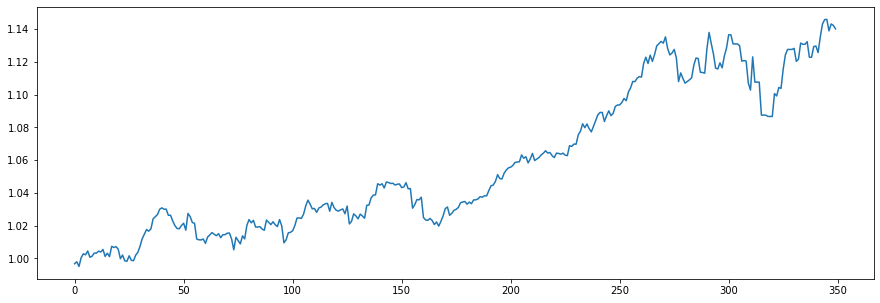

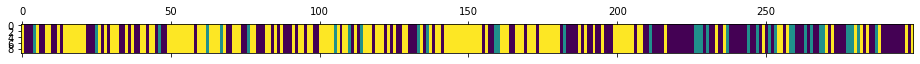

<Figure size 432x288 with 0 Axes>

N [[62. 13. 54.]
 [21.  7.  7.]
 [45. 15. 75.]]
alphas [[2.05026862 0.31773607 0.48826981]
 [0.94952687 1.41847782 0.48826981]
 [0.94952687 0.31773607 1.58901155]]
M [[5. 1. 3.]
 [3. 3. 3.]
 [5. 3. 4.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[3. 1. 3.]
 [3. 1. 3.]
 [5. 3. 1.]]
pi_z [[0.42303714 0.09610422 0.48085865]
 [0.72177856 0.11646178 0.16175965]
 [0.31574086 0.09048547 0.59377366]]
beta_vec [0.41660587 0.24296952 0.34042461]
hyper>> a_k: 2.393427564438977  gamma: 1.461358590622899  rho: 0.29487469668770167


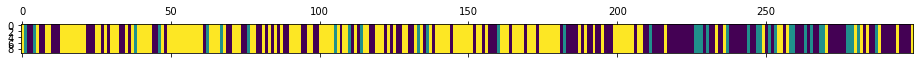

<Figure size 432x288 with 0 Axes>

851
N [[62. 12. 51.]
 [20.  7.  9.]
 [43. 17. 78.]]
alphas [[1.40885294 0.41005148 0.57452315]
 [0.70309171 1.1158127  0.57452315]
 [0.70309171 0.41005148 1.28028438]]
M [[8. 1. 2.]
 [2. 2. 2.]
 [2. 1. 9.]]
sum_w [[4.]
 [1.]
 [7.]]
barM [[4. 1. 2.]
 [2. 1. 2.]
 [2. 1. 2.]]
pi_z [[0.48615877 0.08964861 0.42419262]
 [0.53321169 0.21923271 0.2475556 ]
 [0.31685339 0.13035338 0.55279323]]
beta_vec [0.48244394 0.2227189  0.29483716]
hyper>> a_k: 1.6400458851032567  gamma: 0.6922551963586822  rho: 0.39983893498714257


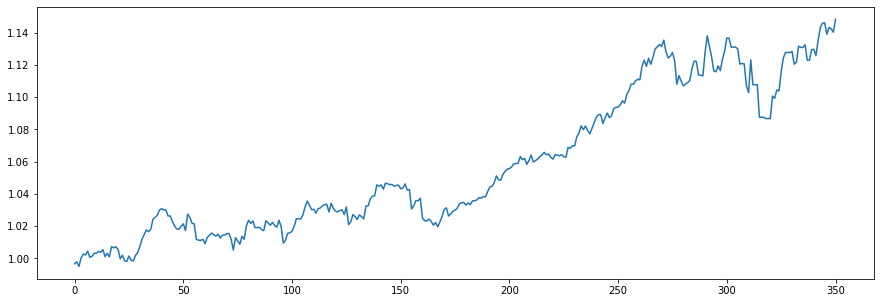

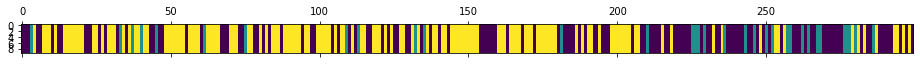

<Figure size 432x288 with 0 Axes>

N [[60. 14. 52.]
 [20.  6.  7.]
 [47. 13. 80.]]
alphas [[1.13061976 0.21922036 0.29020577]
 [0.47486556 0.87497456 0.29020577]
 [0.47486556 0.21922036 0.94595997]]
M [[3. 1. 4.]
 [3. 4. 2.]
 [3. 1. 3.]]
sum_w [[1.]
 [3.]
 [2.]]
barM [[2. 1. 4.]
 [3. 1. 2.]
 [3. 1. 1.]]
pi_z [[0.55639377 0.09515409 0.34845214]
 [0.53482458 0.2259017  0.23927372]
 [0.36934266 0.06768707 0.56297028]]
beta_vec [0.56933172 0.07770392 0.35296436]
hyper>> a_k: 1.7360869559566403  gamma: 1.4460927536088706  rho: 0.28320465557994096


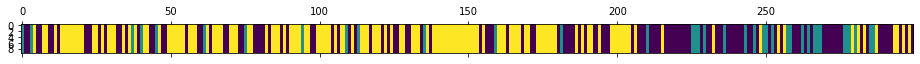

<Figure size 432x288 with 0 Axes>

852
N [[61. 14. 52.]
 [21.  9.  6.]
 [45. 13. 78.]]
alphas [[1.20015514 0.09669624 0.43923558]
 [0.70848723 0.58836414 0.43923558]
 [0.70848723 0.09669624 0.93090349]]
M [[7. 1. 1.]
 [3. 3. 3.]
 [4. 1. 4.]]
sum_w [[1.]
 [3.]
 [2.]]
barM [[6. 1. 1.]
 [3. 0. 3.]
 [4. 1. 2.]]
pi_z [[0.48415296 0.11943892 0.39640812]
 [0.5130366  0.32023831 0.16672509]
 [0.30249941 0.10743051 0.59007008]]
beta_vec [0.62048606 0.18104153 0.19847241]
hyper>> a_k: 2.5346129658762706  gamma: 0.5971311332523714  rho: 0.17164680609127808


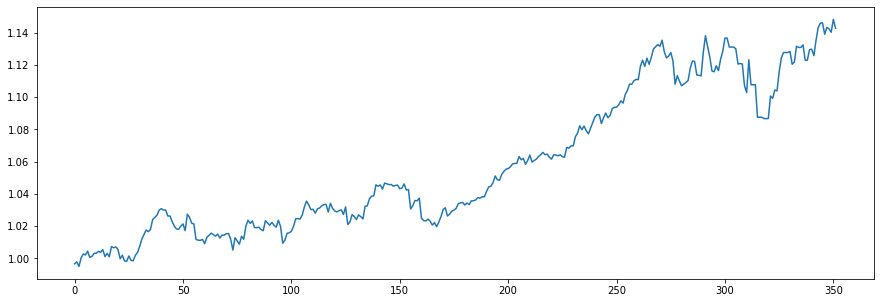

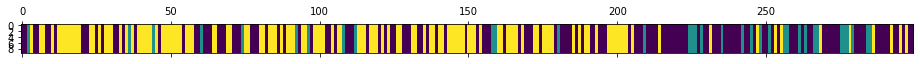

<Figure size 432x288 with 0 Axes>

N [[72. 17. 51.]
 [18.  8.  8.]
 [50.  9. 66.]]
alphas [[1.73780268 0.3801066  0.41670368]
 [1.30274446 0.81516482 0.41670368]
 [1.30274446 0.3801066  0.8517619 ]]
M [[3. 2. 1.]
 [4. 2. 1.]
 [8. 2. 4.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[3. 2. 1.]
 [4. 1. 1.]
 [8. 2. 4.]]
pi_z [[0.53065692 0.11250995 0.35683313]
 [0.36755148 0.32179293 0.31065558]
 [0.39477561 0.08351171 0.52171268]]
beta_vec [0.61829913 0.16029994 0.22140093]
hyper>> a_k: 2.865957959141428  gamma: 0.7866576236237904  rho: 0.21888187824862648


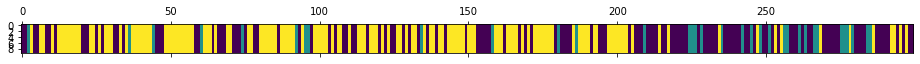

<Figure size 432x288 with 0 Axes>

853
N [[64. 17. 47.]
 [17.  8.  9.]
 [47.  9. 81.]]
alphas [[2.01146266 0.35885573 0.49563957]
 [1.3841564  0.98616199 0.49563957]
 [1.3841564  0.35885573 1.12294583]]
M [[8. 2. 2.]
 [5. 3. 2.]
 [4. 3. 5.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[5. 2. 2.]
 [5. 1. 2.]
 [4. 3. 1.]]
pi_z [[0.42637997 0.16971149 0.40390854]
 [0.52171833 0.27658577 0.2016959 ]
 [0.37607987 0.07857474 0.54534538]]
beta_vec [0.418768 0.255835 0.325397]
hyper>> a_k: 2.492881599670942  gamma: 1.4475194664781401  rho: 0.32296535950550864


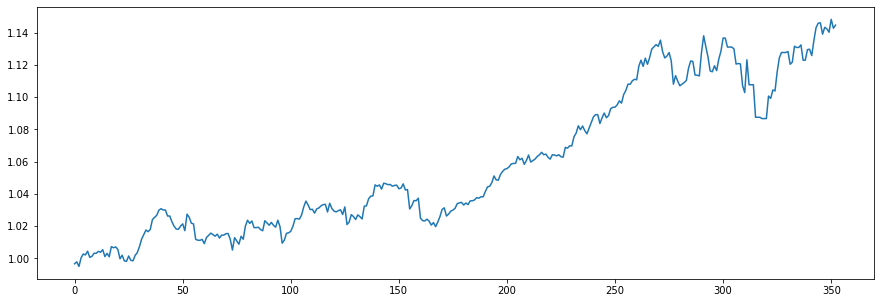

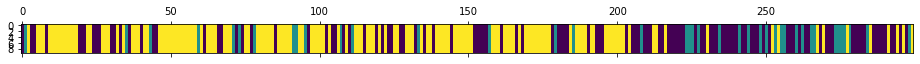

<Figure size 432x288 with 0 Axes>

N [[55. 19. 42.]
 [21.  8. 11.]
 [40. 12. 91.]]
alphas [[1.5118973  0.43178991 0.54919438]
 [0.7067829  1.23690432 0.54919438]
 [0.7067829  0.43178991 1.35430879]]
M [[3. 3. 2.]
 [3. 4. 3.]
 [1. 4. 8.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[1. 3. 2.]
 [3. 1. 3.]
 [1. 4. 3.]]
pi_z [[0.45556718 0.17740558 0.36702725]
 [0.58954031 0.15796953 0.25249016]
 [0.29179165 0.09451212 0.61369623]]
beta_vec [0.23615512 0.30364566 0.46019922]
hyper>> a_k: 3.661708195751731  gamma: 2.4555809833372946  rho: 0.3992972512786004


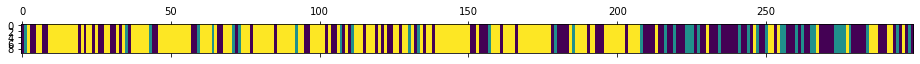

<Figure size 432x288 with 0 Axes>

854
N [[ 48.  20.  39.]
 [ 22.   7.  12.]
 [ 37.  14. 100.]]
alphas [[1.98155639 0.66789844 1.01225337]
 [0.51944637 2.13000846 1.01225337]
 [0.51944637 0.66789844 2.47436338]]
M [[ 6.  1.  4.]
 [ 2.  2.  2.]
 [ 4.  2. 13.]]
sum_w [[4.]
 [1.]
 [8.]]
barM [[2. 1. 4.]
 [2. 1. 2.]
 [4. 2. 5.]]
pi_z [[0.45495765 0.12793263 0.41710972]
 [0.44856509 0.29007639 0.26135851]
 [0.30239815 0.06797542 0.62962643]]
beta_vec [0.42905796 0.16273868 0.40820336]
hyper>> a_k: 2.8283179689033657  gamma: 0.6697032893512035  rho: 0.4236996873646084


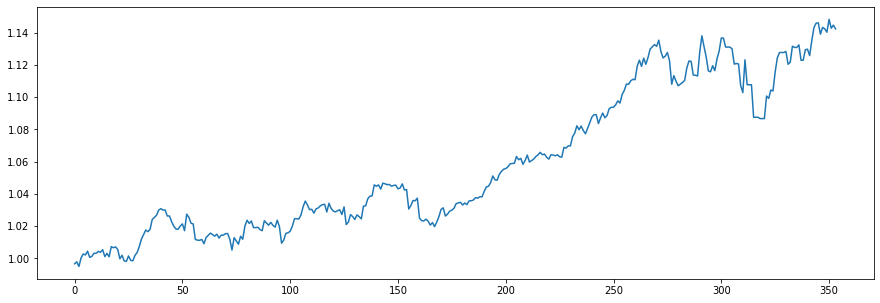

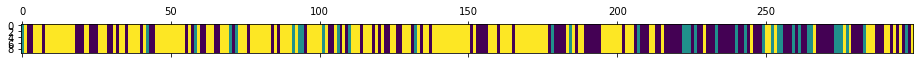

<Figure size 432x288 with 0 Axes>

N [[55. 15. 44.]
 [18.  7. 11.]
 [40. 14. 95.]]
alphas [[1.89770497 0.26525763 0.66535537]
 [0.69934753 1.46361507 0.66535537]
 [0.69934753 0.26525763 1.86371281]]
M [[7. 3. 1.]
 [3. 2. 4.]
 [2. 1. 8.]]
sum_w [[5.]
 [2.]
 [6.]]
barM [[2. 3. 1.]
 [3. 0. 4.]
 [2. 1. 2.]]
pi_z [[0.53017401 0.10067027 0.36915572]
 [0.44998493 0.29084632 0.25916874]
 [0.25651207 0.1093665  0.63412143]]
beta_vec [0.54996678 0.25837951 0.19165371]
hyper>> a_k: 2.0397001353188076  gamma: 0.8075974070663281  rho: 0.5658831488948519


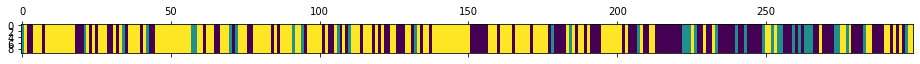

<Figure size 432x288 with 0 Axes>

855
N [[57. 14. 43.]
 [16.  7. 13.]
 [41. 15. 93.]]
alphas [[1.64121003 0.22878684 0.16970327]
 [0.48697809 1.38301877 0.16970327]
 [0.48697809 0.22878684 1.3239352 ]]
M [[11.  1.  1.]
 [ 3.  4.  2.]
 [ 2.  1.  7.]]
sum_w [[6.]
 [4.]
 [7.]]
barM [[5. 1. 1.]
 [3. 0. 2.]
 [2. 1. 0.]]
pi_z [[0.54603497 0.13014991 0.32381513]
 [0.35299982 0.3783578  0.26864238]
 [0.28379074 0.10420885 0.61200041]]
beta_vec [0.70984371 0.15922094 0.13093535]
hyper>> a_k: 2.7094768274987695  gamma: 1.3377073705745104  rho: 0.5596149288750258


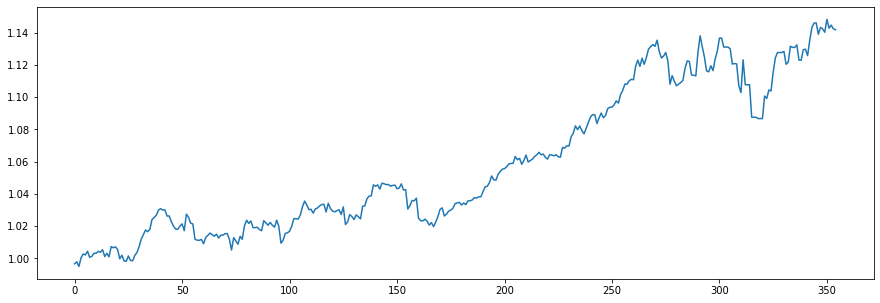

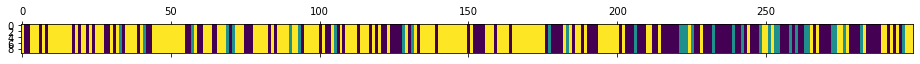

<Figure size 432x288 with 0 Axes>

N [[56. 14. 48.]
 [17.  5. 11.]
 [45. 14. 89.]]
alphas [[2.36325853 0.18998452 0.15623378]
 [0.84699485 1.7062482  0.15623378]
 [0.84699485 0.18998452 1.67249746]]
M [[7. 1. 2.]
 [3. 3. 1.]
 [3. 1. 3.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[2. 1. 2.]
 [3. 0. 1.]
 [3. 1. 0.]]
pi_z [[0.44771228 0.07849241 0.47379531]
 [0.40305878 0.27988872 0.31705251]
 [0.25804542 0.11916117 0.62279341]]
beta_vec [0.4550482  0.29831581 0.246636  ]
hyper>> a_k: 1.9832973667674423  gamma: 1.2720984940396765  rho: 0.42928745587948663


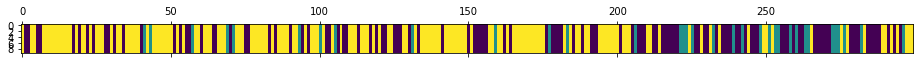

<Figure size 432x288 with 0 Axes>

856
N [[51. 12. 51.]
 [16.  6. 12.]
 [47. 16. 88.]]
alphas [[1.3664704  0.33766148 0.27916548]
 [0.51506572 1.18906616 0.27916548]
 [0.51506572 0.33766148 1.13057016]]
M [[3. 2. 2.]
 [2. 2. 1.]
 [2. 2. 7.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[0. 2. 2.]
 [2. 1. 1.]
 [2. 2. 3.]]
pi_z [[0.44099534 0.07362815 0.48537651]
 [0.50351747 0.25803367 0.23844886]
 [0.29212881 0.05874284 0.64912835]]
beta_vec [0.2184886  0.15335216 0.62815924]
hyper>> a_k: 2.2020035577279464  gamma: 1.6394989609253416  rho: 0.4114080787943215


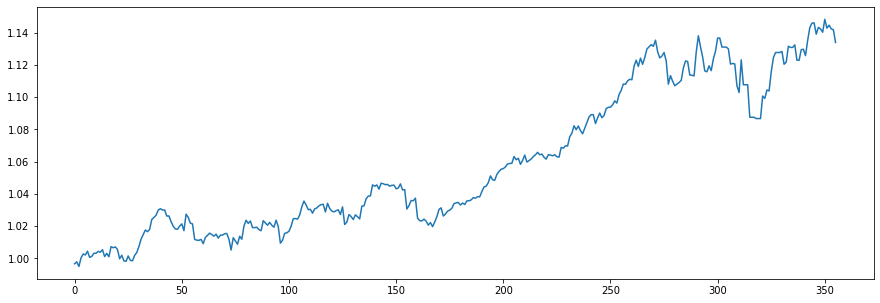

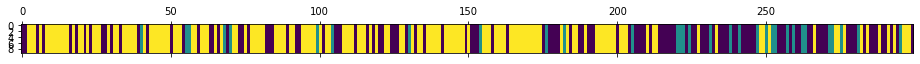

<Figure size 432x288 with 0 Axes>

N [[53. 13. 52.]
 [19.  6.  7.]
 [47. 13. 89.]]
alphas [[1.18910109 0.19875689 0.81414558]
 [0.28317903 1.10467895 0.81414558]
 [0.28317903 0.19875689 1.72006763]]
M [[3. 1. 5.]
 [3. 3. 1.]
 [3. 3. 7.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[0. 1. 5.]
 [3. 0. 1.]
 [3. 3. 2.]]
pi_z [[0.42106546 0.10971316 0.46922138]
 [0.53966811 0.17375937 0.28657252]
 [0.29956607 0.13236834 0.56806559]]
beta_vec [0.32472569 0.07922558 0.59604874]
hyper>> a_k: 1.875167526640807  gamma: 1.414903603663223  rho: 0.49668602978062776


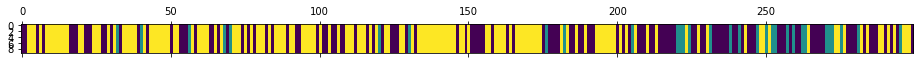

<Figure size 432x288 with 0 Axes>

857
N [[56. 11. 56.]
 [16.  6.  9.]
 [51. 14. 80.]]
alphas [[1.23784497 0.07477294 0.56254961]
 [0.30647546 1.00614245 0.56254961]
 [0.30647546 0.07477294 1.49391913]]
M [[7. 2. 2.]
 [1. 1. 2.]
 [3. 1. 5.]]
sum_w [[7.]
 [1.]
 [4.]]
barM [[0. 2. 2.]
 [1. 0. 2.]
 [3. 1. 1.]]
pi_z [[0.44951124 0.08442546 0.46606331]
 [0.51837282 0.12450661 0.35712057]
 [0.37755185 0.08659106 0.5358571 ]]
beta_vec [0.25359502 0.24309098 0.503314  ]
hyper>> a_k: 1.8856038395377197  gamma: 0.23231575788131262  rho: 0.6285536021029879


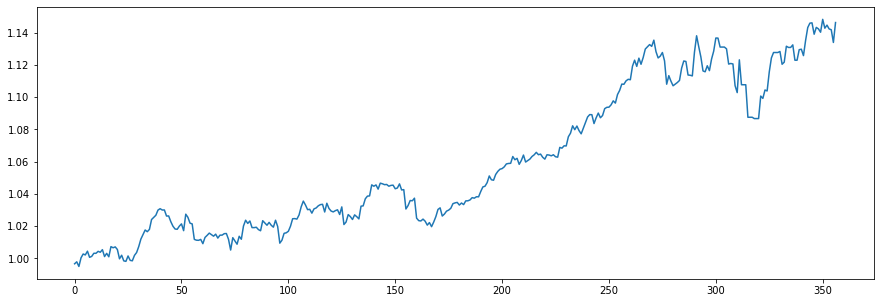

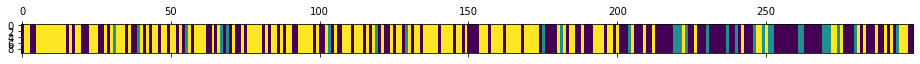

<Figure size 432x288 with 0 Axes>

N [[60. 11. 61.]
 [15.  6.  9.]
 [57. 13. 67.]]
alphas [[1.36282123 0.17026111 0.3525215 ]
 [0.17761814 1.35546419 0.3525215 ]
 [0.17761814 0.17026111 1.53772459]]
M [[7. 1. 2.]
 [1. 3. 2.]
 [2. 2. 8.]]
sum_w [[6.]
 [3.]
 [7.]]
barM [[1. 1. 2.]
 [1. 0. 2.]
 [2. 2. 1.]]
pi_z [[0.47178689 0.04040085 0.48781226]
 [0.54420012 0.15626872 0.29953116]
 [0.33847852 0.06920284 0.59231864]]
beta_vec [0.39398058 0.30573062 0.3002888 ]
hyper>> a_k: 2.221578766631428  gamma: 0.8605388395627168  rho: 0.5504960323016269


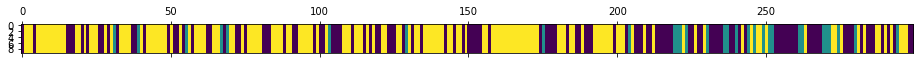

<Figure size 432x288 with 0 Axes>

858
N [[59.  9. 52.]
 [14.  7.  9.]
 [47. 14. 88.]]
alphas [[1.61640264 0.30530519 0.29987094]
 [0.39343234 1.52827548 0.29987094]
 [0.39343234 0.30530519 1.52284124]]
M [[10.  2.  2.]
 [ 1.  4.  1.]
 [ 5.  2.  8.]]
sum_w [[9.]
 [3.]
 [4.]]
barM [[1. 2. 2.]
 [1. 1. 1.]
 [5. 2. 4.]]
pi_z [[0.51662683 0.07297851 0.41039466]
 [0.49756483 0.15271835 0.34971682]
 [0.33601835 0.11285052 0.55113113]]
beta_vec [0.25164746 0.3814118  0.36694073]
hyper>> a_k: 2.283322901604565  gamma: 0.4921449569448348  rho: 0.3586131673766972


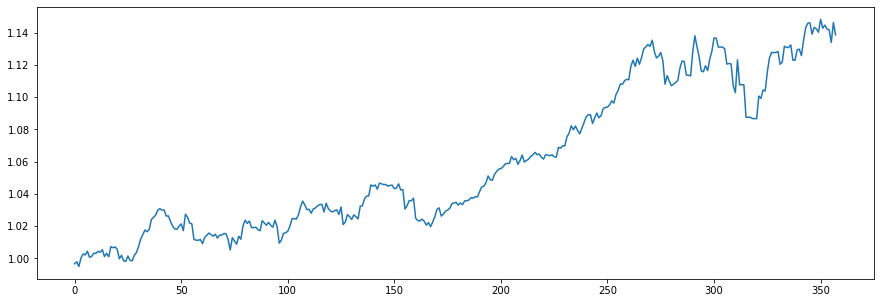

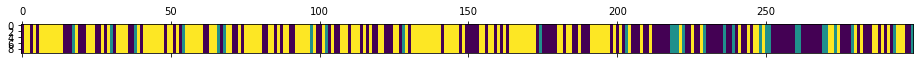

<Figure size 432x288 with 0 Axes>

N [[62. 11. 54.]
 [14.  5.  9.]
 [50. 13. 81.]]
alphas [[1.18736567 0.55857501 0.53738222]
 [0.36853601 1.37740467 0.53738222]
 [0.36853601 0.55857501 1.35621188]]
M [[5. 2. 4.]
 [1. 3. 1.]
 [3. 3. 9.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[1. 2. 4.]
 [1. 1. 1.]
 [3. 3. 3.]]
pi_z [[0.47899205 0.10618687 0.41482108]
 [0.47301452 0.1960852  0.33090028]
 [0.32122792 0.09964503 0.57912705]]
beta_vec [0.21049908 0.27769631 0.51180461]
hyper>> a_k: 2.295910704154279  gamma: 0.7387637016410872  rho: 0.374747371957276


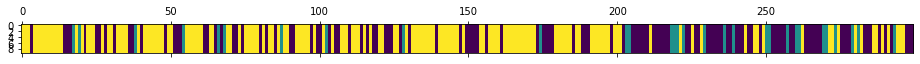

<Figure size 432x288 with 0 Axes>

859
N [[61. 10. 49.]
 [16.  6.  8.]
 [43. 14. 92.]]
alphas [[1.16256302 0.39863978 0.7347079 ]
 [0.30217652 1.25902628 0.7347079 ]
 [0.30217652 0.39863978 1.5950944 ]]
M [[5. 2. 5.]
 [1. 4. 2.]
 [4. 2. 7.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[1. 2. 5.]
 [1. 2. 2.]
 [4. 2. 1.]]
pi_z [[0.51616008 0.11605401 0.3677859 ]
 [0.50551061 0.25297647 0.24151292]
 [0.28122684 0.1379919  0.58078126]]
beta_vec [0.13411574 0.56414786 0.3017364 ]
hyper>> a_k: 2.4305868898317664  gamma: 0.6318149882790625  rho: 0.5118700890554976


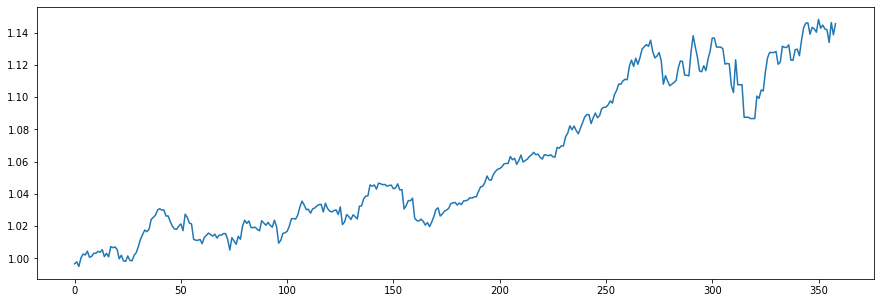

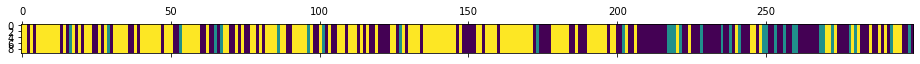

<Figure size 432x288 with 0 Axes>

N [[62. 13. 49.]
 [18.  5.  9.]
 [45. 13. 85.]]
alphas [[1.4032653  0.6693288  0.35799279]
 [0.15912057 1.91347353 0.35799279]
 [0.15912057 0.6693288  1.60213751]]
M [[6. 2. 3.]
 [1. 5. 2.]
 [3. 3. 6.]]
sum_w [[6.]
 [3.]
 [5.]]
barM [[0. 2. 3.]
 [1. 2. 2.]
 [3. 3. 1.]]
pi_z [[0.57897476 0.09139136 0.32963388]
 [0.61474777 0.06595063 0.3193016 ]
 [0.31380381 0.06093998 0.62525621]]
beta_vec [0.24950192 0.39236454 0.35813355]
hyper>> a_k: 2.7821316902187596  gamma: 1.030424377275666  rho: 0.38038341669475


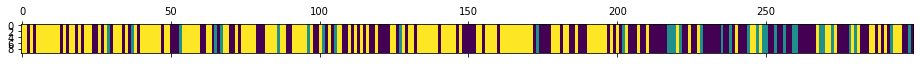

<Figure size 432x288 with 0 Axes>

860
N [[56. 13. 53.]
 [18.  5. 11.]
 [48. 16. 79.]]
alphas [[1.48838187 0.67637954 0.61737028]
 [0.43010511 1.7346563  0.61737028]
 [0.43010511 0.67637954 1.67564704]]
M [[6. 3. 3.]
 [3. 4. 5.]
 [4. 4. 7.]]
sum_w [[5.]
 [4.]
 [6.]]
barM [[1. 3. 3.]
 [3. 0. 5.]
 [4. 4. 1.]]
pi_z [[0.42222004 0.19251358 0.38526637]
 [0.50116599 0.18509687 0.31373713]
 [0.24744377 0.14577624 0.60677999]]
beta_vec [0.46291123 0.21101939 0.32606938]
hyper>> a_k: 3.3242551630793677  gamma: 0.7987105725876401  rho: 0.3567513887242909


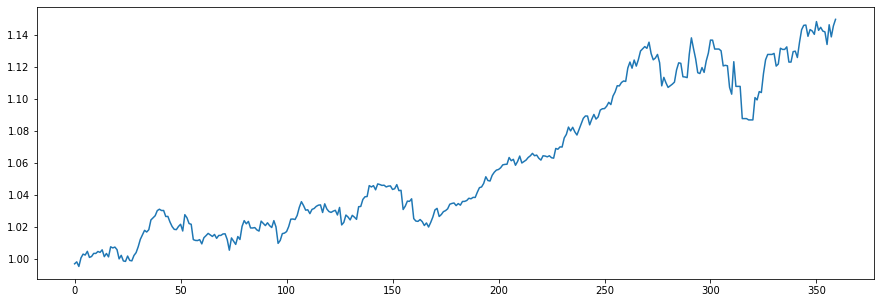

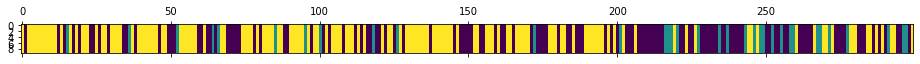

<Figure size 432x288 with 0 Axes>

N [[60. 12. 51.]
 [19.  6.  9.]
 [43. 16. 83.]]
alphas [[2.17578615 0.45122751 0.6972415 ]
 [0.9898535  1.63716016 0.6972415 ]
 [0.9898535  0.45122751 1.88317415]]
M [[10.  1.  3.]
 [ 3.  2.  3.]
 [ 6.  2.  8.]]
sum_w [[5.]
 [1.]
 [5.]]
barM [[5. 1. 3.]
 [3. 1. 3.]
 [6. 2. 3.]]
pi_z [[0.39026429 0.07941383 0.53032189]
 [0.55669445 0.20379129 0.23951427]
 [0.25616006 0.10149605 0.64234389]]
beta_vec [0.38286927 0.10131491 0.51581582]
hyper>> a_k: 4.054867819459526  gamma: 1.5078866715887123  rho: 0.4014055731730302


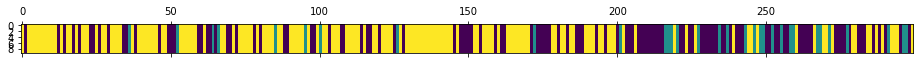

<Figure size 432x288 with 0 Axes>

861
N [[54. 11. 50.]
 [17.  6.  9.]
 [44. 15. 93.]]
alphas [[2.55695498 0.2459137  1.25199913]
 [0.92930844 1.87356024 1.25199913]
 [0.92930844 0.2459137  2.87964568]]
M [[12.  2.  4.]
 [ 2.  3.  3.]
 [ 2.  2. 12.]]
sum_w [[8.]
 [3.]
 [8.]]
barM [[4. 2. 4.]
 [2. 0. 3.]
 [2. 2. 4.]]
pi_z [[0.45438258 0.11206491 0.43355251]
 [0.58354185 0.20559048 0.21086767]
 [0.26343729 0.16125368 0.57530903]]
beta_vec [0.41833612 0.24605317 0.33561071]
hyper>> a_k: 4.571730462068012  gamma: 0.1772507368251925  rho: 0.36783385715925443


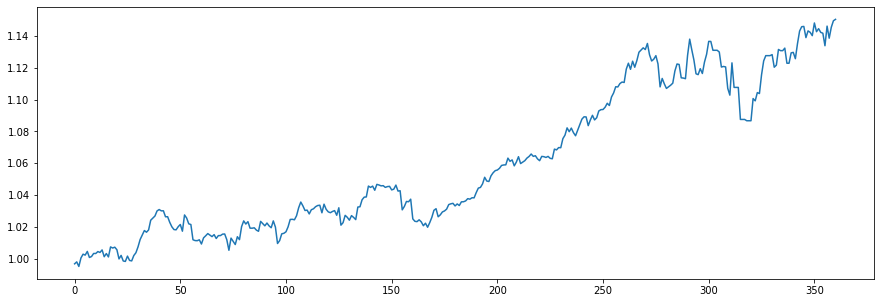

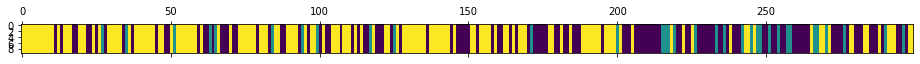

<Figure size 432x288 with 0 Axes>

N [[61. 14. 48.]
 [18.  5. 10.]
 [44. 14. 85.]]
alphas [[2.89066763 0.71111659 0.96994624]
 [1.20903038 2.39275384 0.96994624]
 [1.20903038 0.71111659 2.65158349]]
M [[6. 2. 3.]
 [3. 5. 1.]
 [3. 2. 7.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[4. 2. 3.]
 [3. 2. 1.]
 [3. 2. 2.]]
pi_z [[0.48844681 0.15593851 0.35561468]
 [0.37984943 0.36467501 0.25547556]
 [0.32310317 0.15401123 0.5228856 ]]
beta_vec [0.61507177 0.18949855 0.19542967]
hyper>> a_k: 3.0163760184606714  gamma: 0.5157316541051691  rho: 0.363561918334595


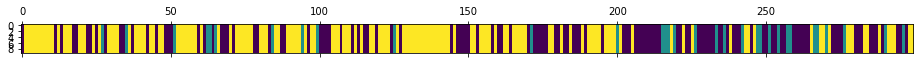

<Figure size 432x288 with 0 Axes>

862
N [[62. 13. 47.]
 [17.  6.  9.]
 [43. 13. 89.]]
alphas [[2.27741522 0.3637873  0.37517349]
 [1.18077577 1.46042676 0.37517349]
 [1.18077577 0.3637873  1.47181294]]
M [[6. 2. 2.]
 [7. 2. 1.]
 [3. 2. 6.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[3. 2. 2.]
 [7. 0. 1.]
 [3. 2. 1.]]
pi_z [[0.4917269  0.14007609 0.36819701]
 [0.49818181 0.24900927 0.25280892]
 [0.30037492 0.1112223  0.58840278]]
beta_vec [0.54383732 0.31518072 0.14098196]
hyper>> a_k: 2.296663290621839  gamma: 0.6623742929474219  rho: 0.33448140205750326


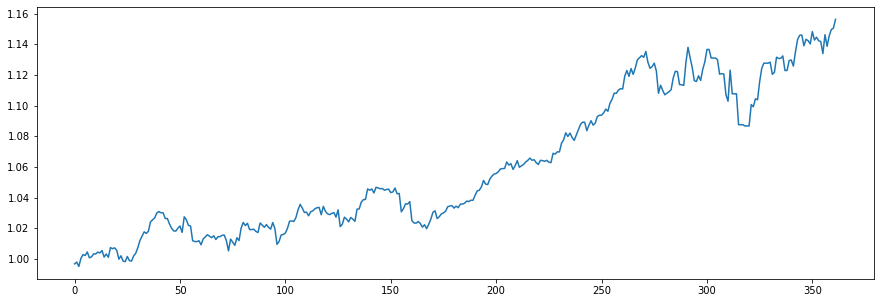

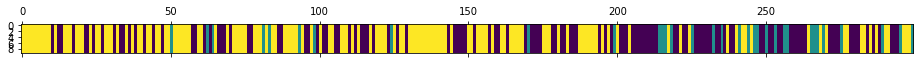

<Figure size 432x288 with 0 Axes>

N [[60. 11. 52.]
 [14.  6. 12.]
 [49. 16. 79.]]
alphas [[1.59943135 0.48174494 0.21548699]
 [0.83124019 1.2499361  0.21548699]
 [0.83124019 0.48174494 0.98367815]]
M [[9. 3. 1.]
 [2. 4. 2.]
 [5. 5. 5.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[6. 3. 1.]
 [2. 3. 2.]
 [5. 5. 1.]]
pi_z [[0.49164756 0.08264914 0.4257033 ]
 [0.41642626 0.25510758 0.32846615]
 [0.40663615 0.08911781 0.50424604]]
beta_vec [0.59321142 0.28749539 0.11929319]
hyper>> a_k: 3.3446075109837468  gamma: 0.14452555596913388  rho: 0.1700550306835842


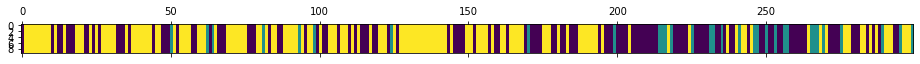

<Figure size 432x288 with 0 Axes>

863
N [[66. 12. 46.]
 [14.  7. 11.]
 [44. 13. 86.]]
alphas [[2.21542743 0.79804126 0.33113883]
 [1.64666009 1.36680859 0.33113883]
 [1.64666009 0.79804126 0.89990616]]
M [[8. 3. 2.]
 [3. 4. 1.]
 [8. 2. 6.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[6. 3. 2.]
 [3. 3. 1.]
 [8. 2. 2.]]
pi_z [[0.64577656 0.08111247 0.27311097]
 [0.50847926 0.12289258 0.36862816]
 [0.35821243 0.0897108  0.55207678]]
beta_vec [0.66478402 0.20996927 0.12524671]
hyper>> a_k: 3.4071146316037164  gamma: 1.1880850450872034  rho: 0.18525631287718727


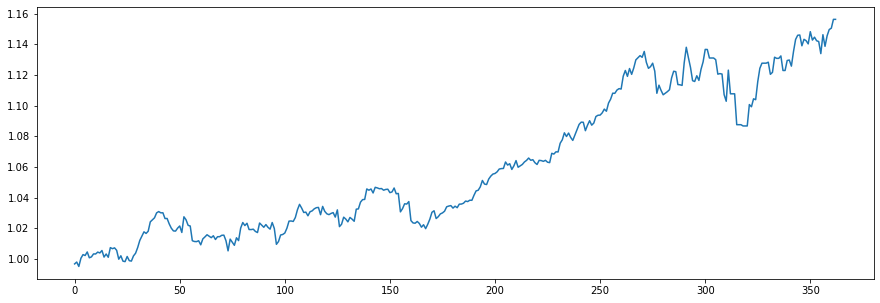

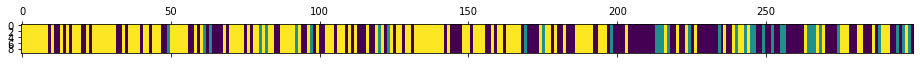

<Figure size 432x288 with 0 Axes>

N [[61. 13. 49.]
 [14.  6. 15.]
 [49. 15. 77.]]
alphas [[2.47658017 0.58285896 0.34767549]
 [1.84539068 1.21404846 0.34767549]
 [1.84539068 0.58285896 0.97886499]]
M [[11.  2.  3.]
 [ 4.  4.  3.]
 [ 8.  4.  6.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[10.  2.  3.]
 [ 4.  2.  3.]
 [ 8.  4.  4.]]
pi_z [[0.50888381 0.0937282  0.39738799]
 [0.28804678 0.26760454 0.44434868]
 [0.41342582 0.09748715 0.48908703]]
beta_vec [0.60169202 0.15299641 0.24531157]
hyper>> a_k: 2.4314649000957  gamma: 0.5628819385492054  rho: 0.07873605678495305


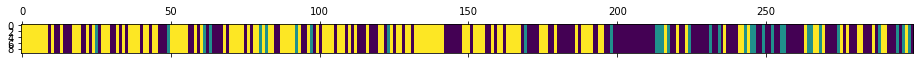

<Figure size 432x288 with 0 Axes>

864
N [[75. 16. 47.]
 [15.  5. 13.]
 [48. 12. 68.]]
alphas [[1.53924668 0.34271517 0.54950305]
 [1.34780272 0.53415913 0.54950305]
 [1.34780272 0.34271517 0.74094701]]
M [[7. 2. 3.]
 [4. 1. 1.]
 [5. 3. 2.]]
sum_w [[2.]
 [1.]
 [0.]]
barM [[5. 2. 3.]
 [4. 0. 1.]
 [5. 3. 2.]]
pi_z [[0.5997073  0.14683379 0.25345891]
 [0.49902729 0.17520884 0.32576387]
 [0.33357342 0.10794659 0.55847999]]
beta_vec [0.57462822 0.26898657 0.15638521]
hyper>> a_k: 2.3531635190599847  gamma: 1.3657974129511394  rho: 0.09874742844890848


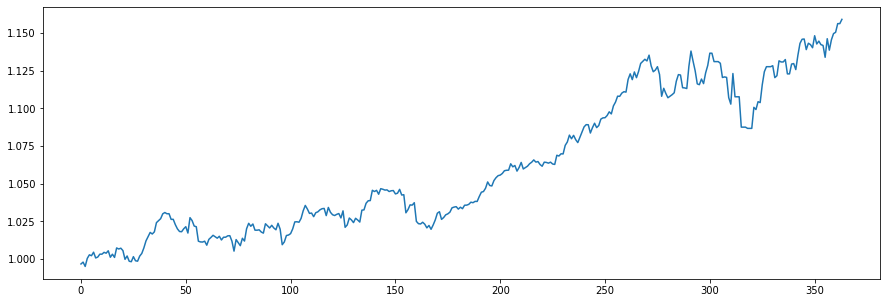

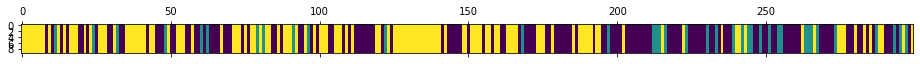

<Figure size 432x288 with 0 Axes>

N [[77. 18. 44.]
 [18.  6. 13.]
 [43. 13. 67.]]
alphas [[1.45103731 0.57046528 0.33166093]
 [1.21866846 0.80283413 0.33166093]
 [1.21866846 0.57046528 0.56402978]]
M [[5. 4. 1.]
 [4. 1. 2.]
 [7. 2. 3.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[5. 4. 1.]
 [4. 1. 2.]
 [7. 2. 2.]]
pi_z [[0.53225462 0.1670822  0.30066317]
 [0.49203229 0.15344374 0.35452397]
 [0.36907179 0.06982207 0.56110614]]
beta_vec [0.49405414 0.29200253 0.21394333]
hyper>> a_k: 2.1766896022440836  gamma: 0.10087622179518106  rho: 0.014845029997979379


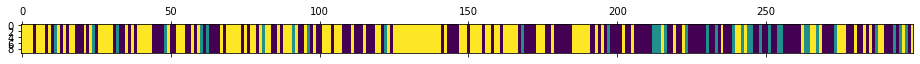

<Figure size 432x288 with 0 Axes>

865
N [[68. 17. 50.]
 [18.  5. 12.]
 [49. 13. 67.]]
alphas [[1.09175115 0.62616338 0.45877507]
 [1.05943813 0.6584764  0.45877507]
 [1.05943813 0.62616338 0.49108809]]
M [[8. 3. 4.]
 [7. 3. 1.]
 [4. 2. 3.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[8. 3. 4.]
 [7. 3. 1.]
 [4. 2. 3.]]
pi_z [[0.47310296 0.12327645 0.40362059]
 [0.37221875 0.19978116 0.42800008]
 [0.47815837 0.14484101 0.37700062]]
beta_vec [0.58424868 0.27812072 0.1376306 ]
hyper>> a_k: 2.505724387599327  gamma: 0.6439349486333242  rho: 0.022444345692138122


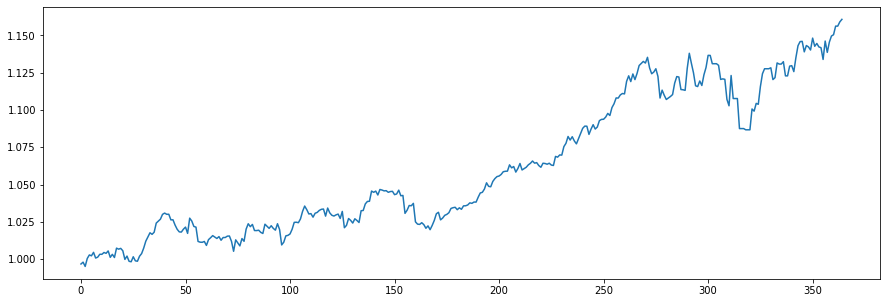

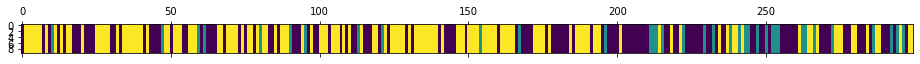

<Figure size 432x288 with 0 Axes>

N [[67. 16. 47.]
 [17.  6. 13.]
 [46. 14. 73.]]
alphas [[1.48734774 0.68125255 0.3371241 ]
 [1.43110839 0.7374919  0.3371241 ]
 [1.43110839 0.68125255 0.39336344]]
M [[7. 3. 4.]
 [4. 2. 1.]
 [4. 2. 2.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[6. 3. 4.]
 [4. 2. 1.]
 [4. 2. 2.]]
pi_z [[0.51048569 0.0793071  0.41020721]
 [0.53750587 0.15597966 0.30651447]
 [0.31417845 0.10692066 0.57890089]]
beta_vec [0.39610267 0.19424573 0.4096516 ]
hyper>> a_k: 2.644779106736828  gamma: 1.2844570362834657  rho: 0.04125896688421947


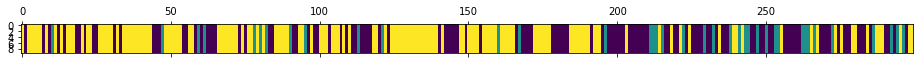

<Figure size 432x288 with 0 Axes>

866
N [[62. 17. 41.]
 [20.  6. 12.]
 [38. 15. 88.]]
alphas [[1.11350186 0.49254078 1.03873647]
 [1.004381   0.60166164 1.03873647]
 [1.004381   0.49254078 1.14785732]]
M [[7. 2. 6.]
 [3. 2. 2.]
 [5. 2. 9.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[7. 2. 6.]
 [3. 2. 2.]
 [5. 2. 7.]]
pi_z [[0.56089237 0.13043668 0.30867095]
 [0.46907238 0.10970805 0.42121956]
 [0.30589272 0.07424032 0.61986696]]
beta_vec [0.58091171 0.14878717 0.27030111]
hyper>> a_k: 3.589900511205963  gamma: 0.6613790551230131  rho: 0.15336988431688806


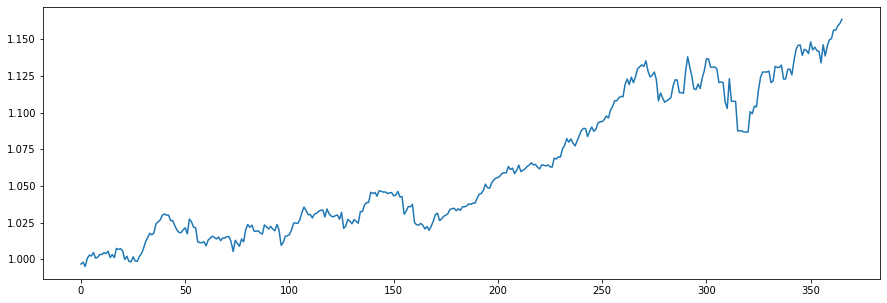

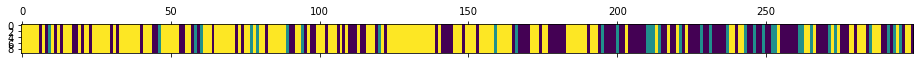

<Figure size 432x288 with 0 Axes>

N [[52. 15. 44.]
 [20.  4. 11.]
 [40. 16. 97.]]
alphas [[2.31615799 0.45221151 0.82153101]
 [1.76557536 1.00279414 0.82153101]
 [1.76557536 0.45221151 1.37211364]]
M [[11.  1.  3.]
 [ 5.  2.  3.]
 [ 6.  2.  8.]]
sum_w [[3.]
 [1.]
 [4.]]
barM [[8. 1. 3.]
 [5. 1. 3.]
 [6. 2. 4.]]
pi_z [[0.52277483 0.11270036 0.3645248 ]
 [0.54547602 0.17207034 0.28245365]
 [0.28035511 0.07580923 0.64383566]]
beta_vec [0.52809166 0.22200653 0.24990181]
hyper>> a_k: 3.5651409027665895  gamma: 0.6182677216318364  rho: 0.21087274920172855


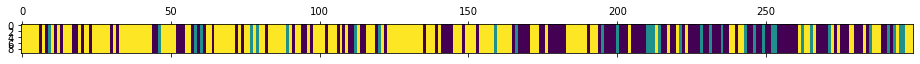

<Figure size 432x288 with 0 Axes>

867
N [[54. 15. 46.]
 [20.  4. 10.]
 [41. 15. 94.]]
alphas [[2.23749766 0.62458203 0.70306121]
 [1.4857066  1.37637309 0.70306121]
 [1.4857066  0.62458203 1.45485228]]
M [[6. 3. 4.]
 [3. 2. 3.]
 [5. 1. 4.]]
sum_w [[0.]
 [2.]
 [4.]]
barM [[6. 3. 4.]
 [3. 0. 3.]
 [5. 1. 0.]]
pi_z [[0.49222519 0.12317515 0.38459967]
 [0.42951751 0.10052903 0.46995347]
 [0.22071646 0.11913414 0.6601494 ]]
beta_vec [0.53263978 0.10776392 0.35959629]
hyper>> a_k: 3.4085441655539865  gamma: 0.7300783703976127  rho: 0.21494861864179157


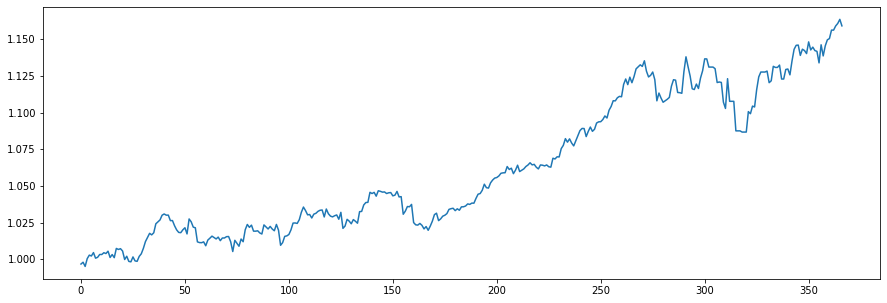

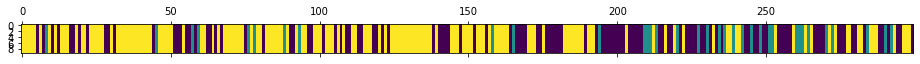

<Figure size 432x288 with 0 Axes>

N [[55. 12. 48.]
 [19.  5. 11.]
 [42. 18. 89.]]
alphas [[2.15794323 0.28836358 0.96223736]
 [1.42528137 1.02102544 0.96223736]
 [1.42528137 0.28836358 1.69489922]]
M [[10.  3.  2.]
 [ 3.  3.  3.]
 [ 5.  1.  9.]]
sum_w [[2.]
 [3.]
 [7.]]
barM [[8. 3. 2.]
 [3. 0. 3.]
 [5. 1. 2.]]
pi_z [[0.43785567 0.1079877  0.45415663]
 [0.6478587  0.13997274 0.21216857]
 [0.27339675 0.21149571 0.51510754]]
beta_vec [0.47605907 0.12111071 0.40283022]
hyper>> a_k: 4.001788553805463  gamma: 0.41921931348362146  rho: 0.29546017237087036


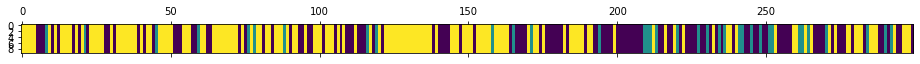

<Figure size 432x288 with 0 Axes>

868
N [[56. 12. 51.]
 [20.  5. 10.]
 [43. 18. 84.]]
alphas [[2.52457932 0.34146189 1.13574735]
 [1.34221018 1.52383102 1.13574735]
 [1.34221018 0.34146189 2.31811648]]
M [[ 4.  3.  3.]
 [ 3.  2.  5.]
 [ 7.  2. 11.]]
sum_w [[2.]
 [2.]
 [7.]]
barM [[2. 3. 3.]
 [3. 0. 5.]
 [7. 2. 4.]]
pi_z [[0.53802899 0.08866157 0.37330944]
 [0.50739377 0.17669442 0.3159118 ]
 [0.24378652 0.15374848 0.602465  ]]
beta_vec [0.46532872 0.15429282 0.38037846]
hyper>> a_k: 2.7825402156571513  gamma: 0.3061879604168287  rho: 0.37875548167383294


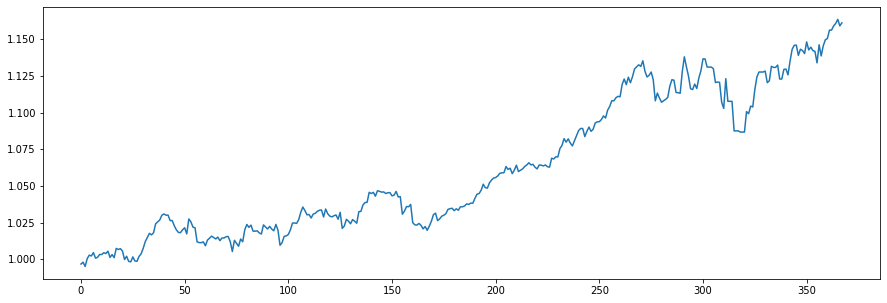

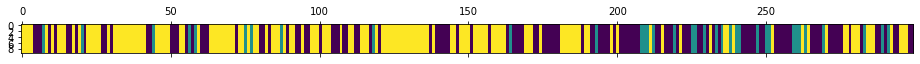

<Figure size 432x288 with 0 Axes>

N [[64. 12. 46.]
 [20.  7.  8.]
 [38. 16. 88.]]
alphas [[1.85828721 0.2667164  0.6575366 ]
 [0.80438485 1.32061876 0.6575366 ]
 [0.80438485 0.2667164  1.71143896]]
M [[7. 1. 2.]
 [3. 1. 2.]
 [7. 3. 4.]]
sum_w [[6.]
 [0.]
 [3.]]
barM [[1. 1. 2.]
 [3. 1. 2.]
 [7. 3. 1.]]
pi_z [[0.60012193 0.07720731 0.32267076]
 [0.49007535 0.33183711 0.17808754]
 [0.28596467 0.11121212 0.60282321]]
beta_vec [0.47436876 0.29653204 0.2290992 ]
hyper>> a_k: 2.6038718074858083  gamma: 0.9450024237663398  rho: 0.2772837413883675


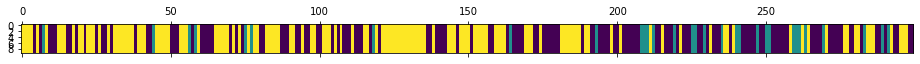

<Figure size 432x288 with 0 Axes>

869
N [[74. 11. 50.]
 [18.  7.  6.]
 [43. 13. 77.]]
alphas [[1.61470715 0.55803193 0.43113273]
 [0.89269584 1.28004324 0.43113273]
 [0.89269584 0.55803193 1.15314404]]
M [[7. 1. 1.]
 [3. 2. 1.]
 [5. 2. 5.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[4. 1. 1.]
 [3. 1. 1.]
 [5. 2. 2.]]
pi_z [[0.54068692 0.08060546 0.37870762]
 [0.54009239 0.22676358 0.23314403]
 [0.36412697 0.06233948 0.57353355]]
beta_vec [0.59889093 0.22556524 0.17554383]
hyper>> a_k: 2.190578753179108  gamma: 1.4193603987158068  rho: 0.22776040524301946


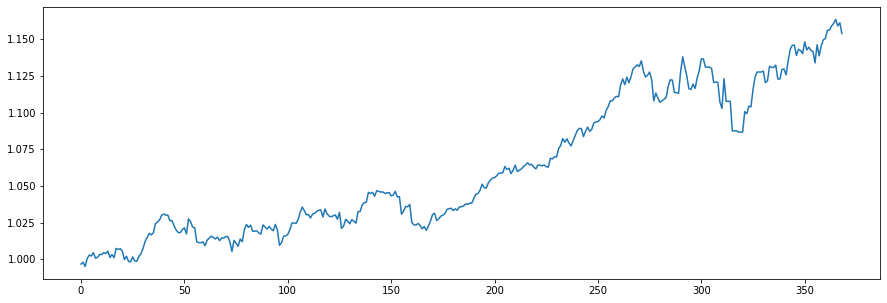

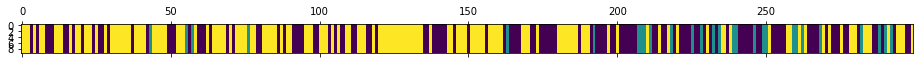

<Figure size 432x288 with 0 Axes>

N [[62. 12. 51.]
 [15.  5.  8.]
 [47. 11. 88.]]
alphas [[1.51204194 0.3815778  0.29695901]
 [1.01311483 0.88050491 0.29695901]
 [1.01311483 0.3815778  0.79588612]]
M [[6. 2. 2.]
 [5. 3. 1.]
 [4. 2. 6.]]
sum_w [[2.]
 [2.]
 [4.]]
barM [[4. 2. 2.]
 [5. 1. 1.]
 [4. 2. 2.]]
pi_z [[0.49576447 0.08246192 0.42177362]
 [0.44010112 0.19459831 0.36530057]
 [0.31432583 0.09018575 0.59548842]]
beta_vec [0.56116401 0.18772328 0.25111271]
hyper>> a_k: 1.6451907307643359  gamma: 0.44453634308965523  rho: 0.25430842294136474


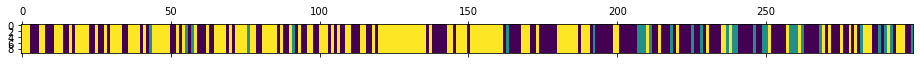

<Figure size 432x288 with 0 Axes>

870
N [[71. 13. 48.]
 [15.  6.  9.]
 [46. 11. 80.]]
alphas [[1.1068246  0.23029984 0.30806629]
 [0.68843874 0.6486857  0.30806629]
 [0.68843874 0.23029984 0.72645215]]
M [[6. 1. 2.]
 [5. 3. 2.]
 [2. 1. 4.]]
sum_w [[1.]
 [2.]
 [4.]]
barM [[5. 1. 2.]
 [5. 1. 2.]
 [2. 1. 0.]]
pi_z [[0.52570624 0.09891688 0.37537688]
 [0.58109781 0.1223367  0.29656549]
 [0.34226018 0.09233334 0.56540648]]
beta_vec [0.67794199 0.23357524 0.08848277]
hyper>> a_k: 2.1270448031508415  gamma: 0.19723164967679882  rho: 0.2493019093092051


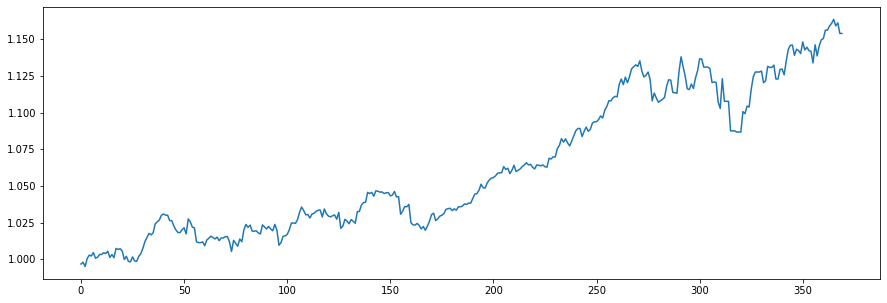

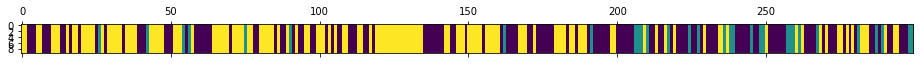

<Figure size 432x288 with 0 Axes>

N [[76. 11. 47.]
 [16.  6.  8.]
 [42. 13. 80.]]
alphas [[1.61279273 0.37296558 0.1412865 ]
 [1.0825164  0.90324191 0.1412865 ]
 [1.0825164  0.37296558 0.67156283]]
M [[7. 2. 1.]
 [2. 1. 1.]
 [5. 2. 3.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[6. 2. 1.]
 [2. 1. 1.]
 [5. 2. 0.]]
pi_z [[0.62283459 0.09715418 0.28001123]
 [0.60387626 0.1984969  0.19762684]
 [0.30628509 0.11372716 0.57998775]]
beta_vec [0.82645153 0.13016439 0.04338408]
hyper>> a_k: 2.3620831121434196  gamma: 0.9706269730926338  rho: 0.35713308214574024


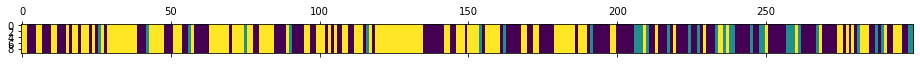

<Figure size 432x288 with 0 Axes>

871
N [[81. 12. 42.]
 [19.  7.  7.]
 [35. 14. 82.]]
alphas [[2.09854888 0.19765529 0.06587895]
 [1.25497086 1.04123331 0.06587895]
 [1.25497086 0.19765529 0.90945697]]
M [[5. 1. 1.]
 [6. 3. 1.]
 [5. 2. 3.]]
sum_w [[2.]
 [3.]
 [3.]]
barM [[3. 1. 1.]
 [6. 0. 1.]
 [5. 2. 0.]]
pi_z [[0.58926324 0.08219223 0.32854453]
 [0.66309767 0.20527716 0.13162517]
 [0.24306433 0.08680023 0.67013544]]
beta_vec [0.86453737 0.08670959 0.04875304]
hyper>> a_k: 2.4194426120107995  gamma: 1.0758470384434033  rho: 0.41305559027568906


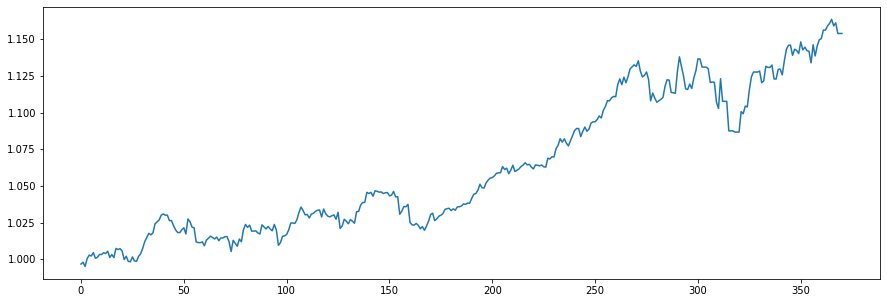

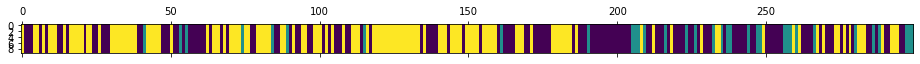

<Figure size 432x288 with 0 Axes>

N [[76. 14. 46.]
 [20.  7.  6.]
 [40. 12. 78.]]
alphas [[2.22707507 0.12313441 0.06923313]
 [1.22771077 1.12249871 0.06923313]
 [1.22771077 0.12313441 1.06859743]]
M [[9. 2. 3.]
 [5. 2. 1.]
 [5. 2. 4.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[6. 2. 3.]
 [5. 0. 1.]
 [5. 2. 0.]]
pi_z [[0.62859315 0.08603056 0.28537629]
 [0.53119052 0.24953389 0.21927559]
 [0.32443931 0.10586719 0.56969351]]
beta_vec [0.75994994 0.13462366 0.10542639]
hyper>> a_k: 2.704168771874403  gamma: 2.486876224305017  rho: 0.2860099036103768


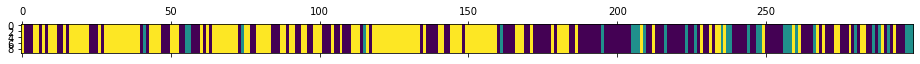

<Figure size 432x288 with 0 Axes>

872
N [[79. 14. 44.]
 [19.  9.  4.]
 [39.  9. 82.]]
alphas [[2.24069219 0.2599246  0.20355198]
 [1.46727314 1.03334365 0.20355198]
 [1.46727314 0.2599246  0.97697103]]
M [[4. 1. 1.]
 [6. 5. 2.]
 [4. 1. 7.]]
sum_w [[0.]
 [3.]
 [5.]]
barM [[4. 1. 1.]
 [6. 2. 2.]
 [4. 1. 2.]]
pi_z [[0.64920993 0.06429173 0.28649834]
 [0.69790168 0.23859939 0.06349893]
 [0.29841263 0.07861748 0.62296989]]
beta_vec [0.70349004 0.13085268 0.16565729]
hyper>> a_k: 2.7747241318981932  gamma: 0.36231092572650997  rho: 0.1939790720814635


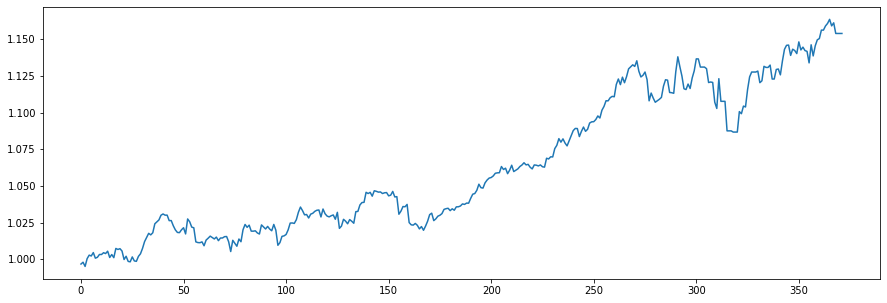

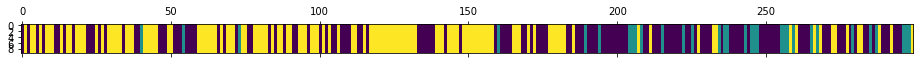

<Figure size 432x288 with 0 Axes>

N [[78. 14. 47.]
 [19.  9.  4.]
 [42.  8. 78.]]
alphas [[2.11158383 0.29265014 0.37049016]
 [1.57334542 0.83088856 0.37049016]
 [1.57334542 0.29265014 0.90872857]]
M [[13.  3.  2.]
 [ 3.  3.  1.]
 [ 6.  1.  6.]]
sum_w [[3.]
 [2.]
 [6.]]
barM [[10.  3.  2.]
 [ 3.  1.  1.]
 [ 6.  1.  0.]]
pi_z [[0.54521826 0.07757563 0.37720611]
 [0.54855398 0.22468766 0.22675836]
 [0.29576261 0.0699436  0.63429379]]
beta_vec [0.72925848 0.07355543 0.1971861 ]
hyper>> a_k: 2.603883900376708  gamma: 2.4598994780984924  rho: 0.2618966793478719


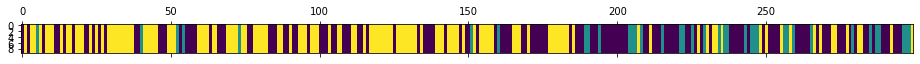

<Figure size 432x288 with 0 Axes>

873
N [[74. 15. 46.]
 [18. 11.  8.]
 [43. 11. 73.]]
alphas [[2.08353619 0.14136877 0.37897894]
 [1.40158764 0.82331732 0.37897894]
 [1.40158764 0.14136877 1.06092748]]
M [[7. 1. 4.]
 [6. 3. 2.]
 [9. 1. 6.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[6. 1. 4.]
 [6. 1. 2.]
 [9. 1. 4.]]
pi_z [[0.55299632 0.09246626 0.35453743]
 [0.54895987 0.16914949 0.28189063]
 [0.32698907 0.05863405 0.61437689]]
beta_vec [0.5479211  0.09439141 0.35768748]
hyper>> a_k: 4.558598445536076  gamma: 0.708427792272617  rho: 0.1242189785830185


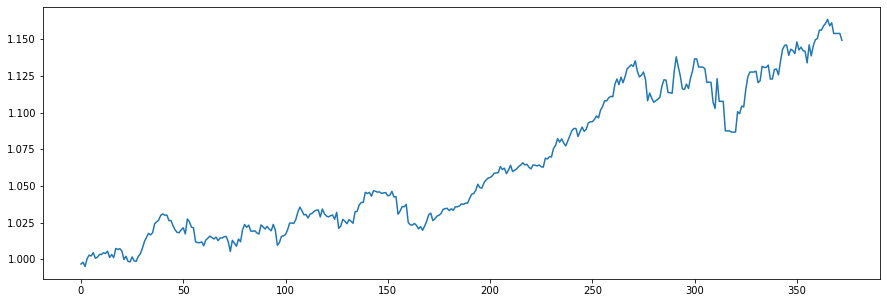

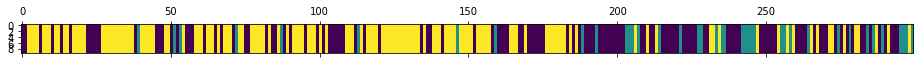

<Figure size 432x288 with 0 Axes>

N [[66. 15. 44.]
 [19. 11.  8.]
 [40. 13. 83.]]
alphas [[2.75374849 0.37684205 1.42800791]
 [2.18748405 0.94310649 1.42800791]
 [2.18748405 0.37684205 1.99427235]]
M [[9. 1. 6.]
 [4. 3. 3.]
 [8. 3. 3.]]
sum_w [[5.]
 [2.]
 [1.]]
barM [[4. 1. 6.]
 [4. 1. 3.]
 [8. 3. 2.]]
pi_z [[0.5492171  0.15789204 0.29289086]
 [0.50592262 0.33340332 0.16067406]
 [0.25743843 0.07919398 0.66336758]]
beta_vec [0.5393043  0.20491667 0.25577903]
hyper>> a_k: 4.325644888699386  gamma: 0.5926607876286766  rho: 0.1789545976668119


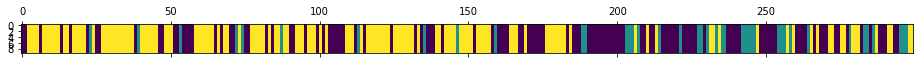

<Figure size 432x288 with 0 Axes>

874
N [[68. 12. 40.]
 [19. 14.  8.]
 [33. 16. 89.]]
alphas [[2.68946069 0.72777196 0.90841224]
 [1.91536665 1.501866   0.90841224]
 [1.91536665 0.72777196 1.68250628]]
M [[11.  2.  4.]
 [ 4.  5.  1.]
 [11.  3.  8.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[ 9.  2.  4.]
 [ 4.  4.  1.]
 [11.  3.  4.]]
pi_z [[0.55306848 0.11490388 0.33202763]
 [0.56560739 0.29336876 0.14102384]
 [0.19116384 0.11643046 0.6924057 ]]
beta_vec [0.49264071 0.21284494 0.29451435]
hyper>> a_k: 4.515668631163364  gamma: 0.2907637604597136  rho: 0.14974566968408623


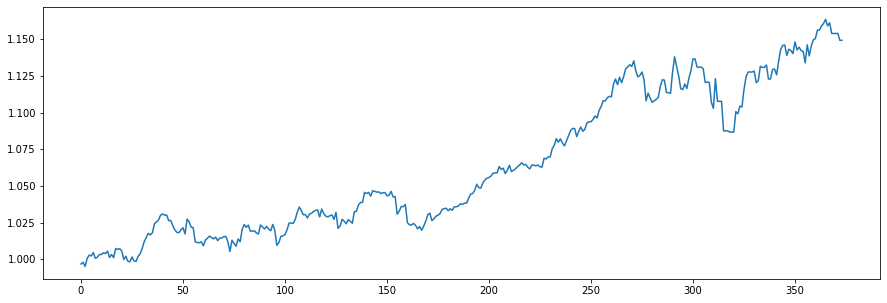

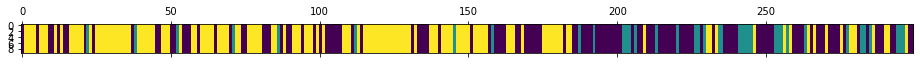

<Figure size 432x288 with 0 Axes>

N [[72. 11. 43.]
 [21. 13.  4.]
 [33. 14. 88.]]
alphas [[2.56767948 0.81721108 1.13077807]
 [1.89147766 1.4934129  1.13077807]
 [1.89147766 0.81721108 1.8069799 ]]
M [[ 8.  3.  4.]
 [ 5.  3.  3.]
 [10.  5.  7.]]
sum_w [[2.]
 [3.]
 [1.]]
barM [[ 6.  3.  4.]
 [ 5.  0.  3.]
 [10.  5.  6.]]
pi_z [[0.54043618 0.1405179  0.31904592]
 [0.55351932 0.35277742 0.09370325]
 [0.25128176 0.13542247 0.61329577]]
beta_vec [0.63281503 0.15303151 0.21415346]
hyper>> a_k: 4.00495013666949  gamma: 0.24750120443406956  rho: 0.15599462409519008


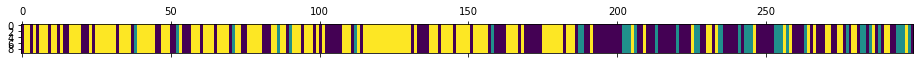

<Figure size 432x288 with 0 Axes>

875
N [[64. 12. 46.]
 [19. 12.  6.]
 [39. 13. 88.]]
alphas [[2.7637917  0.51727704 0.7238814 ]
 [2.13904101 1.14202773 0.7238814 ]
 [2.13904101 0.51727704 1.34863209]]
M [[6. 1. 3.]
 [7. 2. 1.]
 [9. 2. 3.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[5. 1. 3.]
 [7. 1. 1.]
 [9. 2. 2.]]
pi_z [[0.49770224 0.10778263 0.39451513]
 [0.59834879 0.17673456 0.22491665]
 [0.34336888 0.06886192 0.5877692 ]]
beta_vec [0.71597308 0.07435433 0.20967259]
hyper>> a_k: 2.757123081893226  gamma: 0.14604687354211965  rho: 0.16445165965135264


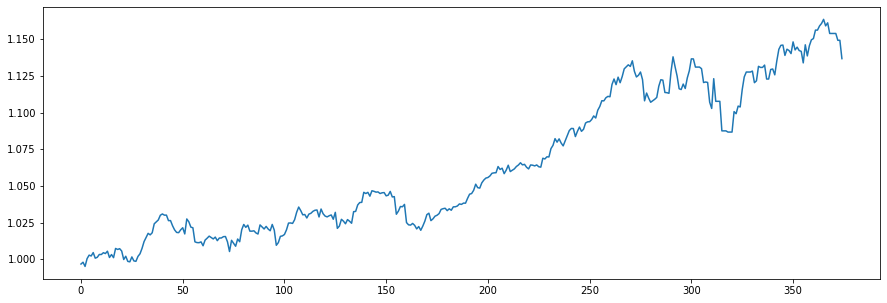

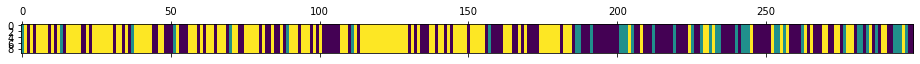

<Figure size 432x288 with 0 Axes>

N [[61. 13. 50.]
 [21. 10.  8.]
 [42. 16. 78.]]
alphas [[2.10280753 0.1712908  0.48302476]
 [1.64939406 0.62470426 0.48302476]
 [1.64939406 0.1712908  0.93643822]]
M [[5. 1. 2.]
 [3. 2. 1.]
 [4. 2. 3.]]
sum_w [[0.]
 [2.]
 [3.]]
barM [[5. 1. 2.]
 [3. 0. 1.]
 [4. 2. 0.]]
pi_z [[0.53738519 0.12361852 0.3389963 ]
 [0.42509558 0.36425053 0.21065389]
 [0.31685661 0.06249609 0.6206473 ]]
beta_vec [0.66728615 0.21958699 0.11312686]
hyper>> a_k: 1.2604498441597254  gamma: 0.7844254843232693  rho: 0.2212926718537599


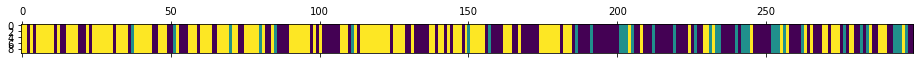

<Figure size 432x288 with 0 Axes>

876
N [[73. 13. 43.]
 [18.  9.  9.]
 [38. 14. 82.]]
alphas [[0.93388403 0.21552936 0.11103645]
 [0.65495572 0.49445767 0.11103645]
 [0.65495572 0.21552936 0.38996476]]
M [[8. 1. 1.]
 [2. 2. 2.]
 [4. 3. 2.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[6. 1. 1.]
 [2. 1. 2.]
 [4. 3. 0.]]
pi_z [[0.58418983 0.10701178 0.30879839]
 [0.46197703 0.30876463 0.22925834]
 [0.34478395 0.13751421 0.51770184]]
beta_vec [0.58912081 0.27433327 0.13654592]
hyper>> a_k: 1.8045602894293487  gamma: 1.325032657239729  rho: 0.271380696572987


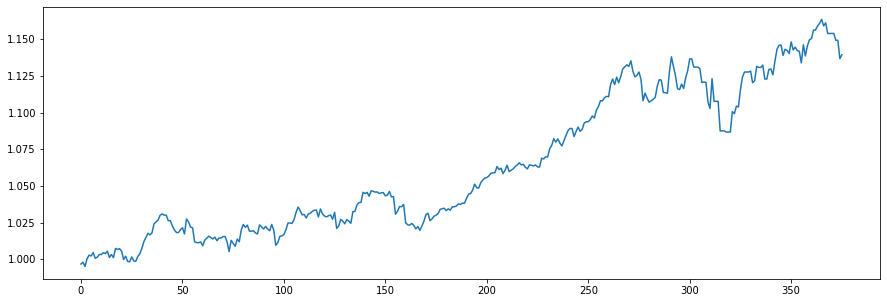

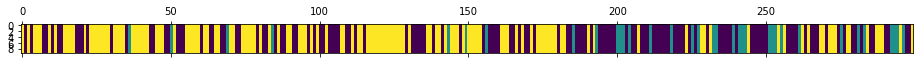

<Figure size 432x288 with 0 Axes>

N [[66. 14. 52.]
 [19.  9.  7.]
 [46. 12. 74.]]
alphas [[1.26432094 0.36070366 0.17953569]
 [0.77459811 0.85042649 0.17953569]
 [0.77459811 0.36070366 0.66925852]]
M [[4. 2. 1.]
 [3. 3. 2.]
 [1. 1. 2.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[3. 2. 1.]
 [3. 2. 2.]
 [1. 1. 1.]]
pi_z [[0.51039063 0.08763143 0.40197794]
 [0.49962751 0.26565441 0.23471808]
 [0.46759178 0.09297789 0.43943032]]
beta_vec [0.45114663 0.39386328 0.15499009]
hyper>> a_k: 1.083122184414291  gamma: 0.9604992315676705  rho: 0.20468696041378864


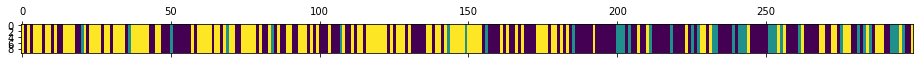

<Figure size 432x288 with 0 Axes>

877
N [[71. 14. 53.]
 [19.  9.  9.]
 [48. 14. 62.]]
alphas [[0.61032825 0.33928218 0.13351175]
 [0.38862727 0.56098317 0.13351175]
 [0.38862727 0.33928218 0.35521274]]
M [[5. 3. 3.]
 [2. 6. 2.]
 [1. 2. 1.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[2. 3. 3.]
 [2. 5. 2.]
 [1. 2. 0.]]
pi_z [[0.57028873 0.1214171  0.30829417]
 [0.39115151 0.17005782 0.43879067]
 [0.34990288 0.11763898 0.53245814]]
beta_vec [0.10661112 0.51866917 0.37471971]
hyper>> a_k: 1.805924708002931  gamma: 0.7083439185091401  rho: 0.30880565045506275


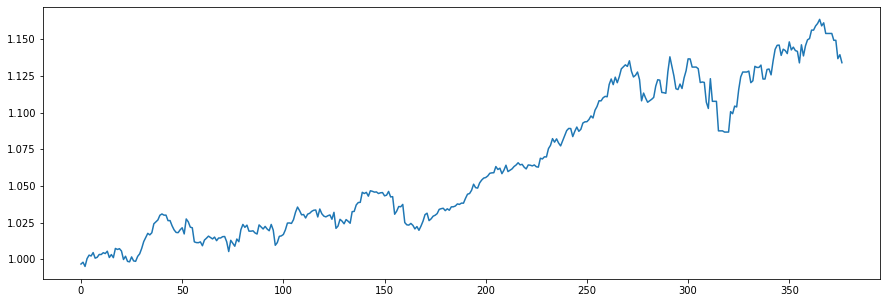

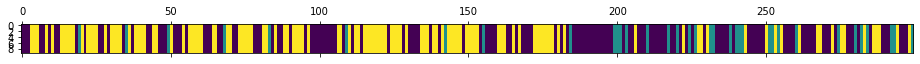

<Figure size 432x288 with 0 Axes>

N [[81. 14. 48.]
 [21.  7.  6.]
 [41. 14. 67.]]
alphas [[0.69075655 0.64742617 0.46774199]
 [0.13307679 1.20510592 0.46774199]
 [0.13307679 0.64742617 1.02542175]]
M [[2. 1. 4.]
 [1. 3. 2.]
 [1. 2. 2.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[1. 1. 4.]
 [1. 2. 2.]
 [1. 2. 1.]]
pi_z [[0.60280739 0.07549513 0.32169748]
 [0.594754   0.26397313 0.14127287]
 [0.24877809 0.10487797 0.64634394]]
beta_vec [0.37038804 0.15379479 0.47581716]
hyper>> a_k: 1.3625966194258634  gamma: 1.0189019409207163  rho: 0.12928342404897536


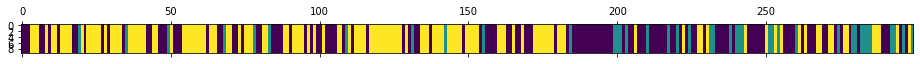

<Figure size 432x288 with 0 Axes>

878
N [[66. 17. 45.]
 [22. 11.  7.]
 [40. 12. 79.]]
alphas [[0.61560267 0.1824676  0.56452636]
 [0.43944151 0.35862875 0.56452636]
 [0.43944151 0.1824676  0.74068751]]
M [[3. 2. 4.]
 [2. 1. 4.]
 [2. 1. 5.]]
sum_w [[0.]
 [0.]
 [3.]]
barM [[3. 2. 4.]
 [2. 1. 4.]
 [2. 1. 2.]]
pi_z [[0.50452302 0.15622095 0.33925603]
 [0.47706312 0.34288522 0.18005165]
 [0.26915112 0.05700791 0.67384097]]
beta_vec [0.21221225 0.26481424 0.52297351]
hyper>> a_k: 2.084920253999593  gamma: 0.3353914259734017  rho: 0.09440514057021039


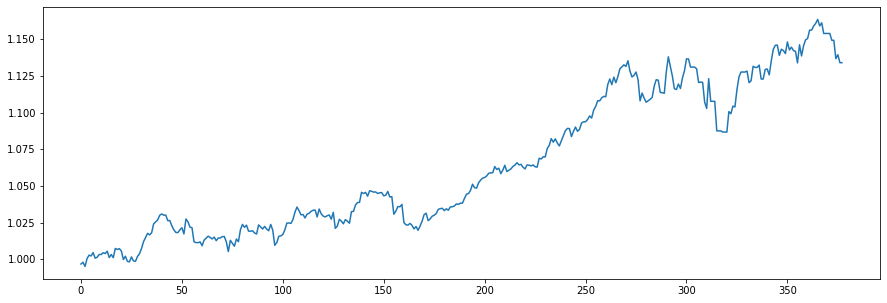

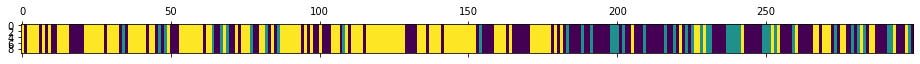

<Figure size 432x288 with 0 Axes>

N [[64. 20. 39.]
 [24. 10.  9.]
 [36. 12. 85.]]
alphas [[0.59750367 0.49999393 0.98742265]
 [0.40067648 0.69682112 0.98742265]
 [0.40067648 0.49999393 1.18424984]]
M [[1. 3. 7.]
 [2. 1. 2.]
 [3. 2. 6.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[0. 3. 7.]
 [2. 1. 2.]
 [3. 2. 5.]]
pi_z [[0.59525519 0.1213701  0.2833747 ]
 [0.69078492 0.13945481 0.16976027]
 [0.19505386 0.08780314 0.71714301]]
beta_vec [0.19599713 0.30559082 0.49841206]
hyper>> a_k: 2.1719266699064597  gamma: 0.12979050836114522  rho: 0.07415964558855656


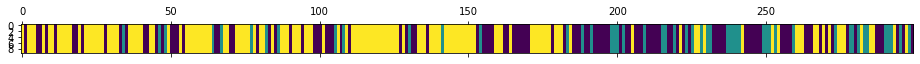

<Figure size 432x288 with 0 Axes>

879
N [[54. 18. 40.]
 [27. 14.  9.]
 [31. 18. 88.]]
alphas [[0.55519158 0.61449954 1.00223555]
 [0.39412226 0.77556885 1.00223555]
 [0.39412226 0.61449954 1.16330487]]
M [[5. 2. 2.]
 [3. 1. 3.]
 [4. 2. 6.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[4. 2. 2.]
 [3. 1. 3.]
 [4. 2. 6.]]
pi_z [[0.50822772 0.16103578 0.3307365 ]
 [0.51850641 0.23252651 0.24896707]
 [0.22254439 0.1384005  0.63905511]]
beta_vec [0.56292527 0.15029628 0.28677845]
hyper>> a_k: 2.55034066890922  gamma: 0.8452924656972917  rho: 0.02873790843422782


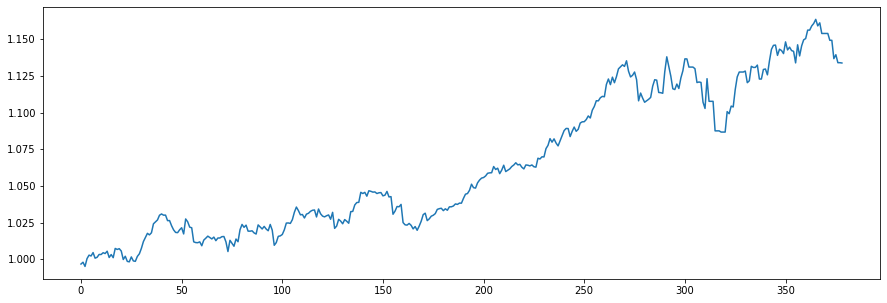

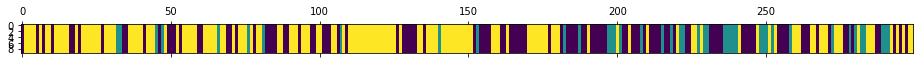

<Figure size 432x288 with 0 Axes>

N [[58. 13. 41.]
 [15. 14. 13.]
 [39. 15. 91.]]
alphas [[1.46768506 0.37229128 0.71036432]
 [1.39439361 0.44558274 0.71036432]
 [1.39439361 0.37229128 0.78365578]]
M [[6. 1. 4.]
 [3. 3. 2.]
 [4. 5. 3.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[6. 1. 4.]
 [3. 3. 2.]
 [4. 5. 2.]]
pi_z [[0.55425941 0.0794211  0.36631949]
 [0.38792858 0.29461287 0.31745856]
 [0.27795948 0.14826057 0.57377995]]
beta_vec [0.53869636 0.24282826 0.21847538]
hyper>> a_k: 2.5315013408605034  gamma: 0.4418600793670292  rho: 0.03214495657583073


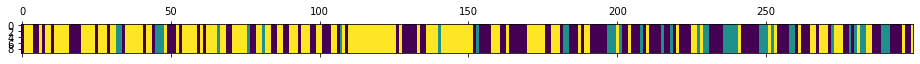

<Figure size 432x288 with 0 Axes>

880
N [[66. 12. 41.]
 [15. 17. 10.]
 [38. 13. 87.]]
alphas [[1.40124914 0.59495992 0.53529229]
 [1.31987414 0.67633492 0.53529229]
 [1.31987414 0.59495992 0.61666729]]
M [[9. 2. 4.]
 [4. 3. 3.]
 [9. 2. 4.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[8. 2. 4.]
 [4. 3. 3.]
 [9. 2. 3.]]
pi_z [[0.65837799 0.05980748 0.28181453]
 [0.46918998 0.31343361 0.21737642]
 [0.22213761 0.07711089 0.7007515 ]]
beta_vec [0.56655261 0.16023721 0.27321018]
hyper>> a_k: 3.462247752239014  gamma: 0.6001264085903985  rho: 0.08821964710396696


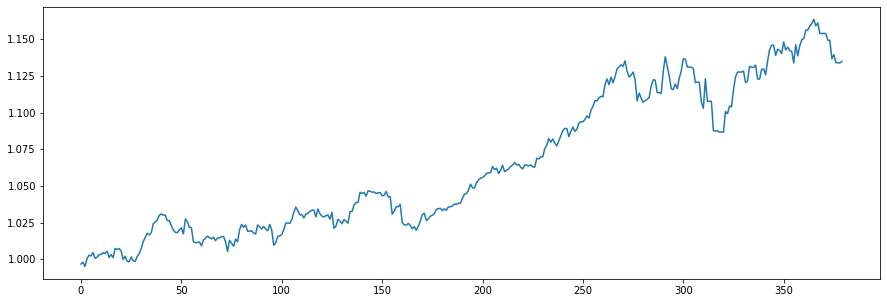

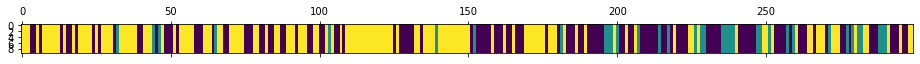

<Figure size 432x288 with 0 Axes>

N [[68.  9. 46.]
 [16. 11.  9.]
 [39. 16. 85.]]
alphas [[2.09393692 0.50583835 0.86247248]
 [1.78849864 0.81127663 0.86247248]
 [1.78849864 0.50583835 1.16791076]]
M [[8. 1. 1.]
 [4. 3. 2.]
 [5. 2. 9.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[6. 1. 1.]
 [4. 1. 2.]
 [5. 2. 8.]]
pi_z [[0.61775055 0.04752114 0.33472831]
 [0.45723039 0.32103556 0.22173405]
 [0.23507286 0.15829862 0.60662852]]
beta_vec [0.46671338 0.12804101 0.40524561]
hyper>> a_k: 3.723221161428952  gamma: 1.3431999091958413  rho: 0.2152233169745932


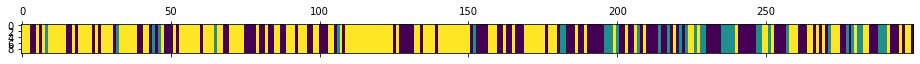

<Figure size 432x288 with 0 Axes>

881
N [[59. 10. 48.]
 [18. 12.  8.]
 [39. 16. 89.]]
alphas [[2.16501252 0.37412266 1.18408599]
 [1.36368851 1.17544666 1.18408599]
 [1.36368851 0.37412266 1.98541   ]]
M [[10.  1.  9.]
 [ 3.  2.  2.]
 [ 5.  2.  4.]]
sum_w [[3.]
 [1.]
 [0.]]
barM [[7. 1. 9.]
 [3. 1. 2.]
 [5. 2. 4.]]
pi_z [[0.51244707 0.10017547 0.38737746]
 [0.45322528 0.34164694 0.20512778]
 [0.25922061 0.07892311 0.66185629]]
beta_vec [0.41836222 0.1769056  0.40473218]
hyper>> a_k: 3.110145293984988  gamma: 0.3204025858493504  rho: 0.08204957351367345


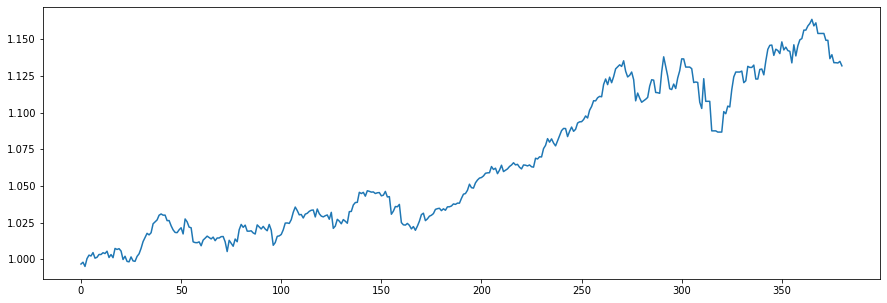

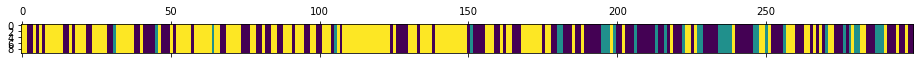

<Figure size 432x288 with 0 Axes>

N [[68.  8. 48.]
 [17. 12.  5.]
 [39. 14. 88.]]
alphas [[1.44959316 0.50505827 1.15549386]
 [1.19440706 0.76024437 1.15549386]
 [1.19440706 0.50505827 1.41067996]]
M [[5. 3. 7.]
 [3. 2. 1.]
 [3. 1. 9.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[5. 3. 7.]
 [3. 1. 1.]
 [3. 1. 8.]]
pi_z [[0.57843076 0.04397933 0.3775899 ]
 [0.45325271 0.47978529 0.066962  ]
 [0.28525761 0.09080535 0.62393705]]
beta_vec [0.38398585 0.0554055  0.56060865]
hyper>> a_k: 2.246235760229372  gamma: 1.1928599929713712  rho: 0.16035055648726987


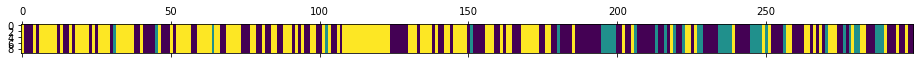

<Figure size 432x288 with 0 Axes>

882
N [[75.  9. 48.]
 [15. 15.  7.]
 [42. 13. 75.]]
alphas [[1.08440191 0.10449758 1.05733628]
 [0.72421675 0.46468273 1.05733628]
 [0.72421675 0.10449758 1.41752143]]
M [[ 3.  1.  4.]
 [ 4.  1.  2.]
 [ 5.  2. 11.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[2. 1. 4.]
 [4. 0. 2.]
 [5. 2. 9.]]
pi_z [[0.51812276 0.12243076 0.35944647]
 [0.36672472 0.38609897 0.24717631]
 [0.31443784 0.09431122 0.59125094]]
beta_vec [0.25739937 0.16611071 0.57648991]
hyper>> a_k: 3.093899113111509  gamma: 2.053889455069686  rho: 0.21500346749327423


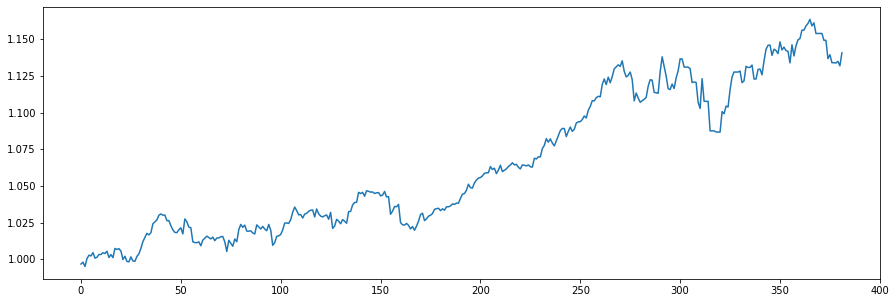

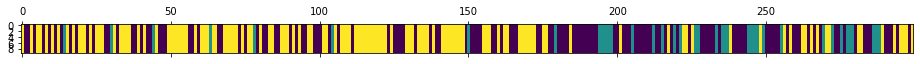

<Figure size 432x288 with 0 Axes>

N [[64. 14. 55.]
 [20. 14.  5.]
 [48. 11. 68.]]
alphas [[1.29034492 0.4034331  1.4001211 ]
 [0.62514588 1.06863213 1.4001211 ]
 [0.62514588 0.4034331  2.06532014]]
M [[8. 2. 5.]
 [1. 1. 2.]
 [3. 1. 6.]]
sum_w [[5.]
 [1.]
 [3.]]
barM [[3. 2. 5.]
 [1. 0. 2.]
 [3. 1. 3.]]
pi_z [[0.4567655  0.0842316  0.4590029 ]
 [0.4766347  0.32183425 0.20153106]
 [0.26243197 0.10117867 0.63638936]]
beta_vec [0.21082558 0.04860013 0.74057428]
hyper>> a_k: 1.955683182714206  gamma: 1.3009236063619511  rho: 0.41014749230441655


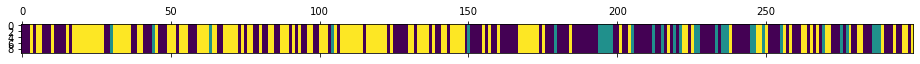

<Figure size 432x288 with 0 Axes>

883
N [[77. 10. 53.]
 [18. 10.  4.]
 [45. 12. 70.]]
alphas [[1.04531949 0.0560634  0.8543003 ]
 [0.24320094 0.85818195 0.8543003 ]
 [0.24320094 0.0560634  1.65641885]]
M [[ 5.  1.  2.]
 [ 1.  4.  2.]
 [ 1.  1. 10.]]
sum_w [[3.]
 [4.]
 [5.]]
barM [[2. 1. 2.]
 [1. 0. 2.]
 [1. 1. 5.]]
pi_z [[0.53657294 0.11320792 0.35021913]
 [0.52382283 0.38333846 0.09283871]
 [0.34511676 0.17343185 0.48145138]]
beta_vec [0.40488515 0.12635629 0.46875856]
hyper>> a_k: 2.234479253363606  gamma: 0.5837805366787056  rho: 0.37170913393376204


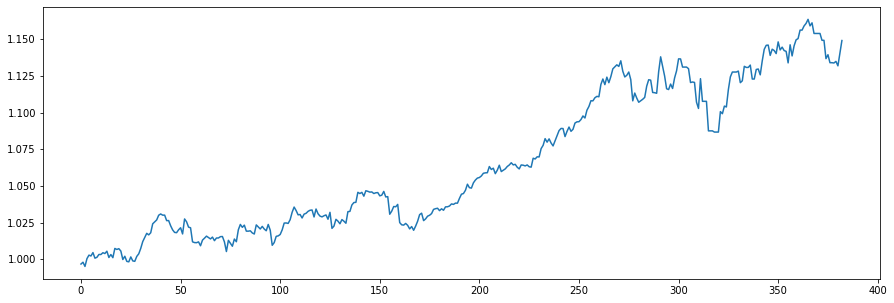

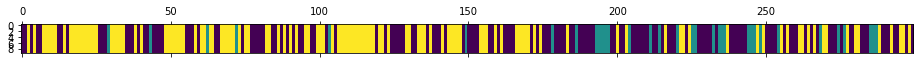

<Figure size 432x288 with 0 Axes>

N [[79. 11. 52.]
 [18. 11.  5.]
 [46. 12. 65.]]
alphas [[1.39899579 0.17739196 0.6580915 ]
 [0.56841944 1.00796831 0.6580915 ]
 [0.56841944 0.17739196 1.48866785]]
M [[5. 2. 4.]
 [2. 3. 3.]
 [2. 1. 3.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[3. 2. 4.]
 [2. 2. 3.]
 [2. 1. 1.]]
pi_z [[0.62269821 0.06416267 0.31313912]
 [0.46991881 0.35026484 0.17981635]
 [0.37423263 0.070135   0.55563237]]
beta_vec [0.33277114 0.15654517 0.51068369]
hyper>> a_k: 2.42460858322767  gamma: 0.44969412178080087  rho: 0.18869302158374934


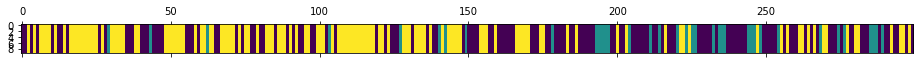

<Figure size 432x288 with 0 Axes>

884
N [[73. 14. 49.]
 [20. 11.  6.]
 [43. 12. 71.]]
alphas [[1.11210146 0.30794029 1.00456684]
 [0.65459474 0.76544701 1.00456684]
 [0.65459474 0.30794029 1.46207356]]
M [[4. 2. 6.]
 [3. 2. 2.]
 [5. 2. 2.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[2. 2. 6.]
 [3. 2. 2.]
 [5. 2. 2.]]
pi_z [[0.45923866 0.12176721 0.41899413]
 [0.38634144 0.4818231  0.13183546]
 [0.33600912 0.05496592 0.60902495]]
beta_vec [0.48195838 0.18574391 0.33229771]
hyper>> a_k: 2.528789843042498  gamma: 2.014636089068271  rho: 0.16192129470776437


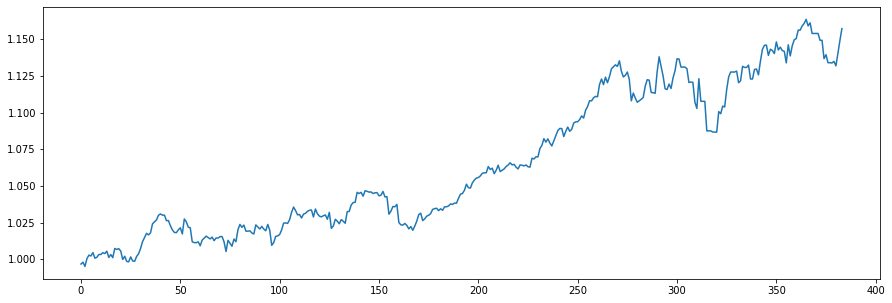

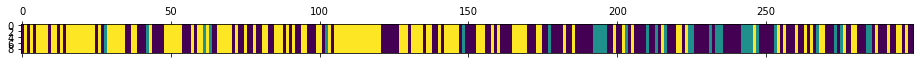

<Figure size 432x288 with 0 Axes>

N [[74. 14. 51.]
 [16. 11.  6.]
 [49.  8. 70.]]
alphas [[1.43089133 0.39365169 0.70424682]
 [1.02142641 0.80311662 0.70424682]
 [1.02142641 0.39365169 1.11371174]]
M [[6. 1. 2.]
 [2. 2. 2.]
 [5. 1. 6.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[5. 1. 2.]
 [2. 2. 2.]
 [5. 1. 2.]]
pi_z [[0.54119441 0.07756046 0.38124512]
 [0.37286369 0.3117001  0.31543621]
 [0.38073247 0.04448596 0.57478157]]
beta_vec [0.50684836 0.1516563  0.34149533]
hyper>> a_k: 1.5056324473667506  gamma: 1.7158510013892743  rho: 0.1746808838946319


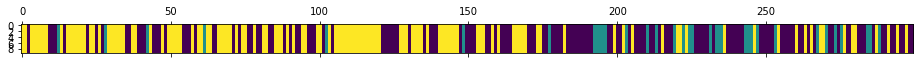

<Figure size 432x288 with 0 Axes>

885
N [[78. 13. 48.]
 [18. 10.  7.]
 [43. 12. 70.]]
alphas [[0.89282879 0.18845225 0.4243514 ]
 [0.62982358 0.45145746 0.4243514 ]
 [0.62982358 0.18845225 0.68735661]]
M [[3. 1. 3.]
 [3. 1. 3.]
 [5. 1. 3.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[3. 1. 3.]
 [3. 0. 3.]
 [5. 1. 2.]]
pi_z [[0.59415958 0.08837721 0.31746321]
 [0.54561257 0.274709   0.17967844]
 [0.34629984 0.07977121 0.57392895]]
beta_vec [0.49493584 0.06773485 0.43732932]
hyper>> a_k: 2.2997779738592365  gamma: 1.03461241557466  rho: 0.24264136336130107


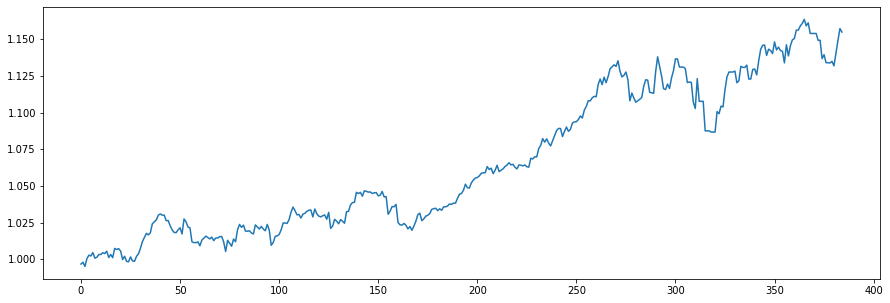

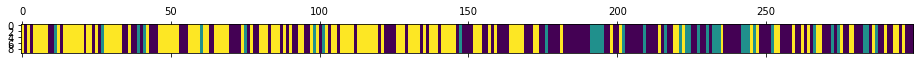

<Figure size 432x288 with 0 Axes>

N [[71. 14. 50.]
 [19. 10.  8.]
 [45. 13. 69.]]
alphas [[1.42007908 0.11797762 0.76172128]
 [0.86205781 0.67599888 0.76172128]
 [0.86205781 0.11797762 1.31974254]]
M [[6. 1. 1.]
 [2. 1. 4.]
 [5. 1. 3.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[4. 1. 1.]
 [2. 0. 4.]
 [5. 1. 1.]]
pi_z [[0.50235779 0.11295472 0.38468749]
 [0.4178738  0.34672758 0.23539862]
 [0.34287546 0.12277971 0.53434483]]
beta_vec [0.64840696 0.08423285 0.26736019]
hyper>> a_k: 2.595972056394992  gamma: 0.8363279412487848  rho: 0.24008974955915227


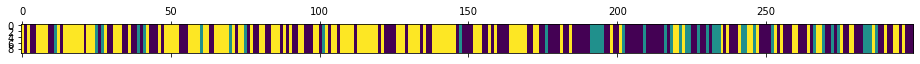

<Figure size 432x288 with 0 Axes>

886
N [[69. 15. 48.]
 [19. 10. 11.]
 [44. 15. 68.]]
alphas [[1.90238244 0.16616663 0.52742299]
 [1.27911616 0.78943291 0.52742299]
 [1.27911616 0.16616663 1.15068927]]
M [[9. 1. 2.]
 [3. 2. 2.]
 [7. 3. 7.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[7. 1. 2.]
 [3. 0. 2.]
 [7. 3. 6.]]
pi_z [[0.54231436 0.11469778 0.34298786]
 [0.43074218 0.27028848 0.29896934]
 [0.35892586 0.12486046 0.51621368]]
beta_vec [0.5275153  0.18518803 0.28729668]
hyper>> a_k: 2.343872819561471  gamma: 0.5435761566154695  rho: 0.10511841519278392


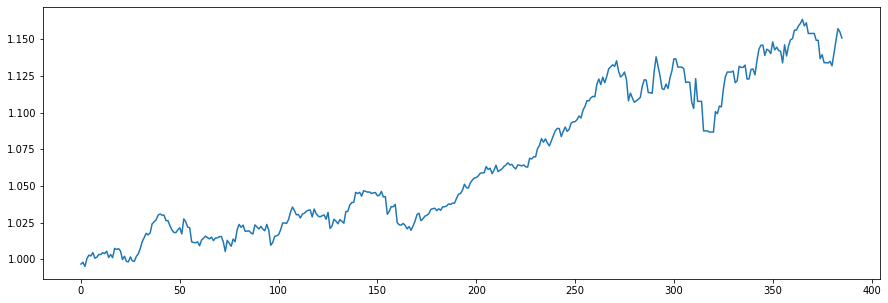

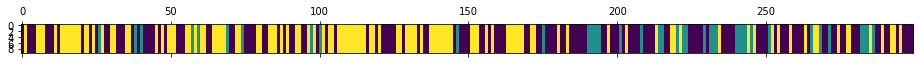

<Figure size 432x288 with 0 Axes>

N [[79. 15. 48.]
 [16. 13. 11.]
 [47. 12. 58.]]
alphas [[1.35284153 0.38842978 0.60260151]
 [1.10645733 0.63481398 0.60260151]
 [1.10645733 0.38842978 0.84898571]]
M [[5. 1. 4.]
 [5. 2. 2.]
 [4. 1. 5.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[5. 1. 4.]
 [5. 1. 2.]
 [4. 1. 3.]]
pi_z [[0.5140816  0.0921693  0.3937491 ]
 [0.4732898  0.26558264 0.26112756]
 [0.38542288 0.06816424 0.54641288]]
beta_vec [0.52683114 0.17058059 0.30258826]
hyper>> a_k: 1.8670260291580085  gamma: 1.8835345860487305  rho: 0.18723686270019707


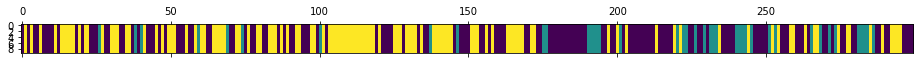

<Figure size 432x288 with 0 Axes>

887
N [[81. 14. 46.]
 [17. 14. 10.]
 [43. 13. 61.]]
alphas [[1.14901598 0.25884751 0.45916254]
 [0.79943988 0.60842361 0.45916254]
 [0.79943988 0.25884751 0.80873864]]
M [[8. 1. 1.]
 [7. 3. 3.]
 [3. 2. 3.]]
sum_w [[3.]
 [0.]
 [2.]]
barM [[5. 1. 1.]
 [7. 3. 3.]
 [3. 2. 1.]]
pi_z [[0.61444806 0.09585621 0.28969573]
 [0.48980518 0.33348029 0.17671453]
 [0.36795835 0.07435462 0.55768703]]
beta_vec [0.7529429  0.17986805 0.06718905]
hyper>> a_k: 2.872714794774378  gamma: 0.6022686661913367  rho: 0.1812709817952477


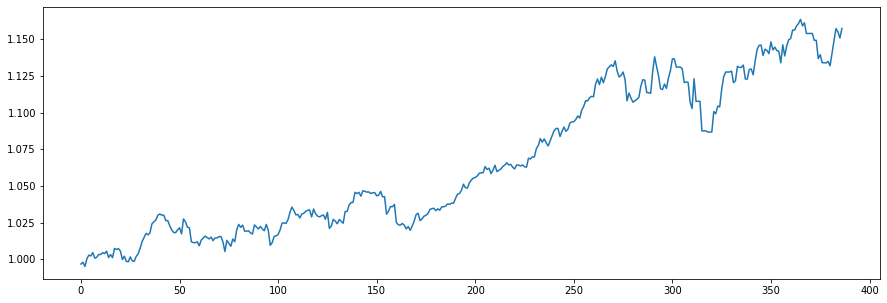

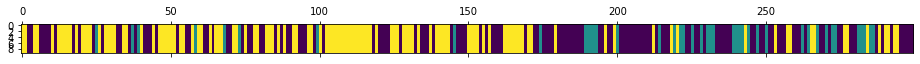

<Figure size 432x288 with 0 Axes>

N [[73. 20. 44.]
 [19. 14.  9.]
 [45.  8. 67.]]
alphas [[2.29164268 0.42304516 0.15802696]
 [1.77090285 0.94378499 0.15802696]
 [1.77090285 0.42304516 0.67876679]]
M [[ 8.  2.  1.]
 [ 4.  2.  1.]
 [11.  2.  1.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[ 8.  2.  1.]
 [ 4.  1.  1.]
 [11.  2.  1.]]
pi_z [[0.58952385 0.1701321  0.24034405]
 [0.58047659 0.20586008 0.21366333]
 [0.41140453 0.06320223 0.52539323]]
beta_vec [0.64124771 0.23955198 0.11920031]
hyper>> a_k: 2.6464271229153313  gamma: 0.9906215749948102  rho: 0.09694291144072598


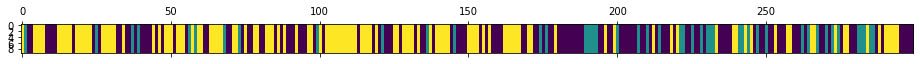

<Figure size 432x288 with 0 Axes>

888
N [[66. 25. 42.]
 [25. 11. 10.]
 [42. 10. 68.]]
alphas [[1.78905407 0.57249924 0.28487381]
 [1.53250172 0.82905159 0.28487381]
 [1.53250172 0.57249924 0.54142616]]
M [[4. 3. 2.]
 [3. 3. 3.]
 [7. 2. 3.]]
sum_w [[0.]
 [2.]
 [1.]]
barM [[4. 3. 2.]
 [3. 1. 3.]
 [7. 2. 2.]]
pi_z [[0.56330557 0.15408288 0.28261155]
 [0.66971817 0.18341507 0.14686676]
 [0.3643174  0.0631249  0.5725577 ]]
beta_vec [0.56824332 0.17236348 0.2593932 ]
hyper>> a_k: 2.266610665517724  gamma: 0.966295139819551  rho: 0.07539979155688128


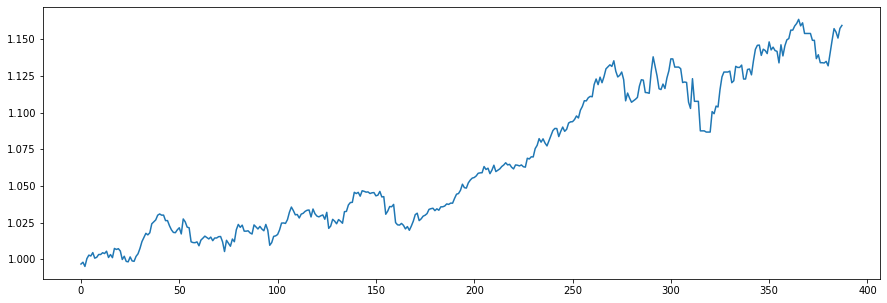

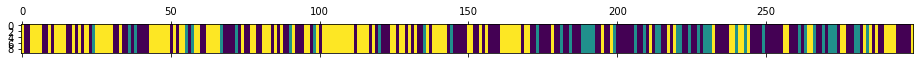

<Figure size 432x288 with 0 Axes>

N [[69. 24. 45.]
 [26. 11.  8.]
 [42. 10. 64.]]
alphas [[1.36177443 0.36122365 0.54361258]
 [1.19087246 0.53212562 0.54361258]
 [1.19087246 0.36122365 0.71451456]]
M [[10.  4.  4.]
 [ 2.  1.  2.]
 [ 2.  1.  6.]]
sum_w [[0.]
 [1.]
 [2.]]
barM [[10.  4.  4.]
 [ 2.  0.  2.]
 [ 2.  1.  4.]]
pi_z [[0.51077531 0.13381631 0.35540838]
 [0.52043332 0.30855642 0.17101026]
 [0.36112274 0.08180368 0.55707359]]
beta_vec [0.4645176  0.18813991 0.3473425 ]
hyper>> a_k: 1.8137799446841647  gamma: 0.6310782434652428  rho: 0.23000334668496272


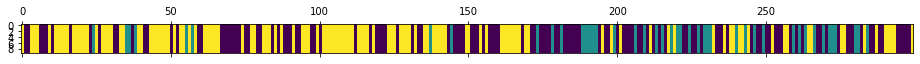

<Figure size 432x288 with 0 Axes>

889
N [[62. 23. 43.]
 [22. 12. 11.]
 [44. 10. 72.]]
alphas [[1.06592282 0.26275704 0.48510009]
 [0.64874736 0.6799325  0.48510009]
 [0.64874736 0.26275704 0.90227555]]
M [[6. 3. 5.]
 [3. 4. 1.]
 [3. 3. 5.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[4. 3. 5.]
 [3. 2. 1.]
 [3. 3. 4.]]
pi_z [[0.40896417 0.21134371 0.37969211]
 [0.57978007 0.22922255 0.19099738]
 [0.31324121 0.12113826 0.56562053]]
beta_vec [0.43113712 0.33171951 0.23714337]
hyper>> a_k: 2.359988974387195  gamma: 0.2701044428231184  rho: 0.08884363733340783


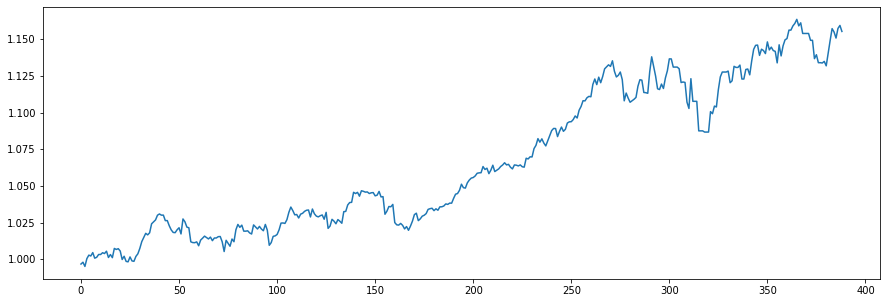

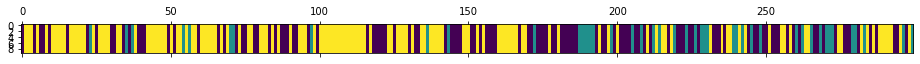

<Figure size 432x288 with 0 Axes>

N [[49. 20. 49.]
 [20. 12. 12.]
 [49. 13. 75.]]
alphas [[1.13675232 0.71330275 0.5099339 ]
 [0.92708232 0.92297276 0.5099339 ]
 [0.92708232 0.71330275 0.7196039 ]]
M [[2. 4. 5.]
 [4. 4. 1.]
 [4. 3. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[1. 4. 5.]
 [4. 3. 1.]
 [4. 3. 2.]]
pi_z [[0.42490557 0.12409913 0.4509953 ]
 [0.48770557 0.28671921 0.22557522]
 [0.26943272 0.09454308 0.63602421]]
beta_vec [0.27299213 0.42280354 0.30420433]
hyper>> a_k: 2.848569630258221  gamma: 0.1403522288544769  rho: 0.20326648282715218


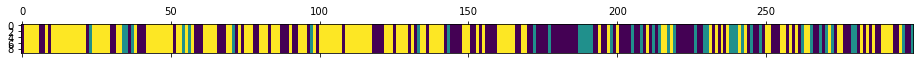

<Figure size 432x288 with 0 Axes>

890
N [[56. 19. 43.]
 [21.  9. 12.]
 [41. 14. 84.]]
alphas [[1.19858827 0.95957414 0.69040722]
 [0.61956954 1.53859287 0.69040722]
 [0.61956954 0.95957414 1.26942595]]
M [[4. 3. 2.]
 [3. 3. 1.]
 [2. 2. 5.]]
sum_w [[4.]
 [0.]
 [2.]]
barM [[0. 3. 2.]
 [3. 3. 1.]
 [2. 2. 3.]]
pi_z [[0.52971851 0.16623311 0.30404838]
 [0.59803274 0.16554144 0.23642582]
 [0.33428403 0.12349331 0.54222266]]
beta_vec [0.20460255 0.39879669 0.39660076]
hyper>> a_k: 1.9508328601985268  gamma: 1.424056010710015  rho: 0.13372898458424423


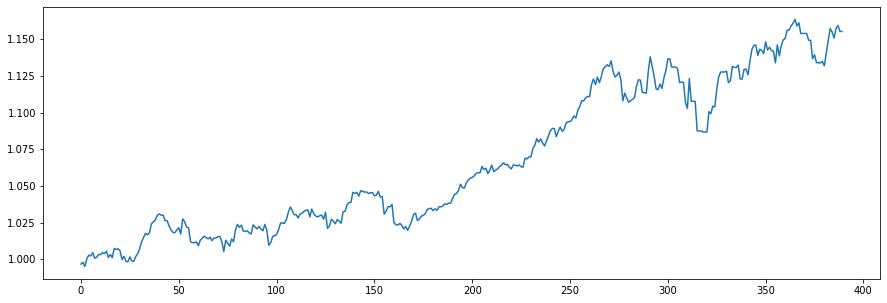

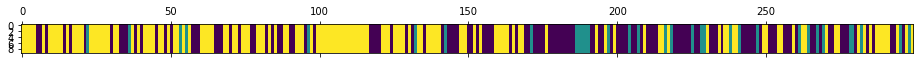

<Figure size 432x288 with 0 Axes>

N [[62. 14. 49.]
 [16.  6. 11.]
 [47. 12. 82.]]
alphas [[0.60665097 0.67394645 0.67023544]
 [0.34576807 0.93482935 0.67023544]
 [0.34576807 0.67394645 0.93111834]]
M [[5. 4. 1.]
 [1. 2. 3.]
 [2. 2. 4.]]
sum_w [[3.]
 [0.]
 [3.]]
barM [[2. 4. 1.]
 [1. 2. 3.]
 [2. 2. 1.]]
pi_z [[0.52302945 0.11183389 0.36513666]
 [0.48327237 0.17046205 0.34626558]
 [0.36046543 0.04834427 0.5911903 ]]
beta_vec [0.34379829 0.43251319 0.22368852]
hyper>> a_k: 1.9437991421486953  gamma: 0.707821587688594  rho: 0.3247334375414375


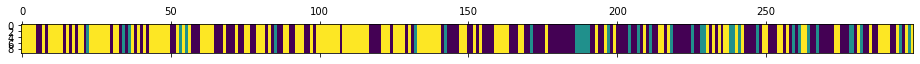

<Figure size 432x288 with 0 Axes>

891
N [[65. 18. 48.]
 [18.  7. 10.]
 [48. 10. 75.]]
alphas [[1.08248022 0.56770927 0.29360965]
 [0.45126364 1.19892585 0.29360965]
 [0.45126364 0.56770927 0.92482623]]
M [[2. 2. 3.]
 [3. 4. 3.]
 [2. 1. 5.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[1. 2. 3.]
 [3. 1. 3.]
 [2. 1. 2.]]
pi_z [[0.57155965 0.13901995 0.2894204 ]
 [0.4558076  0.17723228 0.36696012]
 [0.3987118  0.07693838 0.52434982]]
beta_vec [0.14701203 0.52356546 0.32942251]
hyper>> a_k: 2.219648177383528  gamma: 0.4119807662319579  rho: 0.28274043797455817


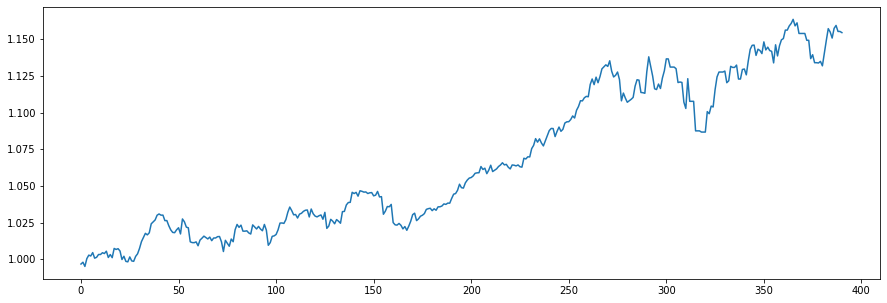

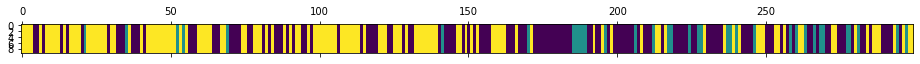

<Figure size 432x288 with 0 Axes>

N [[76. 14. 45.]
 [15.  9. 11.]
 [44. 12. 73.]]
alphas [[0.86163685 0.83354965 0.52446168]
 [0.23405255 1.46113395 0.52446168]
 [0.23405255 0.83354965 1.15204598]]
M [[6. 2. 2.]
 [2. 3. 2.]
 [1. 4. 9.]]
sum_w [[4.]
 [0.]
 [4.]]
barM [[2. 2. 2.]
 [2. 3. 2.]
 [1. 4. 5.]]
pi_z [[0.62102859 0.04868788 0.33028353]
 [0.30989983 0.38512209 0.30497808]
 [0.35674048 0.09554636 0.54771315]]
beta_vec [0.06212201 0.55129008 0.38658791]
hyper>> a_k: 3.298317688275649  gamma: 0.5326664273883224  rho: 0.29508297397671623


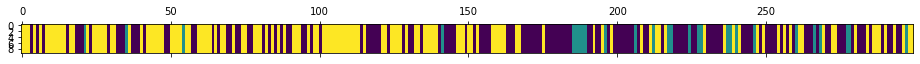

<Figure size 432x288 with 0 Axes>

892
N [[74.  8. 57.]
 [12.  8.  7.]
 [53. 11. 69.]]
alphas [[1.11771357 1.28177165 0.89883247]
 [0.14443618 2.25504904 0.89883247]
 [0.14443618 1.28177165 1.87210986]]
M [[4. 2. 2.]
 [1. 6. 3.]
 [1. 5. 6.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[0. 2. 2.]
 [1. 3. 3.]
 [1. 5. 2.]]
pi_z [[0.50574151 0.04060075 0.45365774]
 [0.43346148 0.40401287 0.16252564]
 [0.37946661 0.09683639 0.52369699]]
beta_vec [0.009125   0.64836631 0.34250869]
hyper>> a_k: 2.231654041010048  gamma: 0.37762779796154994  rho: 0.38461274346461916


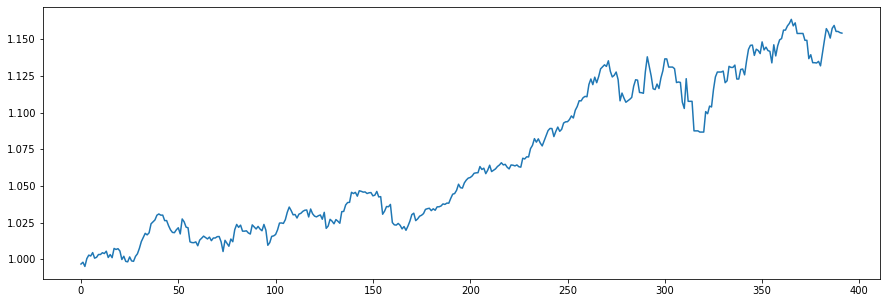

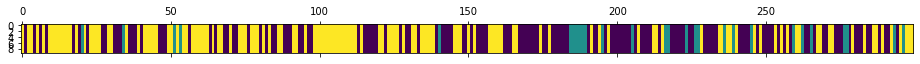

<Figure size 432x288 with 0 Axes>

N [[73. 10. 55.]
 [11.  8.  9.]
 [54. 10. 69.]]
alphas [[0.87085423 0.89042184 0.47037796]
 [0.01253165 1.74874443 0.47037796]
 [0.01253165 0.89042184 1.32870055]]
M [[7. 3. 3.]
 [1. 5. 2.]
 [1. 5. 8.]]
sum_w [[7.]
 [3.]
 [6.]]
barM [[0. 3. 3.]
 [1. 2. 2.]
 [1. 5. 2.]]
pi_z [[0.58342246 0.07660847 0.33996907]
 [0.37135283 0.21215489 0.41649228]
 [0.41865216 0.10878654 0.4725613 ]]
beta_vec [0.06531456 0.70328388 0.23140156]
hyper>> a_k: 2.69424076837359  gamma: 0.7749832969217184  rho: 0.5866917020538319


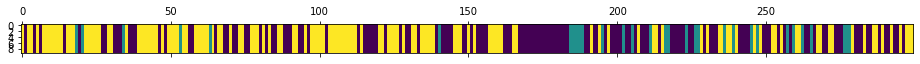

<Figure size 432x288 with 0 Axes>

893
N [[72. 11. 51.]
 [14.  8.  9.]
 [48. 12. 74.]]
alphas [[1.65341986 0.78314322 0.25767768]
 [0.07273116 2.36383192 0.25767768]
 [0.07273116 0.78314322 1.83836639]]
M [[ 3.  1.  4.]
 [ 2.  6.  1.]
 [ 1.  2. 10.]]
sum_w [[3.]
 [4.]
 [9.]]
barM [[0. 1. 4.]
 [2. 2. 1.]
 [1. 2. 1.]]
pi_z [[0.56860783 0.06634118 0.36505098]
 [0.593555   0.2070585  0.1993865 ]
 [0.30075996 0.06922842 0.63001162]]
beta_vec [0.31522963 0.20521387 0.4795565 ]
hyper>> a_k: 2.0787041818582863  gamma: 0.7962235001681368  rho: 0.568054289726219


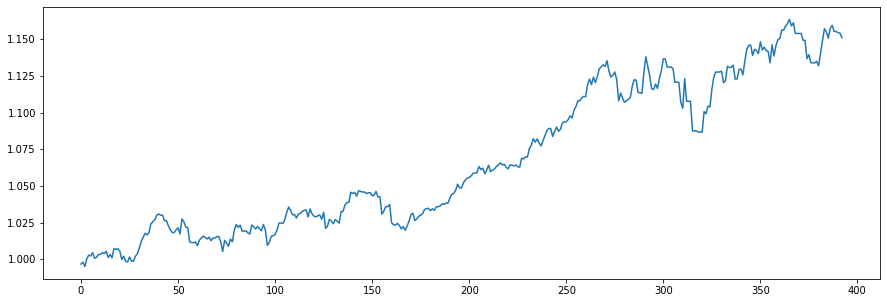

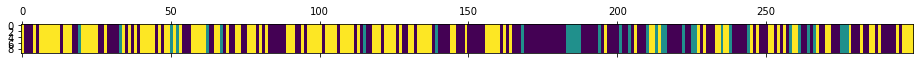

<Figure size 432x288 with 0 Axes>

N [[80. 14. 49.]
 [17.  8.  9.]
 [46. 12. 64.]]
alphas [[1.46385753 0.18425894 0.43058771]
 [0.2830407  1.36507577 0.43058771]
 [0.2830407  0.18425894 1.61140454]]
M [[5. 1. 2.]
 [1. 2. 2.]
 [4. 1. 1.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[1. 1. 2.]
 [1. 0. 2.]
 [4. 1. 0.]]
pi_z [[0.62376449 0.10057971 0.2756558 ]
 [0.49771454 0.2291056  0.27317986]
 [0.34337243 0.0736034  0.58302417]]
beta_vec [0.19136309 0.23098192 0.57765499]
hyper>> a_k: 0.8841967331261544  gamma: 0.5766561755318717  rho: 0.3791836520750872


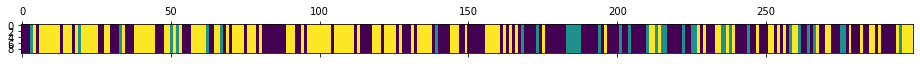

<Figure size 432x288 with 0 Axes>

894
N [[79. 15. 44.]
 [17.  8. 11.]
 [42. 13. 70.]]
alphas [[0.4403167  0.12679147 0.31708857]
 [0.10504375 0.46206441 0.31708857]
 [0.10504375 0.12679147 0.65236151]]
M [[2. 1. 3.]
 [1. 2. 1.]
 [1. 1. 6.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[0. 1. 3.]
 [1. 0. 1.]
 [1. 1. 1.]]
pi_z [[0.56950609 0.07188587 0.35860804]
 [0.43789112 0.27875403 0.28335485]
 [0.30035404 0.16824944 0.53139652]]
beta_vec [0.14944516 0.11931732 0.73123752]
hyper>> a_k: 1.1117923885731973  gamma: 2.488002994595121  rho: 0.4570770452163722


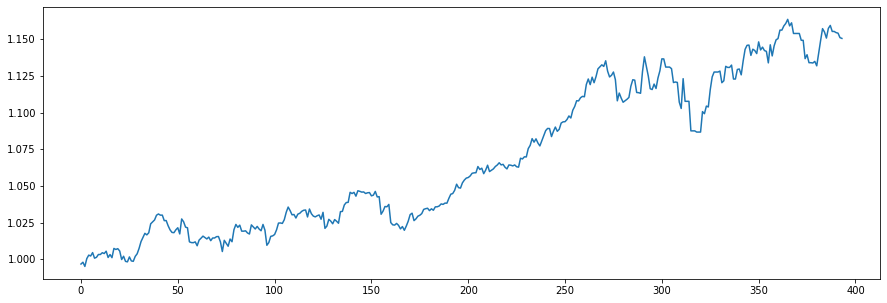

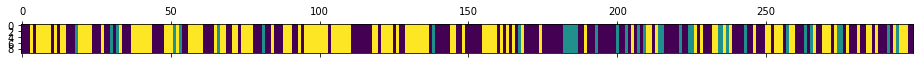

<Figure size 432x288 with 0 Axes>

N [[81. 15. 46.]
 [19.  8.  8.]
 [42. 12. 68.]]
alphas [[0.59838251 0.07202203 0.44138784]
 [0.09020773 0.58019681 0.44138784]
 [0.09020773 0.07202203 0.94956262]]
M [[3. 1. 3.]
 [1. 1. 2.]
 [1. 1. 4.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[2. 1. 3.]
 [1. 0. 2.]
 [1. 1. 1.]]
pi_z [[0.58587507 0.08526387 0.32886105]
 [0.53130162 0.26699951 0.20169887]
 [0.37654455 0.16081524 0.46264021]]
beta_vec [0.38083476 0.35164293 0.26752231]
hyper>> a_k: 0.987946606198284  gamma: 1.1310657654260814  rho: 0.2640642669937536


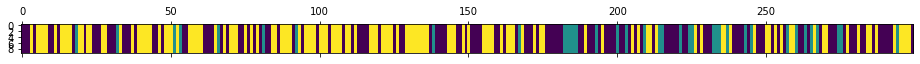

<Figure size 432x288 with 0 Axes>

895
N [[64. 15. 56.]
 [20.  9.  8.]
 [51. 13. 63.]]
alphas [[0.5377731  0.25566734 0.19450616]
 [0.27689171 0.51654874 0.19450616]
 [0.27689171 0.25566734 0.45538756]]
M [[4. 1. 3.]
 [2. 1. 1.]
 [2. 1. 4.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[2. 1. 3.]
 [2. 1. 1.]
 [2. 1. 1.]]
pi_z [[0.41652115 0.12711842 0.45636043]
 [0.41327982 0.2328335  0.35388668]
 [0.40013601 0.11996707 0.47989691]]
beta_vec [0.3098359  0.28940696 0.40075715]
hyper>> a_k: 1.6825566490623713  gamma: 0.7691838379951867  rho: 0.21825827819428015


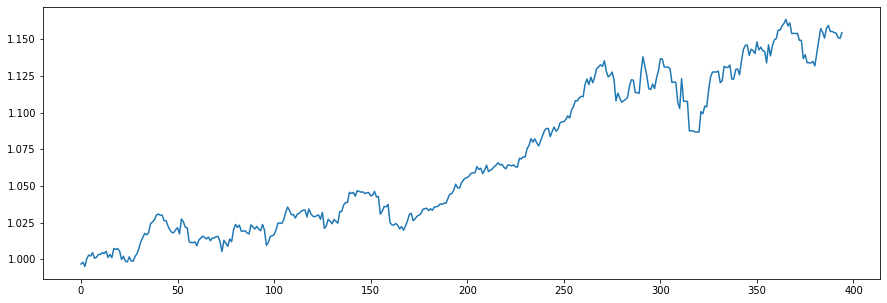

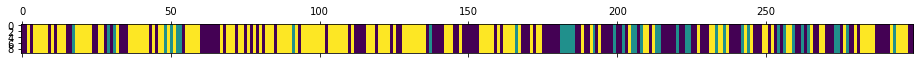

<Figure size 432x288 with 0 Axes>

N [[60. 16. 45.]
 [16.  9. 14.]
 [45. 14. 80.]]
alphas [[0.77476673 0.38066413 0.52712579]
 [0.40753482 0.74789605 0.52712579]
 [0.40753482 0.38066413 0.8943577 ]]
M [[5. 4. 3.]
 [2. 2. 3.]
 [3. 1. 4.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[2. 4. 3.]
 [2. 0. 3.]
 [3. 1. 1.]]
pi_z [[0.54071026 0.0999005  0.35938924]
 [0.42042664 0.2100186  0.36955476]
 [0.33191591 0.09650968 0.57157441]]
beta_vec [0.25783139 0.17271267 0.56945594]
hyper>> a_k: 2.0487586749867157  gamma: 1.6288965401689217  rho: 0.4163485895308477


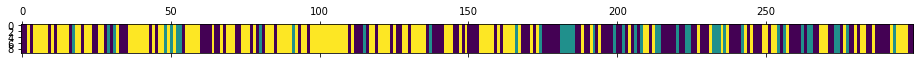

<Figure size 432x288 with 0 Axes>

896
N [[57. 19. 48.]
 [18. 11. 13.]
 [49. 12. 72.]]
alphas [[1.16130248 0.20652306 0.68093314]
 [0.30830469 1.05952085 0.68093314]
 [0.30830469 0.20652306 1.53393092]]
M [[ 5.  3.  5.]
 [ 1.  2.  4.]
 [ 1.  1. 11.]]
sum_w [[2.]
 [0.]
 [5.]]
barM [[3. 3. 5.]
 [1. 2. 4.]
 [1. 1. 6.]]
pi_z [[0.45743305 0.14639861 0.39616834]
 [0.41185182 0.32934616 0.25880202]
 [0.35938707 0.07909339 0.56151955]]
beta_vec [0.27449299 0.17675812 0.54874888]
hyper>> a_k: 2.6728156233167915  gamma: 0.41037790692341536  rho: 0.22006383642091648


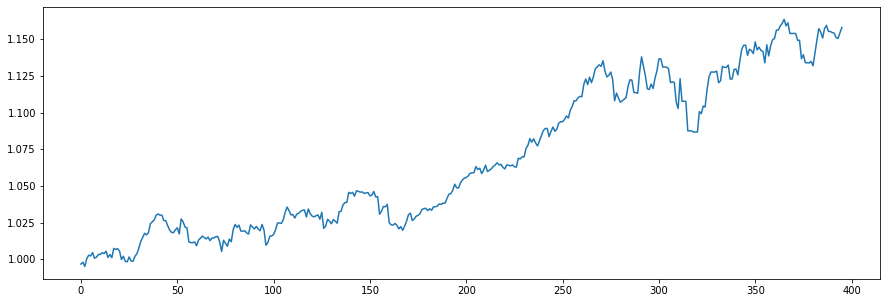

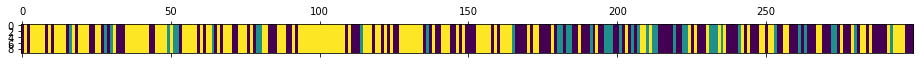

<Figure size 432x288 with 0 Axes>

N [[54. 18. 49.]
 [19. 11. 11.]
 [48. 12. 77.]]
alphas [[1.16040517 0.3684745  1.14393595]
 [0.57221511 0.95666456 1.14393595]
 [0.57221511 0.3684745  1.73212601]]
M [[1. 2. 3.]
 [3. 4. 5.]
 [3. 1. 8.]]
sum_w [[1.]
 [3.]
 [3.]]
barM [[0. 2. 3.]
 [3. 1. 5.]
 [3. 1. 5.]]
pi_z [[0.40508404 0.14806634 0.44684962]
 [0.33343866 0.34758813 0.31897321]
 [0.30889089 0.1145282  0.57658091]]
beta_vec [0.23546886 0.1661441  0.59838704]
hyper>> a_k: 3.3739409516984207  gamma: 0.25534240495969485  rho: 0.2050907293247671


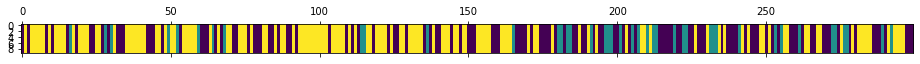

<Figure size 432x288 with 0 Axes>

897
N [[50. 20. 51.]
 [20. 11. 11.]
 [51. 11. 74.]]
alphas [[1.32348606 0.44559465 1.60486024]
 [0.63152205 1.13755866 1.60486024]
 [0.63152205 0.44559465 2.29682425]]
M [[5. 1. 3.]
 [3. 2. 3.]
 [7. 2. 6.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[3. 1. 3.]
 [3. 1. 3.]
 [7. 2. 5.]]
pi_z [[0.41691173 0.12940345 0.45368482]
 [0.42080328 0.36507297 0.21412375]
 [0.36258918 0.06702903 0.57038179]]
beta_vec [0.34099857 0.24547356 0.41352787]
hyper>> a_k: 2.7263777542163656  gamma: 1.5146455570264519  rho: 0.08035326278491964


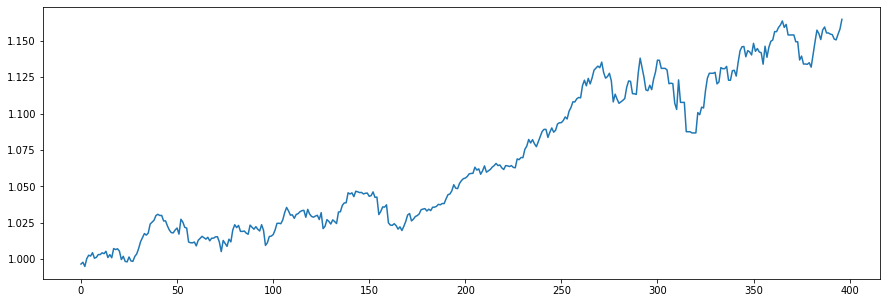

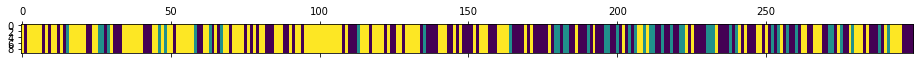

<Figure size 432x288 with 0 Axes>

N [[53. 21. 49.]
 [24.  9. 11.]
 [46. 14. 72.]]
alphas [[1.07406057 0.61547693 1.03684026]
 [0.85498722 0.83455027 1.03684026]
 [0.85498722 0.61547693 1.2559136 ]]
M [[1. 3. 2.]
 [4. 2. 2.]
 [6. 1. 6.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[0. 3. 2.]
 [4. 2. 2.]
 [6. 1. 6.]]
pi_z [[0.46808522 0.15514393 0.37677085]
 [0.4634407  0.34207342 0.19448588]
 [0.25993262 0.11381645 0.62625093]]
beta_vec [0.49559088 0.25692304 0.24748608]
hyper>> a_k: 1.407910161804272  gamma: 1.6440576476755802  rho: 0.06234346063858162


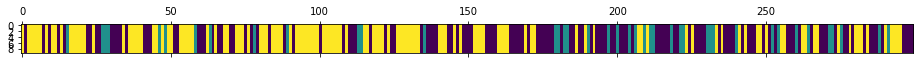

<Figure size 432x288 with 0 Axes>

898
N [[66. 19. 46.]
 [21. 10. 10.]
 [44. 12. 71.]]
alphas [[0.74202144 0.3391734  0.32671533]
 [0.65424745 0.42694739 0.32671533]
 [0.65424745 0.3391734  0.41448932]]
M [[2. 1. 4.]
 [4. 4. 2.]
 [4. 2. 3.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[2. 1. 4.]
 [4. 2. 2.]
 [4. 2. 1.]]
pi_z [[0.51006129 0.14597585 0.34396286]
 [0.54526963 0.27455323 0.18017714]
 [0.35771066 0.0947825  0.54750684]]
beta_vec [0.35538952 0.40020128 0.2444092 ]
hyper>> a_k: 2.3399660840379934  gamma: 0.6934148968370394  rho: 0.12037919555963782


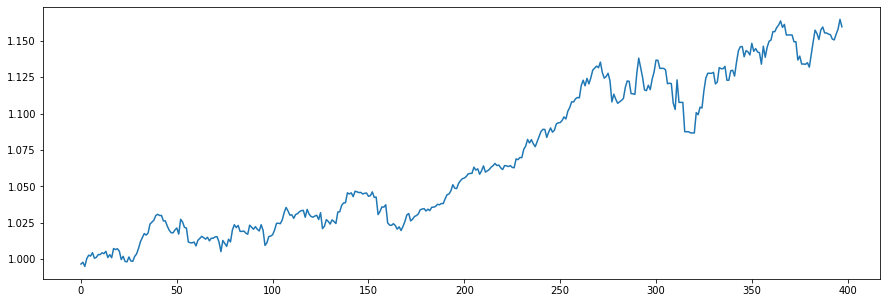

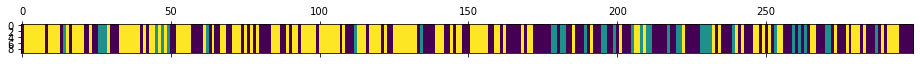

<Figure size 432x288 with 0 Axes>

N [[67. 15. 52.]
 [20. 11.  6.]
 [47. 11. 70.]]
alphas [[1.01317538 0.82372743 0.50306327]
 [0.73149215 1.10541067 0.50306327]
 [0.73149215 0.82372743 0.7847465 ]]
M [[2. 2. 2.]
 [4. 4. 1.]
 [6. 4. 5.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[1. 2. 2.]
 [4. 3. 1.]
 [6. 4. 4.]]
pi_z [[0.51030171 0.16388372 0.32581457]
 [0.58893321 0.2570032  0.15406358]
 [0.35557166 0.08592829 0.55850005]]
beta_vec [0.40836883 0.27154454 0.32008664]
hyper>> a_k: 2.9724982546479977  gamma: 1.3484281486258003  rho: 0.14156423552414743


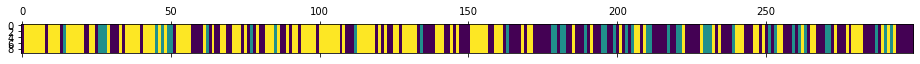

<Figure size 432x288 with 0 Axes>

899
N [[63. 18. 47.]
 [22. 11. 10.]
 [43. 14. 71.]]
alphas [[1.4628337  0.69289987 0.81676469]
 [1.04203425 1.11369931 0.81676469]
 [1.04203425 0.69289987 1.23756413]]
M [[7. 2. 4.]
 [6. 3. 2.]
 [4. 2. 5.]]
sum_w [[2.]
 [2.]
 [4.]]
barM [[5. 2. 4.]
 [6. 1. 2.]
 [4. 2. 1.]]
pi_z [[0.46887741 0.14750522 0.38361736]
 [0.51192792 0.25172704 0.23634504]
 [0.29315659 0.13767331 0.56917009]]
beta_vec [0.47249838 0.21782472 0.3096769 ]
hyper>> a_k: 3.3293431629039287  gamma: 1.2030427958291794  rho: 0.2633099494792553


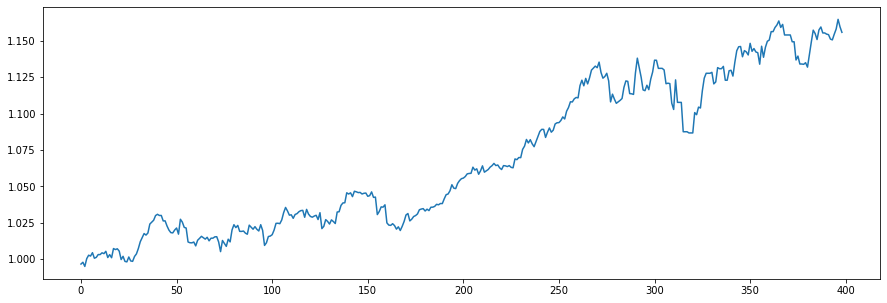

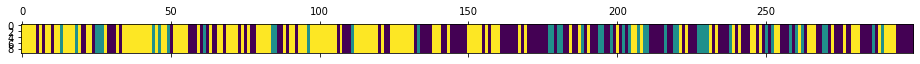

<Figure size 432x288 with 0 Axes>

N [[61. 17. 45.]
 [20. 12. 12.]
 [42. 15. 75.]]
alphas [[2.03554311 0.53425738 0.75954268]
 [1.15889393 1.41090656 0.75954268]
 [1.15889393 0.53425738 1.63619186]]
M [[ 8.  3.  2.]
 [ 3.  2.  5.]
 [ 4.  3. 12.]]
sum_w [[2.]
 [2.]
 [9.]]
barM [[6. 3. 2.]
 [3. 0. 5.]
 [4. 3. 3.]]
pi_z [[0.49739036 0.07894929 0.42366034]
 [0.46733753 0.21909409 0.31356838]
 [0.32886283 0.11764088 0.55349629]]
beta_vec [0.49290797 0.19127771 0.31581432]
hyper>> a_k: 3.588694542215629  gamma: 0.6109000267561135  rho: 0.3272610808438453


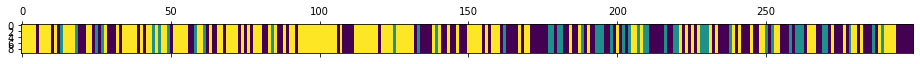

<Figure size 432x288 with 0 Axes>

900
N [[53. 19. 48.]
 [21. 11. 14.]
 [46. 16. 71.]]
alphas [[2.36444534 0.46179307 0.76245613]
 [1.19000529 1.63623313 0.76245613]
 [1.19000529 0.46179307 1.93689618]]
M [[7. 1. 3.]
 [3. 5. 4.]
 [3. 1. 9.]]
sum_w [[4.]
 [5.]
 [3.]]
barM [[3. 1. 3.]
 [3. 0. 4.]
 [3. 1. 6.]]
pi_z [[0.41752063 0.13197017 0.45050921]
 [0.49817012 0.24701744 0.25481244]
 [0.33193016 0.08768594 0.5803839 ]]
beta_vec [0.20599863 0.12132496 0.67267641]
hyper>> a_k: 3.1184827926618244  gamma: 0.34052784642994754  rho: 0.29868190203452044


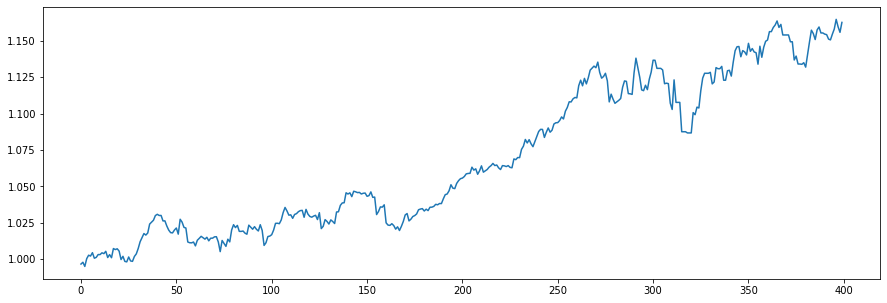

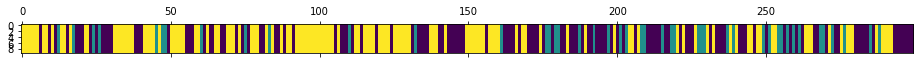

<Figure size 432x288 with 0 Axes>

N [[60. 25. 40.]
 [22.  9. 14.]
 [43. 11. 75.]]
alphas [[1.38196336 0.26534356 1.47117588]
 [0.45052898 1.19677793 1.47117588]
 [0.45052898 0.26534356 2.40261025]]
M [[3. 3. 4.]
 [3. 2. 4.]
 [5. 2. 5.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[2. 3. 4.]
 [3. 0. 4.]
 [5. 2. 4.]]
pi_z [[0.5132391  0.214717   0.2720439 ]
 [0.43278516 0.2223612  0.34485364]
 [0.38678698 0.05837819 0.55483483]]
beta_vec [0.34558417 0.15545093 0.4989649 ]
hyper>> a_k: 3.0915232822388843  gamma: 0.6699582846741868  rho: 0.10834367399166378


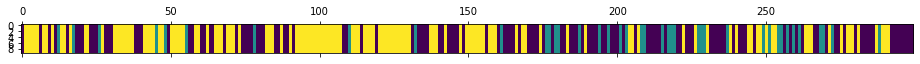

<Figure size 432x288 with 0 Axes>

901
N [[68. 21. 40.]
 [20.  9. 11.]
 [41. 10. 79.]]
alphas [[1.28757612 0.42851235 1.37543481]
 [0.95262913 0.76345934 1.37543481]
 [0.95262913 0.42851235 1.7103818 ]]
M [[6. 3. 4.]
 [4. 2. 2.]
 [3. 2. 4.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[5. 3. 4.]
 [4. 2. 2.]
 [3. 2. 2.]]
pi_z [[0.56659303 0.17520054 0.25820643]
 [0.61167931 0.2047595  0.18356119]
 [0.29036174 0.10447095 0.60516731]]
beta_vec [0.51815934 0.35390062 0.12794004]
hyper>> a_k: 2.612931382131995  gamma: 0.7963394912132532  rho: 0.22974850329820676


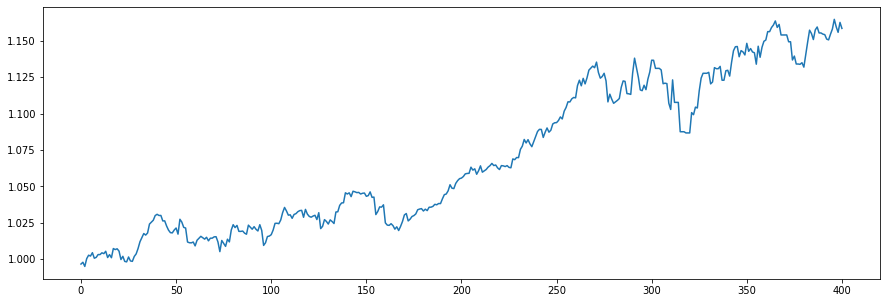

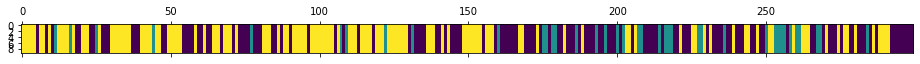

<Figure size 432x288 with 0 Axes>

N [[69. 17. 45.]
 [20. 11.  8.]
 [42. 11. 76.]]
alphas [[1.64317198 0.71226544 0.25749396]
 [1.04285491 1.31258252 0.25749396]
 [1.04285491 0.71226544 0.85781103]]
M [[8. 2. 2.]
 [4. 3. 1.]
 [9. 2. 4.]]
sum_w [[5.]
 [1.]
 [3.]]
barM [[3. 2. 2.]
 [4. 2. 1.]
 [9. 2. 1.]]
pi_z [[0.53828132 0.12965879 0.33205989]
 [0.55787965 0.30275991 0.13936044]
 [0.37928837 0.07651459 0.54419703]]
beta_vec [0.55055656 0.23905152 0.21039192]
hyper>> a_k: 3.8476656419307873  gamma: 0.7631667718120628  rho: 0.3196359465984593


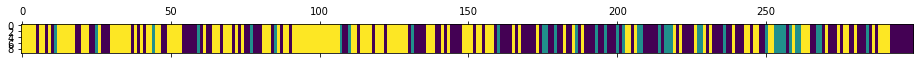

<Figure size 432x288 with 0 Axes>

902
N [[64. 17. 49.]
 [21. 10.  7.]
 [45. 11. 75.]]
alphas [[2.67110659 0.62579227 0.55076678]
 [1.44125434 1.85564452 0.55076678]
 [1.44125434 0.62579227 1.78061903]]
M [[7. 3. 4.]
 [3. 3. 2.]
 [6. 3. 7.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[2. 3. 4.]
 [3. 0. 2.]
 [6. 3. 4.]]
pi_z [[0.554311   0.11493428 0.33075472]
 [0.47262735 0.45654402 0.07082863]
 [0.34159788 0.06855774 0.58984438]]
beta_vec [0.30072051 0.40148942 0.29779007]
hyper>> a_k: 3.3699719107827777  gamma: 0.2728491291583818  rho: 0.18916348948507797


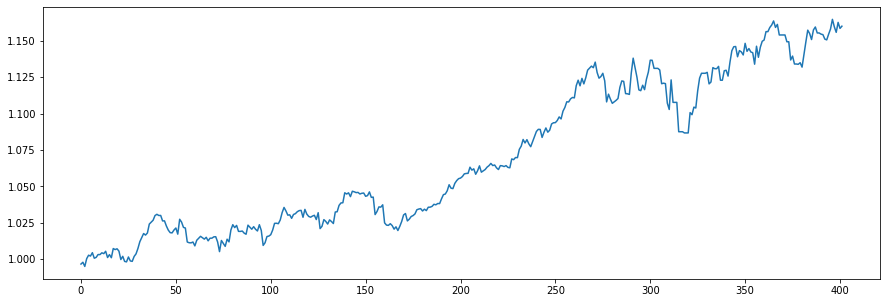

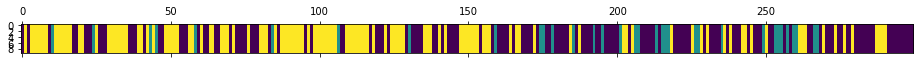

<Figure size 432x288 with 0 Axes>

N [[82. 15. 45.]
 [18.  9.  7.]
 [42. 10. 71.]]
alphas [[1.45919331 1.09706834 0.81371027]
 [0.82171766 1.73454398 0.81371027]
 [0.82171766 1.09706834 1.45118591]]
M [[7. 5. 2.]
 [3. 3. 2.]
 [5. 3. 6.]]
sum_w [[4.]
 [1.]
 [3.]]
barM [[3. 5. 2.]
 [3. 2. 2.]
 [5. 3. 3.]]
pi_z [[0.60155545 0.11971511 0.27872944]
 [0.55611722 0.21492885 0.22895393]
 [0.35243086 0.10459626 0.54297288]]
beta_vec [0.35682995 0.37206777 0.27110228]
hyper>> a_k: 2.8530489625426805  gamma: 0.33866063717755157  rho: 0.4078277564743872


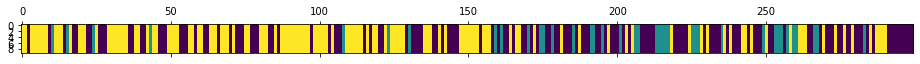

<Figure size 432x288 with 0 Axes>

903
N [[68. 14. 52.]
 [21. 13.  5.]
 [45. 12. 69.]]
alphas [[1.76641548 0.62860716 0.45802633]
 [0.60286292 1.79215971 0.45802633]
 [0.60286292 0.62860716 1.62157889]]
M [[4. 2. 4.]
 [3. 6. 1.]
 [2. 3. 6.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[1. 2. 4.]
 [3. 3. 1.]
 [2. 3. 3.]]
pi_z [[0.58900043 0.04549316 0.36550641]
 [0.57699889 0.36065344 0.06234767]
 [0.31604244 0.11388173 0.57007583]]
beta_vec [0.25237383 0.38814856 0.35947761]
hyper>> a_k: 2.6726617694193964  gamma: 0.2702856131727849  rho: 0.316390484374123


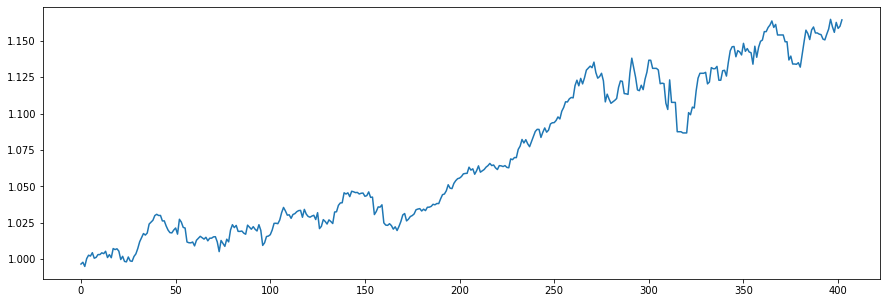

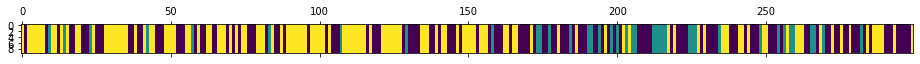

<Figure size 432x288 with 0 Axes>

N [[66. 15. 52.]
 [21. 11.  7.]
 [45. 13. 69.]]
alphas [[1.30670613 0.70916956 0.65678608]
 [0.46110137 1.55477431 0.65678608]
 [0.46110137 0.70916956 1.50239084]]
M [[4. 3. 5.]
 [5. 2. 3.]
 [3. 1. 7.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[1. 3. 5.]
 [5. 1. 3.]
 [3. 1. 5.]]
pi_z [[0.45997328 0.12360137 0.41642535]
 [0.47308533 0.23024551 0.29666916]
 [0.32273915 0.08870727 0.58855358]]
beta_vec [0.35538338 0.14647088 0.49814574]
hyper>> a_k: 2.715768164627144  gamma: 0.38900894006519116  rho: 0.17187144512744873


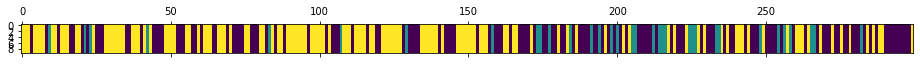

<Figure size 432x288 with 0 Axes>

904
N [[65. 16. 54.]
 [20.  8.  6.]
 [50. 10. 70.]]
alphas [[1.26602205 0.32941377 1.12033234]
 [0.79925905 0.79617677 1.12033234]
 [0.79925905 0.32941377 1.58709534]]
M [[3. 1. 9.]
 [3. 2. 4.]
 [4. 2. 7.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[2. 1. 9.]
 [3. 1. 4.]
 [4. 2. 5.]]
pi_z [[0.53760791 0.05282479 0.4095673 ]
 [0.61621987 0.21066515 0.17311499]
 [0.32994008 0.09233143 0.57772849]]
beta_vec [0.32620741 0.15823931 0.51555328]
hyper>> a_k: 3.9720583114228982  gamma: 0.19874884403130832  rho: 0.1569600508157084


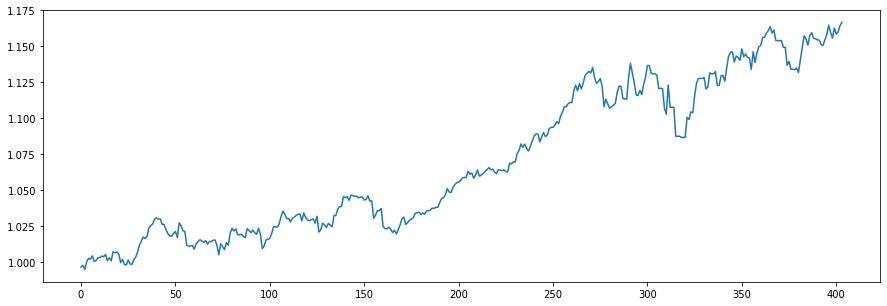

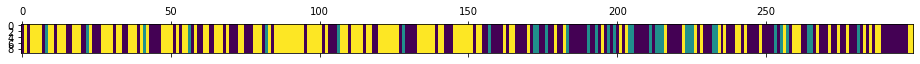

<Figure size 432x288 with 0 Axes>

N [[71. 16. 53.]
 [19.  8.  6.]
 [50.  9. 67.]]
alphas [[1.71579387 0.52988075 1.7263837 ]
 [1.09233939 1.15333522 1.7263837 ]
 [1.09233939 0.52988075 2.34983817]]
M [[6. 4. 5.]
 [2. 2. 3.]
 [4. 2. 7.]]
sum_w [[3.]
 [1.]
 [2.]]
barM [[3. 4. 5.]
 [2. 1. 3.]
 [4. 2. 5.]]
pi_z [[0.50858515 0.13409952 0.35731533]
 [0.58348103 0.2335026  0.18301637]
 [0.41735664 0.0855122  0.49713116]]
beta_vec [0.42727845 0.30684038 0.26588117]
hyper>> a_k: 3.4483258125228557  gamma: 0.7731147246393022  rho: 0.3105191792153844


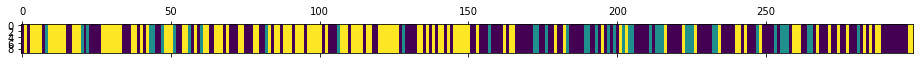

<Figure size 432x288 with 0 Axes>

905
N [[75. 20. 47.]
 [22. 12.  8.]
 [45. 10. 60.]]
alphas [[2.0866491  0.72952973 0.63214698]
 [1.0158778  1.80030103 0.63214698]
 [1.0158778  0.72952973 1.70291828]]
M [[ 9.  3.  5.]
 [ 4.  7.  2.]
 [ 4.  3. 10.]]
sum_w [[5.]
 [5.]
 [4.]]
barM [[4. 3. 5.]
 [4. 2. 2.]
 [4. 3. 6.]]
pi_z [[0.60996647 0.13145791 0.25857562]
 [0.38951291 0.39434301 0.21614408]
 [0.32778856 0.06953845 0.60267299]]
beta_vec [0.35000285 0.3515943  0.29840285]
hyper>> a_k: 3.942400192885802  gamma: 0.8484607024349834  rho: 0.32488860392853586


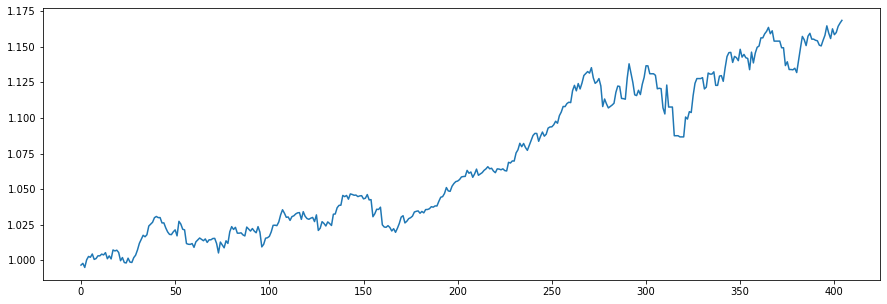

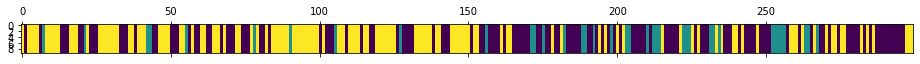

<Figure size 432x288 with 0 Axes>

N [[74. 15. 45.]
 [14. 14. 10.]
 [46.  9. 72.]]
alphas [[2.21239424 0.93578908 0.79421688]
 [0.93155334 2.21662997 0.79421688]
 [0.93155334 0.93578908 2.07505777]]
M [[4. 6. 5.]
 [2. 2. 1.]
 [7. 2. 7.]]
sum_w [[4.]
 [0.]
 [5.]]
barM [[0. 6. 5.]
 [2. 2. 1.]
 [7. 2. 2.]]
pi_z [[0.59258022 0.11887084 0.28854894]
 [0.28952099 0.4719125  0.23856651]
 [0.36842832 0.05264388 0.5789278 ]]
beta_vec [0.23729523 0.48425095 0.27845382]
hyper>> a_k: 3.080042746224632  gamma: 0.5446854826220525  rho: 0.35821477695555554


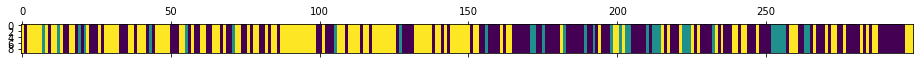

<Figure size 432x288 with 0 Axes>

906
N [[72. 14. 50.]
 [17. 11.  7.]
 [47. 10. 71.]]
alphas [[1.57238445 0.9572314  0.55042689]
 [0.46906763 2.06054823 0.55042689]
 [0.46906763 0.9572314  1.65374372]]
M [[5. 4. 2.]
 [4. 4. 1.]
 [3. 2. 7.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[2. 4. 2.]
 [4. 2. 1.]
 [3. 2. 2.]]
pi_z [[0.52542114 0.0687258  0.40585306]
 [0.47381177 0.38328212 0.14290611]
 [0.29191591 0.11368457 0.59439952]]
beta_vec [0.22636114 0.50732106 0.26631779]
hyper>> a_k: 2.7848201306759965  gamma: 0.2174608742244195  rho: 0.2888285877945188


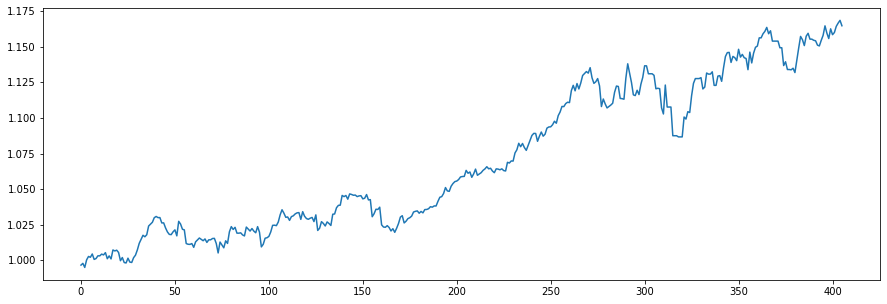

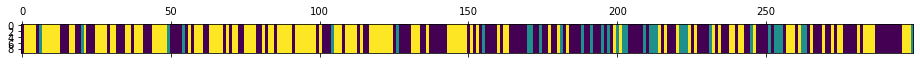

<Figure size 432x288 with 0 Axes>

N [[74. 17. 48.]
 [18.  9.  6.]
 [47.  8. 72.]]
alphas [[1.25264039 1.00474149 0.52743825]
 [0.44830472 1.80907715 0.52743825]
 [0.44830472 1.00474149 1.33177392]]
M [[5. 4. 4.]
 [2. 4. 2.]
 [1. 2. 4.]]
sum_w [[5.]
 [2.]
 [2.]]
barM [[0. 4. 4.]
 [2. 2. 2.]
 [1. 2. 2.]]
pi_z [[0.53381047 0.102085   0.36410453]
 [0.43459634 0.34853544 0.21686822]
 [0.41931344 0.05502023 0.52566633]]
beta_vec [0.09906757 0.47004654 0.43088589]
hyper>> a_k: 3.6305636538137054  gamma: 1.688898890419968  rho: 0.2593694302952762


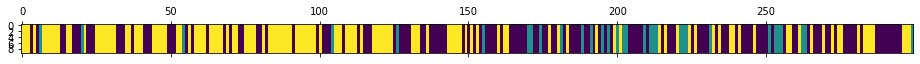

<Figure size 432x288 with 0 Axes>

907
N [[74. 15. 50.]
 [16.  9.  7.]
 [49.  8. 71.]]
alphas [[1.20804065 1.26391117 1.15861184]
 [0.26638342 2.2055684  1.15861184]
 [0.26638342 1.26391117 2.10026906]]
M [[8. 3. 5.]
 [1. 5. 1.]
 [3. 3. 7.]]
sum_w [[8.]
 [2.]
 [2.]]
barM [[0. 3. 5.]
 [1. 3. 1.]
 [3. 3. 5.]]
pi_z [[0.52710083 0.10285407 0.37004509]
 [0.49705399 0.22652701 0.276419  ]
 [0.42641385 0.06466277 0.50892338]]
beta_vec [0.10256368 0.38851499 0.50892133]
hyper>> a_k: 2.4445988945045447  gamma: 0.7461148152902147  rho: 0.34275158059607647


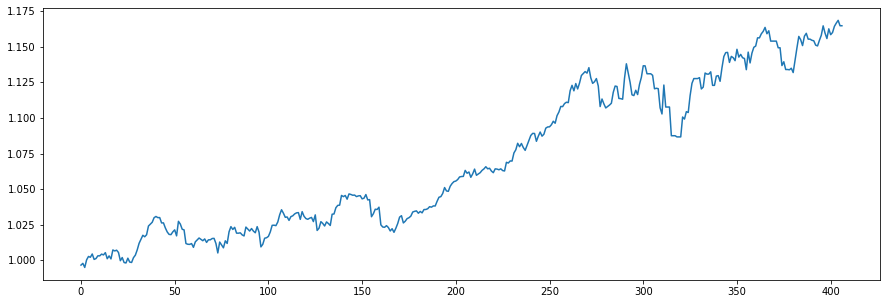

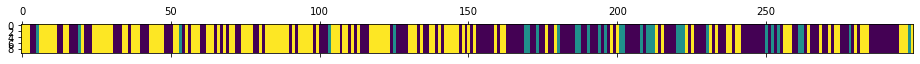

<Figure size 432x288 with 0 Axes>

N [[77. 16. 52.]
 [19.  8.  4.]
 [49.  6. 68.]]
alphas [[1.0026801  0.62423044 0.81768836]
 [0.16478996 1.46212057 0.81768836]
 [0.16478996 0.62423044 1.65557849]]
M [[1. 2. 6.]
 [2. 4. 3.]
 [3. 3. 5.]]
sum_w [[1.]
 [3.]
 [2.]]
barM [[0. 2. 6.]
 [2. 1. 3.]
 [3. 3. 3.]]
pi_z [[0.5877866  0.08617932 0.32603409]
 [0.59314715 0.28270247 0.12415038]
 [0.34112105 0.02823258 0.63064636]]
beta_vec [0.24057366 0.1258801  0.63354624]
hyper>> a_k: 2.3024127386679787  gamma: 0.8283221830706249  rho: 0.2218080233629487


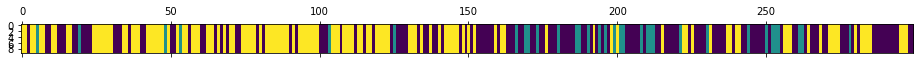

<Figure size 432x288 with 0 Axes>

908
N [[73. 18. 49.]
 [20.  8.  5.]
 [47.  7. 72.]]
alphas [[0.94173404 0.22554178 1.13513692]
 [0.43104042 0.7362354  1.13513692]
 [0.43104042 0.22554178 1.64583054]]
M [[4. 1. 5.]
 [3. 2. 4.]
 [3. 2. 7.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[2. 1. 5.]
 [3. 1. 4.]
 [3. 2. 5.]]
pi_z [[0.52137654 0.12849924 0.35012421]
 [0.55478982 0.22775471 0.21745547]
 [0.40025076 0.06919305 0.5305562 ]]
beta_vec [0.31824736 0.1940576  0.48769504]
hyper>> a_k: 2.082277247364503  gamma: 0.3329880469767129  rho: 0.26371283457219746


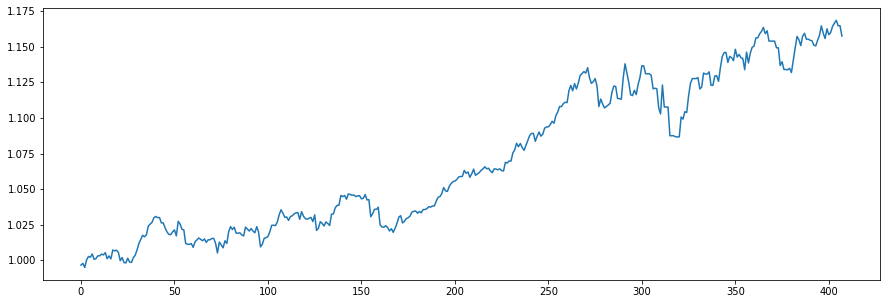

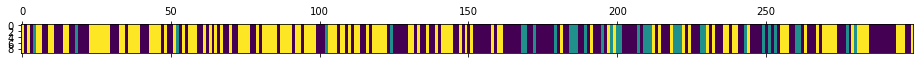

<Figure size 432x288 with 0 Axes>

N [[74. 16. 56.]
 [19. 10.  5.]
 [52.  8. 59.]]
alphas [[1.03704545 0.29752019 0.74771161]
 [0.48792222 0.84664342 0.74771161]
 [0.48792222 0.29752019 1.29683484]]
M [[5. 3. 5.]
 [2. 2. 2.]
 [4. 2. 3.]]
sum_w [[3.]
 [0.]
 [1.]]
barM [[2. 3. 5.]
 [2. 2. 2.]
 [4. 2. 2.]]
pi_z [[0.55626483 0.06274799 0.38098717]
 [0.54658297 0.3377173  0.11569973]
 [0.35033605 0.05957569 0.59008826]]
beta_vec [0.4045942  0.09338649 0.50201932]
hyper>> a_k: 2.3693641763748006  gamma: 0.34012195177727483  rho: 0.21289272391569186


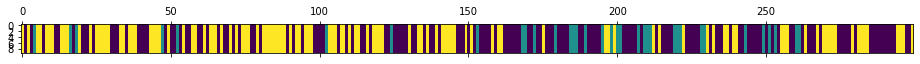

<Figure size 432x288 with 0 Axes>

909
N [[80. 17. 53.]
 [21. 10.  4.]
 [49.  8. 57.]]
alphas [[1.25896582 0.17416055 0.9362378 ]
 [0.75454543 0.67858095 0.9362378 ]
 [0.75454543 0.17416055 1.44065819]]
M [[7. 1. 5.]
 [2. 2. 2.]
 [5. 2. 6.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[3. 1. 5.]
 [2. 0. 2.]
 [5. 2. 5.]]
pi_z [[0.55462556 0.11512737 0.33024707]
 [0.59804064 0.20882709 0.19313227]
 [0.47215745 0.03748224 0.49036031]]
beta_vec [0.46114131 0.10117428 0.43768442]
hyper>> a_k: 2.133470219134877  gamma: 0.8419335177628241  rho: 0.17928236585148397


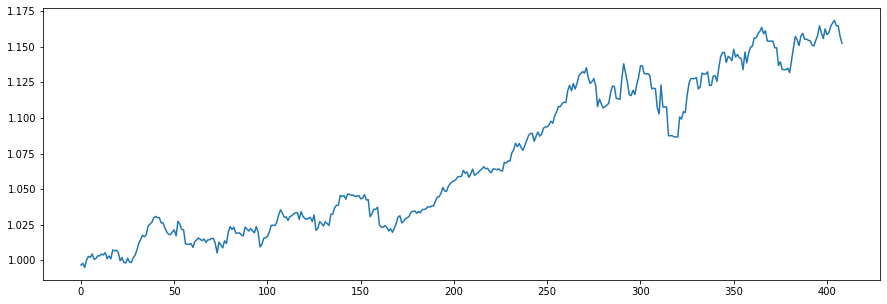

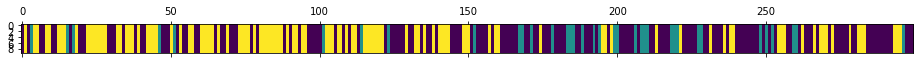

<Figure size 432x288 with 0 Axes>

N [[86. 20. 46.]
 [21. 10.  5.]
 [45.  6. 60.]]
alphas [[1.18994124 0.1771538  0.76637518]
 [0.80744765 0.55964738 0.76637518]
 [0.80744765 0.1771538  1.14886877]]
M [[5. 1. 5.]
 [6. 1. 2.]
 [3. 1. 7.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[4. 1. 5.]
 [6. 0. 2.]
 [3. 1. 4.]]
pi_z [[0.50875791 0.13329915 0.35794295]
 [0.54498714 0.27189554 0.18311732]
 [0.39173569 0.02226213 0.58600218]]
beta_vec [0.53539581 0.06035036 0.40425383]
hyper>> a_k: 2.434194750480023  gamma: 0.5823569737685699  rho: 0.16822965777215654


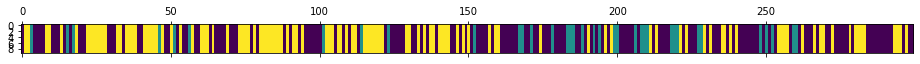

<Figure size 432x288 with 0 Axes>

910
N [[78. 18. 54.]
 [22. 10.  4.]
 [50.  8. 55.]]
alphas [[1.49351482 0.12219083 0.8184891 ]
 [1.08401108 0.53169458 0.8184891 ]
 [1.08401108 0.12219083 1.22799285]]
M [[6. 1. 3.]
 [2. 2. 1.]
 [6. 1. 3.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[5. 1. 3.]
 [2. 1. 1.]
 [6. 1. 2.]]
pi_z [[0.58980729 0.13369951 0.2764932 ]
 [0.49664843 0.34314386 0.16020771]
 [0.49299579 0.03958819 0.46741602]]
beta_vec [0.50655111 0.26199673 0.23145216]
hyper>> a_k: 1.6749833225289708  gamma: 0.946714494705849  rho: 0.14915689647404312


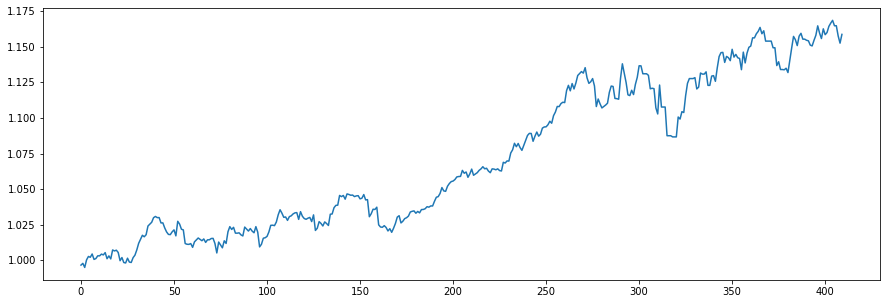

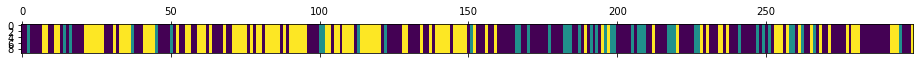

<Figure size 432x288 with 0 Axes>

N [[87. 25. 40.]
 [23. 11.  8.]
 [41.  6. 58.]]
alphas [[0.97174562 0.37338412 0.32985358]
 [0.7219103  0.62321943 0.32985358]
 [0.7219103  0.37338412 0.5796889 ]]
M [[4. 3. 2.]
 [2. 2. 1.]
 [3. 2. 2.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[3. 3. 2.]
 [2. 0. 1.]
 [3. 2. 0.]]
pi_z [[0.51626804 0.12724079 0.35649117]
 [0.54931759 0.33921929 0.11146312]
 [0.42496199 0.05517347 0.51986454]]
beta_vec [0.43024223 0.24415535 0.32560242]
hyper>> a_k: 2.209030313270379  gamma: 1.2176883660816036  rho: 0.23148386975093982


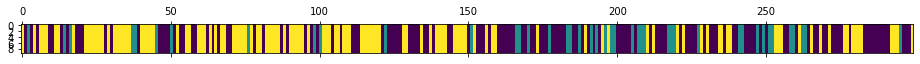

<Figure size 432x288 with 0 Axes>

911
N [[68. 22. 47.]
 [24. 12.  7.]
 [45.  9. 65.]]
alphas [[1.24176655 0.41449654 0.55276722]
 [0.73041167 0.92585143 0.55276722]
 [0.73041167 0.41449654 1.06412211]]
M [[5. 1. 5.]
 [3. 2. 4.]
 [3. 1. 6.]]
sum_w [[0.]
 [1.]
 [5.]]
barM [[5. 1. 5.]
 [3. 1. 4.]
 [3. 1. 1.]]
pi_z [[0.44357247 0.10069214 0.45573538]
 [0.63614066 0.21183599 0.15202335]
 [0.38500479 0.08081072 0.53418448]]
beta_vec [0.43083356 0.05955697 0.50960947]
hyper>> a_k: 2.209993999870671  gamma: 1.4185528773411042  rho: 0.19850397869419822


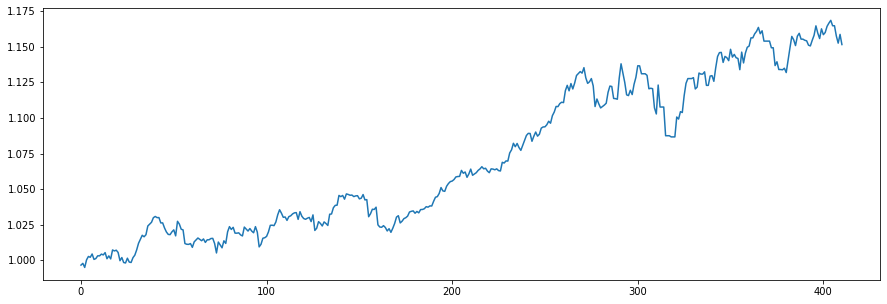

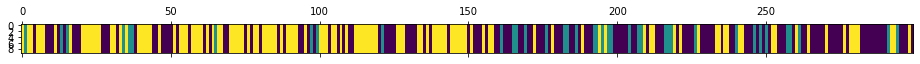

<Figure size 432x288 with 0 Axes>

N [[71. 18. 49.]
 [22.  9.  8.]
 [46. 12. 64.]]
alphas [[1.20182869 0.10549334 0.90267197]
 [0.76313609 0.54418594 0.90267197]
 [0.76313609 0.10549334 1.34136457]]
M [[7. 1. 5.]
 [4. 2. 3.]
 [3. 1. 5.]]
sum_w [[5.]
 [2.]
 [4.]]
barM [[2. 1. 5.]
 [4. 0. 3.]
 [3. 1. 1.]]
pi_z [[0.52597369 0.12517826 0.34884805]
 [0.64544378 0.2280395  0.12651672]
 [0.34553315 0.08652405 0.5679428 ]]
beta_vec [0.44058939 0.15832113 0.40108948]
hyper>> a_k: 2.339002818797394  gamma: 1.1700789296785457  rho: 0.401177350541836


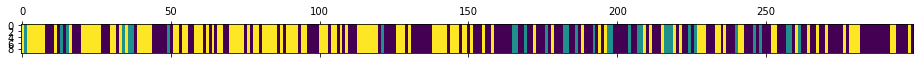

<Figure size 432x288 with 0 Axes>

912
N [[80. 17. 52.]
 [19.  8.  5.]
 [50.  7. 61.]]
alphas [[1.55546555 0.22175215 0.56178512]
 [0.61711059 1.1601071  0.56178512]
 [0.61711059 0.22175215 1.50014008]]
M [[9. 1. 1.]
 [2. 5. 1.]
 [3. 3. 6.]]
sum_w [[4.]
 [4.]
 [2.]]
barM [[5. 1. 1.]
 [2. 1. 1.]
 [3. 3. 4.]]
pi_z [[0.59056441 0.09288276 0.31655284]
 [0.61492547 0.22161692 0.16345761]
 [0.37965463 0.03807794 0.58226743]]
beta_vec [0.46357803 0.14499244 0.39142953]
hyper>> a_k: 2.022979213900083  gamma: 1.0651616249182971  rho: 0.4451005315492522


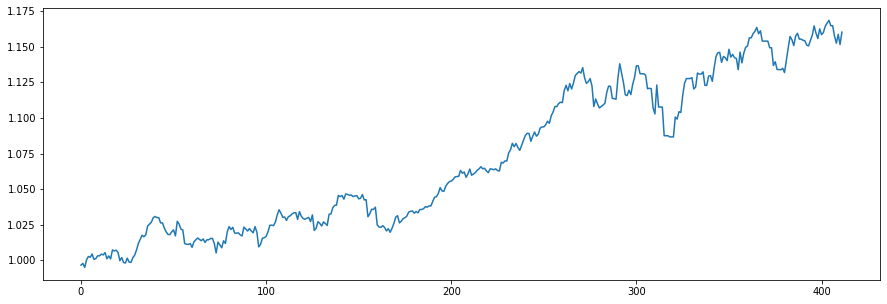

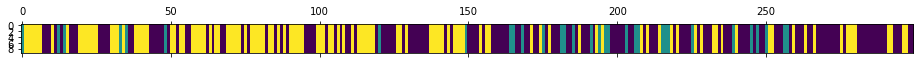

<Figure size 432x288 with 0 Axes>

N [[85. 16. 49.]
 [18.  7.  7.]
 [47.  9. 61.]]
alphas [[1.42081868 0.16276128 0.43939925]
 [0.52038956 1.0631904  0.43939925]
 [0.52038956 0.16276128 1.33982837]]
M [[11.  2.  3.]
 [ 2.  2.  2.]
 [ 3.  1.  6.]]
sum_w [[8.]
 [2.]
 [6.]]
barM [[3. 2. 3.]
 [2. 0. 2.]
 [3. 1. 0.]]
pi_z [[0.59225743 0.13552151 0.27222106]
 [0.51919346 0.27889017 0.20191637]
 [0.35328899 0.08677992 0.5599311 ]]
beta_vec [0.36641638 0.14570545 0.48787817]
hyper>> a_k: 2.6096124901437103  gamma: 1.4061261621956331  rho: 0.4949770477224024


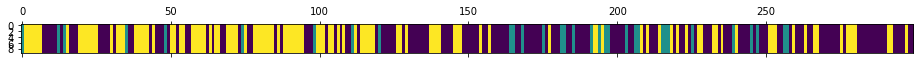

<Figure size 432x288 with 0 Axes>

913
N [[95. 15. 46.]
 [20.  7.  4.]
 [41.  9. 62.]]
alphas [[1.77460363 0.19202729 0.64298157]
 [0.48290535 1.48372557 0.64298157]
 [0.48290535 0.19202729 1.93467986]]
M [[ 9.  2.  4.]
 [ 1.  3.  2.]
 [ 2.  2. 11.]]
sum_w [[8.]
 [2.]
 [6.]]
barM [[1. 2. 4.]
 [1. 1. 2.]
 [2. 2. 5.]]
pi_z [[0.55841541 0.11763007 0.32395451]
 [0.69024566 0.16137338 0.14838096]
 [0.34191547 0.0821667  0.57591782]]
beta_vec [0.13972133 0.25294668 0.60733199]
hyper>> a_k: 2.5533951088592226  gamma: 0.3475563723900467  rho: 0.4201487238862329


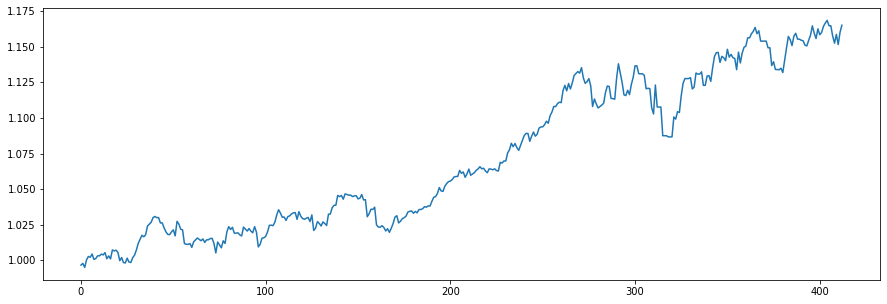

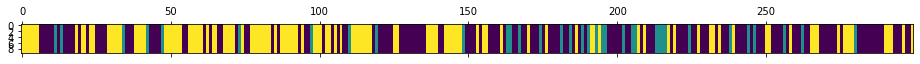

<Figure size 432x288 with 0 Axes>

N [[89. 20. 41.]
 [23.  6.  6.]
 [37.  9. 68.]]
alphas [[1.27967562 0.37451017 0.89920931]
 [0.20686993 1.44731587 0.89920931]
 [0.20686993 0.37451017 1.97201501]]
M [[7. 1. 6.]
 [1. 1. 4.]
 [1. 1. 7.]]
sum_w [[7.]
 [0.]
 [1.]]
barM [[0. 1. 6.]
 [1. 1. 4.]
 [1. 1. 6.]]
pi_z [[0.63517283 0.13058495 0.23424222]
 [0.47877982 0.26300836 0.25821181]
 [0.35696326 0.08740456 0.55563218]]
beta_vec [0.05997063 0.12851934 0.81151003]
hyper>> a_k: 2.501517033006382  gamma: 0.7137377567264526  rho: 0.3431424607822477


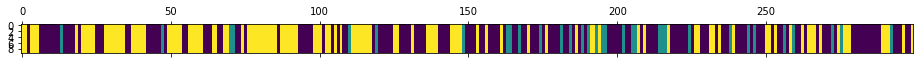

<Figure size 432x288 with 0 Axes>

914
N [[92. 20. 40.]
 [20.  6.  7.]
 [40.  7. 67.]]
alphas [[0.95691687 0.21117532 1.33342485]
 [0.09854016 1.06955203 1.33342485]
 [0.09854016 0.21117532 2.19180156]]
M [[3. 3. 6.]
 [1. 4. 4.]
 [1. 1. 9.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[0. 3. 6.]
 [1. 1. 4.]
 [1. 1. 5.]]
pi_z [[0.57783604 0.11235912 0.30980484]
 [0.45832301 0.19666859 0.3450084 ]
 [0.4126425  0.03219638 0.55516112]]
beta_vec [0.07983543 0.17660377 0.7435608 ]
hyper>> a_k: 3.833308455322456  gamma: 0.300034342362227  rho: 0.32980204507564537


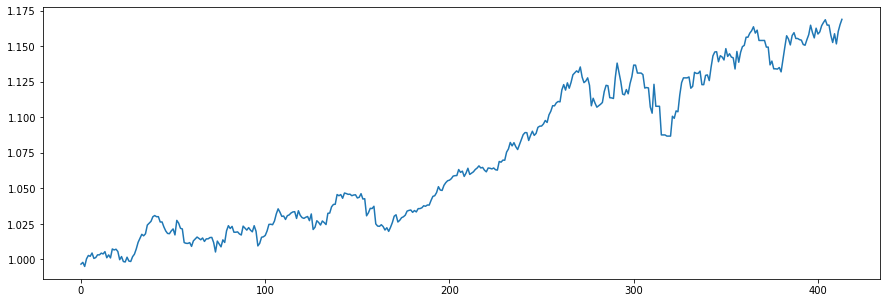

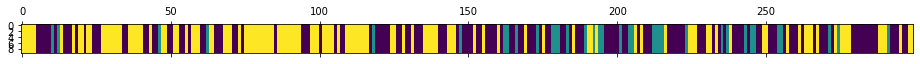

<Figure size 432x288 with 0 Axes>

N [[80. 16. 46.]
 [22. 10.  4.]
 [40. 10. 71.]]
alphas [[1.46933621 0.45370842 1.91026382]
 [0.20510325 1.71794139 1.91026382]
 [0.20510325 0.45370842 3.17449679]]
M [[12.  3.  4.]
 [ 2.  3.  2.]
 [ 1.  2. 12.]]
sum_w [[11.]
 [ 3.]
 [ 6.]]
barM [[1. 3. 4.]
 [2. 0. 2.]
 [1. 2. 6.]]
pi_z [[0.52584529 0.11186879 0.36228592]
 [0.51925639 0.2424879  0.23825571]
 [0.30903745 0.08404635 0.6069162 ]]
beta_vec [0.10358995 0.21298929 0.68342076]
hyper>> a_k: 5.938890844746629  gamma: 1.5425236700674145  rho: 0.4585162209620647


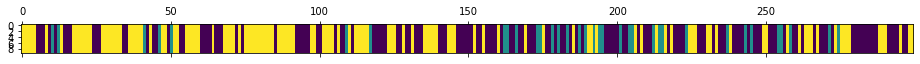

<Figure size 432x288 with 0 Axes>

915
N [[81. 16. 44.]
 [22.  6.  7.]
 [38. 13. 72.]]
alphas [[3.05620371 0.68493374 2.19775339]
 [0.33312592 3.40801153 2.19775339]
 [0.33312592 0.68493374 4.92083118]]
M [[11.  4.  6.]
 [ 3.  3.  4.]
 [ 1.  3. 13.]]
sum_w [[10.]
 [ 1.]
 [ 8.]]
barM [[1. 4. 6.]
 [3. 2. 4.]
 [1. 3. 5.]]
pi_z [[0.6143512  0.10625804 0.27939076]
 [0.46480637 0.25821523 0.2769784 ]
 [0.25404741 0.09178258 0.65417001]]
beta_vec [0.17782559 0.30345632 0.51871808]
hyper>> a_k: 4.174888894616455  gamma: 0.87192328702224  rho: 0.37578925788760953


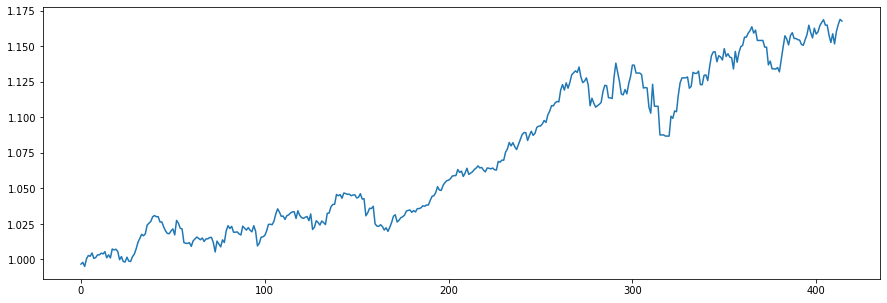

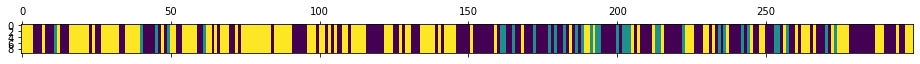

<Figure size 432x288 with 0 Axes>

N [[80. 16. 46.]
 [21.  6.  6.]
 [41. 11. 72.]]
alphas [[2.03229376 0.79081036 1.35178477]
 [0.46341536 2.35968876 1.35178477]
 [0.46341536 0.79081036 2.92066317]]
M [[ 7.  3.  7.]
 [ 1.  4.  3.]
 [ 1.  5. 12.]]
sum_w [[6.]
 [4.]
 [8.]]
barM [[1. 3. 7.]
 [1. 0. 3.]
 [1. 5. 4.]]
pi_z [[0.59998008 0.1740596  0.22596032]
 [0.61659145 0.25505745 0.1283511 ]
 [0.38721428 0.0633404  0.54944532]]
beta_vec [0.1062512  0.55900052 0.33474829]
hyper>> a_k: 4.027278622492052  gamma: 1.0785199753120611  rho: 0.48302009222977527


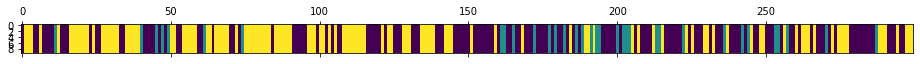

<Figure size 432x288 with 0 Axes>

916
N [[84. 16. 44.]
 [23.  6.  5.]
 [37. 12. 72.]]
alphas [[2.16647384 1.16385144 0.69695334]
 [0.22121735 3.10910794 0.69695334]
 [0.22121735 1.16385144 2.64220983]]
M [[9. 6. 2.]
 [3. 5. 1.]
 [1. 3. 7.]]
sum_w [[8.]
 [1.]
 [4.]]
barM [[1. 6. 2.]
 [3. 4. 1.]
 [1. 3. 3.]]
pi_z [[0.63585321 0.12615205 0.23799474]
 [0.58592161 0.26488315 0.14919524]
 [0.25538037 0.1122918  0.63232783]]
beta_vec [0.19096329 0.41563545 0.39340126]
hyper>> a_k: 2.8675220250944675  gamma: 0.6995202269809008  rho: 0.3772251154684584


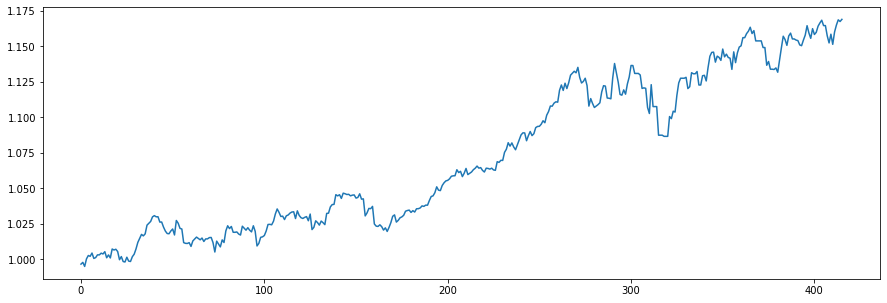

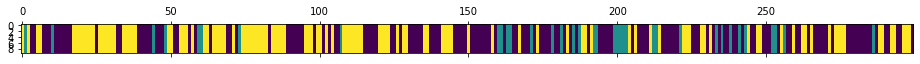

<Figure size 432x288 with 0 Axes>

N [[87. 16. 44.]
 [22. 10.  4.]
 [39. 10. 67.]]
alphas [[1.42272752 0.74225039 0.70254411]
 [0.34102619 1.82395172 0.70254411]
 [0.34102619 0.74225039 1.78424544]]
M [[7. 1. 3.]
 [1. 5. 2.]
 [1. 2. 8.]]
sum_w [[6.]
 [5.]
 [3.]]
barM [[1. 1. 3.]
 [1. 0. 2.]
 [1. 2. 5.]]
pi_z [[0.58023854 0.10512208 0.31463938]
 [0.57058763 0.31815769 0.11125468]
 [0.44501854 0.09583929 0.45914217]]
beta_vec [0.16814917 0.3160596  0.51579122]
hyper>> a_k: 2.739965706879623  gamma: 0.893902271182062  rho: 0.3854407594466451


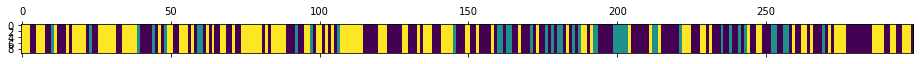

<Figure size 432x288 with 0 Axes>

917
N [[75. 21. 47.]
 [24. 12.  5.]
 [44.  8. 63.]]
alphas [[1.33923602 0.53220368 0.86852601]
 [0.28314156 1.58829814 0.86852601]
 [0.28314156 0.53220368 1.92462047]]
M [[3. 3. 4.]
 [2. 5. 2.]
 [1. 2. 7.]]
sum_w [[3.]
 [4.]
 [2.]]
barM [[0. 3. 4.]
 [2. 1. 2.]
 [1. 2. 5.]]
pi_z [[0.51933943 0.10874935 0.37191122]
 [0.47971995 0.43393987 0.08634018]
 [0.27192082 0.07854101 0.64953817]]
beta_vec [0.14461854 0.36111736 0.49426411]
hyper>> a_k: 2.1229103075333327  gamma: 0.2332669968027319  rho: 0.3062325979960652


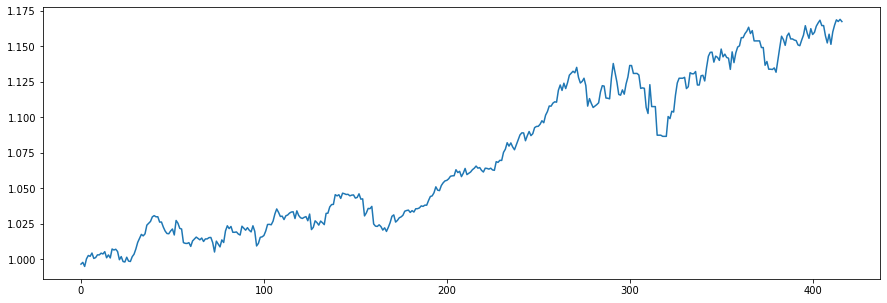

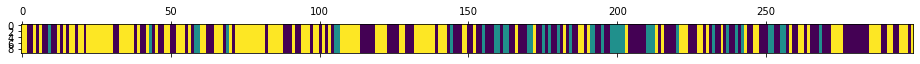

<Figure size 432x288 with 0 Axes>

N [[66. 18. 51.]
 [24. 14.  2.]
 [44.  8. 72.]]
alphas [[0.86309938 0.5318558  0.72795513]
 [0.21299504 1.18196014 0.72795513]
 [0.21299504 0.5318558  1.37805947]]
M [[5. 3. 7.]
 [1. 2. 1.]
 [2. 3. 4.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[2. 3. 7.]
 [1. 1. 1.]
 [2. 3. 3.]]
pi_z [[0.43491128 0.094307   0.47078172]
 [0.62857614 0.30640818 0.06501568]
 [0.3724228  0.04713952 0.58043768]]
beta_vec [0.23039528 0.22221086 0.54739386]
hyper>> a_k: 3.219611992814197  gamma: 1.697524060820851  rho: 0.3133256799896314


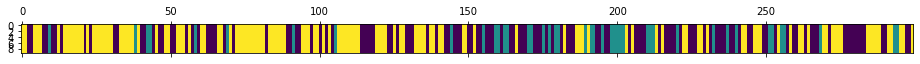

<Figure size 432x288 with 0 Axes>

918
N [[61. 20. 47.]
 [23. 15.  5.]
 [44.  8. 76.]]
alphas [[1.51815073 0.49126931 1.21019196]
 [0.50936361 1.50005642 1.21019196]
 [0.50936361 0.49126931 2.21897908]]
M [[ 9.  2.  7.]
 [ 1.  2.  2.]
 [ 1.  2. 10.]]
sum_w [[5.]
 [2.]
 [6.]]
barM [[4. 2. 7.]
 [1. 0. 2.]
 [1. 2. 4.]]
pi_z [[0.45395913 0.15260424 0.39343663]
 [0.48953867 0.3880782  0.12238312]
 [0.34880165 0.06628561 0.58491274]]
beta_vec [0.30988367 0.20808233 0.48203401]
hyper>> a_k: 2.975158044939932  gamma: 0.24400764799722063  rho: 0.2739768712180476


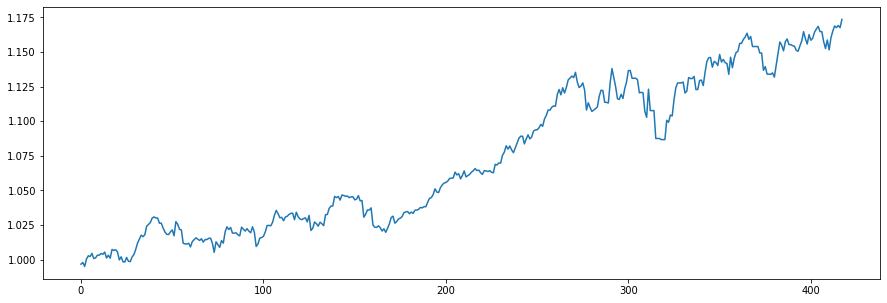

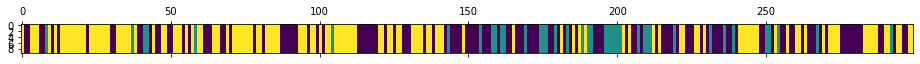

<Figure size 432x288 with 0 Axes>

N [[65. 19. 46.]
 [19. 14.  7.]
 [46.  7. 76.]]
alphas [[1.48448361 0.44946481 1.04120963]
 [0.66935912 1.2645893  1.04120963]
 [0.66935912 0.44946481 1.85633412]]
M [[7. 1. 6.]
 [2. 3. 2.]
 [3. 2. 8.]]
sum_w [[2.]
 [3.]
 [5.]]
barM [[5. 1. 6.]
 [2. 0. 2.]
 [3. 2. 3.]]
pi_z [[0.5766946  0.12759731 0.29570809]
 [0.42636369 0.45544125 0.11819506]
 [0.41965556 0.07309667 0.50724777]]
beta_vec [0.42461338 0.16485971 0.41052691]
hyper>> a_k: 2.5269513713198024  gamma: 0.5510434459496606  rho: 0.21079239225991914


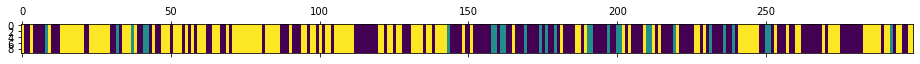

<Figure size 432x288 with 0 Axes>

919
N [[81. 16. 47.]
 [16.  7.  5.]
 [47.  5. 75.]]
alphas [[1.37946402 0.32877795 0.81870941]
 [0.84680189 0.86144007 0.81870941]
 [0.84680189 0.32877795 1.35137153]]
M [[8. 2. 3.]
 [2. 3. 1.]
 [5. 2. 8.]]
sum_w [[4.]
 [1.]
 [4.]]
barM [[4. 2. 3.]
 [2. 2. 1.]
 [5. 2. 4.]]
pi_z [[0.58475053 0.11118117 0.3040683 ]
 [0.7169207  0.1853149  0.0977644 ]
 [0.28944396 0.05170602 0.65885002]]
beta_vec [0.51284976 0.30679864 0.1803516 ]
hyper>> a_k: 1.9056553450677853  gamma: 1.1596622522821145  rho: 0.268167466473716


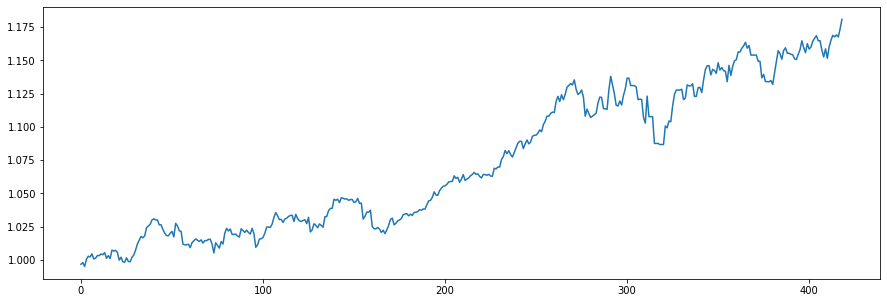

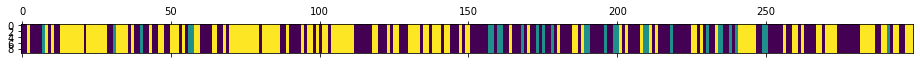

<Figure size 432x288 with 0 Axes>

N [[78. 15. 50.]
 [17.  8.  4.]
 [48.  6. 73.]]
alphas [[1.2262656  0.42786769 0.25152205]
 [0.71523083 0.93890246 0.25152205]
 [0.71523083 0.42786769 0.76255682]]
M [[6. 3. 2.]
 [2. 2. 2.]
 [2. 1. 6.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[4. 3. 2.]
 [2. 1. 2.]
 [2. 1. 2.]]
pi_z [[0.5565098  0.10796789 0.33552231]
 [0.48461582 0.36725077 0.14813341]
 [0.38476815 0.04984087 0.56539098]]
beta_vec [0.23534383 0.27046967 0.49418651]
hyper>> a_k: 1.5678490927819422  gamma: 0.3447852047291275  rho: 0.22011511003064077


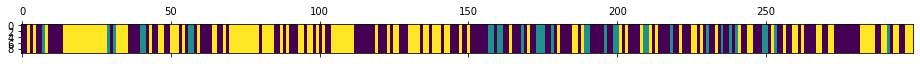

<Figure size 432x288 with 0 Axes>

920
N [[79. 17. 51.]
 [17. 10.  5.]
 [51.  5. 64.]]
alphas [[0.63287201 0.33071457 0.60426251]
 [0.28776474 0.67582185 0.60426251]
 [0.28776474 0.33071457 0.94936978]]
M [[3. 3. 2.]
 [3. 3. 2.]
 [2. 1. 4.]]
sum_w [[1.]
 [2.]
 [1.]]
barM [[2. 3. 2.]
 [3. 1. 2.]
 [2. 1. 3.]]
pi_z [[0.54461455 0.14478063 0.31060483]
 [0.65732796 0.22535531 0.11731673]
 [0.40541837 0.03578724 0.55879439]]
beta_vec [0.57516082 0.20871263 0.21612655]
hyper>> a_k: 1.758420449464418  gamma: 0.7481229577576362  rho: 0.15753410576143134


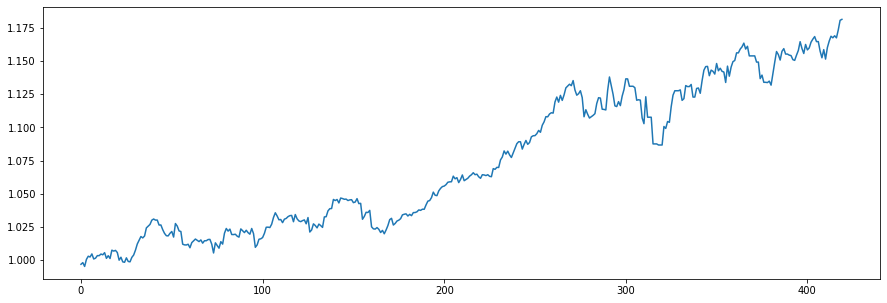

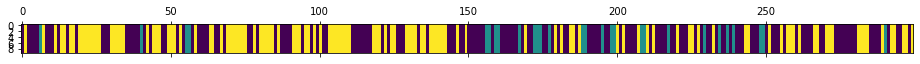

<Figure size 432x288 with 0 Axes>

N [[82. 16. 54.]
 [16.  9.  3.]
 [53.  3. 63.]]
alphas [[1.12905975 0.30918883 0.32017187]
 [0.85204856 0.58620002 0.32017187]
 [0.85204856 0.30918883 0.59718306]]
M [[6. 1. 2.]
 [2. 2. 1.]
 [4. 1. 2.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[6. 1. 2.]
 [2. 1. 1.]
 [4. 1. 1.]]
pi_z [[0.55842236 0.10372081 0.33785683]
 [0.58218993 0.20165067 0.2161594 ]
 [0.42929541 0.02456156 0.54614302]]
beta_vec [0.73849878 0.09631529 0.16518594]
hyper>> a_k: 0.830340398146586  gamma: 1.2727922996099341  rho: 0.07736787406987504


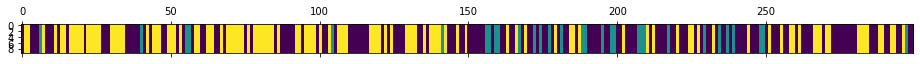

<Figure size 432x288 with 0 Axes>

921
N [[82. 20. 51.]
 [18.  8.  5.]
 [53.  3. 59.]]
alphas [[0.63000465 0.07378702 0.12654873]
 [0.56576297 0.13802869 0.12654873]
 [0.56576297 0.07378702 0.19079041]]
M [[6. 1. 1.]
 [4. 1. 1.]
 [3. 1. 1.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[5. 1. 1.]
 [4. 1. 1.]
 [3. 1. 1.]]
pi_z [[0.58282714 0.09503732 0.32213554]
 [0.64456603 0.17835345 0.17708052]
 [0.47730668 0.02711575 0.49557756]]
beta_vec [0.60146857 0.24227247 0.15625897]
hyper>> a_k: 1.8717325772303202  gamma: 0.6725473690479793  rho: 0.12616099389153324


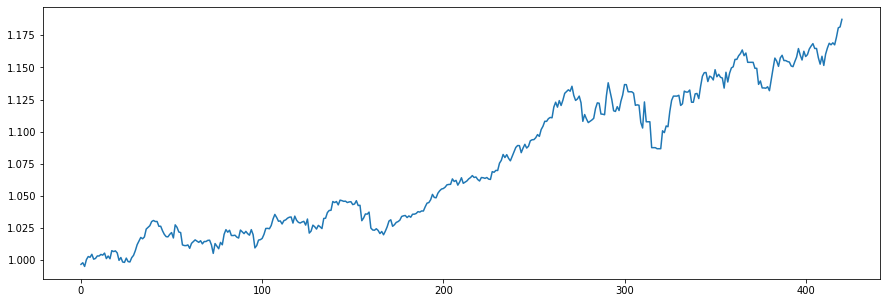

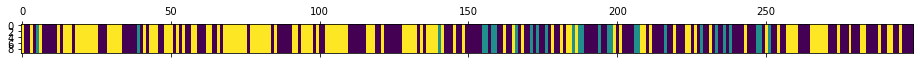

<Figure size 432x288 with 0 Axes>

N [[84. 16. 51.]
 [16.  6.  5.]
 [51.  5. 65.]]
alphas [[1.21989738 0.39625913 0.25557607]
 [0.98375774 0.63239878 0.25557607]
 [0.98375774 0.39625913 0.49171571]]
M [[3. 3. 2.]
 [1. 1. 1.]
 [5. 1. 3.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[2. 3. 2.]
 [1. 1. 1.]
 [5. 1. 2.]]
pi_z [[0.60143872 0.07993441 0.31862687]
 [0.58503708 0.18250259 0.23246033]
 [0.44835131 0.04011594 0.51153274]]
beta_vec [0.57005397 0.12247411 0.30747192]
hyper>> a_k: 2.0668577957718393  gamma: 1.351014453524902  rho: 0.3423354122741808


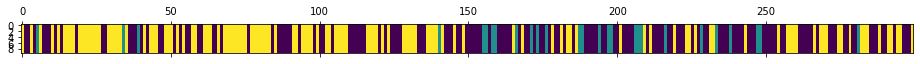

<Figure size 432x288 with 0 Axes>

922
N [[83. 15. 51.]
 [15.  7.  5.]
 [52.  5. 66.]]
alphas [[1.48243251 0.16647895 0.41794633]
 [0.77487389 0.87403757 0.41794633]
 [0.77487389 0.16647895 1.12550495]]
M [[7. 1. 1.]
 [6. 3. 3.]
 [4. 1. 5.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[6. 1. 1.]
 [6. 1. 3.]
 [4. 1. 2.]]
pi_z [[0.48555596 0.12548709 0.38895695]
 [0.60277173 0.27814327 0.11908501]
 [0.45598779 0.04505214 0.49896006]]
beta_vec [0.55399813 0.04780532 0.39819656]
hyper>> a_k: 3.1447201256556685  gamma: 1.65237766869157  rho: 0.20424866536704772


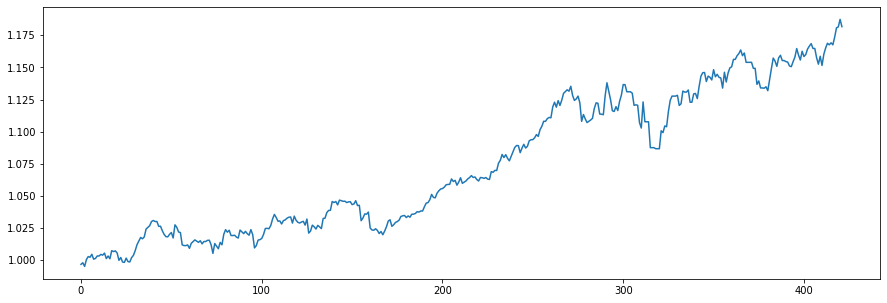

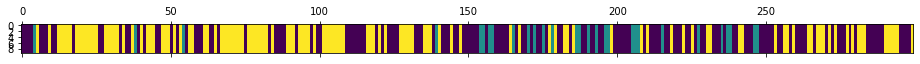

<Figure size 432x288 with 0 Axes>

N [[81. 16. 51.]
 [16.  8.  5.]
 [50.  5. 67.]]
alphas [[2.02863824 0.11962875 0.99645313]
 [1.38633335 0.76193364 0.99645313]
 [1.38633335 0.11962875 1.63875802]]
M [[ 7.  2.  2.]
 [ 3.  2.  2.]
 [ 4.  2. 10.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[6. 2. 2.]
 [3. 0. 2.]
 [4. 2. 7.]]
pi_z [[0.48204141 0.0744135  0.44354509]
 [0.45526263 0.30394355 0.24079382]
 [0.37453217 0.02256574 0.60290209]]
beta_vec [0.4275265  0.16972801 0.40274549]
hyper>> a_k: 4.964645774988845  gamma: 0.616841174935767  rho: 0.30028272171964376


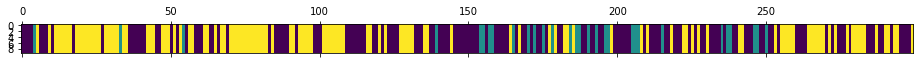

<Figure size 432x288 with 0 Axes>

923
N [[84. 16. 45.]
 [16.  8.  6.]
 [45.  6. 73.]]
alphas [[2.97595961 0.58960936 1.3990768 ]
 [1.48516227 2.08040671 1.3990768 ]
 [1.48516227 0.58960936 2.88987414]]
M [[10.  3.  4.]
 [ 1.  3.  1.]
 [ 3.  1.  7.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[5. 3. 4.]
 [1. 0. 1.]
 [3. 1. 4.]]
pi_z [[0.60523235 0.09617978 0.29858787]
 [0.46163649 0.31695926 0.22140425]
 [0.33212409 0.04729149 0.62058442]]
beta_vec [0.4775247  0.16978543 0.35268987]
hyper>> a_k: 2.418990983970561  gamma: 1.3952482485366315  rho: 0.47298659714309865


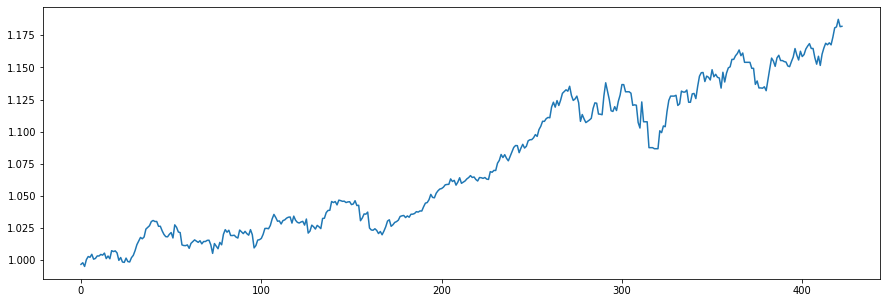

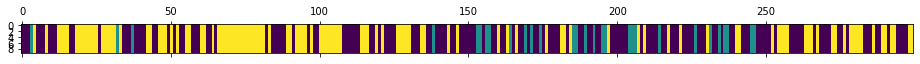

<Figure size 432x288 with 0 Axes>

N [[91. 17. 46.]
 [17.  8.  4.]
 [46.  4. 66.]]
alphas [[1.75291822 0.21644937 0.44962339]
 [0.6087679  1.36059969 0.44962339]
 [0.6087679  0.21644937 1.59377371]]
M [[8. 2. 3.]
 [2. 4. 1.]
 [1. 1. 6.]]
sum_w [[5.]
 [4.]
 [6.]]
barM [[3. 2. 3.]
 [2. 0. 1.]
 [1. 1. 0.]]
pi_z [[0.51488319 0.11280415 0.37231265]
 [0.62799515 0.26301219 0.10899266]
 [0.34859107 0.04192926 0.60947967]]
beta_vec [0.17305822 0.19996815 0.62697363]
hyper>> a_k: 2.1525733721590585  gamma: 4.382675238642575  rho: 0.43731331885489266


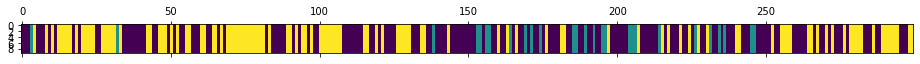

<Figure size 432x288 with 0 Axes>

924
N [[92. 14. 51.]
 [17.  7.  3.]
 [48.  6. 61.]]
alphas [[1.15096133 0.2422063  0.75940574]
 [0.20961233 1.18355531 0.75940574]
 [0.20961233 0.2422063  1.70075474]]
M [[9. 1. 9.]
 [2. 1. 3.]
 [3. 1. 2.]]
sum_w [[6.]
 [1.]
 [1.]]
barM [[3. 1. 9.]
 [2. 0. 3.]
 [3. 1. 1.]]
pi_z [[0.58788388 0.09062731 0.3214888 ]
 [0.64565943 0.19190519 0.16243538]
 [0.49761373 0.02237971 0.48000657]]
beta_vec [0.22903876 0.05317514 0.7177861 ]
hyper>> a_k: 1.4763450997822374  gamma: 0.34490841872846045  rho: 0.21788912533484225


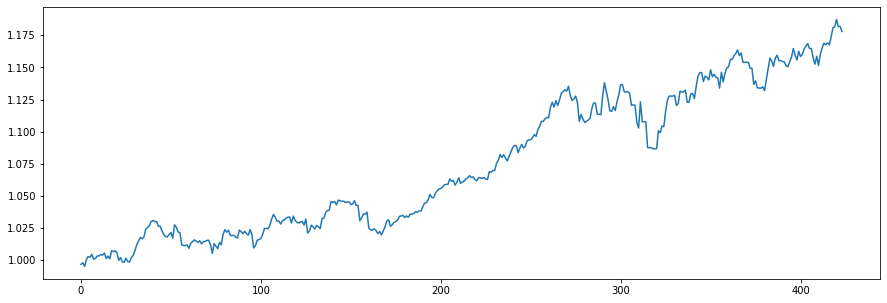

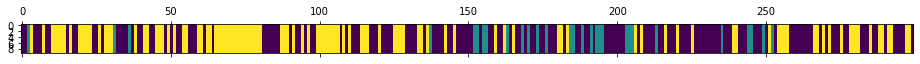

<Figure size 432x288 with 0 Axes>

N [[95. 19. 46.]
 [16.  8.  5.]
 [50.  2. 58.]]
alphas [[0.5861427  0.0613995  0.82880289]
 [0.26446316 0.38307905 0.82880289]
 [0.26446316 0.0613995  1.15048243]]
M [[4. 1. 6.]
 [3. 3. 2.]
 [2. 1. 6.]]
sum_w [[3.]
 [3.]
 [3.]]
barM [[1. 1. 6.]
 [3. 0. 2.]
 [2. 1. 3.]]
pi_z [[0.53149604 0.13149969 0.33700427]
 [0.67604439 0.21463261 0.109323  ]
 [0.51847404 0.03473297 0.44679299]]
beta_vec [0.3137067  0.11520689 0.5710864 ]
hyper>> a_k: 1.967163380429829  gamma: 1.7888967569300651  rho: 0.24714039125256834


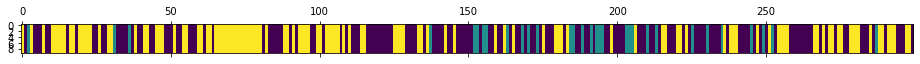

<Figure size 432x288 with 0 Axes>

925
N [[81. 20. 49.]
 [19.  7.  5.]
 [50.  4. 64.]]
alphas [[0.95076448 0.17062116 0.84577774]
 [0.46459895 0.65678669 0.84577774]
 [0.46459895 0.17062116 1.33194327]]
M [[7. 1. 4.]
 [1. 1. 3.]
 [3. 3. 6.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[4. 1. 4.]
 [1. 0. 3.]
 [3. 3. 3.]]
pi_z [[0.4595303  0.14991528 0.39055441]
 [0.50676044 0.34243026 0.1508093 ]
 [0.4629916  0.01615609 0.52085231]]
beta_vec [0.2718887  0.29237907 0.43573223]
hyper>> a_k: 2.2650952139955622  gamma: 0.8096164637621546  rho: 0.23271259063440317


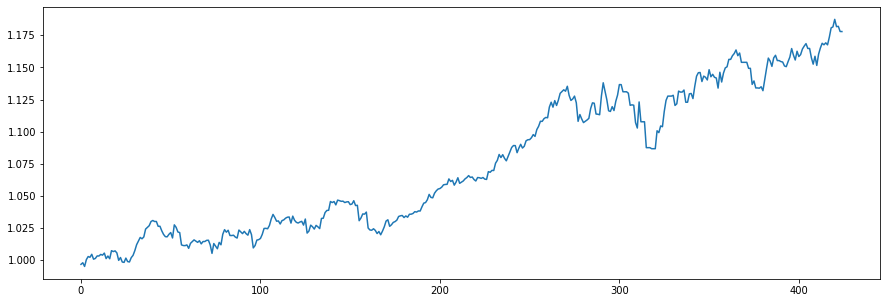

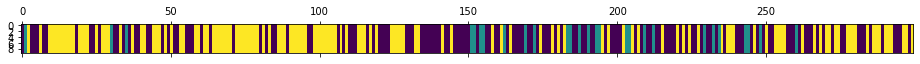

<Figure size 432x288 with 0 Axes>

N [[64. 17. 60.]
 [17.  6.  4.]
 [59.  4. 68.]]
alphas [[0.99965303 0.5081487  0.75729348]
 [0.47253686 1.03526488 0.75729348]
 [0.47253686 0.5081487  1.28440966]]
M [[7. 3. 3.]
 [2. 2. 2.]
 [3. 2. 6.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[5. 3. 3.]
 [2. 2. 2.]
 [3. 2. 6.]]
pi_z [[0.45697343 0.10870733 0.43431923]
 [0.57817261 0.28361681 0.13821058]
 [0.52311397 0.02685637 0.45002967]]
beta_vec [0.25999132 0.32666105 0.41334763]
hyper>> a_k: 2.4637135140804913  gamma: 1.4190578527656235  rho: 0.05846116912913679


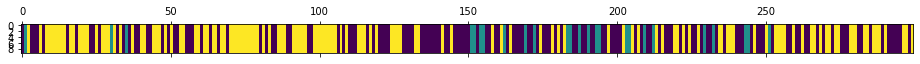

<Figure size 432x288 with 0 Axes>

926
N [[65. 15. 62.]
 [13.  6.  6.]
 [64.  4. 64.]]
alphas [[0.74712874 0.75774973 0.95883504]
 [0.60309717 0.9017813  0.95883504]
 [0.60309717 0.75774973 1.10286662]]
M [[4. 4. 4.]
 [2. 3. 3.]
 [4. 2. 3.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[3. 4. 4.]
 [2. 2. 3.]
 [4. 2. 3.]]
pi_z [[0.51809802 0.10620457 0.3756974 ]
 [0.54413135 0.27265717 0.18321148]
 [0.51461082 0.02402934 0.46135984]]
beta_vec [0.50617166 0.250885   0.24294333]
hyper>> a_k: 2.3209132704838464  gamma: 1.335187880681177  rho: 0.18576557826265858


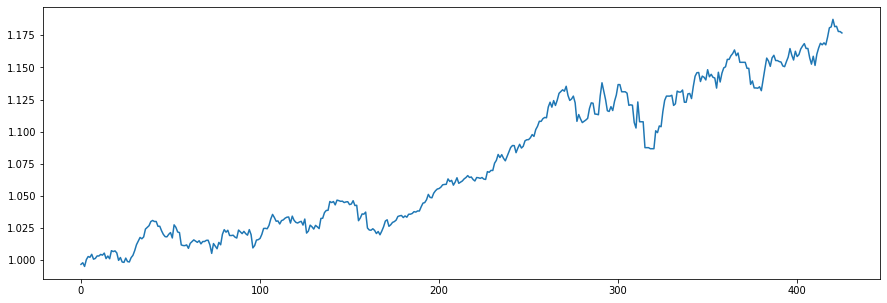

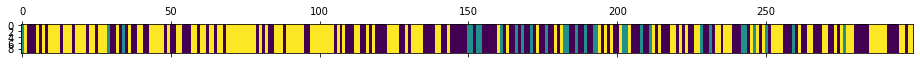

<Figure size 432x288 with 0 Axes>

N [[60. 18. 56.]
 [15.  6.  9.]
 [59.  6. 70.]]
alphas [[1.38769254 0.47411432 0.45910641]
 [0.95654674 0.90526012 0.45910641]
 [0.95654674 0.47411432 0.8902522 ]]
M [[8. 2. 3.]
 [6. 2. 1.]
 [6. 3. 8.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[5. 2. 3.]
 [6. 1. 1.]
 [6. 3. 3.]]
pi_z [[0.38568446 0.10279792 0.51151762]
 [0.4912327  0.26860005 0.24016725]
 [0.46082539 0.03527153 0.50390308]]
beta_vec [0.41687914 0.24588048 0.33724037]
hyper>> a_k: 4.019116796264979  gamma: 0.5069841793218127  rho: 0.19609467049083745


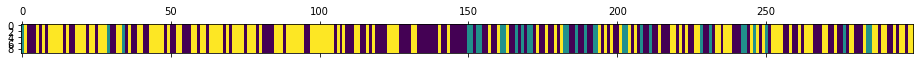

<Figure size 432x288 with 0 Axes>

927
N [[60. 17. 59.]
 [13.  9.  9.]
 [63.  5. 64.]]
alphas [[2.13505949 0.79443723 1.08962008]
 [1.3469321  1.58256462 1.08962008]
 [1.3469321  0.79443723 1.87774746]]
M [[9. 2. 2.]
 [3. 3. 3.]
 [5. 3. 5.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[8. 2. 2.]
 [3. 3. 3.]
 [5. 3. 5.]]
pi_z [[0.41761255 0.17245527 0.40993218]
 [0.42871628 0.24377619 0.32750753]
 [0.48920656 0.01178589 0.49900754]]
beta_vec [0.47059759 0.10340721 0.4259952 ]
hyper>> a_k: 2.7062890086381666  gamma: 0.16533998734616123  rho: 0.11666514192181394


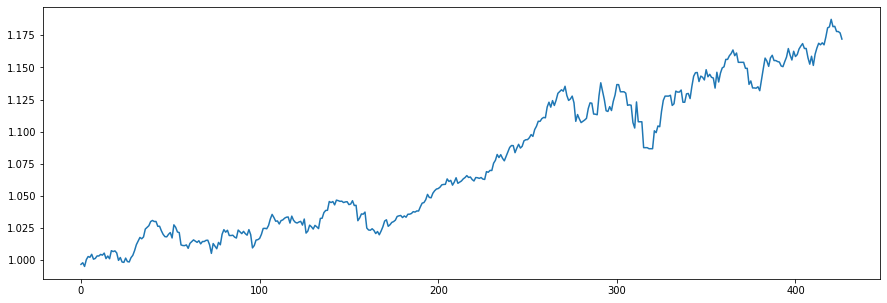

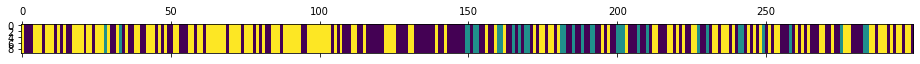

<Figure size 432x288 with 0 Axes>

N [[58. 17. 61.]
 [16. 10.  6.]
 [63.  5. 63.]]
alphas [[1.44072109 0.24720109 1.01836683]
 [1.1249915  0.56293068 1.01836683]
 [1.1249915  0.24720109 1.33409642]]
M [[5. 1. 5.]
 [4. 1. 4.]
 [4. 1. 5.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[4. 1. 5.]
 [4. 1. 4.]
 [4. 1. 4.]]
pi_z [[0.45627033 0.13008939 0.41364028]
 [0.34713529 0.37044926 0.28241545]
 [0.43610517 0.01599579 0.54789904]]
beta_vec [0.5354507 0.0297848 0.4347645]
hyper>> a_k: 1.9522817796153917  gamma: 0.7116196524037058  rho: 0.13941563839654533


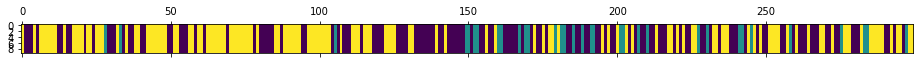

<Figure size 432x288 with 0 Axes>

928
N [[67. 18. 49.]
 [14.  9. 10.]
 [53.  6. 73.]]
alphas [[1.17179102 0.05004154 0.73044921]
 [0.89961241 0.32222016 0.73044921]
 [0.89961241 0.05004154 1.00262782]]
M [[4. 2. 7.]
 [4. 3. 3.]
 [5. 1. 5.]]
sum_w [[1.]
 [3.]
 [2.]]
barM [[3. 2. 7.]
 [4. 0. 3.]
 [5. 1. 3.]]
pi_z [[0.45658147 0.17874878 0.36466975]
 [0.32000823 0.18813527 0.4918565 ]
 [0.43407852 0.02363198 0.5422895 ]]
beta_vec [0.47508064 0.22866485 0.2962545 ]
hyper>> a_k: 2.4213619872585923  gamma: 0.9879994412002574  rho: 0.10191401022037375


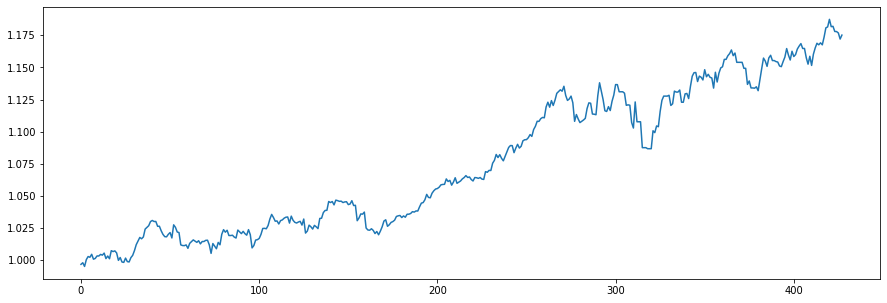

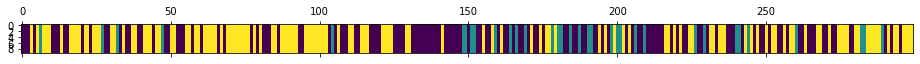

<Figure size 432x288 with 0 Axes>

N [[64. 21. 50.]
 [14.  7. 13.]
 [57.  6. 67.]]
alphas [[1.27987693 0.4972526  0.64423246]
 [1.03310622 0.74402331 0.64423246]
 [1.03310622 0.4972526  0.89100317]]
M [[6. 4. 4.]
 [4. 2. 1.]
 [1. 1. 4.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[4. 4. 4.]
 [4. 2. 1.]
 [1. 1. 4.]]
pi_z [[0.52031899 0.14873972 0.33094129]
 [0.40836139 0.26165382 0.32998478]
 [0.59064887 0.04556327 0.36378786]]
beta_vec [0.40724743 0.26143836 0.33131421]
hyper>> a_k: 1.6895146925155178  gamma: 0.5958608989144581  rho: 0.05187256737345873


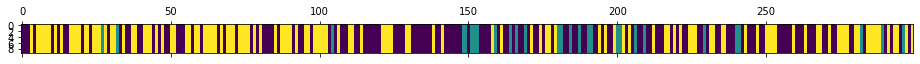

<Figure size 432x288 with 0 Axes>

929
N [[68. 18. 60.]
 [14.  7.  7.]
 [64.  3. 58.]]
alphas [[0.73999904 0.41879163 0.53072403]
 [0.65235957 0.5064311  0.53072403]
 [0.65235957 0.41879163 0.61836349]]
M [[6. 2. 3.]
 [4. 2. 2.]
 [4. 1. 2.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[6. 2. 3.]
 [4. 1. 2.]
 [4. 1. 2.]]
pi_z [[0.42107988 0.12350786 0.45541226]
 [0.39629594 0.34729345 0.25641061]
 [0.4392182  0.04252297 0.51825883]]
beta_vec [0.6967393  0.16490406 0.13835664]
hyper>> a_k: 1.9547804705030425  gamma: 1.049202995781346  rho: 0.14566864245498257


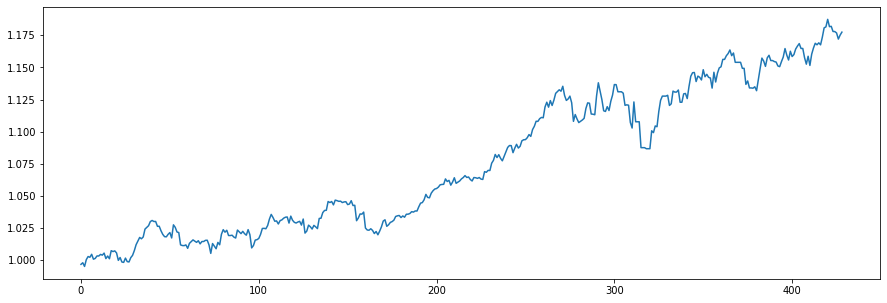

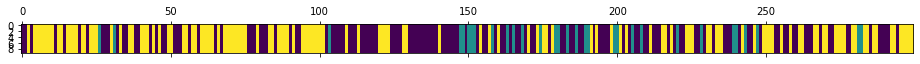

<Figure size 432x288 with 0 Axes>

N [[70. 19. 51.]
 [14.  8.  9.]
 [56.  4. 68.]]
alphas [[1.44832593 0.27539477 0.23105977]
 [1.16357571 0.56014499 0.23105977]
 [1.16357571 0.27539477 0.51580999]]
M [[9. 2. 2.]
 [2. 2. 1.]
 [6. 3. 5.]]
sum_w [[5.]
 [2.]
 [3.]]
barM [[4. 2. 2.]
 [2. 0. 1.]
 [6. 3. 2.]]
pi_z [[0.46758893 0.13890945 0.39350162]
 [0.41228842 0.25026206 0.33744952]
 [0.50177743 0.02047645 0.47774612]]
beta_vec [0.69386737 0.22134588 0.08478675]
hyper>> a_k: 4.308522213045179  gamma: 0.45850104328695807  rho: 0.424517330339401


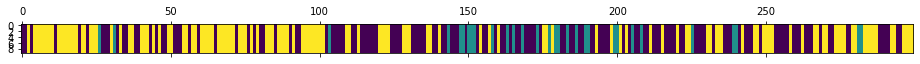

<Figure size 432x288 with 0 Axes>

930
N [[72. 19. 48.]
 [14.  8.  8.]
 [53.  3. 74.]]
alphas [[3.54947251 0.54882266 0.21022704]
 [1.72043016 2.37786501 0.21022704]
 [1.72043016 0.54882266 2.03926939]]
M [[11.  4.  2.]
 [ 3.  5.  1.]
 [ 6.  1.  7.]]
sum_w [[6.]
 [5.]
 [5.]]
barM [[5. 4. 2.]
 [3. 0. 1.]
 [6. 1. 2.]]
pi_z [[0.57798802 0.08934889 0.33266309]
 [0.63556921 0.23953103 0.12489976]
 [0.42383932 0.0153992  0.56076147]]
beta_vec [0.48653627 0.24588737 0.26757635]
hyper>> a_k: 4.057690420775488  gamma: 1.4669156093906182  rho: 0.3830854971738295


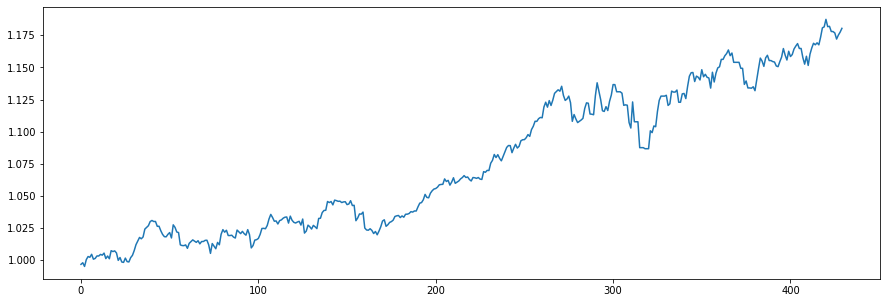

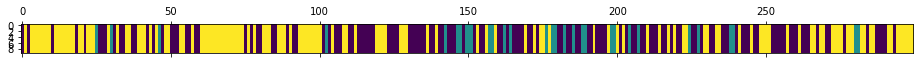

<Figure size 432x288 with 0 Axes>

N [[69. 18. 50.]
 [13.  9.  9.]
 [55.  4. 72.]]
alphas [[2.77236334 0.61551709 0.66980999]
 [1.21792099 2.16995944 0.66980999]
 [1.21792099 0.61551709 2.22425235]]
M [[9. 2. 5.]
 [4. 4. 2.]
 [2. 1. 8.]]
sum_w [[5.]
 [3.]
 [5.]]
barM [[4. 2. 5.]
 [4. 1. 2.]
 [2. 1. 3.]]
pi_z [[0.48470314 0.10981443 0.40548243]
 [0.4148303  0.18650919 0.39866052]
 [0.38921374 0.03780727 0.57297899]]
beta_vec [0.49844001 0.1736918  0.32786819]
hyper>> a_k: 3.9441936717327657  gamma: 0.21889806103283063  rho: 0.3431686274279598


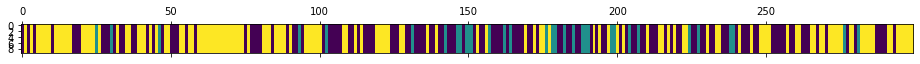

<Figure size 432x288 with 0 Axes>

931
N [[65. 21. 48.]
 [17.  8.  8.]
 [52.  4. 76.]]
alphas [[2.64481718 0.44997816 0.84939833]
 [1.29129365 1.80350169 0.84939833]
 [1.29129365 0.44997816 2.20292186]]
M [[9. 1. 2.]
 [4. 2. 2.]
 [5. 1. 6.]]
sum_w [[4.]
 [2.]
 [4.]]
barM [[5. 1. 2.]
 [4. 0. 2.]
 [5. 1. 2.]]
pi_z [[0.46035119 0.17700957 0.36263924]
 [0.55121699 0.28915249 0.15963052]
 [0.38528192 0.06685407 0.547864  ]]
beta_vec [0.55015487 0.14744576 0.30239937]
hyper>> a_k: 3.468762198129618  gamma: 0.23785709016086076  rho: 0.2588372683642317


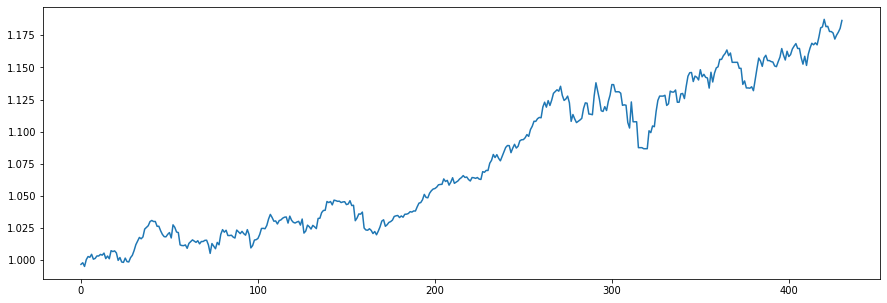

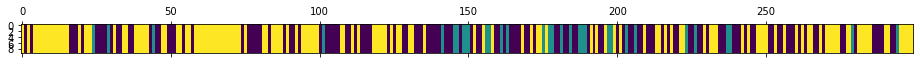

<Figure size 432x288 with 0 Axes>

N [[64. 19. 51.]
 [16.  9.  7.]
 [54.  4. 75.]]
alphas [[2.31224759 0.37907085 0.77744376]
 [1.41440266 1.27691578 0.77744376]
 [1.41440266 0.37907085 1.67528869]]
M [[4. 2. 4.]
 [4. 3. 3.]
 [8. 1. 7.]]
sum_w [[0.]
 [2.]
 [3.]]
barM [[4. 2. 4.]
 [4. 1. 3.]
 [8. 1. 4.]]
pi_z [[0.53910979 0.13184899 0.32904122]
 [0.48100982 0.28129312 0.23769706]
 [0.37724019 0.02993488 0.59282493]]
beta_vec [0.60459798 0.12750694 0.26789507]
hyper>> a_k: 3.0464519579332214  gamma: 0.5179237232471223  rho: 0.11941059069014716


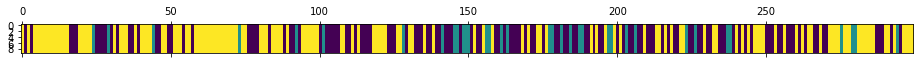

<Figure size 432x288 with 0 Axes>

932
N [[58. 21. 48.]
 [15.  9. 11.]
 [54.  5. 78.]]
alphas [[1.98571752 0.34205947 0.71867497]
 [1.62193889 0.7058381  0.71867497]
 [1.62193889 0.34205947 1.0824536 ]]
M [[6. 2. 2.]
 [7. 2. 3.]
 [8. 2. 5.]]
sum_w [[2.]
 [0.]
 [0.]]
barM [[4. 2. 2.]
 [7. 2. 3.]
 [8. 2. 5.]]
pi_z [[0.46506937 0.14393842 0.39099221]
 [0.46076553 0.30441888 0.23481558]
 [0.43212914 0.06843271 0.49943815]]
beta_vec [0.53400633 0.19430652 0.27168715]
hyper>> a_k: 2.863387035234556  gamma: 0.8182866464337869  rho: 0.03249868507837412


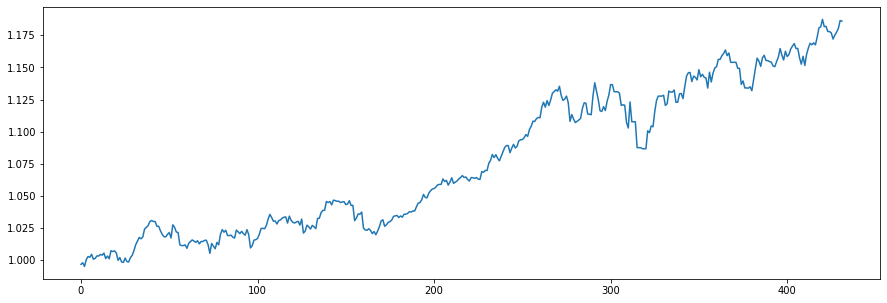

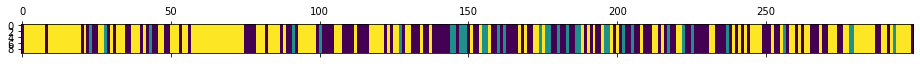

<Figure size 432x288 with 0 Axes>

N [[57. 20. 47.]
 [16.  8. 10.]
 [52.  6. 83.]]
alphas [[1.57243046 0.53829332 0.75266326]
 [1.47937414 0.63134963 0.75266326]
 [1.47937414 0.53829332 0.84571958]]
M [[7. 2. 4.]
 [4. 3. 3.]
 [7. 4. 4.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[7. 2. 4.]
 [4. 2. 3.]
 [7. 4. 3.]]
pi_z [[0.46753152 0.08327011 0.44919837]
 [0.46283945 0.25428168 0.28287887]
 [0.41366685 0.03673888 0.54959427]]
beta_vec [0.60512936 0.17560627 0.21926437]
hyper>> a_k: 3.8828436562327044  gamma: 0.6094775495557757  rho: 0.048561191808660566


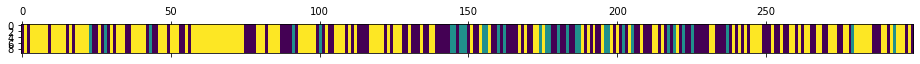

<Figure size 432x288 with 0 Axes>

933
N [[52. 18. 55.]
 [18.  7.  7.]
 [55.  7. 80.]]
alphas [[2.42407774 0.64874015 0.81002577]
 [2.23552223 0.83729567 0.81002577]
 [2.23552223 0.64874015 0.99858128]]
M [[9. 1. 4.]
 [5. 2. 3.]
 [7. 2. 6.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[8. 1. 4.]
 [5. 2. 3.]
 [7. 2. 5.]]
pi_z [[0.4925493  0.1479655  0.35948521]
 [0.54218225 0.17352978 0.28428797]
 [0.4302485  0.06255668 0.50719482]]
beta_vec [0.59741425 0.15800421 0.24458155]
hyper>> a_k: 4.600712702892631  gamma: 0.11589427469946396  rho: 0.07901910632722403


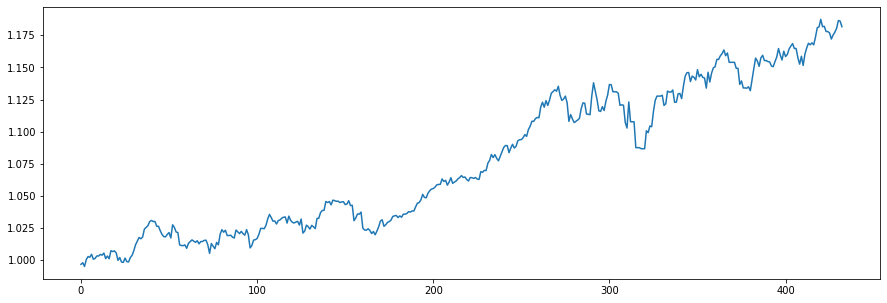

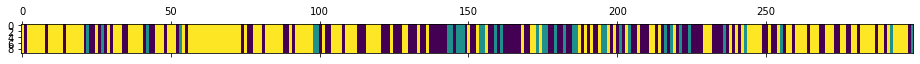

<Figure size 432x288 with 0 Axes>

N [[47. 18. 50.]
 [17.  8.  9.]
 [50.  9. 91.]]
alphas [[2.89488903 0.66949045 1.03633323]
 [2.53134482 1.03303465 1.03633323]
 [2.53134482 0.66949045 1.39987744]]
M [[6. 1. 5.]
 [6. 3. 1.]
 [8. 2. 6.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[5. 1. 5.]
 [6. 2. 1.]
 [8. 2. 4.]]
pi_z [[0.39616233 0.18859765 0.41524002]
 [0.44717008 0.33944685 0.21338307]
 [0.39506274 0.07351697 0.53142029]]
beta_vec [0.32653805 0.27759491 0.39586704]
hyper>> a_k: 3.3063295289331376  gamma: 0.7568066691857803  rho: 0.10502421805513396


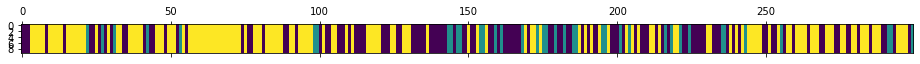

<Figure size 432x288 with 0 Axes>

934
N [[53. 19. 47.]
 [19.  9. 10.]
 [47. 10. 85.]]
alphas [[1.31349847 0.8214269  1.17140416]
 [0.96625379 1.16867158 1.17140416]
 [0.96625379 0.8214269  1.51864883]]
M [[2. 2. 5.]
 [2. 4. 3.]
 [4. 1. 6.]]
sum_w [[0.]
 [2.]
 [3.]]
barM [[2. 2. 5.]
 [2. 2. 3.]
 [4. 1. 3.]]
pi_z [[0.40822206 0.16249006 0.42928787]
 [0.44359047 0.37781757 0.17859197]
 [0.27988708 0.10612557 0.61398735]]
beta_vec [0.41628253 0.29944137 0.28427609]
hyper>> a_k: 2.006010441667474  gamma: 0.38921300365253886  rho: 0.1368513065229864


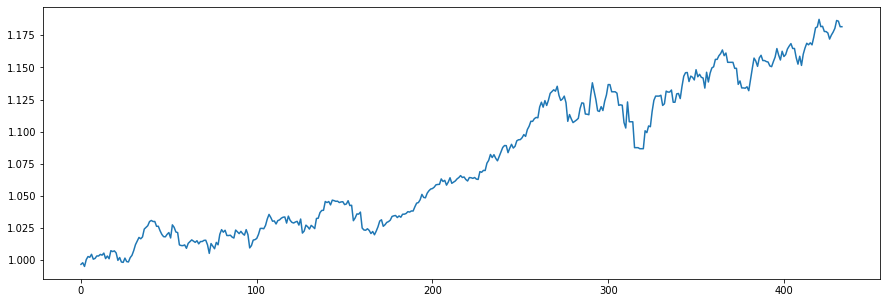

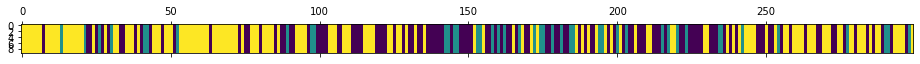

<Figure size 432x288 with 0 Axes>

N [[50. 20. 49.]
 [24. 10.  9.]
 [45. 12. 80.]]
alphas [[0.99531224 0.51847833 0.49221987]
 [0.72078709 0.79300348 0.49221987]
 [0.72078709 0.51847833 0.76674502]]
M [[6. 2. 2.]
 [6. 2. 2.]
 [3. 3. 3.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[6. 2. 2.]
 [6. 1. 2.]
 [3. 3. 2.]]
pi_z [[0.50199577 0.15465949 0.34334474]
 [0.61736659 0.2914555  0.09117791]
 [0.38556014 0.08272081 0.53171906]]
beta_vec [0.68010647 0.11103135 0.20886217]
hyper>> a_k: 1.7258794172990328  gamma: 0.8096794184429744  rho: 0.07992151607304296


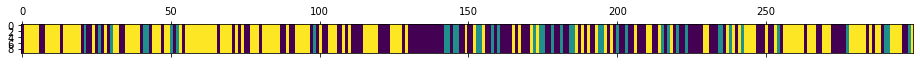

<Figure size 432x288 with 0 Axes>

935
N [[58. 19. 47.]
 [22.  9.  9.]
 [44. 12. 79.]]
alphas [[1.21790624 0.17631163 0.33166155]
 [1.07997134 0.31424653 0.33166155]
 [1.07997134 0.17631163 0.46959645]]
M [[8. 1. 2.]
 [5. 2. 2.]
 [6. 2. 4.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[8. 1. 2.]
 [5. 1. 2.]
 [6. 2. 3.]]
pi_z [[0.45856191 0.11232011 0.42911798]
 [0.49367655 0.28799995 0.21832351]
 [0.34570348 0.06791003 0.58638649]]
beta_vec [0.62987524 0.12778248 0.24234228]
hyper>> a_k: 2.8476637254549737  gamma: 0.7822331404706774  rho: 0.09036002312306433


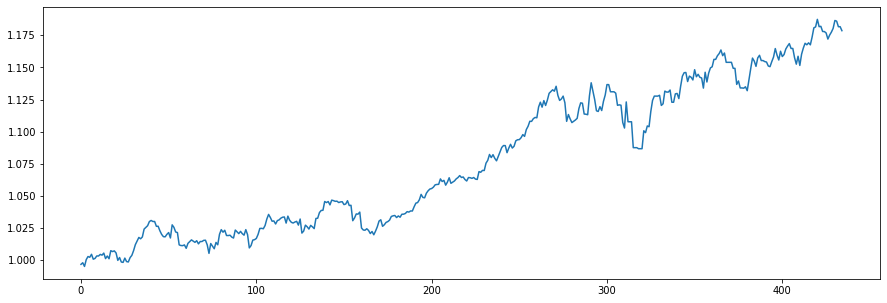

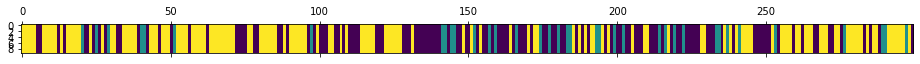

<Figure size 432x288 with 0 Axes>

N [[57. 20. 46.]
 [22.  7.  8.]
 [45. 10. 84.]]
alphas [[1.88891152 0.33100118 0.62775102]
 [1.63159656 0.58831614 0.62775102]
 [1.63159656 0.33100118 0.88506598]]
M [[8. 2. 1.]
 [5. 1. 2.]
 [6. 3. 5.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[8. 2. 1.]
 [5. 1. 2.]
 [6. 3. 3.]]
pi_z [[0.38622464 0.24898041 0.36479495]
 [0.60621068 0.15315706 0.24063227]
 [0.30524628 0.06125632 0.63349739]]
beta_vec [0.5373216  0.26651677 0.19616162]
hyper>> a_k: 2.521320330080798  gamma: 1.7448271341542785  rho: 0.17551637661654038


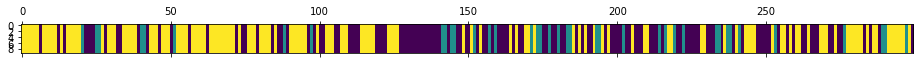

<Figure size 432x288 with 0 Axes>

936
N [[62. 20. 44.]
 [19. 10. 10.]
 [45.  9. 80.]]
alphas [[1.55951035 0.55403169 0.40777829]
 [1.11697734 0.9965647  0.40777829]
 [1.11697734 0.55403169 0.8503113 ]]
M [[7. 2. 3.]
 [4. 3. 2.]
 [4. 2. 4.]]
sum_w [[0.]
 [1.]
 [3.]]
barM [[7. 2. 3.]
 [4. 2. 2.]
 [4. 2. 1.]]
pi_z [[0.51961208 0.13847157 0.34191635]
 [0.47200298 0.29367036 0.23432666]
 [0.3169697  0.10241852 0.58061178]]
beta_vec [0.48560238 0.1675533  0.34684431]
hyper>> a_k: 3.2031698365440713  gamma: 0.747803773214942  rho: 0.14975803656142053


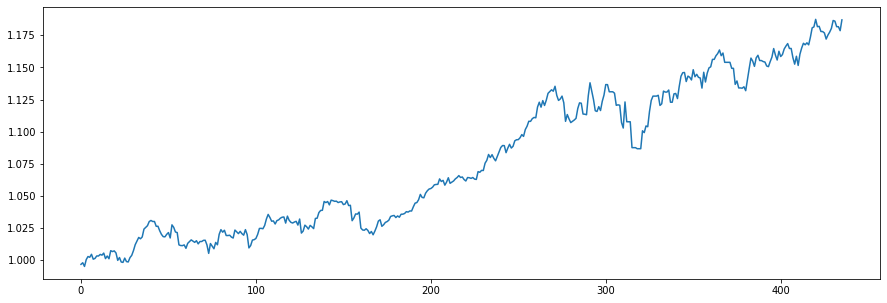

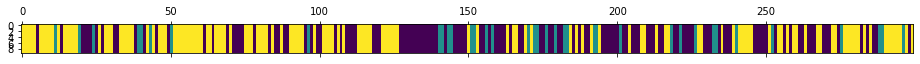

<Figure size 432x288 with 0 Axes>

N [[69. 16. 45.]
 [17.  9. 11.]
 [43. 12. 77.]]
alphas [[1.80222366 0.4563263  0.94461988]
 [1.32252323 0.93602672 0.94461988]
 [1.32252323 0.4563263  1.42432031]]
M [[10.  2.  4.]
 [ 7.  2.  3.]
 [ 6.  1.  6.]]
sum_w [[5.]
 [2.]
 [0.]]
barM [[5. 2. 4.]
 [7. 0. 3.]
 [6. 1. 6.]]
pi_z [[0.53549295 0.16201755 0.30248949]
 [0.46854314 0.20332358 0.32813328]
 [0.3911257  0.08108738 0.52778692]]
beta_vec [0.52650465 0.20846688 0.26502847]
hyper>> a_k: 3.5684053923505608  gamma: 0.46610981468172463  rho: 0.2574151189561631


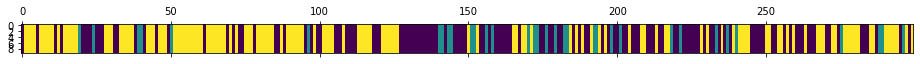

<Figure size 432x288 with 0 Axes>

937
N [[68. 17. 45.]
 [19.  8.  7.]
 [43.  9. 83.]]
alphas [[2.31371663 0.55240468 0.70228408]
 [1.39515513 1.47096618 0.70228408]
 [1.39515513 0.55240468 1.62084558]]
M [[9. 4. 5.]
 [8. 4. 3.]
 [5. 3. 4.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[5. 4. 5.]
 [8. 2. 3.]
 [5. 3. 1.]]
pi_z [[0.50229053 0.21497916 0.28273031]
 [0.48423931 0.31527926 0.20048143]
 [0.30851538 0.10145573 0.59002889]]
beta_vec [0.40804422 0.3004036  0.29155218]
hyper>> a_k: 5.90930020367956  gamma: 1.0158308509497411  rho: 0.19838851349680975


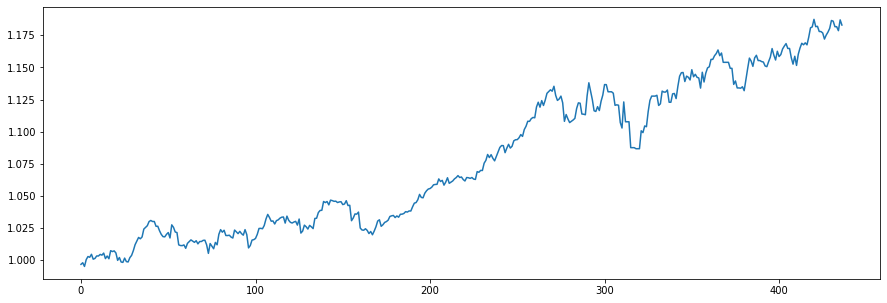

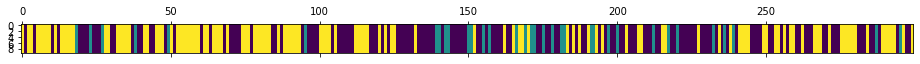

<Figure size 432x288 with 0 Axes>

N [[76. 20. 47.]
 [21.  6.  7.]
 [45.  8. 69.]]
alphas [[3.10522761 1.42300073 1.38107186]
 [1.93289033 2.59533802 1.38107186]
 [1.93289033 1.42300073 2.55340914]]
M [[ 7.  5.  5.]
 [ 5.  3.  4.]
 [10.  5.  5.]]
sum_w [[2.]
 [2.]
 [1.]]
barM [[ 5.  5.  5.]
 [ 5.  1.  4.]
 [10.  5.  4.]]
pi_z [[0.54573646 0.12655709 0.32770645]
 [0.61154559 0.19824888 0.19020554]
 [0.37314765 0.05830217 0.56855018]]
beta_vec [0.57632042 0.21506907 0.2086105 ]
hyper>> a_k: 5.101106077702983  gamma: 0.3680815374871899  rho: 0.1402200797994379


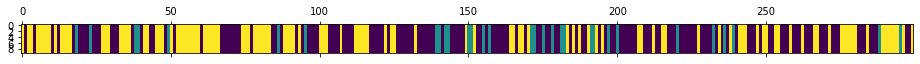

<Figure size 432x288 with 0 Axes>

938
N [[89. 18. 46.]
 [19.  7.  5.]
 [45.  6. 64.]]
alphas [[3.24292008 0.94325609 0.91492991]
 [2.52764258 1.65853359 0.91492991]
 [2.52764258 0.94325609 1.63020741]]
M [[10.  4.  3.]
 [ 5.  3.  2.]
 [ 6.  1.  5.]]
sum_w [[2.]
 [0.]
 [3.]]
barM [[8. 4. 3.]
 [5. 3. 2.]
 [6. 1. 2.]]
pi_z [[0.58330763 0.13416311 0.28252927]
 [0.7124148  0.24868874 0.03889645]
 [0.38081838 0.0809085  0.53827312]]
beta_vec [0.75599976 0.11030822 0.13369201]
hyper>> a_k: 3.1970915144014422  gamma: 0.7124627960252682  rho: 0.25381947616395995


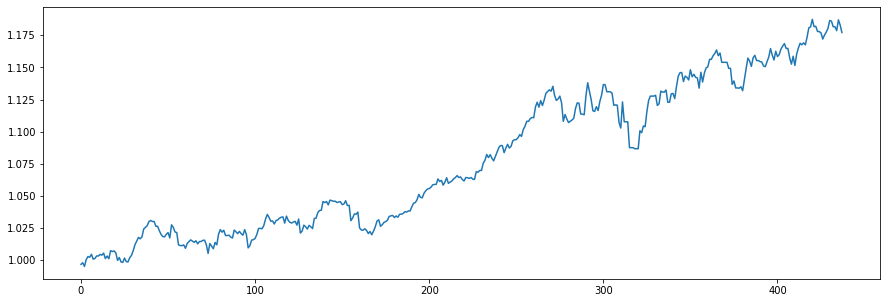

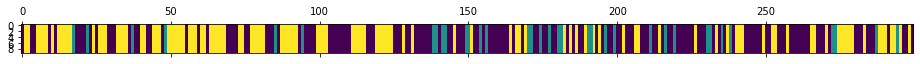

<Figure size 432x288 with 0 Axes>

N [[85. 20. 44.]
 [22.  8.  5.]
 [43.  7. 65.]]
alphas [[2.61500273 0.26315212 0.31893666]
 [1.80351864 1.07463621 0.31893666]
 [1.80351864 0.26315212 1.13042076]]
M [[9. 1. 1.]
 [7. 3. 1.]
 [7. 3. 6.]]
sum_w [[3.]
 [2.]
 [5.]]
barM [[6. 1. 1.]
 [7. 1. 1.]
 [7. 3. 1.]]
pi_z [[0.64504908 0.09671851 0.25823241]
 [0.57407251 0.24376474 0.18216275]
 [0.39333671 0.07183466 0.53482863]]
beta_vec [0.57719147 0.2440094  0.17879913]
hyper>> a_k: 4.288400586139085  gamma: 1.9771117744164841  rho: 0.24150453797814248


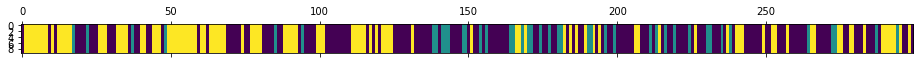

<Figure size 432x288 with 0 Axes>

939
N [[92. 23. 37.]
 [26. 10.  6.]
 [34.  9. 62.]]
alphas [[2.9131176  0.79369727 0.58158571]
 [1.8774494  1.82936547 0.58158571]
 [1.8774494  0.79369727 1.61725391]]
M [[17.  2.  3.]
 [ 7.  5.  2.]
 [ 7.  3.  4.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[13.  2.  3.]
 [ 7.  3.  2.]
 [ 7.  3.  1.]]
pi_z [[0.6912243  0.15063902 0.15813668]
 [0.67355409 0.16494321 0.1615027 ]
 [0.28544251 0.07480062 0.63975687]]
beta_vec [0.61880381 0.20853372 0.17266248]
hyper>> a_k: 4.533588711328789  gamma: 0.7555996795525884  rho: 0.1898476756144484


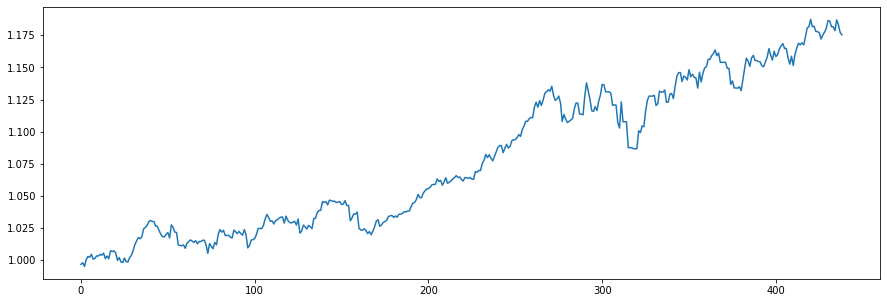

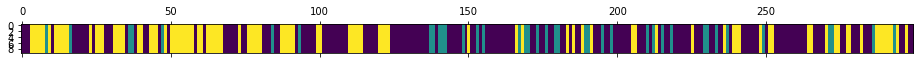

<Figure size 432x288 with 0 Axes>

N [[110.  22.  31.]
 [ 21.   9.   9.]
 [ 32.   8.  57.]]
alphas [[3.13349419 0.76592296 0.63417157]
 [2.27280291 1.62661424 0.63417157]
 [2.27280291 0.76592296 1.49486285]]
M [[12.  4.  3.]
 [ 6.  2.  3.]
 [ 7.  2.  5.]]
sum_w [[5.]
 [2.]
 [1.]]
barM [[7. 4. 3.]
 [6. 0. 3.]
 [7. 2. 4.]]
pi_z [[0.67928028 0.13576395 0.18495577]
 [0.45033356 0.20278458 0.34688185]
 [0.29175361 0.09495008 0.61329631]]
beta_vec [0.64191062 0.15916812 0.19892126]
hyper>> a_k: 4.558830923258851  gamma: 0.8789990160914984  rho: 0.20318138097302943


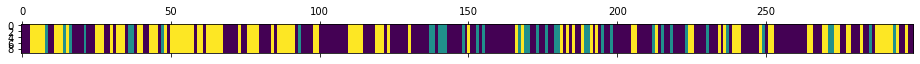

<Figure size 432x288 with 0 Axes>

940
N [[103.  21.  36.]
 [ 20.   8.  10.]
 [ 37.   9.  55.]]
alphas [[3.25804927 0.57818798 0.72259367]
 [2.33177971 1.50445754 0.72259367]
 [2.33177971 0.57818798 1.64886324]]
M [[13.  4.  2.]
 [ 6.  3.  1.]
 [ 4.  2.  9.]]
sum_w [[2.]
 [1.]
 [7.]]
barM [[11.  4.  2.]
 [ 6.  2.  1.]
 [ 4.  2.  2.]]
pi_z [[0.69166651 0.10621671 0.20211678]
 [0.53087366 0.21512899 0.25399735]
 [0.30418767 0.14054184 0.55527049]]
beta_vec [0.42789752 0.4008526  0.17124988]
hyper>> a_k: 4.13134792659058  gamma: 1.0591472998239284  rho: 0.1758736318971185


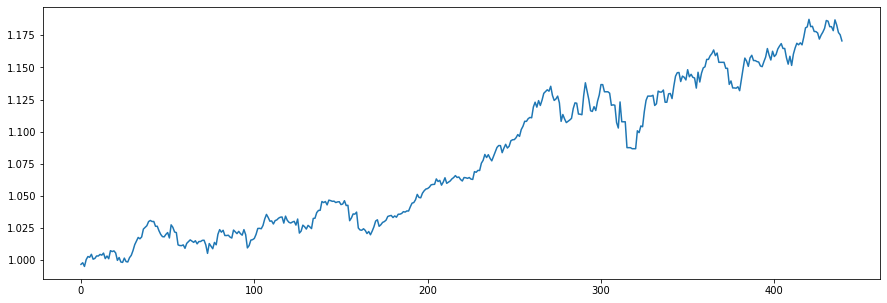

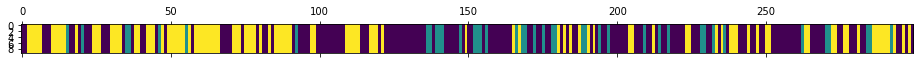

<Figure size 432x288 with 0 Axes>

N [[96. 19. 38.]
 [22. 12.  7.]
 [36. 10. 59.]]
alphas [[2.18348043 1.36480399 0.58306351]
 [1.45688527 2.09139915 0.58306351]
 [1.45688527 1.36480399 1.30965867]]
M [[6. 3. 3.]
 [4. 3. 1.]
 [3. 2. 7.]]
sum_w [[2.]
 [0.]
 [2.]]
barM [[4. 3. 3.]
 [4. 3. 1.]
 [3. 2. 5.]]
pi_z [[0.60409537 0.15130144 0.24460319]
 [0.67833386 0.20117943 0.12048671]
 [0.3145673  0.10985468 0.57557802]]
beta_vec [0.30316198 0.24758505 0.44925296]
hyper>> a_k: 2.6541054541834526  gamma: 0.11528774284810248  rho: 0.11736563883243023


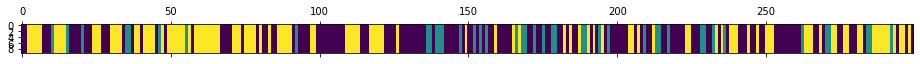

<Figure size 432x288 with 0 Axes>

941
N [[85. 20. 40.]
 [23. 11.  8.]
 [37. 11. 64.]]
alphas [[1.02168946 0.5799939  1.05242209]
 [0.71018868 0.89149468 1.05242209]
 [0.71018868 0.5799939  1.36392287]]
M [[6. 2. 3.]
 [4. 1. 2.]
 [8. 1. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[5. 2. 3.]
 [4. 0. 2.]
 [8. 1. 2.]]
pi_z [[0.61010698 0.15716059 0.23273243]
 [0.43264263 0.21316901 0.35418837]
 [0.30856512 0.1071608  0.58427408]]
beta_vec [0.65844436 0.09145749 0.25009815]
hyper>> a_k: 2.712168830252363  gamma: 0.21386470501419558  rho: 0.05241868410832799


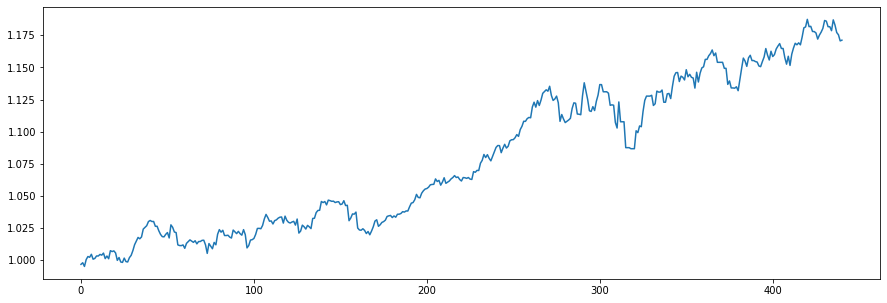

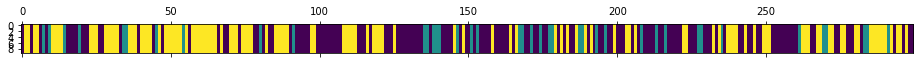

<Figure size 432x288 with 0 Axes>

N [[80. 20. 43.]
 [22. 10.  8.]
 [41. 10. 65.]]
alphas [[1.83437067 0.23504578 0.64275238]
 [1.69220234 0.37721411 0.64275238]
 [1.69220234 0.23504578 0.7849207 ]]
M [[11.  2.  2.]
 [ 4.  2.  2.]
 [ 3.  3.  2.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[9. 2. 2.]
 [4. 1. 2.]
 [3. 3. 1.]]
pi_z [[0.5665531  0.1410665  0.2923804 ]
 [0.57367593 0.24659446 0.17972961]
 [0.38045486 0.08397531 0.53556984]]
beta_vec [0.75817635 0.15823897 0.08358468]
hyper>> a_k: 3.1948041176221027  gamma: 0.5965195221262115  rho: 0.09608355924015843


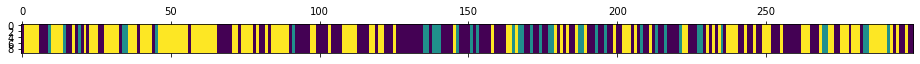

<Figure size 432x288 with 0 Axes>

942
N [[75. 18. 44.]
 [20. 10.  8.]
 [41. 10. 73.]]
alphas [[2.49645709 0.45696818 0.24137885]
 [2.18948894 0.76393633 0.24137885]
 [2.18948894 0.45696818 0.548347  ]]
M [[5. 1. 2.]
 [5. 4. 1.]
 [5. 1. 3.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[5. 1. 2.]
 [5. 2. 1.]
 [5. 1. 1.]]
pi_z [[0.55170498 0.09655301 0.35174201]
 [0.63865536 0.15009219 0.21125245]
 [0.34891579 0.06570054 0.58538367]]
beta_vec [0.49793816 0.19946632 0.30259553]
hyper>> a_k: 2.1558075440440088  gamma: 0.3741167899168284  rho: 0.17703197165648202


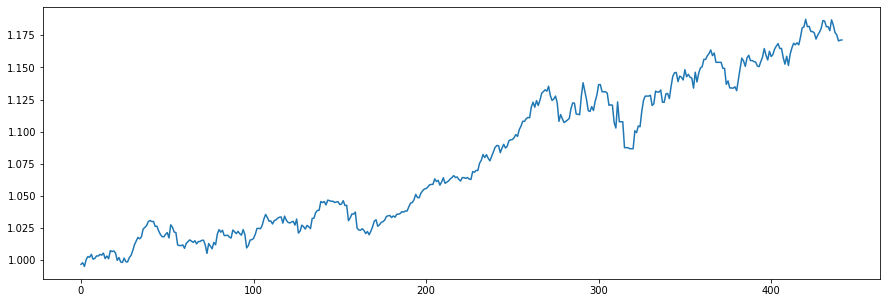

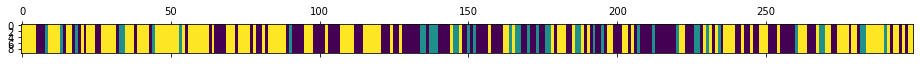

<Figure size 432x288 with 0 Axes>

N [[66. 16. 44.]
 [20. 11. 10.]
 [40. 14. 78.]]
alphas [[1.26506916 0.3538853  0.53685308]
 [0.8834223  0.73553216 0.53685308]
 [0.8834223  0.3538853  0.91849994]]
M [[6. 3. 2.]
 [1. 2. 3.]
 [4. 2. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[5. 3. 2.]
 [1. 1. 3.]
 [4. 2. 2.]]
pi_z [[0.45303399 0.15138563 0.39558038]
 [0.4510342  0.21552886 0.33343694]
 [0.34819696 0.13620813 0.5155949 ]]
beta_vec [0.49767652 0.14395946 0.35836402]
hyper>> a_k: 2.3141415609557683  gamma: 1.0039217402994782  rho: 0.10575937196723757


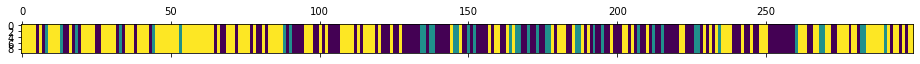

<Figure size 432x288 with 0 Axes>

943
N [[58. 18. 47.]
 [20.  9. 10.]
 [45. 12. 80.]]
alphas [[1.27463365 0.29790962 0.74159829]
 [1.02989149 0.54265178 0.74159829]
 [1.02989149 0.29790962 0.98634044]]
M [[5. 2. 3.]
 [3. 2. 5.]
 [2. 1. 4.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[4. 2. 3.]
 [3. 2. 5.]
 [2. 1. 3.]]
pi_z [[0.40053071 0.16067724 0.43879205]
 [0.60191768 0.20680393 0.19127839]
 [0.33992309 0.08246736 0.57760955]]
beta_vec [0.38712211 0.17299978 0.43987811]
hyper>> a_k: 1.664675440523705  gamma: 0.6277216994969194  rho: 0.1725013662702348


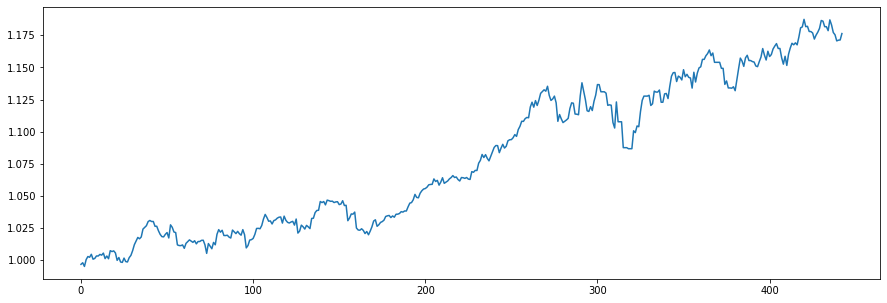

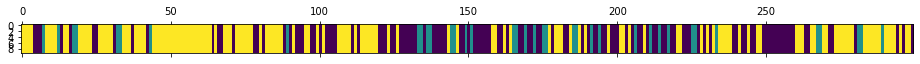

<Figure size 432x288 with 0 Axes>

N [[59. 16. 44.]
 [20. 11.  7.]
 [41. 11. 90.]]
alphas [[0.82042594 0.23831008 0.60593942]
 [0.53326715 0.52546887 0.60593942]
 [0.53326715 0.23831008 0.89309821]]
M [[6. 1. 2.]
 [1. 3. 1.]
 [4. 1. 9.]]
sum_w [[1.]
 [2.]
 [2.]]
barM [[5. 1. 2.]
 [1. 1. 1.]
 [4. 1. 7.]]
pi_z [[0.48177331 0.15361129 0.3646154 ]
 [0.41898895 0.34971646 0.2312946 ]
 [0.22510246 0.05057914 0.7243184 ]]
beta_vec [0.58068439 0.16724712 0.25206849]
hyper>> a_k: 1.8702872471761052  gamma: 1.3809943548463852  rho: 0.28756475911958523


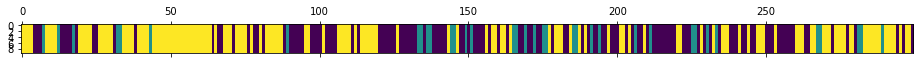

<Figure size 432x288 with 0 Axes>

944
N [[66. 17. 43.]
 [18. 10.  8.]
 [42.  9. 86.]]
alphas [[1.31156657 0.22284986 0.33587081]
 [0.77373787 0.76067856 0.33587081]
 [0.77373787 0.22284986 0.87369951]]
M [[6. 2. 3.]
 [5. 2. 2.]
 [8. 1. 5.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[4. 2. 3.]
 [5. 0. 2.]
 [8. 1. 2.]]
pi_z [[0.55656707 0.12744909 0.31598384]
 [0.46539758 0.28641567 0.24818676]
 [0.31453397 0.07489872 0.61056731]]
beta_vec [0.69464193 0.05028652 0.25507154]
hyper>> a_k: 2.7940220193125094  gamma: 0.6137282148740758  rho: 0.27803419218607583


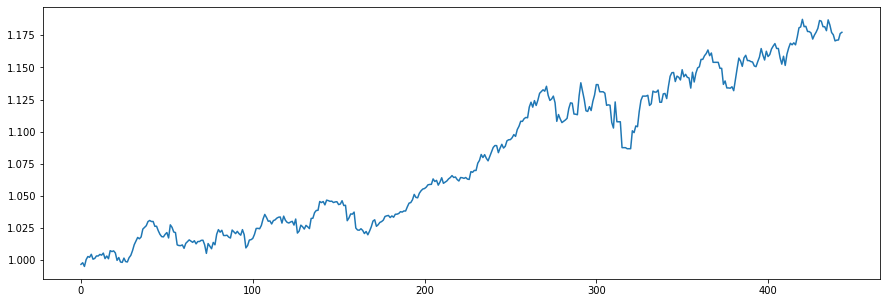

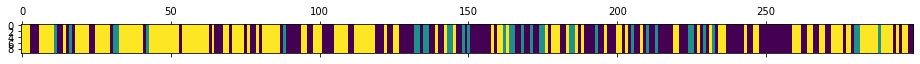

<Figure size 432x288 with 0 Axes>

N [[69. 17. 43.]
 [18.  9.  7.]
 [42.  8. 86.]]
alphas [[2.17805728 0.10143739 0.51452735]
 [1.40122362 0.87827104 0.51452735]
 [1.40122362 0.10143739 1.29136101]]
M [[9. 1. 3.]
 [4. 2. 1.]
 [5. 1. 6.]]
sum_w [[4.]
 [2.]
 [6.]]
barM [[5. 1. 3.]
 [4. 0. 1.]
 [5. 1. 0.]]
pi_z [[0.56707071 0.15872823 0.27420106]
 [0.44806192 0.39727321 0.15466486]
 [0.30866238 0.08261754 0.60872008]]
beta_vec [0.51627181 0.20513933 0.27858886]
hyper>> a_k: 3.268054973206836  gamma: 3.1807293293909336  rho: 0.34050865824568627


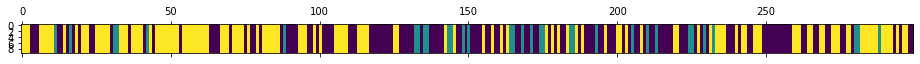

<Figure size 432x288 with 0 Axes>

945
N [[73. 16. 48.]
 [18.  9.  6.]
 [46.  8. 75.]]
alphas [[2.22549788 0.44212736 0.60042973]
 [1.11269687 1.55492837 0.60042973]
 [1.11269687 0.44212736 1.71323075]]
M [[10.  2.  3.]
 [ 5.  3.  3.]
 [ 6.  1.  8.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[7. 2. 3.]
 [5. 1. 3.]
 [6. 1. 4.]]
pi_z [[0.5683852  0.08305231 0.34856248]
 [0.58917921 0.17753163 0.23328916]
 [0.34769632 0.04356319 0.60874049]]
beta_vec [0.52613745 0.13466361 0.33919894]
hyper>> a_k: 5.288890929807555  gamma: 0.4448538372317761  rho: 0.2547528838780534


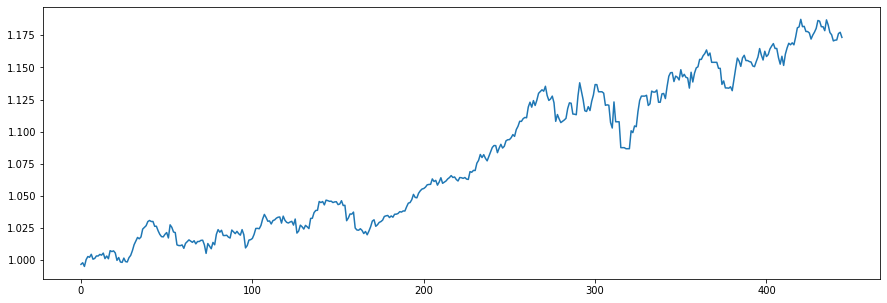

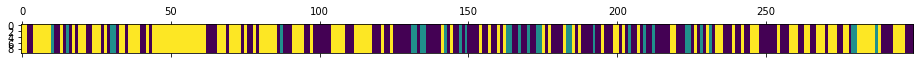

<Figure size 432x288 with 0 Axes>

N [[74. 19. 47.]
 [17.  8.  6.]
 [49.  4. 75.]]
alphas [[3.42114715 0.53078075 1.33696303]
 [2.07378693 1.87814097 1.33696303]
 [2.07378693 0.53078075 2.68432324]]
M [[ 8.  2.  3.]
 [10.  4.  4.]
 [ 4.  1. 11.]]
sum_w [[2.]
 [3.]
 [8.]]
barM [[ 6.  2.  3.]
 [10.  1.  4.]
 [ 4.  1.  3.]]
pi_z [[0.5367822  0.12421421 0.3390036 ]
 [0.67913438 0.20777047 0.11309514]
 [0.42545145 0.00912787 0.56542068]]
beta_vec [0.40920666 0.12963214 0.4611612 ]
hyper>> a_k: 5.059327283658416  gamma: 0.9448261930642576  rho: 0.30785071904336425


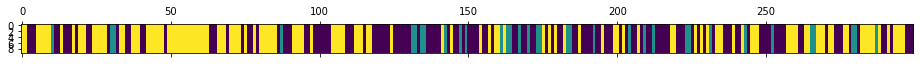

<Figure size 432x288 with 0 Axes>

946
N [[74. 21. 44.]
 [16.  9.  9.]
 [49.  4. 73.]]
alphas [[2.9904814  0.4539471  1.61489879]
 [1.43296386 2.01146464 1.61489879]
 [1.43296386 0.4539471  3.17241633]]
M [[12.  2.  9.]
 [ 5.  4.  6.]
 [ 7.  1.  8.]]
sum_w [[5.]
 [2.]
 [2.]]
barM [[7. 2. 9.]
 [5. 2. 6.]
 [7. 1. 6.]]
pi_z [[0.52998005 0.16522944 0.30479051]
 [0.26506405 0.32882502 0.40611093]
 [0.33806466 0.04328213 0.61865321]]
beta_vec [0.5128742  0.08876534 0.39836046]
hyper>> a_k: 5.650704905016623  gamma: 0.24445914468374141  rho: 0.24157962937331792


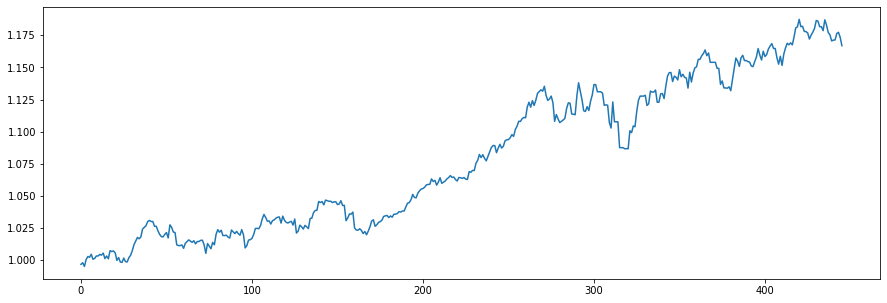

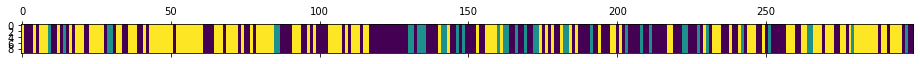

<Figure size 432x288 with 0 Axes>

N [[69. 21. 44.]
 [17. 11. 10.]
 [48.  6. 73.]]
alphas [[3.56307384 0.38041362 1.70721745]
 [2.19797864 1.74550881 1.70721745]
 [2.19797864 0.38041362 3.07231264]]
M [[13.  3.  4.]
 [ 6.  6.  3.]
 [ 6.  2. 10.]]
sum_w [[5.]
 [5.]
 [7.]]
barM [[8. 3. 4.]
 [6. 1. 3.]
 [6. 2. 3.]]
pi_z [[0.54305782 0.15785737 0.29908481]
 [0.30032778 0.34608882 0.35358339]
 [0.37651118 0.08814712 0.53534171]]
beta_vec [0.51011378 0.15194932 0.33793689]
hyper>> a_k: 5.436206969678614  gamma: 0.25265049596470474  rho: 0.4647393494124893


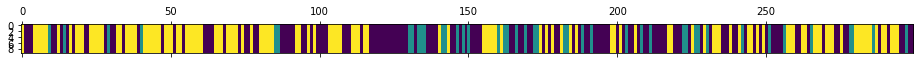

<Figure size 432x288 with 0 Axes>

947
N [[69. 23. 43.]
 [22. 11. 10.]
 [44.  9. 68.]]
alphas [[4.0107421  0.44214026 0.98332461]
 [1.48432281 2.96855955 0.98332461]
 [1.48432281 0.44214026 3.5097439 ]]
M [[10.  2.  5.]
 [ 4.  6.  1.]
 [ 2.  1. 11.]]
sum_w [[8.]
 [6.]
 [5.]]
barM [[2. 2. 5.]
 [4. 0. 1.]
 [2. 1. 6.]]
pi_z [[0.50104204 0.11855935 0.38039861]
 [0.47396533 0.27141293 0.25462173]
 [0.27393553 0.07333247 0.652732  ]]
beta_vec [0.24254995 0.1205677  0.63688235]
hyper>> a_k: 4.984376090700516  gamma: 1.039923157455752  rho: 0.533148646552845


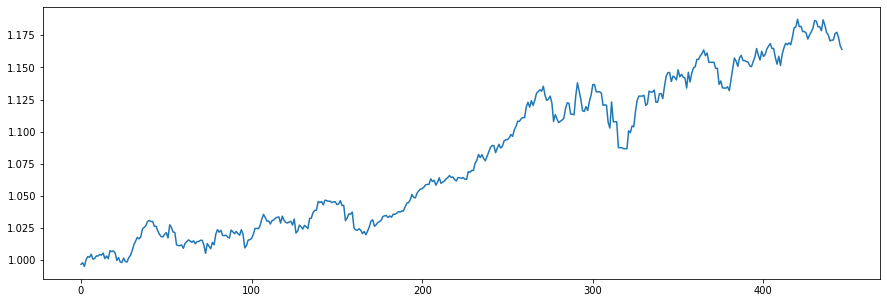

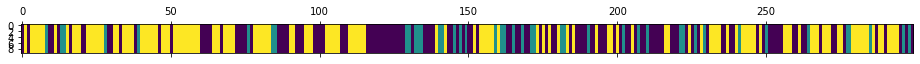

<Figure size 432x288 with 0 Axes>

N [[64. 21. 40.]
 [22. 11. 10.]
 [40. 10. 81.]]
alphas [[3.22181806 0.28055655 1.48200148]
 [0.5644047  2.93796991 1.48200148]
 [0.5644047  0.28055655 4.13941485]]
M [[11.  1.  3.]
 [ 2.  7.  2.]
 [ 4.  1. 16.]]
sum_w [[11.]
 [ 7.]
 [10.]]
barM [[0. 1. 3.]
 [2. 0. 2.]
 [4. 1. 6.]]
pi_z [[0.46722349 0.21047438 0.32230213]
 [0.50156666 0.27851825 0.21991508]
 [0.30920858 0.0800615  0.61072991]]
beta_vec [0.47141395 0.03770361 0.49088243]
hyper>> a_k: 4.568330903746127  gamma: 0.705357919164619  rho: 0.7118312953767004


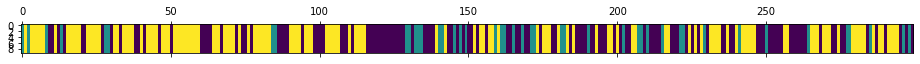

<Figure size 432x288 with 0 Axes>

948
N [[63. 21. 42.]
 [21. 12. 10.]
 [42. 10. 78.]]
alphas [[3.8724738  0.04963492 0.64622218]
 [0.62059289 3.30151583 0.64622218]
 [0.62059289 0.04963492 3.89810309]]
M [[10.  1.  1.]
 [ 2.  2.  2.]
 [ 3.  2. 11.]]
sum_w [[ 7.]
 [ 2.]
 [10.]]
barM [[3. 1. 1.]
 [2. 0. 2.]
 [3. 2. 1.]]
pi_z [[0.5224512  0.17956426 0.29798454]
 [0.55500884 0.30093532 0.14405584]
 [0.32572969 0.07609912 0.59817119]]
beta_vec [0.48432816 0.15238386 0.36328798]
hyper>> a_k: 2.4593233759944533  gamma: 2.536598219540628  rho: 0.5542463610732546


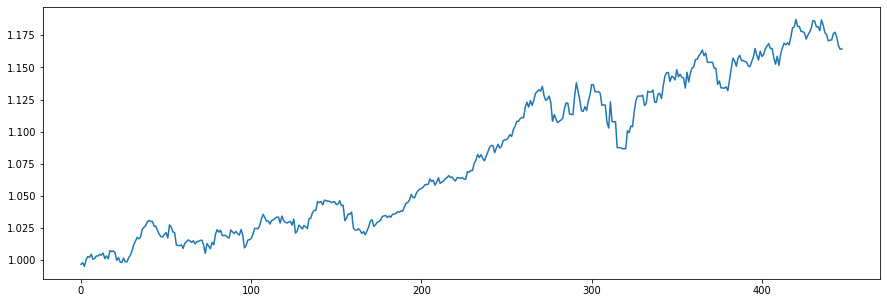

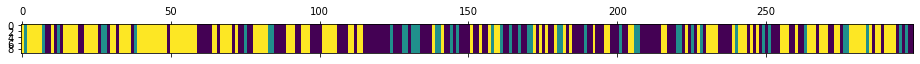

<Figure size 432x288 with 0 Axes>

N [[67. 23. 39.]
 [22. 11. 11.]
 [40. 10. 76.]]
alphas [[1.89401691 0.16705116 0.3982553 ]
 [0.53094588 1.53012219 0.3982553 ]
 [0.53094588 0.16705116 1.76132634]]
M [[8. 2. 3.]
 [1. 2. 1.]
 [2. 2. 6.]]
sum_w [[6.]
 [1.]
 [5.]]
barM [[2. 2. 3.]
 [1. 1. 1.]
 [2. 2. 1.]]
pi_z [[0.48554288 0.15070852 0.3637486 ]
 [0.43325879 0.25498957 0.31175164]
 [0.34988318 0.08596152 0.5641553 ]]
beta_vec [0.37598206 0.37374881 0.25026913]
hyper>> a_k: 2.430754081742789  gamma: 0.7589991571240043  rho: 0.4302409052799379


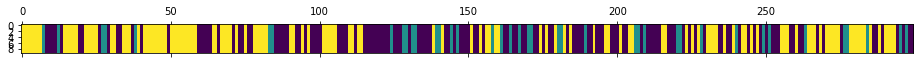

<Figure size 432x288 with 0 Axes>

949
N [[69. 23. 43.]
 [20. 10. 10.]
 [46.  7. 71.]]
alphas [[1.56652402 0.51762127 0.34660879]
 [0.52071419 1.56343111 0.34660879]
 [0.52071419 0.51762127 1.39241862]]
M [[5. 1. 3.]
 [3. 4. 3.]
 [2. 2. 9.]]
sum_w [[2.]
 [3.]
 [6.]]
barM [[3. 1. 3.]
 [3. 1. 3.]
 [2. 2. 3.]]
pi_z [[0.53716876 0.17251123 0.29032001]
 [0.50320651 0.23897802 0.25781547]
 [0.38377691 0.0461287  0.57009439]]
beta_vec [0.31798788 0.30212157 0.37989055]
hyper>> a_k: 2.952653384099563  gamma: 1.086817860458382  rho: 0.5016141217489704


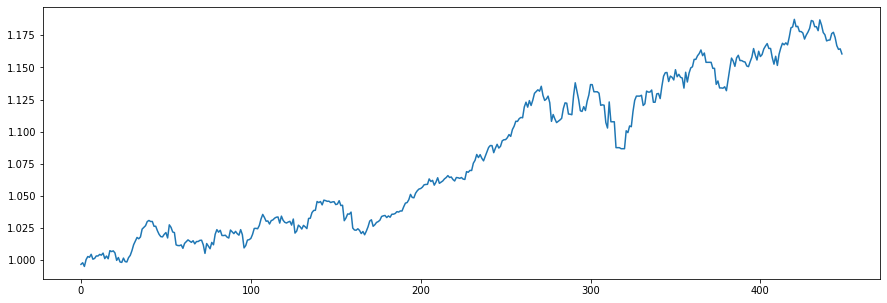

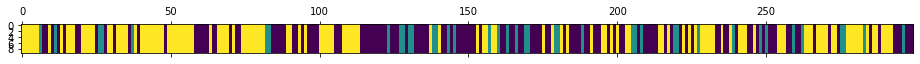

<Figure size 432x288 with 0 Axes>

N [[67. 22. 41.]
 [20. 10. 10.]
 [43.  8. 78.]]
alphas [[1.94903112 0.44459024 0.55903202]
 [0.46793848 1.92568288 0.55903202]
 [0.46793848 0.44459024 2.04012466]]
M [[6. 2. 2.]
 [2. 6. 2.]
 [5. 2. 4.]]
sum_w [[6.]
 [3.]
 [3.]]
barM [[0. 2. 2.]
 [2. 3. 2.]
 [5. 2. 1.]]
pi_z [[0.51960035 0.13209953 0.34830012]
 [0.49371816 0.29224254 0.21403929]
 [0.42826174 0.04568556 0.5260527 ]]
beta_vec [0.49605453 0.27964637 0.2242991 ]
hyper>> a_k: 3.35332822206533  gamma: 0.47672023151829485  rho: 0.3810369946895661


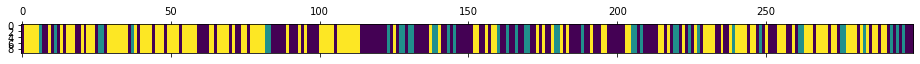

<Figure size 432x288 with 0 Axes>

950
N [[61. 23. 47.]
 [21. 11.  9.]
 [49.  7. 71.]]
alphas [[2.307346   0.58043013 0.46555209]
 [1.02960389 1.85817224 0.46555209]
 [1.02960389 0.58043013 1.7432942 ]]
M [[6. 3. 2.]
 [6. 3. 1.]
 [5. 1. 6.]]
sum_w [[5.]
 [3.]
 [5.]]
barM [[1. 3. 2.]
 [6. 0. 1.]
 [5. 1. 1.]]
pi_z [[0.50421909 0.18149253 0.31428838]
 [0.50149618 0.19103624 0.30746759]
 [0.34695802 0.05730941 0.59573257]]
beta_vec [0.7382462  0.04333041 0.21842339]
hyper>> a_k: 4.564638331526872  gamma: 1.3602954014676785  rho: 0.3241371227796722


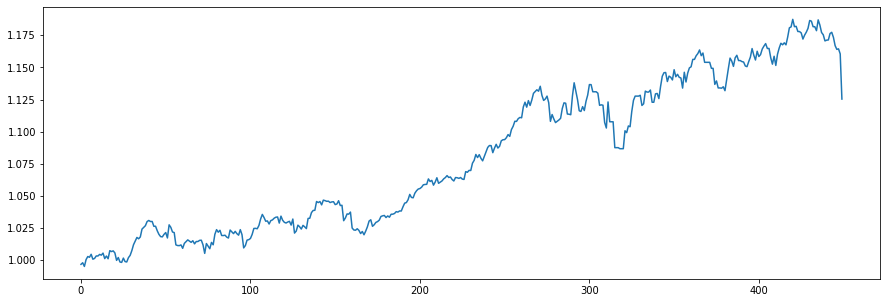

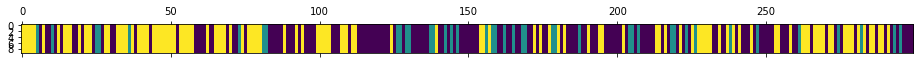

<Figure size 432x288 with 0 Axes>

N [[74. 22. 47.]
 [22. 10.  9.]
 [47.  9. 59.]]
alphas [[3.75710964 0.13367733 0.67385136]
 [2.27754091 1.61324606 0.67385136]
 [2.27754091 0.13367733 2.1534201 ]]
M [[13.  1.  2.]
 [ 6.  6.  3.]
 [ 7.  1. 10.]]
sum_w [[5.]
 [5.]
 [8.]]
barM [[8. 1. 2.]
 [6. 1. 3.]
 [7. 1. 2.]]
pi_z [[0.48093559 0.16440051 0.35466391]
 [0.42720779 0.19708931 0.3757029 ]
 [0.41349747 0.06666843 0.5198341 ]]
beta_vec [0.77108489 0.06723776 0.16167735]
hyper>> a_k: 4.893907182395923  gamma: 0.699051628311836  rho: 0.470052236265911


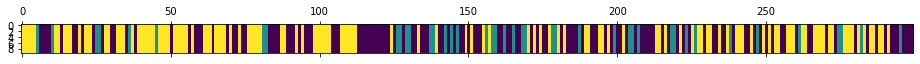

<Figure size 432x288 with 0 Axes>

951
N [[59. 20. 53.]
 [22. 11.  9.]
 [51. 11. 63.]]
alphas [[4.30021238 0.17438215 0.41931265]
 [1.99982037 2.47477417 0.41931265]
 [1.99982037 0.17438215 2.71970466]]
M [[11.  1.  1.]
 [ 7.  3.  2.]
 [ 7.  1.  8.]]
sum_w [[5.]
 [3.]
 [7.]]
barM [[6. 1. 1.]
 [7. 0. 2.]
 [7. 1. 1.]]
pi_z [[0.48835894 0.14867529 0.36296577]
 [0.6327244  0.2087803  0.1584953 ]
 [0.46268815 0.08078934 0.45652252]]
beta_vec [0.70381674 0.12983251 0.16635076]
hyper>> a_k: 5.108262986665731  gamma: 0.4000891160524826  rho: 0.38700889984436987


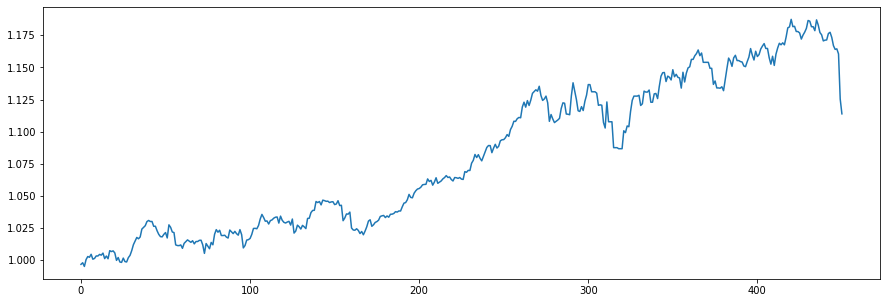

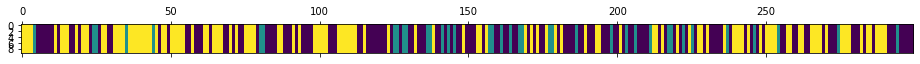

<Figure size 432x288 with 0 Axes>

N [[70. 22. 49.]
 [21.  9.  8.]
 [50.  7. 63.]]
alphas [[4.18081849 0.40654709 0.52089741]
 [2.20387525 2.38349033 0.52089741]
 [2.20387525 0.40654709 2.49784065]]
M [[11.  3.  3.]
 [ 5.  3.  1.]
 [ 8.  2.  7.]]
sum_w [[7.]
 [3.]
 [6.]]
barM [[4. 3. 3.]
 [5. 0. 1.]
 [8. 2. 1.]]
pi_z [[0.49690975 0.16160721 0.34148304]
 [0.46902176 0.38235886 0.14861938]
 [0.44821191 0.05220635 0.49958174]]
beta_vec [0.50308992 0.28066734 0.21624274]
hyper>> a_k: 3.0383783663504293  gamma: 1.7459128289649564  rho: 0.38317477456925475


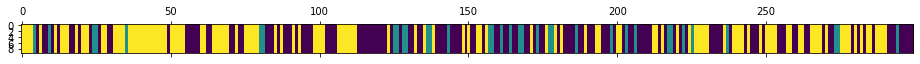

<Figure size 432x288 with 0 Axes>

952
N [[73. 20. 46.]
 [17. 10.  8.]
 [49.  5. 71.]]
alphas [[2.10709512 0.52601226 0.40527098]
 [0.94286518 1.69024221 0.40527098]
 [0.94286518 0.52601226 1.56950093]]
M [[6. 2. 3.]
 [2. 3. 1.]
 [4. 1. 6.]]
sum_w [[5.]
 [2.]
 [3.]]
barM [[1. 2. 3.]
 [2. 1. 1.]
 [4. 1. 3.]]
pi_z [[0.52374875 0.16083594 0.31541531]
 [0.45586884 0.30316135 0.24096981]
 [0.3414863  0.03787678 0.62063692]]
beta_vec [0.48629727 0.21899033 0.29471241]
hyper>> a_k: 2.182081845173384  gamma: 0.6104524743141783  rho: 0.3042693405406406


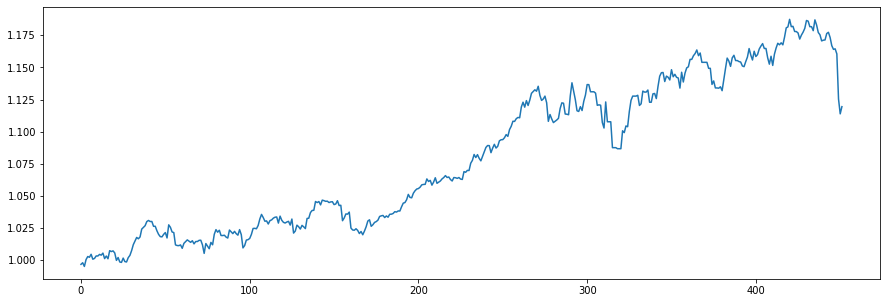

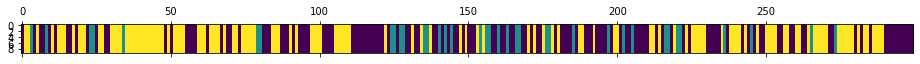

<Figure size 432x288 with 0 Axes>

N [[69. 21. 45.]
 [17. 10. 10.]
 [49.  6. 72.]]
alphas [[1.40220854 0.33245824 0.44741506]
 [0.73826793 0.99639885 0.44741506]
 [0.73826793 0.33245824 1.11135567]]
M [[8. 2. 1.]
 [3. 2. 2.]
 [6. 1. 5.]]
sum_w [[5.]
 [2.]
 [2.]]
barM [[3. 2. 1.]
 [3. 0. 2.]
 [6. 1. 3.]]
pi_z [[0.45829043 0.17295762 0.36875195]
 [0.56229079 0.17603517 0.26167404]
 [0.41045477 0.03561363 0.5539316 ]]
beta_vec [0.68548517 0.01984069 0.29467414]
hyper>> a_k: 2.4457841237268623  gamma: 0.7224957522762286  rho: 0.30303681344093425


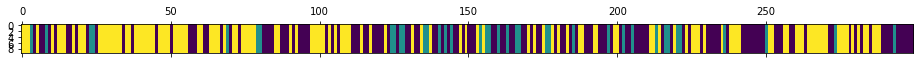

<Figure size 432x288 with 0 Axes>

953
N [[63. 22. 49.]
 [18. 10. 10.]
 [53.  6. 68.]]
alphas [[1.90965539 0.03382086 0.50230787]
 [1.16849276 0.77498349 0.50230787]
 [1.16849276 0.03382086 1.2434705 ]]
M [[10.  1.  5.]
 [ 4.  2.  1.]
 [ 5.  1.  6.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[6. 1. 5.]
 [4. 0. 1.]
 [5. 1. 3.]]
pi_z [[0.5236761  0.13590893 0.34041497]
 [0.4530071  0.3049048  0.2420881 ]
 [0.38615303 0.03490008 0.57894689]]
beta_vec [0.65229454 0.04328044 0.30442502]
hyper>> a_k: 3.4100544804030224  gamma: 0.7966840625788091  rho: 0.2100232610641228


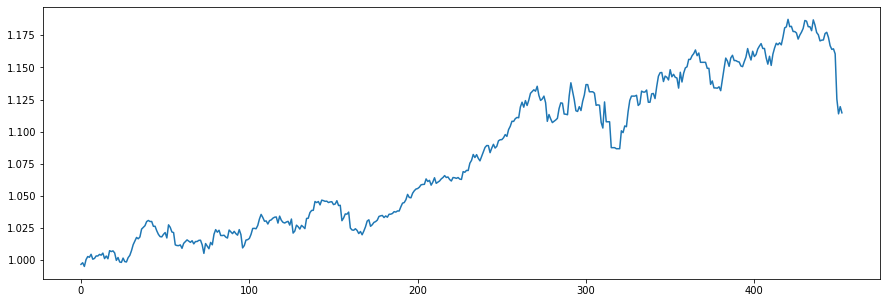

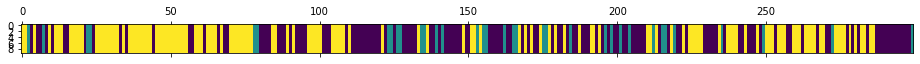

<Figure size 432x288 with 0 Axes>

N [[71. 18. 45.]
 [16.  9.  9.]
 [46.  8. 77.]]
alphas [[2.47338335 0.11659162 0.82007952]
 [1.75719259 0.83278238 0.82007952]
 [1.75719259 0.11659162 1.53627028]]
M [[9. 3. 1.]
 [6. 3. 3.]
 [8. 1. 4.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[7. 3. 1.]
 [6. 2. 3.]
 [8. 1. 2.]]
pi_z [[0.52083929 0.14263333 0.33652739]
 [0.31901939 0.38678277 0.29419783]
 [0.41249347 0.07312335 0.51438318]]
beta_vec [0.60311768 0.22164761 0.17523471]
hyper>> a_k: 3.504435693033991  gamma: 0.8500605804349436  rho: 0.19770909490301108


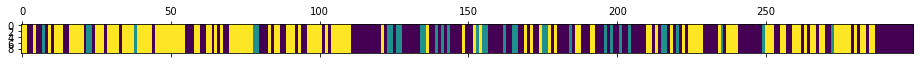

<Figure size 432x288 with 0 Axes>

954
N [[77. 19. 45.]
 [19.  9.  6.]
 [45.  6. 73.]]
alphas [[2.38857052 0.62317931 0.49268586]
 [1.69571172 1.31603812 0.49268586]
 [1.69571172 0.62317931 1.18554467]]
M [[7. 4. 2.]
 [3. 2. 1.]
 [5. 4. 4.]]
sum_w [[3.]
 [0.]
 [1.]]
barM [[4. 4. 2.]
 [3. 2. 1.]
 [5. 4. 3.]]
pi_z [[0.52814469 0.16338197 0.30847334]
 [0.48082218 0.25171716 0.26746066]
 [0.37796586 0.0413711  0.58066304]]
beta_vec [0.47277325 0.34974303 0.17748372]
hyper>> a_k: 3.274450616720615  gamma: 0.6217443722640507  rho: 0.11076749331880338


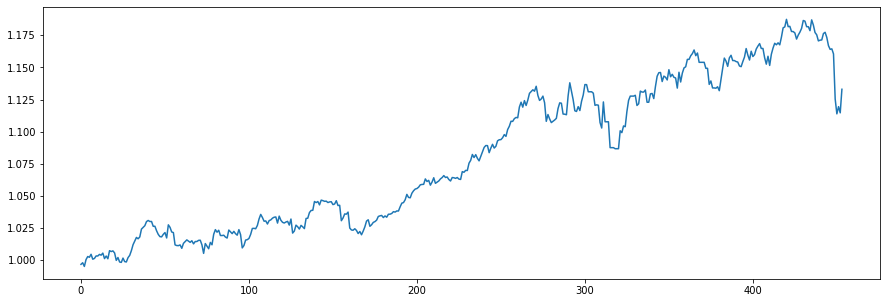

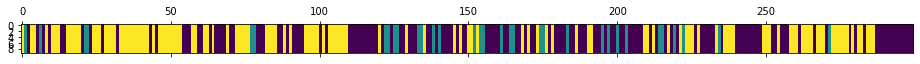

<Figure size 432x288 with 0 Axes>

N [[78. 19. 45.]
 [17.  9.  7.]
 [47.  5. 72.]]
alphas [[1.73929922 1.01836355 0.51678785]
 [1.37659653 1.38106623 0.51678785]
 [1.37659653 1.01836355 0.87949054]]
M [[5. 3. 2.]
 [5. 2. 2.]
 [6. 2. 7.]]
sum_w [[1.]
 [0.]
 [4.]]
barM [[4. 3. 2.]
 [5. 2. 2.]
 [6. 2. 3.]]
pi_z [[0.52161424 0.15764856 0.3207372 ]
 [0.44283144 0.44915335 0.10801521]
 [0.40887351 0.03276169 0.5583648 ]]
beta_vec [0.61037299 0.22153751 0.1680895 ]
hyper>> a_k: 1.941323330457435  gamma: 1.1059580653349093  rho: 0.3197324197856658


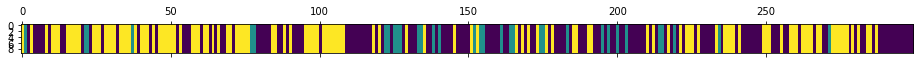

<Figure size 432x288 with 0 Axes>

955
N [[79. 17. 51.]
 [17. 10.  6.]
 [51.  6. 62.]]
alphas [[1.42677438 0.29256672 0.22198224]
 [0.80607037 0.91327072 0.22198224]
 [0.80607037 0.29256672 0.84268624]]
M [[7. 3. 2.]
 [2. 2. 1.]
 [8. 3. 5.]]
sum_w [[4.]
 [1.]
 [4.]]
barM [[3. 3. 2.]
 [2. 1. 1.]
 [8. 3. 1.]]
pi_z [[0.57815092 0.11289582 0.30895326]
 [0.37814442 0.39419932 0.22765626]
 [0.46121652 0.0406166  0.49816688]]
beta_vec [0.59491243 0.23542349 0.16966408]
hyper>> a_k: 2.935209713392199  gamma: 1.437892334381203  rho: 0.2964817418806554


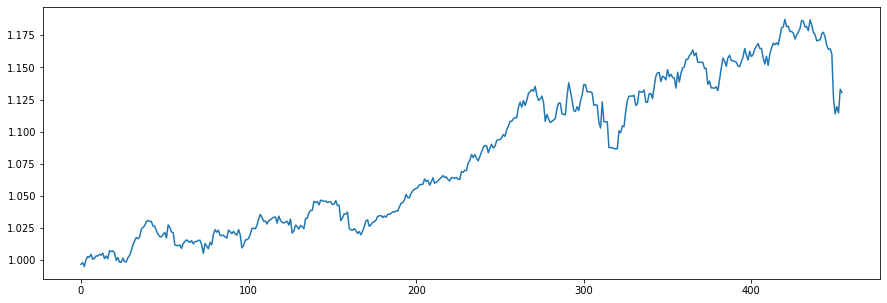

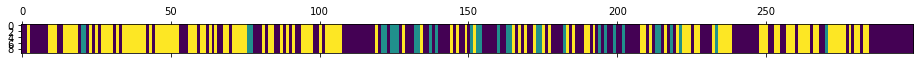

<Figure size 432x288 with 0 Axes>

N [[77. 14. 53.]
 [17. 10.  5.]
 [50.  8. 65.]]
alphas [[2.09871456 0.4861433  0.35035185]
 [1.22847847 1.35637939 0.35035185]
 [1.22847847 0.4861433  1.22058794]]
M [[10.  3.  2.]
 [ 3.  6.  1.]
 [ 7.  2.  3.]]
sum_w [[4.]
 [4.]
 [1.]]
barM [[6. 3. 2.]
 [3. 2. 1.]
 [7. 2. 2.]]
pi_z [[0.63269801 0.08200771 0.28529427]
 [0.52067862 0.26828289 0.21103849]
 [0.3778099  0.0567151  0.565475  ]]
beta_vec [0.63730273 0.23762623 0.12507104]
hyper>> a_k: 4.104744158159054  gamma: 0.9856117251005917  rho: 0.3007659925321774


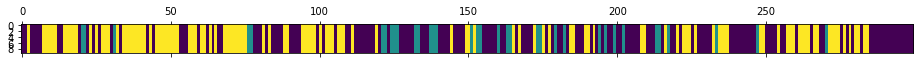

<Figure size 432x288 with 0 Axes>

956
N [[86. 16. 46.]
 [17. 12.  6.]
 [45.  7. 64.]]
alphas [[3.06373891 0.68202927 0.35897598]
 [1.82917146 1.91659673 0.35897598]
 [1.82917146 0.68202927 1.59354343]]
M [[13.  4.  3.]
 [ 6.  4.  2.]
 [ 7.  3.  8.]]
sum_w [[6.]
 [3.]
 [5.]]
barM [[7. 4. 3.]
 [6. 1. 2.]
 [7. 3. 3.]]
pi_z [[0.5088947  0.15610819 0.33499712]
 [0.46464192 0.41257006 0.12278802]
 [0.3060228  0.08773583 0.60624137]]
beta_vec [0.53798133 0.21064643 0.25137224]
hyper>> a_k: 5.970909391414824  gamma: 0.2602373528277169  rho: 0.3110781034355749


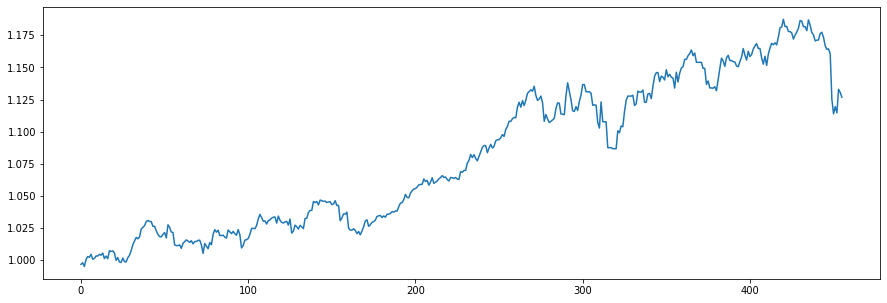

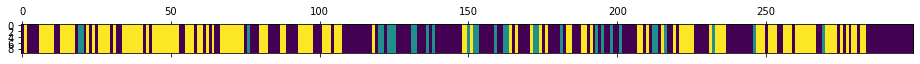

<Figure size 432x288 with 0 Axes>

N [[89. 16. 42.]
 [17.  9.  5.]
 [41.  6. 74.]]
alphas [[4.0704001  0.86649202 1.03401727]
 [2.21298093 2.72391119 1.03401727]
 [2.21298093 0.86649202 2.89143644]]
M [[15.  2.  2.]
 [ 3.  3.  2.]
 [ 6.  2. 13.]]
sum_w [[5.]
 [2.]
 [8.]]
barM [[10.  2.  2.]
 [ 3.  1.  2.]
 [ 6.  2.  5.]]
pi_z [[0.63913673 0.13696119 0.22390208]
 [0.49397545 0.37390838 0.13211617]
 [0.36220343 0.06418706 0.5736095 ]]
beta_vec [0.71400572 0.08325394 0.20274034]
hyper>> a_k: 5.361032145961198  gamma: 1.0675019865257387  rho: 0.28378020718763314


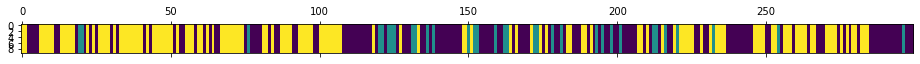

<Figure size 432x288 with 0 Axes>

957
N [[75. 18. 45.]
 [17.  9.  7.]
 [46.  6. 76.]]
alphas [[4.26290639 0.31966827 0.77845749]
 [2.74155157 1.84102308 0.77845749]
 [2.74155157 0.31966827 2.29981231]]
M [[15.  3.  6.]
 [ 6.  4.  1.]
 [ 7.  2.  7.]]
sum_w [[5.]
 [3.]
 [5.]]
barM [[10.  3.  6.]
 [ 6.  1.  1.]
 [ 7.  2.  2.]]
pi_z [[0.56105678 0.17728958 0.26165364]
 [0.56658864 0.22524029 0.20817107]
 [0.31538468 0.02608877 0.65852655]]
beta_vec [0.67736494 0.02295153 0.29968353]
hyper>> a_k: 5.6020947270371355  gamma: 0.2905940452869982  rho: 0.29149472186877706


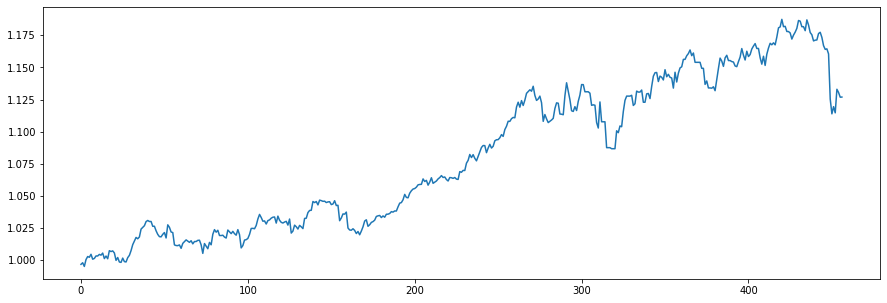

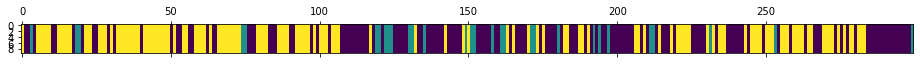

<Figure size 432x288 with 0 Axes>

N [[82. 14. 45.]
 [13. 10.  6.]
 [45.  6. 78.]]
alphas [[4.32151951 0.09109722 1.189478  ]
 [2.68853847 1.72407827 1.189478  ]
 [2.68853847 0.09109722 2.82245904]]
M [[13.  2.  3.]
 [ 7.  4.  1.]
 [ 8.  1. 13.]]
sum_w [[ 6.]
 [ 4.]
 [10.]]
barM [[7. 2. 3.]
 [7. 0. 1.]
 [8. 1. 3.]]
pi_z [[0.53550796 0.11205845 0.35243359]
 [0.3207323  0.29279287 0.38647483]
 [0.23911727 0.03157034 0.72931239]]
beta_vec [0.6470306  0.03473775 0.31823164]
hyper>> a_k: 5.220738383246309  gamma: 0.32914338866666837  rho: 0.2905053460239677


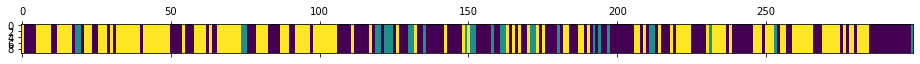

<Figure size 432x288 with 0 Axes>

958
N [[84. 14. 41.]
 [13. 10.  6.]
 [42.  5. 84.]]
alphas [[3.91330939 0.12867163 1.17875736]
 [2.39665698 1.64532404 1.17875736]
 [2.39665698 0.12867163 2.69540977]]
M [[15.  1.  8.]
 [ 5.  5.  4.]
 [ 9.  1.  8.]]
sum_w [[6.]
 [3.]
 [2.]]
barM [[9. 1. 8.]
 [5. 2. 4.]
 [9. 1. 6.]]
pi_z [[0.5873473  0.10985417 0.30279853]
 [0.33350826 0.40417578 0.26231596]
 [0.32738373 0.02172276 0.65089351]]
beta_vec [0.55310941 0.07846755 0.36842303]
hyper>> a_k: 7.758032827515039  gamma: 0.6856540377145077  rho: 0.09224004972070339


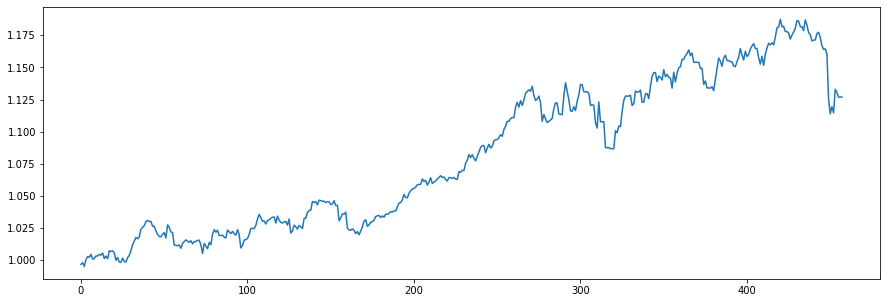

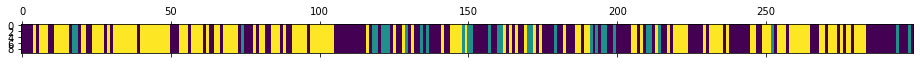

<Figure size 432x288 with 0 Axes>

N [[71. 18. 45.]
 [15.  9.  7.]
 [49.  3. 82.]]
alphas [[4.61083649 0.55260238 2.59459396]
 [3.89523516 1.26820371 2.59459396]
 [3.89523516 0.55260238 3.31019529]]
M [[13.  3. 12.]
 [ 5.  5.  3.]
 [ 7.  1. 12.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[12.  3. 12.]
 [ 5.  4.  3.]
 [ 7.  1. 10.]]
pi_z [[0.50049036 0.11274424 0.3867654 ]
 [0.67810247 0.16641163 0.1554859 ]
 [0.35181378 0.01734272 0.63084351]]
beta_vec [0.44782336 0.12497514 0.4272015 ]
hyper>> a_k: 6.791789342429068  gamma: 0.7856976403421072  rho: 0.10065402457720941


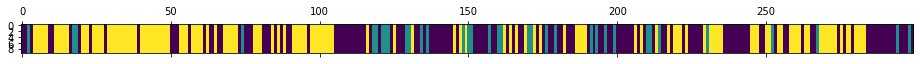

<Figure size 432x288 with 0 Axes>

959
N [[75. 20. 42.]
 [20.  9.  6.]
 [42.  6. 79.]]
alphas [[3.41900144 0.76336919 2.60941871]
 [2.73538051 1.44699012 2.60941871]
 [2.73538051 0.76336919 3.29303964]]
M [[15.  2.  7.]
 [10.  3.  5.]
 [ 5.  4. 14.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[12.  2.  7.]
 [10.  2.  5.]
 [ 5.  4. 11.]]
pi_z [[0.51684263 0.14870798 0.33444938]
 [0.70693423 0.22795689 0.06510889]
 [0.29142899 0.05457938 0.65399162]]
beta_vec [0.44516506 0.18752013 0.3673148 ]
hyper>> a_k: 8.122061602253433  gamma: 0.9394507120830409  rho: 0.13949532094854836


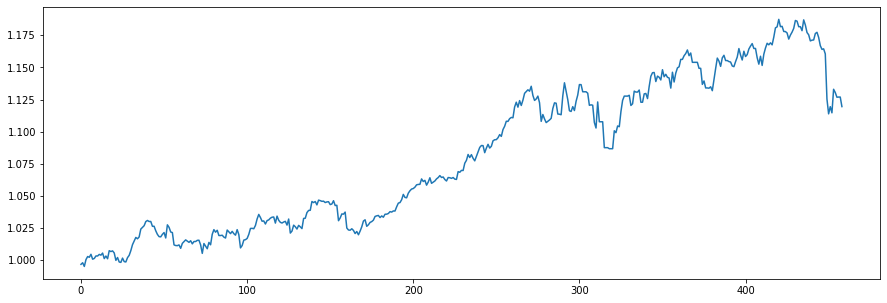

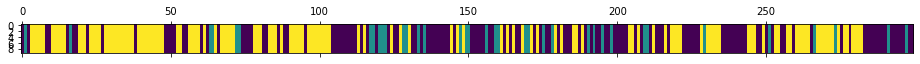

<Figure size 432x288 with 0 Axes>

N [[72. 18. 43.]
 [20. 10.  7.]
 [41.  9. 79.]]
alphas [[4.24428028 1.31059172 2.5671896 ]
 [3.11129069 2.44358131 2.5671896 ]
 [3.11129069 1.31059172 3.70017919]]
M [[12.  2.  7.]
 [ 7.  3.  4.]
 [ 8.  5. 13.]]
sum_w [[6.]
 [2.]
 [3.]]
barM [[ 6.  2.  7.]
 [ 7.  1.  4.]
 [ 8.  5. 10.]]
pi_z [[0.5668549  0.13374921 0.29939589]
 [0.52922619 0.26907156 0.20170225]
 [0.36319192 0.03465706 0.60215102]]
beta_vec [0.43365829 0.15933966 0.40700204]
hyper>> a_k: 6.203672743041819  gamma: 0.5582938734071371  rho: 0.18458850474682453


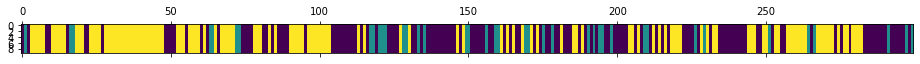

<Figure size 432x288 with 0 Axes>

960
N [[73. 20. 40.]
 [20. 13.  7.]
 [40.  7. 79.]]
alphas [[3.33880713 0.80602703 2.05883858]
 [2.19368046 1.95115371 2.05883858]
 [2.19368046 0.80602703 3.20396525]]
M [[ 9.  1.  7.]
 [ 7.  5.  3.]
 [ 9.  2. 12.]]
sum_w [[0.]
 [3.]
 [4.]]
barM [[9. 1. 7.]
 [7. 2. 3.]
 [9. 2. 8.]]
pi_z [[0.55162263 0.09625001 0.35212736]
 [0.53825585 0.27221507 0.18952908]
 [0.282352   0.07687481 0.64077319]]
beta_vec [0.49766401 0.09253175 0.40980425]
hyper>> a_k: 6.511777813035376  gamma: 0.40260888119566146  rho: 0.1258805521544334


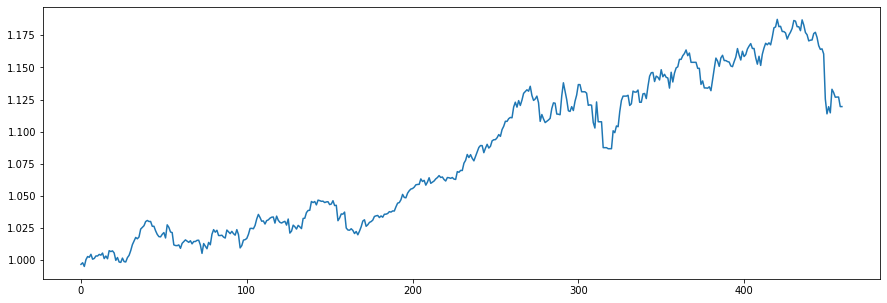

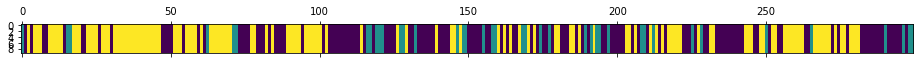

<Figure size 432x288 with 0 Axes>

N [[75. 18. 40.]
 [18. 12.  9.]
 [40.  9. 78.]]
alphas [[3.65244535 0.52669734 2.33263512]
 [2.83273917 1.34640353 2.33263512]
 [2.83273917 0.52669734 3.15234131]]
M [[ 6.  2.  7.]
 [ 6.  3.  4.]
 [10.  2.  8.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[ 6.  2.  7.]
 [ 6.  1.  4.]
 [10.  2.  6.]]
pi_z [[0.49262862 0.11923985 0.38813152]
 [0.49177895 0.20324565 0.3049754 ]
 [0.34887987 0.05804138 0.59307876]]
beta_vec [0.41878322 0.13594915 0.44526763]
hyper>> a_k: 4.522522781726823  gamma: 0.7266657805110147  rho: 0.13427471747128586


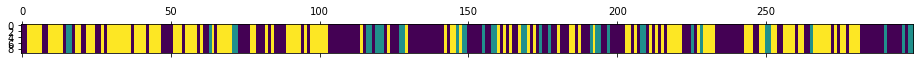

<Figure size 432x288 with 0 Axes>

961
N [[80. 15. 45.]
 [17. 13.  7.]
 [43.  9. 70.]]
alphas [[2.24690662 0.53227658 1.74333958]
 [1.63964615 1.13953705 1.74333958]
 [1.63964615 0.53227658 2.35060005]]
M [[7. 1. 5.]
 [9. 4. 5.]
 [8. 2. 7.]]
sum_w [[1.]
 [4.]
 [1.]]
barM [[6. 1. 5.]
 [9. 0. 5.]
 [8. 2. 6.]]
pi_z [[0.6269466  0.07682876 0.29622464]
 [0.29812916 0.47584922 0.22602162]
 [0.39230424 0.08473972 0.52295604]]
beta_vec [0.50119698 0.14263827 0.35616475]
hyper>> a_k: 4.5370568749843425  gamma: 0.8442555908923486  rho: 0.11528549676346503


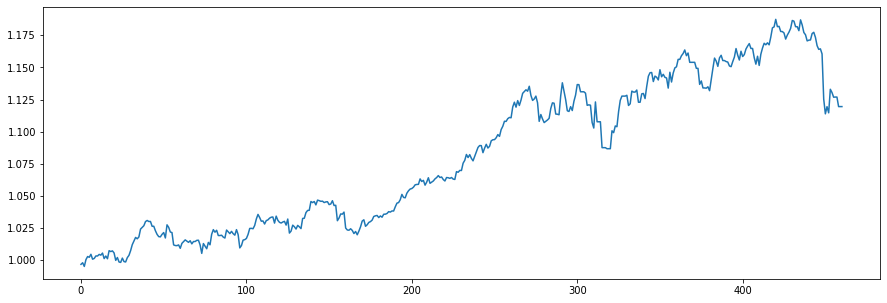

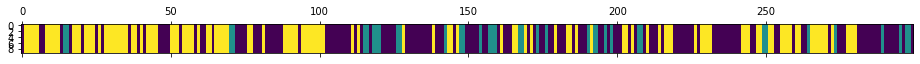

<Figure size 432x288 with 0 Axes>

N [[87. 16. 41.]
 [17. 14.  6.]
 [41.  6. 71.]]
alphas [[2.53486153 0.57255001 1.42964533]
 [2.01180468 1.09560686 1.42964533]
 [2.01180468 0.57255001 1.95270219]]
M [[11.  3.  7.]
 [ 6.  2.  3.]
 [ 7.  2.  9.]]
sum_w [[3.]
 [0.]
 [4.]]
barM [[8. 3. 7.]
 [6. 2. 3.]
 [7. 2. 5.]]
pi_z [[0.58590815 0.12598939 0.28810245]
 [0.55642054 0.31633168 0.12724778]
 [0.44621456 0.08222746 0.47155798]]
beta_vec [0.50405888 0.11770517 0.37823595]
hyper>> a_k: 5.3881479431405905  gamma: 0.5706784139334916  rho: 0.10431074780930276


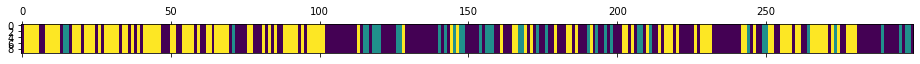

<Figure size 432x288 with 0 Axes>

962
N [[80. 20. 45.]
 [21. 12.  6.]
 [44.  7. 64.]]
alphas [[2.99468344 0.56805764 1.82540687]
 [2.4326417  1.13009938 1.82540687]
 [2.4326417  0.56805764 2.38744861]]
M [[11.  4.  6.]
 [ 8.  5.  3.]
 [ 8.  3.  8.]]
sum_w [[2.]
 [1.]
 [3.]]
barM [[9. 4. 6.]
 [8. 4. 3.]
 [8. 3. 5.]]
pi_z [[0.55031081 0.09471877 0.35497042]
 [0.57210972 0.27107017 0.15682011]
 [0.40726722 0.06617302 0.52655976]]
beta_vec [0.37616817 0.38921144 0.23462039]
hyper>> a_k: 4.142290669863938  gamma: 0.3175178027006134  rho: 0.1193124888018938


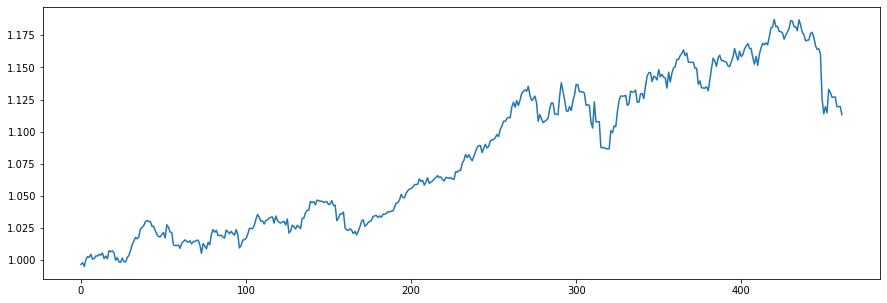

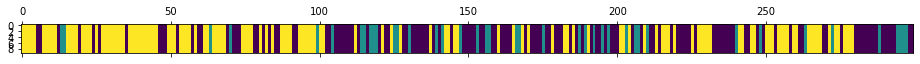

<Figure size 432x288 with 0 Axes>

N [[67. 19. 43.]
 [22. 11.  8.]
 [40. 11. 78.]]
alphas [[1.86651242 1.41986813 0.85591012]
 [1.37228541 1.91409514 0.85591012]
 [1.37228541 1.41986813 1.35013713]]
M [[7. 6. 3.]
 [8. 3. 1.]
 [4. 4. 6.]]
sum_w [[2.]
 [1.]
 [5.]]
barM [[5. 6. 3.]
 [8. 2. 1.]
 [4. 4. 1.]]
pi_z [[0.47578616 0.1561086  0.36810523]
 [0.58186633 0.23821666 0.17991701]
 [0.30137537 0.07647955 0.62214507]]
beta_vec [0.55106065 0.36391343 0.08502592]
hyper>> a_k: 2.9978170508077326  gamma: 0.8764088064965422  rho: 0.23076550966173237


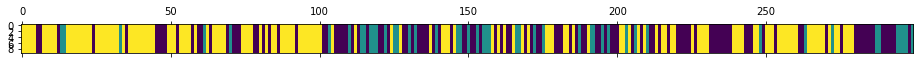

<Figure size 432x288 with 0 Axes>

963
N [[53. 20. 42.]
 [24. 14.  9.]
 [38. 13. 86.]]
alphas [[1.96255202 0.8391932  0.19607183]
 [1.27075924 1.53098598 0.19607183]
 [1.27075924 0.8391932  0.88786461]]
M [[6. 5. 1.]
 [2. 6. 1.]
 [3. 3. 3.]]
sum_w [[3.]
 [0.]
 [2.]]
barM [[3. 5. 1.]
 [2. 6. 1.]
 [3. 3. 1.]]
pi_z [[0.42111384 0.17927268 0.39961348]
 [0.50766316 0.2406356  0.25170124]
 [0.27019675 0.08956639 0.64023686]]
beta_vec [0.30733599 0.66710149 0.02556253]
hyper>> a_k: 2.6946521670933645  gamma: 0.7136227290332535  rho: 0.3695869180761045


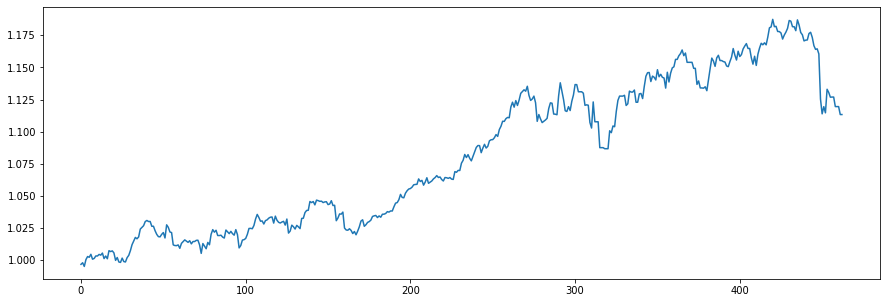

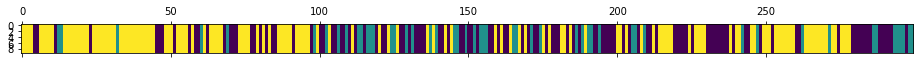

<Figure size 432x288 with 0 Axes>

N [[53. 22. 40.]
 [24. 15. 11.]
 [38. 13. 83.]]
alphas [[1.51799334 1.13323463 0.04342419]
 [0.52208516 2.12914282 0.04342419]
 [0.52208516 1.13323463 1.03933238]]
M [[8. 2. 1.]
 [2. 4. 1.]
 [4. 3. 3.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[5. 2. 1.]
 [2. 3. 1.]
 [4. 3. 0.]]
pi_z [[0.40819182 0.19950153 0.39230665]
 [0.5078368  0.29472625 0.19743694]
 [0.33008479 0.09176551 0.5781497 ]]
beta_vec [0.44993526 0.51885053 0.03121421]
hyper>> a_k: 2.014090398285137  gamma: 1.6503052935815032  rho: 0.30330775845541225


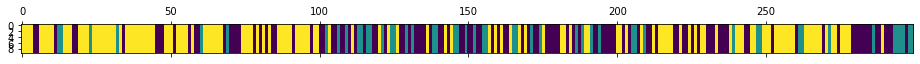

<Figure size 432x288 with 0 Axes>

964
N [[50. 20. 45.]
 [24. 15. 11.]
 [41. 15. 78.]]
alphas [[1.24223892 0.72805166 0.04379982]
 [0.63134968 1.33894091 0.04379982]
 [0.63134968 0.72805166 0.65468906]]
M [[6. 1. 2.]
 [1. 5. 2.]
 [2. 6. 5.]]
sum_w [[3.]
 [1.]
 [5.]]
barM [[3. 1. 2.]
 [1. 4. 2.]
 [2. 6. 0.]]
pi_z [[0.48197544 0.16429946 0.35372509]
 [0.48403229 0.31425494 0.20171277]
 [0.25467217 0.10765668 0.63767114]]
beta_vec [0.34037154 0.3373865  0.32224196]
hyper>> a_k: 2.009134501331103  gamma: 0.4735294039574818  rho: 0.32536343193796924


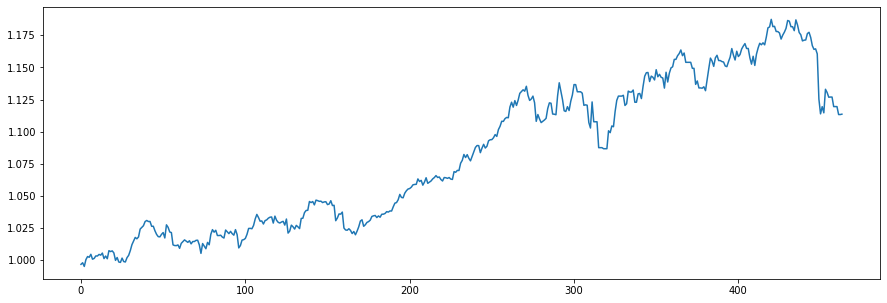

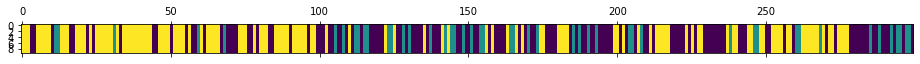

<Figure size 432x288 with 0 Axes>

N [[63. 22. 42.]
 [26. 12.  9.]
 [39. 12. 74.]]
alphas [[1.1150506  0.45730568 0.43677823]
 [0.4613517  1.11100457 0.43677823]
 [0.4613517  0.45730568 1.09047712]]
M [[4. 1. 3.]
 [2. 3. 3.]
 [2. 4. 8.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[2. 1. 3.]
 [2. 1. 3.]
 [2. 4. 3.]]
pi_z [[0.59722001 0.11592078 0.28685921]
 [0.54360551 0.22101648 0.23537801]
 [0.33736948 0.09482974 0.56780079]]
beta_vec [0.36031343 0.19164324 0.44804333]
hyper>> a_k: 2.280393126347787  gamma: 0.48621914225978585  rho: 0.19739718019328603


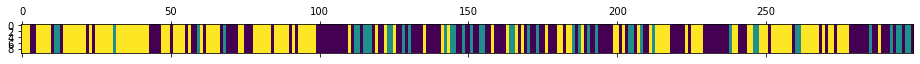

<Figure size 432x288 with 0 Axes>

965
N [[69. 21. 38.]
 [22. 13.  9.]
 [37. 10. 80.]]
alphas [[1.10960681 0.35075503 0.82003128]
 [0.65946364 0.8008982  0.82003128]
 [0.65946364 0.35075503 1.27017446]]
M [[3. 1. 4.]
 [2. 5. 2.]
 [4. 1. 6.]]
sum_w [[0.]
 [2.]
 [2.]]
barM [[3. 1. 4.]
 [2. 3. 2.]
 [4. 1. 4.]]
pi_z [[0.53870836 0.10902624 0.3522654 ]
 [0.55115359 0.25748644 0.19135997]
 [0.31059838 0.10592946 0.58347216]]
beta_vec [0.45901647 0.18754201 0.35344152]
hyper>> a_k: 3.0455567938924455  gamma: 1.3015287825523374  rho: 0.15536253009751277


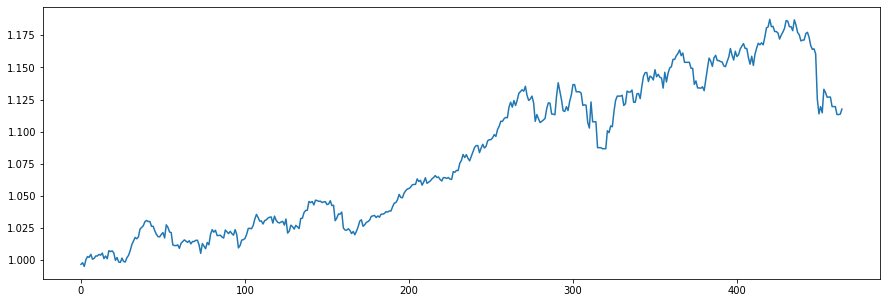

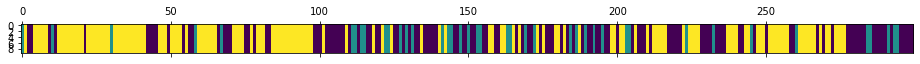

<Figure size 432x288 with 0 Axes>

N [[63. 22. 37.]
 [24.  9.  8.]
 [35. 10. 91.]]
alphas [[1.65393541 0.48243146 0.90918993]
 [1.18077    0.95559687 0.90918993]
 [1.18077    0.48243146 1.38235533]]
M [[6. 2. 2.]
 [6. 2. 3.]
 [3. 2. 4.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[5. 2. 2.]
 [6. 0. 3.]
 [3. 2. 4.]]
pi_z [[0.49000411 0.17827589 0.33171999]
 [0.57651857 0.15445582 0.26902561]
 [0.22583549 0.09330854 0.68085597]]
beta_vec [0.4158643  0.17206215 0.41207355]
hyper>> a_k: 2.1146662702980272  gamma: 0.9205008344664237  rho: 0.1298646131859175


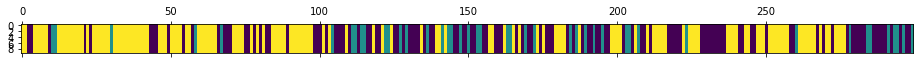

<Figure size 432x288 with 0 Axes>

966
N [[56. 23. 39.]
 [26. 10.  8.]
 [37. 10. 90.]]
alphas [[1.03982973 0.31660227 0.75823427]
 [0.76520941 0.59122258 0.75823427]
 [0.76520941 0.31660227 1.03285459]]
M [[2. 2. 2.]
 [6. 3. 1.]
 [4. 2. 6.]]
sum_w [[0.]
 [2.]
 [3.]]
barM [[2. 2. 2.]
 [6. 1. 1.]
 [4. 2. 3.]]
pi_z [[0.53718168 0.17508348 0.28773483]
 [0.58742533 0.16757776 0.24499691]
 [0.29123435 0.04739552 0.66137013]]
beta_vec [0.61902531 0.16702628 0.21394841]
hyper>> a_k: 2.275595481583094  gamma: 0.3542194956503725  rho: 0.18867713845085743


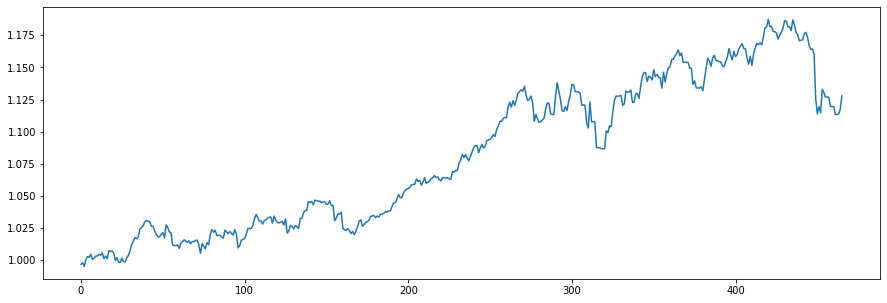

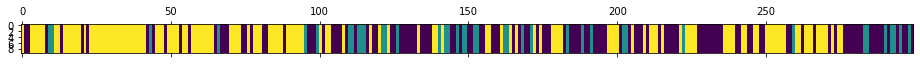

<Figure size 432x288 with 0 Axes>

N [[65. 19. 41.]
 [22. 12.  6.]
 [39.  8. 87.]]
alphas [[1.57222377 0.30837104 0.39500067]
 [1.14287092 0.73772389 0.39500067]
 [1.14287092 0.30837104 0.82435352]]
M [[8. 3. 5.]
 [4. 2. 1.]
 [6. 3. 2.]]
sum_w [[4.]
 [0.]
 [0.]]
barM [[4. 3. 5.]
 [4. 2. 1.]
 [6. 3. 2.]]
pi_z [[0.56052062 0.1356585  0.30382088]
 [0.56735652 0.30420873 0.12843476]
 [0.30113177 0.0735097  0.62535853]]
beta_vec [0.52753686 0.39106313 0.08140001]
hyper>> a_k: 3.250109511765375  gamma: 0.2580110081811198  rho: 0.05818917693261622


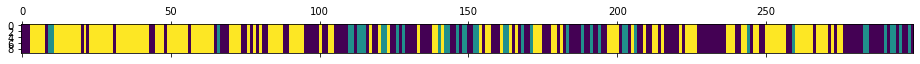

<Figure size 432x288 with 0 Axes>

967
N [[67. 21. 39.]
 [22. 12.  6.]
 [38.  7. 87.]]
alphas [[1.80390535 1.19703968 0.24916448]
 [1.61478416 1.38616088 0.24916448]
 [1.61478416 1.19703968 0.43828567]]
M [[7. 6. 2.]
 [6. 2. 2.]
 [5. 2. 3.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[5. 6. 2.]
 [6. 1. 2.]
 [5. 2. 2.]]
pi_z [[0.49759614 0.20191014 0.30049371]
 [0.47492161 0.29829766 0.22678073]
 [0.27259168 0.0819309  0.64547742]]
beta_vec [0.41031976 0.42657485 0.16310539]
hyper>> a_k: 3.3738363141556853  gamma: 0.5774204343145107  rho: 0.1293489564301345


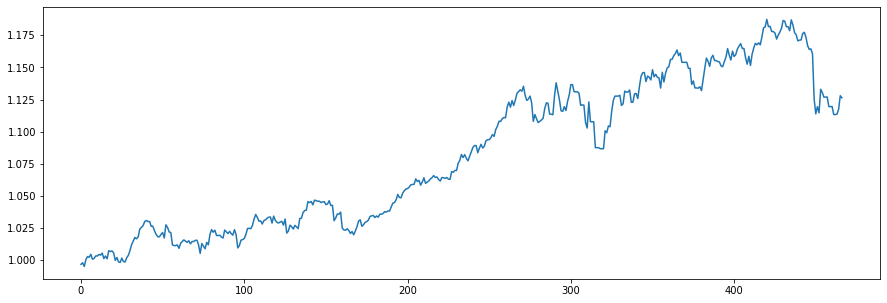

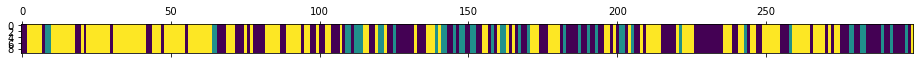

<Figure size 432x288 with 0 Axes>

N [[65. 21. 37.]
 [21. 13.  8.]
 [36.  8. 90.]]
alphas [[1.64168948 1.2530355  0.47911134]
 [1.20528727 1.68943771 0.47911134]
 [1.20528727 1.2530355  0.91551354]]
M [[5. 5. 3.]
 [1. 3. 3.]
 [4. 3. 8.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[4. 5. 3.]
 [1. 2. 3.]
 [4. 3. 7.]]
pi_z [[0.62112899 0.11313359 0.26573742]
 [0.47110247 0.33610865 0.19278888]
 [0.22360348 0.06827242 0.7081241 ]]
beta_vec [0.36014982 0.16028992 0.47956026]
hyper>> a_k: 3.578149540767866  gamma: 0.648544444284461  rho: 0.10226527649248754


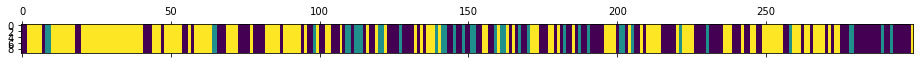

<Figure size 432x288 with 0 Axes>

968
N [[70. 18. 39.]
 [20. 11.  7.]
 [37.  9. 88.]]
alphas [[1.52280418 0.51488795 1.54045741]
 [1.15688373 0.8808084  1.54045741]
 [1.15688373 0.51488795 1.90637786]]
M [[6. 2. 7.]
 [3. 5. 2.]
 [7. 1. 9.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[5. 2. 7.]
 [3. 4. 2.]
 [7. 1. 7.]]
pi_z [[0.55709883 0.11102974 0.33187143]
 [0.45977362 0.21724928 0.3229771 ]
 [0.25560809 0.0864183  0.65797361]]
beta_vec [0.38421665 0.18847584 0.42730751]
hyper>> a_k: 3.18675330282801  gamma: 0.29951285918384235  rho: 0.1268587716349673


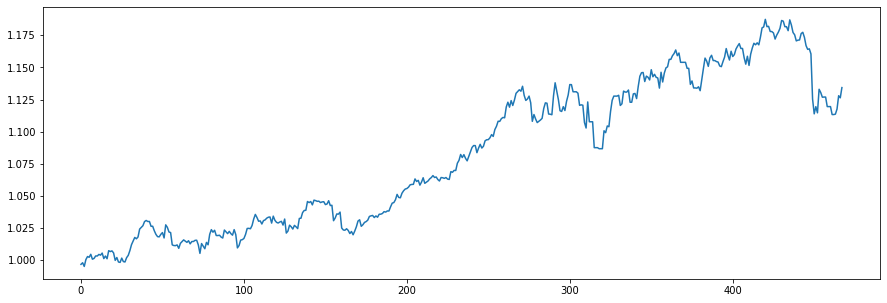

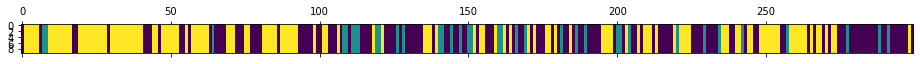

<Figure size 432x288 with 0 Axes>

N [[76. 19. 39.]
 [21.  9.  6.]
 [38.  8. 83.]]
alphas [[1.47334494 0.52443134 1.18897702]
 [1.06907733 0.92869895 1.18897702]
 [1.06907733 0.52443134 1.59324463]]
M [[6. 3. 4.]
 [6. 2. 4.]
 [5. 2. 7.]]
sum_w [[1.]
 [0.]
 [0.]]
barM [[5. 3. 4.]
 [6. 2. 4.]
 [5. 2. 7.]]
pi_z [[0.59465966 0.09568907 0.30965127]
 [0.61688492 0.18622388 0.1968912 ]
 [0.33922706 0.04377127 0.61700167]]
beta_vec [0.46992458 0.16575565 0.36431977]
hyper>> a_k: 4.5167870361779325  gamma: 1.54474677242717  rho: 0.09643009686835932


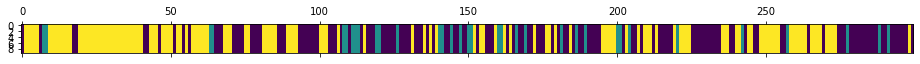

<Figure size 432x288 with 0 Axes>

969
N [[80. 19. 36.]
 [17. 10.  7.]
 [38.  5. 87.]]
alphas [[2.35342583 0.6764874  1.4868738 ]
 [1.91787162 1.11204161 1.4868738 ]
 [1.91787162 0.6764874  1.92242802]]
M [[10.  2.  6.]
 [ 4.  2.  4.]
 [ 8.  1. 10.]]
sum_w [[1.]
 [0.]
 [3.]]
barM [[9. 2. 6.]
 [4. 2. 4.]
 [8. 1. 7.]]
pi_z [[0.61312193 0.14087937 0.24599871]
 [0.64053432 0.22098316 0.13848252]
 [0.27098337 0.0704534  0.65856323]]
beta_vec [0.53299662 0.14097339 0.32603   ]
hyper>> a_k: 4.503354429916725  gamma: 0.12718357506064656  rho: 0.11499940958619952


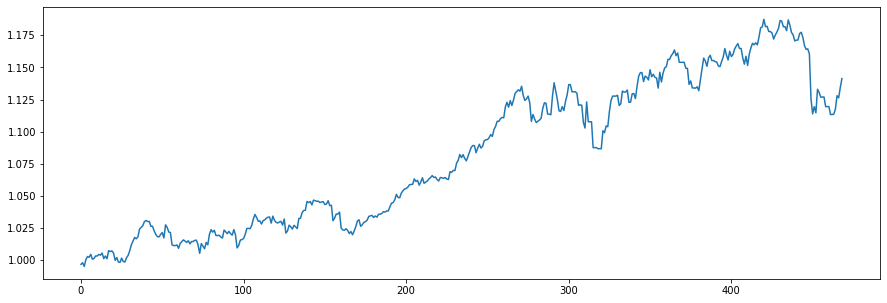

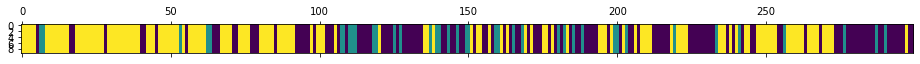

<Figure size 432x288 with 0 Axes>

N [[71. 18. 36.]
 [21. 10.  8.]
 [33. 11. 91.]]
alphas [[2.64212583 0.5618454  1.2993832 ]
 [2.12424273 1.0797285  1.2993832 ]
 [2.12424273 0.5618454  1.8172663 ]]
M [[13.  2.  3.]
 [ 8.  4.  2.]
 [ 7.  1.  6.]]
sum_w [[4.]
 [2.]
 [2.]]
barM [[9. 2. 3.]
 [8. 2. 2.]
 [7. 1. 4.]]
pi_z [[0.62090079 0.15353812 0.22556109]
 [0.49566429 0.24647528 0.25786044]
 [0.35040253 0.09545439 0.55414307]]
beta_vec [0.6923569  0.09738494 0.21025816]
hyper>> a_k: 3.4904115091846766  gamma: 0.45736353707923066  rho: 0.17065052556454352


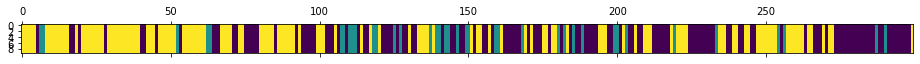

<Figure size 432x288 with 0 Axes>

970
N [[78. 17. 35.]
 [18. 11.  9.]
 [34. 10. 87.]]
alphas [[2.5998552  0.28190709 0.60864921]
 [2.00421464 0.87754765 0.60864921]
 [2.00421464 0.28190709 1.20428977]]
M [[9. 4. 5.]
 [6. 3. 2.]
 [7. 3. 4.]]
sum_w [[3.]
 [2.]
 [2.]]
barM [[6. 4. 5.]
 [6. 1. 2.]
 [7. 3. 2.]]
pi_z [[0.64744062 0.07465156 0.27790782]
 [0.49120102 0.19002531 0.31877366]
 [0.27290589 0.05518605 0.67190806]]
beta_vec [0.41243358 0.20020498 0.38736144]
hyper>> a_k: 3.7749936074490087  gamma: 0.5294771718328729  rho: 0.21168882336349365


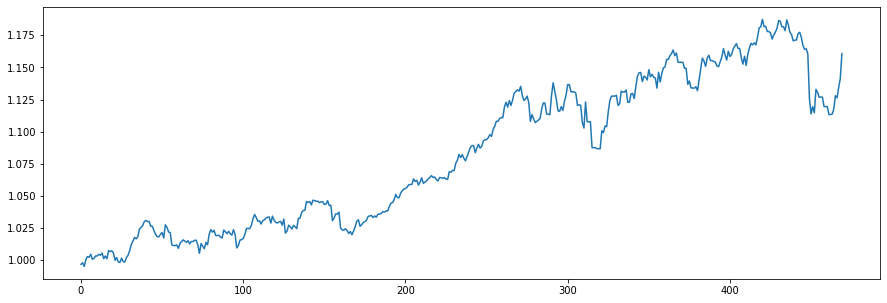

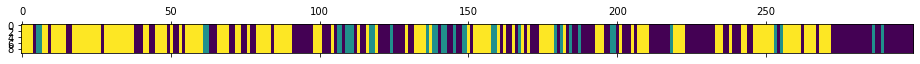

<Figure size 432x288 with 0 Axes>

N [[80. 14. 37.]
 [16. 11.  7.]
 [35.  9. 90.]]
alphas [[2.02647254 0.59578392 1.15273715]
 [1.22734858 1.39490788 1.15273715]
 [1.22734858 0.59578392 1.95186111]]
M [[6. 2. 4.]
 [5. 5. 4.]
 [3. 2. 9.]]
sum_w [[2.]
 [4.]
 [3.]]
barM [[4. 2. 4.]
 [5. 1. 4.]
 [3. 2. 6.]]
pi_z [[0.60090393 0.083974   0.31512206]
 [0.53924077 0.38755798 0.07320125]
 [0.22120109 0.04319043 0.73560848]]
beta_vec [0.29658214 0.18485686 0.518561  ]
hyper>> a_k: 3.7881778632192895  gamma: 0.2674119696516456  rho: 0.232447108086593


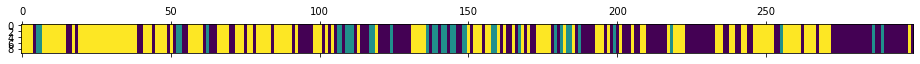

<Figure size 432x288 with 0 Axes>

971
N [[70. 14. 42.]
 [19. 12.  4.]
 [37.  9. 92.]]
alphas [[1.74290118 0.53749477 1.50778191]
 [0.86235019 1.41804576 1.50778191]
 [0.86235019 0.53749477 2.3883329 ]]
M [[9. 1. 9.]
 [4. 3. 2.]
 [4. 3. 8.]]
sum_w [[2.]
 [2.]
 [5.]]
barM [[7. 1. 9.]
 [4. 1. 2.]
 [4. 3. 3.]]
pi_z [[0.56306429 0.09421231 0.3427234 ]
 [0.59539063 0.23923981 0.16536956]
 [0.22518733 0.03277938 0.74203329]]
beta_vec [0.48200143 0.16095315 0.35704543]
hyper>> a_k: 3.7246285096783387  gamma: 0.3770229810128787  rho: 0.29204077721461863


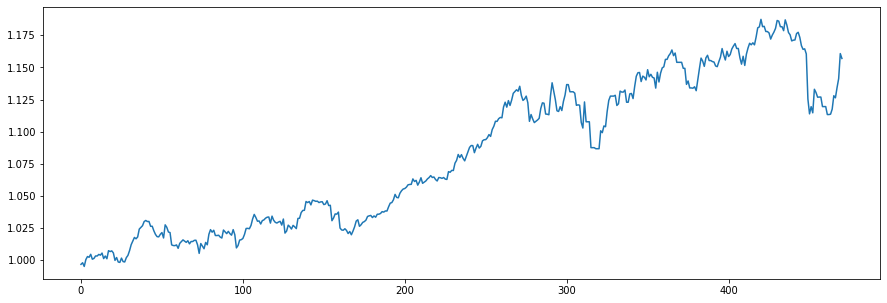

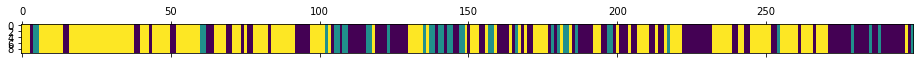

<Figure size 432x288 with 0 Axes>

N [[ 71.  13.  33.]
 [ 17.  12.   7.]
 [ 28.  12. 106.]]
alphas [[2.35872579 0.42441495 0.94148776]
 [1.27098239 1.51215836 0.94148776]
 [1.27098239 0.42441495 2.02923117]]
M [[10.  1.  7.]
 [ 4.  5.  4.]
 [ 7.  1.  9.]]
sum_w [[5.]
 [5.]
 [5.]]
barM [[5. 1. 7.]
 [4. 0. 4.]
 [7. 1. 4.]]
pi_z [[0.60486445 0.15406542 0.24107012]
 [0.48550996 0.27183288 0.24265716]
 [0.17677309 0.08407712 0.73914979]]
beta_vec [0.47736149 0.041375   0.48126351]
hyper>> a_k: 4.381356917072586  gamma: 0.35714945361178846  rho: 0.34888870018173296


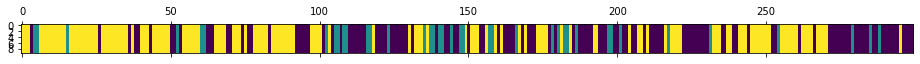

<Figure size 432x288 with 0 Axes>

972
N [[75. 15. 36.]
 [21. 11.  7.]
 [29. 14. 91.]]
alphas [[2.8903994  0.11803257 1.37292495]
 [1.36179348 1.64663849 1.37292495]
 [1.36179348 0.11803257 2.90153087]]
M [[13.  1.  4.]
 [ 3.  3.  2.]
 [ 7.  1. 10.]]
sum_w [[6.]
 [3.]
 [4.]]
barM [[7. 1. 4.]
 [3. 0. 2.]
 [7. 1. 6.]]
pi_z [[0.54748744 0.09879421 0.35371834]
 [0.54062262 0.31922572 0.14015165]
 [0.16162801 0.1490741  0.68929789]]
beta_vec [0.60738342 0.03704756 0.35556902]
hyper>> a_k: 4.327892593176582  gamma: 0.254679228314781  rho: 0.4363324121926105


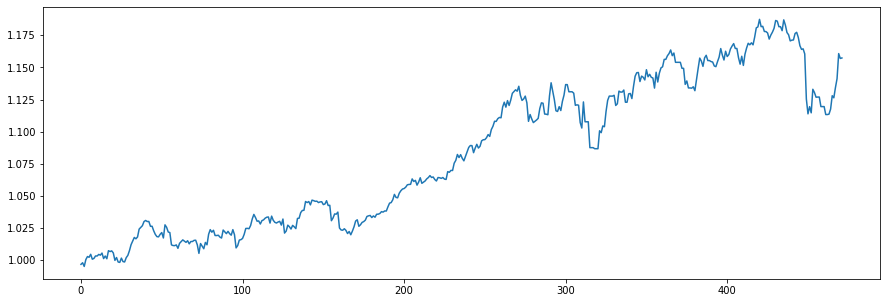

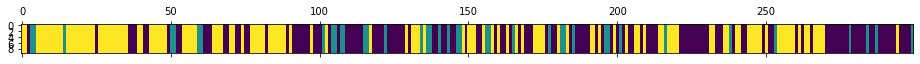

<Figure size 432x288 with 0 Axes>

N [[78. 16. 40.]
 [19. 11.  8.]
 [36. 12. 79.]]
alphas [[3.37010728 0.09037726 0.86740806]
 [1.48170747 1.97877707 0.86740806]
 [1.48170747 0.09037726 2.75580787]]
M [[9. 2. 5.]
 [6. 3. 4.]
 [2. 1. 6.]]
sum_w [[6.]
 [3.]
 [5.]]
barM [[3. 2. 5.]
 [6. 0. 4.]
 [2. 1. 1.]]
pi_z [[0.64646406 0.13074438 0.22279157]
 [0.4209526  0.23222286 0.34682454]
 [0.29349483 0.15457537 0.5519298 ]]
beta_vec [0.53860147 0.07656304 0.38483549]
hyper>> a_k: 3.350406611073982  gamma: 1.109385226720842  rho: 0.41917633474401245


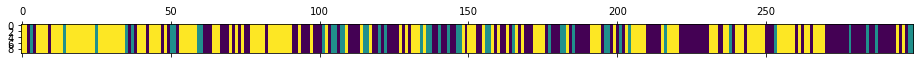

<Figure size 432x288 with 0 Axes>

973
N [[63. 19. 40.]
 [22. 11. 11.]
 [38. 13. 82.]]
alphas [[2.45252718 0.14899132 0.74888812]
 [1.04811601 1.55340248 0.74888812]
 [1.04811601 0.14899132 2.15329928]]
M [[8. 1. 4.]
 [3. 3. 3.]
 [8. 1. 5.]]
sum_w [[7.]
 [3.]
 [0.]]
barM [[1. 1. 4.]
 [3. 0. 3.]
 [8. 1. 5.]]
pi_z [[0.51329102 0.09903528 0.38767371]
 [0.49486027 0.24627512 0.2588646 ]
 [0.24910495 0.08001015 0.6708849 ]]
beta_vec [0.43718786 0.05108428 0.51172786]
hyper>> a_k: 3.1951453017759777  gamma: 0.31144738848300724  rho: 0.19841351345277597


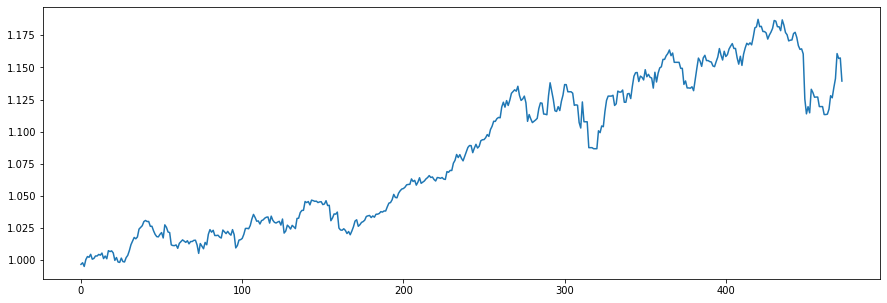

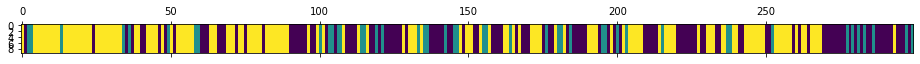

<Figure size 432x288 with 0 Axes>

N [[65. 18. 36.]
 [20. 11. 13.]
 [33. 16. 87.]]
alphas [[1.75367911 0.13083631 1.31062988]
 [1.11971911 0.76479631 1.31062988]
 [1.11971911 0.13083631 1.94458988]]
M [[6. 3. 4.]
 [3. 2. 4.]
 [3. 1. 5.]]
sum_w [[4.]
 [2.]
 [1.]]
barM [[2. 3. 4.]
 [3. 0. 4.]
 [3. 1. 4.]]
pi_z [[0.54220762 0.14107193 0.31672045]
 [0.34162336 0.21815405 0.44022259]
 [0.21382544 0.10918677 0.67698779]]
beta_vec [0.36090939 0.17029795 0.46879266]
hyper>> a_k: 2.9644046485214863  gamma: 0.8765426675699042  rho: 0.2685016046347141


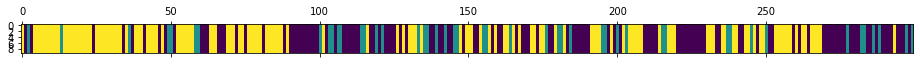

<Figure size 432x288 with 0 Axes>

974
N [[67. 22. 34.]
 [19. 13. 15.]
 [37. 12. 80.]]
alphas [[1.57856398 0.36928383 1.01655684]
 [0.78261657 1.16523123 1.01655684]
 [0.78261657 0.36928383 1.81250424]]
M [[7. 1. 3.]
 [4. 5. 7.]
 [3. 1. 9.]]
sum_w [[3.]
 [4.]
 [4.]]
barM [[4. 1. 3.]
 [4. 1. 7.]
 [3. 1. 5.]]
pi_z [[0.60723411 0.12645516 0.26631073]
 [0.47060332 0.27542121 0.25397548]
 [0.21409363 0.06999077 0.7159156 ]]
beta_vec [0.29529824 0.09125936 0.6134424 ]
hyper>> a_k: 4.756538894892568  gamma: 0.4393989359910949  rho: 0.24112478245894128


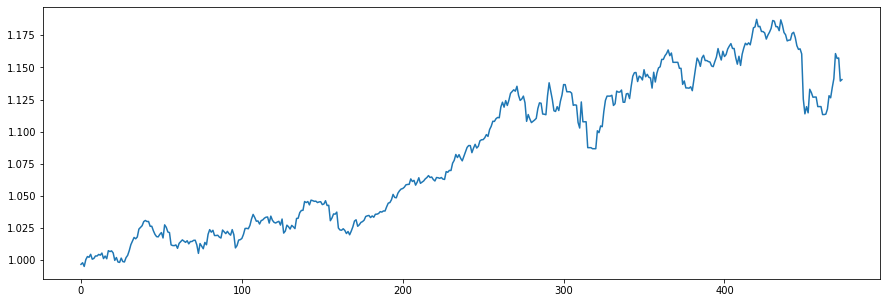

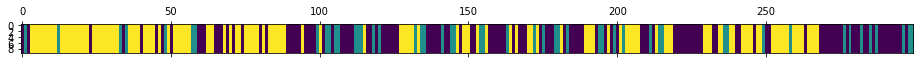

<Figure size 432x288 with 0 Axes>

N [[71. 22. 31.]
 [25. 12. 12.]
 [28. 15. 83.]]
alphas [[2.2128337  0.32941155 2.21429364]
 [1.06591429 1.47633096 2.21429364]
 [1.06591429 0.32941155 3.36121305]]
M [[ 6.  1.  4.]
 [ 2.  3.  5.]
 [ 5.  2. 12.]]
sum_w [[3.]
 [3.]
 [5.]]
barM [[3. 1. 4.]
 [2. 0. 5.]
 [5. 2. 7.]]
pi_z [[0.64973007 0.15318885 0.19708108]
 [0.45049804 0.33259285 0.2169091 ]
 [0.26113617 0.1139812  0.62488263]]
beta_vec [0.42384471 0.06658731 0.50956797]
hyper>> a_k: 3.821983584712539  gamma: 0.7636934113471242  rho: 0.20761124087715657


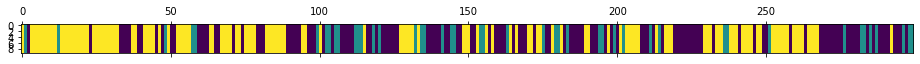

<Figure size 432x288 with 0 Axes>

975
N [[74. 20. 33.]
 [21. 14. 10.]
 [32. 11. 84.]]
alphas [[2.07709913 0.20165947 1.54322499]
 [1.28361237 0.99514622 1.54322499]
 [1.28361237 0.20165947 2.33671174]]
M [[ 8.  1.  5.]
 [ 4.  5.  2.]
 [ 6.  2. 13.]]
sum_w [[5.]
 [4.]
 [3.]]
barM [[ 3.  1.  5.]
 [ 4.  1.  2.]
 [ 6.  2. 10.]]
pi_z [[0.56254902 0.16961932 0.26783166]
 [0.50492489 0.27555033 0.21952478]
 [0.31834738 0.11170449 0.56994813]]
beta_vec [0.21686439 0.11248346 0.67065216]
hyper>> a_k: 3.228294334095785  gamma: 0.4274245831933255  rho: 0.2630159436244972


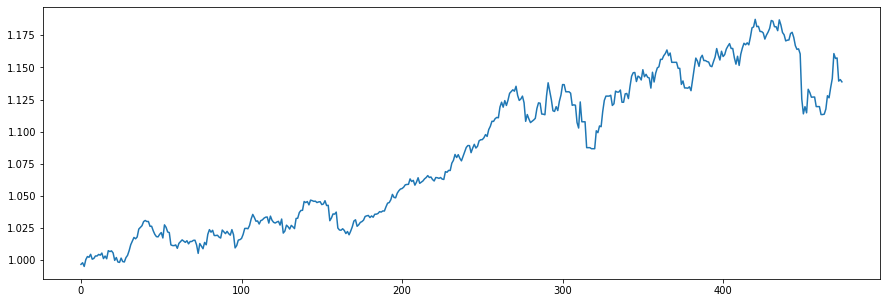

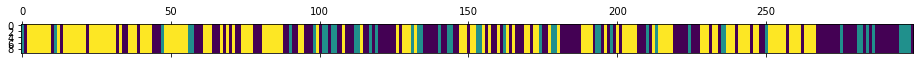

<Figure size 432x288 with 0 Axes>

N [[66. 19. 39.]
 [24. 14.  7.]
 [35. 11. 84.]]
alphas [[1.36505695 0.2676208  1.59561658]
 [0.51596407 1.11671368 1.59561658]
 [0.51596407 0.2676208  2.44470946]]
M [[ 4.  1.  6.]
 [ 3.  4.  3.]
 [ 3.  2. 12.]]
sum_w [[0.]
 [2.]
 [3.]]
barM [[4. 1. 6.]
 [3. 2. 3.]
 [3. 2. 9.]]
pi_z [[0.56193591 0.12910634 0.30895775]
 [0.50866935 0.34102393 0.15030672]
 [0.28584604 0.08051887 0.6336351 ]]
beta_vec [0.23744929 0.08660434 0.67594636]
hyper>> a_k: 2.6548904373839526  gamma: 0.3376565509372694  rho: 0.21513560758297492


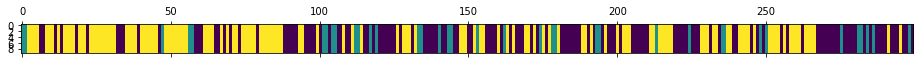

<Figure size 432x288 with 0 Axes>

976
N [[70. 16. 46.]
 [20. 10.  6.]
 [42. 10. 79.]]
alphas [[1.06594144 0.18045998 1.40848902]
 [0.49477997 0.75162145 1.40848902]
 [0.49477997 0.18045998 1.97965049]]
M [[6. 2. 4.]
 [1. 2. 1.]
 [1. 1. 8.]]
sum_w [[2.]
 [2.]
 [3.]]
barM [[4. 2. 4.]
 [1. 0. 1.]
 [1. 1. 5.]]
pi_z [[0.51343601 0.11757623 0.36898775]
 [0.54293136 0.34001644 0.1170522 ]
 [0.3318136  0.06381112 0.60437528]]
beta_vec [0.53118143 0.04839675 0.42042182]
hyper>> a_k: 2.1373684426480413  gamma: 0.8928908504660426  rho: 0.33214228487204933


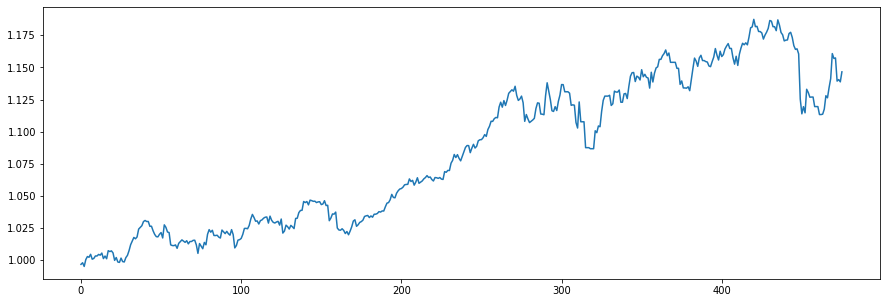

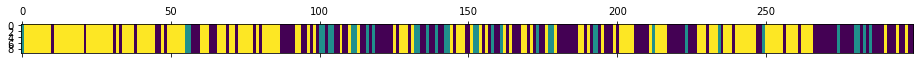

<Figure size 432x288 with 0 Axes>

N [[63. 17. 44.]
 [18. 10.  7.]
 [43.  8. 89.]]
alphas [[1.46814962 0.06908433 0.60013449]
 [0.75823918 0.77899477 0.60013449]
 [0.75823918 0.06908433 1.31004493]]
M [[5. 2. 2.]
 [2. 3. 2.]
 [6. 2. 6.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[1. 2. 2.]
 [2. 1. 2.]
 [6. 2. 3.]]
pi_z [[0.45415354 0.09760697 0.44823949]
 [0.47291031 0.25566813 0.27142157]
 [0.3170797  0.09465794 0.58826236]]
beta_vec [0.25676251 0.26603716 0.47720033]
hyper>> a_k: 3.0751624916899134  gamma: 0.8884516896001419  rho: 0.3830707695080595


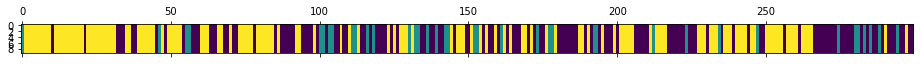

<Figure size 432x288 with 0 Axes>

977
N [[66. 19. 43.]
 [19. 10.  8.]
 [43.  8. 83.]]
alphas [[1.66512381 0.50471443 0.90532425]
 [0.48711895 1.6827193  0.90532425]
 [0.48711895 0.50471443 2.08332911]]
M [[9. 3. 5.]
 [2. 3. 2.]
 [3. 1. 9.]]
sum_w [[8.]
 [3.]
 [2.]]
barM [[1. 3. 5.]
 [2. 0. 2.]
 [3. 1. 7.]]
pi_z [[0.53517825 0.18177303 0.28304872]
 [0.5593269  0.23373321 0.20693989]
 [0.32441401 0.02916624 0.64641974]]
beta_vec [0.26418729 0.14046036 0.59535235]
hyper>> a_k: 2.7203418542468656  gamma: 0.3531047483494449  rho: 0.3511530514724455


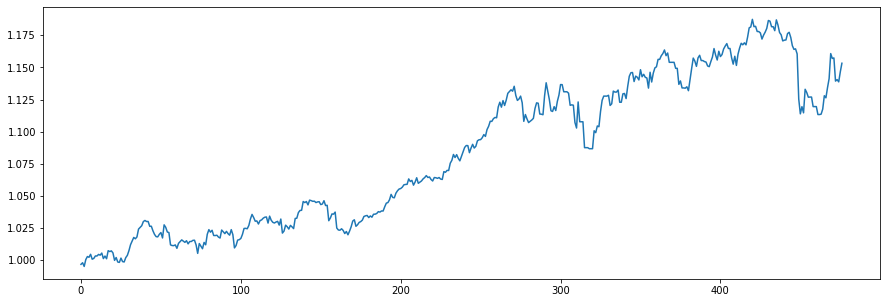

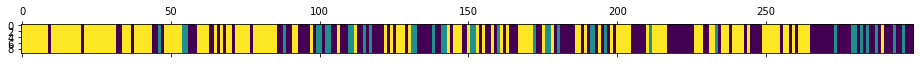

<Figure size 432x288 with 0 Axes>

N [[63. 21. 41.]
 [20. 10.  7.]
 [42.  6. 89.]]
alphas [[1.4215695  0.24792455 1.05084781]
 [0.46631315 1.20318089 1.05084781]
 [0.46631315 0.24792455 2.00610415]]
M [[9. 2. 2.]
 [3. 3. 4.]
 [4. 1. 5.]]
sum_w [[8.]
 [1.]
 [1.]]
barM [[1. 2. 2.]
 [3. 2. 4.]
 [4. 1. 4.]]
pi_z [[0.50045143 0.17704398 0.32250459]
 [0.54653404 0.26329334 0.19017261]
 [0.2821783  0.06305937 0.65476233]]
beta_vec [0.24348237 0.30986784 0.44664979]
hyper>> a_k: 2.6498987952132  gamma: 1.5966945703469744  rho: 0.38835843267986697


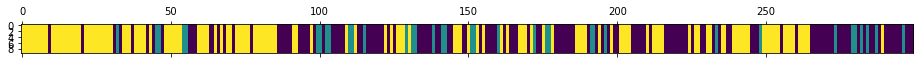

<Figure size 432x288 with 0 Axes>

978
N [[74. 19. 39.]
 [18. 11.  7.]
 [40.  6. 85.]]
alphas [[1.42374391 0.50223016 0.72392473]
 [0.39463337 1.5313407  0.72392473]
 [0.39463337 0.50223016 1.75303527]]
M [[4. 1. 5.]
 [3. 2. 2.]
 [3. 2. 5.]]
sum_w [[2.]
 [1.]
 [4.]]
barM [[2. 1. 5.]
 [3. 1. 2.]
 [3. 2. 1.]]
pi_z [[0.54935862 0.15140549 0.29923589]
 [0.35449377 0.40927968 0.23622655]
 [0.32434395 0.06895657 0.60669948]]
beta_vec [0.32287337 0.34596851 0.33115812]
hyper>> a_k: 2.0517244109509023  gamma: 0.9841981737684183  rho: 0.3514846979334164


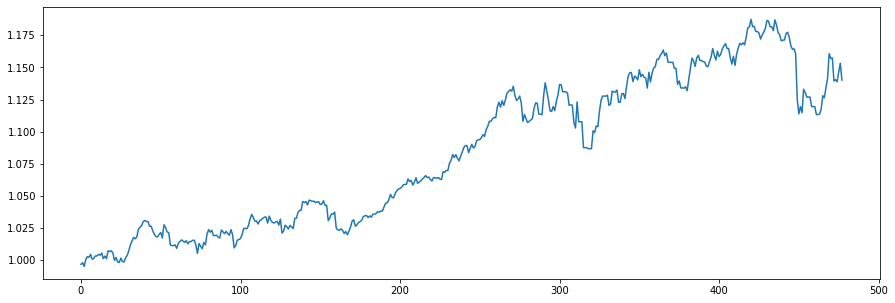

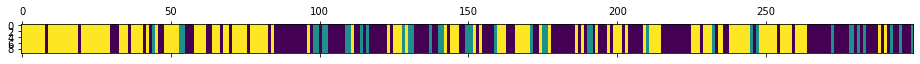

<Figure size 432x288 with 0 Axes>

N [[79. 17. 36.]
 [18. 11.  8.]
 [34. 10. 86.]]
alphas [[1.15075686 0.46033694 0.44063061]
 [0.42960712 1.18148668 0.44063061]
 [0.42960712 0.46033694 1.16178034]]
M [[7. 4. 3.]
 [3. 3. 2.]
 [3. 2. 9.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[4. 4. 3.]
 [3. 1. 2.]
 [3. 2. 5.]]
pi_z [[0.57480348 0.17034034 0.25485618]
 [0.59216741 0.20784849 0.1999841 ]
 [0.23445547 0.06434339 0.70120114]]
beta_vec [0.36492739 0.20824744 0.42682517]
hyper>> a_k: 3.6570679531202415  gamma: 0.23288516648469335  rho: 0.24625751141560262


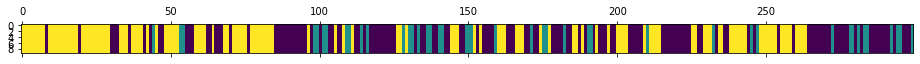

<Figure size 432x288 with 0 Axes>

979
N [[81. 20. 33.]
 [22. 14.  7.]
 [31.  9. 82.]]
alphas [[1.90649823 0.57403148 1.17653825]
 [1.00591778 1.47461193 1.17653825]
 [1.00591778 0.57403148 2.0771187 ]]
M [[10.  2.  5.]
 [ 2.  2.  2.]
 [ 4.  3.  8.]]
sum_w [[4.]
 [2.]
 [3.]]
barM [[6. 2. 5.]
 [2. 0. 2.]
 [4. 3. 5.]]
pi_z [[0.56174347 0.14557754 0.29267899]
 [0.6099513  0.28184352 0.10820519]
 [0.29031807 0.03390172 0.67578021]]
beta_vec [0.35712131 0.20356191 0.43931678]
hyper>> a_k: 2.5990106911674515  gamma: 0.5384834345703756  rho: 0.26247995709148814


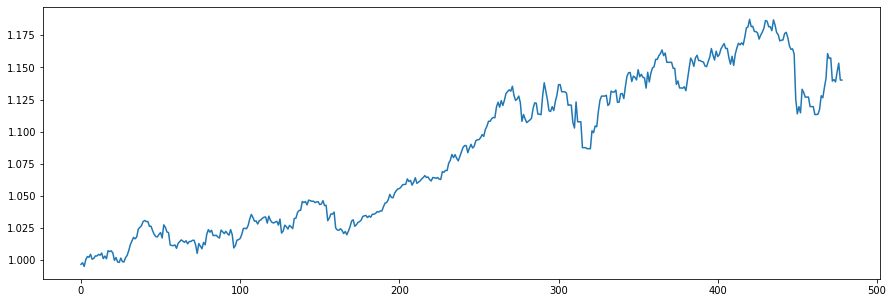

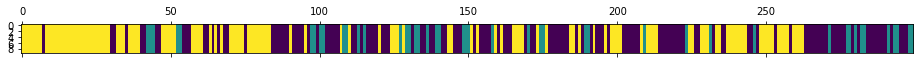

<Figure size 432x288 with 0 Axes>

N [[79. 20. 33.]
 [21. 16.  7.]
 [32.  8. 83.]]
alphas [[1.36672636 0.39019204 0.84209228]
 [0.68453815 1.07238026 0.84209228]
 [0.68453815 0.39019204 1.5242805 ]]
M [[1. 1. 1.]
 [2. 3. 2.]
 [6. 2. 7.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[0. 1. 1.]
 [2. 1. 2.]
 [6. 2. 4.]]
pi_z [[0.61452527 0.16160137 0.22387336]
 [0.42383014 0.4670274  0.10914246]
 [0.16915417 0.05701737 0.77382846]]
beta_vec [0.27965658 0.25438551 0.46595791]
hyper>> a_k: 1.3408521799276134  gamma: 0.8732287937053937  rho: 0.14074744213136223


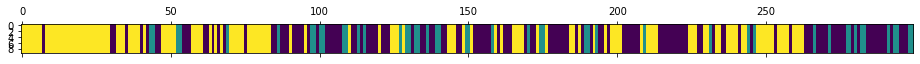

<Figure size 432x288 with 0 Axes>

980
N [[74. 23. 32.]
 [23. 15.  9.]
 [32.  9. 82.]]
alphas [[0.51092243 0.29308535 0.5368444 ]
 [0.32220092 0.48180687 0.5368444 ]
 [0.32220092 0.29308535 0.72556591]]
M [[6. 1. 1.]
 [3. 4. 4.]
 [2. 1. 8.]]
sum_w [[3.]
 [3.]
 [2.]]
barM [[3. 1. 1.]
 [3. 1. 4.]
 [2. 1. 6.]]
pi_z [[0.55569333 0.19413327 0.2501734 ]
 [0.58818117 0.28528013 0.1265387 ]
 [0.22662724 0.08831313 0.68505963]]
beta_vec [0.49663427 0.04191169 0.46145404]
hyper>> a_k: 2.2569992920402617  gamma: 0.2823192205499856  rho: 0.16985050975685614


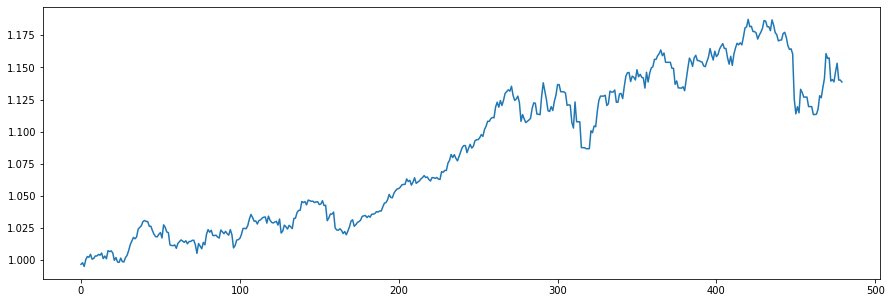

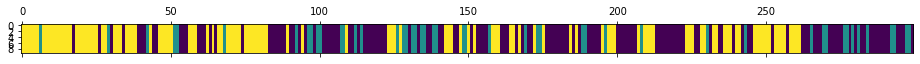

<Figure size 432x288 with 0 Axes>

N [[81. 22. 31.]
 [22. 15. 11.]
 [32. 10. 75.]]
alphas [[1.3138697  0.07852771 0.86460188]
 [0.93051722 0.46188019 0.86460188]
 [0.93051722 0.07852771 1.24795436]]
M [[8. 1. 2.]
 [2. 3. 4.]
 [5. 1. 5.]]
sum_w [[1.]
 [1.]
 [3.]]
barM [[7. 1. 2.]
 [2. 2. 4.]
 [5. 1. 2.]]
pi_z [[0.61878886 0.14130329 0.23990785]
 [0.41805294 0.3029711  0.27897596]
 [0.34887876 0.05698309 0.59413815]]
beta_vec [0.51668188 0.18736702 0.2959511 ]
hyper>> a_k: 3.395981429304614  gamma: 0.5657189606810425  rho: 0.16336465069559972


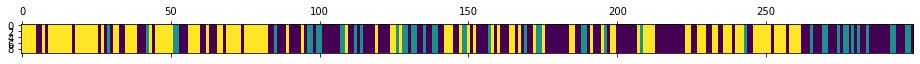

<Figure size 432x288 with 0 Axes>

981
N [[81. 24. 36.]
 [23. 14.  8.]
 [37.  7. 69.]]
alphas [[2.02277889 0.53234682 0.84085572]
 [1.46799557 1.08713014 0.84085572]
 [1.46799557 0.53234682 1.39563904]]
M [[7. 5. 3.]
 [7. 2. 1.]
 [4. 2. 5.]]
sum_w [[2.]
 [1.]
 [2.]]
barM [[5. 5. 3.]
 [7. 1. 1.]
 [4. 2. 3.]]
pi_z [[0.49218993 0.17504836 0.33276171]
 [0.3444056  0.41872342 0.23687098]
 [0.35031368 0.11273374 0.53695259]]
beta_vec [0.50334819 0.24400503 0.25264678]
hyper>> a_k: 4.091425783052813  gamma: 0.3513114610981245  rho: 0.12992223612280077


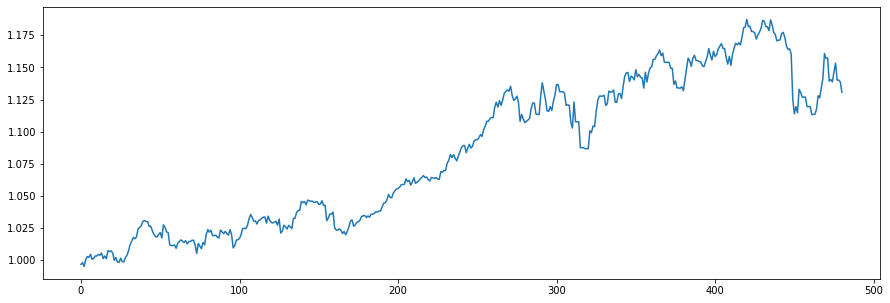

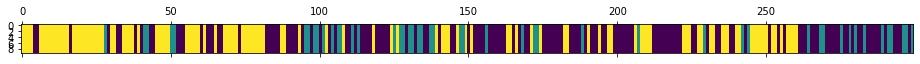

<Figure size 432x288 with 0 Axes>

N [[80. 25. 34.]
 [24. 14.  9.]
 [34.  9. 70.]]
alphas [[2.32341559 0.86862339 0.89938681]
 [1.7918484  1.40019058 0.89938681]
 [1.7918484  0.86862339 1.43095399]]
M [[11.  4.  3.]
 [ 2.  3.  3.]
 [ 6.  2.  8.]]
sum_w [[0.]
 [0.]
 [2.]]
barM [[11.  4.  3.]
 [ 2.  3.  3.]
 [ 6.  2.  6.]]
pi_z [[0.53718722 0.18613211 0.27668067]
 [0.35407321 0.44589607 0.20003073]
 [0.28391869 0.07985336 0.63622795]]
beta_vec [0.39088685 0.33311235 0.27600081]
hyper>> a_k: 3.2387850460990997  gamma: 0.43091122126198833  rho: 0.01668233970174232


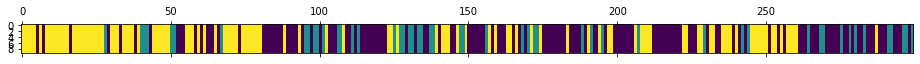

<Figure size 432x288 with 0 Axes>

982
N [[78. 24. 35.]
 [25. 15. 11.]
 [34. 12. 65.]]
alphas [[1.29890917 1.06088105 0.87899482]
 [1.24487866 1.11491156 0.87899482]
 [1.24487866 1.06088105 0.93302534]]
M [[5. 3. 1.]
 [5. 6. 2.]
 [4. 3. 4.]]
sum_w [[1.]
 [1.]
 [0.]]
barM [[4. 3. 1.]
 [5. 5. 2.]
 [4. 3. 4.]]
pi_z [[0.58256766 0.12822229 0.28921004]
 [0.48215246 0.30304183 0.21480571]
 [0.39380292 0.09479142 0.51140566]]
beta_vec [0.54513096 0.29099646 0.16387258]
hyper>> a_k: 3.2386032716523947  gamma: 0.8131667852899324  rho: 0.10008999629375138


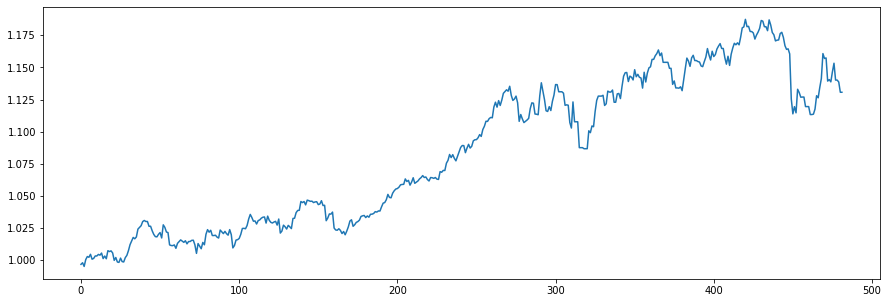

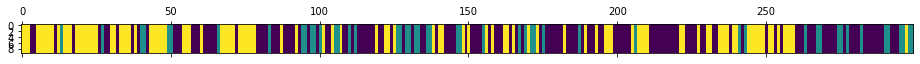

<Figure size 432x288 with 0 Axes>

N [[84. 21. 39.]
 [26. 15.  8.]
 [34. 13. 59.]]
alphas [[1.91290953 0.84809507 0.47759867]
 [1.58875774 1.17224686 0.47759867]
 [1.58875774 0.84809507 0.80175046]]
M [[8. 3. 2.]
 [6. 3. 2.]
 [4. 3. 4.]]
sum_w [[1.]
 [2.]
 [3.]]
barM [[7. 3. 2.]
 [6. 1. 2.]
 [4. 3. 1.]]
pi_z [[0.51484059 0.19009137 0.29506805]
 [0.44599186 0.44212895 0.11187919]
 [0.31126765 0.13678638 0.55194598]]
beta_vec [0.62749537 0.15194591 0.22055871]
hyper>> a_k: 2.957392314919011  gamma: 0.9536610575413045  rho: 0.087360567220219


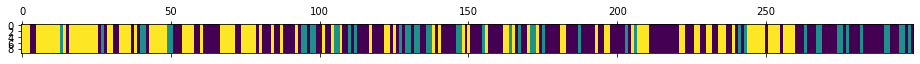

<Figure size 432x288 with 0 Axes>

983
N [[88. 23. 38.]
 [26. 14.  6.]
 [35.  9. 60.]]
alphas [[1.95199009 0.41010701 0.59529521]
 [1.69363062 0.66846648 0.59529521]
 [1.69363062 0.41010701 0.85365468]]
M [[9. 2. 4.]
 [6. 2. 2.]
 [5. 3. 4.]]
sum_w [[1.]
 [1.]
 [1.]]
barM [[8. 2. 4.]
 [6. 1. 2.]
 [5. 3. 3.]]
pi_z [[0.61680252 0.12653513 0.25666234]
 [0.47589717 0.40961163 0.1144912 ]
 [0.287644   0.08539662 0.62695937]]
beta_vec [0.43920449 0.24994376 0.31085176]
hyper>> a_k: 3.4830442099338415  gamma: 0.218193754050494  rho: 0.07766624076458174


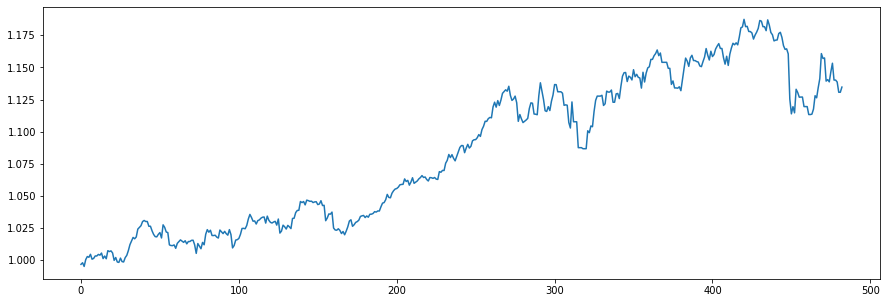

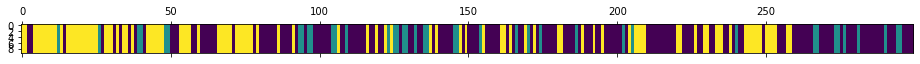

<Figure size 432x288 with 0 Axes>

N [[101.  21.  37.]
 [ 21.  12.   7.]
 [ 37.   7.  56.]]
alphas [[1.68147221 0.80295163 0.99862037]
 [1.41095726 1.07346658 0.99862037]
 [1.41095726 0.80295163 1.26913532]]
M [[5. 1. 4.]
 [8. 2. 3.]
 [9. 2. 9.]]
sum_w [[0.]
 [0.]
 [0.]]
barM [[5. 1. 4.]
 [8. 2. 3.]
 [9. 2. 9.]]
pi_z [[0.63234805 0.14804448 0.21960747]
 [0.43245799 0.31536956 0.25217245]
 [0.32205894 0.08201974 0.59592131]]
beta_vec [0.41548018 0.096935   0.48758482]
hyper>> a_k: 3.8953217848575794  gamma: 0.9576229286700791  rho: 0.028781244095112242


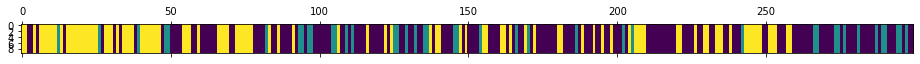

<Figure size 432x288 with 0 Axes>

984
N [[99. 21. 39.]
 [25. 11.  5.]
 [35.  9. 55.]]
alphas [[1.68396081 0.36672542 1.84463555]
 [1.5718486  0.47883763 1.84463555]
 [1.5718486  0.36672542 1.95674776]]
M [[4. 2. 5.]
 [7. 2. 3.]
 [9. 1. 8.]]
sum_w [[0.]
 [1.]
 [1.]]
barM [[4. 2. 5.]
 [7. 1. 3.]
 [9. 1. 7.]]
pi_z [[0.60034039 0.15906841 0.2405912 ]
 [0.62361483 0.25907668 0.11730848]
 [0.36014584 0.09272365 0.54713051]]
beta_vec [0.41113156 0.15377973 0.43508872]
hyper>> a_k: 3.637685578729924  gamma: 1.1541509963377918  rho: 0.04279251656764096


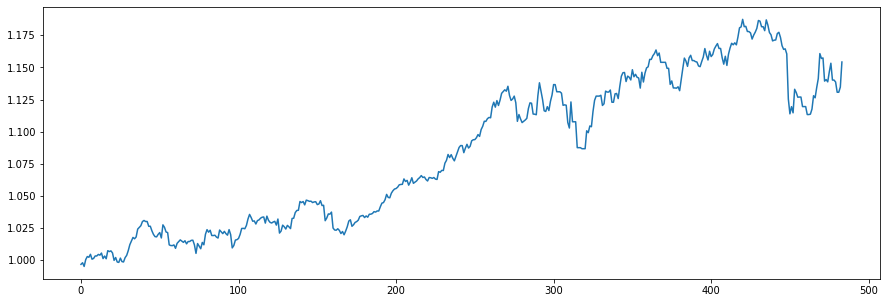

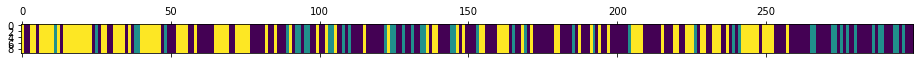

<Figure size 432x288 with 0 Axes>

N [[90. 24. 38.]
 [28. 11.  6.]
 [34. 10. 58.]]
alphas [[1.58723397 0.53546406 1.51498755]
 [1.43156825 0.69112978 1.51498755]
 [1.43156825 0.53546406 1.67065327]]
M [[5. 2. 7.]
 [2. 2. 3.]
 [5. 3. 8.]]
sum_w [[0.]
 [0.]
 [1.]]
barM [[5. 2. 7.]
 [2. 2. 3.]
 [5. 3. 7.]]
pi_z [[0.63723352 0.15164172 0.21112476]
 [0.58641441 0.32369322 0.08989237]
 [0.28244537 0.12175359 0.59580104]]
beta_vec [0.34908    0.26816211 0.3827579 ]
hyper>> a_k: 3.6200845993393753  gamma: 0.0677972453548254  rho: 0.02025540719541275


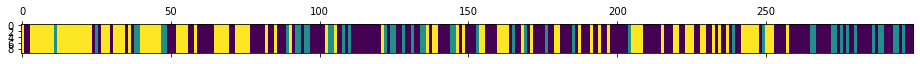

<Figure size 432x288 with 0 Axes>

985
N [[95. 24. 35.]
 [28. 12.  5.]
 [31.  9. 60.]]
alphas [[1.31142866 0.95110619 1.35754975]
 [1.23810237 1.02443247 1.35754975]
 [1.23810237 0.95110619 1.43087604]]
M [[7. 5. 3.]
 [7. 3. 2.]
 [6. 2. 4.]]
sum_w [[1.]
 [0.]
 [1.]]
barM [[6. 5. 3.]
 [7. 3. 2.]
 [6. 2. 3.]]
pi_z [[0.62418461 0.14340283 0.23241256]
 [0.60857132 0.27762201 0.11380667]
 [0.24832034 0.08138835 0.67029131]]
beta_vec [0.48903579 0.33083093 0.18013329]
hyper>> a_k: 4.942018392020272  gamma: 1.8709297227241846  rho: 0.10392147592366899


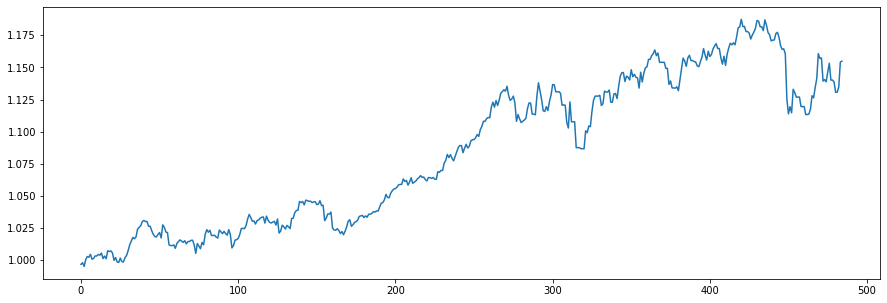

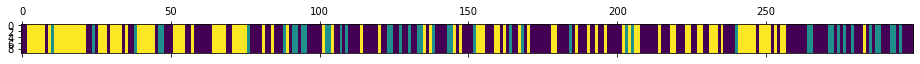

<Figure size 432x288 with 0 Axes>

N [[92. 23. 39.]
 [26. 11.  7.]
 [36. 10. 55.]]
alphas [[2.6792458  1.46506376 0.79770883]
 [2.16566396 1.97864561 0.79770883]
 [2.16566396 1.46506376 1.31129067]]
M [[10.  5.  2.]
 [ 4.  4.  1.]
 [ 7.  4.  4.]]
sum_w [[2.]
 [1.]
 [1.]]
barM [[8. 5. 2.]
 [4. 3. 1.]
 [7. 4. 3.]]
pi_z [[0.55809134 0.16064622 0.28126244]
 [0.65632003 0.19785353 0.14582643]
 [0.38439382 0.12228471 0.49332147]]
beta_vec [0.42635155 0.36169714 0.21195131]
hyper>> a_k: 4.922579326167194  gamma: 0.32769655291455907  rho: 0.16851530411123755


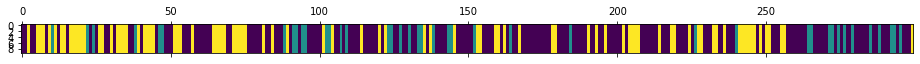

<Figure size 432x288 with 0 Axes>

986
N [[107.  22.  41.]
 [ 26.  10.   5.]
 [ 38.   9.  41.]]
alphas [[2.5746079  1.48044424 0.86752719]
 [1.74507794 2.30997419 0.86752719]
 [1.74507794 1.48044424 1.69705714]]
M [[9. 6. 6.]
 [9. 3. 2.]
 [6. 3. 8.]]
sum_w [[4.]
 [0.]
 [5.]]
barM [[5. 6. 6.]
 [9. 3. 2.]
 [6. 3. 3.]]
pi_z [[0.5939652  0.14886024 0.25717457]
 [0.63639155 0.25248851 0.11111994]
 [0.47513513 0.11293083 0.41193405]]
beta_vec [0.50359657 0.22254476 0.27385867]
hyper>> a_k: 5.845149654520993  gamma: 0.5771450898423369  rho: 0.20002815025957538


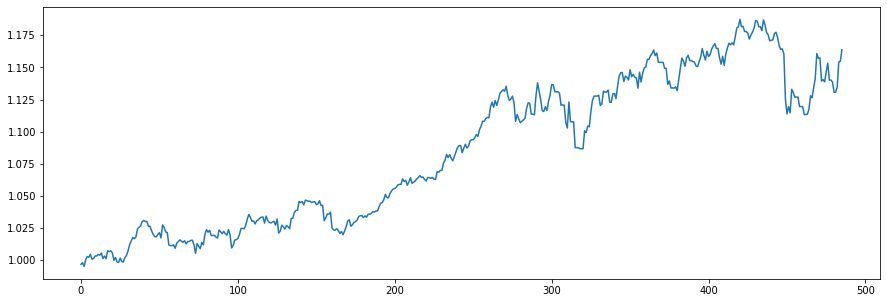

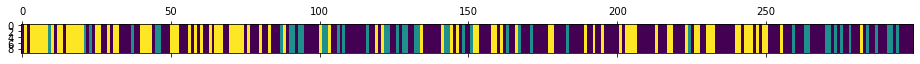

<Figure size 432x288 with 0 Axes>

N [[97. 28. 42.]
 [27. 11.  7.]
 [43.  6. 38.]]
alphas [[3.52398945 1.04060934 1.28055086]
 [2.35479498 2.20980381 1.28055086]
 [2.35479498 1.04060934 2.44974533]]
M [[11.  8.  4.]
 [ 6.  2.  2.]
 [ 7.  3.  5.]]
sum_w [[3.]
 [2.]
 [0.]]
barM [[8. 8. 4.]
 [6. 0. 2.]
 [7. 3. 5.]]
pi_z [[0.63014679 0.16660661 0.2032466 ]
 [0.58202493 0.2230378  0.19493727]
 [0.53361281 0.09246371 0.37392348]]
beta_vec [0.5199487  0.17266927 0.30738203]
hyper>> a_k: 5.338554299882998  gamma: 1.0476799033004505  rho: 0.13811612826624897


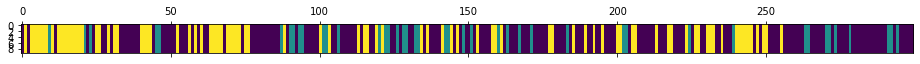

<Figure size 432x288 with 0 Axes>

987
N [[106.  23.  38.]
 [ 22.  12.   9.]
 [ 39.   8.  42.]]
alphas [[3.12973562 0.79448822 1.41433045]
 [2.39239517 1.53182867 1.41433045]
 [2.39239517 0.79448822 2.1516709 ]]
M [[10.  6.  6.]
 [ 6.  4.  2.]
 [ 6.  1.  6.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[7. 6. 6.]
 [6. 3. 2.]
 [6. 1. 5.]]
pi_z [[0.63816321 0.12745596 0.23438084]
 [0.63550823 0.22138862 0.14310315]
 [0.45808482 0.09018951 0.45172567]]
beta_vec [0.64304321 0.18526196 0.17169483]
hyper>> a_k: 4.034062439704715  gamma: 0.8122709112674379  rho: 0.17099582776439837


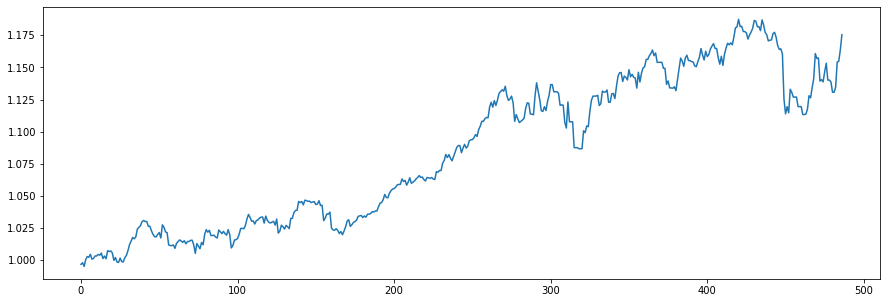

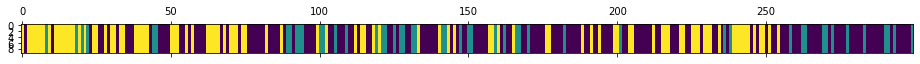

<Figure size 432x288 with 0 Axes>

N [[92. 25. 39.]
 [23. 14. 11.]
 [40. 10. 45.]]
alphas [[2.84030807 0.61956315 0.57419122]
 [2.15050022 1.309371   0.57419122]
 [2.15050022 0.61956315 1.26399907]]
M [[16.  3.  1.]
 [ 7.  4.  3.]
 [ 6.  4.  4.]]
sum_w [[5.]
 [4.]
 [2.]]
barM [[11.  3.  1.]
 [ 7.  0.  3.]
 [ 6.  4.  2.]]
pi_z [[0.64726783 0.12195896 0.23077321]
 [0.52353045 0.34327136 0.13319819]
 [0.36583195 0.09252562 0.54164243]]
beta_vec [0.78552383 0.14959818 0.06487799]
hyper>> a_k: 3.7139891910986926  gamma: 1.242124274140566  rho: 0.2732574545163466


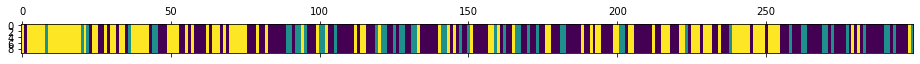

<Figure size 432x288 with 0 Axes>

988
N [[81. 25. 37.]
 [24. 14. 12.]
 [38. 11. 57.]]
alphas [[3.13509355 0.40378254 0.1751131 ]
 [2.12021832 1.41865777 0.1751131 ]
 [2.12021832 0.40378254 1.18998833]]
M [[ 9.  1.  2.]
 [ 7.  3.  2.]
 [10.  3.  5.]]
sum_w [[2.]
 [3.]
 [4.]]
barM [[ 7.  1.  2.]
 [ 7.  0.  2.]
 [10.  3.  1.]]
pi_z [[0.63234628 0.11979155 0.24786217]
 [0.46701398 0.26077896 0.27220706]
 [0.34096223 0.07526819 0.58376958]]
beta_vec [0.74468493 0.0812205  0.17409456]
hyper>> a_k: 4.455902214922389  gamma: 0.6021003543039816  rho: 0.20137931836838993


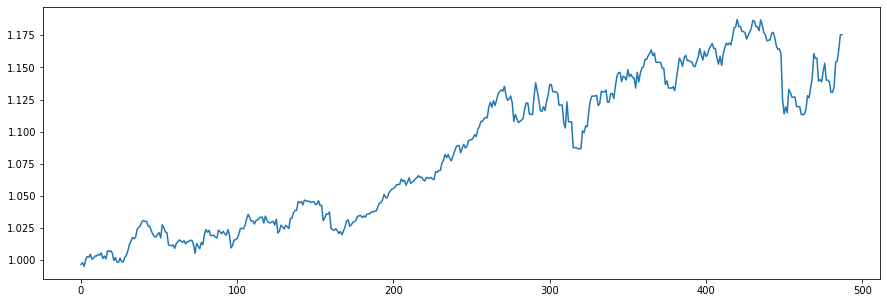

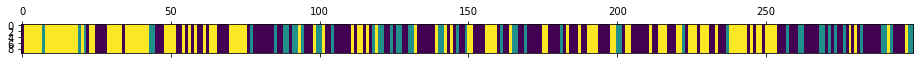

<Figure size 432x288 with 0 Axes>

N [[79. 26. 34.]
 [23. 13. 13.]
 [37. 10. 64.]]
alphas [[3.54734423 0.28902931 0.61952867]
 [2.65001768 1.18635586 0.61952867]
 [2.65001768 0.28902931 1.51685522]]
M [[14.  3.  4.]
 [ 6.  2.  4.]
 [ 9.  1.  7.]]
sum_w [[3.]
 [2.]
 [4.]]
barM [[11.  3.  4.]
 [ 6.  0.  4.]
 [ 9.  1.  3.]]
pi_z [[0.47101874 0.22670017 0.30228108]
 [0.65153824 0.1106907  0.23777106]
 [0.37211886 0.09016096 0.53772018]]
beta_vec [0.50241101 0.1244936  0.3730954 ]
hyper>> a_k: 3.1966530056891664  gamma: 0.6230999059892618  rho: 0.23838731744452332


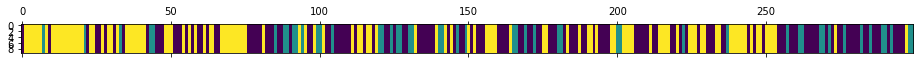

<Figure size 432x288 with 0 Axes>

989
N [[73. 24. 41.]
 [24. 15. 10.]
 [41. 10. 61.]]
alphas [[1.98521714 0.30309354 0.90834233]
 [1.2231756  1.06513507 0.90834233]
 [1.2231756  0.30309354 1.67038387]]
M [[10.  1.  6.]
 [ 5.  3.  1.]
 [ 4.  2.  4.]]
sum_w [[5.]
 [3.]
 [3.]]
barM [[5. 1. 6.]
 [5. 0. 1.]
 [4. 2. 1.]]
pi_z [[0.56537728 0.20521507 0.22940766]
 [0.48708017 0.34244098 0.17047885]
 [0.39498845 0.08224756 0.52276399]]
beta_vec [0.44968308 0.10593006 0.44438686]
hyper>> a_k: 3.972995575709224  gamma: 0.5007422452504158  rho: 0.22979894425575478


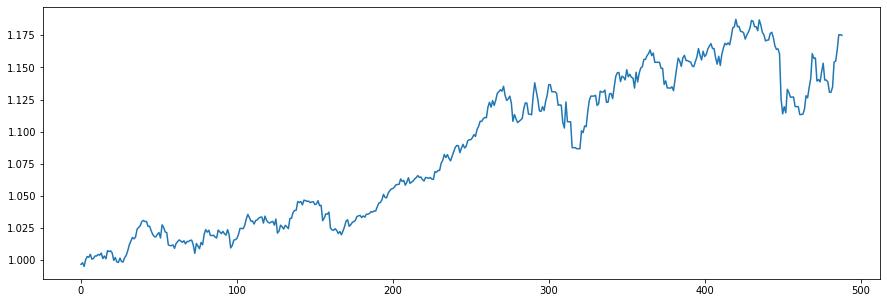

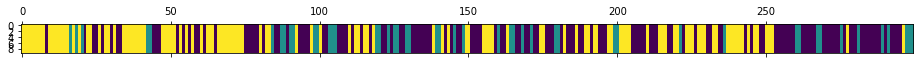

<Figure size 432x288 with 0 Axes>

N [[76. 22. 38.]
 [19. 16. 12.]
 [41.  9. 66.]]
alphas [[2.28902285 0.32414655 1.35982618]
 [1.37603266 1.23713673 1.35982618]
 [1.37603266 0.32414655 2.27281637]]
M [[7. 3. 6.]
 [3. 4. 4.]
 [5. 1. 8.]]
sum_w [[3.]
 [1.]
 [3.]]
barM [[4. 3. 6.]
 [3. 3. 4.]
 [5. 1. 5.]]
pi_z [[0.61206337 0.15773562 0.230201  ]
 [0.47197376 0.29411105 0.23391519]
 [0.35886684 0.04389065 0.59724251]]
beta_vec [0.25922009 0.18864877 0.55213114]
hyper>> a_k: 3.103984431243744  gamma: 0.3308101797882644  rho: 0.25802855486234344


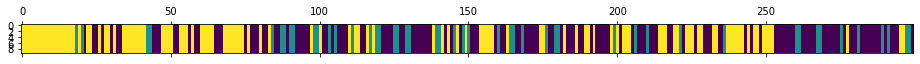

<Figure size 432x288 with 0 Axes>

990
N [[80. 26. 32.]
 [20. 13. 15.]
 [38.  9. 66.]]
alphas [[1.39791806 0.4344709  1.27159546]
 [0.59700145 1.23538752 1.27159546]
 [0.59700145 0.4344709  2.07251208]]
M [[8. 1. 6.]
 [2. 2. 4.]
 [4. 2. 7.]]
sum_w [[6.]
 [1.]
 [4.]]
barM [[2. 1. 6.]
 [2. 1. 4.]
 [4. 2. 3.]]
pi_z [[0.59786269 0.17571531 0.22642199]
 [0.33069217 0.26503031 0.40427751]
 [0.3304433  0.06665666 0.60290005]]
beta_vec [0.26695903 0.04729436 0.68574661]
hyper>> a_k: 3.591592843789878  gamma: 0.646399641538625  rho: 0.22035669327627758


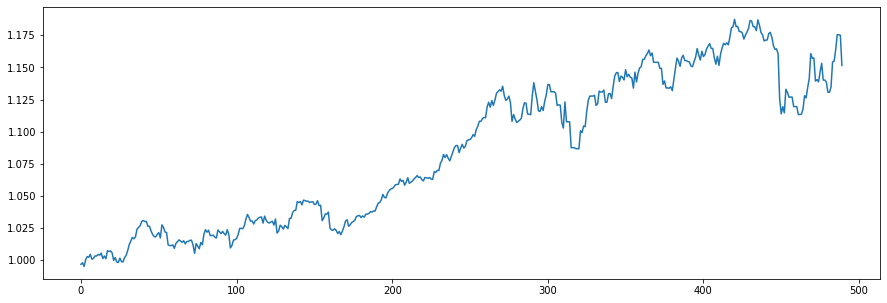

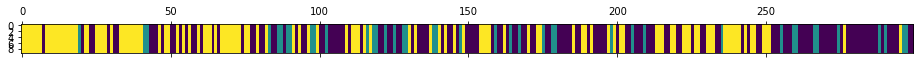

<Figure size 432x288 with 0 Axes>

N [[77. 22. 44.]
 [20. 11. 10.]
 [46.  8. 61.]]
alphas [[1.53895988 0.13243183 1.92020114]
 [0.74752836 0.92386335 1.92020114]
 [0.74752836 0.13243183 2.71163266]]
M [[10.  1.  8.]
 [ 4.  4.  5.]
 [ 3.  1.  9.]]
sum_w [[4.]
 [3.]
 [4.]]
barM [[6. 1. 8.]
 [4. 1. 5.]
 [3. 1. 5.]]
pi_z [[0.56305832 0.17257981 0.26436187]
 [0.44985339 0.3739125  0.17623411]
 [0.37860157 0.06367398 0.55772445]]
beta_vec [0.52334544 0.103942   0.37271255]
hyper>> a_k: 4.535501408939654  gamma: 0.7113968900227726  rho: 0.2081530965829779


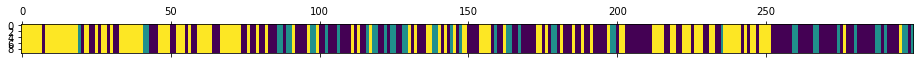

<Figure size 432x288 with 0 Axes>

991
N [[81. 20. 41.]
 [21. 15.  8.]
 [40.  9. 64.]]
alphas [[2.82363339 0.37329968 1.33856834]
 [1.87955473 1.31737834 1.33856834]
 [1.87955473 0.37329968 2.282647  ]]
M [[10.  3.  6.]
 [ 7.  5.  4.]
 [ 5.  2.  9.]]
sum_w [[3.]
 [3.]
 [4.]]
barM [[7. 3. 6.]
 [7. 2. 4.]
 [5. 2. 5.]]
pi_z [[0.56964452 0.12435092 0.30600456]
 [0.48181229 0.31976869 0.19841902]
 [0.30872806 0.08556698 0.60570497]]
beta_vec [0.46912966 0.29201862 0.23885172]
hyper>> a_k: 4.409395556460223  gamma: 0.6569936091702816  rho: 0.14445805265095613


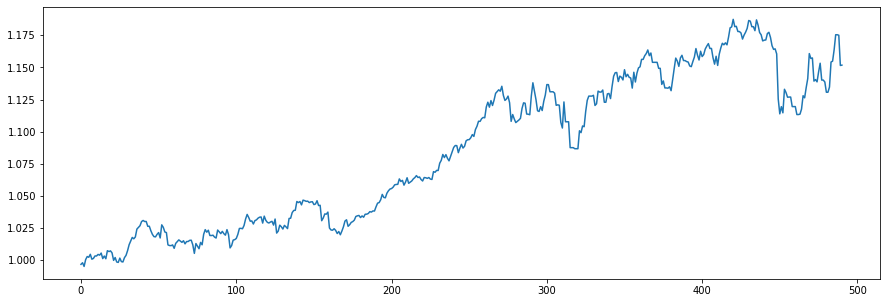

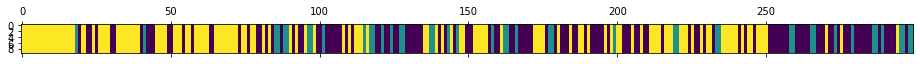

<Figure size 432x288 with 0 Axes>

N [[65. 19. 43.]
 [20. 14.  9.]
 [42. 10. 77.]]
alphas [[2.40672816 1.10161773 0.90104967]
 [1.76975547 1.73859042 0.90104967]
 [1.76975547 1.10161773 1.53802237]]
M [[8. 4. 4.]
 [6. 5. 3.]
 [5. 2. 8.]]
sum_w [[1.]
 [1.]
 [2.]]
barM [[7. 4. 4.]
 [6. 4. 3.]
 [5. 2. 6.]]
pi_z [[0.51595964 0.09721253 0.38682783]
 [0.42619471 0.32116204 0.25264325]
 [0.28498735 0.09911984 0.61589281]]
beta_vec [0.45453035 0.18297282 0.36249683]
hyper>> a_k: 3.151493118069264  gamma: 0.6657058053777277  rho: 0.08106879693008133


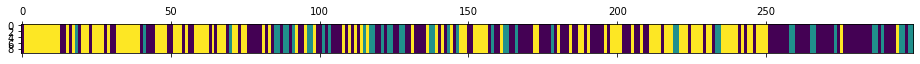

<Figure size 432x288 with 0 Axes>

992
N [[69. 20. 45.]
 [22. 15.  8.]
 [43. 10. 67.]]
alphas [[1.57181009 0.52989027 1.04979277]
 [1.31632233 0.78537802 1.04979277]
 [1.31632233 0.52989027 1.30528052]]
M [[6. 4. 6.]
 [5. 3. 2.]
 [5. 3. 3.]]
sum_w [[0.]
 [1.]
 [0.]]
barM [[6. 4. 6.]
 [5. 2. 2.]
 [5. 3. 3.]]
pi_z [[0.53160039 0.14046635 0.32793326]
 [0.55197504 0.27313174 0.17489322]
 [0.43124944 0.07564896 0.4931016 ]]
beta_vec [0.44487361 0.42304897 0.13207742]
hyper>> a_k: 4.6357187533054  gamma: 0.45205973861742565  rho: 0.054014068470402056


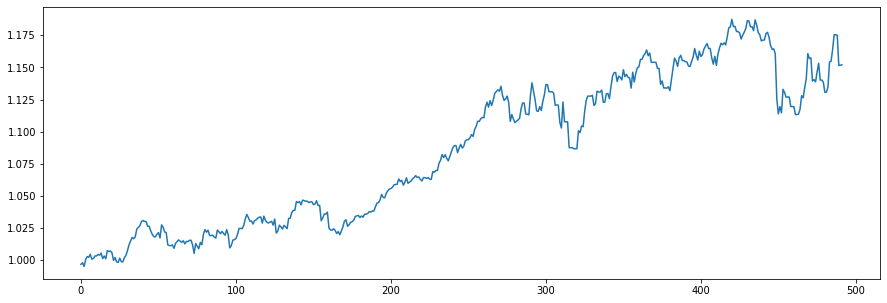

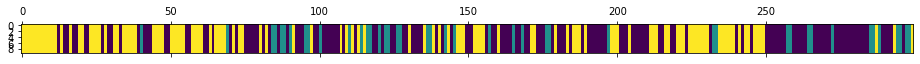

<Figure size 432x288 with 0 Axes>

N [[83. 18. 42.]
 [22. 14.  7.]
 [38. 10. 65.]]
alphas [[2.20130928 1.8552071  0.57920237]
 [1.95091525 2.10560113 0.57920237]
 [1.95091525 1.8552071  0.8295964 ]]
M [[14.  4.  1.]
 [ 5.  6.  1.]
 [ 6.  4.  1.]]
sum_w [[1.]
 [2.]
 [0.]]
barM [[13.  4.  1.]
 [ 5.  4.  1.]
 [ 6.  4.  1.]]
pi_z [[0.61284313 0.10687613 0.28028074]
 [0.59028001 0.30720661 0.10251338]
 [0.30858081 0.11666718 0.57475201]]
beta_vec [0.58174376 0.34767695 0.07057928]
hyper>> a_k: 4.184474312112626  gamma: 0.44704529644045515  rho: 0.09834724659125355


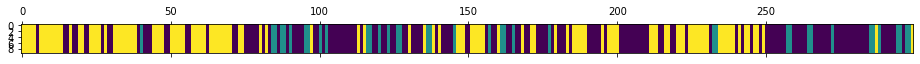

<Figure size 432x288 with 0 Axes>

993
N [[91. 19. 37.]
 [21. 13.  4.]
 [35.  6. 73.]]
alphas [[2.60641746 1.31176524 0.2662916 ]
 [2.19488594 1.72329677 0.2662916 ]
 [2.19488594 1.31176524 0.67782313]]
M [[9. 5. 2.]
 [7. 5. 1.]
 [9. 3. 2.]]
sum_w [[3.]
 [1.]
 [1.]]
barM [[6. 5. 2.]
 [7. 4. 1.]
 [9. 3. 1.]]
pi_z [[0.62573374 0.11812509 0.25614117]
 [0.59180915 0.29933828 0.10885257]
 [0.31898388 0.0379848  0.64303133]]
beta_vec [0.65464061 0.20909694 0.13626245]
hyper>> a_k: 2.853063732596458  gamma: 0.53158003008325  rho: 0.112379675316756


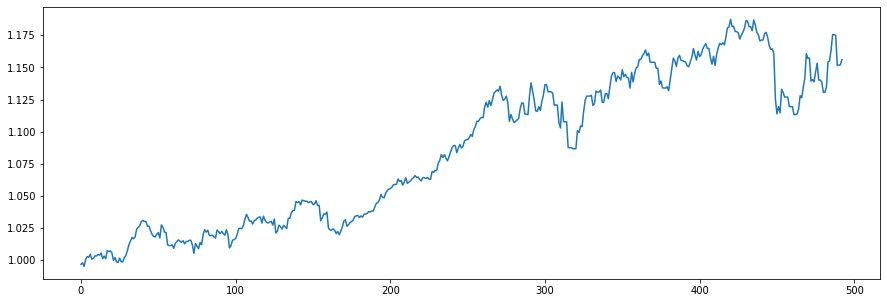

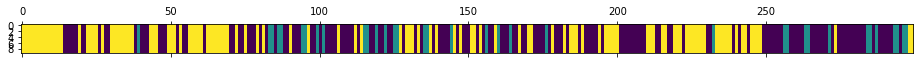

<Figure size 432x288 with 0 Axes>

N [[87. 18. 44.]
 [22. 11.  2.]
 [40.  6. 69.]]
alphas [[1.97846271 0.52952491 0.34507612]
 [1.65783633 0.85015128 0.34507612]
 [1.65783633 0.52952491 0.66570249]]
M [[9. 2. 1.]
 [3. 2. 1.]
 [7. 3. 2.]]
sum_w [[1.]
 [0.]
 [2.]]
barM [[8. 2. 1.]
 [3. 2. 1.]
 [7. 3. 0.]]
pi_z [[0.62949327 0.11792486 0.25258187]
 [0.61333235 0.31652787 0.07013978]
 [0.35225888 0.05790575 0.58983538]]
beta_vec [0.57018975 0.3959344  0.03387585]
hyper>> a_k: 2.411055915283949  gamma: 0.704063973555954  rho: 0.11725966227882266


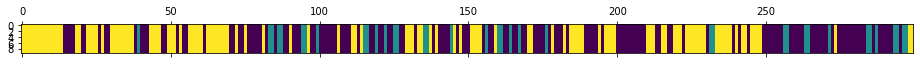

<Figure size 432x288 with 0 Axes>

994
N [[88. 19. 38.]
 [21. 13.  3.]
 [36.  5. 76.]]
alphas [[1.49627515 0.84268157 0.07209919]
 [1.21355555 1.12540117 0.07209919]
 [1.21355555 0.84268157 0.3548188 ]]
M [[7. 5. 1.]
 [3. 4. 1.]
 [8. 1. 3.]]
sum_w [[2.]
 [4.]
 [2.]]
barM [[5. 5. 1.]
 [3. 0. 1.]
 [8. 1. 1.]]
pi_z [[0.61295534 0.11963478 0.26740988]
 [0.51340514 0.44212298 0.04447189]
 [0.35123894 0.02822887 0.62053218]]
beta_vec [0.57141924 0.23866203 0.18991873]
hyper>> a_k: 3.2355978287369154  gamma: 0.573328174977321  rho: 0.25125937238453505


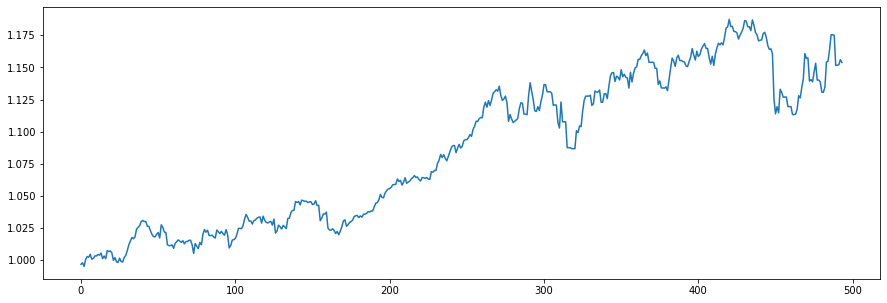

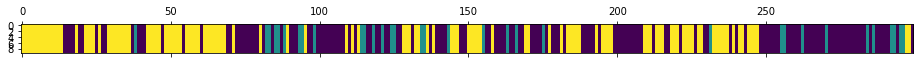

<Figure size 432x288 with 0 Axes>

N [[94. 18. 35.]
 [21.  9.  3.]
 [33.  6. 80.]]
alphas [[2.19730798 0.57818827 0.46010159]
 [1.3843337  1.39116254 0.46010159]
 [1.3843337  0.57818827 1.27307587]]
M [[13.  2.  1.]
 [ 4.  2.  1.]
 [ 5.  1.  8.]]
sum_w [[3.]
 [2.]
 [3.]]
barM [[10.  2.  1.]
 [ 4.  0.  1.]
 [ 5.  1.  5.]]
pi_z [[0.69009197 0.12538038 0.18452765]
 [0.62726223 0.31937573 0.05336204]
 [0.33929626 0.04770861 0.61299513]]
beta_vec [0.67381321 0.01634154 0.30984525]
hyper>> a_k: 2.616014935483419  gamma: 1.4053805370246795  rho: 0.5356645707168002


In [ ]:
returns = []
window = 300 
for t in range(pre_data+1,Y_full.shape[-1]):
    print(t)
    Y = Y_full[:,:t]
    z_pred = np.argmax(pZ[:,-1])
    returns.append((mu_z[:,z_pred]>0)*Y[:,-1])
    plt.figure(figsize=(15,5))
    plt.plot(np.exp(np.cumsum(np.array(returns),0)).mean(1))

    Z = np.hstack([Z,[z_pred]])
    
    Y =  Y[:,-window:] 
    Z = Z[-window:]
    
    for i in range(2):
        pi_z,pi_init,beta_vec,N,M,sum_w,barM = Sample_Transition(Z,beta_vec,num_z,rho,gamma,alpha0_p_kappa0)
        alpha0_p_kappa0,gamma, rho = sample_hyperparameters(N,M,sum_w,barM,alpha0_p_kappa0,gamma,rho)
        for z in range(num_z):
            mu_z[:,z], Sigma_z[:,:,z] = SampleMultivariateGaussian(Y,Z==z,mu_z[:,z], Sigma_z[:,:,z])
        pZ = likelihood(Y,Z,mu_z,Sigma_z,num_z)
        Z = Sample_Z(pZ,mu_z,Sigma_z,pi_z)
        plt.matshow(np.vstack([Z for i in range(10)]))
        plt.figure()
        plt.show()

In [532]:
np.exp(np.cumsum(np.array(returns),0)).T.mean(1)

array([0.9983631 , 0.99834754, 1.00074373, 0.99933531, 0.99943126,
       1.        , 1.01374637, 0.99941315, 1.00012755])

In [735]:
sharpe(np.array(returns).mean(1))

0.4662382503597682

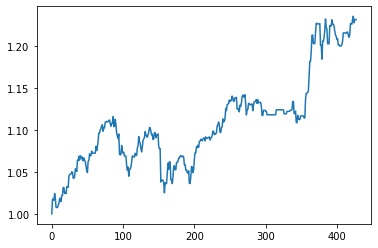

In [480]:
plt.plot(np.exp(np.cumsum(np.array(returns).mean(1),0)))

In [387]:
np.array(returns),np.exp(np.cumsum(np.array(returns),0)).mean(1)

(array([[-0.00779427, -0.005459  ,  0.0052073 , -0.00323102, -0.00684934,
         -0.00676509, -0.01148467, -0.01364562, -0.02232991],
        [-0.00779427, -0.        ,  0.0052073 , -0.00323102, -0.00684934,
         -0.00676509, -0.01148467, -0.01364562, -0.02232991],
        [-0.00779427, -0.005459  ,  0.0052073 , -0.00323102, -0.00684934,
         -0.00676509, -0.01148467, -0.01364562, -0.02232991],
        [-0.        , -0.        ,  0.0052073 , -0.        , -0.00684934,
         -0.00676509, -0.01148467, -0.01364562, -0.02232991],
        [-0.00779427, -0.005459  ,  0.0052073 , -0.00323102, -0.00684934,
         -0.00676509, -0.01148467, -0.01364562, -0.02232991]]),
 array([0.99201827, 0.98475163, 0.97699182, 0.97113804, 0.96358559]))

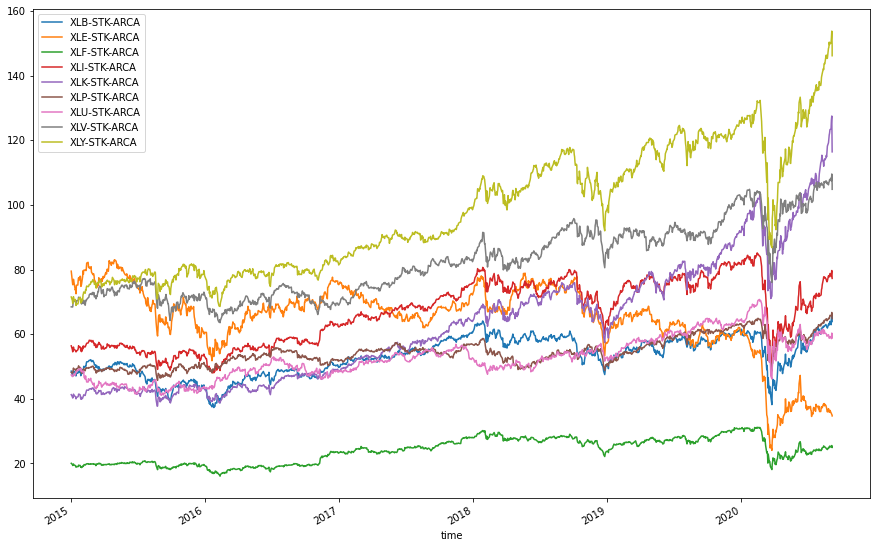

<Figure size 1080x720 with 0 Axes>

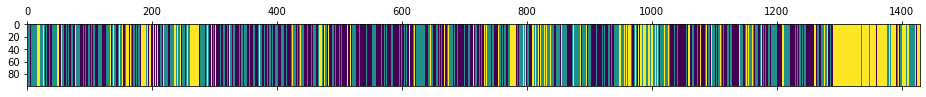

In [220]:
d_.plot(figsize=(15,10))
plt.figure(figsize=(15,10))
plt.matshow(np.vstack([Z for i in range(100)]))

In [466]:
plt.plot(np.exp(np.cumsum(Y[:,1:]*(mu_z[:,Z[:-1]]>0),1)).T.mean(1))
plt.plot(np.exp(np.cumsum(Y,1)).T.mean(1))
sharpe = lambda dd : (252**0.5)*(dd.mean()/dd.std())
sharpe((Y[:,1:]*(mu_z[:,Z[:-1]]>0)).sum(0)),sharpe(Y.mean(0))

IndexError: arrays used as indices must be of integer (or boolean) type

In [289]:
Sigma_z

array([[[ 4.18094136e-05,  1.45513909e-04,  9.73301580e-04],
        [ 3.12985541e-05,  1.15137895e-04,  1.08403093e-03],
        [ 2.79653592e-05,  1.04351787e-04,  8.95294022e-04],
        [ 2.66399442e-05,  1.11171188e-04,  9.07460273e-04],
        [ 2.42467375e-05,  1.08028462e-04,  7.79682932e-04],
        [ 1.23716950e-05,  5.15359846e-05,  6.02288553e-04],
        [ 6.58214400e-06,  1.27375611e-05,  7.04893785e-04],
        [ 1.98321429e-05,  7.28309490e-05,  6.61305385e-04],
        [ 2.27701712e-05,  9.08104503e-05,  7.69549231e-04]],

       [[ 3.12985541e-05,  1.15137895e-04,  1.08403093e-03],
        [ 8.22323999e-05,  1.94744815e-04,  1.65448138e-03],
        [ 2.80713042e-05,  1.02627261e-04,  1.11352374e-03],
        [ 2.39825555e-05,  1.03901131e-04,  1.08012847e-03],
        [ 2.00265857e-05,  9.92664882e-05,  8.88583863e-04],
        [ 6.68869281e-06,  5.17270840e-05,  6.28183069e-04],
        [ 6.99610124e-07,  1.62123758e-05,  7.09825172e-04],
        [ 1.40391314e-

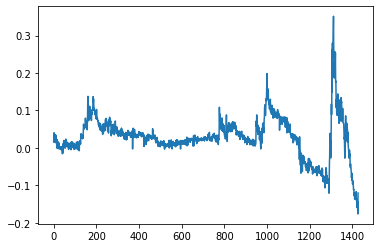

In [222]:
plt.plot(np.exp(np.cumsum(Y[:,1:]*(mu_z[:,Z[:-1]]>0),1)).T.mean(1)-np.exp(np.cumsum(Y,1).T).mean(1)[:-1])

In [209]:
mu_z

array([[-1.87791137e-04,  9.30364776e-04,  2.84188527e-04],
       [-8.40920549e-04,  2.74644308e-04,  6.39436807e-04],
       [ 6.59329248e-05,  8.49781697e-04, -1.14952608e-04],
       [ 4.63820472e-06,  9.64908542e-04,  1.43078984e-04],
       [ 3.67142753e-04,  7.14112422e-04,  1.15573387e-03],
       [ 7.45053030e-04,  1.10056837e-04, -2.70909078e-04],
       [ 6.29810950e-04,  1.28244249e-06,  9.19420037e-04],
       [ 3.51151231e-04,  7.11603340e-04,  5.18977150e-04],
       [ 3.17195494e-04,  3.79743105e-04,  3.71633143e-04]])

In [ ]:
from scipy.stats import invwishart,multivariate_normal,multinomial

num_z = 3
Sigma_z = np.zeros((d,d,num_z))
mu_z = np.zeros((d,num_z))
Y = np.log(d_.pct_change()+1).dropna().values.T
d,T = Y.shape
Z=np.random.randint(0,num_z,T)